In [1]:
import pandas as pd
import sklearn 
import numpy as np
import matplotlib.pyplot as plt
from joblib import load, dump
from sklearn import metrics
from sklearn.neighbors import NearestNeighbors
from sklearn.neighbors import KNeighborsRegressor
from sklearn.metrics import roc_auc_score, classification_report, confusion_matrix
import warnings
warnings.filterwarnings('ignore')
from scipy import interp
from numpy import argmax
from sklearn.metrics import precision_recall_curve, average_precision_score
from xgboost import XGBClassifier
import xgboost as xgb
import scipy.stats
from sklearn.model_selection import LeaveOneOut

folder = "/home/clau/Escritorio/microbial_consortia/"



# 2 bacteria consortia

In [2]:
tr2=pd.read_table(folder + "simulaciones/res_simulations/train_data_simulated/train_2bactS")


In [3]:
tr2.head()

,cons,e1,e2,e3,e4,e5,e6,e7,e8,e9,...,rb18,rb19,rb20,rb21,rb22,rb23,rb24,rb25,pab,pba
0,0.077945,0,1,1,0,0,0,0,0,0,...,1,0,0,1,1,0,1,1,0.630384,0.768368
1,0.000000,0,1,1,0,0,0,0,0,0,...,1,0,0,1,1,0,1,0,0.731969,0.679417
2,0.000028,0,1,1,0,0,0,0,0,0,...,1,0,0,0,0,0,1,1,0.716008,0.780337
3,0.000000,0,1,1,0,0,0,0,0,0,...,1,0,0,1,1,1,0,0,0.997826,0.998501
4,8.952165,1,0,1,0,0,1,1,1,0,...,0,0,0,0,0,0,1,1,0.966180,0.981683


In [160]:
X = tr2.iloc [:, 1:53].values
y = tr2.iloc[:, 0].values


In [161]:
neigh = KNeighborsRegressor(n_neighbors=3)
neigh.fit(X, y)
dump(neigh, 'KNN_C2.joblib')

['KNN_C2.joblib']

In [162]:
loo = LeaveOneOut()
loo.get_n_splits(X)


66

In [163]:
for i, (train_index, test_index) in enumerate(loo.split(X)):
    X_train, X_test = X[train_index], X[test_index]
 #   print(neigh.predict(X_test))
    print(f"real value {y[i]} \tpredict: {neigh.predict(X_test)}")
    
 

real value 0.077944510360147 	predict: [0.02600934]
real value 0.0 	predict: [9.49371152e-06]
real value 2.8481134571999998e-05 	predict: [0.00054339]
real value 0.0 	predict: [0.]
real value 8.95216500687405 	predict: [2.984055]
real value 8.80848084538413 	predict: [2.93616034]
real value 0.001106713133903 	predict: [0.0003689]
real value 0.0 	predict: [5.88281189e-08]
real value 0.0 	predict: [7.90257639e-06]
real value 8.808480845369552 	predict: [2.93669418]
real value 2.37077291626583e-05 	predict: [0.00164916]
real value 0.0 	predict: [2.93669418]
real value 8.808480845327189 	predict: [5.63537533]
real value 8.78580845333188 	predict: [5.8647631]
real value 8.80579253821247 	predict: [8.54061254]
real value 8.559084531178652 	predict: [8.26267459]
real value 8.8084808453298 	predict: [8.24397672]
real value 8.29025342343 	predict: [8.26003968]
real value 7.93868580845351 	predict: [8.26267459]
real value 8.87822232838543 	predict: [8.7485959]
real value 8.0976451449366 	predict

In [3]:
data2=pd.read_table("/home/clau/Escritorio/pred_train_2bact")
y = data2.iloc [:, 1].values
x = data2.iloc[:, 0].values


In [4]:
scipy.stats.pearsonr(x,y)    # Pearson's r

(0.8708937980243936, 2.0464279236240836e-21)

In [5]:
scipy.stats.spearmanr(x, y)   # Spearman's rho

SpearmanrResult(correlation=0.7384819050020028, pvalue=1.4756644049663079e-12)

In [7]:
scipy.stats.linregress(x,y) #

LinregressResult(slope=0.7242529334985631, intercept=0.5730637285513152, rvalue=0.8708937980243935, pvalue=2.046427923624158e-21, stderr=0.051089681880612345)

In [8]:
scipy.stats.pointbiserialr(x, y)

PointbiserialrResult(correlation=0.8708937980243936, pvalue=2.0464279236240836e-21)

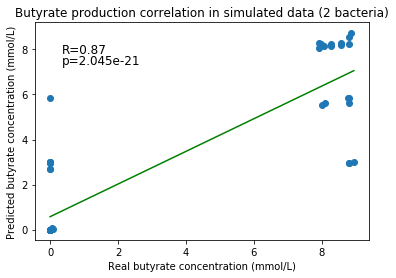

In [18]:
plt.title ('Butyrate production correlation in simulated data (2 bacteria)')  
plt.scatter (x, y)  
plt.plot (np.unique(x), np.poly1d(np.polyfit(x,y, 1))(np.unique(x)), color = 'green')  
plt.xlabel ('Real butyrate concentration (mmol/L)')  
plt.ylabel ('Predicted butyrate concentration (mmol/L)') 
plt.annotate("R=0.87",xy=(2, 9), xycoords='data',
            xytext=(1, 8),size=12, va="center", ha="center")
plt.annotate("p=2.045e-21",xy=(2, 9), xycoords='data',
            xytext=(1.5, 7.5),size=12, va="center", ha="center")
plt.savefig("Correlation2bact_trainSilulated.png", dpi=300,bbox_inches='tight')

In [103]:
tst2=pd.read_table(folder+"train/2_bac/train_2bact")


In [104]:
##TEST
tst2=pd.read_table(folder+"train/2_bac/train_2bact")

X_test=tst2.iloc [:, 1:53].values
inter=tst2.iloc[:, 0].values
y_pred2 = neigh.predict(X_test)
y_pred2

file_new = open(folder+"nuevos/test/all2_result_real_test-train.txt" , "w")
for i in range(0,12):
    #print(str(inter[i])+"\t"+ str(y_pred2[i]))
    file_new.write(str(inter[i])+"\t"+ str(y_pred2[i])+"\n")
    
file_new.close()




In [7]:
dat2=pd.read_table("/home/clau/Escritorio/test_real_pred_2")
y2 = dat2.iloc [:, 1].values
x2 = dat2.iloc[:, 0].values


In [106]:
scipy.stats.pearsonr(x2,y2)    # Pearson's r

(0.7927178635596948, 0.002102903243182723)

In [13]:
scipy.stats.spearmanr(x2,y2)

SpearmanrResult(correlation=0.7100274435330413, pvalue=0.009677707692468387)

In [14]:
scipy.stats.linregress(x2,y2)

LinregressResult(slope=0.46814502550789994, intercept=1.4495648117368178, rvalue=0.7927178635596948, pvalue=0.002102903243182721, stderr=0.11384099400424745)

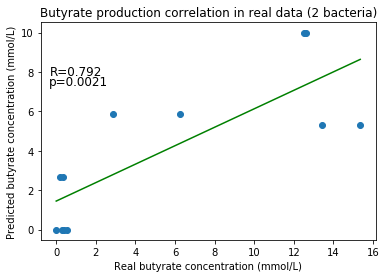

In [17]:
plt.title ('Butyrate production correlation in real data (2 bacteria)')  
plt.scatter (x2, y2)  
plt.plot (np.unique(x2), np.poly1d(np.polyfit(x2,y2, 1))(np.unique(x2)), color = 'green')  
plt.xlabel ('Real butyrate concentration (mmol/L)')  
plt.ylabel ('Predicted butyrate concentration (mmol/L)') 
plt.annotate("R=0.792",xy=(2, 9), xycoords='data',
            xytext=(1, 8),size=12, va="center", ha="center")
plt.annotate("p=0.0021",xy=(2, 9), xycoords='data',
            xytext=(1.1, 7.5),size=12, va="center", ha="center")
plt.savefig("Correlation2_testreal.png", dpi=300,bbox_inches='tight')

In [164]:
####TEST new data

tst2=pd.read_table(folder+"nuevos/test/all2_test")

X_test=tst2.iloc [:, 1:53].values
inter=tst2.iloc[:, 0].values
y_pred2 = neigh.predict(X_test)
y_pred2

file_new = open(folder+"nuevos/test/result_test/all2_result_newdata.txt" , "w")
for i in range(0,33):
   # print(str(inter[i])+"\t"+ str(y_pred2[i]))
    file_new.write(str(inter[i])+"\t"+ str(y_pred2[i])+"\n")
    
file_new.close()

# 3 bact example


In [63]:
tr3=pd.read_table(folder + "simulaciones/res_simulations/train_data_simulated/train_3bactS")


In [64]:
X3 = tr3.iloc [:, 1:82].values
y3 = tr3.iloc[:, 0].values

In [65]:
neigh = KNeighborsRegressor(n_neighbors=3)
neigh.fit(X3, y3)
dump(neigh, 'KNN_C3.joblib')

['KNN_C3.joblib']

In [66]:
from sklearn.model_selection import LeaveOneOut
loo = LeaveOneOut()
loo.get_n_splits(X3)

511

In [68]:
for i, (train_index, test_index) in enumerate(loo.split(X3)):
    X3_train, X3_test = X3[train_index], X3[test_index]
 #   print(neigh.predict(X_test))
    print(f"{y3[i]} \t {neigh.predict(X3_test)}")
    

0.0 	 [1.74813771e-06]
5.242545e-06 	 [1.747515e-06]
0.0 	 [0.00174458]
0.0 	 [2.0341662e-06]
0.0 	 [0.]
0.0 	 [0.]
0.0004608153 	 [0.00015361]
0.0 	 [0.]
0.0 	 [0.]
2.528757e-05 	 [3.060354e-05]
8.80848084534067 	 [2.93617026]
6.652305e-05 	 [3.060354e-05]
4.634586e-06 	 [2.9373983]
8.808480845335911 	 [5.87232056]
8.78580845365119 	 [5.8647631]
8.73530453243157 	 [8.78408874]
8.808480845386491 	 [8.80848085]
8.80848084536005 	 [8.80848085]
8.80848084539168 	 [8.80848085]
8.80848084535503 	 [8.80848085]
8.878155708279971 	 [8.8317058]
8.808480845320052 	 [5.87424136]
8.80848084538243 	 [8.80848085]
8.8084808453471 	 [5.87232056]
8.80848084536975 	 [8.80848085]
8.80848084532375 	 [5.8647631]
8.808480845392038 	 [8.80848085]
8.80848084539398 	 [8.80848085]
8.80848084538428 	 [8.80848085]
0.0 	 [0.]
0.0 	 [0.00035599]
0.0 	 [0.]
0.0 	 [8.42919e-06]
0.0 	 [2.217435e-05]
0.0 	 [1.544862e-06]
0.0 	 [0.]
0.0 	 [0.]
0.0 	 [0.]
0.0 	 [0.]
0.0 	 [3.64188e-05]
0.0 	 [0.]
0.0 	 [0.]
0.0 	 [0.]
0.

0.0 	 [0.]
0.0 	 [0.00039241]
0.0 	 [0.]
0.0 	 [0.]
0.0 	 [0.00083117]
0.0 	 [0.00075481]
0.0 	 [0.]
0.0057623940000000005 	 [0.00210054]
0.0 	 [0.]
0.0 	 [0.00015361]
0.0 	 [0.]
0.0 	 [0.]
0.0 	 [0.]
0.06977350685290401 	 [0.06973914]
0.069726621637231 	 [0.06972743]
0.06973301381966 	 [0.06973502]
0.0 	 [0.]
0.0 	 [0.00123648]
0.0 	 [0.]
0.0 	 [0.]
0.0 	 [0.]
0.0 	 [0.]
6.758037e-05 	 [0.00092844]
0.0 	 [0.]
0.0 	 [0.]
0.0 	 [3.64188e-05]
0.0 	 [0.]
0.0 	 [0.]
0.0 	 [0.]
0.0 	 [0.]
0.0 	 [0.]
0.0 	 [0.00017974]
0.0 	 [0.]
0.069777813653492 	 [0.0466695]
0.069769872379901 	 [0.06977552]
0.069802289946702 	 [0.06980076]
0.06978798266287599 	 [0.09650463]
0.069778865437717 	 [0.06979295]
0.069830118292787 	 [0.06981261]
0.149960710290796 	 [0.07324956]
0.069805407333306 	 [0.0697847]
0.069765203241828 	 [0.04651773]
0.06982144719137799 	 [0.06977621]
0.06978859558132401 	 [0.04742401]
0.069718576287579 	 [0.06978181]
0.069703003648731 	 [0.06975492]
0.06980331597637401 	 [0.06975605]
0.

In [9]:
dat3=pd.read_table("/home/clau/Escritorio/train_real_pred_3")
y3 = dat3.iloc [:, 1].values
x3 = dat3.iloc[:, 0].values


In [17]:
scipy.stats.pearsonr(x3,y3)    # Pearson's r

(0.9788396901683836, 0.0)

In [19]:
scipy.stats.spearmanr(x3,y3)    # 

SpearmanrResult(correlation=0.9076691645811203, pvalue=4.560781065124642e-194)

In [20]:
scipy.stats.linregress(x3,y3)    # 

LinregressResult(slope=0.9368635197268042, intercept=0.11482203585308115, rvalue=0.9788396901683857, pvalue=0.0, stderr=0.00868104852484473)

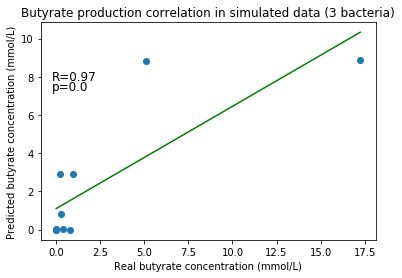

In [16]:
plt.title ('Butyrate production correlation in simulated data (3 bacteria)')  
plt.scatter (x3, y3)  
plt.plot (np.unique(x3), np.poly1d(np.polyfit(x3,y3, 1))(np.unique(x3)), color = 'green')  
plt.xlabel ('Real butyrate concentration (mmol/L)')  
plt.ylabel ('Predicted butyrate concentration (mmol/L)') 
plt.annotate("R=0.97",xy=(2, 9), xycoords='data',
            xytext=(1, 8),size=12, va="center", ha="center")
plt.annotate("p=0.0",xy=(2, 9), xycoords='data',
            xytext=(0.8, 7.5),size=12, va="center", ha="center")
plt.savefig("Correlation3train_simulated.png", dpi=300,bbox_inches='tight')

In [80]:
##TEST real data
tst3=pd.read_table(folder+"train/3_bact/train_3bact_real")
X_test=tst3.iloc [:, 1:82].values
inter=tst3.iloc[:, 0].values
y_pred3 = neigh.predict(X_test)
y_pred3

file_new = open(folder+"nuevos/test/all3_newtrain_result_simulations.txt" , "w")
for i in range(0,10):
    #print(str(inter[i])+"\t"+ str(y_pred3[i]))
    file_new.write(str(inter[i])+"\t"+ str(y_pred3[i])+"\n")
    
file_new.close()

In [11]:
dat3=pd.read_table("/home/clau/Escritorio/test_real_pred_3")
y3 = dat3.iloc [:, 1].values
x3 = dat3.iloc[:, 0].values


In [22]:
scipy.stats.pearsonr(x3,y3)    # Pearson's r

(0.8094613479160395, 0.004549817949199653)

In [24]:
scipy.stats.spearmanr(x3,y3)    # 

SpearmanrResult(correlation=0.707722459824028, pvalue=0.022035993876649236)

In [23]:
scipy.stats.linregress(x3,y3)    # 

LinregressResult(slope=0.5348655214074988, intercept=1.1044702823224877, rvalue=0.8094613479160397, pvalue=0.004549817949199634, stderr=0.13717333372840543)

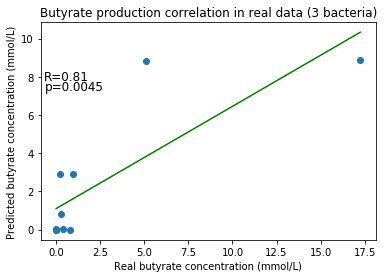

In [19]:
plt.title ('Butyrate production correlation in real data (3 bacteria)')  
plt.scatter (x3, y3)  
plt.plot (np.unique(x3), np.poly1d(np.polyfit(x3,y3, 1))(np.unique(x3)), color = 'green')  
plt.xlabel ('Real butyrate concentration (mmol/L)')  
plt.ylabel ('Predicted butyrate concentration (mmol/L)') 
plt.annotate("R=0.81",xy=(2, 8), xycoords='data',
            xytext=(0.6, 8),size=12, va="center", ha="center")
plt.annotate("p=0.0045",xy=(2, 9), xycoords='data',
            xytext=(1,7.5),size=12, va="center", ha="center")
plt.savefig("Correlation3_testreal.png", dpi=300,bbox_inches='tight')

In [93]:
##TEST new data
tst3=pd.read_table(folder+"nuevos/test/all3_test")
X_test=tst3.iloc [:, 1:82].values
inter=tst3.iloc[:, 0].values
y_pred3 = neigh.predict(X_test)
y_pred3

file_new = open(folder+"nuevos/test/result_test/all3_result_newdata.txt" , "w")
for i in range(0,166):
    print(inter[i]+"\t"+ str(y_pred3[i]))
    file_new.write(inter[i]+"\t"+ str(y_pred3[i])+"\n")
    
file_new.close()

PT4+D4+HGF2	0.0001348083
PT8+D4+HGF2	0.0001348083
PT33+D4+HGF2	0.0001348083
M38+D4+HGF2	2.93623173165345
G2+D4+HGF2	2.93623173165345
LM8+D4+HGF2	5.8723920134337915
PT7+D4+HGF2	0.0001348083
PT4+D4+M62	0.0
PT8+D4+M62	0.0
PT33+D4+M62	0.0
M38+D4+M62	2.936234000479987
G2+D4+M62	5.872394282268433
LM8+D4+M62	5.872394282268434
PT7+D4+M62	0.0
PT4+D4+w14673	0.0
PT8+D4+w14673	0.0
PT33+D4+w14673	2.9361602817884465
M38+D4+w14673	5.872394282268433
G2+D4+w14673	5.872394282268433
LM8+D4+w14673	8.808480845365692
PT7+D4+w14673	0.0
PT4+G2+HGF2	0.000305448
PT8+G2+HGF2	0.000305448
PT33+G2+HGF2	0.000305448
M38+G2+HGF2	0.000787116
PT4+G2+M62	0.0
PT8+G2+M62	0.0
PT33+G2+M62	0.0
M38+G2+M62	0.0
PT4+G2+w14673	0.0
PT8+G2+w14673	0.0
PT33+G2+w14673	0.0
M38+G2+w14673	2.9361602817840127
PT4+I1+HGF2	0.0001348083
PT8+I1+HGF2	0.0001348083
PT33+I1+HGF2	0.0001348083
M38+I1+HGF2	2.93623173165345
G2+I1+HGF2	2.93623173165345
LM8+I1+HGF2	8.808488856023558
PT7+I1+HGF2	0.0001348083
D4+I1+HGF2	0.0001348083
PT4+I1+M62	0.0
PT8+I1+M

# # 4 bact example

In [186]:
tr4=pd.read_table(folder + "simulaciones/res_simulations/train_data_simulated/train_4bactS")


In [179]:
X4 = tr4.iloc [:, 1:113].values
y4 = tr4.iloc[:, 0].values

In [180]:
neigh = KNeighborsRegressor(n_neighbors=3)
neigh.fit(X4, y4)
dump(neigh, 'KNN_C4.joblib')

['KNN_C4.joblib']

In [181]:
from sklearn.model_selection import LeaveOneOut
loo = LeaveOneOut()
loo.get_n_splits(X4)

2496

In [182]:
for i, (train_index, test_index) in enumerate(loo.split(X4)):
    X4_train, X4_test = X4[train_index], X4[test_index]
 #   print(neigh.predict(X_test))
    print(f"real value {y4[i]} \tpredict: {neigh.predict(X4_test)}")

real value 0.0 	predict: [0.00034158]
real value 0.000964029159405 	predict: [0.00048274]
real value 0.0 	predict: [0.00032134]
real value 0.0 	predict: [0.00016065]
real value 0.000457697846632 	predict: [0.06581867]
real value 9.76489561466808e-05 	predict: [3.2549652e-05]
real value 0.0 	predict: [0.00089433]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 2.3784520498113e-06 	predict: [7.9281735e-07]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 4.15147631577999 	predict: [2.76765088]
real value 4.15147631567271 	predict: [2.76765088]
real value 4.15147631559635 	predict: [4.15147632]
real value 4.15147631571227 	predict: [4.15147632]
real value 4.15147631549935 	predict: [4.15147632]
real value 4.151476315527351 	predict: [4.15147632]
real value 4.15147631539658 	predict: [4.15147632]
real value 4.4523793432162595 	predict: [4.25177732]
real value 4.1514763155655805 	predict

real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.069737645689688 	predict: [0.06975073]
real value 0.06979918684162599 	predict: [0.06979129]
real value 0.06976507738346001 	predict: [0.0697288]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.0005471]
real value 0.0 	predict: [0.01046844]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [4.17327152e-05]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.00107043]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [1.08806176e-05]
real value 0.0

real value 8.808480845331019 	predict: [8.80848466]
real value 8.80848683622532 	predict: [8.80849865]
real value 8.80849322733403 	predict: [8.80849249]
real value 8.80848084537439 	predict: [8.80848085]
real value 8.80849971464263 	predict: [8.80848714]
real value 8.80848084534791 	predict: [8.80848204]
real value 8.80848084537356 	predict: [8.80848204]
real value 8.80848084537554 	predict: [8.80848085]
real value 8.878147354074429 	predict: [8.87822418]
real value 8.808480845360231 	predict: [8.8084836]
real value 8.80851846095786 	predict: [8.80849699]
real value 8.80848084535745 	predict: [8.80849405]
real value 8.808574449215868 	predict: [8.8085144]
real value 8.80848084536366 	predict: [8.80848085]
real value 8.80848443599554 	predict: [8.80848204]
real value 8.808480845385029 	predict: [8.80848204]
real value 8.808480845332358 	predict: [8.80850079]
real value 8.8084808453452 	predict: [8.80850442]
real value 8.80848084533797 	predict: [8.80850861]
real value 8.808564128718901

real value 9.42272792603089e-06 	predict: [1.07007679]
real value 7.83191977624212e-05 	predict: [3.01202041e-05]
real value 4.903666968871299e-06 	predict: [1.63455566e-06]
real value 0.0 	predict: [4.90819203e-06]
real value 1.05270939857193e-05 	predict: [5.29729323e-06]
real value 0.0 	predict: [1.17098e-05]
real value 0.0 	predict: [2.59098662e-06]
real value 0.0 	predict: [1.32279211e-05]
real value 2.9156669307139598e-05 	predict: [9.71888977e-06]
real value 0.0 	predict: [0.]
real value 0.069772185538911 	predict: [0.06972312]
real value 0.06970601124919701 	predict: [0.06973923]
real value 0.069730675896122 	predict: [0.06971775]
real value 0.0 	predict: [9.25279092e-06]
real value 0.0 	predict: [0.00072821]
real value 0.0 	predict: [0.0024002]
real value 1.2106020384233801e-05 	predict: [1.14021279e-05]
real value 0.0 	predict: [0.]
real value 3.92774180608836e-05 	predict: [1.89300154e-05]
real value 1.75126280596995e-05 	predict: [1.89300154e-05]
real value 0.0 	predict: [0

real value 8.878243715246679 	predict: [8.87824237]
real value 8.878186346063131 	predict: [8.87824237]
real value 8.87827335926764 	predict: [8.87824586]
real value 8.80848084536039 	predict: [8.80848085]
real value 8.80871345533259 	predict: [8.80855838]
real value 8.808480845367331 	predict: [8.80848085]
real value 8.80848084533423 	predict: [8.80855838]
real value 8.808480845356971 	predict: [8.80848085]
real value 8.808480845345429 	predict: [8.80848085]
real value 8.808480845333518 	predict: [8.80852949]
real value 8.80862678796912 	predict: [8.80852949]
real value 8.808480845320108 	predict: [8.80852949]
real value 8.80848084539968 	predict: [8.80848085]
real value 8.80848084536709 	predict: [8.80848085]
real value 8.80848084536587 	predict: [8.80848085]
real value 8.80848084535298 	predict: [8.80848085]
real value 8.808480845387392 	predict: [8.80848085]
real value 8.808480845356051 	predict: [8.80848085]
real value 8.81389688885401 	predict: [8.8120832]
real value 8.8084808453

real value 8.9772549817654 	predict: [8.91124024]
real value 8.80848084537694 	predict: [8.80859012]
real value 8.808480845349038 	predict: [8.80848085]
real value 8.80848084541148 	predict: [8.80848085]
real value 8.80848084535163 	predict: [8.80848085]
real value 8.80848084535077 	predict: [8.80848085]
real value 8.80848084539486 	predict: [8.80848085]
real value 8.80848084534351 	predict: [8.80848085]
real value 8.80848084533087 	predict: [8.80848085]
real value 8.87821687403782 	predict: [8.87820259]
real value 8.87818523787166 	predict: [8.87820654]
real value 8.87831343928301 	predict: [8.87824613]
real value 8.87815470901217 	predict: [8.87819801]
real value 8.878245691620279 	predict: [8.87822887]
real value 8.878225756494661 	predict: [8.95570229]
real value 8.878166947856881 	predict: [8.87818465]
real value 8.87818678548012 	predict: [8.87817983]
real value 8.878154043964999 	predict: [8.87818807]
real value 8.80889592129417 	predict: [8.80897393]
real value 8.80903055148047

real value 8.8084808453547 	predict: [8.80848085]
real value 8.80848084540673 	predict: [8.80848085]
real value 8.80848084535729 	predict: [8.80848085]
real value 8.808480845363981 	predict: [8.80848085]
real value 8.80848084533495 	predict: [8.80848085]
real value 8.80848084532893 	predict: [8.80870755]
real value 8.80916096191185 	predict: [8.80870755]
real value 8.8084808453488 	predict: [8.80870755]
real value 8.80848084536367 	predict: [8.80848085]
real value 8.80848084536669 	predict: [8.80848085]
real value 8.80848084537956 	predict: [8.80848085]
real value 8.80848084538238 	predict: [8.80848085]
real value 8.80848084535341 	predict: [8.80848085]
real value 8.80848084534756 	predict: [8.80848085]
real value 8.80848084536267 	predict: [8.80848085]
real value 8.808480845355561 	predict: [8.80848085]
real value 8.808480845415712 	predict: [8.8414632]
real value 8.808480845386061 	predict: [8.80848085]
real value 8.808480845361231 	predict: [8.80848085]
real value 8.80848084533235 	

real value 0.069663958364552 	predict: [0.04647138]
real value 0.06973495904112 	predict: [0.06976287]
real value 0.06976067938374901 	predict: [0.04650362]
real value 0.069673326442616 	predict: [0.06971039]
real value 0.06973068112050901 	predict: [0.046468]
real value 0.06972716029701599 	predict: [0.06971182]
real value 0.06969354250460902 	predict: [0.06971766]
real value 0.069735726945429 	predict: [0.06971559]
real value 0.069781488382409 	predict: [0.06972193]
real value 0.06972370640719999 	predict: [0.06971159]
real value 0.06971750893454699 	predict: [0.06972565]
real value 0.06969075515856099 	predict: [0.06973198]
real value 0.069711226991706 	predict: [0.06973111]
real value 0.069701862574728 	predict: [0.06974302]
real value 0.06978022570057599 	predict: [0.06974214]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0

real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [1.37204243e-05]
real value 0.0 	predict: [2.83106947e-07]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.00017581]
real value 1.93095755912365e-07 	predict: [6.4365252e-08]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.00028203]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [4.58005211e-07]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.000219482813485 	predict: [0.00017581]
real value 0.0 	predict: [4.08842646e-06]
real value 0.0 	predict: [0.]
real value 0.0 	

real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.00022825]
real value 0.0 	predict: [0.00021098]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.19699832276377105 	predict: [0.06581867]
real value 0.0 	predict: [3.2549652e-05]
real value 0.0 	predict: [0.00089433]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.000100198937063 	predict: [3.33996457e-05]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.06972453463600001 	predict: [0.06973914]
real value 0.069734945176907 	predict: [0.06973354]
real value 0.069747357808063 	predict: [0.06974786]
real value 0.0008264526468550001 	predict: [0.00239085]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.00152715]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
rea

real value 0.069779219334044 	predict: [0.06973282]
real value 0.06975118770932599 	predict: [0.06981837]
real value 0.069821724625446 	predict: [0.06979023]
real value 0.06966804372650501 	predict: [0.06979065]
real value 0.069924692456513 	predict: [0.06978131]
real value 0.06976974954590201 	predict: [0.06975317]
real value 0.069814782058541 	predict: [0.06980128]
real value 0.069776088381109 	predict: [0.04653029]
real value 0.069812969236979 	predict: [0.06978424]
real value 0.06971277002110901 	predict: [0.06973603]
real value 0.069781961706381 	predict: [0.06975419]
real value 0.069769276371123 	predict: [0.06989303]
real value 0.069758437606205 	predict: [0.06979405]
real value 0.069778894423178 	predict: [0.0697739]
real value 0.070133476659522 	predict: [0.06986223]
real value 0.06984321332397 	predict: [0.06998362]
real value 0.06983593749702 	predict: [0.06990073]
real value 0.06981366679937401 	predict: [0.06976307]
real value 0.069806094993191 	predict: [0.06976936]
real 

In [20]:
dat4=pd.read_table("/home/clau/Escritorio/train_real_pred_4")
y4 = dat4.iloc [:, 1].values
x4 = dat4.iloc[:, 0].values


In [27]:
scipy.stats.pearsonr(x4,y4)    # Pearson's r

(0.9927119943445587, 0.0)

In [28]:
scipy.stats.spearmanr(x4,y4)  

SpearmanrResult(correlation=0.9398122252751205, pvalue=0.0)

In [29]:
scipy.stats.linregress(x4,y4)  

LinregressResult(slope=0.9784293974118635, intercept=0.037983125071348045, rvalue=0.9927119943445574, pvalue=0.0, stderr=0.002378398470692305)

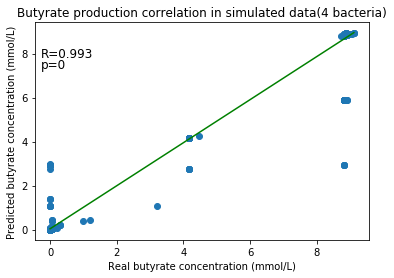

In [21]:
plt.title ('Butyrate production correlation in simulated data(4 bacteria)')  
plt.scatter (x4, y4)  
plt.plot (np.unique(x4), np.poly1d(np.polyfit(x4,y4, 1))(np.unique(x4)), color = 'green')  
plt.xlabel ('Real butyrate concentration (mmol/L)')  
plt.ylabel ('Predicted butyrate concentration (mmol/L)') 
plt.annotate("R=0.993",xy=(2, 9), xycoords='data',
            xytext=(0.5, 8),size=12, va="center", ha="center")
plt.annotate("p=0",xy=(2, 9), xycoords='data',
            xytext=(0.1,7.5),size=12, va="center", ha="center")
plt.savefig("Correlation4bact_S.png", dpi=300,bbox_inches='tight')

# 5 bacteria

In [25]:
tr5=pd.read_table(folder + "simulaciones/res_simulations/train_data_simulated/train_5bactS")



In [16]:
X5 = tr5.iloc [:, 1:146].values
y5 = tr5.iloc[:, 0].values


In [17]:
neigh = KNeighborsRegressor(n_neighbors=3)
neigh.fit(X5, y5)
dump(neigh, 'knn_5bact.joblib') 

['knn_5bact.joblib']

In [279]:
neigh

KNeighborsRegressor(n_neighbors=3)

In [18]:
from sklearn.model_selection import LeaveOneOut
loo = LeaveOneOut()
loo.get_n_splits(X5)

8210

In [19]:
for i, (train_index, test_index) in enumerate(loo.split(X5)):
    X5_train, X5_test = X5[train_index], X5[test_index]
 #   print(neigh.predict(X_test))
    print("real value " +str(y5[i])+"\tpredict: "+ str(neigh.predict(X5_test)))

real value 3.5860770000000003e-06	predict: [1.195359e-06]
real value 0.0	predict: [7.14138183e-06]
real value 0.04149099525803799	predict: [0.01489519]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [1.265847e-07]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [3.67125e-08]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 8.80848084539408	predict: [2.93616028]
real value 8.80848084528767	predict: [5.87232056]
real value 8.80848084534592	predict: [5.87232112]
real value 9.04085205787932	predict: [5.94977774]
real value 8.808480845322551	predict: [8.80950541]
real value 8.808552514903301	predict: [8.80850618]
real value 8.808555215181029	predict: [8.80854817]
real value 8.80848517597788	predict: [8.80852482]
real value 8.8084808453451	predict: [8.80854817]
real value 8.80848084537801	predict: [8.80850564]
real value 8.87821523677657	predict: [8.85494936]
real value 8.81155454969753	predict: [8.80950

real value 0.0	predict: [2.1980508e-05]
real value 0.0	predict: [0.]
real value 0.0	predict: [1.43329154e-05]
real value 7.286697e-06	predict: [2.3310969e-05]
real value 0.069789688607017	predict: [0.06978603]
real value 0.069799475363716	predict: [0.06977825]
real value 0.069772227085481	predict: [0.06979515]
real value 2.1763170000000002e-07	predict: [2.646237e-07]
real value 5.762394000000001e-07	predict: [4.6269498e-06]
real value 2.793087e-08	predict: [9.31029e-09]
real value 0.0	predict: [1.7751228e-06]
real value 0.0	predict: [0.]
real value 0.0	predict: [1.583043e-06]
real value 0.0	predict: [1.324587e-08]
real value 4.749129e-06	predict: [1.583043e-06]
real value 0.0	predict: [5.37471e-08]
real value 0.0	predict: [1.433256e-05]
real value 3.295314e-06	predict: [3.277692e-06]
real value 1.6124129999999998e-07	predict: [5.37471e-08]
real value 0.0	predict: [3.55377e-10]
real value 6.5377620000000005e-06	predict: [3.277692e-06]
real value 2.220372e-06	predict: [7.40124e-07]
real 

real value 8.808480845298739	predict: [8.80848085]
real value 8.87827670144742	predict: [8.85500303]
real value 8.80848084534146	predict: [8.80848085]
real value 8.80848084537299	predict: [8.80848085]
real value 8.808480845388551	predict: [8.80848085]
real value 8.808480845349711	predict: [8.80848085]
real value 8.8084808453832	predict: [8.80848085]
real value 8.808480845316259	predict: [8.80848085]
real value 8.80848084534944	predict: [8.80848085]
real value 8.808480845348651	predict: [8.80848085]
real value 8.808480845390552	predict: [8.80848085]
real value 8.808480845368098	predict: [8.80848085]
real value 8.808480845379991	predict: [8.80848085]
real value 8.808480845317609	predict: [8.80848085]
real value 8.878246481966421	predict: [8.87824166]
real value 8.80848084533768	predict: [8.8085163]
real value 8.808480845341231	predict: [8.80848085]
real value 8.80848084534161	predict: [8.80848085]
real value 8.80848084543096	predict: [8.80848085]
real value 8.8084808453524	predict: [8.80

real value 8.80848084537591	predict: [8.80848085]
real value 8.80848084539082	predict: [8.80848085]
real value 8.8084808453603	predict: [8.80848085]
real value 8.80848084533184	predict: [8.80848085]
real value 8.80848084531943	predict: [8.80848085]
real value 8.80848084538583	predict: [8.80848085]
real value 8.80848084539203	predict: [8.80848085]
real value 8.80848084535286	predict: [8.80848085]
real value 8.80848084537562	predict: [8.80848085]
real value 8.80848084530832	predict: [8.80848085]
real value 8.80848084533388	predict: [8.80848085]
real value 8.80848084539376	predict: [8.80848085]
real value 8.80848084540073	predict: [8.80848085]
real value 8.80848084537378	predict: [8.80848085]
real value 8.80848084540146	predict: [8.80848085]
real value 8.80848084539992	predict: [8.80848085]
real value 8.80848084535588	predict: [8.80848085]
real value 8.808480845326741	predict: [8.80848085]
real value 8.80848084534705	predict: [8.80848085]
real value 8.80848084532459	predict: [8.80848085]


real value 8.80848084531282	predict: [8.80848085]
real value 8.80848084532106	predict: [8.80960031]
real value 8.81183924604472	predict: [8.80975744]
real value 8.80848084533582	predict: [8.80848085]
real value 8.80848084532364	predict: [8.80848085]
real value 8.808480845394051	predict: [8.80848085]
real value 8.80848084540422	predict: [8.8414632]
real value 8.80848084537925	predict: [8.80848085]
real value 8.80848084530579	predict: [8.80848085]
real value 8.80848084536901	predict: [8.80848085]
real value 8.808480845351461	predict: [8.80861116]
real value 8.80848084535845	predict: [8.80848085]
real value 8.808480845351038	predict: [8.80848085]
real value 8.8084808453822	predict: [8.80848085]
real value 8.808480845340869	predict: [8.8414632]
real value 8.80848084538512	predict: [8.80848085]
real value 8.808480845325029	predict: [8.80848085]
real value 8.808480845307368	predict: [8.80848085]
real value 8.8084808453444	predict: [8.80955337]
real value 8.80848084537623	predict: [8.80848085

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 1.3128389999999999e-09	predict: [1.168926e-09]
real value 0.0	predict: [0.]
real value 0.069737749854886	predict: [0.0697696]
real value 0.069784532011197	predict: [0.06981539]
real value 0.069833144409397	predict: [0.06982022]
real value 0.06980632487151299	predict: [0.06977337]
real value 0.0699042145823	predict: [0.06982729]
real value 0.06980998964793401	predict: [0.06981272]
real value 0.069774050310748	predict: [0.06977465]
real value 0.069767730396972	predict: [0.06976738]
real value 0.069724267622718	predict: [0.06973322]
real value 0.069781371110931	predict: [0.07049189]
real value 0.07201581702079901	predict: [0.07054395]
real value 0.069808622814599	predict: [0.06975299]
real val

real value 0.0	predict: [0.]
real value 0.0	predict: [9.49546852e-05]
real value 0.0	predict: [0.000123]
real value 0.0	predict: [0.]
real value 0.000284864055453	predict: [0.02875548]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.00765226]
real value 0.022956778009761005	predict: [0.00765226]
real value 0.0	predict: [0.]
real value 0.000277174909569	predict: [0.00028438]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 1.87688799047219e-05	predict: [0.00175836]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.0002039]
rea

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.00096959848965	predict: [0.00083748]
real value 0.103025015103497	predict: [0.03439981]
real value 0.000643758808077	predict: [0.00048193]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0005801017836540001	predict: [0.00020667]
real value 0.0	predict: [0.]
real value 0.004412999607704001	predict: [0.001471]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.00662322]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.01047421]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.069672803363528	predict: [0.06984794]
real value 0.069774849540294	predict: [0.06976458]
real value 0.069783614592417	predict: [0.06977312]
real value 0.069790828763037	predict: [0.06974807]
real value 0.069775754101028

real value 8.80848084536102	predict: [8.80848542]
real value 8.80848084538163	predict: [8.80848788]
real value 8.80848084538097	predict: [8.80848085]
real value 8.878224528369211	predict: [8.87820033]
real value 8.8085285497084	predict: [8.80873911]
real value 8.80848084544956	predict: [8.80848085]
real value 8.808480845397028	predict: [8.80848085]
real value 8.808496439294501	predict: [8.80848604]
real value 8.80848084538399	predict: [8.80848085]
real value 8.80850193575725	predict: [8.80848788]
real value 8.808480845338481	predict: [8.80848788]
real value 8.80848084536065	predict: [8.80848085]
real value 8.808480845325839	predict: [8.80848085]
real value 8.80848084532043	predict: [8.80849097]
real value 8.87819418790817	predict: [8.87821092]
real value 8.808905986585831	predict: [8.80862256]
real value 8.80848084540184	predict: [8.80848085]
real value 8.80850178394463	predict: [8.80848782]
real value 8.80848440660737	predict: [8.80848203]
real value 8.80851517966143	predict: [8.80849

real value 8.80848084533087	predict: [8.80848085]
real value 8.878277577367081	predict: [8.87820359]
real value 8.80848084533195	predict: [8.80848085]
real value 8.808480845384901	predict: [8.80848085]
real value 8.80849101418602	predict: [8.80848981]
real value 8.80848084536297	predict: [8.80854477]
real value 8.80848084533949	predict: [8.80848085]
real value 8.80849074282143	predict: [8.80848414]
real value 8.808480845326882	predict: [8.80848414]
real value 8.808480845364269	predict: [8.80848085]
real value 8.87832114975019	predict: [8.87823446]
real value 8.8782517143341	predict: [8.87823604]
real value 8.87824680006996	predict: [8.911224]
real value 8.87827685287661	predict: [8.87824161]
real value 8.87827195848682	predict: [8.8782569]
real value 8.87817210492248	predict: [8.87826717]
real value 8.87818355226743	predict: [8.87822842]
real value 8.878274849372929	predict: [8.87822401]
real value 8.878180542041001	predict: [8.878204]
real value 8.80849481015286	predict: [8.80867623]


real value 8.878198922346849	predict: [8.878204]
real value 8.808480845351982	predict: [8.8084855]
real value 8.808480845361231	predict: [8.8106928]
real value 8.81046672201304	predict: [8.80939972]
real value 8.808495454237109	predict: [8.80848571]
real value 8.80848084536649	predict: [8.80848085]
real value 8.808497164999538	predict: [8.80849033]
real value 8.808480845338721	predict: [8.80848085]
real value 8.80848084534697	predict: [8.80848085]
real value 8.808480845321132	predict: [8.8084846]
real value 8.80849904364765	predict: [8.84146926]
real value 8.80848084537598	predict: [8.80848085]
real value 8.80848084536807	predict: [8.84146875]
real value 8.9074279027159	predict: [8.8414632]
real value 8.80848084531062	predict: [8.88581206]
real value 8.8084808453431	predict: [8.80848085]
real value 8.809210337388631	predict: [8.8095532]
real value 8.808480845359949	predict: [8.8084849]
real value 8.80848084537676	predict: [8.80848751]
real value 8.80848084533232	predict: [8.80848791]
r

real value 6.15506443087167e-05	predict: [3.46436056e-05]
real value 0.0	predict: [0.00019485]
real value 0.0	predict: [5.54550868e-06]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 4.5403860189823205e-05	predict: [1.51346201e-05]
real value 0.0	predict: [1.32584394e-06]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [1.32584394e-06]
real value 0.0	predict: [0.]
real value 0.0	predict: [4.11779693e-06]
real value 0.0	predict: [4.80493318e-05]
real value 1.3966193715304599e-05	predict: [2.02592065e-05]
real value 0.069717919980731	predict: [0.06975965]
real value 0.069646828867375	predict: [0.0696761]
real value 0.069803493077241	predict: [0.0697806]
real value 0.0	predict: [0.00412872]
real value 2.08372751968339e-05	predict: [6.9457584e-06]
real value 0.0	predict: [0.00028022]
real value 0.0	predict: [5.48237583e-06]
real value 0.0	predict: [1.32606534e-05]
real value 4.56094491425064e-06	predict: [1.52031497e-06]
real value 0.

real value 0.0	predict: [2.12400679e-05]
real value 4.4638474164962304e-06	predict: [1.48794914e-06]
real value 0.0	predict: [0.]
real value 0.0	predict: [2.12400679e-05]
real value 0.0	predict: [1.48794914e-06]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.06982241691843599	predict: [0.0698145]
real value 0.06975982716317099	predict: [0.06993004]
real value 0.06981194771238901	predict: [0.06975767]
real value 0.00042398189679400004	predict: [0.00014861]
real value 0.00010899599930299999	predict: [3.63319998e-05]
real value 6.37710767344279e-06	predict: [0.00054552]
real value 0.0	predict: [3.66919966e-06]
real value 0.0	predict: [5.87240696e-06]
real value 0.0	predict: [1.17942231e-05]
real value 7.058240068626949e-05	predict: [2.35274669e-05]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 6.37202035538992e-05	predict: [2.12400679e-05]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	pr

real value 0.0	predict: [0.]
real value 1.3654463676322801e-05	predict: [4.55148789e-06]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [4.55148789e-06]
real value 0.0	predict: [0.]
real value 0.0	predict: [2.95716427e-05]
real value 0.0	predict: [4.13952929e-06]
real value 0.0	predict: [5.5338984e-05]
real value 0.000264735061025	predict: [8.82450203e-05]
real value 0.0	predict: [2.6810883e-05]
real value 0.0	predict: [0.]
real value 0.0	predict: [6.43251378e-06]
real value 0.0	predict: [5.47354738e-06]
real value 0.0	predict: [2.55006151e-05]
real value 7.50244135348012e-05	predict: [2.50081378e-05]
real value 1.7321351131225e-05	predict: [5.77378371e-06]
real value 0.069759443270651	predict: [0.06978261]
real value 0.06980315724042001	predict: [0.06978112]
real value 0.06976913944164	predict: [0.06978545]
real value 2.3688592430672198e-05	predict: [0.0006815]
real value 0.00013472878169	predict: [0.00029798]
real value 0.0	predict: [0.00124217]
rea

real value 0.069761646542759	predict: [0.06978193]
real value 0.069816014522623	predict: [0.0699753]
real value 0.07040894511269799	predict: [0.06999327]
real value 0.06982010763107599	predict: [0.06975965]
real value 0.06970094489271499	predict: [0.06975727]
real value 0.06975485606282901	predict: [0.06995492]
real value 0.069661302853522	predict: [0.06974139]
real value 0.06980502776636	predict: [0.06974718]
real value 0.069726304780153	predict: [0.06974788]
real value 0.069731673966784	predict: [0.06983171]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 6.121339966197211e-05	predict: [0.00020831]
real value 0.0	predict: [0.]
real value 5.41749528064411e-06	predict: [2.22393121e-05]
real value 0.0	predict: [1.73502076e-05]
real value 9.52390869884446e-06	predict: [3.17463623e-06]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [2.16801131e-05]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 4.99383319746213e

real value 0.003053901276298	predict: [0.00101797]
real value 3.69094789123273e-05	predict: [0.00027713]
real value 0.0	predict: [0.00041376]
real value 0.0	predict: [5.28433507e-06]
real value 0.0	predict: [0.]
real value 0.0	predict: [1.01361866e-05]
real value 0.0009161927096000001	predict: [0.00033935]
real value 4.3281520970494894e-05	predict: [1.44271737e-05]
real value 0.0	predict: [8.16913465e-06]
real value 9.276467034021421e-05	predict: [0.00034234]
real value 0.0	predict: [2.03044086e-05]
real value 0.0	predict: [4.03451686e-06]
real value 0.0	predict: [3.31546298e-05]
real value 0.0	predict: [1.8537811e-06]
real value 0.0	predict: [2.6810883e-05]
real value 0.0	predict: [0.]
real value 2.19538022704404e-05	predict: [1.37504479e-05]
real value 0.0	predict: [5.47354738e-06]
real value 0.0	predict: [0.00067912]
real value 4.63814616833175e-06	predict: [1.45349185e-05]
real value 0.0	predict: [0.00059926]
real value 0.0	predict: [3.92131074e-06]
real value 0.0	predict: [0.]
rea

real value 1.8379195497781698e-05	predict: [2.93617044]
real value 0.0	predict: [2.93658701]
real value 0.0	predict: [2.93616028]
real value 1.2105697843797199e-05	predict: [2.93643343]
real value 0.0012801898570790002	predict: [2.93658701]
real value 0.0	predict: [2.9362022]
real value 2.4080515492561397e-05	predict: [2.93616831]
real value 8.80848084533044	predict: [2.93632577]
real value 8.80848084533011	predict: [5.87232056]
real value 8.808480845392289	predict: [5.87239009]
real value 8.80848084540971	predict: [5.87255978]
real value 8.80848084533383	predict: [8.80919257]
real value 8.81058640888652	predict: [8.8120194]
real value 8.80901333432533	predict: [8.80865834]
real value 8.80848084537033	predict: [8.80848085]
real value 8.80848084534406	predict: [8.80848851]
real value 8.808480845321	predict: [8.80848085]
real value 8.80848084533208	predict: [8.80868055]
real value 8.80848084536997	predict: [8.80848085]
real value 8.80848084533027	predict: [8.80848085]
real value 8.808480

real value 8.80848084535388	predict: [8.80848085]
real value 8.80848084533727	predict: [8.80848085]
real value 8.80848084530824	predict: [8.80848085]
real value 8.808480845338051	predict: [8.80848085]
real value 8.808480845331859	predict: [8.80848085]
real value 8.80848084538815	predict: [8.80848085]
real value 8.808480845334712	predict: [8.80848085]
real value 8.80848084537808	predict: [8.80848085]
real value 8.808480845379789	predict: [8.80848085]
real value 8.80848084537778	predict: [8.80848085]
real value 8.808506514605241	predict: [8.8084894]
real value 8.80848084533043	predict: [8.80848085]
real value 8.80848084535115	predict: [8.80848085]
real value 8.80848084535953	predict: [8.80848085]
real value 8.80907996544415	predict: [8.8248791]
real value 8.80848084533949	predict: [8.80848085]
real value 8.808480845364391	predict: [8.80848085]
real value 8.80848084537651	predict: [8.80848085]
real value 8.80848084536002	predict: [8.80848085]
real value 8.808480845383961	predict: [8.80848

real value 8.80903746391648	predict: [8.80866638]
real value 8.80848084537725	predict: [8.80848085]
real value 8.808524739226211	predict: [8.80849548]
real value 8.80848084538294	predict: [8.80848085]
real value 8.80848084533348	predict: [8.80848085]
real value 8.808480845342409	predict: [8.80848085]
real value 8.808480845356438	predict: [8.8084894]
real value 8.80848084534275	predict: [8.80848085]
real value 8.80848084537434	predict: [8.80848085]
real value 8.8084808452708	predict: [8.80848085]
real value 8.87812557422418	predict: [8.87817635]
real value 8.87820128337977	predict: [9.25275372]
real value 8.878236665487881	predict: [8.87822133]
real value 8.87811968185136	predict: [8.87820416]
real value 10.001934288602001	predict: [9.25278721]
real value 8.87822604614265	predict: [8.87820925]
real value 8.87825624935792	predict: [8.87817787]
real value 8.878165040523669	predict: [8.87820827]
real value 8.878157671484962	predict: [8.87823076]
real value 8.87823653988734	predict: [8.8781

real value 8.878232993688401	predict: [8.91115723]
real value 8.878309795064359	predict: [8.87822371]
real value 8.87829642084773	predict: [8.8782699]
real value 8.87822904009322	predict: [8.87825067]
real value 8.878241173563868	predict: [8.87824191]
real value 8.80859046704083	predict: [8.80917745]
real value 8.80848084537005	predict: [8.80848085]
real value 8.80878536717449	predict: [8.80873529]
real value 8.808480845339	predict: [8.80848085]
real value 8.808480845345029	predict: [8.80848085]
real value 8.808480845349369	predict: [8.80848085]
real value 8.80848084532297	predict: [8.80848085]
real value 8.808480845396868	predict: [8.80848085]
real value 8.808480845316101	predict: [8.80848085]
real value 8.80848084527609	predict: [8.80848085]
real value 8.808480845402	predict: [8.80848085]
real value 8.80848084540627	predict: [8.80848085]
real value 8.80848084535745	predict: [8.80848085]
real value 8.80848084536214	predict: [8.80848085]
real value 8.808480845381991	predict: [8.8084808

real value 8.80848084531176	predict: [8.80848085]
real value 8.808480845352689	predict: [8.80848085]
real value 8.87820887968289	predict: [8.87821246]
real value 8.87820327824137	predict: [8.87823161]
real value 8.87821275975926	predict: [8.87818827]
real value 8.878280763537369	predict: [8.87823193]
real value 8.87828268490456	predict: [8.87821158]
real value 8.87814878333532	predict: [8.87822737]
real value 8.8781951483084	predict: [8.91120901]
real value 8.8783205567335	predict: [8.87823326]
real value 8.977151124143731	predict: [8.9112127]
real value 8.87821528927374	predict: [8.91121702]
real value 8.87820913752227	predict: [8.8781905]
real value 8.8781319153896	predict: [8.87820894]
real value 8.87828575867522	predict: [8.87821604]
real value 8.87823045199341	predict: [8.8782846]
real value 8.87829182154308	predict: [8.91123458]
real value 8.878260795079779	predict: [8.87825781]
real value 8.878220821180001	predict: [8.87825781]
real value 8.87830279259524	predict: [8.8782787]
re

real value 8.808480845400869	predict: [8.80848085]
real value 8.80848084538502	predict: [8.80848085]
real value 8.80848084529382	predict: [8.81115912]
real value 8.80848084536512	predict: [8.80848085]
real value 8.80848084538976	predict: [8.80848085]
real value 8.80848084534658	predict: [8.80848085]
real value 8.80848084537995	predict: [8.80848085]
real value 8.808480845397211	predict: [8.80848085]
real value 8.808480845324429	predict: [8.80848085]
real value 8.808480845360311	predict: [8.80848085]
real value 8.80848084535268	predict: [8.80848085]
real value 8.80848084534153	predict: [8.80848085]
real value 8.808480845371301	predict: [8.80848085]
real value 8.80848084533974	predict: [8.80848085]
real value 8.80848084532988	predict: [8.80848085]
real value 8.8084808454124	predict: [8.80848085]
real value 8.808480845367429	predict: [8.80848085]
real value 8.80848084531133	predict: [8.80848085]
real value 8.80848084531409	predict: [8.80848085]
real value 8.808480845350699	predict: [8.8086

real value 8.80848084537316	predict: [8.80848085]
real value 8.80848084534611	predict: [8.80848085]
real value 8.80848084533736	predict: [8.80848085]
real value 8.8084808453597	predict: [8.80848085]
real value 8.8091856304662	predict: [8.80871577]
real value 8.808480845366859	predict: [8.80848085]
real value 8.80848084534408	predict: [8.80848085]
real value 8.808480845345711	predict: [8.80848085]
real value 8.808480845305962	predict: [8.80848085]
real value 8.80848084531939	predict: [8.80848085]
real value 8.80848084538097	predict: [8.80883141]
real value 8.80848084535922	predict: [8.80848085]
real value 8.80848084536479	predict: [8.80848085]
real value 8.808480845359009	predict: [8.80848085]
real value 8.80886548458694	predict: [8.80864764]
real value 8.80848084538125	predict: [8.80848085]
real value 8.808480845338199	predict: [8.8414632]
real value 8.808480845311038	predict: [8.80848085]
real value 8.80848084529193	predict: [8.80848085]
real value 8.80848084535435	predict: [8.8085095

real value 8.87822521030863	predict: [8.8782141]
real value 8.87822338594156	predict: [8.8782276]
real value 8.87833454561413	predict: [8.87827653]
real value 8.87821986428143	predict: [8.87823516]
real value 8.87819493634975	predict: [8.88270781]
real value 8.87824383540054	predict: [8.8782673]
real value 8.878232931768741	predict: [8.87822886]
real value 8.87827227975174	predict: [8.87823917]
real value 8.87821528694006	predict: [8.87819391]
real value 8.878235924439869	predict: [8.8782359]
real value 8.87823311587697	predict: [8.91121219]
real value 8.97715912951647	predict: [8.91121211]
real value 8.87814188056566	predict: [8.87821003]
real value 8.87815752785483	predict: [8.87824283]
real value 8.8783019787556	predict: [8.87826113]
real value 8.87830963028201	predict: [8.87827289]
real value 8.8782768309833	predict: [8.87829033]
real value 8.87830285398474	predict: [8.87822842]
real value 8.878184731429991	predict: [8.8781949]
real value 8.87822022039359	predict: [8.87821347]
real

real value 8.891705117217699	predict: [8.88275238]
real value 8.878220125124212	predict: [8.87823685]
real value 8.87823378529251	predict: [8.87841831]
real value 8.878202982461561	predict: [8.87821892]
real value 8.87818274127744	predict: [8.87821974]
real value 8.87827505760928	predict: [8.8782671]
real value 8.8782443183318	predict: [8.91125996]
real value 8.878244082824699	predict: [8.87825667]
real value 8.87823889289229	predict: [8.87826386]
real value 8.8782111042239	predict: [8.87824141]
real value 8.87823836787035	predict: [8.87824918]
real value 8.87823221659723	predict: [8.87822425]
real value 8.87828453126794	predict: [8.87826606]
real value 8.87818807937448	predict: [8.87821331]
real value 8.87827045822772	predict: [8.87826076]
real value 8.87824637370593	predict: [8.87934539]
real value 8.87825539675207	predict: [8.87826166]
real value 8.87817408681464	predict: [8.87819753]
real value 8.87826693016234	predict: [8.8782576]
real value 8.87819994904052	predict: [8.87821115]


real value 8.80848084531566	predict: [8.80848085]
real value 8.80848084535803	predict: [8.80848085]
real value 8.80848084531256	predict: [8.80848085]
real value 8.808480845317641	predict: [8.80848085]
real value 8.808480845357149	predict: [8.80848085]
real value 8.80848084536351	predict: [8.80848085]
real value 8.808480845402581	predict: [8.80848085]
real value 8.808480845398892	predict: [8.80871577]
real value 8.80848084536961	predict: [8.80848085]
real value 8.80848084529414	predict: [8.80848085]
real value 8.808480845349589	predict: [8.80848085]
real value 8.80848084532693	predict: [8.80848085]
real value 8.808480845361109	predict: [8.80848085]
real value 8.80953253024831	predict: [8.80883141]
real value 8.80848084532527	predict: [8.80848085]
real value 8.80848084538223	predict: [8.80848085]
real value 8.80848084536316	predict: [8.80848085]
real value 8.820988545272849	predict: [8.81277829]
real value 8.80848084538144	predict: [8.80848085]
real value 8.80848084533121	predict: [8.808

real value 8.90742790275308	predict: [8.8414632]
real value 8.808480845322189	predict: [8.80848085]
real value 8.80870472888433	predict: [8.80855547]
real value 8.80848084538301	predict: [8.80953316]
real value 8.80848084534628	predict: [8.80848085]
real value 8.80848084535574	predict: [8.80848085]
real value 8.811637776697891	predict: [8.80953316]
real value 8.80848084538544	predict: [8.80848085]
real value 8.80848084540046	predict: [8.80849253]
real value 8.80848084539308	predict: [8.80848085]
real value 8.80848084535609	predict: [8.80848085]
real value 8.80848084535401	predict: [8.80848085]
real value 8.808480845383539	predict: [8.80848085]
real value 8.8084808453603	predict: [8.80848085]
real value 8.80848084533823	predict: [8.80848085]
real value 8.80848084535974	predict: [8.8414632]
real value 8.808480845367631	predict: [8.80848085]
real value 8.80848084538432	predict: [8.80848085]
real value 8.808480845365311	predict: [8.80848085]
real value 8.808480845354591	predict: [8.8084808

real value 0.069765796119084	predict: [0.06977096]
real value 0.069767846179471	predict: [0.06976262]
real value 0.06969741593952	predict: [0.06974122]
real value 0.06971525005305	predict: [0.06971803]
real value 0.06975421297433	predict: [0.06976015]
real value 0.069758392038735	predict: [0.06971544]
real value 0.069711806040746	predict: [0.06973258]
real value 0.06969050009647501	predict: [0.06973387]
real value 0.069766275377896	predict: [0.06975461]
real value 0.069822338769761	predict: [0.06986512]
real value 0.070020314702705	predict: [0.06985347]
real value 0.069752707531506	predict: [0.06975518]
real value 0.06981798934477099	predict: [0.06972954]
real value 0.069666225182268	predict: [0.06981662]
real value 0.069833287506243	predict: [0.06979072]
real value 0.069704404112877	predict: [0.06982934]
real value 0.069965638417955	predict: [0.06977876]
real value 0.069789649259855	predict: [0.06977328]
real value 0.06965049570255999	predict: [0.06974735]
real value 0.069823916332957

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.069795106980508	predict: [0.06972636]
real value 0.069651076192763	predict: [0.06988836]
real value 0.069661065381573	predict: [0.06971196]
real value 0.0	predict: [2.46332266e-06]
real value 0.0	predict: [0.00216417]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [1.46312893e-05]
real value 0.0	predict: [0.]
real value 0.0	predict: [3.30364169e-06]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.00033212]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.069732899025838	predict: [0.06991564]
real value 0.070218

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [7.86632506e-05]
real value 0.0	predict: [1.46313015e-05]
real value 0.0	predict: [0.]
real value 0.0	predict: [1.46312909e-05]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.00018977]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 2.26120747406442e-05	predict: [7.53735825e-06]
real value 0.0	predict: [1.46313048e-05]
real value 0.0030475498924090005	predict: [0.00101585]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.070237575776755	predict: [0.02341253]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.06971135607684799	predict: [0.06997697]
real value 0.069699094914823	predict: [0.06977576]
real valu

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.00503343]
real value 0.0	predict: [0.00027927]
real value 0.001800372662768	predict: [0.00632412]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.00035623]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.00012544]
real value 9.612742721667379e-05	predict: [3.20424757e-05]
real value 3.89495485645588e-05	predict: [9.16464335e-05]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.00118072]
real value 0.0	predict: [0.]
real value 0.0005693022605060001	predict: [0.00018977]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 4.38939145439584e-05	predict: 

real value 0.0	predict: [4.72857e-09]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [4.05306e-07]
real value 0.0	predict: [8.89911e-10]
real value 2.6697329999999998e-09	predict: [1.98042791e-06]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.00175453]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 3.894462e-06	predict: [1.298154e-06]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [4.72857e-09]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.069844005035149	predict: [0.06980277]
real value 0.06982284137360699	predict: [0.06982062]
real value 0.069796303479045	predict: [0.06976417]
real value 1.4185709999999997e-08	predict: [4.72857e-09]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.00152042]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.00015531]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.000465918529987	predict: [0.00015531]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.00061698]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.00066517]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [8.89158446e-06]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [1.494933e-07]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 3.89734583922485e-05	predict: [5.82879735e-05]
real value 0.0	predict: [

real value 0.0	predict: [0.]
real value 0.0	predict: [9.93176352e-06]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 3.89584389733168e-05	predict: [1.29861463e-05]
real value 0.0	predict: [4.97020251e-05]
real value 0.0	predict: [3.29600248e-05]
real value 0.0	predict: [7.75061722e-05]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.00021413932098900002	predict: [7.54150063e-05]
real value 0.0	predict: [0.00042673]
real value 0.0	predict: [0.]
real value 0.0	predict: [8.0268385e-06]
real value 2.1424145495947898e-05	predict: [7.14138183e-06]
real value 0.0031945895345290003	predict: [0.01489519]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.009738490081442	predict: [0.00324616]
real value 0.0	predict: [0.00696437]
real value 0.0	predict: [0.00016632]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: 

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.03926995]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.00064848]
real value 0.0	predict: [0.]
real value 0.00030252347627799997	predict: [0.00010084]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0013366402381689998	predict: [0.00044555]
real value 0.0	predict: [0.]
real value 0.0	predict: [9.33966e-08]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.01043278]
real value 0.0	predict: [0.00473656]
real value 0.0016702056337339999	predict: [0.00055674]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [4.06167581e-05]
real value 0.0	predict: [0.00034215]
real value 0.000175

real value 0.00049896563024	predict: [0.00016632]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.006610234830677	predict: [0.0023958]
real value 0.0	predict: [5.46303382e-05]
real value 0.0	predict: [7.48922606e-06]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [9.95724897e-05]
real value 0.0	predict: [0.00504363]
real value 0.0	predict: [0.00243218]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.036082247387219005	predict: [0.01202742]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.001140029040139	predict: [0.00038001]
real value 3.89542846816536e-05	predict: [0.00010051]
real value 0.004909188226304	predict: [0.0016364]
real value 0.0	predict: [0.]
r

real value 3.8966685225235e-05	predict: [1.29888951e-05]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.014860627923807	predict: [0.00558706]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.00015778]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.069672479209099	predict: [0.0696897]
real value 0.069769058768047	predict: [0.06974887]
real value 0.06973505671832901	predict: [0.06976711]
real value 0.06978359028358501	pre

real value 0.069750238527136	predict: [0.06977181]
real value 0.069761691429035	predict: [0.06970859]
real value 0.069696927556526	predict: [0.06974367]
real value 0.06982503853285099	predict: [0.06986437]
real value 0.069767836642457	predict: [0.06973575]
real value 0.06976456718080999	predict: [0.06976052]
real value 0.069852304433393	predict: [0.06977556]
real value 0.069764149205099	predict: [0.06973522]
real value 0.06969987179983901	predict: [0.0697523]
real value 0.070277693101406	predict: [0.06991666]
real value 0.069793452880103	predict: [0.06975197]
real value 5.59477989278417e-05	predict: [1.86492663e-05]
real value 0.0	predict: [1.29881315e-05]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.00994008]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.00028455]
real value 0.00032554575985400003	predict: [0.00763353]
real value 0.0	predict: [0.]
re

real value 0.0	predict: [0.00446333]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.000759322307513	predict: [0.00025311]
real value 0.0	predict: [0.00036273]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0007386137299780001	predict: [0.00025919]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.001061683130382	predict: [0.00035389]
real value 0.0	predict: [0.00133831]
real value 0.0	predict: [0.00010537]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.00588635]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [7.14138183e-06]
real value 0.0	predict: [0.01489519]
real value 0.004646113668494	

real value 0.069709621195236	predict: [0.06969566]
real value 0.07056156044156799	predict: [0.07002126]
real value 0.06971828845328501	predict: [0.07988998]
real value 0.069737345088187	predict: [0.06971713]
real value 0.06979284962256099	predict: [0.06975038]
real value 0.100192268239021	predict: [0.07986148]
real value 0.069701859889438	predict: [0.06972038]
real value 0.069725432713248	predict: [0.06973574]
real value 0.069669025353065	predict: [0.06970772]
real value 0.069748764293273	predict: [0.06975386]
real value 0.069682776135456	predict: [0.06969436]
real value 0.069740341352897	predict: [0.06975949]
real value 0.069717398668539	predict: [0.06970327]
real value 0.06974534590172299	predict: [0.04650331]
real value 0.069764581631924	predict: [0.07014444]
real value 0.069844505090293	predict: [0.06994624]
real value 0.069699870976688	predict: [0.06970825]
real value 0.07092337929839301	predict: [0.07030587]
real value 0.070229643069323	predict: [0.06992365]
real value 0.06970555

In [23]:
dat5=pd.read_table("/home/clau/Escritorio/train_real_pred_5")
y5 = dat5.iloc [:, 1].values
x5 = dat5.iloc[:, 0].values

In [31]:
scipy.stats.pearsonr(x5,y5)    # Pearson's r


(0.9971302385314246, 0.0)

In [32]:
scipy.stats.spearmanr(x5,y5) 

SpearmanrResult(correlation=0.9494516753451775, pvalue=0.0)

In [34]:
scipy.stats.linregress(x5,y5) 

LinregressResult(slope=0.9924242147500514, intercept=0.013481015308028699, rvalue=0.9971302385314251, pvalue=0.0, stderr=0.0008316735420579529)

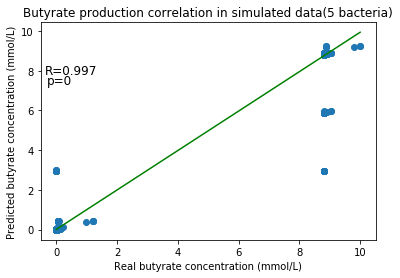

In [24]:
plt.title ('Butyrate production correlation in simulated data(5 bacteria)')  
plt.scatter (x5, y5)  
plt.plot (np.unique(x5), np.poly1d(np.polyfit(x5,y5, 1))(np.unique(x5)), color = 'green')  
plt.xlabel ('Real butyrate concentration (mmol/L)')  
plt.ylabel ('Predicted butyrate concentration (mmol/L)') 
plt.annotate("R=0.997",xy=(2, 9), xycoords='data',
            xytext=(0.5, 8),size=12, va="center", ha="center")
plt.annotate("p=0",xy=(2, 9), xycoords='data',
            xytext=(0.1,7.5),size=12, va="center", ha="center")
plt.savefig("Correlation5bact_S.png", dpi=300,bbox_inches='tight')

In [ ]:
##TEST new data
tst5=pd.read_table(folder+"nuevos/test/all5_test")
X_test=tst5.iloc [:, 1:146].values
inter=tst5.iloc[:, 0].values
y_pred5 = neigh.predict(X_test)
y_pred5

file_new = open(folder+"nuevos/test/result_test/all5_result_newdata.txt" , "w")
for i in range(0,166):
    print(inter[i]+"\t"+ str(y_pred5[i]))
    file_new.write(inter[i]+"\t"+ str(y_pred5[i])+"\n")
    
file_new.close()

# 6 bacteria

In [42]:
tr6=pd.read_table(folder + "simulaciones/res_simulations/train_data_simulated/train_6bactS")


In [37]:
X6 = tr6.iloc [:, 1:181].values
y6 = tr6.iloc[:, 0].values


In [39]:
neigh = KNeighborsRegressor(n_neighbors=3)
neigh.fit(X6, y6)
dump(neigh, 'knn_6bact.joblib') 

['knn_6bact.joblib']

In [40]:
from sklearn.model_selection import LeaveOneOut
loo = LeaveOneOut()
loo.get_n_splits(X6)

22121

In [41]:
for i, (train_index, test_index) in enumerate(loo.split(X6)):
    X6_train, X6_test = X6[train_index], X6[test_index]
 #   print(neigh.predict(X_test))
    print("real value " +str(y6[i])+"\tpredict: "+ str(neigh.predict(X6_test)))

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 8.80848084529858	predict: [2.93616028]
real value 8.80848084529858	predict: [5.87232056]
real value 8.80848084529858	predict: [5.87232056]
real value 8.80848084529858	predict: [5.87232056]
real value 8.80848084529858	predict: [5.87232056]
real value 8.80848084529858	predict: [5.87232056]
real value 8.80848084529858	predict: [8.80848085]
real value 8.80848084529858	predict: [8.80848085]
real value 8.80848084529858	predict: [8.80848085]
real value 8.80848084529858	predict: [8.80848085]
real value 8.808487173576118	predict: [8.80848295]
real value 8.80848084529858	predict: [8.80848085]
real value 8.80848084529858	predict: [8.80848085]
real value 8.80848084529858	predict: [8.80848085]
real value 8.80848084529858	predict: [8.80848085]
real value 8.87822769373736	predict: [8.85497874]
real value 8.80848084529858	predict: [8.80848295]
real

real value 8.87822769373736	predict: [8.87822769]
real value 8.87822769373736	predict: [8.87822769]
real value 8.87822769373736	predict: [8.87822769]
real value 8.87822769373736	predict: [8.87822769]
real value 8.87822769373736	predict: [8.87822769]
real value 8.87822769373736	predict: [8.87822769]
real value 8.87822769373736	predict: [8.87822769]
real value 8.80848084529858	predict: [8.80848085]
real value 8.80848084529858	predict: [8.80848085]
real value 8.80848084529858	predict: [8.80848085]
real value 8.80848084529858	predict: [8.80848085]
real value 8.80848084529858	predict: [8.80848085]
real value 8.80848084529858	predict: [8.80848085]
real value 8.80848084529858	predict: [8.80848085]
real value 8.80848084529858	predict: [8.80848085]
real value 8.80848084529858	predict: [8.80848085]
real value 8.80848084529858	predict: [8.80848085]
real value 8.80848084529858	predict: [8.80848085]
real value 8.80848084529858	predict: [8.80848085]
real value 8.80848084529858	predict: [8.80848085]


real value 8.80848084529858	predict: [8.80848085]
real value 8.80848084529858	predict: [8.80848085]
real value 8.80848084529858	predict: [8.80848085]
real value 8.80848084529858	predict: [8.80848085]
real value 8.80848084529858	predict: [8.80848085]
real value 8.80848084529858	predict: [8.80848085]
real value 8.80848084529858	predict: [8.80848085]
real value 8.80848084529858	predict: [8.80848085]
real value 8.80848084529858	predict: [8.80848085]
real value 8.80848084529858	predict: [8.80848085]
real value 8.80848084529858	predict: [8.80848085]
real value 8.80848084529858	predict: [8.80848085]
real value 8.80848084529858	predict: [8.80848085]
real value 8.80848084529858	predict: [8.80848085]
real value 8.80848084529858	predict: [8.80848085]
real value 8.80848084529858	predict: [8.80848085]
real value 8.80848084529858	predict: [8.80848085]
real value 8.80848084529858	predict: [8.80848085]
real value 8.80848084529858	predict: [8.80848085]
real value 8.80848084529858	predict: [8.80848085]


real value 8.80848084529858	predict: [8.80848085]
real value 8.80848084529858	predict: [8.80848085]
real value 8.80848084529858	predict: [8.80848085]
real value 8.80848084529858	predict: [8.80848085]
real value 8.80848084529858	predict: [8.80848085]
real value 8.80848084529858	predict: [8.80848085]
real value 8.80848084529858	predict: [8.80848085]
real value 8.80848084529858	predict: [8.80848085]
real value 8.80848084529858	predict: [8.80848085]
real value 8.80848084529858	predict: [8.80848085]
real value 8.80848084529858	predict: [8.80848085]
real value 8.80848084529858	predict: [8.80848085]
real value 8.80848084529858	predict: [8.80848085]
real value 8.80848084529858	predict: [8.80848085]
real value 8.80848084529858	predict: [8.80848085]
real value 8.80848084529858	predict: [8.80848085]
real value 8.80848084529858	predict: [8.80848085]
real value 8.80848084529858	predict: [8.80848085]
real value 8.80848084529858	predict: [8.80848085]
real value 8.80848084529858	predict: [8.80848085]


real value 0.06974684843878098	predict: [0.06974685]
real value 0.06974684843878098	predict: [0.06974685]
real value 0.06974684843878098	predict: [0.06974685]
real value 0.06974684843878098	predict: [0.06974685]
real value 0.06974684843878098	predict: [0.06974685]
real value 0.06974684843878098	predict: [0.06974685]
real value 0.06974684843878098	predict: [0.06974685]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predi

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.06974684843878098	predict: [0.06974685]
real value 0.06974684843878098	predict: [0.06974685]
real value 0.06974684843878098	predict: [0.06974685]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]


real value 0.06974684843878098	predict: [0.06974685]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	pred

real value 0.06974684843878098	predict: [0.06975806]
real value 0.06974684843878098	predict: [0.06975806]
real value 0.06974684843878098	predict: [0.06975806]
real value 0.06974684843878098	predict: [0.06975806]
real value 0.06974684843878098	predict: [0.06975806]
real value 0.06974684843878098	predict: [0.06975806]
real value 0.06974684843878098	predict: [0.06975806]
real value 0.06974684843878098	predict: [0.06975806]
real value 0.06974684843878098	predict: [0.06975806]
real value 0.06974684843878098	predict: [0.06975806]
real value 0.06974684843878098	predict: [0.06975806]
real value 0.06974684843878098	predict: [0.06975806]
real value 0.06974684843878098	predict: [0.06975806]
real value 0.06974684843878098	predict: [0.06975806]
real value 0.06974684843878098	predict: [0.06975806]
real value 0.06974684843878098	predict: [0.06975806]
real value 0.06974684843878098	predict: [0.06975806]
real value 0.06974684843878098	predict: [0.06975806]
real value 0.06974684843878098	predict: [0.069

real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.87826133002084	predict: [8.87826133]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.87826133002084	predict: [8.87826133]
real value 8.87826133002084	predict: [8.87826133]
real value 8.87826133002084	predict: [8.87826133]
real value 8.87826133002084	predict: [8.87826133]
real value 8.87826133002084	predict: [8.87826133]


real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]


real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]


real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.87826133002084	predict: [8.87826133]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.87826133002084	predict: [8.87826133]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]


real value 8.87826133002084	predict: [8.87826133]
real value 8.87826133002084	predict: [8.87826133]
real value 8.87826133002084	predict: [8.87826133]
real value 8.87826133002084	predict: [8.87826133]
real value 8.87826133002084	predict: [8.87826133]
real value 8.87826133002084	predict: [8.87826133]
real value 8.87826133002084	predict: [8.87826133]
real value 8.87826133002084	predict: [8.87826133]
real value 8.87826133002084	predict: [8.87826133]
real value 8.87826133002084	predict: [8.91124368]
real value 8.87826133002084	predict: [8.87826133]
real value 8.87826133002084	predict: [8.87826133]
real value 8.87826133002084	predict: [8.87826133]
real value 8.977208387125321	predict: [8.91124368]
real value 8.87826133002084	predict: [8.87826133]
real value 8.87826133002084	predict: [8.87826133]
real value 8.87826133002084	predict: [8.87826133]
real value 8.87826133002084	predict: [8.87826133]
real value 8.87826133002084	predict: [8.87826133]
real value 8.87826133002084	predict: [8.87826133]

real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.87826133002084	predict: [8.87826133]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]


real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]


real value 8.87826133002084	predict: [8.87826133]
real value 8.87826133002084	predict: [8.87826133]
real value 8.87826133002084	predict: [8.87826133]
real value 8.87826133002084	predict: [8.87826133]
real value 8.87826133002084	predict: [8.87826133]
real value 8.87826133002084	predict: [8.87826133]
real value 8.87826133002084	predict: [8.87826133]
real value 8.87826133002084	predict: [8.87826133]
real value 8.87826133002084	predict: [8.87826133]
real value 8.87826133002084	predict: [8.87826133]
real value 8.87826133002084	predict: [8.87826133]
real value 8.87826133002084	predict: [9.18298282]
real value 9.79242581437048	predict: [9.18298282]
real value 8.87826133002084	predict: [8.87826133]
real value 8.87826133002084	predict: [8.87826133]
real value 8.87826133002084	predict: [8.87826133]
real value 8.87826133002084	predict: [8.87826133]
real value 8.87826133002084	predict: [8.87826133]
real value 8.87826133002084	predict: [8.87826133]
real value 8.87826133002084	predict: [8.87826133]


real value 8.87826133002084	predict: [8.87826133]
real value 8.87826133002084	predict: [8.87826133]
real value 8.87826133002084	predict: [8.87826133]
real value 8.87826133002084	predict: [8.87826133]
real value 8.87826133002084	predict: [8.87826133]
real value 8.87826133002084	predict: [8.87826133]
real value 8.87826133002084	predict: [8.87826133]
real value 8.87826133002084	predict: [8.87826133]
real value 8.87826133002084	predict: [8.87826133]
real value 8.87826133002084	predict: [8.87826133]
real value 8.87826133002084	predict: [8.87826133]
real value 8.87826133002084	predict: [8.87826133]
real value 8.87826133002084	predict: [8.87826133]
real value 8.87826133002084	predict: [8.87826133]
real value 8.87826133002084	predict: [8.87826133]
real value 8.87826133002084	predict: [8.87826133]
real value 8.87826133002084	predict: [8.87826133]
real value 8.87826133002084	predict: [8.87826133]
real value 8.87826133002084	predict: [8.87826133]
real value 8.87826133002084	predict: [8.87826133]


real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]


real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]
real value 8.80848084537358	predict: [8.80848085]


real value 0.0	predict: [0.]
real value 0.069780484647267	predict: [0.06978048]
real value 0.069780484647267	predict: [0.06978048]
real value 0.069780484647267	predict: [0.06978048]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [1.29881321e-05]
real value 0.0	predict: [0.]
real value 0.069780484647267	predict: [0.06978048]
real value 0.069780484647267	predict: [0.06978048]
real value 0.069780484647267	predict: [0.06978048]
real value 0.069780484647267	predict: [0.06978048]
real value 0.069780484647267	predict: [0.06978048]
real value 0.069780484647267	predict: [0.06978048]
real va

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.069780484647267	predict: [0.06978048]
real value 0.06978048

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.069780484647267	predict: [0.06978048]
real value 0.069780484647267	predict: [0.06978048]
real value 0.069780484647267	predict: [0.06978048]
real value 0.069780484647267	predict: [0.06978048]
real value 0.069780484647267	predict: [0.06978048]
real value 0.069780484647267	predict: [0.06978048]
real value 0.069780484647267	predict: [0.06978048]
real value 0.069780484647267	predi

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 8.285827990749899e-05	predict: [2.76194266e-05]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.069780484647267	predict: [0.06978048]
real value 0.069780484647267	predict: [0.06978048]
real value 0.069780484647267	predict: [0.06978048]
real value 0.069780484647267	predict: [0.06978048]
real value 0.069780484647267	predict: [0.06978048]
real value 0.069780484647267	predict: [0.06978048]
real value 0.069780484647267	predict: [0.06978048]
real value 0.069780484647267	predict: [0.06978048]
real value 0.069780484647267	predict: [0.06978048]
real value 0.069780484647267	predict: [0.0697804

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [1.29881321e-05]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
re

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.02324659]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real v

real value 0.06973765152208	predict: [0.06973765]
real value 0.06973765152208	predict: [0.06973765]
real value 0.06973765152208	predict: [0.06973765]
real value 0.06973765152208	predict: [0.06973765]
real value 0.06973765152208	predict: [0.06973765]
real value 0.06973765152208	predict: [0.06973765]
real value 0.06973765152208	predict: [0.06973765]
real value 0.06973765152208	predict: [0.06973765]
real value 0.06973765152208	predict: [0.06973765]
real value 0.06973765152208	predict: [0.06973765]
real value 0.06973765152208	predict: [0.06973765]
real value 0.06973765152208	predict: [0.06973765]
real value 0.06973765152208	predict: [0.06973765]
real value 0.06973765152208	predict: [0.06973765]
real value 0.06973765152208	predict: [0.06973765]
real value 0.06973765152208	predict: [0.06973765]
real value 0.06973765152208	predict: [0.06973765]
real value 0.06973765152208	predict: [0.06973765]
real value 0.06973765152208	predict: [0.06973765]
real value 0.06973765152208	predict: [0.06973765]


real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0

real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80849383]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]


real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]


real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.8414632]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80849548]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.90742790259531	predict: [8.8414632]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
re

real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]


real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.88593792]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]


real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80849548]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80849548]


real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.87821849688285	predict: [8.87821156]
real value 8.87821849688285	predict: [8.8782185]
real value 8.87821849688285	predict: [8.87822371]
real value 8.87821849688285	predict: [8.8782185]
real value 8.87821849688285	predict: [8.8782185]
real value 8.87821849688285	predict: [8.8782185]
real value 8.87821849688285	predict: [8.8782185]
real value 8.87821849688285	predict: [8.8782185]
real value 8.87821849688285	predict: [8.8782185]
real value 8.87821849688285	predict: [8.8782185]
real value 8.87821849688285	predict: [8.8782185]
real value 8.87821849688285	predict: [8.8782185]
real value 8.87821849688285	predict: [8.8782185]
real value 8.87821849688285	predict: [8.8782185]
real value 8.87821849688285	predict: [8.8782185]
real value 8.

real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80852473927915	predict: [8.80849548]


real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.87821849688285	predict: [8.8782185]
real value 8.87821849688285	predict: [8.8782185]
real value 8.87821849688285	predict: [8.8782185]
real value 8.87821849688285	predict: [8.8782185]
real value 8.87821849688285	predict: [8.8782185]
real value 8.87821849688285	predict: [8.8782185]
real value 8.87821849688285	predict: [8.8782185]
real value 8.87821849688285	predict: [8.8782185]
real value 8.87821849688285	predict: [8.8782185]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real valu

real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.87821849688285	predict: [8.8782185]
real value 8.87821849688285	predict: [8.8782185]
real value 8.87821849688285	predict: [8.8782185]
real value 8.87821849688285	predict: [8.8782185]
real value 8.87821849688285	predict: [8.8782185]
real value 8.87821849688285	predict: [8.8782185]
real value 8.87821849688285	predict: [8.8782185]
real value 8.87821849688285	predict: [8.8782185]
real value 8.87821849688285	predict: [8.8782185]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real valu

real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]


real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]


real value 8.87821849688285	predict: [8.8782185]
real value 8.87821849688285	predict: [8.8782185]
real value 8.87821849688285	predict: [8.8782185]
real value 8.87821849688285	predict: [8.8782185]
real value 8.87821849688285	predict: [8.8782185]
real value 8.87821849688285	predict: [8.8782185]
real value 8.87821849688285	predict: [8.8782185]
real value 8.87821849688285	predict: [8.8782185]
real value 8.87821849688285	predict: [8.8782185]
real value 8.87821849688285	predict: [8.8782185]
real value 8.87821849688285	predict: [8.8782185]
real value 8.87821849688285	predict: [8.8782185]
real value 8.87821849688285	predict: [8.8782185]
real value 8.87821849688285	predict: [8.8782185]
real value 8.87821849688285	predict: [8.8782185]
real value 8.87821849688285	predict: [8.8782185]
real value 8.87821849688285	predict: [8.8782185]
real value 8.87821849688285	predict: [8.8782185]
real value 8.87821849688285	predict: [8.8782185]
real value 8.87821849688285	predict: [8.8782185]
real value 8.8782184

real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.8087672]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80881451]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
r

real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.8414632]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
r

real value 8.80848084536077	predict: [8.8414632]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80856158]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.88593792]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
r

real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.8414632]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.87821849688285	predict: [9.18295183]
real value 8.87821849688285	predict: [9.25263617]
real value 8.87821849688285	predict: [8.88794826]
real value 8.87821849688285	predict: [8.87822948]
real value 8.87821849688285	predict: [8.8782095]
real value 8.87821849688285	predict: [8.91122516]
real value 8.87821849688285	predict: [8.88775461]
real value 8.87821849688285	predict: [8.87829005]
real value 8.87821849688285	predict: [8.87824587]
real value 8.87821849688285	predict: [8.87819621]
real value 8.87821849688285	predict: [8.87824797]
re

real value 8.80848084536077	predict: [8.80932264]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80878948]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]


real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]


real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.80848084536077	predict: [8.80848085]
real value 8.87821849688285	predict: [8.87821156]
real value 8.87821849688285	predict: [8.87821969]
real value 8.87821849688285	predict: [8.87822371]
real value 8.87821849688285	predict: [8.8782185]
real value 8.87821849688285	predict: [8.8782175]
real value 8.87821849688285	predict: [8.8782185]
real value 8.87821849688285	predict: [8.8782185]
real value 8.87821849688285	predict: [8.87823776]
real value 8.87821849688285	predict: [8.8782185]
real value 8.87821849688285	predict: [8.87820452]
real value 8.87821849688285	predict: [8.87822695]
real 

real value 8.808480845312099	predict: [8.80848085]
real value 8.808480845367189	predict: [8.80848085]
real value 8.80848084538703	predict: [8.80848085]
real value 8.80848084538024	predict: [8.80848085]
real value 8.80848084539049	predict: [8.80848085]
real value 8.808480845387221	predict: [8.8414632]
real value 8.80848084536461	predict: [8.80848085]
real value 8.808480845354401	predict: [8.80848085]
real value 8.90742790261627	predict: [8.8414632]
real value 8.80859304899959	predict: [8.80851825]
real value 8.80848084532784	predict: [8.80848085]
real value 8.808480845307571	predict: [8.80848085]
real value 8.80848084535507	predict: [8.80848085]
real value 8.80848084536213	predict: [8.80848085]
real value 8.80848084534313	predict: [8.80848085]
real value 8.80848084532085	predict: [8.80848085]
real value 8.808480845359	predict: [8.80848085]
real value 8.80848084533127	predict: [8.80848085]
real value 8.80916948344593	predict: [8.81244857]
real value 8.80848084537534	predict: [8.80848085]

real value 8.87822608243942	predict: [8.8782209]
real value 8.87826991109096	predict: [8.8782422]
real value 8.87826652629332	predict: [8.8782265]
real value 8.879320359353962	predict: [8.87868524]
real value 8.87824020200867	predict: [8.87821978]
real value 8.878242983329779	predict: [8.87823384]
real value 8.87820237599907	predict: [8.87819217]
real value 8.878300799392779	predict: [8.87823702]
real value 8.878134986383449	predict: [8.87819416]
real value 8.87821586214084	predict: [8.87822229]
real value 8.87824819261905	predict: [8.87823199]
real value 8.87820369694198	predict: [8.9111985]
real value 8.87820520062993	predict: [8.87822114]
real value 8.87824556130189	predict: [8.87822474]
real value 8.8783252683038	predict: [8.87824087]
real value 8.878263606366401	predict: [8.87825101]
real value 8.87823251791815	predict: [8.87822229]
real value 8.878229286127391	predict: [8.87823199]
real value 8.97717329869793	predict: [8.9111985]
real value 8.87823971360914	predict: [8.87822114]


real value 8.80848084536473	predict: [8.80848085]
real value 8.80848084536114	predict: [8.80848085]
real value 8.90742790277178	predict: [8.8414632]
real value 8.80848084538366	predict: [8.80848085]
real value 8.80848084531852	predict: [8.80848085]
real value 8.80848084535935	predict: [8.80848085]
real value 8.808480845361949	predict: [8.80848085]
real value 8.8084808453648	predict: [8.80848085]
real value 8.80848084531431	predict: [8.80848085]
real value 8.80848084533502	predict: [8.80848085]
real value 8.80848084533394	predict: [8.80848085]
real value 8.8084808453672	predict: [8.80848085]
real value 8.80848929673129	predict: [8.81969303]
real value 8.90742790274556	predict: [8.8414632]
real value 8.80977319577597	predict: [8.80891163]
real value 8.808480845334461	predict: [8.8414632]
real value 8.80848084535299	predict: [8.80848085]
real value 8.80848084533866	predict: [8.80848085]
real value 8.80848084532457	predict: [8.80848085]
real value 8.820547239729368	predict: [8.84553647]
re

real value 8.808480845320892	predict: [8.80848085]
real value 8.80848084538516	predict: [8.80848085]
real value 8.81028909989678	predict: [8.8090836]
real value 8.80848084530689	predict: [8.88598903]
real value 8.808480845329118	predict: [8.80848085]
real value 8.9074279027823	predict: [8.84211565]
real value 8.80848084533286	predict: [8.80848085]
real value 8.80848084536074	predict: [8.80848085]
real value 8.808480845373381	predict: [8.8414632]
real value 8.808480845363981	predict: [8.80849771]
real value 8.80848084533718	predict: [8.80932264]
real value 8.80848084540222	predict: [8.80848085]
real value 8.80848084527977	predict: [8.80848085]
real value 8.808480845337211	predict: [8.80848085]
real value 8.80848084529288	predict: [8.80848085]
real value 8.80848084530597	predict: [8.80848085]
real value 8.80848084532361	predict: [8.80878948]
real value 8.80848084528569	predict: [8.80848085]
real value 8.80848084534489	predict: [8.80848085]
real value 8.80848084535022	predict: [8.80848085

real value 8.878237510780561	predict: [8.87820274]
real value 8.87817859816978	predict: [8.87852635]
real value 8.87828860391065	predict: [8.87825309]
real value 8.8781898163868	predict: [8.87824227]
real value 8.878244576449971	predict: [8.87824183]
real value 8.878209189554891	predict: [8.91120211]
real value 8.87824622030342	predict: [8.87880786]
real value 8.878178107364882	predict: [8.87823653]
real value 8.97714218742424	predict: [8.94419258]
real value 8.87827788475545	predict: [8.87818409]
real value 8.878247971210461	predict: [8.87825984]
real value 9.110164026954699	predict: [8.94350059]
real value 8.87822882192374	predict: [8.95549991]
real value 8.87825377979076	predict: [8.85498792]
real value 8.87810687990464	predict: [8.878232]
real value 8.87822914807577	predict: [8.87823099]
real value 8.878216541974721	predict: [8.8782224]
real value 8.878360308713539	predict: [8.85498268]
real value 8.87821002857172	predict: [8.87822023]
real value 8.87822151449415	predict: [8.878237

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.0002813]
real value 0.0008438944789439999	predict: [0.00050182]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.003001000951543	predict: [0.00102023]
real value 0.0	predict: [0.]
real value 0.080265077011199	predict: [0.02684994]
real value 0.0	predict: [1.46312911e-05]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.06981277473568902	predict: [0.0697933]
real value 0.069773647850467	predict: [0.06983043]
real value 0.069725028691321	predict: [0.06971165]
real value 0.0	predict: [4.76745392e-05]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predi

real value 0.000131330282971	predict: [5.67638125e-05]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [8.51793318e-05]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.00137285]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [3.4027134e-06]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [1.46312885e-05]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.00019784]
real value 0.0	predict: [0.]
real value 0.0	predict: [6.24770211e-05]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0

real value 4.38938882610882e-05	predict: [1.46312961e-05]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.00054164103397	predict: [0.00018055]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.00018312]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.00012959]
real value 0.0	predict: [1.46312961e-05]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.00065184]
real value 0.0	predict: [0.]
real value 0.0	predict: [1.46313038e-05]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.06971085726364301	predict: [0.08131291]
real val

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.069768398001514	predict: [0.06986959]
real value 0.07007494274008	predict: [0.06989638]
real value 0.069716262361457	predict: [0.06971202]
real value 0.0	predict: [0.]
real value 4.7365539789220897e-07	predict: [1.57885133e-07]
real value 0.0	predict: [0.00047049]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.00403146]
real value 0.012094377011449	predict: [0.00403146]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [

real value 0.0	predict: [0.]
real value 0.000521551209433	predict: [0.00043322]
real value 0.00692701720099	predict: [0.00230901]
real value 0.0	predict: [4.24747661e-05]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 2.94303574965043e-06	predict: [0.000233]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.07006258312516	predict: [0.07014629]
real value 0.06962821978581	predict: [0.06970964]
real value 0.06972710341356	predict: [0.06977364]
real value 0.069705341261752	predict: [0.06969797]
real value 0.069822648680444	predict: [0.06973273]
real value 0.069807474577485	predict: [0.06976673]
real value 0.070192405547345	predict: [0.44431087]
real value 0.06979397370412499	predict: [0.06971848]
real value 0.069805109348847	predict: [0.0697843]
real value 0.069793990542834	predict: [0.06971466]
real value 0.069755334968524	predict: [0.06981996]
real value 0.06

real value 0.002043970535385	predict: [0.00068132]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.00187456]
real value 0.0	predict: [0.]
real value 3.89616713072073e-05	predict: [0.00014075]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.00263132]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.000778095041983	predict: [0.00025937]
real value 0.0	predict: [0.]
real value 0.000127424298344	predict: [0.00014124]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict:

real value 0.006189340684409001	predict: [0.00206678]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 6.58366685083936e-05	predict: [0.002558]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.00029768]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.00206311]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.007608171490108001	predict: [0.002558]
real value 0.0	predict: [0.]
real value 0.0	predict: [4.40152502e-05]
real value 0.0	predict: [1.46312985e-05]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.00017897]
real value 4.38938956174367e-05	predict: [0.00030452]
real value 0.0	predict: [0.]
real value 0.000536909152323	predict: [0.00030653]
real value 0.0	predict

real value 0.06971662482060001	predict: [0.06969797]
real value 0.069724751936342	predict: [0.06973273]
real value 0.069760918523438	predict: [0.06976673]
real value 1.1930261219370502	predict: [0.44431087]
real value 0.06969483466085001	predict: [0.06971848]
real value 0.06977193831574201	predict: [0.0697843]
real value 0.0696807841582	predict: [0.06971466]
real value 0.06991337875708599	predict: [0.06981996]
real value 0.069679392270157	predict: [0.06970723]
real value 0.06969806677288	predict: [0.06972914]
real value 0.000677365151469	predict: [0.04671747]
real value 0.069793067672492	predict: [0.06976477]
real value 0.069741928044505	predict: [0.06974492]
real value 0.06971045925194401	predict: [0.04671919]
real value 0.06976934603326401	predict: [0.06978427]
real value 0.06969672452032201	predict: [0.0697231]
real value 0.069911237175297	predict: [0.07000099]
real value 0.069699791747155	predict: [0.06968648]
real value 0.0	predict: [0.00247268]
real value 0.0	predict: [0.00021308

real value 0.0	predict: [0.]
real value 0.0	predict: [0.00263132]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.000274]
real value 0.0	predict: [0.]
real value 0.0	predict: [4.24747661e-05]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0025059691103070003	predict: [0.00487489]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.00187456]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 4

real value 0.00013406393282100002	predict: [4.46879776e-05]
real value 0.0	predict: [0.]
real value 0.069821830916487	predict: [0.04653903]
real value 0.069702491117901	predict: [0.0464666]
real value 0.069697298461707	predict: [0.06972896]
real value 0.069787080379207	predict: [0.06973269]
real value 0.06971367670173599	predict: [0.06976577]
real value 0.069759251574541	predict: [0.04686741]
real value 0.07084297530607	predict: [0.07013601]
real value 0.069730626253683	predict: [0.0464823]
real value 0.069805798785502	predict: [0.07010735]
real value 0.069716260333729	predict: [0.06972455]
real value 0.069642826378979	predict: [0.06971794]
real value 0.069673267088301	predict: [0.04649302]
real value 0.069726762713144	predict: [0.06974592]
real value 0.069794744151296	predict: [0.06974471]
real value 0.069796561169039	predict: [0.06979086]
real value 0.069757046571441	predict: [0.06973271]
real value 0.06973693494067701	predict: [0.0697214]
real value 0.069743488262569	predict: [0.069

real value 0.0	predict: [0.]
real value 0.0	predict: [3.6172169e-05]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0009621858724750001	predict: [0.00032073]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.00187456]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 1.27052224170845e-05	predict: [0.000103]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 2.74850926027125e-05	predict: [9.16169753e-06]
real value 0.0	predict: [0.]
real value 0.0049567256284840005	predict: [0.00165224]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.000359503297305	predict: [0.00013069]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [1.29865143e-05]
re

real value 0.06974898197957101	predict: [0.06976302]
real value 0.069759208710591	predict: [0.06978254]
real value 0.06991326700597	predict: [0.07030296]
real value 0.06977084222082901	predict: [0.06973271]
real value 0.06973306880994	predict: [0.06978853]
real value 0.070349225485588	predict: [0.07022668]
real value 0.06972814811969401	predict: [0.06973138]
real value 0.06982791796275799	predict: [0.06977643]
real value 0.070526317994625	predict: [0.07020787]
real value 0.06971685439735201	predict: [0.06974773]
real value 0.06971788634965201	predict: [0.06975838]
real value 0.069778195952621	predict: [0.07084427]
real value 0.06980263810156799	predict: [0.06981861]
real value 0.0	predict: [0.0180968]
real value 0.0005768930633589999	predict: [0.00114726]
real value 1.64275922474744e-05	predict: [5.47586408e-06]
real value 0.0	predict: [0.]
real value 3.89603265650509e-05	predict: [1.29867755e-05]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
re

real value 0.06978939546553	predict: [0.06977975]
real value 0.069786919746017	predict: [0.06976867]
real value 0.06971064032307599	predict: [0.07060875]
real value 0.069814571308407	predict: [0.0697831]
real value 0.06976712381466499	predict: [0.07009765]
real value 0.06975521315729499	predict: [0.06975905]
real value 0.069715729713147	predict: [0.06970501]
real value 0.069726961034623	predict: [0.06974185]
real value 0.069635477199949	predict: [0.06970689]
real value 0.069775340085317	predict: [0.06976434]
real value 0.069726700117123	predict: [0.06970352]
real value 0.06969819603511901	predict: [0.06974905]
real value 0.069748202588416	predict: [0.06972915]
real value 8.97260650505573e-05	predict: [2.99086884e-05]
real value 0.0	predict: [0.02399106]
real value 0.0	predict: [0.00046067]
real value 0.0	predict: [9.5694302e-05]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [1.29882455e-05]
real value 0.000329514915427000

real value 0.0	predict: [7.41993469e-05]
real value 0.0	predict: [0.00034517]
real value 0.0	predict: [0.]
real value 0.06981794715640201	predict: [0.06979095]
real value 0.06973560537076201	predict: [0.06974316]
real value 0.069795451426656	predict: [0.06975047]
real value 0.069669422844618	predict: [0.06976655]
real value 0.069794063191883	predict: [0.06977068]
real value 0.06972554777716901	predict: [0.06978311]
real value 0.06998169671832401	predict: [0.06978972]
real value 0.069758360046787	predict: [0.06978043]
real value 0.069720618600871	predict: [0.06977234]
real value 0.069717939921827	predict: [0.06978215]
real value 0.069809204930908	predict: [0.06997992]
real value 0.069806838062338	predict: [0.06974064]
real value 0.069821434508256	predict: [0.0697826]
real value 0.128852340973548	predict: [0.0894835]
real value 0.069845493860409	predict: [0.44419953]
real value 0.069753104773261	predict: [0.06981018]
real value 0.06980585650139098	predict: [0.0894764]
real value 1.192987

real value 1.2244904476727801e-05	predict: [4.08163483e-06]
real value 0.0	predict: [0.]
real value 0.002415028510692	predict: [0.000818]
real value 0.000122827141179	predict: [4.09423804e-05]
real value 0.07108162440782301	predict: [0.03027507]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.00011682]
real value 0.003174424291293	predict: [0.00110849]
real value 389.599422943132	predict: [129.86647431]
real value 0.0	predict: [0.]
real value 0.038966600556230004	predict: [0.01298887]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 7.13345832593437e-05	predict: [2.37781944e-05]
real value 0.0	predict: [0.00010914]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.0036595]
real value 0.010978485155435999	predict: [0.0161893]
real value 0.0	predict: [0.]
real value 4.38153779671531e-05	predict: [0.00882608]
rea

real value 0.069819190498155	predict: [0.06980604]
real value 0.070431345715235	predict: [0.07009765]
real value 0.069729405006175	predict: [0.06975905]
real value 0.069675356159367	predict: [0.06970501]
real value 0.069777482871138	predict: [0.06974185]
real value 0.069752122253084	predict: [0.06970689]
real value 0.06973224951475901	predict: [0.06976434]
real value 0.06963882605232001	predict: [0.06970352]
real value 0.06982258252837201	predict: [0.06974905]
real value 0.06970764333425099	predict: [0.06972915]
real value 0.0	predict: [2.99086884e-05]
real value 0.07197318341017599	predict: [0.02399106]
real value 0.00083851812474	predict: [0.00046067]
real value 0.0	predict: [9.5694302e-05]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [1.29882455e-05]
real value 0.001358249896989	predict: [0.00056259]
real value 0.0	predict: [0.00238854]
real value 0.0	predict: [0.]
real value 2.59913770431194e-05	predict: [8.66379235e

real value 0.0	predict: [0.00663592]
real value 0.0	predict: [0.]
real value 0.0015616001440390001	predict: [0.0008214]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 3.8954377148886205e-05	predict: [1.29847924e-05]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.002145326096836	predict: [0.00071511]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.019003390262943003	predict: [0.00633446]
real value 0.0	predict: [0.]
real value 0.000902589204275	predict: [0.0008214]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.00071511]
real value 0.0	predict: [0.]
real value 0.000601265851913	predict: [0.00102943]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.001621136120691	predict: [0.00054038]
real

real value 0.06969869701477201	predict: [0.06974452]
real value 0.069734790342341	predict: [0.06975825]
real value 0.069841548090863	predict: [0.06977253]
real value 0.069726490432295	predict: [0.06986642]
real value 0.070135130232021	predict: [0.06986657]
real value 0.06971881593286999	predict: [0.06975193]
real value 0.069726922665494	predict: [0.06972931]
real value 0.06979931475355299	predict: [0.06975206]
real value 0.069809506995734	predict: [0.06976125]
real value 0.06972336851123	predict: [0.06972931]
real value 0.069719223476659	predict: [0.06975206]
real value 0.06973660110228999	predict: [0.06976125]
real value 0.069813478981593	predict: [0.06976258]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.001814399891899	predict: [0.0006048]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	pred

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.00017447339933000002	predict: [5.81577998e-05]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.001739727329748	predict: [0.00057991]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.000584144937315	predict: [0.00019471]
real value 0.0013545407951530003	predict: [0.00072564]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.06995346829289599	predict: [0.04664539]
real value 0.06969952568844599	predict: [0.06975362]
real value 0.069742183656643	predict: [0.06974924]
real value 0.06971937356415599	predict: [0.06974011]
real value 0.069766068

real value 6.41643442499565e-05	predict: [5.99555119e-05]
real value 0.0	predict: [0.]
real value 0.028708228037059	predict: [0.00956941]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [5.59325272e-05]
real value 0.0	predict: [0.]
real value 0.00011842003942399999	predict: [0.00022615]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.000131335767581	predict: [4.37785892e-05]
real value 0.0	predict: [5.81577998e-05]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
re

real value 0.07028699560686401	predict: [0.06992219]
real value 0.069835731742868	predict: [0.06977177]
real value 0.069685117943801	predict: [0.06972156]
real value 0.06972345110186501	predict: [0.06973434]
real value 0.06974410922000701	predict: [0.06974123]
real value 0.06975433700365301	predict: [0.06974463]
real value 0.06979027289473401	predict: [0.06975661]
real value 0.06969995089331199	predict: [0.06972651]
real value 0.069750111853723	predict: [0.06974323]
real value 0.0	predict: [0.04649319]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 3.4842628962340796e-06	predict: [1.16142097e-06]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0010477610670

real value 0.00414385892536	predict: [0.00138129]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.00039979542139699997	predict: [0.00013327]
real value 0.0018375077383379998	predict: [0.0006125]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 7.51200764077624e-05	predict: [2.50400255e-05]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.00024692]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [1.29833741e-05]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.0001841]
real value 0.0	predict: [0.]
real value 6.437757094020029e-

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.001003155076846	predict: [0.00033439]
real value 0.001976531214334	predict: [0.00097704]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.00243973]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.0001791]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.000499861987086	predict: [0.00016662]
real value 0.0	predict: [0.]
real value 0.0	predi

real value 0.069658240729556	predict: [0.06972945]
real value 0.06974885983325399	predict: [0.06971804]
real value 0.06979049366469199	predict: [0.0697122]
real value 0.069741757188409	predict: [0.0697236]
real value 0.06979363045286999	predict: [0.06974358]
real value 0.069771542342344	predict: [0.06973847]
real value 0.06973165407814999	predict: [0.06977893]
real value 0.06976033317637201	predict: [0.07067717]
real value 0.06977842759102901	predict: [0.06973006]
real value 0.06975819958726501	predict: [0.06972003]
real value 0.06977202967722701	predict: [0.06974176]
real value 0.06976304987475701	predict: [0.06973671]
real value 0.06965616202616799	predict: [0.06973763]
real value 0.06978316152665	predict: [0.07027407]
real value 0.06984679072632201	predict: [0.06975958]
real value 0.069773715689801	predict: [0.06978441]
real value 0.06983373554967999	predict: [0.06978512]
real value 0.069660153528166	predict: [0.06971993]
real value 0.069689673123857	predict: [0.06977055]
real value

real value 0.069769476359446	predict: [0.07020163]
real value 0.06977065126345401	predict: [0.06972808]
real value 0.069803395430367	predict: [0.06977224]
real value 0.069712902764756	predict: [0.06977451]
real value 0.069777773140774	predict: [0.0703499]
real value 0.06969204191935499	predict: [0.06971689]
real value 0.06976249038931799	predict: [0.06976152]
real value 0.06973357719859699	predict: [0.06976402]
real value 0.069767483304644	predict: [0.06970619]
real value 0.07557757376004699	predict: [0.07171903]
real value 0.06969983442616799	predict: [0.06974048]
real value 0.069660787620448	predict: [0.06972014]
real value 0.069734643826869	predict: [0.06978554]
real value 0.069741287828537	predict: [0.06975632]
real value 0.06975185093386	predict: [0.06976622]
real value 0.06985341879948301	predict: [0.06978057]
real value 0.069749710286051	predict: [0.06977408]
real value 0.06973548170065	predict: [0.06977782]
real value 0.069825305755765	predict: [0.06978202]
real value 0.0697519

real value 0.06972153906523901	predict: [0.06975543]
real value 0.06973698198796902	predict: [0.0697462]
real value 0.069745851598258	predict: [0.06973704]
real value 0.06967576612076201	predict: [0.06970497]
real value 0.069794776478518	predict: [0.06976623]
real value 0.069699162737881	predict: [0.06997281]
real value 0.06969937319519501	predict: [0.06970497]
real value 0.069804747254163	predict: [0.06973951]
real value 0.069726188432792	predict: [0.06970888]
real value 0.069693379809905	predict: [0.06974367]
real value 0.06979784129378501	predict: [0.06974367]
real value 0.069757977015035	predict: [0.06974615]
real value 0.069604634757856	predict: [0.06969306]
real value 0.069799217191	predict: [0.06974694]
real value 0.069664844333252	predict: [0.06976151]
real value 0.069677538161428	predict: [0.06969048]
real value 0.069725651410871	predict: [0.06974397]
real value 0.069826135955386	predict: [0.06972205]
real value 0.069677529229525	predict: [0.06968814]
real value 0.069678295704

real value 0.069756948152303	predict: [0.06974873]
real value 0.069616111690981	predict: [0.06969374]
real value 0.069738121876912	predict: [0.06973107]
real value 0.06971647723423	predict: [0.06975574]
real value 0.069717995945777	predict: [0.0699062]
real value 0.069696613590217	predict: [0.06972113]
real value 0.069770416593623	predict: [0.06979687]
real value 0.06974794903959901	predict: [0.06974067]
real value 0.069781624811856	predict: [0.06976106]
real value 0.06977304615673299	predict: [0.0697537]
real value 0.069768834749205	predict: [0.0697477]
real value 0.06962205929046901	predict: [0.06969304]
real value 0.06975352107509598	predict: [0.06973845]
real value 0.069762581250249	predict: [0.06977239]
real value 0.069762741799034	predict: [0.06975996]
real value 0.06982693001408001	predict: [0.06989602]
real value 0.06975595420496	predict: [0.06975614]
real value 0.069713916955013	predict: [0.06973664]
real value 0.06974046133303	predict: [0.0697326]
real value 0.069664479043817

real value 0.069746885502733	predict: [0.06976767]
real value 0.06968115626002	predict: [0.06974474]
real value 0.069783288573979	predict: [0.06976355]
real value 0.06980497229677901	predict: [0.08008015]
real value 0.06970685582207599	predict: [0.06967944]
real value 0.069759911808371	predict: [0.06975527]
real value 0.069772567445914	predict: [0.06974684]
real value 0.069766931371021	predict: [0.06973089]
real value 0.06973966485892501	predict: [0.06998429]
real value 0.070247807412851	predict: [0.06993558]
real value 0.069742710728888	predict: [0.06971883]
real value 0.069715275165464	predict: [0.06970524]
real value 0.06969137778647701	predict: [0.06971298]
real value 0.06982303164219	predict: [0.06977306]
real value 0.069655110705699	predict: [0.06971186]
real value 0.069694880143557	predict: [0.06973748]
real value 0.06970297689424901	predict: [0.06975246]
real value 0.069801569410837	predict: [0.06976519]
real value 0.069827747762362	predict: [0.06980105]
real value 0.0711317385

real value 0.069743084006168	predict: [0.06974269]
real value 0.06973826668293401	predict: [0.06975395]
real value 0.069805186690641	predict: [0.06975063]
real value 0.06975732941294299	predict: [0.06973737]
real value 0.06969847295792599	predict: [0.06972407]
real value 0.06979016489552099	predict: [0.06976406]
real value 0.069743502842554	predict: [0.07032362]
real value 0.06977344351117401	predict: [0.07073297]
real value 0.069785910175754	predict: [0.06974052]
real value 0.06975222619099801	predict: [0.06977003]
real value 0.06972902300046101	predict: [0.06972253]
real value 0.06975675087530499	predict: [0.06978882]
real value 0.06976046099271901	predict: [0.06975537]
real value 0.06975359432027099	predict: [0.06972651]
real value 0.069678769369597	predict: [0.06973181]
real value 0.0	predict: [0.04648363]
real value 0.06975945842343101	predict: [0.0697444]
real value 0.069724800188496	predict: [0.06974713]
real value 0.069770243885957	predict: [0.06974283]
real value 0.06976263854

real value 0.06974664755514501	predict: [0.04646549]
real value 0.06965447459842	predict: [0.06969626]
real value 0.06972979780364799	predict: [0.06974546]
real value 0.069767840178567	predict: [0.06985691]
real value 0.069768056241302	predict: [0.06979921]
real value 0.069738713239676	predict: [0.44411763]
real value 0.06968731487789301	predict: [0.0697018]
real value 0.06982955679588801	predict: [0.06980972]
real value 0.06962729409814301	predict: [0.0697218]
real value 0.069682000814899	predict: [0.06967374]
real value 0.069686357831996	predict: [0.06972017]
real value 0.069755879229856	predict: [0.04653955]
real value 0.06973662427975501	predict: [0.06974546]
real value 0.06969232700569	predict: [0.06972186]
real value 0.069750233772532	predict: [0.06973669]
real value 0.06974387821332699	predict: [0.06973905]
real value 0.06973663960067598	predict: [0.06973223]
real value 0.06976154200352	predict: [0.04650393]
real value 0.069767726489448	predict: [0.06974417]
real value 0.0696983

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [2.57815465e-05]
real value 0.0006562024104670001	predict: [0.00023172]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.00016545]
real value 0.0	predict: [2.93616028]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	pre

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [8.19679176e-06]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [5.37926443e-05]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.00120785]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [1.13358653e-05]
real value 0.0	predict: [0.]

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [4.19157407e-05]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [8.41481376e-06]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [5.45225851e-05]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real va

real value 0.069739783748933	predict: [0.06975154]
real value 0.069739783748933	predict: [0.06975244]
real value 0.069739783748933	predict: [0.06977624]
real value 0.069739783748933	predict: [0.06977738]
real value 0.069739783748933	predict: [0.06975973]
real value 0.069739783748933	predict: [0.06975534]
real value 0.069739783748933	predict: [0.06974017]
real value 0.069739783748933	predict: [0.06975491]
real value 0.069739783748933	predict: [0.0697687]
real value 0.069739783748933	predict: [0.0697447]
real value 0.069739783748933	predict: [0.05017474]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [1.29823536e-05]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.00035646]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.00010351]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real va

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.00039294]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [2.91358253e-08]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.00044968]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.04646219]
real value 0.069739783748933	predict: [0.06975027]
real value 0.069739783748933	predict: [0.06973565]
real value 0.069739783748933	predict: [0.06971804]
real value 0.069739783748933	predict: [0.0697739]
real value 0.069739783748933	predict: [0.06975219]
real value 0.069739783748933	predict: [0.06973781]
real value 0.069739783748933	predict: [0.06978241]

real value 0.069739783748933	predict: [0.0697528]
real value 0.069739783748933	predict: [0.06975828]
real value 0.069739783748933	predict: [0.0697549]
real value 0.069739783748933	predict: [0.06976478]
real value 0.069739783748933	predict: [0.0697484]
real value 0.069739783748933	predict: [0.06975537]
real value 0.069739783748933	predict: [0.069743]
real value 0.069739783748933	predict: [0.06983753]
real value 0.069739783748933	predict: [0.06970687]
real value 0.069739783748933	predict: [0.06975075]
real value 0.069739783748933	predict: [0.0697087]
real value 0.069739783748933	predict: [0.06972871]
real value 0.069739783748933	predict: [0.06975332]
real value 0.069739783748933	predict: [0.06977184]
real value 0.069739783748933	predict: [0.06975159]
real value 0.069739783748933	predict: [0.0697402]
real value 0.069739783748933	predict: [0.0697642]
real value 0.069739783748933	predict: [0.06973724]
real value 0.069739783748933	predict: [0.06969544]
real value 0.069739783748933	predict: [

real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.83172744]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.83172744]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.88593792]
real value 8.80848084530564	predict: [8.88593792]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.87822062905457	predict: [8.85497403]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.808493125522721	predict: [8.80848494]
real value 9.0408520578688	predict: [8.88593792]


real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.87822062905457	predict: [8.85497403]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.83172744]
real value 8.80848084530564	predict: [8.80848085]


real value 8.87822062905457	predict: [8.87822063]
real value 8.87822062905457	predict: [8.87822063]
real value 8.87822062905457	predict: [8.87822063]
real value 8.87822062905457	predict: [8.87822063]
real value 8.87822062905457	predict: [8.87822063]
real value 8.87822062905457	predict: [8.87822063]
real value 8.87822062905457	predict: [8.87822063]
real value 8.87822062905457	predict: [8.87822063]
real value 8.87822062905457	predict: [8.87822063]
real value 8.87822062905457	predict: [8.87822063]
real value 8.87822062905457	predict: [8.87822063]
real value 8.87822062905457	predict: [8.87822063]
real value 8.87822062905457	predict: [8.87822063]
real value 8.87822062905457	predict: [8.87822063]
real value 8.87822062905457	predict: [8.87822063]
real value 8.87822062905457	predict: [8.87822063]
real value 8.87822062905457	predict: [8.87822063]
real value 8.87822062905457	predict: [8.87822063]
real value 8.87822062905457	predict: [8.87822063]
real value 8.87822062905457	predict: [8.87822063]


real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]


real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]


real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.83172744]
real value 8.87822062905457	predict: [8.85497403]
real value 8.87822062905457	predict: [8.87822063]
real value 8.87822062905457	predict: [8.87822063]
real value 8.87822062905457	predict: [8.87822063]
real value 8.87822062905457	predict: [8.87822063]
real value 8.87822062905457	predict: [8.87822063]
real value 8.87822062905457	predict: [8.87822063]
real value 8.87822062905457	predict: [8.87822063]
real value 8.87822062905457	predict: [8.83172744]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]


real value 8.87822062905457	predict: [8.87822063]
real value 8.87822062905457	predict: [8.87822063]
real value 8.87822062905457	predict: [8.87822063]
real value 8.87822062905457	predict: [8.87822063]
real value 8.87822062905457	predict: [8.87822063]
real value 8.87822062905457	predict: [8.87822063]
real value 8.87822062905457	predict: [8.87822063]
real value 8.87822062905457	predict: [8.87822063]
real value 8.87822062905457	predict: [8.87822063]
real value 8.87822062905457	predict: [8.87822063]
real value 8.87822062905457	predict: [8.87822063]
real value 8.87822062905457	predict: [8.85497403]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]


real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]


real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848172]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]


real value 8.87822062905457	predict: [8.87822063]
real value 8.87822062905457	predict: [8.87822063]
real value 8.87822062905457	predict: [8.87822063]
real value 8.87822062905457	predict: [8.87822063]
real value 8.87822062905457	predict: [8.87822063]
real value 8.87822062905457	predict: [8.87822063]
real value 8.87822062905457	predict: [8.87822063]
real value 8.87822062905457	predict: [8.87822063]
real value 8.87822062905457	predict: [8.87822063]
real value 8.87822062905457	predict: [8.87822063]
real value 8.87822062905457	predict: [8.87822063]
real value 8.87822062905457	predict: [8.87822063]
real value 8.87822062905457	predict: [8.87822063]
real value 8.87822062905457	predict: [8.87822063]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]


real value 8.977167686454381	predict: [8.91120298]
real value 8.87822062905457	predict: [8.91120298]
real value 8.87822062905457	predict: [5.89556716]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.83172744]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.04649319]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real v

real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.04649319]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 2.6253797121712e-06	predict: [8.75126571e-07]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0

real value 0.069739783748933	predict: [0.04649319]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [8.75126571e-07]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real valu

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.02324659]
real value 0.069739783748933	predict: [0.04649319]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.04649319]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.06973

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.02324659]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real v

In [25]:
dat6=pd.read_table("/home/clau/Escritorio/train_real_pred_6")
y6 = dat6.iloc [:, 1].values
x6 = dat6.iloc[:, 0].values

In [36]:
scipy.stats.pearsonr(x6,y6)    # Pearson's r


(0.999140880891189, 0.0)

In [37]:
scipy.stats.spearmanr(x6,y6)

SpearmanrResult(correlation=0.972246833427147, pvalue=0.0)

In [39]:
scipy.stats.linregress(x6,y6)

LinregressResult(slope=0.997692841838787, intercept=0.00308475624228155, rvalue=0.9991408808911908, pvalue=0.0, stderr=0.0002782503841461989)

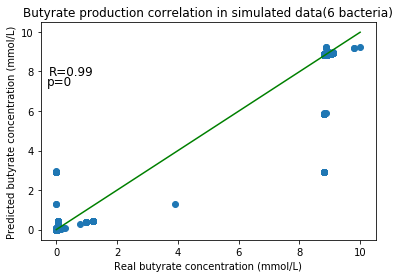

In [26]:
plt.title ('Butyrate production correlation in simulated data(6 bacteria)')  
plt.scatter (x6, y6)  
plt.plot (np.unique(x6), np.poly1d(np.polyfit(x6,y6, 1))(np.unique(x6)), color = 'green')  
plt.xlabel ('Real butyrate concentration (mmol/L)')  
plt.ylabel ('Predicted butyrate concentration (mmol/L)') 
plt.annotate("R=0.99",xy=(2, 9), xycoords='data',
            xytext=(0.5, 8),size=12, va="center", ha="center")
plt.annotate("p=0",xy=(2, 9), xycoords='data',
            xytext=(0.1,7.5),size=12, va="center", ha="center")
plt.savefig("Correlation6bact_S.png", dpi=300,bbox_inches='tight')

# 7 bacteria

In [19]:
tr7=pd.read_table(folder + "simulaciones/res_simulations/train_data_simulated/train_7bactS")


In [20]:
X7 = tr7.iloc [:, 1:218].values
y7 = tr7.iloc[:, 0].values


In [21]:
neigh = KNeighborsRegressor(n_neighbors=3)
neigh.fit(X7, y7)
dump(neigh, 'knn_7bact.joblib') 

['knn_7bact.joblib']

In [22]:
from sklearn.model_selection import LeaveOneOut
loo = LeaveOneOut()
loo.get_n_splits(X7)

43950

In [23]:
for i, (train_index, test_index) in enumerate(loo.split(X7)):
    X7_train, X7_test = X7[train_index], X7[test_index]
 #   print(neigh.predict(X_test))
    print("real value " +str(y7[i])+"\tpredict: "+ str(neigh.predict(X7_test)))

real value 0.0	predict: [2.91525057e-05]
real value 9.0123884789619	predict: [3.0041878]
real value 9.03386967259825	predict: [3.0113482]
real value 9.0123884789619	predict: [6.00828814]
real value 9.0123884789619	predict: [5.94032017]
real value 9.0123884789619	predict: [8.94442051]
real value 9.0123884789619	predict: [8.94442051]
real value 9.0123884789619	predict: [8.94442051]
real value 9.0123884789619	predict: [8.94442051]
real value 9.0123884789619	predict: [8.94442051]
real value 9.0123884789619	predict: [8.94442051]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.12450895628943	predict: [9.12450896]
real value 9.0123884789619	p

real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.12450895628943	predict: [9.12450896]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.012388

real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.12450895628943	predict: [9.12450896]
real value 9.12450895628943	predict: [9.12450896]
real value 9.12450895628943	predict: [9.12450896]
real value 9.12450895628943	predict: [9.12450896]
real value 9.12450895628943	predict: [9.12450896]
real value 9.12450895628943	predict: [9.12450896]
real value 9.12450895628943	predict: [9.12450896]
real value 9.12450895628943	predict: [9.12450896]
real value 9.12450895628943	predict: [9.12450896]
real value 9.12450895628943	predict: [9.12450896]
real value

real value 9.12450895628943	predict: [9.12450896]
real value 9.12450895628943	predict: [9.12450896]
real value 9.12450895628943	predict: [9.12450896]
real value 9.12450895628943	predict: [9.12450896]
real value 9.12450895628943	predict: [9.12450896]
real value 9.12450895628943	predict: [9.12450896]
real value 9.12450895628943	predict: [9.12450896]
real value 9.12450895628943	predict: [9.12450896]
real value 9.12450895628943	predict: [9.12450896]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 

real value 9.12450895628943	predict: [9.12450896]
real value 9.12450895628943	predict: [9.12450896]
real value 9.12450895628943	predict: [9.12450896]
real value 9.12450895628943	predict: [9.12450896]
real value 9.12450895628943	predict: [9.12450896]
real value 9.12450895628943	predict: [9.12450896]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0

real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.12450895628943	predict: [9.12450896]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.12450895628943	predict: [9.12450896]
real value 9.12450895628943	predict: [9.12450896]
real value 9.12450895628943	predict: [9.12450896]
real value 9.12450895628943	predict: [9.12508529]
real value 9.12450895628943	predict: [9.12450896]
real value 9.1

real value 9.12450895628943	predict: [9.12450896]
real value 9.12450895628943	predict: [9.12450896]
real value 9.12450895628943	predict: [9.12450896]
real value 9.12450895628943	predict: [9.12450896]
real value 9.12450895628943	predict: [9.12450896]
real value 9.12450895628943	predict: [9.12450896]
real value 9.12450895628943	predict: [9.12450896]
real value 9.12450895628943	predict: [9.12450896]
real value 9.12450895628943	predict: [9.12450896]
real value 9.12450895628943	predict: [9.04243572]
real value 9.12450895628943	predict: [9.12450896]
real value 9.12450895628943	predict: [9.12450896]
real value 9.12450895628943	predict: [9.12450896]
real value 9.12450895628943	predict: [9.12450896]
real value 9.12450895628943	predict: [9.12450896]
real value 9.12450895628943	predict: [9.12450896]
real value 9.12450895628943	predict: [9.12450896]
real value 9.12450895628943	predict: [9.04243572]
real value 9.12450895628943	predict: [9.04243572]
real value 9.12450895628943	predict: [9.04243572]


real value 9.12450895628943	predict: [9.12450896]
real value 9.12450895628943	predict: [9.12450896]
real value 9.12450895628943	predict: [9.12450896]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123

real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884789619	predict: [9.01238848]
real value 9.0123884

real value 9.12450895628943	predict: [9.04243572]
real value 8.87828924230196	predict: [8.96036248]
real value 8.87828924230196	predict: [8.96036248]
real value 8.87828924230196	predict: [8.96036248]
real value 8.87828924230196	predict: [8.96036248]
real value 8.87828924230196	predict: [9.04243572]
real value 8.87828924230196	predict: [8.96036248]
real value 8.87828924230196	predict: [9.04243572]
real value 8.87828924230196	predict: [8.96036248]
real value 8.87828924230196	predict: [8.96036248]
real value 8.87828924230196	predict: [8.96036248]
real value 8.87828924230196	predict: [8.96036248]
real value 8.87828924230196	predict: [8.96036248]
real value 8.87828924230196	predict: [9.04243572]
real value 8.87828924230196	predict: [9.04243572]
real value 8.87828924230196	predict: [9.04243572]
real value 8.87828924230196	predict: [9.04243572]
real value 8.87828924230196	predict: [9.04243572]
real value 8.808484562663761	predict: [8.94442051]
real value 8.808484562663761	predict: [8.94442051

real value 8.87828924230196	predict: [8.87828924]
real value 8.87828924230196	predict: [8.87828924]
real value 8.87828924230196	predict: [8.87828924]
real value 8.87828924230196	predict: [8.87828924]
real value 8.87828924230196	predict: [8.87828924]
real value 8.87828924230196	predict: [8.87828924]
real value 8.87828924230196	predict: [8.85502102]
real value 8.87828924230196	predict: [8.87828924]
real value 8.87828924230196	predict: [8.87828924]
real value 8.87828924230196	predict: [8.87828924]
real value 8.87828924230196	predict: [8.87828924]
real value 8.87828924230196	predict: [8.87828924]
real value 8.87828924230196	predict: [8.87828924]
real value 8.87828924230196	predict: [8.85502102]
real value 8.87828924230196	predict: [8.87828924]
real value 8.87828924230196	predict: [8.87828924]
real value 8.808484562663761	predict: [5.94032017]
real value 8.808484562663761	predict: [8.87645253]
real value 8.808484562663761	predict: [8.80848456]
real value 8.808484562663761	predict: [8.876452

real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 0.069808396902123	predict: [0.0698084]
real value 0.069808396902123	predict: [0.0698084]
real value 0.069808396902123	predict: [0.0698084]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value

real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predic

real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predic

real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predic

real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predic

real value 0.069808396902123	predict: [0.0698084]
real value 0.069808396902123	predict: [0.0698084]
real value 0.069808396902123	predict: [0.0698084]
real value 0.069808396902123	predict: [0.0698084]
real value 0.069808396902123	predict: [0.0698084]
real value 0.069808396902123	predict: [0.06983855]
real value 0.069808396902123	predict: [0.06983855]
real value 0.069808396902123	predict: [0.0698084]
real value 3.7172639388810204e-06	predict: [3.16306817e-05]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06

real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predic

real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [1.23909046]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 0.069808396902123	predict: [0.0698084]
real value 0.069808396902123	predict: [0.0698084]
real value 0.069808396902123	predict: [0.0698084]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7

real value 0.069808396902123	predict: [0.0698084]
real value 0.069808396902123	predict: [0.0698084]
real value 0.069808396902123	predict: [0.0698084]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value

real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predic

real value 3.71726393888102	predict: [1.23909046]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.7172

real value 3.7172639388810204e-06	predict: [3.10101215e-05]
real value 3.7172639388810204e-06	predict: [3.03915937e-05]
real value 3.7172639388810204e-06	predict: [3.09670374e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [2.47817596e-06]
real value 3.7172639388810204e-06	predict: [2.47817596e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predic

real value 3.7172639388810204e-06	predict: [2.47817596e-06]
real value 3.7172639388810204e-06	predict: [3.09670374e-06]
real value 3.7172639388810204e-06	predict: [3.71726394e-06]
real value 3.7172639388810204e-06	predict: [3.09670374e-06]
real value 3.7172639388810204e-06	predict: [2.47817596e-06]
real value 3.7172639388810204e-06	predict: [2.47817596e-06]
real value 3.7172639388810204e-06	predict: [2.47817596e-06]
real value 3.7172639388810204e-06	predict: [3.09670374e-06]
real value 3.7172639388810204e-06	predict: [3.09670374e-06]
real value 3.7172639388810204e-06	predict: [3.09670374e-06]
real value 3.7172639388810204e-06	predict: [2.47817596e-06]
real value 3.7172639388810204e-06	predict: [2.47817596e-06]
real value 3.7172639388810204e-06	predict: [2.47817596e-06]
real value 3.7172639388810204e-06	predict: [3.09670374e-06]
real value 3.7172639388810204e-06	predict: [2.47817596e-06]
real value 3.7172639388810204e-06	predict: [3.10101215e-05]
real value 3.7172639388810204e-06	predic

real value 0.069808396902123	predict: [0.06983855]
real value 0.069808396902123	predict: [0.06983855]
real value 0.069808396902123	predict: [0.06983855]
real value 0.069808396902123	predict: [0.06983855]
real value 0.069808396902123	predict: [0.06983855]
real value 0.069808396902123	predict: [0.06983855]
real value 0.069808396902123	predict: [0.06983855]
real value 0.069808396902123	predict: [0.06983855]
real value 0.069808396902123	predict: [0.06983855]
real value 0.069808396902123	predict: [0.06983855]
real value 0.069808396902123	predict: [0.06983855]
real value 0.069808396902123	predict: [0.06983855]
real value 0.069808396902123	predict: [0.06983855]
real value 0.069808396902123	predict: [0.0698687]
real value 0.069808396902123	predict: [0.0698687]
real value 0.069808396902123	predict: [0.0698687]
real value 0.069808396902123	predict: [0.0698687]
real value 0.069808396902123	predict: [0.0698687]
real value 0.069808396902123	predict: [0.0698687]
real value 0.069808396902123	predict:

real value 0.0	predict: [1.85761576e-06]
real value 1.85558333605687e-06	predict: [1.85761576e-06]
real value 0.0	predict: [1.23908798e-06]
real value 0.06968551041690599	predict: [0.06972647]
real value 0.06968365483357002	predict: [0.06968427]
real value 0.06968365483357002	predict: [0.06968427]
real value 0.06968365483357002	predict: [0.06968427]
real value 0.06968551041690599	predict: [0.06968489]
real value 0.06968551041690599	predict: [0.06968489]
real value 0.06968551041690599	predict: [0.06968489]
real value 0.06968365483357002	predict: [0.06972524]
real value 0.06968365483357002	predict: [0.06972524]
real value 0.06968365483357002	predict: [0.06968427]
real value 0.06968551041690599	predict: [0.06968489]
real value 0.06968365483357002	predict: [0.06972524]
real value 0.06968365483357002	predict: [0.06968365]
real value 0.06968551041690599	predict: [0.06968551]
real value 0.06968365483357002	predict: [0.06968365]
real value 0.06968365483357002	predict: [0.06968365]
real value 0

real value 0.06968365483357002	predict: [0.06972585]
real value 0.06968551041690599	predict: [0.06972585]
real value 0.06968551041690599	predict: [0.06972585]
real value 0.06968551041690599	predict: [0.06972585]
real value 0.06968365483357002	predict: [0.06979697]
real value 0.06968365483357002	predict: [0.06979697]
real value 0.06968365483357002	predict: [0.06968427]
real value 0.06968551041690599	predict: [0.06968489]
real value 0.06968365483357002	predict: [0.06972524]
real value 0.06968365483357002	predict: [0.06968427]
real value 0.06968551041690599	predict: [0.06968489]
real value 0.06968365483357002	predict: [0.06972524]
real value 0.06968365483357002	predict: [0.06972585]
real value 0.06968551041690599	predict: [0.06972625]
real value 0.06968365483357002	predict: [0.06979697]
real value 0.06968551041690599	predict: [0.06972647]
real value 0.06968365483357002	predict: [0.06968427]
real value 0.06968365483357002	predict: [0.06968427]
real value 0.06968365483357002	predict: [0.069

real value 0.0	predict: [2.47817596e-06]
real value 0.06968551041690599	predict: [0.06976743]
real value 0.06968365483357002	predict: [0.06976682]
real value 0.06968365483357002	predict: [0.06976682]
real value 0.06968365483357002	predict: [0.06976682]
real value 0.06968551041690599	predict: [0.06976743]
real value 0.06968551041690599	predict: [0.06976743]
real value 0.06968551041690599	predict: [0.06976743]
real value 0.06968365483357002	predict: [0.06976682]
real value 0.06968365483357002	predict: [0.06976682]
real value 0.06968365483357002	predict: [0.06976682]
real value 0.06968551041690599	predict: [0.06976743]
real value 0.06968365483357002	predict: [0.06976682]
real value 0.06968365483357002	predict: [0.06972524]
real value 0.06968551041690599	predict: [0.06972647]
real value 0.06968365483357002	predict: [0.06972524]
real value 0.06968365483357002	predict: [0.06972524]
real value 0.06968551041690599	predict: [0.06972647]
real value 0.06968365483357002	predict: [0.06972524]
real 

real value 8.74575171633327e-05	predict: [5.95440994e-05]
real value 8.74575171633327e-05	predict: [5.95440994e-05]
real value 8.74575171633327e-05	predict: [5.95440994e-05]
real value 8.74575171633327e-05	predict: [5.95440994e-05]
real value 8.74575171633327e-05	predict: [5.95440994e-05]
real value 8.74575171633327e-05	predict: [5.95440994e-05]
real value 8.74575171633327e-05	predict: [5.95440994e-05]
real value 8.74575171633327e-05	predict: [5.95440994e-05]
real value 8.74575171633327e-05	predict: [5.95440994e-05]
real value 8.74575171633327e-05	predict: [5.95440994e-05]
real value 8.74575171633327e-05	predict: [5.95440994e-05]
real value 8.74575171633327e-05	predict: [5.95440994e-05]
real value 8.74575171633327e-05	predict: [5.95440994e-05]
real value 8.74575171633327e-05	predict: [5.95440994e-05]
real value 8.74575171633327e-05	predict: [5.95440994e-05]
real value 8.74575171633327e-05	predict: [5.95440994e-05]
real value 8.74575171633327e-05	predict: [5.95440994e-05]
real value 8.7

real value 0.069898856509946	predict: [0.0698687]
real value 0.069898856509946	predict: [0.0698687]
real value 0.069898856509946	predict: [0.0698687]
real value 0.069898856509946	predict: [0.0698687]
real value 8.74575171633327e-05	predict: [5.95440994e-05]
real value 8.74575171633327e-05	predict: [5.95440994e-05]
real value 8.74575171633327e-05	predict: [5.95440994e-05]
real value 8.74575171633327e-05	predict: [5.95440994e-05]
real value 8.74575171633327e-05	predict: [5.95440994e-05]
real value 8.74575171633327e-05	predict: [5.95440994e-05]
real value 8.74575171633327e-05	predict: [5.95440994e-05]
real value 8.74575171633327e-05	predict: [5.95440994e-05]
real value 8.74575171633327e-05	predict: [5.95440994e-05]
real value 8.74575171633327e-05	predict: [5.95440994e-05]
real value 8.74575171633327e-05	predict: [5.95440994e-05]
real value 8.74575171633327e-05	predict: [5.95440994e-05]
real value 8.74575171633327e-05	predict: [5.95440994e-05]
real value 8.74575171633327e-05	predict: [5.95

real value 0.069898856509946	predict: [0.06989886]
real value 0.069898856509946	predict: [0.06989886]
real value 0.069898856509946	predict: [0.06984668]
real value 0.069898856509946	predict: [0.06984668]
real value 0.069898856509946	predict: [0.06984668]
real value 0.069898856509946	predict: [0.06984668]
real value 0.069898856509946	predict: [0.06984668]
real value 0.069898856509946	predict: [0.06984668]
real value 0.069898856509946	predict: [0.06984668]
real value 0.069898856509946	predict: [0.06984668]
real value 0.069898856509946	predict: [0.06984668]
real value 0.069898856509946	predict: [0.06984668]
real value 0.069898856509946	predict: [0.06984668]
real value 0.069898856509946	predict: [0.06984668]
real value 0.069898856509946	predict: [0.06984668]
real value 0.069898856509946	predict: [0.06989886]
real value 0.069898856509946	predict: [0.06989886]
real value 0.069898856509946	predict: [0.06989886]
real value 0.069898856509946	predict: [0.06989886]
real value 0.069898856509946	pr

real value 8.74575171633327e-05	predict: [5.83050114e-05]
real value 8.74575171633327e-05	predict: [5.83050114e-05]
real value 8.74575171633327e-05	predict: [5.89235392e-05]
real value 8.74575171633327e-05	predict: [5.89235392e-05]
real value 8.74575171633327e-05	predict: [5.89235392e-05]
real value 8.74575171633327e-05	predict: [5.83050114e-05]
real value 8.74575171633327e-05	predict: [5.83050114e-05]
real value 8.74575171633327e-05	predict: [5.89235392e-05]
real value 8.74575171633327e-05	predict: [5.89235392e-05]
real value 8.74575171633327e-05	predict: [5.89235392e-05]
real value 8.74575171633327e-05	predict: [5.83050114e-05]
real value 8.74575171633327e-05	predict: [5.83050114e-05]
real value 8.74575171633327e-05	predict: [5.83050114e-05]
real value 8.74575171633327e-05	predict: [5.89235392e-05]
real value 8.74575171633327e-05	predict: [5.89235392e-05]
real value 8.74575171633327e-05	predict: [5.89235392e-05]
real value 8.74575171633327e-05	predict: [5.83050114e-05]
real value 8.7

real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	pred

real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: 

real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8

real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	pr

real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]


real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]


real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	pr

real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	pr

real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.87829224432447	predict: [8.87829224]
real value 8.808480845331651	pre

real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	pr

real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]


real value 8.808480845331651	predict: [8.80848085]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]

real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	pr

real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	pr

real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict:

real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predic

real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8

real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]


real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict:

real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: 

real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]


real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict:

real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]


real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.

real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	pr

real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.85502178]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.87829224]
real value 8.87829224432447	predict: [8.85502178]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: [8.80848085]
real value 8.808480845331651	predict: 

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.069811398992783	predict: [0.0698114]
real value 0.069811398992783	predict: [0.0698114]
real value 0.069811398992783	predict: [0.0698114]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real valu

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.069811398992783	predict: [0.0698114]
real value 0.069811398992783	predict: [0.0698114]
real value 0.069811398992783	predict: [0.0698114]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real valu

real value 0.069811398992783	predict: [0.0698114]
real value 0.069811398992783	predict: [0.0698114]
real value 0.069811398992783	predict: [0.06978838]
real value 0.069811398992783	predict: [0.06978838]
real value 0.069811398992783	predict: [0.06978838]
real value 0.069811398992783	predict: [0.06978838]
real value 0.069811398992783	predict: [0.0698114]
real value 0.069811398992783	predict: [0.0698114]
real value 0.069811398992783	predict: [0.06978838]
real value 0.069811398992783	predict: [0.0698114]
real value 0.069811398992783	predict: [0.0698114]
real value 0.069811398992783	predict: [0.0698114]
real value 0.069811398992783	predict: [0.0698114]
real value 0.069811398992783	predict: [0.0698114]
real value 0.069811398992783	predict: [0.0698114]
real value 0.069811398992783	predict: [0.0698114]
real value 0.069811398992783	predict: [0.0698114]
real value 0.069811398992783	predict: [0.06978838]
real value 0.069811398992783	predict: [0.0698114]
real value 0.069811398992783	predict: [0.069

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0

real value 0.06974232790328999	predict: [0.06974233]
real value 0.06974232790328999	predict: [0.06974233]
real value 0.06974232790328999	predict: [0.06974233]
real value 0.06974232790328999	predict: [0.06974233]
real value 0.06974232790328999	predict: [0.06974233]
real value 0.06974232790328999	predict: [0.06974233]
real value 0.06974232790328999	predict: [0.06974233]
real value 0.06974232790328999	predict: [0.06974233]
real value 0.06974232790328999	predict: [0.06974233]
real value 0.06974232790328999	predict: [0.06974233]
real value 0.06974232790328999	predict: [0.06974233]
real value 0.06974232790328999	predict: [0.06974233]
real value 0.06974232790328999	predict: [0.06974233]
real value 0.06974232790328999	predict: [0.06974233]
real value 0.06974232790328999	predict: [0.06974233]
real value 0.06974232790328999	predict: [0.06974233]
real value 0.06974232790328999	predict: [0.06974233]
real value 0.06974232790328999	predict: [0.06974233]
real value 0.06974232790328999	predict: [0.069

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0

real value 0.06974232790328999	predict: [0.06974233]
real value 0.06974232790328999	predict: [0.06974233]
real value 0.06974232790328999	predict: [0.06974233]
real value 0.06974232790328999	predict: [0.06974233]
real value 0.06974232790328999	predict: [0.06974233]
real value 0.06974232790328999	predict: [0.06974233]
real value 0.06974232790328999	predict: [0.06974233]
real value 0.06974232790328999	predict: [0.06974233]
real value 0.06974232790328999	predict: [0.06974233]
real value 0.06974232790328999	predict: [0.06974233]
real value 0.06974232790328999	predict: [0.06974233]
real value 0.06974232790328999	predict: [0.06974233]
real value 0.06974232790328999	predict: [0.06974233]
real value 0.06974232790328999	predict: [0.06974233]
real value 0.06974232790328999	predict: [0.06974233]
real value 0.06974232790328999	predict: [0.06974233]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real va

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.06974232790328999	predict: [0.06974233]
real value 0.06974232790328999	predict: [0.06974233]
real value 0.06974232790328999	predict: [0.06974233]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.06974232790328999	predict: [0.06974233]
real value 0.06974232790328999	predict: [0.06974233]
real value 0.06974232790328999	predict: [0.06974233]
real value 0.06974232790328999	predict: [0.0

real value 0.06974232790328999	predict: [0.06974233]
real value 0.06974232790328999	predict: [0.06974233]
real value 0.06974232790328999	predict: [0.06974233]
real value 0.06974232790328999	predict: [0.06974233]
real value 0.06974232790328999	predict: [0.06974233]
real value 0.06974232790328999	predict: [0.06974233]
real value 0.06974232790328999	predict: [0.06974233]
real value 0.06974232790328999	predict: [0.06974233]
real value 0.06974232790328999	predict: [0.06974233]
real value 0.06974232790328999	predict: [0.06974233]
real value 0.06974232790328999	predict: [0.06974233]
real value 0.06974232790328999	predict: [0.06974233]
real value 0.06974232790328999	predict: [0.06974233]
real value 0.06974232790328999	predict: [0.06974233]
real value 0.06974232790328999	predict: [0.06974233]
real value 0.06974232790328999	predict: [0.06974233]
real value 0.06974232790328999	predict: [0.06974233]
real value 0.06974232790328999	predict: [0.06974233]
real value 0.06974232790328999	predict: [0.069

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.06974232790328999	predict: [0.06974233]
real value 0.06974232790328999	predict: [0.06974233]
real value 0.06974232790328999	predict: [0.06974233]
real value 0.06974232790328999	predict: [0.06974233]
real value 0.06974232790328999	predict: [0.06974233]
real value 0.06974232790328999	predict: [0.06974233]
real value 0.06974232790328999	predict: [0.06974233]
real value 0.0697423

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 1.23093878984433e-05	predict: [4.1031293e-06]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [2.91525057e-05]
real value 0.0	predict: [2.91525057e-05]
real value 0.0	predict: [2.91525057e-05]
real value 0.0	predict: [2.91525057e-05]
real value 0.0	predict: [2.91525057e-05]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [2.91525057e-05]
real value 0.0	predict: [2.91525057e-05]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [2.91525057e-05]
real value 0.0	predict: [2.91525057e-05]
real value 0.0	predict: [2.91525057e-05]
real value 0.0	predict: [2.91525057e-05]
real value 0.0	predict: [2.91525057e-05]
real value 0.0	predict: [2.91525057e-05]
real value 0.0	predict: [2.91525

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0

real value 0.06974232790328999	predict: [0.04649404]
real value 0.06974232790328999	predict: [0.06974233]
real value 0.06974232790328999	predict: [0.06974233]
real value 0.06974232790328999	predict: [0.06974233]
real value 0.06974232790328999	predict: [0.06974233]
real value 0.06974232790328999	predict: [0.06974233]
real value 0.06974232790328999	predict: [0.06974233]
real value 0.06974232790328999	predict: [0.06974148]
real value 0.06974232790328999	predict: [0.06974148]
real value 0.06974232790328999	predict: [0.06974233]
real value 0.06974232790328999	predict: [0.06974233]
real value 0.06974232790328999	predict: [0.06974148]
real value 0.06974232790328999	predict: [0.06974233]
real value 0.06974232790328999	predict: [0.06974233]
real value 0.06974232790328999	predict: [0.06974233]
real value 0.06974232790328999	predict: [0.06974233]
real value 0.06974232790328999	predict: [0.06974233]
real value 0.06974232790328999	predict: [0.06974233]
real value 0.06974232790328999	predict: [0.069

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0

real value 0.06974232790328999	predict: [0.06974148]
real value 0.06974232790328999	predict: [0.06974148]
real value 0.06974232790328999	predict: [0.06974148]
real value 0.06974232790328999	predict: [0.06974148]
real value 0.06974232790328999	predict: [0.06974148]
real value 0.06974232790328999	predict: [0.06974148]
real value 0.06974232790328999	predict: [0.06974148]
real value 0.06974232790328999	predict: [0.06974148]
real value 0.06974232790328999	predict: [0.06974148]
real value 0.06974232790328999	predict: [0.06974148]
real value 0.06974232790328999	predict: [0.06974148]
real value 0.06974232790328999	predict: [0.06974148]
real value 0.06974232790328999	predict: [0.06974148]
real value 0.06974232790328999	predict: [0.06974148]
real value 0.06974232790328999	predict: [0.06974148]
real value 0.06974232790328999	predict: [0.06975446]
real value 0.06974232790328999	predict: [0.06974148]
real value 0.06974232790328999	predict: [0.06974148]
real value 0.06974232790328999	predict: [0.069

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.04649404]
real value 0.06974232790328999	predict: [0.06974148]
real value 0.06974232790328999	predict: [0.06974148]
real value 0.06974232790328999	predict: [0.06974148]
real value 0.06974232790328999	predict: [0.06974148]
real value 0.06974232790328999	predict: [0.06974148]
real value 0.06974232790328999	predict: [0.06974148]
real value 0.06974232790328999	predi

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0

real value 0.0	predict: [0.]
real value 0.06974232790328999	predict: [0.06974148]
real value 0.06974232790328999	predict: [0.06974148]
real value 0.06974232790328999	predict: [0.06974148]
real value 0.06974232790328999	predict: [0.06974148]
real value 0.06974232790328999	predict: [0.06974148]
real value 0.06974232790328999	predict: [0.06974148]
real value 0.06974232790328999	predict: [0.06974148]
real value 0.06974232790328999	predict: [0.06974148]
real value 0.06974232790328999	predict: [0.06974148]
real value 0.06974232790328999	predict: [0.06974148]
real value 0.06974232790328999	predict: [0.06974148]
real value 0.06974232790328999	predict: [0.06974148]
real value 0.06974232790328999	predict: [0.06974148]
real value 0.06974232790328999	predict: [0.06974148]
real value 0.06974232790328999	predict: [0.06974148]
real value 0.06974232790328999	predict: [0.06974148]
real value 0.06974232790328999	predict: [0.06974148]
real value 0.06974232790328999	predict: [0.06974148]
real value 0.0697

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0

real value 0.06974232790328999	predict: [0.06974148]
real value 0.06974232790328999	predict: [0.06974148]
real value 0.06974232790328999	predict: [0.06974148]
real value 0.06974232790328999	predict: [0.06974148]
real value 0.06974232790328999	predict: [0.06974148]
real value 0.06974232790328999	predict: [0.06974148]
real value 0.06974232790328999	predict: [0.06974148]
real value 0.06974232790328999	predict: [0.06974148]
real value 0.06974232790328999	predict: [0.06974148]
real value 0.06974232790328999	predict: [0.06974148]
real value 0.06974232790328999	predict: [0.06974148]
real value 0.06974232790328999	predict: [0.06974148]
real value 0.06974232790328999	predict: [0.06974148]
real value 0.06974232790328999	predict: [0.06974148]
real value 0.06974232790328999	predict: [0.06974148]
real value 0.06974232790328999	predict: [0.06974148]
real value 0.06974232790328999	predict: [0.06974148]
real value 0.06974232790328999	predict: [0.06974148]
real value 0.06974232790328999	predict: [0.069

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.06974232790328999	predict: [0.06974063]
real value 0.06974232790328999	predict: [0.06974063]
real value 0.06974232790328999	predict: [0.06974063]
real value 0.06974232790328999	predict: [0.06974063]
real value 0.06974232790328999	predict: [0.06974063]
real value 0.06974232790328999	predict: [0.06974063]
real value 0.06974232790328999	predict: [0.06974063]
real value 0.06974232790328999	predict: [0.06974063]
real value 0.06974232790328999	predict: [0.06974063]
real value 0.06974232790328999

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0

real value 8.808480845363448	predict: [8.80848085]
real value 8.808480845363448	predict: [8.80848085]
real value 8.808480845363448	predict: [8.80848085]
real value 8.808480845363448	predict: [8.80848085]
real value 8.808480845363448	predict: [8.80848085]
real value 8.808480845363448	predict: [8.80848085]
real value 8.808480845363448	predict: [8.80848085]
real value 8.808480845363448	predict: [8.80848085]
real value 8.808480845363448	predict: [8.80848085]
real value 8.808480845363448	predict: [8.80848085]
real value 8.808480845363448	predict: [8.80848085]
real value 8.808480845363448	predict: [8.80848085]
real value 8.808480845363448	predict: [8.80848085]
real value 8.808480845363448	predict: [8.80848085]
real value 8.808480845363448	predict: [8.80848085]
real value 8.808480845363448	predict: [8.80848085]
real value 8.808480845363448	predict: [8.80848085]
real value 8.808480845363448	predict: [8.80848085]
real value 8.808480845363448	predict: [8.80848085]
real value 8.808480845363448	pr

real value 8.87822317326676	predict: [8.87822317]
real value 8.87822317326676	predict: [8.87822317]
real value 8.87822317326676	predict: [8.87822317]
real value 8.87822317326676	predict: [8.87822317]
real value 8.87822317326676	predict: [8.87822317]
real value 8.808480845363448	predict: [8.80848085]
real value 8.808480845363448	predict: [8.80848085]
real value 8.808480845363448	predict: [8.80848085]
real value 8.808480845363448	predict: [8.80848085]
real value 8.808480845363448	predict: [8.80848085]
real value 8.808480845363448	predict: [8.80848085]
real value 8.808480845363448	predict: [8.80848085]
real value 8.808480845363448	predict: [8.80848085]
real value 8.808480845363448	predict: [8.80848085]
real value 8.808480845363448	predict: [8.80848085]
real value 8.808480845363448	predict: [8.80848085]
real value 8.808480845363448	predict: [8.80848085]
real value 8.808480845363448	predict: [8.80848085]
real value 8.808480845363448	predict: [8.80848085]
real value 8.808480845363448	predict

real value 8.808480845363448	predict: [8.80848085]
real value 8.808480845363448	predict: [8.80848085]
real value 8.808480845363448	predict: [8.80848085]
real value 8.808480845363448	predict: [8.80848085]
real value 8.808480845363448	predict: [8.80848085]
real value 8.808480845363448	predict: [8.80848085]
real value 8.87822317326676	predict: [8.87822317]
real value 8.87822317326676	predict: [8.87822317]
real value 8.87822317326676	predict: [8.87822317]
real value 8.87822317326676	predict: [8.87822317]
real value 8.87822317326676	predict: [8.87822317]
real value 8.87822317326676	predict: [8.87822317]
real value 8.87822317326676	predict: [8.87822317]
real value 8.87822317326676	predict: [8.87822317]
real value 8.87822317326676	predict: [8.87822317]
real value 8.808480845363448	predict: [8.80848085]
real value 8.808480845363448	predict: [8.80848085]
real value 8.808480845363448	predict: [8.80848085]
real value 8.808480845363448	predict: [8.80848085]
real value 8.808480845363448	predict: [8

real value 8.808480845363448	predict: [8.80848085]
real value 8.808480845363448	predict: [8.80848085]
real value 8.808480845363448	predict: [8.80848085]
real value 8.808480845363448	predict: [8.80848085]
real value 8.808480845363448	predict: [8.80848085]
real value 8.808480845363448	predict: [8.80848085]
real value 8.808480845363448	predict: [8.80848085]
real value 8.808480845363448	predict: [8.80848085]
real value 8.808480845363448	predict: [8.80848085]
real value 8.808480845363448	predict: [8.80848085]
real value 8.808480845363448	predict: [8.80848085]
real value 8.808480845363448	predict: [8.80848085]
real value 8.808480845363448	predict: [8.80848085]
real value 8.808480845363448	predict: [8.80848085]
real value 8.808480845363448	predict: [8.80848085]
real value 8.808480845363448	predict: [8.80848085]
real value 8.808480845363448	predict: [8.80848085]
real value 8.808480845363448	predict: [8.80848085]
real value 8.808480845363448	predict: [8.80848085]
real value 8.808480845363448	pr

real value 8.87822317326676	predict: [8.87822317]
real value 8.87822317326676	predict: [8.87822317]
real value 8.87822317326676	predict: [8.87822317]
real value 8.87822317326676	predict: [8.87822317]
real value 8.87822317326676	predict: [8.87822317]
real value 8.87822317326676	predict: [8.87822317]
real value 8.87822317326676	predict: [8.87822317]
real value 8.87822317326676	predict: [8.87822317]
real value 8.87822317326676	predict: [8.87822317]
real value 8.87822317326676	predict: [8.87822317]
real value 8.87822317326676	predict: [8.87822317]
real value 8.87822317326676	predict: [8.87822317]
real value 8.87822317326676	predict: [8.87822317]
real value 8.87822317326676	predict: [8.87822317]
real value 8.87822317326676	predict: [8.878212]
real value 8.87822317326676	predict: [8.87822317]
real value 8.808480845363448	predict: [8.80848085]
real value 8.808480845363448	predict: [8.80848085]
real value 8.808480845363448	predict: [8.80849548]
real value 8.808480845363448	predict: [8.80848085

real value 8.87822317326676	predict: [8.87822317]
real value 8.87822317326676	predict: [8.87822317]
real value 8.87822317326676	predict: [8.87822317]
real value 8.87822317326676	predict: [8.878212]
real value 8.87822317326676	predict: [8.87822317]
real value 8.87822317326676	predict: [8.87822317]
real value 8.87822317326676	predict: [8.87822317]
real value 8.87822317326676	predict: [8.87822317]
real value 8.87822317326676	predict: [8.87822317]
real value 8.87822317326676	predict: [8.87822317]
real value 8.87822317326676	predict: [8.87822317]
real value 8.87822317326676	predict: [8.878212]
real value 8.87822317326676	predict: [8.878212]
real value 8.87822317326676	predict: [8.878212]
real value 8.87822317326676	predict: [8.878212]
real value 8.87822317326676	predict: [8.878212]
real value 8.808480845363448	predict: [8.80848085]
real value 8.808480845363448	predict: [8.80848085]
real value 8.808480845363448	predict: [8.80848085]
real value 8.808480845363448	predict: [8.80848085]
real val

real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	pr

real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.9074279025662	predict: [8.8414632]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predi

real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.878189659532868	predict: [8.87818966]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.878189659532868	predict: [8.87818966]
real value 8.878189659532868	predict: [8.87818966]
real value 8.878189659532868	predict: [8.87818966]
real value 8.878189659532868	pr

real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.9074279025662	predict: [8.8414632]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predi

real value 8.878189659532868	predict: [8.87818966]
real value 8.878189659532868	predict: [8.87818966]
real value 8.878189659532868	predict: [8.87818966]
real value 8.878189659532868	predict: [8.87818966]
real value 8.97713671675276	predict: [8.91117201]
real value 8.878189659532868	predict: [8.87818966]
real value 8.878189659532868	predict: [8.87818966]
real value 9.11056087207249	predict: [8.95564673]
real value 8.878189659532868	predict: [8.95564673]
real value 8.878189659532868	predict: [8.87818966]
real value 8.878189659532868	predict: [8.87818966]
real value 8.878189659532868	predict: [8.87818966]
real value 8.878189659532868	predict: [8.87818966]
real value 8.878189659532868	predict: [8.87818966]
real value 8.878189659532868	predict: [8.87818966]
real value 8.878189659532868	predict: [8.87818966]
real value 8.878189659532868	predict: [8.87818966]
real value 8.878189659532868	predict: [8.87818966]
real value 8.878189659532868	predict: [8.87818966]
real value 8.878189659532868	pred

real value 8.808480845346269	predict: [8.80848085]
real value 8.878189659532868	predict: [8.87818966]
real value 8.878189659532868	predict: [8.87818966]
real value 8.878189659532868	predict: [8.87818966]
real value 8.878189659532868	predict: [8.87818966]
real value 8.878189659532868	predict: [8.87818966]
real value 8.878189659532868	predict: [8.87818966]
real value 8.878189659532868	predict: [8.87818966]
real value 8.878189659532868	predict: [8.87818966]
real value 8.878189659532868	predict: [8.87818966]
real value 8.878189659532868	predict: [8.87818966]
real value 8.878189659532868	predict: [8.87818966]
real value 8.878189659532868	predict: [8.87818966]
real value 8.878189659532868	predict: [8.87818966]
real value 8.878189659532868	predict: [8.87818966]
real value 8.878189659532868	predict: [8.87818966]
real value 8.878189659532868	predict: [8.87818966]
real value 8.878189659532868	predict: [8.87818966]
real value 8.878189659532868	predict: [8.87818966]
real value 8.878189659532868	pr

real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	pr

real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	pr

real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	pr

real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	pr

real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	pr

real value 8.878189659532868	predict: [8.87818966]
real value 8.878189659532868	predict: [8.87818966]
real value 8.878189659532868	predict: [8.87818966]
real value 8.878189659532868	predict: [8.87818966]
real value 8.878189659532868	predict: [8.87818966]
real value 8.878189659532868	predict: [8.87818966]
real value 8.878189659532868	predict: [8.87818966]
real value 8.878189659532868	predict: [8.87818966]
real value 8.878189659532868	predict: [8.87818966]
real value 8.878189659532868	predict: [8.87818966]
real value 8.878189659532868	predict: [8.87818966]
real value 8.878189659532868	predict: [8.87818966]
real value 8.878189659532868	predict: [8.87818966]
real value 8.878189659532868	predict: [8.87818966]
real value 8.878189659532868	predict: [8.87818966]
real value 8.878189659532868	predict: [8.87818966]
real value 8.878189659532868	predict: [8.87818966]
real value 8.878189659532868	predict: [8.87818966]
real value 8.878189659532868	predict: [8.87818966]
real value 8.878189659532868	pr

real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.80851981079001	predict: [8.80849383]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	pre

real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	pr

real value 8.878189659532868	predict: [8.87818966]
real value 8.878189659532868	predict: [8.87818966]
real value 8.878189659532868	predict: [8.87818966]
real value 8.878189659532868	predict: [8.87818966]
real value 8.878189659532868	predict: [8.95551017]
real value 8.878189659532868	predict: [8.87818966]
real value 8.878189659532868	predict: [8.87818966]
real value 8.878189659532868	predict: [8.95564673]
real value 8.878189659532868	predict: [8.87818966]
real value 8.878189659532868	predict: [8.87818966]
real value 8.878189659532868	predict: [8.95551017]
real value 9.11015119443766	predict: [8.95551017]
real value 8.878189659532868	predict: [8.87818966]
real value 8.878189659532868	predict: [8.87818966]
real value 9.11056087207249	predict: [8.95564673]
real value 8.878189659532868	predict: [8.87818966]
real value 8.878189659532868	predict: [8.87818966]
real value 8.878189659532868	predict: [8.87818966]
real value 8.878189659532868	predict: [8.87818966]
real value 8.878189659532868	pred

real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	pr

real value 8.878189659532868	predict: [8.87818966]
real value 8.878189659532868	predict: [8.87818966]
real value 8.878189659532868	predict: [8.87818966]
real value 8.878189659532868	predict: [8.87818966]
real value 8.878189659532868	predict: [8.87818966]
real value 8.878189659532868	predict: [8.87818966]
real value 8.87822862497661	predict: [8.87820265]
real value 8.878189659532868	predict: [8.87818966]
real value 8.878189659532868	predict: [8.87818966]
real value 8.878189659532868	predict: [8.87818966]
real value 8.878189659532868	predict: [8.87818966]
real value 8.878189659532868	predict: [8.87818966]
real value 8.878189659532868	predict: [8.87818966]
real value 8.878189659532868	predict: [8.87818966]
real value 8.878189659532868	predict: [8.87818966]
real value 8.878189659532868	predict: [8.87818966]
real value 8.878189659532868	predict: [8.87818966]
real value 8.878189659532868	predict: [8.87818966]
real value 8.878189659532868	predict: [8.87818966]
real value 8.878189659532868	pre

real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	pr

real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	predict: [8.80848085]
real value 8.808480845346269	pr

real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.91120386]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87821031]
real value 8.87822062905456	predict: [8.87821031]
real value 8.87822062905456	predict: [8.87821031]
real value 8.87822062905456	predict: [8.87821031]
real value 8.87822062905456	predict: [8.87821031]
real value 8.87822062905456	predict: [8.87821031]
real value 8.87822062905456	predict: [8.87821031]
real value 8.87822062905456	predict: [8.87821031]
real value 8.87822062905456	predict: [8.87821031]
real value 8.87822062905456	predict: [8.87821031]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.91120386]


real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real v

real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]

real value 0.0	predict: [0.]
real value 0.0	predict: [1.46313016e-05]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.06973978374893

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real

real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.0	predict: [0.]
re

real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	pr

real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predi

real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.04649319]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.04649319]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real v

real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	pr

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.0

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.069739783748933	predict: [0.04649319]
real value 0.069739783748933	predict: [0.06973978]

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0

real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	pr

real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	pr

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0

real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	pr

real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06975277]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	pr

real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	pr

real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	pr

real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	pr

real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	pr

real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]


real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]


real value 8.87822062905456	predict: [8.87822063]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]


real value 8.87822062905456	predict: [8.87822063]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]


real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]


real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]


real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]


real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]


real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]


real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]


real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]


real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]


real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]


real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]


real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]


real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]


real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]


real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]


real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]


real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]


real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]


real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]


real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]


real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.8414632]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
r

real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 9.1105918416177	predict: [8.9556777]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.977167686454369	predict: [8.91120298]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
r

real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]


real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]


real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]


real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]


real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]


real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]


real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]


real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]


real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]


real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]


real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]


real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]


real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]


real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]


real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]


real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]


real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]


real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]


real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]


real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]


real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]


real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]
real value 8.80848084530564	predict: [8.80848085]


real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.85497403]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.85497403]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.85497403]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.87822063]
real value 8.87822062905456	predict: [8.85497403]


real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real v

real value 0.0	predict: [0.]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
re

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0

real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06975442]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	pr

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 3.8954804003266206e-05	predict: [1.29849347e-05]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069783677653744	predict: [0.06975442]
real

real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06975442]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06975442]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069783677653744	pr

real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	pr

real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	pred

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0

real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	pr

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0

real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	pr

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0

real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06974063]
real value 0.069739783748933	pr

real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	pred

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.44415553]
real

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0

real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	pr

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.06973978374893

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0

real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	pr

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978

real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.071711376845007	predict: [0.07039698]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	pr

real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	pr

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
rea

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.069739783748933	predict: [0.04649404]
real value 0.069739783748933	predict: [0.06974063]
real value 0.069739783748933

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.069739783748933	predict: [0.06974063]
real value 0.069739783748933	predict: [0.06974063]
real value 0.069739783748933	predict: [0.06974063]
real value 0.069739783748933	predict: [0.06974063]
real value 0.069739783748933	predict: [0.06974063]
real value 0.069739783748933	predict: [0.06974063]
real value 0.069739783748933	predict: [0.06974063]
real value 0.069739783748933	predict: [0.06974063]
real value 0.069739783748933	predict: [0.06974063]
real value 0.069739783748933	predict: [0.06974063]
real value 0.069739783748933	predict: [0.06974063]
real value 0.069739783748933	predict: [0.06974063]
real value 0.069739783748933	predict: [0.06974063]
real value 0.069739783748933	predict: [0.06974063]
real value 0.069739783748933	predict: [0.06974063]
real value 0.069739783748933	predict: [0.06974063]
real value 0.069739783748933	predict: [0.06974063]
real value 0.0697

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0

real value 0.069739783748933	predict: [0.06974148]
real value 0.069739783748933	predict: [0.06974148]
real value 0.069739783748933	predict: [0.06974148]
real value 0.069739783748933	predict: [0.06974148]
real value 0.069739783748933	predict: [0.06974148]
real value 0.069739783748933	predict: [0.06974148]
real value 0.069739783748933	predict: [0.06974148]
real value 0.069739783748933	predict: [0.06974148]
real value 0.069739783748933	predict: [0.06974148]
real value 0.069739783748933	predict: [0.06974148]
real value 0.069778738552936	predict: [0.06975446]
real value 0.069739783748933	predict: [0.06974148]
real value 0.069739783748933	predict: [0.06974148]
real value 0.069739783748933	predict: [0.06974148]
real value 0.069739783748933	predict: [0.06974148]
real value 0.069739783748933	predict: [0.06974148]
real value 0.069739783748933	predict: [0.06974148]
real value 0.069739783748933	predict: [0.06974148]
real value 0.069739783748933	predict: [0.06974148]
real value 0.069739783748933	pr

real value 0.069739783748933	predict: [0.06974063]
real value 0.069739783748933	predict: [0.06974063]
real value 0.069739783748933	predict: [0.06974063]
real value 0.069739783748933	predict: [0.06974063]
real value 0.069739783748933	predict: [0.06974063]
real value 0.069739783748933	predict: [0.06974063]
real value 0.069739783748933	predict: [0.06974063]
real value 0.069739783748933	predict: [0.06974063]
real value 0.069739783748933	predict: [0.06974063]
real value 0.069739783748933	predict: [0.06974063]
real value 0.069739783748933	predict: [0.06974063]
real value 0.069739783748933	predict: [0.06974063]
real value 0.069739783748933	predict: [0.06974063]
real value 0.069739783748933	predict: [0.06974063]
real value 0.069739783748933	predict: [0.06974063]
real value 0.069739783748933	predict: [0.06974063]
real value 0.069739783748933	predict: [0.06974063]
real value 0.069739783748933	predict: [0.06974063]
real value 0.069739783748933	predict: [0.06974063]
real value 0.069739783748933	pr

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.069739783748933	predict: [0.06974063]
real value 0.069739783748933	predict: [0.06974063]
real value 0.069739783748933	predict: [0.06974063]
real value 0.069739783748933	predict: [0.06974063]
real value 0.069739783748933	predict: [0.06974063]
real value 0.069739783748933	predict: [0.06974063]
real value 0.069739783748933	predict: [0.06974063]
real value 0.069739783748933	predict: [0.06974063]
real value 0

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.069739783748933	predict: [0.06974063]
real value 0.069739783748933	predict: [0.06974063]

real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	pr

real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	pr

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.069739783748933	predict: [0.06974063]
real value 0.069739783748933	predict: [0.06974063]
real value 0.069739783748933	predict: [0.06974063]
real value 0.069739783748933	predict: [0.06974063]
real value 0.069739783748933	predict: [0.06973978]
real value 0.069739783748933	predict: [0.06973978]
real value 0.06973978374893

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.069739783748933	predict: [0.06974063]
real value 0.069739783748933	predict: [0.06974063]

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0

In [27]:
dat7=pd.read_table("/home/clau/Escritorio/train_real_pred_7")
y7 = dat7.iloc [:, 1].values
x7 = dat7.iloc[:, 0].values

In [41]:
scipy.stats.pearsonr(x7,y7)    # Pearson's r


(0.9997262538778238, 0.0)

In [42]:
scipy.stats.spearmanr(x7,y7) 

SpearmanrResult(correlation=0.9899339453588882, pvalue=0.0)

In [43]:
scipy.stats.linregress(x7,y7) 

LinregressResult(slope=0.9993599604353419, intercept=0.0008760938189138479, rvalue=0.9997262538778295, pvalue=0.0, stderr=0.00011156566340006953)

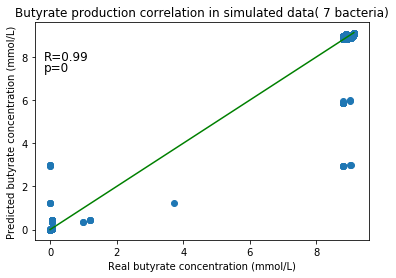

In [28]:
plt.title ('Butyrate production correlation in simulated data( 7 bacteria)')  
plt.scatter (x7, y7)  
plt.plot (np.unique(x7), np.poly1d(np.polyfit(x7,y7, 1))(np.unique(x7)), color = 'green')  
plt.xlabel ('Real butyrate concentration (mmol/L)')  
plt.ylabel ('Predicted butyrate concentration (mmol/L)') 
plt.annotate("R=0.99",xy=(2, 9), xycoords='data',
            xytext=(0.5, 8),size=12, va="center", ha="center")
plt.annotate("p=0",xy=(2, 9), xycoords='data',
            xytext=(0.2,7.5),size=12, va="center", ha="center")
plt.savefig("Correlation7bact_S.png", dpi=300,bbox_inches='tight')

# 8 bacteria

In [19]:
tr8=pd.read_table(folder + "simulaciones/res_simulations/train_data_simulated/train_8bactS")
tr8

,conc,b1r1,b1r2,b1r3,b1r4,b1r5,b1r6,b1r7,b1r8,b1r9,...,b8r16,b8r17,b8r18,b8r19,b8r20,b8r21,b8r22,b8r23,b8r24,b8r25
0,8.878291,1,0,1,0,0,1,1,1,0,...,1,1,1,0,0,1,1,0,1,0
1,8.878291,1,0,1,0,0,1,1,1,0,...,1,1,1,0,0,0,0,0,1,1
2,8.878291,1,0,1,0,0,1,1,1,0,...,1,1,1,0,0,1,1,1,0,0
3,8.878291,1,0,1,0,0,1,1,1,0,...,1,1,0,0,0,0,1,0,1,1
4,8.878291,1,0,1,0,0,1,1,1,0,...,1,1,0,0,0,0,0,0,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
69058,8.878261,1,0,1,0,0,1,1,1,0,...,1,1,1,0,0,1,1,0,1,1
69059,8.878261,1,0,1,0,0,1,1,1,0,...,1,1,1,0,0,1,1,0,1,0
69060,8.878261,1,0,1,0,0,1,1,1,0,...,1,1,1,0,0,0,0,0,1,1
69061,8.878261,1,0,1,0,0,1,1,1,0,...,1,1,1,0,0,1,1,1,0,0


In [20]:
X8 = tr8.iloc [:, 1:201].values
y8 = tr8.iloc[:, 0].values


In [21]:
neigh = KNeighborsRegressor(n_neighbors=3)
neigh.fit(X8, y8)
dump(neigh, 'knn_8bact.joblib') 

['knn_8bact.joblib']

In [22]:
from sklearn.model_selection import LeaveOneOut
loo = LeaveOneOut()
loo.get_n_splits(X8)

69063

In [23]:
for i, (train_index, test_index) in enumerate(loo.split(X8)):
    X8_train, X8_test = X8[train_index], X8[test_index]
 #   print(neigh.predict(X_test))
    print(f"real value {y8[i]} \tpredict: {neigh.predict(X8_test)}")

real value 8.878291073595081 	predict: [8.8782708]
real value 8.878291073595081 	predict: [8.8782708]
real value 8.878291073595081 	predict: [8.8782708]
real value 8.878291073595081 	predict: [8.8782708]
real value 8.878291073595081 	predict: [8.8782708]
real value 8.878291073595081 	predict: [8.8782708]
real value 8.878291073595081 	predict: [8.8782708]
real value 8.878291073595081 	predict: [8.8782708]
real value 8.878291073595081 	predict: [8.8782708]
real value 8.878291073595081 	predict: [8.87825053]
real value 8.878291073595081 	predict: [8.87825053]
real value 8.878291073595081 	predict: [8.87825053]
real value 8.878291073595081 	predict: [8.87825053]
real value 8.878291073595081 	predict: [8.87825053]
real value 8.878291073595081 	predict: [8.87825053]
real value 8.878291073595081 	predict: [8.87825053]
real value 8.878291073595081 	predict: [8.87825053]
real value 8.878291073595081 	predict: [8.87825053]
real value 8.878291073595081 	predict: [8.87825053]
real value 8.87829107

real value 8.878291073595081 	predict: [8.87825053]
real value 8.878291073595081 	predict: [8.87825053]
real value 8.878291073595081 	predict: [8.87825053]
real value 8.878291073595081 	predict: [8.87825053]
real value 8.878291073595081 	predict: [8.87825053]
real value 8.878291073595081 	predict: [8.87825053]
real value 8.878291073595081 	predict: [8.87825053]
real value 8.878291073595081 	predict: [8.87825053]
real value 8.878291073595081 	predict: [8.87825053]
real value 8.878291073595081 	predict: [8.87825053]
real value 8.878291073595081 	predict: [8.87825053]
real value 8.878291073595081 	predict: [8.87825053]
real value 8.878291073595081 	predict: [8.87825053]
real value 8.878291073595081 	predict: [8.87825053]
real value 8.878291073595081 	predict: [8.87825053]
real value 8.878291073595081 	predict: [8.87825053]
real value 8.878291073595081 	predict: [8.87825053]
real value 8.878291073595081 	predict: [8.8782708]
real value 8.878291073595081 	predict: [8.8782708]
real value 8.8

real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	pr

real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533

real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	pr

real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8

real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8

real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8

real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8

real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8

real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	pr

real value 8.878291073595081 	predict: [8.87829107]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	p

real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084

real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084

real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8

real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	

real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	pr

real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8

real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8

real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	pr

real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8.878291073595081 	predict: [8.87829107]
real value 8

real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.878291073595081 	predict: [8.83175092]
real value 8.878291073595081 	predict: [8.83175092]
real value 8.878291073595081 

real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	predict: [8.80848085]
real value 8.80848084533729 	pr

real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real va

real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	pr

real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real va

real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value

real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value

real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value

real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value

real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value

real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: 

real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 4.389389584082179e-05 	predict: [1.46312986e-05]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023

real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	pr

real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 

real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value

real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	pr

real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict:

real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	pr

real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	pr

real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.06981022825779 	predict: [0.02327008]
real value 0.069810

real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value

real value 0.0 	predict: [0.]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
r

real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value

real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	pr

real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	pr

real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06979628]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [6.32113479e-06]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [6.32113479e-06]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [6.32113479e-06]
real value 0.0 	predict: [0.]
real value 0.0 	pre

real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023

real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	pr

real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	pr

real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	pr

real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	pr

real value 0.06981022825779 	predict: [0.06979628]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06981023]
real value 0.06981022825779 	predict: [0.06979628]
real value 0.06981022825779 	predict: [0.06979628]
real value 0.06981022825779 	predict: [0.06979628]
real value 0.06981022825779 	predict: [0.06979628]
real value 0.06981022825779 	predict: [0.06979628]
real value 0.06981022825779 	predict: [0.06979628]
real value 0.06981022825779 	predict: [0.06979628]
real value 0.06981022825779 	predict: [0.06979628]
real value 0.06981022825779 	predict: [0.06979628]
real value 0.06981022825779 	predict: [0.06979628]
real value 0.06981022825779 	predict: [0.06979628]
real value 0.06981022825779 	predict: [0.06979628]
real value 0.06981022825779 	pr

real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [6.32113479e-06]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.069748465531419 	predict: [0.06976905]
real value 0.069748465531419 	predict: [0.06974847]
real value 0.069748465531419 	predict: [0.06974847]
real value 0.069748465531419 	predict: [0.06974847]


real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value

real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.069748465531419 	predict: [0.06974847]
real value 0.069748465531419 	predict: [0.06974847]
real value 0.069748465531419 	predict: [0.06974847]
real value 0.069748465531419 	predict: [0.06974847]
real value 0.069748465531419 	predict: [0.06974847]
real value 0.069748465531419 	predict: [0.06974847]
real value 0.069748465531419 	predict: [0.06974847]
real value 0.069748465531419 	predict: [0.06974847]
real value 0.069748465531419 	predict: [0.06974847]
real value 0.069748465531419 	predict: [0.06974847]
real value 0.069748465531419 	predict: [0.06974847]
real value 0.069748465531419 	predict: [0.06974847]
real value 0.069748465531419 	predict: [0.06974847]
real value 0.069748465531419 	predict: [0.06974847]
re

real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value

real value 0.069748465531419 	predict: [0.06974847]
real value 0.069748465531419 	predict: [0.06974847]
real value 0.069748465531419 	predict: [0.06974847]
real value 0.069748465531419 	predict: [0.06974847]
real value 0.069748465531419 	predict: [0.06974847]
real value 0.069748465531419 	predict: [0.06974847]
real value 0.069748465531419 	predict: [0.06974847]
real value 0.069748465531419 	predict: [0.06974847]
real value 0.069748465531419 	predict: [0.06974847]
real value 0.069748465531419 	predict: [0.06974847]
real value 0.069748465531419 	predict: [0.06974847]
real value 0.069748465531419 	predict: [0.06974847]
real value 0.069748465531419 	predict: [0.06974847]
real value 0.069748465531419 	predict: [0.06974847]
real value 0.069748465531419 	predict: [0.06974847]
real value 0.069748465531419 	predict: [0.06974847]
real value 0.069748465531419 	predict: [0.06974847]
real value 0.069748465531419 	predict: [0.06974847]
real value 0.069748465531419 	predict: [0.06974847]
real value 0

real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value

real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [7.20721961e-05]
real value 0.0 	predict: [7.20721961e-05]
real value 0.0 	predict: [7.20721961e-05]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [7.20721961e-05]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [7.20721961e-05]
real value 0.0 	predict: [7.20721961e-05]
real value 0.0 	predict: [7.20721961e-05]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [7.20721961e-05]
real value 0.0 	predict: [7.20721961e-05]
real value 0.0 	predict: [7.20721961e-05]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [7.20721961e-05]
real value 0.0 	predict: [7.20721961e-05]
real value 0.0 	predict: [7.20721961e-05]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [7.20721961e-05]
real value 0.0 	predic

real value 0.069748465531419 	predict: [0.06981364]
real value 0.069748465531419 	predict: [0.06981364]
real value 0.069748465531419 	predict: [0.06974157]
real value 0.069748465531419 	predict: [0.06981364]
real value 0.069748465531419 	predict: [0.06981364]
real value 0.069748465531419 	predict: [0.06981364]
real value 0.069748465531419 	predict: [0.06981364]
real value 0.069748465531419 	predict: [0.06974157]
real value 0.069748465531419 	predict: [0.06974157]
real value 0.069748465531419 	predict: [0.06974157]
real value 0.069748465531419 	predict: [0.06981364]
real value 0.069748465531419 	predict: [0.06981364]
real value 0.069748465531419 	predict: [0.06981364]
real value 0.069748465531419 	predict: [0.06974157]
real value 0.069748465531419 	predict: [0.06981364]
real value 0.069748465531419 	predict: [0.06981364]
real value 0.069748465531419 	predict: [0.06981364]
real value 0.069748465531419 	predict: [0.06974157]
real value 0.069748465531419 	predict: [0.06981364]
real value 0

real value 0.0 	predict: [7.20721961e-05]
real value 0.0 	predict: [7.20721961e-05]
real value 0.0 	predict: [7.20721961e-05]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [7.20721961e-05]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [7.20721961e-05]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [7.20721961e-05]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [7.20721961e-05]
real value 0.0 	predict: [7.20721961e-05]
real value 0.0 	predict: [7.20721961e-05]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [7.20721961e-05]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [7.20721961e-05]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [7.20721961e-05]
real value 0.0 	

real value 0.069748465531419 	predict: [0.06981364]
real value 0.069748465531419 	predict: [0.06981364]
real value 0.069748465531419 	predict: [0.06974157]
real value 0.069748465531419 	predict: [0.06974157]
real value 0.069748465531419 	predict: [0.06981364]
real value 0.069748465531419 	predict: [0.06981364]
real value 0.069748465531419 	predict: [0.06981364]
real value 0.069748465531419 	predict: [0.06974157]
real value 0.069748465531419 	predict: [0.06974157]
real value 0.069748465531419 	predict: [0.06974157]
real value 0.069748465531419 	predict: [0.06981364]
real value 0.069748465531419 	predict: [0.06981364]
real value 0.069748465531419 	predict: [0.06981364]
real value 0.069748465531419 	predict: [0.06974157]
real value 0.0 	predict: [7.20721961e-05]
real value 0.0 	predict: [7.20721961e-05]
real value 0.0 	predict: [7.20721961e-05]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [7.20721961e-05]
real value 0.0 	predict: [7.20721961e-05]
real value 0.0 	predict: [7.2072

real value 0.069748465531419 	predict: [0.06981364]
real value 0.069748465531419 	predict: [0.06974157]
real value 0.069748465531419 	predict: [0.06974157]
real value 0.069748465531419 	predict: [0.06974157]
real value 0.069748465531419 	predict: [0.06981364]
real value 0.069748465531419 	predict: [0.06981364]
real value 0.069748465531419 	predict: [0.06981364]
real value 0.069748465531419 	predict: [0.06974157]
real value 0.069748465531419 	predict: [0.06974157]
real value 0.069748465531419 	predict: [0.06974157]
real value 0.069748465531419 	predict: [0.06981364]
real value 0.069748465531419 	predict: [0.06974157]
real value 0.069748465531419 	predict: [0.06981364]
real value 0.069748465531419 	predict: [0.06974157]
real value 0.069748465531419 	predict: [0.06974157]
real value 0.069748465531419 	predict: [0.06974157]
real value 0.069748465531419 	predict: [0.06981364]
real value 0.069748465531419 	predict: [0.06981364]
real value 0.069748465531419 	predict: [0.06981364]
real value 0

real value 0.069748465531419 	predict: [0.06974157]
real value 0.069748465531419 	predict: [0.06974157]
real value 0.069748465531419 	predict: [0.06974157]
real value 0.069748465531419 	predict: [0.06981364]
real value 0.069748465531419 	predict: [0.06974157]
real value 0.069748465531419 	predict: [0.06981364]
real value 0.069748465531419 	predict: [0.06974157]
real value 0.069748465531419 	predict: [0.06974157]
real value 0.069748465531419 	predict: [0.06974157]
real value 0.069748465531419 	predict: [0.06981364]
real value 0.069748465531419 	predict: [0.06981364]
real value 0.069748465531419 	predict: [0.06981364]
real value 0.069748465531419 	predict: [0.06974157]
real value 0.069748465531419 	predict: [0.06974157]
real value 0.069748465531419 	predict: [0.06981364]
real value 0.069748465531419 	predict: [0.06981364]
real value 0.069748465531419 	predict: [0.06981364]
real value 0.069748465531419 	predict: [0.06974157]
real value 0.069748465531419 	predict: [0.06974157]
real value 0

real value 0.0 	predict: [7.20721961e-05]
real value 0.069748465531419 	predict: [0.06981364]
real value 0.069748465531419 	predict: [0.06981364]
real value 0.069748465531419 	predict: [0.06981364]
real value 0.069748465531419 	predict: [0.06974157]
real value 0.069748465531419 	predict: [0.06981364]
real value 0.069748465531419 	predict: [0.06981364]
real value 0.069748465531419 	predict: [0.06981364]
real value 0.069748465531419 	predict: [0.06981364]
real value 0.069748465531419 	predict: [0.06974157]
real value 0.069748465531419 	predict: [0.06974157]
real value 0.069748465531419 	predict: [0.06974157]
real value 0.069748465531419 	predict: [0.06981364]
real value 0.069748465531419 	predict: [0.06981364]
real value 0.069748465531419 	predict: [0.06981364]
real value 0.069748465531419 	predict: [0.06974157]
real value 0.069748465531419 	predict: [0.06981364]
real value 0.069748465531419 	predict: [0.06974157]
real value 0.069748465531419 	predict: [0.06974157]
real value 0.069748465

real value 0.0 	predict: [7.20721961e-05]
real value 0.0 	predict: [7.20721961e-05]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [7.20721961e-05]
real value 0.0 	predict: [7.20721961e-05]
real value 0.0 	predict: [7.20721961e-05]
real value 0.0 	predict: [7.20721961e-05]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [7.20721961e-05]
real value 0.0 	predict: [7.20721961e-05]
real value 0.0 	predict: [7.20721961e-05]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [7.20721961e-05]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [7.20721961e-05]
real value 0.0 	predict: [7.20721961e-05]
real value 0.0 	predict: [7.20721961e-05]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [7.20721961e-05]
real value 0.0 	predict: [7.20721961e-05]
real value 0.0 	predict: [7.20721961e-05]
real value 0.0 	predict: [0.

real value 0.0 	predict: [7.20721961e-05]
real value 0.0 	predict: [7.20721961e-05]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [7.20721961e-05]
real value 0.0 	predict: [7.20721961e-05]
real value 0.0 	predict: [7.20721961e-05]
real value 0.0 	predict: [7.20721961e-05]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [7.20721961e-05]
real value 0.0 	predict: [7.20721961e-05]
real value 0.0 	predict: [7.20721961e-05]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [7.20721961e-05]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [7.20721961e-05]
real value 0.0 	predict: [7.20721961e-05]
real value 0.0 	predict: [7.20721961e-05]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [7.20721961e-05]
real value 0.0 	predict: [7.20721961e-05]
real value 0.0 	predict: [7.20721961e-05]
real value 0.0 	predict: [0.

real value 0.069748465531419 	predict: [0.06987882]
real value 0.069748465531419 	predict: [0.06987882]
real value 0.069748465531419 	predict: [0.06987882]
real value 0.069748465531419 	predict: [0.06973467]
real value 0.069748465531419 	predict: [0.06987882]
real value 0.069748465531419 	predict: [0.06987882]
real value 0.069748465531419 	predict: [0.06987882]
real value 0.069748465531419 	predict: [0.06987882]
real value 0.069748465531419 	predict: [0.06973467]
real value 0.069748465531419 	predict: [0.06973467]
real value 0.069748465531419 	predict: [0.06973467]
real value 0.069748465531419 	predict: [0.06987882]
real value 0.069748465531419 	predict: [0.06987882]
real value 0.069748465531419 	predict: [0.06987882]
real value 0.069748465531419 	predict: [0.06973467]
real value 0.069748465531419 	predict: [0.06987882]
real value 0.069748465531419 	predict: [0.06987882]
real value 0.069748465531419 	predict: [0.06987882]
real value 0.069748465531419 	predict: [0.06973467]
real value 0

real value 0.0 	predict: [0.00014414]
real value 0.0 	predict: [0.00014414]
real value 0.0 	predict: [0.00014414]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.00014414]
real value 0.0 	predict: [0.00014414]
real value 0.0 	predict: [0.00014414]
real value 0.0 	predict: [0.00014414]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.00014414]
real value 0.0 	predict: [0.00014414]
real value 0.0 	predict: [0.00014414]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.00014414]
real value 0.0 	predict: [0.00014414]
real value 0.0 	predict: [0.00014414]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.00014414]
real value 0.0 	predict: [0.00014414]
real value 0.0 	predict: [0.00014414]
real value 0.0 	predict: [0.00014414]
real value 0.0 	predict: [0.00014414]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.00014414]
real value 0.0 	predict: [0.00014414]
real value 0.0 	predict: [0.00

real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.80848084

real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.878273204758509 	predict: [8.85499445]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.

real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8

real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8

real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.8414632]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.

real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8

real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.

real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8

real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.808480845328669 	p

real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	pr

real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.8084

real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	pr

real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	pr

real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.8782293108600

real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	pr

real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931

real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8

real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.85497982]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.85497982]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.85497982]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	pr

real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.87822931086009 	predict: [8.83173033]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931

real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8

real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848618]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8

real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87

real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8

real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8

real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8

real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8

real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8

real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8

real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328

real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.85497982]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	pr

real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848279]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848279]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848279]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848279]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8

real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8

real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8

real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8

real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8

real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848279]
real value 8.808480845328669 	predict: [8.80848279]
real value 8.808480845328669 	predict: [8.80848279]
real value 8.808480845328669 	predict: [8.84146515]
real value 8.808480845328669 	predict: [8.80848279]
real value 8

real value 8.87822931086009 	predict: [8.87822815]
real value 8.87822931086009 	predict: [8.87822815]
real value 8.87822931086009 	predict: [8.87822815]
real value 8.87822931086009 	predict: [8.87822815]
real value 8.87822931086009 	predict: [8.87822815]
real value 8.87822931086009 	predict: [8.87822815]
real value 8.87822931086009 	predict: [8.87822815]
real value 8.87822931086009 	predict: [8.87822815]
real value 8.87822931086009 	predict: [8.87822815]
real value 8.87822931086009 	predict: [8.87822815]
real value 8.87822931086009 	predict: [8.87824113]
real value 8.87822931086009 	predict: [8.87822815]
real value 8.87822931086009 	predict: [8.87822815]
real value 8.87822931086009 	predict: [8.87822815]
real value 8.87822931086009 	predict: [8.87822815]
real value 8.87822931086009 	predict: [8.87822815]
real value 8.808480845328669 	predict: [8.80848279]
real value 8.808480845328669 	predict: [8.80848279]
real value 8.808480845328669 	predict: [8.80848279]
real value 8.808480845328669

real value 8.87822931086009 	predict: [8.87822815]
real value 8.87822931086009 	predict: [8.87822815]
real value 8.87822931086009 	predict: [8.87822815]
real value 8.87822931086009 	predict: [8.87822815]
real value 8.87822931086009 	predict: [8.87822698]
real value 8.87822931086009 	predict: [8.87822698]
real value 8.87822931086009 	predict: [8.87822698]
real value 8.87822931086009 	predict: [8.87822698]
real value 8.87822931086009 	predict: [8.87822698]
real value 8.87822931086009 	predict: [8.87822698]
real value 8.87822931086009 	predict: [8.87822815]
real value 8.87822931086009 	predict: [8.87822815]
real value 8.87822931086009 	predict: [8.87822815]
real value 8.87822931086009 	predict: [8.87822815]
real value 8.87822931086009 	predict: [8.87823058]
real value 8.87822931086009 	predict: [8.87822815]
real value 8.87822931086009 	predict: [8.87822815]
real value 8.87822931086009 	predict: [8.87822815]
real value 8.87822931086009 	predict: [8.87822815]
real value 8.87822931086009 	pr

real value 8.808480845328669 	predict: [8.80848279]
real value 8.808480845328669 	predict: [8.80848279]
real value 8.808480845328669 	predict: [8.80848279]
real value 8.808480845328669 	predict: [8.80848279]
real value 8.808480845328669 	predict: [8.80848474]
real value 8.808480845328669 	predict: [8.80848474]
real value 8.808480845328669 	predict: [8.80848474]
real value 8.808480845328669 	predict: [8.80848474]
real value 8.808480845328669 	predict: [8.80848474]
real value 8.808480845328669 	predict: [8.80848474]
real value 8.808480845328669 	predict: [8.80848474]
real value 8.808480845328669 	predict: [8.80848474]
real value 8.808480845328669 	predict: [8.80848474]
real value 8.808480845328669 	predict: [8.80848474]
real value 8.808480845328669 	predict: [8.80848279]
real value 8.808480845328669 	predict: [8.80848279]
real value 8.808480845328669 	predict: [8.80848279]
real value 8.808480845328669 	predict: [8.80848279]
real value 8.808480845328669 	predict: [8.80848279]
real value 8

real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8

real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8

real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.808480845328669 	predict: [8.80848085]
real value 8.80848084

real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	predict: [8.87822931]
real value 8.87822931086009 	pr

real value 8.90744303196714 	predict: [8.84148088]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849349]
real value 8.80849980878234 	predict: [8.80849349]
real value 8.80849980878234 	predict: [8.80849349]
real value 8.80849980878234 	predict: [8.80849349]
real value 8.80849980878234 	predict: [8.80849349]
real value 8.80849980878234 	predict: [8.80849349]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	pr

real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	pr

real value 8.8782492182821 	predict: [8.87824922]
real value 8.8782492182821 	predict: [8.87824922]
real value 8.8782492182821 	predict: [8.87825326]
real value 8.8782492182821 	predict: [8.87824922]
real value 8.8782492182821 	predict: [8.87824922]
real value 8.8782492182821 	predict: [8.87824922]
real value 8.8782492182821 	predict: [8.87824922]
real value 8.8782492182821 	predict: [8.87824922]
real value 8.8782492182821 	predict: [8.87824922]
real value 8.8782492182821 	predict: [8.87824922]
real value 8.8782492182821 	predict: [8.87824922]
real value 8.8782492182821 	predict: [8.87824922]
real value 8.8782492182821 	predict: [8.87825326]
real value 8.8782492182821 	predict: [8.87825326]
real value 8.8782492182821 	predict: [8.87824922]
real value 8.80849980878234 	predict: [8.80849349]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849

real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	pr

real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	pr

real value 8.80849980878234 	predict: [8.80849349]
real value 8.80849980878234 	predict: [8.80849349]
real value 8.80849980878234 	predict: [8.80849349]
real value 8.80849980878234 	predict: [8.80849349]
real value 8.80849980878234 	predict: [8.80849349]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.84148088]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849349]
real value 8.80849980878234 	predict: [8.80849349]
real value 8.80849980878234 	predict: [8.80849349]
real value 8.80849980878234 	predict: [8.80849349]
real value 8.80849980878234 	pr

real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	pr

real value 8.8782492182821 	predict: [8.87824922]
real value 8.8782492182821 	predict: [8.91123157]
real value 8.8782492182821 	predict: [8.87824922]
real value 8.8782492182821 	predict: [8.87824922]
real value 8.8782492182821 	predict: [8.87824922]
real value 8.8782492182821 	predict: [8.87824922]
real value 8.8782492182821 	predict: [8.87824922]
real value 8.8782492182821 	predict: [8.87824922]
real value 8.8782492182821 	predict: [8.87824922]
real value 8.8782492182821 	predict: [8.87824922]
real value 8.8782492182821 	predict: [8.87824922]
real value 8.8782492182821 	predict: [8.87824922]
real value 8.8782492182821 	predict: [8.87824922]
real value 8.8782492182821 	predict: [8.87824922]
real value 8.8782492182821 	predict: [8.87824922]
real value 8.8782492182821 	predict: [8.87824922]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.808499

real value 8.8782492182821 	predict: [8.87824922]
real value 8.8782492182821 	predict: [8.87824922]
real value 8.8782492182821 	predict: [8.87824922]
real value 8.8782492182821 	predict: [8.83174961]
real value 8.8782492182821 	predict: [8.87824922]
real value 8.8782492182821 	predict: [8.87824922]
real value 8.8782492182821 	predict: [8.87824922]
real value 8.8782492182821 	predict: [8.87824922]
real value 8.8782492182821 	predict: [8.87824922]
real value 8.8782492182821 	predict: [8.87824922]
real value 8.8782492182821 	predict: [8.87824922]
real value 8.8782492182821 	predict: [8.87824922]
real value 8.8782492182821 	predict: [8.87824922]
real value 8.8782492182821 	predict: [8.87824922]
real value 8.8782492182821 	predict: [8.87824922]
real value 8.8782492182821 	predict: [8.87824922]
real value 8.8782492182821 	predict: [8.87824922]
real value 8.8782492182821 	predict: [8.87824922]
real value 8.8782492182821 	predict: [8.87824922]
real value 8.8782492182821 	predict: [8.87824922]


real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849349]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849349]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	predict: [8.80849981]
real value 8.80849980878234 	pr

real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.0697

real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	pr

real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8

real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0

real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	

real value 0.069768372904138 	predict: [0.06976837]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404

real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8

real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8

real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8

real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0

real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]


real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8

real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]


real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.04651857]
real value 0.069768372904138 	predict: [0.04651857]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.04651857]
real value 0

real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8

real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8

real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8

real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89

real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837

real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.26422696e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8

real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.26422696e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8

real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0

real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8

real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8

real value 0.069768372904138 	predict: [0.06976837]
real value 1.8963404377414e-05 	predict: [1.26422696e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404

real value 1.8963404377414e-05 	predict: [1.26422696e-05]
real value 1.8963404377414e-05 	predict: [1.26422696e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.26422696e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.26422696e-05]
real value 0.069768372904138 	predict: [0.06978232]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837

real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8

real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8

real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0

real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8

real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8

real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8

real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06978232]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.26422696e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.26422696e-05]
real value 1.8963404377414e-05 	predict: [1.

real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8

real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predic

real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0

real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8

real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8

real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0

real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [

real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8963404377414e-05 	predict: [1.89634044e-05]
real value 1.8

real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06976837]
real value 0.069768372904138 	predict: [0.06978232]
real value 0.069768372904138 	predict: [0.06978232]
real value 0.069768372904138 	predict: [0.06978232]
real value 0.069768372904138 	predict: [0.06978232]
real value 0.069768372904138 	predict: [0.06978232]
real value 0.069768372904138 	predict: [0.06978232]
real value 0.069768372904138 	predict: [0.06978232]
real value 0.069768372904138 	predict: [0.06978232]
real value 0.069768372904138 	predict: [0.06978232]
real value 0.069768372904138 	predict: [0.06978232]
real value 0.069768372904138 	predict: [0.06978232]
real value 0.069768372904138 	predict: [0.06978232]
real value 0.069768372904138 	predict: [0.06978232]
real value 0.069768372904138 	predict: [0.06978232]
real value 0.069768372904138 	predict: [0.06978232]
real value 0.069768372904138 	predict: [0.06978232]
real value 0.069768372904138 	predict: [0.06978232]
real value 0

real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	

real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8

real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 

real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	pr

real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.878230254877721 	p

real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.91121261]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8

real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	pr

real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	

real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.8084808453779

real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	pr

real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	pr

real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80

real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	pr

real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	pr

real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	pr

real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	pr

real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.91121261]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8

real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87825053]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87825053]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87825053]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8

real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	pr

real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.808480845377

real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.808480845

real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8

real value 8.878230254877721 	predict: [8.87825053]
real value 8.878230254877721 	predict: [8.8782708]
real value 8.878230254877721 	predict: [8.8782708]
real value 8.878230254877721 	predict: [8.8782708]
real value 8.878230254877721 	predict: [8.8782708]
real value 8.878230254877721 	predict: [8.8782708]
real value 8.878230254877721 	predict: [8.8782708]
real value 8.878230254877721 	predict: [8.8782708]
real value 8.878230254877721 	predict: [8.8782708]
real value 8.878230254877721 	predict: [8.8782708]
real value 8.878230254877721 	predict: [8.87825053]
real value 8.878230254877721 	predict: [8.87825053]
real value 8.878230254877721 	predict: [8.87825053]
real value 8.878230254877721 	predict: [8.87825053]
real value 8.878230254877721 	predict: [8.87825053]
real value 8.878230254877721 	predict: [8.87825053]
real value 8.878230254877721 	predict: [8.87825053]
real value 8.878230254877721 	predict: [8.87825053]
real value 8.878230254877721 	predict: [8.87825053]
real value 8.87823025

real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.808480845

real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.8782302

real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87825053]
real value 8.878230254877721 	predict: [8.87825053]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87825053]
real value 8.878230254877721 	predict: [8.87825053]
real value 8.878230254877721 	predict: [8.87825053]
real value 8.878230254877721 	predict: [8.87825053]
real value 8.878230254877721 	predict: [8.8782708]
real value 8.878230254877721 	predict: [8.87825053]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87825053]
real value 8.878230254877721 	predict: [8.87825053]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.

real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.80848084537796 	predict: [8.80848085]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.878230254877721 	predict: [8.87823025]
real value 8.8782302548777

real value 8.878230254877721 	predict: [8.87825053]
real value 8.878230254877721 	predict: [8.87825053]
real value 8.878230254877721 	predict: [8.87825053]
real value 8.878230254877721 	predict: [8.87825053]
real value 8.878230254877721 	predict: [8.87825053]
real value 8.878230254877721 	predict: [8.87825053]
real value 8.878230254877721 	predict: [8.87825053]
real value 8.878230254877721 	predict: [8.87825053]
real value 8.878230254877721 	predict: [8.87825053]
real value 8.878230254877721 	predict: [8.87825053]
real value 8.878230254877721 	predict: [8.87825053]
real value 8.878230254877721 	predict: [8.87825053]
real value 8.878230254877721 	predict: [8.87825053]
real value 8.878230254877721 	predict: [8.87825053]
real value 8.878230254877721 	predict: [8.87825053]
real value 8.878230254877721 	predict: [8.87825053]
real value 8.80848668962995 	predict: [8.80848279]
real value 8.80848668962995 	predict: [8.80848474]
real value 8.80848668962995 	predict: [8.80848669]
real value 8.80

real value 8.878225814877089 	predict: [8.87822815]
real value 8.878225814877089 	predict: [8.87822815]
real value 8.878225814877089 	predict: [8.87822815]
real value 8.878225814877089 	predict: [8.87822815]
real value 8.878236625830999 	predict: [8.87823175]
real value 8.878225814877089 	predict: [8.87822815]
real value 8.878225814877089 	predict: [8.87822815]
real value 8.878225814877089 	predict: [8.87822815]
real value 8.878225814877089 	predict: [8.87822815]
real value 8.878225814877089 	predict: [8.87822815]
real value 8.878225814877089 	predict: [8.87822815]
real value 8.878225814877089 	predict: [8.87822815]
real value 8.878225814877089 	predict: [8.87822815]
real value 8.878225814877089 	predict: [8.87822815]
real value 8.878225814877089 	predict: [8.87822815]
real value 8.878225814877089 	predict: [8.87822815]
real value 8.878225814877089 	predict: [8.87822815]
real value 8.878225814877089 	predict: [8.87822815]
real value 8.878225814877089 	predict: [8.87822815]
real value 8

real value 8.878225814877089 	predict: [8.87822698]
real value 8.878225814877089 	predict: [8.87822698]
real value 8.878225814877089 	predict: [8.87822698]
real value 8.878225814877089 	predict: [8.87822698]
real value 8.878225814877089 	predict: [8.87822698]
real value 8.878225814877089 	predict: [8.87822698]
real value 8.878225814877089 	predict: [8.87822698]
real value 8.878225814877089 	predict: [8.87822698]
real value 8.878225814877089 	predict: [8.87822698]
real value 8.878225814877089 	predict: [8.87822698]
real value 8.878225814877089 	predict: [8.87822698]
real value 8.878225814877089 	predict: [8.87822698]
real value 8.878225814877089 	predict: [8.87822698]
real value 8.878225814877089 	predict: [8.87822698]
real value 8.878225814877089 	predict: [8.87822815]
real value 8.878225814877089 	predict: [8.87822815]
real value 8.878225814877089 	predict: [8.87822815]
real value 8.878225814877089 	predict: [8.87822815]
real value 8.878225814877089 	predict: [8.87822815]
real value 8

real value 8.80848668962995 	predict: [8.80848279]
real value 8.80848668962995 	predict: [8.80848279]
real value 8.80848668962995 	predict: [8.80848279]
real value 8.80848668962995 	predict: [8.80848279]
real value 8.80848668962995 	predict: [8.80848279]
real value 8.80848668962995 	predict: [8.80848279]
real value 8.80848668962995 	predict: [8.80848279]
real value 8.80848668962995 	predict: [8.80848279]
real value 8.80848668962995 	predict: [8.80848279]
real value 8.808497500583869 	predict: [8.8084864]
real value 8.80848668962995 	predict: [8.80848279]
real value 8.80848668962995 	predict: [8.80848279]
real value 8.80848668962995 	predict: [8.80848279]
real value 8.80848668962995 	predict: [8.80848279]
real value 8.80848668962995 	predict: [8.80848279]
real value 8.80848668962995 	predict: [8.80848279]
real value 8.80848668962995 	predict: [8.80848279]
real value 8.80848668962995 	predict: [8.80848279]
real value 8.80848668962995 	predict: [8.80848279]
real value 8.80848668962995 	pr

real value 8.878225814877089 	predict: [8.87822698]
real value 8.878225814877089 	predict: [8.87822698]
real value 8.878225814877089 	predict: [8.87822698]
real value 8.878225814877089 	predict: [8.87822698]
real value 8.878225814877089 	predict: [8.87822698]
real value 8.878225814877089 	predict: [8.87822698]
real value 8.878225814877089 	predict: [8.87822698]
real value 8.878225814877089 	predict: [8.87822698]
real value 8.878225814877089 	predict: [8.87822698]
real value 8.878225814877089 	predict: [8.87822698]
real value 8.878225814877089 	predict: [8.87822698]
real value 8.878225814877089 	predict: [8.87822698]
real value 8.878225814877089 	predict: [8.87822698]
real value 8.878225814877089 	predict: [8.87822676]
real value 8.878225814877089 	predict: [8.87822698]
real value 8.878225814877089 	predict: [8.87822698]
real value 8.878225814877089 	predict: [8.87822698]
real value 8.878225814877089 	predict: [8.87822698]
real value 8.878225814877089 	predict: [8.87822698]
real value 8

real value 8.80848668962995 	predict: [8.80848474]
real value 8.80848668962995 	predict: [8.80848474]
real value 8.80848668962995 	predict: [8.80848474]
real value 8.80848668962995 	predict: [8.80848474]
real value 8.80848668962995 	predict: [8.80848474]
real value 8.80848668962995 	predict: [8.80848474]
real value 8.80848668962995 	predict: [8.80848474]
real value 8.80848668962995 	predict: [8.80848474]
real value 8.80848668962995 	predict: [8.80848474]
real value 8.80848668962995 	predict: [8.80848474]
real value 8.80848668962995 	predict: [8.80848474]
real value 8.80848668962995 	predict: [8.80848474]
real value 8.80848668962995 	predict: [8.80848474]
real value 8.80848668962995 	predict: [8.80848474]
real value 8.80848668962995 	predict: [8.80848474]
real value 8.80848668962995 	predict: [8.80848474]
real value 8.80848668962995 	predict: [8.80848474]
real value 8.80848668962995 	predict: [8.80848474]
real value 8.80848668962995 	predict: [8.80848474]
real value 8.80848668962995 	pr

real value 8.80848668962995 	predict: [8.84148203]
real value 8.907472714916949 	predict: [8.84148203]
real value 8.80848668962995 	predict: [8.84148008]
real value 8.80848668962995 	predict: [8.80848474]
real value 8.80848668962995 	predict: [8.80848669]
real value 8.80848668962995 	predict: [8.80848669]
real value 8.808497500583869 	predict: [8.80848835]
real value 8.80848668962995 	predict: [8.80848669]
real value 8.80848668962995 	predict: [8.80848669]
real value 8.80848668962995 	predict: [8.80849029]
real value 8.80848668962995 	predict: [8.80848474]
real value 8.80848668962995 	predict: [8.80848669]
real value 8.80848668962995 	predict: [8.80848474]
real value 8.80848668962995 	predict: [8.80848669]
real value 8.80848668962995 	predict: [8.80848669]
real value 8.80848668962995 	predict: [8.80848669]
real value 8.80848668962995 	predict: [8.80848669]
real value 8.80848668962995 	predict: [8.80848669]
real value 8.80848668962995 	predict: [8.80848669]
real value 8.80848668962995 	

real value 0.06974496949935902 	predict: [0.06974497]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
re

real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-0

real value 0.06974496949935902 	predict: [0.06974497]
real value 0.06974496949935902 	predict: [0.06974497]
real value 0.06974496949935902 	predict: [0.06974497]
real value 0.06974496949935902 	predict: [0.06974497]
real value 0.06974496949935902 	predict: [0.06974497]
real value 0.06974496949935902 	predict: [0.06974497]
real value 0.06974496949935902 	predict: [0.06974497]
real value 0.06974496949935902 	predict: [0.06974497]
real value 0.06974496949935902 	predict: [0.06974497]
real value 0.06974496949935902 	predict: [0.06974497]
real value 0.06974496949935902 	predict: [0.06974497]
real value 0.06974496949935902 	predict: [0.06974497]
real value 0.06974496949935902 	predict: [0.06974497]
real value 0.06974496949935902 	predict: [0.06974497]
real value 0.06974496949935902 	predict: [0.06974497]
real value 0.06974496949935902 	predict: [0.06974497]
real value 0.06974496949935902 	predict: [0.06974497]
real value 0.06974496949935902 	predict: [0.06974497]
real value 0.069744969499359

real value 1.66552061399291e-05 	predict: [9.44790353e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 0.06974496949935902 	predict: [0.06974497]
real value 0.06974496949935902 	predict: [0.06974497]
real value 0.06974496949935902 	predict: [0.06974497]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5

real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-0

real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [9.44790353e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-0

real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-0

real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [9.44790353e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-0

real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-0

real value 0.06974496949935902 	predict: [0.06974497]
real value 0.06974496949935902 	predict: [0.06974497]
real value 0.06974496949935902 	predict: [0.06974497]
real value 0.06974496949935902 	predict: [0.06974497]
real value 0.06974496949935902 	predict: [0.06974497]
real value 0.06974496949935902 	predict: [0.06974497]
real value 0.06974496949935902 	predict: [0.06974497]
real value 0.06974496949935902 	predict: [0.06974497]
real value 0.06974496949935902 	predict: [0.06974497]
real value 0.06974496949935902 	predict: [0.06974497]
real value 0.06974496949935902 	predict: [0.06974497]
real value 0.06974496949935902 	predict: [0.06974497]
real value 0.06974496949935902 	predict: [0.06974497]
real value 0.06974496949935902 	predict: [0.06974497]
real value 0.06974496949935902 	predict: [0.06974497]
real value 0.06974496949935902 	predict: [0.06974497]
real value 0.06974496949935902 	predict: [0.06974497]
real value 0.06974496949935902 	predict: [0.06974497]
real value 0.069744969499359

real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [1.94808407e-06]
real value 5.84425222391928e-06 	predict: [3.89616815e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [3.89616815e-06]
real value 5.84425222391928e-06 	predict: [1.94808407e-06]
real value 5.84425222391928e-06 	predict: [3.89616815e-06]
real value 5.84425222391928e-06 	predict: [3.89616815e-06]
real value 5.84425222391928e-06 	predict: [3.89616815e-0

real value 0.06974496949935902 	predict: [0.06974497]
real value 0.06974496949935902 	predict: [0.06974497]
real value 0.06974496949935902 	predict: [0.06974497]
real value 0.06974496949935902 	predict: [0.06974497]
real value 0.06974496949935902 	predict: [0.06974497]
real value 0.06974496949935902 	predict: [0.06974497]
real value 0.06974496949935902 	predict: [0.06974497]
real value 0.06974496949935902 	predict: [0.06974497]
real value 0.06974496949935902 	predict: [0.06974497]
real value 0.06974496949935902 	predict: [0.06974497]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84

real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-0

real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-0

real value 5.84425222391928e-06 	predict: [3.89616815e-06]
real value 5.84425222391928e-06 	predict: [3.89616815e-06]
real value 5.84425222391928e-06 	predict: [3.89616815e-06]
real value 5.84425222391928e-06 	predict: [3.89616815e-06]
real value 5.84425222391928e-06 	predict: [3.89616815e-06]
real value 5.84425222391928e-06 	predict: [3.89616815e-06]
real value 5.84425222391928e-06 	predict: [3.89616815e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.80921936e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.80921936e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-0

real value 5.84425222391928e-06 	predict: [3.89616815e-06]
real value 1.66552061399291e-05 	predict: [7.49981945e-06]
real value 5.84425222391928e-06 	predict: [3.89616815e-06]
real value 5.84425222391928e-06 	predict: [3.89616815e-06]
real value 5.84425222391928e-06 	predict: [3.89616815e-06]
real value 5.84425222391928e-06 	predict: [3.89616815e-06]
real value 5.84425222391928e-06 	predict: [3.89616815e-06]
real value 5.84425222391928e-06 	predict: [3.89616815e-06]
real value 5.84425222391928e-06 	predict: [3.89616815e-06]
real value 5.84425222391928e-06 	predict: [3.89616815e-06]
real value 5.84425222391928e-06 	predict: [3.89616815e-06]
real value 5.84425222391928e-06 	predict: [3.89616815e-06]
real value 5.84425222391928e-06 	predict: [3.89616815e-06]
real value 5.84425222391928e-06 	predict: [3.89616815e-06]
real value 5.84425222391928e-06 	predict: [3.89616815e-06]
real value 5.84425222391928e-06 	predict: [3.89616815e-06]
real value 5.84425222391928e-06 	predict: [7.49981945e-0

real value 0.06974496949935902 	predict: [0.06979295]
real value 0.06974496949935902 	predict: [0.06979295]
real value 0.06974496949935902 	predict: [0.06979295]
real value 0.06974496949935902 	predict: [0.06976896]
real value 0.06974496949935902 	predict: [0.06976896]
real value 0.06974496949935902 	predict: [0.06976896]
real value 0.06974496949935902 	predict: [0.06976896]
real value 0.06974496949935902 	predict: [0.06976896]
real value 0.06974496949935902 	predict: [0.06976896]
real value 0.06974496949935902 	predict: [0.06976896]
real value 0.06974496949935902 	predict: [0.06976896]
real value 0.06974496949935902 	predict: [0.06976896]
real value 0.06974496949935902 	predict: [0.06976896]
real value 0.06974496949935902 	predict: [0.06979295]
real value 0.06974496949935902 	predict: [0.06979295]
real value 0.06974496949935902 	predict: [0.06979295]
real value 0.06974496949935902 	predict: [0.06979295]
real value 0.06974496949935902 	predict: [0.06979295]
real value 0.069744969499359

real value 5.84425222391928e-06 	predict: [3.89616815e-06]
real value 5.84425222391928e-06 	predict: [3.89616815e-06]
real value 5.84425222391928e-06 	predict: [3.89616815e-06]
real value 5.84425222391928e-06 	predict: [3.89616815e-06]
real value 5.84425222391928e-06 	predict: [3.89616815e-06]
real value 5.84425222391928e-06 	predict: [3.89616815e-06]
real value 5.84425222391928e-06 	predict: [3.89616815e-06]
real value 5.84425222391928e-06 	predict: [3.89616815e-06]
real value 5.84425222391928e-06 	predict: [3.89616815e-06]
real value 5.84425222391928e-06 	predict: [3.89616815e-06]
real value 5.84425222391928e-06 	predict: [3.89616815e-06]
real value 5.84425222391928e-06 	predict: [3.89616815e-06]
real value 5.84425222391928e-06 	predict: [3.89616815e-06]
real value 5.84425222391928e-06 	predict: [3.89616815e-06]
real value 5.84425222391928e-06 	predict: [3.89616815e-06]
real value 5.84425222391928e-06 	predict: [3.89616815e-06]
real value 5.84425222391928e-06 	predict: [3.89616815e-0

real value 0.06974496949935902 	predict: [0.06974497]
real value 0.06974496949935902 	predict: [0.06974497]
real value 0.06974496949935902 	predict: [0.06974497]
real value 0.06974496949935902 	predict: [0.06974497]
real value 0.06974496949935902 	predict: [0.06974497]
real value 0.06974496949935902 	predict: [0.06974497]
real value 0.06974496949935902 	predict: [0.06974497]
real value 0.06974496949935902 	predict: [0.06974497]
real value 0.06974496949935902 	predict: [0.06974497]
real value 0.06974496949935902 	predict: [0.06974497]
real value 0.06974496949935902 	predict: [0.06974497]
real value 0.06974496949935902 	predict: [0.06974497]
real value 0.06974496949935902 	predict: [0.06974497]
real value 0.06974496949935902 	predict: [0.06974497]
real value 0.06974496949935902 	predict: [0.06974497]
real value 0.06974496949935902 	predict: [0.06974497]
real value 0.06974496949935902 	predict: [0.06974497]
real value 0.06974496949935902 	predict: [0.06974497]
real value 0.069744969499359

real value 5.84425222391928e-06 	predict: [3.89616815e-06]
real value 5.84425222391928e-06 	predict: [3.89616815e-06]
real value 5.84425222391928e-06 	predict: [3.89616815e-06]
real value 5.84425222391928e-06 	predict: [3.89616815e-06]
real value 5.84425222391928e-06 	predict: [3.89616815e-06]
real value 5.84425222391928e-06 	predict: [3.89616815e-06]
real value 5.84425222391928e-06 	predict: [3.89616815e-06]
real value 5.84425222391928e-06 	predict: [3.89616815e-06]
real value 5.84425222391928e-06 	predict: [3.89616815e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 0.06974496949935902 	predict: [0.06974497]
real value 0.06974496949935902 	predict: [0.06974497]
real value 0.06974496949935902 	predict: [0.06974497]
real value 0.06974496949935902 	predict: [0.06974497]
real value 0.0697

real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-06]
real value 5.84425222391928e-06 	predict: [5.84425222e-0

real value 0.069816936799324 	predict: [0.06976896]
real value 0.069816936799324 	predict: [0.06976896]
real value 0.069816936799324 	predict: [0.06976896]
real value 0.069816936799324 	predict: [0.06976896]
real value 0.069816936799324 	predict: [0.06976896]
real value 0.069816936799324 	predict: [0.06976896]
real value 0.069816936799324 	predict: [0.06976896]
real value 0.069816936799324 	predict: [0.06976896]
real value 0.069816936799324 	predict: [0.06976896]
real value 0.069816936799324 	predict: [0.06976896]
real value 0.069816936799324 	predict: [0.06976896]
real value 0.069816936799324 	predict: [0.06976896]
real value 0.069816936799324 	predict: [0.06976896]
real value 0.069816936799324 	predict: [0.06976896]
real value 0.069816936799324 	predict: [0.06976896]
real value 0.069816936799324 	predict: [0.06976896]
real value 0.069816936799324 	predict: [0.06976896]
real value 0.069816936799324 	predict: [0.06976896]
real value 0.069816936799324 	predict: [0.06976896]
real value 0

real value 0.069816936799324 	predict: [0.06979295]
real value 0.069816936799324 	predict: [0.06976896]
real value 0.069816936799324 	predict: [0.06976896]
real value 0.069816936799324 	predict: [0.06976896]
real value 0.069816936799324 	predict: [0.06976896]
real value 0.069816936799324 	predict: [0.06976896]
real value 0.069816936799324 	predict: [0.06976896]
real value 0.069816936799324 	predict: [0.06976896]
real value 0.069816936799324 	predict: [0.06976896]
real value 0.069816936799324 	predict: [0.06976896]
real value 0.069816936799324 	predict: [0.06979295]
real value 0.069816936799324 	predict: [0.06979295]
real value 0.069816936799324 	predict: [0.06979295]
real value 0.069816936799324 	predict: [0.06976896]
real value 0.069816936799324 	predict: [0.06976896]
real value 0.069816936799324 	predict: [0.06976896]
real value 0.069816936799324 	predict: [0.06976896]
real value 0.069816936799324 	predict: [0.06976896]
real value 0.069816936799324 	predict: [0.06976896]
real value 0

real value 0.0 	predict: [3.89616815e-06]
real value 4.38938842074465e-05 	predict: [1.85274629e-05]
real value 0.0 	predict: [3.89616815e-06]
real value 0.0 	predict: [3.89616815e-06]
real value 0.0 	predict: [3.89616815e-06]
real value 0.0 	predict: [3.89616815e-06]
real value 0.0 	predict: [3.89616815e-06]
real value 0.0 	predict: [3.89616815e-06]
real value 0.0 	predict: [3.89616815e-06]
real value 0.0 	predict: [3.89616815e-06]
real value 0.0 	predict: [3.89616815e-06]
real value 0.0 	predict: [3.89616815e-06]
real value 0.0 	predict: [3.89616815e-06]
real value 0.0 	predict: [3.89616815e-06]
real value 0.0 	predict: [3.89616815e-06]
real value 0.0 	predict: [3.89616815e-06]
real value 0.0 	predict: [3.89616815e-06]
real value 0.0 	predict: [3.89616815e-06]
real value 0.0 	predict: [3.89616815e-06]
real value 0.0 	predict: [3.89616815e-06]
real value 0.0 	predict: [3.89616815e-06]
real value 0.0 	predict: [3.89616815e-06]
real value 0.0 	predict: [3.89616815e-06]
real value 0.0 	p

real value 0.0 	predict: [1.94808407e-06]
real value 0.0 	predict: [1.94808407e-06]
real value 0.0 	predict: [1.94808407e-06]
real value 0.0 	predict: [1.94808407e-06]
real value 0.0 	predict: [1.94808407e-06]
real value 0.0 	predict: [1.94808407e-06]
real value 0.0 	predict: [1.94808407e-06]
real value 0.0 	predict: [1.94808407e-06]
real value 0.0 	predict: [1.94808407e-06]
real value 0.0 	predict: [1.94808407e-06]
real value 0.0 	predict: [1.29871652e-05]
real value 0.0 	predict: [1.94808407e-06]
real value 0.0 	predict: [1.94808407e-06]
real value 0.0 	predict: [1.94808407e-06]
real value 0.0 	predict: [1.94808407e-06]
real value 0.0 	predict: [1.94808407e-06]
real value 0.0 	predict: [1.94808407e-06]
real value 0.0 	predict: [1.94808407e-06]
real value 0.0 	predict: [1.94808407e-06]
real value 0.0 	predict: [1.94808407e-06]
real value 0.0 	predict: [1.94808407e-06]
real value 0.0 	predict: [1.94808407e-06]
real value 0.0 	predict: [1.94808407e-06]
real value 0.0 	predict: [1.948084

real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.04654657]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.04654657]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.04654657]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.04654657]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.04654657]
real value 0.069816936799324 	predict: [0.04654657]
real value 0

real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value

real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value

real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value

real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value

real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value

real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0

real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [

real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	pr

real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value

real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0

real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0

real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0

real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.069816936799324 	predict: [0.06985929]
real value 0.069816936799324 	predict: [0.06985929]
real value 0.069816936799324 	predict: [0.06985929]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.0

real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0

real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0

real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0

real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0

real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0

real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0

real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06985929]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06978722]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06978722]
real value 0

real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0

real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0

real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0

real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06

real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value

real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value

real value 0.069816936799324 	predict: [0.06981694]
real value 0.069816936799324 	predict: [0.06981694]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [

real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.87829778212735 	predict: [8.83175316]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	pr

real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	pr

real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	pr

real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	pr

real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	pr

real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	pr

real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	pr

real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	pr

real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	pr

real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	pr

real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	pr

real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	pr

real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	pr

real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	pr

real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	pr

real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.8414632]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.8414632]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80849548]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	pred

real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.88593792]
real value 9.040852057902962 	predict: [8.88593792]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.88593792]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	p

real value 8.90742790247508 	predict: [8.8414632]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	pre

real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.8414632]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.8414632]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	pred

real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	pr

real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.8414632]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	pre

real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	pr

real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	pr

real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	pr

real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	pr

real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	pr

real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	pr

real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	pr

real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.8414632]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	pre

real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	pr

real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.85502547]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.85502547]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.85502547]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.85502547]
real value 8.87829778212735 	predict: [8.85502547]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	pr

real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	pr

real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	pr

real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	pr

real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	pr

real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	pr

real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	pr

real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80849317009061 	predict: [8.80848495]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	pr

real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	pr

real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	pr

real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	pr

real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	pr

real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	pr

real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.80848084532802 	predict: [8.80849383]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	pr

real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	pr

real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	pr

real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.90742790247508 	predict: [8.8414632]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	pre

real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.91128013]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	predict: [8.87829778]
real value 8.87829778212735 	pr

real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	predict: [8.80848085]
real value 8.80848084532802 	pr

real value 8.80869706194294 	predict: [8.80869706]
real value 8.80869706194294 	predict: [8.80869706]
real value 8.80869706194294 	predict: [8.80869706]
real value 8.80848084535456 	predict: [8.80855292]
real value 8.80869706194294 	predict: [8.80862499]
real value 8.80869706194294 	predict: [8.80869706]
real value 8.80869706194294 	predict: [8.80862499]
real value 8.80869706194294 	predict: [8.80862499]
real value 8.80848084535456 	predict: [8.80862499]
real value 8.80848084535456 	predict: [8.80862499]
real value 8.80848084535456 	predict: [8.80855292]
real value 8.80869706194294 	predict: [8.80862499]
real value 8.80869706194294 	predict: [8.80862499]
real value 8.80869706194294 	predict: [8.80862499]
real value 8.80848084535456 	predict: [8.80855292]
real value 8.80869706194294 	predict: [8.80862499]
real value 8.80848084535456 	predict: [8.80862499]
real value 8.80848084535456 	predict: [8.80855292]
real value 8.80848084535456 	predict: [8.80855292]
real value 8.80869706194294 	pr

real value 8.80869706194294 	predict: [8.80869706]
real value 8.80848084535456 	predict: [8.80855292]
real value 8.80848084535456 	predict: [8.88600999]
real value 8.80848084535456 	predict: [8.80855292]
real value 8.80869706194294 	predict: [8.80862499]
real value 8.80869706194294 	predict: [8.84160734]
real value 8.80869706194294 	predict: [8.80862499]
real value 8.80848084535456 	predict: [8.80848085]
real value 8.80848084535456 	predict: [8.80848085]
real value 8.80848084535456 	predict: [8.80848085]
real value 8.80848084535456 	predict: [8.80855292]
real value 8.80869706194294 	predict: [8.80855292]
real value 8.80848084535456 	predict: [8.80855292]
real value 8.80848084535456 	predict: [8.80848085]
real value 8.80848084535456 	predict: [8.83172344]
real value 8.80848084535456 	predict: [8.80848085]
real value 8.80848084535456 	predict: [8.80855292]
real value 8.80869706194294 	predict: [8.80862499]
real value 8.80848084535456 	predict: [8.80848085]
real value 8.80848084535456 	pr

real value 8.80869706194294 	predict: [8.80869706]
real value 8.80848084535456 	predict: [8.80848085]
real value 8.80848084535456 	predict: [8.80848085]
real value 8.80848084535456 	predict: [8.80848085]
real value 8.80869706194294 	predict: [8.80869706]
real value 8.80869706194294 	predict: [8.80869706]
real value 8.80869706194294 	predict: [8.80869706]
real value 8.80848084535456 	predict: [8.80848085]
real value 8.80848084535456 	predict: [8.80848085]
real value 8.80848084535456 	predict: [8.80848085]
real value 8.80848084535456 	predict: [8.80848085]
real value 8.80869706194294 	predict: [8.80869706]
real value 8.80848084535456 	predict: [8.80848085]
real value 8.80848084535456 	predict: [8.80848085]
real value 8.80848084535456 	predict: [8.80848085]
real value 8.80869706194294 	predict: [8.80862499]
real value 8.80848084535456 	predict: [8.80855292]
real value 8.80848084535456 	predict: [8.80855292]
real value 8.80848084535456 	predict: [8.80855292]
real value 8.80869706194294 	pr

real value 8.87820862216915 	predict: [8.87820862]
real value 8.87820862216915 	predict: [8.87820862]
real value 8.87842483875752 	predict: [8.87842484]
real value 8.87820862216915 	predict: [8.87820862]
real value 8.87820862216915 	predict: [8.87820862]
real value 8.87820862216915 	predict: [8.87820862]
real value 8.87842483875752 	predict: [8.87842484]
real value 8.87820862216915 	predict: [8.87828069]
real value 8.87820862216915 	predict: [8.87828069]
real value 8.87820862216915 	predict: [8.87828069]
real value 8.87842483875752 	predict: [8.87835277]
real value 8.87842483875752 	predict: [8.87835277]
real value 8.87842483875752 	predict: [8.87835277]
real value 8.87820862216915 	predict: [8.87820862]
real value 8.87820862216915 	predict: [8.87820862]
real value 8.87820862216915 	predict: [8.87820862]
real value 8.80869706194294 	predict: [8.80862499]
real value 8.80869706194294 	predict: [8.80869706]
real value 8.80869706194294 	predict: [8.80869706]
real value 8.80869706194294 	pr

real value 8.87820862216915 	predict: [8.87820862]
real value 8.87820862216915 	predict: [8.87828069]
real value 8.87842483875752 	predict: [8.87835277]
real value 8.87820862216915 	predict: [8.87820862]
real value 8.87820862216915 	predict: [8.87820862]
real value 8.87820862216915 	predict: [8.87820862]
real value 8.87820862216915 	predict: [8.87820862]
real value 8.87820862216915 	predict: [8.87828069]
real value 8.87842483875752 	predict: [8.87835277]
real value 8.87820862216915 	predict: [8.87820862]
real value 8.87820862216915 	predict: [8.87820862]
real value 8.87820862216915 	predict: [8.87820862]
real value 8.87842483875752 	predict: [8.87842484]
real value 8.87820862216915 	predict: [8.87828069]
real value 8.87820862216915 	predict: [8.87828069]
real value 8.87820862216915 	predict: [8.87828069]
real value 8.87842483875752 	predict: [8.87835277]
real value 8.87842483875752 	predict: [8.87835277]
real value 8.87842483875752 	predict: [8.87835277]
real value 8.87820862216915 	pr

real value 8.80848084535456 	predict: [8.80848085]
real value 8.80869706194294 	predict: [8.80869706]
real value 8.80869706194294 	predict: [8.80869706]
real value 8.80869706194294 	predict: [8.80869706]
real value 8.80848084535456 	predict: [8.80855292]
real value 8.80848084535456 	predict: [8.80855292]
real value 8.80848084535456 	predict: [8.80855292]
real value 8.80869706194294 	predict: [8.80862499]
real value 8.80869706194294 	predict: [8.80862499]
real value 8.80869706194294 	predict: [8.80862499]
real value 8.80848084535456 	predict: [8.80848085]
real value 8.80869706194294 	predict: [8.80869706]
real value 8.80869706194294 	predict: [8.80869706]
real value 8.80869706194294 	predict: [8.80869706]
real value 8.80848084535456 	predict: [8.80848085]
real value 8.80869706194294 	predict: [8.80869706]
real value 8.80869706194294 	predict: [8.80869706]
real value 8.80869706194294 	predict: [8.80869706]
real value 8.80869706194294 	predict: [8.80869706]
real value 8.80848084535456 	pr

real value 8.80869706194294 	predict: [8.80862499]
real value 8.80869706194294 	predict: [8.80862499]
real value 8.80848084535456 	predict: [8.80848085]
real value 8.80869706194294 	predict: [8.80869706]
real value 8.80848084535456 	predict: [8.80855292]
real value 8.80848084535456 	predict: [8.80855292]
real value 8.80848084535456 	predict: [8.80855292]
real value 8.80869706194294 	predict: [8.80862499]
real value 8.80869706194294 	predict: [8.80862499]
real value 8.80869706194294 	predict: [8.80862499]
real value 8.80848084535456 	predict: [8.80848085]
real value 8.80848084535456 	predict: [8.80848085]
real value 8.80848084535456 	predict: [8.80848085]
real value 8.80848084535456 	predict: [8.80855292]
real value 8.80869706194294 	predict: [8.80862499]
real value 8.80848084535456 	predict: [8.80848085]
real value 8.80848084535456 	predict: [8.80848085]
real value 8.80848084535456 	predict: [8.80848085]
real value 8.80848084535456 	predict: [8.80848085]
real value 8.80848084535456 	pr

real value 8.87820862216915 	predict: [8.87820862]
real value 8.87820862216915 	predict: [8.87820862]
real value 8.87820862216915 	predict: [8.87820862]
real value 8.87842483875752 	predict: [8.87842484]
real value 8.87820862216915 	predict: [8.87820862]
real value 8.87820862216915 	predict: [8.87820862]
real value 8.87820862216915 	predict: [8.87820862]
real value 8.87842483875752 	predict: [8.87842484]
real value 8.87842483875752 	predict: [8.87842484]
real value 8.87842483875752 	predict: [8.87842484]
real value 8.87820862216915 	predict: [8.87820862]
real value 8.87820862216915 	predict: [8.87820862]
real value 8.87820862216915 	predict: [8.87820862]
real value 8.87842483875752 	predict: [8.87842484]
real value 8.87842483875752 	predict: [8.87842484]
real value 8.87842483875752 	predict: [8.87842484]
real value 8.87820862216915 	predict: [8.87820862]
real value 8.87820862216915 	predict: [8.87820862]
real value 8.87820862216915 	predict: [8.87820862]
real value 8.87842483875752 	pr

real value 8.80848084535456 	predict: [8.80848085]
real value 8.80869706194294 	predict: [8.80869706]
real value 8.80848084535456 	predict: [8.80848085]
real value 8.80848084535456 	predict: [8.80848085]
real value 8.80848084535456 	predict: [8.80848085]
real value 8.80869706194294 	predict: [8.80869706]
real value 8.80869706194294 	predict: [8.80869706]
real value 8.80869706194294 	predict: [8.80869706]
real value 8.80848084535456 	predict: [8.80848085]
real value 8.80848084535456 	predict: [8.80848085]
real value 8.90742790265276 	predict: [8.8414632]
real value 8.80869706194294 	predict: [8.80869706]
real value 8.80869706194294 	predict: [8.80869706]
real value 8.80869706194294 	predict: [8.80869706]
real value 8.80848084535456 	predict: [8.80848085]
real value 8.80848084535456 	predict: [8.80848085]
real value 8.80848084535456 	predict: [8.80848085]
real value 8.80869706194294 	predict: [8.80869706]
real value 8.80869706194294 	predict: [8.80869706]
real value 8.80869706194294 	pre

real value 8.87820862216915 	predict: [8.87820862]
real value 8.87820862216915 	predict: [8.87820862]
real value 8.87842483875752 	predict: [8.87842484]
real value 8.87842483875752 	predict: [8.87842484]
real value 8.87842483875752 	predict: [8.87842484]
real value 8.87820862216915 	predict: [8.87820862]
real value 8.80869706194294 	predict: [8.88615413]
real value 8.80869706194294 	predict: [8.80869706]
real value 8.80869706194294 	predict: [8.80869706]
real value 8.80848084535456 	predict: [8.80848085]
real value 8.80869706194294 	predict: [8.80869706]
real value 8.80869706194294 	predict: [8.80869706]
real value 8.80869706194294 	predict: [8.80869706]
real value 8.80869706194294 	predict: [8.80869706]
real value 8.80848084535456 	predict: [8.80848085]
real value 8.80848084535456 	predict: [8.80848085]
real value 8.80848084535456 	predict: [8.80848085]
real value 8.80869706194294 	predict: [8.80869706]
real value 8.80869706194294 	predict: [8.80869706]
real value 8.80869706194294 	pr

real value 8.87842483875752 	predict: [8.87842484]
real value 8.87820862216915 	predict: [8.87820862]
real value 8.87820862216915 	predict: [8.87820862]
real value 8.87820862216915 	predict: [8.87820862]
real value 8.87842483875752 	predict: [8.87842484]
real value 8.87842483875752 	predict: [8.87842484]
real value 8.87842483875752 	predict: [8.87842484]
real value 8.87820862216915 	predict: [8.87820862]
real value 8.87820862216915 	predict: [8.87820862]
real value 8.87820862216915 	predict: [8.87820862]
real value 8.87842483875752 	predict: [8.87842484]
real value 8.87842483875752 	predict: [8.87842484]
real value 8.87842483875752 	predict: [8.87842484]
real value 8.87820862216915 	predict: [8.87820862]
real value 8.87820862216915 	predict: [8.87820862]
real value 8.87820862216915 	predict: [8.87820862]
real value 8.87842483875752 	predict: [8.87842484]
real value 8.87842483875752 	predict: [8.87842484]
real value 8.87842483875752 	predict: [8.87842484]
real value 8.87820862216915 	pr

real value 8.80848084535456 	predict: [8.80848085]
real value 8.80869706194294 	predict: [8.80869706]
real value 8.80869706194294 	predict: [8.80869706]
real value 8.80869706194294 	predict: [8.80869706]
real value 8.80848084535456 	predict: [8.80848085]
real value 8.80869706194294 	predict: [8.80869706]
real value 8.80869706194294 	predict: [8.80869706]
real value 8.80869706194294 	predict: [8.80869706]
real value 8.80848084535456 	predict: [8.80848085]
real value 8.80869706194294 	predict: [8.80869706]
real value 8.80869706194294 	predict: [8.84167941]
real value 8.80869706194294 	predict: [8.80869706]
real value 8.80869706194294 	predict: [8.80869706]
real value 8.80869706194294 	predict: [8.80869706]
real value 8.80848084535456 	predict: [8.80848085]
real value 8.80869706194294 	predict: [8.80869706]
real value 8.80869706194294 	predict: [8.80869706]
real value 8.80869706194294 	predict: [8.80869706]
real value 8.80869706194294 	predict: [8.80869706]
real value 8.80869706194294 	pr

real value 8.80848084535456 	predict: [8.80848085]
real value 8.80869706194294 	predict: [8.80869706]
real value 8.80869706194294 	predict: [8.80869706]
real value 8.80869706194294 	predict: [8.80869706]
real value 8.80848084535456 	predict: [8.80855292]
real value 8.80848084535456 	predict: [8.80855292]
real value 8.80848084535456 	predict: [8.80855292]
real value 8.80869706194294 	predict: [8.80862499]
real value 8.80869706194294 	predict: [8.80862499]
real value 8.80869706194294 	predict: [8.80862499]
real value 8.80848084535456 	predict: [8.80848085]
real value 8.80869706194294 	predict: [8.80862499]
real value 8.80848084535456 	predict: [8.80855292]
real value 8.80848084535456 	predict: [8.80855292]
real value 8.80848084535456 	predict: [8.80855292]
real value 8.80869706194294 	predict: [8.80862499]
real value 8.80869706194294 	predict: [8.80862499]
real value 8.80869706194294 	predict: [8.80862499]
real value 8.80848084535456 	predict: [8.80855292]
real value 8.80848084535456 	pr

real value 8.87842483875752 	predict: [8.87842484]
real value 8.87842483875752 	predict: [8.87842484]
real value 8.87842483875752 	predict: [8.87842484]
real value 8.87820862216915 	predict: [8.87820862]
real value 8.87820862216915 	predict: [8.87820862]
real value 8.87820862216915 	predict: [8.87820862]
real value 8.87842483875752 	predict: [8.87842484]
real value 8.87842483875752 	predict: [8.87842484]
real value 8.87842483875752 	predict: [8.87842484]
real value 8.87820862216915 	predict: [8.87820862]
real value 8.87842483875752 	predict: [8.87842484]
real value 8.87820862216915 	predict: [8.87820862]
real value 8.87820862216915 	predict: [8.87820862]
real value 8.87820862216915 	predict: [8.87820862]
real value 8.87842483875752 	predict: [8.87842484]
real value 8.87842483875752 	predict: [8.87842484]
real value 8.87842483875752 	predict: [8.87842484]
real value 8.87820862216915 	predict: [8.87820862]
real value 8.87820862216915 	predict: [8.87820862]
real value 8.87820862216915 	pr

real value 8.87842483875752 	predict: [8.87842484]
real value 8.87842483875752 	predict: [8.87842484]
real value 8.87820862216915 	predict: [8.87828069]
real value 8.87820862216915 	predict: [8.87828069]
real value 8.87820862216915 	predict: [8.87828069]
real value 8.87842483875752 	predict: [8.87835277]
real value 8.87842483875752 	predict: [8.87835277]
real value 8.87842483875752 	predict: [8.87835277]
real value 8.87820862216915 	predict: [8.87820862]
real value 8.87842483875752 	predict: [8.87842484]
real value 8.87820862216915 	predict: [8.87820862]
real value 8.87820862216915 	predict: [8.87820862]
real value 8.87820862216915 	predict: [8.87820862]
real value 8.87842483875752 	predict: [8.87842484]
real value 8.87842483875752 	predict: [8.87842484]
real value 8.87842483875752 	predict: [8.87842484]
real value 8.87820862216915 	predict: [8.87820862]
real value 8.87820862216915 	predict: [8.87820862]
real value 8.87820862216915 	predict: [8.87820862]
real value 8.87820862216915 	pr

real value 8.80869706194294 	predict: [8.80869706]
real value 8.80869706194294 	predict: [8.80869706]
real value 8.80848084535456 	predict: [8.80848085]
real value 8.80848084535456 	predict: [8.80848085]
real value 8.80848084535456 	predict: [8.80848085]
real value 8.80869706194294 	predict: [8.80869706]
real value 8.80869706194294 	predict: [8.80869706]
real value 8.80869706194294 	predict: [8.80869706]
real value 8.80848084535456 	predict: [8.80848085]
real value 8.80869706194294 	predict: [8.80869706]
real value 8.80848084535456 	predict: [8.80848085]
real value 8.80848084535456 	predict: [8.80848085]
real value 8.80848084535456 	predict: [8.80848085]
real value 8.80869706194294 	predict: [8.80869706]
real value 8.80869706194294 	predict: [8.80869706]
real value 8.80869706194294 	predict: [8.80869706]
real value 8.80848084535456 	predict: [8.80848085]
real value 8.80848084535456 	predict: [8.80848085]
real value 8.80848084535456 	predict: [8.80848085]
real value 8.80869706194294 	pr

real value 8.87842483875752 	predict: [8.87842484]
real value 8.87842483875752 	predict: [8.87842484]
real value 8.87820862216915 	predict: [8.87828069]
real value 8.87820862216915 	predict: [8.87828069]
real value 8.87820862216915 	predict: [8.87828069]
real value 8.87842483875752 	predict: [8.87835277]
real value 8.87842483875752 	predict: [8.87835277]
real value 8.87842483875752 	predict: [8.87835277]
real value 8.87820862216915 	predict: [8.87820862]
real value 8.87842483875752 	predict: [8.87842484]
real value 8.80848084535456 	predict: [8.8550381]
real value 8.87820862216915 	predict: [8.87828069]
real value 8.87820862216915 	predict: [8.87828069]
real value 8.87842483875752 	predict: [8.85511017]
real value 8.87842483875752 	predict: [8.87835277]
real value 8.87842483875752 	predict: [8.87835277]
real value 8.87820862216915 	predict: [8.87820862]
real value 8.87820862216915 	predict: [8.87820862]
real value 8.87820862216915 	predict: [8.87820862]
real value 8.87842483875752 	pre

real value 8.87842483875752 	predict: [8.87842484]
real value 8.87820862216915 	predict: [8.87820862]
real value 8.97715567946735 	predict: [8.91119097]
real value 8.87820862216915 	predict: [8.87820862]
real value 8.87820862216915 	predict: [8.87820862]
real value 8.87820862216915 	predict: [8.87820862]
real value 8.87842483875752 	predict: [8.87842484]
real value 8.87820862216915 	predict: [8.87820862]
real value 8.87820862216915 	predict: [8.87820862]
real value 8.97715567946735 	predict: [8.91119097]
real value 8.87842483875752 	predict: [8.87842484]
real value 8.87820862216915 	predict: [8.87820862]
real value 8.87820862216915 	predict: [8.87820862]
real value 8.87820862216915 	predict: [8.87820862]
real value 8.87842483875752 	predict: [8.87842484]
real value 8.87842483875752 	predict: [8.87842484]
real value 8.87842483875752 	predict: [8.87842484]
real value 8.87820862216915 	predict: [8.87820862]
real value 8.87820862216915 	predict: [8.87820862]
real value 8.87820862216915 	pr

real value 8.80869706194294 	predict: [8.80869706]
real value 8.80848084535456 	predict: [8.80848085]
real value 8.80848084535456 	predict: [8.80848085]
real value 8.80848084535456 	predict: [8.80848085]
real value 8.80869706194294 	predict: [8.80869706]
real value 8.80869706194294 	predict: [8.80869706]
real value 8.80869706194294 	predict: [8.80869706]
real value 8.80848084535456 	predict: [8.80848085]
real value 8.80869706194294 	predict: [8.80869706]
real value 8.80869706194294 	predict: [8.80869706]
real value 8.80869706194294 	predict: [8.80869706]
real value 8.80848084535456 	predict: [8.80848085]
real value 8.80869706194294 	predict: [8.80869706]
real value 8.80869706194294 	predict: [8.80869706]
real value 8.80869706194294 	predict: [8.80869706]
real value 8.80869706194294 	predict: [8.80869706]
real value 8.80848084535456 	predict: [8.80848085]
real value 8.80848084535456 	predict: [8.80848085]
real value 8.80848084535456 	predict: [8.80848085]
real value 8.80869706194294 	pr

real value 8.87842483875752 	predict: [8.87842484]
real value 8.87820862216915 	predict: [8.87820862]
real value 8.87820862216915 	predict: [8.87820862]
real value 8.87820862216915 	predict: [8.87820862]
real value 8.87842483875752 	predict: [8.87842484]
real value 8.87842483875752 	predict: [8.87842484]
real value 8.87842483875752 	predict: [8.87842484]
real value 8.87820862216915 	predict: [8.87820862]
real value 8.87842483875752 	predict: [8.87842484]
real value 8.87842483875752 	predict: [8.87842484]
real value 8.87842483875752 	predict: [8.87842484]
real value 8.87820862216915 	predict: [8.87820862]
real value 8.87842483875752 	predict: [8.87842484]
real value 8.87842483875752 	predict: [8.87842484]
real value 8.87842483875752 	predict: [8.87842484]
real value 8.87842483875752 	predict: [8.87842484]
real value 8.87820862216915 	predict: [8.87820862]
real value 8.87820862216915 	predict: [8.87820862]
real value 8.87820862216915 	predict: [8.87820862]
real value 8.87842483875752 	pr

real value 8.87820862216915 	predict: [8.87820862]
real value 8.87842483875752 	predict: [8.87842484]
real value 8.87820862216915 	predict: [8.87820862]
real value 8.87820862216915 	predict: [8.87820862]
real value 8.87820862216915 	predict: [8.87820862]
real value 8.87842483875752 	predict: [8.87842484]
real value 8.87842483875752 	predict: [8.87842484]
real value 8.87842483875752 	predict: [8.87842484]
real value 8.87820862216915 	predict: [8.87820862]
real value 8.87820862216915 	predict: [8.87820862]
real value 8.87820862216915 	predict: [8.87820862]
real value 8.87842483875752 	predict: [8.87842484]
real value 8.87842483875752 	predict: [8.87842484]
real value 8.87842483875752 	predict: [8.87842484]
real value 8.87820862216915 	predict: [8.87820862]
real value 8.87820862216915 	predict: [8.87820862]
real value 8.87820862216915 	predict: [8.87820862]
real value 8.87842483875752 	predict: [8.87842484]
real value 8.87842483875752 	predict: [8.87842484]
real value 8.87842483875752 	pr

real value 8.87842483875752 	predict: [8.87842484]
real value 8.87842483875752 	predict: [8.87842484]
real value 8.87820862216915 	predict: [8.87828069]
real value 8.87842483875752 	predict: [8.87835277]
real value 8.87842483875752 	predict: [8.85511017]
real value 8.87842483875752 	predict: [8.87835277]
real value 8.87842483875752 	predict: [8.8550381]
real value 8.87820862216915 	predict: [8.87835277]
real value 8.87820862216915 	predict: [8.87835277]
real value 8.87820862216915 	predict: [8.87828069]
real value 8.87842483875752 	predict: [8.8550381]
real value 8.87842483875752 	predict: [8.87835277]
real value 8.87842483875752 	predict: [8.87835277]
real value 8.87820862216915 	predict: [8.87828069]
real value 8.87842483875752 	predict: [8.8550381]
real value 8.87820862216915 	predict: [8.87835277]
real value 8.87820862216915 	predict: [8.87828069]
real value 8.87820862216915 	predict: [8.87828069]
real value 8.87842483875752 	predict: [8.87835277]
real value 8.87842483875752 	predi

real value 0.069727776814584 	predict: [0.06972778]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.069727776814584 	predict: [0.06979985]
real value 0.06994399340295401 	predict: [0.06987192]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00014414]
real value 0.0 	predict: [7.20721961e-05]
real value 0.0 	predict: [7.20721961e-05]
real value 0.0 	predict: [7.20721961e-05]
real value 0.00021621658837 	predict: [0.00014414]
real value 0.00021621658837 	predict: [0.00014414]
real value 0.00021621658837 	predict: [0.00014414]
real value 0.0 	predict: [7.20721961e-05]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.0 	pr

real value 0.06994399340295401 	predict: [0.06987192]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.069727776814584 	predict: [0.06979985]
real value 0.06994399340295401 	predict: [0.06987192]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.069727776814584 	predict: [0.06979985]
real value 0.06994399340295401 	predict: [0.06987192]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.069727776814584 	predict: [0.06979985]
real value 0.069727776814584 	predict: [0.06979985]
real value 0.069727776814584 	predict: [0.06979985]
real value 0.06994399340295401 	predict: [0.06987192]
real value 0.06994399340295401 	predict: [0.06987192]
real value 0.06994399340295401 	predict: [0.06987192]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.069727776814584 	predict: [0.06979985

real value 0.0 	predict: [0.]
real value 0.0 	predict: [7.20721961e-05]
real value 0.00021621658837 	predict: [0.00014414]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [7.20721961e-05]
real value 0.00021621658837 	predict: [0.00014414]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [7.20721961e-05]
real value 0.00021621658837 	predict: [0.00014414]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.0 	predict: [7.20721961e-05]
real value 0.0 	predict: [7.20721961e-05]
real value 0.0 	predict: [7.20721961e-05]
real value 0.00021621658837 	predict: [0.00014414]
real value 0.00021621658837 	predict: [0.00014414]
real value 0.00021621658837 	predict: [0.00014414]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [7.20721961e-05]
real value 0.00021621658837 	predict: [0.00014414]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [7.20721961e-05]
real value 0.00021621658837 	predict: [0.00014

real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real va

real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 

real value 0.00021621658837 	predict: [0.00021622]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real va

real value 0.069727776814584 	predict: [0.06979985]
real value 0.069727776814584 	predict: [0.06979985]
real value 0.069727776814584 	predict: [0.06979985]
real value 0.06994399340295401 	predict: [0.06987192]
real value 0.06994399340295401 	predict: [0.06987192]
real value 0.06994399340295401 	predict: [0.06987192]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.069727776814584 	predict: [0.06979985]
real value 0.06994399340295401 	predict: [0.06987192]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.069727776814584 	predict: [0.06972778

real value 0.06994399340295401 	predict: [0.06987192]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.069727776814584 	predict: [0.06979985]
real value 0.06994399340295401 	predict: [0.06987192]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.06994399340295401 	predict: [0.069943

real value 0.069727776814584 	predict: [0.06972778]
real value 0.069727776814584 	predict: [0.06979985]
real value 0.06994399340295401 	predict: [0.06987192]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.069727776814584 	predict: [0.06979985]
real value 0.06994399340295401 	predict: [0.06987192]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.069727776814584 	predict: [0.06979985]
real value 0.069727776814584 	predict: [0.06979985]
real value 0.069727776814584 	predict: [0.06979985]
real value 0.06994399340295401 	predict: [0.06987192]
real value 0.06994399340295401 	predict: [0.06987192]
real value 0.06994399340295401 	predict: [0.06987192]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.069727776814584 	predict: [0.06979985]
real value 0.06994399340295401 	predict: [0.06987192]
real value 0.069727776814584 	predict: [0.06972778

real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.0 	predict: [0.]
real va

real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00021622]
real va

real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.0 	predict: [0.

real value 0.069727776814584 	predict: [0.06972778]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.06994399340295401 	predict: [0.06

real value 0.069727776814584 	predict: [0.06979985]
real value 0.069727776814584 	predict: [0.06979985]
real value 0.069727776814584 	predict: [0.06979985]
real value 0.06994399340295401 	predict: [0.06987192]
real value 0.06994399340295401 	predict: [0.06987192]
real value 0.06994399340295401 	predict: [0.06987192]
real value 0.069727776814584 	predict: [0.06979985]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.06994399340295401 	predict: [0.06987192]
real value 0.069727776814584 	predict: [0.06979985]
real value 0.069727776814584 	predict: [0.06979985]
real value 0.069727776814584 	predict: [0.06979985]
real value 0.06994399340295401 	predict: [0.06987192]
real value 0.06994399340295401 	predict: [0.06987192]
real value 0.06994399340295401 	predict: [0.06987192]
real value 0.069727776814584 	predict: [0.06979985]
real value 0.06994399340295401 	predict: [0.06

real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.0 	predict: [7.20721961e-05]
real value 0.0 	predict: [7.20721961e-05]
real value 0.0 	predict: [7.20721961e-05]
real value 0.06994399340295401 	predict: [0.06980675]
real value 0.069

real value 0.0 	predict: [7.20721961e-05]
real value 0.00021621658837 	predict: [0.00014414]
real value 0.00021621658837 	predict: [0.00014414]
real value 0.00021621658837 	predict: [0.00014414]
real value 0.0 	predict: [7.20721961e-05]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [7.20721961e-05]
real value 0.00021621658837 	predict: [0.00014414]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predi

real value 0.00021621658837 	predict: [0.00021622]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [7.20721961e-05]
real value 0.00021621658837 	predict: [0.00014414]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.00021621658837 

real value 0.069727776814584 	predict: [0.06972778]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.069727776814584 	predict: [0.06979985]
real value 0.069727776814584 	predict: [0.06979985]
real value 0.069727776814584 	predict: [0.06979985]
real value 0.06994399340295401 	predict: [0.06987192]
real value 0.06994399340295401 	predict: [0.06987192]
real value 0.06994399340295401 	predict: [0.06987192]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.069727776814584 	predict: [0.06979985]
real value 0.069727776814584 	predict: [0.06979985]
real value 0.069727776814584 	predict: [0.06979985]
real value 0.06994399340295401 	predict: [0.06987192]
real value 0.06994399340295401 	predict: [0.06987192]
real value 0.06994399340295401 	predict: [0.06987192]
real value 0.069727776814584 	predict: [0.06

real value 0.06994399340295401 	predict: [0.06987192]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.069727776814584 	predict: [0.06979985]
real value 0.06994399340295401 	predict: [0.06987192]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.069727776814584 	predict: [0.06979985]
real value 0.069727776814584 	predict: [0.06979985]
real value 0.069727776814584 	predict: [0.06979985]
real value 0.06994399340295401 	predict: [0.06987192]
real value 0.06994399340295401 	predict: [0.06987192]
real value 0.06994399340295401 	predict: [0.06987192]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.069727776814584 	predict: [0.06979985]
real value 0.06994399340295401 	predict: [0.06987192]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.069727776814584 	predict: [0.06979985]
real value 0.06994399340295401 	predict: [0.069871

real value 0.06994399340295401 	predict: [0.06994399]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.069727776814584 	predict: [0.069727

real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.000

real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00021622

real value 0.069727776814584 	predict: [0.06972778]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.069727776814584 	predict: [0.06974241]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.06994399340295401 	predict: [0.06

real value 0.06994399340295401 	predict: [0.06994399]
real value 0.069727776814584 	predict: [0.06979985]
real value 0.069727776814584 	predict: [0.06979985]
real value 0.069727776814584 	predict: [0.06979985]
real value 0.06994399340295401 	predict: [0.06987192]
real value 0.06994399340295401 	predict: [0.06987192]
real value 0.06994399340295401 	predict: [0.06987192]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.069727776814584 	predict: [0.06979985]
real value 0.06994399340295401 	predict: [0.06987192]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.06994399340295401 	predict: [0.3746091]
real value 0.069727776814584 	predict: [0.06979985]
real value 0.069727776814584 	predict: [0.06979985]
real value 0.069727776814584 	predict: [0.06979985]
real value 0.06994399340295401 	predict: [0.06987192]
real value 0.06994399340295401 	predict: [0.06987192]
real value 0.06994399340295401 	predict: [0.06987

real value 0.069727776814584 	predict: [0.06979985]
real value 0.06994399340295401 	predict: [0.06987192]
real value 0.06994399340295401 	predict: [0.06987192]
real value 0.06994399340295401 	predict: [0.06987192]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.069727776814584 	predict: [0.06979985]
real value 0.069727776814584 	predict: [0.06

real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.069727776814584 	predict: [0.06979985]
real value 0.06994399340295401 	predict: [0.06987192]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.069727776814584 	predict: [0.

real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.0 	predict: [7.20721961e-05]
real value 0.0 	predict: [7.20721961e-05]
real value 0.0 	predict: [7.20721961e-05]
real value 0.00021621658837 	predict: [0.00014414]
real value 0.00021621658837 	predict: [0.00014414]
real value 0.00021621658837 	predict: [0.00014414]
real value 0.0 	predict: [0.]
r

real value 0.06994399340295401 	predict: [0.06994399]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.069727776814584 	predict: [0.06979985]
real value 0.069727776814584 	predict: [0.06979985]
real value 0.069727776814584 	predict: [0.06979985]
real value 0.06994399340295401 	predict: [0.06987192]
real value 0.06994399340295401 	predict: [0.06987192]
real value 0.06994399340295401 	predict: [0.06987192]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.069727776814584 	predict: [0.06979985]
real value 0.06994399340295401 	predict: [0.06987192]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.069727776814584 	predict: [0.06979985]
real value 0.069727776814584 	predict: [

real value 0.069727776814584 	predict: [0.06972778]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.069727776814584 	predict: [0.069727

real value 0.069727776814584 	predict: [0.06972778]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.069727776814584 	predict: [0.44414749]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.06994399340295401 	predict: [0.

real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00023085]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real

real value 0.069727776814584 	predict: [0.06987192]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00023085]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.0002

real value 0.00021621658837 	predict: [0.00014414]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00014414]
real value 0.0 	predict: [0.00014414]
real value 0.00021621658837 	predict: [0.00014414]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00014414]
real value 0.00021621658837 	predict: [0.00014414]
real value 0.0 	predict: [0.00014414]
real value 0.0 	predict: [0.00014414]
real value 0.0 	predict: [7.20721961e-05]
real value 0.00021621658837 	predict: [0.00014414]
real value 0.00021621658837 	predict: [0.00014414]
real value 0.00021621658837 	predict: [0.00014414]
real value 0.0 	predict: [7.20721961e-05]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.0 	predict: [7.20721961e-05]
real value 0.00021621658837 	predict: [0.00014414]
real value 0.00021621658837 	predict: [0.00021

real value 0.069727776814584 	predict: [0.06972778]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.06994399340295401 	predict: [0.06990164]
real value 0.069727776814584 	predict: [0.06979985]
real value 0.069727776814584 	predict: [0.06979985]
real value 0.069727776814584 	predict: [0.06979985]
real value 0.06994399340295401 	predict: [0.06987192]
real value 0.06994399340295401 	predict: [0.06987192]
real value 0.06994399340295401 	predict: [0.06987192]
real value 0.069727776814584 	predict: [0.0697575]
real value 0.069727776814584 	predict: [0.0697575]
real value 0.00021621658837 	predict: [0.00021622]

real value 0.069727776814584 	predict: [0.06972778]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.069727776814584 	predict: [0.06979985]
real value 0.069727776814584 	predict: [0.06979985]
real value 0.069727776814584 	predict: [0.06979985]
real value 0.06994399340295401 	predict: [0.06987192]
real value 0.06994399340295401 	predict: [0.06987192]
real value 0.06994399340295401 	predict: [0.06987192]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.00021621658837 	predict: [0.00014414]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.0 	predict: [7.20721961e-05]
real value 0.0 	predict: [7.20721961e-05]
real value 0.0 	predict: [7.20721961e-05]
real value 0.00021621658837 	predict

real value 0.06994399340295401 	predict: [0.06987192]
real value 0.06994399340295401 	predict: [0.06987192]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.069727776814584 	predict: [0.06979985]
real value 0.069727776814584 	predict: [0.06979985]
real value 0.069727776814584 	predict: [0.06979985]
real value 0.06994399340295401 	predict: [0.06987192]
real value 0.06994399340295401 	predict: [0.06987192]
real value 0.06994399340295401 	predict: [0.06987192]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.069727776814584 	predict: [0.06979985]
real value 0.06994399340295401 	predict: [0.06987192]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.069727776814584 	predict: [0.06979985]
real value 0.069727776814584 	predict: [0.06979985]
real value 0.069727776814584 	predict: [0.069799

real value 0.06994399340295401 	predict: [0.06994399]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.069727776814584 	predict: [0.06979985]
real value 0.069727776814584 	predict: [0.04655726]
real value 0.069727776814584 	predict: [0.06979985]
real value 0.06994399340295401 	predict: [0.06987192]
real value 0.06994399340295401 	predict: [0.06987192]
real value 0.06994399340295401 	predict: [0.06987192]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.069727776814584 	predict: [0.06979985]
real value 0.069727776814584 	predict: [0.06979985]
real value 0.069727776814584 	predict: [0.06979985]
real value 0.06994399340295401 	predict: [0.06987192]
real value 0.06994399340295401 	predict: [0.06987192]
real value 0.06994399340295401 	predict: [0.06987192]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.069727776814584 	predict: [0.06

real value 0.069727776814584 	predict: [0.06972778]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.06994399340295401 	predict: [0.

real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.000

real value 0.069727776814584 	predict: [0.06972778]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.0002

real value 0.069727776814584 	predict: [0.06972778]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.06994399340295401 	predict: [

real value 0.06994399340295401 	predict: [0.06987192]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.069727776814584 	predict: [0.06979985]
real value 0.06994399340295401 	predict: [0.06987192]
real value 0.069727776814584 	predict: [0.0697575]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.069727776814584 	predict: [0.06979985]
real value 0.069727776814584 	predict: [0.06979985]
real value 0.069727776814584 	predict: [0.06979985]
real value 0.06994399340295401 	predict: [0.06987192]
real value 0.06994399340295401 	predict: [0.06987192]
real value 0.06994399340295401 	predict: [0.06987192]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.069727776814584 	predict: [0.06979985]
real value 0.06994399340295401 	predict: [0.06987192]
real value 0.069727776814584 	predict: [0.0697575]
real value 0.069727776814584 	predict: [0.06979985]
real value 0.06994399340295401 	predict: [0.06987192

real value 0.06994399340295401 	predict: [0.06987192]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.069727776814584 	predict: [0.069799

real value 0.00021621658837 	predict: [0.00014414]
real value 0.00021621658837 	predict: [0.00014414]
real value 0.00021621658837 	predict: [0.00014414]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.000216216588

real value 0.0 	predict: [7.20721961e-05]
real value 0.00021621658837 	predict: [0.00014414]
real value 0.00021621658837 	predict: [0.00014414]
real value 0.00021621658837 	predict: [0.00014414]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [7.20721961e-05]
real value 0.00021621658837 	predict: [0.00014414]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.000216216588

real value 0.06994399340295401 	predict: [0.06994399]
real value 0.069727776814584 	predict: [0.06979985]
real value 0.069727776814584 	predict: [0.06979985]
real value 0.069727776814584 	predict: [0.06979985]
real value 0.06994399340295401 	predict: [0.06987192]
real value 0.06994399340295401 	predict: [0.06987192]
real value 0.06994399340295401 	predict: [0.06987192]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.069727776814584 	predict: [0.06979985]
real value 0.069727776814584 	predict: [0.06979985]
real value 0.069727776814584 	predict: [0.06979985]
real value 0.06994399340295401 	predict: [0.06987192]
real value 0.06994399340295401 	predict: [0.06987192]
real value 0.06994399340295401 	predict: [0.06987192]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.06994399340295401 	predict: [0.06

real value 0.069727776814584 	predict: [0.06972778]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.069727776814584 	predict: [0.069727

real value 0.00021621658837 	predict: [0.00021622]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.069943993402

real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.000216216588

real value 0.06994399340295401 	predict: [0.06994399]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.000

real value 0.06994399340295401 	predict: [0.06990164]
real value 0.06994399340295401 	predict: [0.06990164]
real value 0.069727776814584 	predict: [0.06979985]
real value 0.06994399340295401 	predict: [0.06987192]
real value 0.06994399340295401 	predict: [0.06990164]
real value 0.06994399340295401 	predict: [0.06990164]
real value 0.06994399340295401 	predict: [0.06990164]
real value 0.06994399340295401 	predict: [0.06990164]
real value 0.069727776814584 	predict: [0.06979985]
real value 0.06994399340295401 	predict: [0.06987192]
real value 0.06994399340295401 	predict: [0.06990164]
real value 0.00021621658837 	predict: [0.00014414]
real value 0.00021621658837 	predict: [0.00014414]
real value 0.00021621658837 	predict: [0.00014414]
real value 0.00021621658837 	predict: [0.00014414]
real value 0.0 	predict: [7.20721961e-05]
real value 0.00021621658837 	predict: [7.20721961e-05]
real value 0.00021621658837 	predict: [0.00014414]
real value 0.00021621658837 	predict: [0.00014414]
real va

real value 0.00021621658837 	predict: [7.20721961e-05]
real value 0.00021621658837 	predict: [7.20721961e-05]
real value 0.00021621658837 	predict: [7.20721961e-05]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [7.20721961e-05]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [7.20721961e-05]
real value 0.00021621658837 	predict: [7.20721961e-05]
real value 0.00021621658837 	predict: [7.20721961e-05]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [7.20721961e-05]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [7.20721961e-05]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [7.20721961e-05]
real value 0.00021621658837 	predict: [7.20721961e-05]
real value 0.00021621658837 	predict: [7.20721961e-05]
real value

real value 0.00021621658837 	predict: [7.20721961e-05]
real value 0.00021621658837 	predict: [7.20721961e-05]
real value 0.00021621658837 	predict: [7.20721961e-05]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [7.20721961e-05]
real value 0.00021621658837 	predict: [7.20721961e-05]
real value 0.00021621658837 	predict: [7.20721961e-05]
real value 0.00021621658837 	predict: [7.20721961e-05]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [7.20721961e-05]
real value 0.00021621658837 	predict: [7.20721961e-05]
real value 0.00021621658837 	predict: [7.20721961e-05]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [7.20721961e-05]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [7.20721961e-05]
real value 0.00021621658837 	predict: [7.20721961e-05]
real value 0.00021621658837 	predict: [7.2072

real value 0.069727776814584 	predict: [0.06974157]
real value 0.06994399340295401 	predict: [0.06981364]
real value 0.06994399340295401 	predict: [0.06981364]
real value 0.06994399340295401 	predict: [0.06981364]
real value 0.069727776814584 	predict: [0.06974157]
real value 0.06994399340295401 	predict: [0.06981364]
real value 0.069727776814584 	predict: [0.06974157]
real value 0.069727776814584 	predict: [0.06974157]
real value 0.069727776814584 	predict: [0.06974157]
real value 0.06994399340295401 	predict: [0.06981364]
real value 0.06994399340295401 	predict: [0.06981364]
real value 0.06994399340295401 	predict: [0.06981364]
real value 0.069727776814584 	predict: [0.06974157]
real value 0.069727776814584 	predict: [0.06974157]
real value 0.069727776814584 	predict: [0.06974157]
real value 0.06994399340295401 	predict: [0.06981364]
real value 0.069727776814584 	predict: [0.06974157]
real value 0.06994399340295401 	predict: [0.06981364]
real value 0.069727776814584 	predict: [0.0697

real value 0.06994399340295401 	predict: [0.06981364]
real value 0.06994399340295401 	predict: [0.06981364]
real value 0.06994399340295401 	predict: [0.06981364]
real value 0.06994399340295401 	predict: [0.06981364]
real value 0.069727776814584 	predict: [0.06974157]
real value 0.06994399340295401 	predict: [0.06981364]
real value 0.06994399340295401 	predict: [0.06981364]
real value 0.06994399340295401 	predict: [0.06981364]
real value 0.06994399340295401 	predict: [0.06981364]
real value 0.069727776814584 	predict: [0.06974157]
real value 0.069727776814584 	predict: [0.06974157]
real value 0.069727776814584 	predict: [0.06974157]
real value 0.06994399340295401 	predict: [0.06981364]
real value 0.06994399340295401 	predict: [0.06981364]
real value 0.06994399340295401 	predict: [0.06981364]
real value 0.069727776814584 	predict: [0.06974157]
real value 0.06994399340295401 	predict: [0.06981364]
real value 0.069727776814584 	predict: [0.06974157]
real value 0.069727776814584 	predict: [

real value 0.00021621658837 	predict: [7.20721961e-05]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [7.20721961e-05]
real value 0.00021621658837 	predict: [7.20721961e-05]
real value 0.00021621658837 	predict: [7.20721961e-05]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [7.20721961e-05]
real value 0.00021621658837 	predict: [7.20721961e-05]
real value 0.00021621658837 	predict: [7.20721961e-05]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [7.20721961e-05]
real value 0.00021621658837 	predict: [7.20721961e-05]
real value 0.00021621658837 	predict: [7.20721961e-05]
real value 0.00021621658837 	predict: [7.20721961e-05]
real value 0.00021621658837 	predict: [7.20721961e-05]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [7.20721961e-05]
real value 0.00021621658837 	predict: [7.20721961e-05]
real value 0.00021621658837 	predict: [7.20721961e

real value 0.00021621658837 	predict: [7.20721961e-05]
real value 0.00021621658837 	predict: [7.20721961e-05]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [7.20721961e-05]
real value 0.00021621658837 	predict: [7.20721961e-05]
real value 0.00021621658837 	predict: [7.20721961e-05]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [7.20721961e-05]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [7.20721961e-05]
real value 0.00021621658837 	predict: [7.20721961e-05]
real value 0.00021621658837 	predict: [7.20721961e-05]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [7.20721961e-05]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [7.20721961e-05]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real 

real value 0.069727776814584 	predict: [0.06974157]
real value 0.06994399340295401 	predict: [0.06981364]
real value 0.06994399340295401 	predict: [0.06981364]
real value 0.06994399340295401 	predict: [0.06981364]
real value 0.069727776814584 	predict: [0.06974157]
real value 0.06994399340295401 	predict: [0.06981364]
real value 0.06994399340295401 	predict: [0.06981364]
real value 0.06994399340295401 	predict: [0.06981364]
real value 0.069727776814584 	predict: [0.06974157]
real value 0.06994399340295401 	predict: [0.06981364]
real value 0.06994399340295401 	predict: [0.06981364]
real value 0.06994399340295401 	predict: [0.06981364]
real value 0.06994399340295401 	predict: [0.06981364]
real value 0.069727776814584 	predict: [0.06974157]
real value 0.069727776814584 	predict: [0.06974157]
real value 0.069727776814584 	predict: [0.06974157]
real value 0.06994399340295401 	predict: [0.06981364]
real value 0.06994399340295401 	predict: [0.06981364]
real value 0.06994399340295401 	predict:

real value 0.069727776814584 	predict: [0.06973467]
real value 0.069727776814584 	predict: [0.06973467]
real value 0.069727776814584 	predict: [0.06973467]
real value 0.06994399340295401 	predict: [0.06987882]
real value 0.069727776814584 	predict: [0.06973467]
real value 0.06994399340295401 	predict: [0.06987882]
real value 0.069727776814584 	predict: [0.06973467]
real value 0.069727776814584 	predict: [0.06973467]
real value 0.069727776814584 	predict: [0.06973467]
real value 0.06994399340295401 	predict: [0.06987882]
real value 0.06994399340295401 	predict: [0.06987882]
real value 0.06994399340295401 	predict: [0.06987882]
real value 0.069727776814584 	predict: [0.06973467]
real value 0.069727776814584 	predict: [0.06973467]
real value 0.06994399340295401 	predict: [0.06987882]
real value 0.06994399340295401 	predict: [0.06987882]
real value 0.06994399340295401 	predict: [0.06987882]
real value 0.069727776814584 	predict: [0.06973467]
real value 0.069727776814584 	predict: [0.069734

real value 0.00021621658837 	predict: [0.00014414]
real value 0.00021621658837 	predict: [0.00014414]
real value 0.00021621658837 	predict: [0.00014414]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00014414]
real value 0.00021621658837 	predict: [0.00014414]
real value 0.00021621658837 	predict: [0.00014414]
real value 0.00021621658837 	predict: [0.00014414]
real value 0.00021621658837 	predict: [0.00014414]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00014414]
real value 0.00021621658837 	predict: [0.00014414]
real value 0.06994399340295401 	predict: [0.06987882]
real value 0.06994399340295401 	predict: [0.06987882]
real value 0.06994399340295401 	predict: [0.06987882]
real value 0.06994399340295401 	predict: [0.06987882]
real value 0.069727776814584 	predict: [0.06973467]
real value 0.06994399340295401 	predict: [0.06987882]
real value 0.06994399340295401 	predict: [0.06987882]
real value 0.06994399340295401 	predict: [0.06987882]


real value 0.06994399340295401 	predict: [0.06987882]
real value 0.069727776814584 	predict: [0.06979985]
real value 0.069727776814584 	predict: [0.06979985]
real value 0.069727776814584 	predict: [0.06979985]
real value 0.06994399340295401 	predict: [0.06987192]
real value 0.06994399340295401 	predict: [0.06987192]
real value 0.06994399340295401 	predict: [0.06987192]
real value 0.069727776814584 	predict: [0.06973467]
real value 0.069727776814584 	predict: [0.06973467]
real value 0.069727776814584 	predict: [0.06979985]
real value 0.06994399340295401 	predict: [0.06987192]
real value 0.069727776814584 	predict: [0.06973467]
real value 0.06994399340295401 	predict: [0.06981364]
real value 0.069727776814584 	predict: [0.06980675]
real value 0.069727776814584 	predict: [0.06980675]
real value 0.069727776814584 	predict: [0.06980675]
real value 0.06994399340295401 	predict: [0.06980675]
real value 0.06994399340295401 	predict: [0.06980675]
real value 0.06994399340295401 	predict: [0.0698

real value 0.00021621658837 	predict: [7.20721961e-05]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00014414]
real value 0.00021621658837 	predict: [0.00014414]
real value 0.00021621658837 	predict: [0.00014414]
real value 0.0 	predict: [7.20721961e-05]
real value 0.0 	predict: [7.20721961e-05]
real value 0.0 	predict: [7.20721961e-05]
real value 0.00021621658837 	predict: [0.00014414]
real value 0.00021621658837 	predict: [0.00014414]
real value 0.00021621658837 	predict: [0.00014414]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00014414]
real value 0.00021621658837 	predict: [0.00014414]
real value 0.00021621658837 	predict: [0.00014414]
real value 0.0 	predict: [7.20721961e-05]
real value 0.00021621658837 	predict: [0.00014414]
real value 0.00021621658837 	predict: [0.00014414]
real value 0.00021621658837 	predict: [0.00014414]
real value 0.00021621658837 	predict: [0.00014414]
real value 0.0 	predict:

real value 0.00021621658837 	predict: [0.00014414]
real value 0.00021621658837 	predict: [0.00014414]
real value 0.0 	predict: [7.20721961e-05]
real value 0.0 	predict: [7.20721961e-05]
real value 0.0 	predict: [7.20721961e-05]
real value 0.00021621658837 	predict: [0.00014414]
real value 0.00021621658837 	predict: [0.00014414]
real value 0.00021621658837 	predict: [0.00014414]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00014414]
real value 0.0 	predict: [7.20721961e-05]
real value 0.0 	predict: [7.20721961e-05]
real value 0.0 	predict: [7.20721961e-05]
real value 0.00021621658837 	predict: [0.00014414]
real value 0.00021621658837 	predict: [0.00014414]
real value 0.00021621658837 	predict: [0.00014414]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.00021621658837 	predict: [0.00021622]
real value 0.0 	predict: [0.]
real value 0.0 	

real value 0.06994399340295401 	predict: [0.06994399]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.06994399340295401 	predict: [0.06994399]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.069727776814584 	predict: [0.06972778]
real value 0.069727776814584 	predict: [0.

real value 0.06994399340295401 	predict: [0.06987882]
real value 0.06994399340295401 	predict: [0.06987882]
real value 0.069727776814584 	predict: [0.06980675]
real value 0.06994399340295401 	predict: [0.06980675]
real value 0.06994399340295401 	predict: [0.06987882]
real value 0.06994399340295401 	predict: [0.06987882]
real value 0.06994399340295401 	predict: [0.06987882]
real value 0.069727776814584 	predict: [0.06980675]
real value 0.069727776814584 	predict: [0.06980675]
real value 0.069727776814584 	predict: [0.06980675]
real value 0.06994399340295401 	predict: [0.06980675]
real value 0.06994399340295401 	predict: [0.06980675]
real value 0.06994399340295401 	predict: [0.06980675]
real value 0.069727776814584 	predict: [0.06973467]
real value 0.06994399340295401 	predict: [0.06987882]
real value 0.06994399340295401 	predict: [0.06987882]
real value 0.06994399340295401 	predict: [0.06987882]
real value 0.069727776814584 	predict: [0.06979985]
real value 0.06994399340295401 	predict:

real value 0.06994399340295401 	predict: [0.06987882]
real value 0.06994399340295401 	predict: [0.06987882]
real value 0.06994399340295401 	predict: [0.06987882]
real value 0.069727776814584 	predict: [0.06973467]
real value 0.06994399340295401 	predict: [0.06987882]
real value 0.06994399340295401 	predict: [0.06987882]
real value 0.06994399340295401 	predict: [0.06987882]
real value 0.069727776814584 	predict: [0.06973467]
real value 0.06994399340295401 	predict: [0.06987882]
real value 0.06994399340295401 	predict: [0.06987882]
real value 0.06994399340295401 	predict: [0.06987882]
real value 0.06994399340295401 	predict: [0.06987882]
real value 0.069727776814584 	predict: [0.06973467]
real value 0.069727776814584 	predict: [0.06973467]
real value 0.069727776814584 	predict: [0.06973467]
real value 0.06994399340295401 	predict: [0.06987882]
real value 0.06994399340295401 	predict: [0.06987882]
real value 0.06994399340295401 	predict: [0.06987882]
real value 0.069727776814584 	predict:

real value 0.06994399340295401 	predict: [0.06987882]
real value 0.069727776814584 	predict: [0.06973467]
real value 0.069727776814584 	predict: [0.06973467]
real value 0.069727776814584 	predict: [0.06973467]
real value 0.06994399340295401 	predict: [0.06987882]
real value 0.06994399340295401 	predict: [0.06987882]
real value 0.06994399340295401 	predict: [0.06987882]
real value 0.069727776814584 	predict: [0.06973467]
real value 0.06994399340295401 	predict: [0.06987882]
real value 0.06994399340295401 	predict: [0.06987882]
real value 0.06994399340295401 	predict: [0.06987882]
real value 0.069727776814584 	predict: [0.06973467]
real value 0.06994399340295401 	predict: [0.06987882]
real value 0.06994399340295401 	predict: [0.06987882]
real value 0.06994399340295401 	predict: [0.06987882]
real value 0.06994399340295401 	predict: [0.06987882]
real value 0.06994399340295401 	predict: [0.06987882]
real value 0.069727776814584 	predict: [0.06973467]
real value 0.06994399340295401 	predict:

real value 0.00021621658837 	predict: [0.00014414]
real value 0.00021621658837 	predict: [0.00014414]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00014414]
real value 0.00021621658837 	predict: [0.00014414]
real value 0.00021621658837 	predict: [0.00014414]
real value 0.00021621658837 	predict: [0.00014414]
real value 0.00021621658837 	predict: [0.00014414]
real value 0.00021621658837 	predict: [0.00014414]
real value 0.0 	predict: [0.]
real value 0.00021621658837 	predict: [0.00014414]
real value 0.00021621658837 	predict: [0.00014414]
real value 0.00021621658837 	predict: [0.00014414]
real value 0.06994399340295401 	predict: [0.04662933]
real value 0.06994399340295401 	predict: [0.02338674]
real value 0.06994399340295401 	predict: [0.04662933]
real value 0.06994399340295401 	predict: [0.06987192]
real value 0.069727776814584 	predict: [0.06987192]
real value 0.06994399340295401 	predict: [0.04655726]
real value 0.06994399340295401 	predict: [0.04662933]
rea

real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.80848084537358 	predict: [8.88593792]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.977208387125321 	predict: [8.91124368]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.91124368]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	p

real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [9.25266351]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.87826133]
real value 9.11063254260345 	predict: [8.9557184]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.9557184]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	pred

real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80849548]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.80848084537358 	pr

real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.88593792]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 9.04085205795618 	predict: [8.88593792]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.8414632]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	pre

real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	pr

real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	pr

real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	pr

real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [9.18298282]
real value 8.87826133002084 	predict: [8.87825729]
real value 9.79242581437048 	predict: [9.18298282]
real value 8.87826133002084 	predict: [9.18298282]
real value 8.80848084537358 	predict: [8.80848717]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80849383]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	pr

real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.87826133]
real value 9.11063254260345 	predict: [8.9557184]
real value 8.87826133002084 	predict: [8.9557184]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.80848084537358 	predict: [8.8414632]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predi

real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	pr

real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.9557184]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.91124368]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	pre

real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	pr

real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	pr

real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.85499713]
real value 8.87826133002084 	predict: [8.87825729]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	pr

real value 8.80848084537358 	predict: [8.80849349]
real value 8.80848084537358 	predict: [8.80849349]
real value 8.80848084537358 	predict: [8.80849349]
real value 8.80848084537358 	predict: [8.80849349]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.87826133002084 	predict: [8.85500117]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.87826133002084 	predict: [8.87826133]
real value 8.87826133002084 	pr

real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848717]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848717]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848717]
real value 8.80848084537358 	predict: [8.80848717]
real value 8.80848084537358 	predict: [8.80849349]
real value 8.80848084537358 	predict: [8.80849349]
real value 8.80848084537358 	predict: [8.80848717]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	predict: [8.80848085]
real value 8.80848084537358 	pr

real value 8.80848084537358 	predict: [8.80849349]
real value 8.80848084537358 	predict: [8.88594424]
real value 8.80848084537358 	predict: [8.80848717]
real value 8.80848084537358 	predict: [8.80848717]
real value 8.80848084537358 	predict: [8.80848717]
real value 8.80848084537358 	predict: [8.80848717]
real value 8.80848084537358 	predict: [8.80848717]
real value 8.80848084537358 	predict: [8.80848717]
real value 8.80848084537358 	predict: [8.80849349]
real value 8.80848084537358 	predict: [8.80849349]
real value 8.80848084537358 	predict: [8.80849349]
real value 8.80848084537358 	predict: [8.80849349]
real value 8.80848084537358 	predict: [8.80849349]
real value 8.80848084537358 	predict: [8.80848717]
real value 8.80848084537358 	predict: [8.84146824]
real value 8.80848084537358 	predict: [8.80848717]
real value 8.80848084537358 	predict: [8.80848717]
real value 8.80848084537358 	predict: [8.80848717]
real value 8.80848084537358 	predict: [8.80848717]
real value 8.80848084537358 	pr

In [29]:
dat8=pd.read_table("/home/clau/Escritorio/train_real_pred_8")
y8 = dat8.iloc [:, 1].values
x8 = dat8.iloc[:, 0].values


In [45]:
scipy.stats.pearsonr(x8,y8)    # Pearson's r

(0.9999285765653129, 0.0)

In [46]:
scipy.stats.spearmanr(x8,y8)

SpearmanrResult(correlation=0.9856712208724892, pvalue=0.0)

In [48]:
scipy.stats.linregress(x8,y8)

LinregressResult(slope=0.9998612565769384, intercept=8.5020177973405e-06, rvalue=0.9999285765653158, pvalue=0.0, stderr=4.5475966458453333e-05)

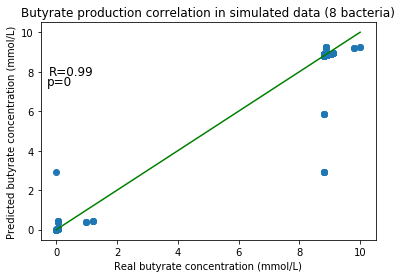

In [30]:
plt.title ('Butyrate production correlation in simulated data (8 bacteria)')  
plt.scatter (x8, y8)  
plt.plot (np.unique(x8), np.poly1d(np.polyfit(x8,y8, 1))(np.unique(x8)), color = 'green')  
plt.xlabel ('Real butyrate concentration (mmol/L)')  
plt.ylabel ('Predicted butyrate concentration (mmol/L)') 
plt.annotate("R=0.99",xy=(2, 9), xycoords='data',
            xytext=(0.5, 8),size=12, va="center", ha="center")
plt.annotate("p=0",xy=(2, 9), xycoords='data',
            xytext=(0.1,7.5),size=12, va="center", ha="center")
plt.savefig("Correlation8bact_S.png", dpi=300,bbox_inches='tight')

# 9 consortia

In [7]:
tr9=pd.read_table(folder + "simulaciones/res_simulations/train_data_simulated/train_9bactS")
tr9

,conc,b1r1,b1r2,b1r3,b1r4,b1r5,b1r6,b1r7,b1r8,b1r9,...,pHG,pHI.1,pIA.1,pIB.1,pIC.1,pID.1,pIE.1,pIF.1,pIG.1,pIH.1
0,8.808535,1,0,1,0,0,1,1,1,0,...,0.763636,0.992508,0.997826,0.973405,0.998870,0.999831,0.998501,0.997740,0.995471,0.997540
1,8.808535,1,0,1,0,0,1,1,1,0,...,0.606476,0.623788,0.901604,0.528617,0.779402,0.994248,0.889697,0.780337,0.675149,0.763636
2,8.808535,1,0,1,0,0,1,1,1,0,...,0.606476,0.997762,0.997826,0.973405,0.998870,0.999831,0.995245,0.998501,0.997740,0.995471
3,8.808535,1,0,1,0,0,1,1,1,0,...,0.675149,0.992508,0.997826,0.973405,0.998870,0.999831,0.995245,0.998501,0.997740,0.997540
4,8.808481,1,0,1,0,0,1,1,1,0,...,0.763636,0.992508,0.997826,0.973405,0.998870,0.999831,0.995245,0.998501,0.995471,0.997540
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
88506,0.000000,0,0,1,0,1,1,0,1,0,...,0.768368,0.997769,0.973405,0.995245,0.995263,0.998702,0.991835,0.998241,0.998501,0.997740
88507,0.000000,0,0,1,0,1,1,0,1,0,...,0.679417,0.623788,0.528617,0.889697,0.967754,0.895122,0.979751,0.727631,0.780337,0.763636
88508,0.000000,0,0,1,0,1,1,0,1,0,...,0.679417,0.997762,0.973405,0.995245,0.995263,0.998702,0.991835,0.998241,0.998501,0.995471
88509,0.000000,0,0,1,0,1,1,0,1,0,...,0.780337,0.992508,0.973405,0.995245,0.995263,0.998702,0.991835,0.998241,0.998501,0.997540


In [8]:

X9 = tr9.iloc [:, 1:298].values
y9 = tr9.iloc[:, 0].values

In [9]:
neigh = KNeighborsRegressor(n_neighbors=3)
neigh.fit(X9, y9)
dump(neigh, 'knn_9bact.joblib') 

['knn_9bact.joblib']

In [10]:
from sklearn.model_selection import LeaveOneOut
loo = LeaveOneOut()
loo.get_n_splits(X9)

88511

In [12]:
for i, (train_index, test_index) in enumerate(loo.split(X9)):
    X9_train, X9_test = X9[train_index], X9[test_index]
 #   print(neigh.predict(X_test))
    print(f"{y9[i]}\t{neigh.predict(X9_test)}")

8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808534703488	[8.80851675]
8.808480845294689	[8.80851675]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808534703488	[8.8085347]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.878219475272079	[8.87821948]
8.808534703488	[8.8085347]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.8084988]
8.878219475272079	[8.87821948]
8.808534703488	[8.80851675]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.80848084529468

8.808534703488	[8.8085347]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808534703488	[8.80852973]
8.808480845294689	[8.80848085]
8.80852473917323	[8.80849548]
8.808480845294689	[8.80848085]
8.808534703488	[8.8085347]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808534703488	[8.8085388]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808480845294689	[8.8414632]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808534703488	[8.8085347]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.8084988]
8.878219475272079	[8.85497327]
8.808534703488	[8.80851675]
8.808480845294689	[8.80848085]
8.808480845294689	[8.8

8.808534703488	[8.8085347]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808534703488	[8.8085347]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808534703488	[8.8085347]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.878273333465401	[8.87827333]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878273333465401	[8.87827333]
8.878273333465401	[8.87827333]
8.878273333465401	[8.87827333]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878273333465401	[8.87827333]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87823411]
8.878219475272079	[8.87821948]
8.878219475272079	[8

8.878219475272079	[8.87823743]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87823743]
8.878273333465401	[8.87825538]
8.878219475272079	[8.87823743]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87823743]
8.878273333465401	[8.87823743]
8.878219475272079	[8.87823743]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878273333465401	[8.87825538]
8.878219475272079	[8.87823743]
8.878219475272079	[8.87823743]
8.878219475272079	[8.87823743]
8.878273333465401	[8.87825538]
8.878273333465401	[8.87825538]
8.878273333465401	[8.87825538]
8.878219475272079	[8.87823743]
8.878219475272079	[8.87823743]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87823743]
8.878273333465401	[8.87823743]
8.878219475272079	[8.87823743]
8.878219475272079	[8.87821948]
8.878219475272079	[8.85497327]
8.878219475272079	[8.87821948]
8.878219

8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808534703488	[8.8085347]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808534703488	[8.80854933]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.8084988]
8.808534703488	[8.80851675]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.878273333465401	[8.87827333]
8.878219475272079	[8.87823743]
8.878219475272079	[8.87823743]
8.878219475272079	[8.87823743]
8.878273333465401	[8.87825538]
8.878273333465401	[8.87825538]
8.878273333465401	[8.87825538]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87823743]
8.878273333465401	[8.87825538]
8.878219475272079	[

8.808480845294689	[8.80848085]
8.907481761003849	[8.84151706]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808534703488	[8.8085347]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808534703488	[8.8085347]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.907427902810529	[8.8414632]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.878273333465401	[8.87827333]
8.878219475272079	[8.8

8.808480845294689	[8.80848085]
8.808534703488	[8.8085347]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808534703488	[8.8085347]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808480845294689	[8.8414632]
8.808534703488	[8.84151706]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.8084

8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878273333465401	[8.87827333]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87823743]
8.878273333465401	[8.87825538]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.808534703488	[8.80851675]
8.808534703488	[8.80851675]
8.808534703488	[8.80851675]
8.808480845294689	[8.80848085]
8.808534703488	[8.8085347]
8.808480845294689	[8.8084988]
8.808480845294689	[8.8084988]
8.808480845294689	[8.8084988]
8.808534703488	[8.80851675]
8.808534703488	[8.80851675]
8.808534703488	[8.80851675]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808534703488	[8.8085347]
8.808480845294689	[8.80848085]
8.8084

8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808480845294689	[8.80848085]
8.808534703488	[8.8085347]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808480845294689	[8.80848085]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808480845294689	[8.80848085]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808480845294689	[8.80848085]
8.808480845294689	[8.8

8.808534703488	[8.8085347]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808534703488	[8.8085347]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808534703488	[8.8085347]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.907427902810529	[8.8414632]
8.808534703488	[8.84151706]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808534703488	[8.8085347]
8.

8.808480845294689	[8.80848085]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808480845294689	[8.80848085]
8.878273333465401	[8.85502712]
8.878273333465401	[8.87827333]
8.878273333465401	[8.87825538]
8.878219475272079	[8.87825538]
8.878273333465401	[8.87823743]
8.878273333465401	[8.87827333]
8.878273333465401	[8.87825538]
8.878273333465401	[8.87825538]
8.878219475272079	[8.87825538]
8.878219475272079	[8.87825538]
8.878219475272079	[8.87823743]
8.878273333465401	[8.87825538]
8.878273333465401	[8.87825538]
8.878273333465401	[8.87823743]
8.878219475272079	[8.87825538]
8.878273333465401	[8.87825538]
8.87821947527

8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808534703488	[8.8085347]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.8084988]
8.878219475272079	[8.83172706]
8.808534703488	[8.80851675]
8.808480845294689	[8.8414632]
8.808480845294689	[8.80848085]
8.808480845294689	[8.8084988]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.878219475272079	[8.87823743]
8.878273333465401	[8.87825538]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.8084988]


8.878273333465401	[8.87827333]
8.878273333465401	[8.87827333]
8.878273333465401	[8.87827333]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878273333465401	[8.87827333]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878273333465401	[8.87827333]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878273333465401	[8.87827333]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878273333465401	[8.87827333]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.808534

8.878273333465401	[8.87827333]
8.878273333465401	[8.87827333]
8.878273333465401	[8.87827333]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878273333465401	[8.87827333]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878273333465401	[8.87827333]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878273333465401	[8.87827333]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878273333465401	[8.87827333]
8.878273333465401	[8.87827333]
8.878273333465401	[8.87827333]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878273333465401	[8.87827333]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878273

8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808534703488	[8.8085347]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.8084988]
8.808534703488	[8.80851675]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808534703488	[8.8085347]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.8084988]
8.808534703488	[8.80851675]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808534703488	[8.8085347]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.8084808

8.808534703488	[8.80851675]
8.808534703488	[8.80851675]
8.808480845294689	[8.80848085]
8.808534703488	[8.8085347]
8.808480845294689	[8.8084988]
8.808480845294689	[8.8084988]
8.808480845294689	[8.8084988]
8.808534703488	[8.80851675]
8.808534703488	[8.80851675]
8.808534703488	[8.80851675]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.8084988]
8.808534703488	[8.80851675]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.8084988]
8.808534703488	[8.80851675]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808534703488	[8.8085347]
8.808480845294689	[8.8084988]
8.808480845294689	[8.8084988]
8.808480845294689	[8.8084988]
8.808534703488	[8.80851675]
8.808534703488	[8.80851675]
8.808534703488	[8.80851675]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80

8.878273333465401	[8.87827333]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878273333465401	[8.87827333]
8.878273333465401	[8.87827333]
8.878273333465401	[8.87827333]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878273333465401	[8.87827333]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878273333465401	[8.87827333]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878273333465401	[8.87827333]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878273333465401	[8.87827333]
8.878273333465401	[8.87827333]
8.878273333465401	[8.87827333]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878273

8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808534703488	[8.8085347]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808534703488	[8.8085347]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808534703488	[8.8085347]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808534703488	[8.8085347]
8.808550641546539	[8.80854002]
8.808534703488	[8.8085347]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808534703488	[8.8085347]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808534703488	[8.8085347]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808

8.808480845294689	[8.8084988]
8.808480845294689	[8.8084988]
8.808534703488	[8.80851675]
8.808534703488	[8.80851675]
8.808534703488	[8.80851675]
8.808480845294689	[8.8084988]
8.808534703488	[8.80851675]
8.808480845294689	[8.8084988]
8.808480845294689	[8.8084988]
8.808480845294689	[8.8084988]
8.808534703488	[8.80851675]
8.808534703488	[8.80851675]
8.808534703488	[8.80851675]
8.808480845294689	[8.8084988]
8.808480845294689	[8.8084988]
8.808480845294689	[8.80848085]
8.808534703488	[8.8085347]
8.808534703488	[8.80851675]
8.808534703488	[8.80851675]
8.808480845294689	[8.80851675]
8.808480845294689	[8.80851675]
8.808480845294689	[8.8084988]
8.808534703488	[8.80851675]
8.808534703488	[8.80851675]
8.808534703488	[8.8084988]
8.808480845294689	[8.8084988]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808480845294689	[8.80848085]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808480845294689	[8.8084

8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878273333465401	[8.87827333]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87823743]
8.878273333465401	[8.87825538]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.808534703488	[8.80851675]
8.808534703488	[8.80851675]
8.808534703488	[8.80851675]
8.808480845294689	[8.80848085]
8.808534703488	[8.8085347]
8.808480845294689	[8.8084988]
8.808480845294689	[8.8084988]
8.808480845294689	[8.8084988]
8.808534703488	[8.80851675]
8.808534703488	[8.80851675]
8.808534703488	[8.80851675]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808534703488	[8.8085347]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.8084

8.808480845294689	[8.80848085]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808480845294689	[8.80848085]
8.808534703488	[8.8085347]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808480845294689	[8.80848085]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808480845294689	[8.80848085]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808480845294689	[8.8084988]
8.808480845294689	[8.8084988]
8.808480845294689	[8.808

8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808534703488	[8.8085347]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808534703488	[8.8085347]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808480845294689	[8.80848085]
8.808534703488	[8.8085347]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808480845294689	[8.80848085]
8.8084

8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480

8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.878252077

8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.95570915]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207

8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.80848084

8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480

8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480

8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480

8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.

8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207

8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207

8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207

8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480

8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480

8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.854995]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.8782520773

8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480

8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.

8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207

8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]

8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480

8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480

8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480

8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.87825207731884	[8.854995]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825

8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480

8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207

8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207

8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207

8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.91123443]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.8

8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.8084808453107

8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480

8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.878

8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87826507]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207

8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207

8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207

0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771

0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[2.32106878e-05]
0.069771232008093	[0.06978309]
0.069771232008093	[0.06978309]
0.069771232008093	[0.06978309]
0.069771232008093	[0.06975988]
0.069771232008093	[0.06978309]
0.069771232008093	[0.06978309]
0.069771232008093	[0.06978309]
0.069771232008093	[0.06978309]
0.069771232008093	[0.06975988]
0.069771232008093	[0.06975988]
0.069771232008093	[0.06975988]
0.069771232008093	[0.06978309]
0.069771232008093	[0.06978309]
0.069771232008093	[0.06978309]
0.069771232008093	[0.06

0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.

0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.04651415]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.069771232008093	[0.06977694]
0.069771232008093	[0.06977694]
0.069771232008093	[0.06977694]
0.069771232008093	[0.06977694]
0.069771232008093	[0.06977694]
0.069771232008093	[0.06977694]
0.069771232008093	[0.06977694]
0.069771232008093	[0.06977694]
0.069771232008093	[0.06977694]
0.069771232008093	[0.06977694]
0.069771232008093	[0.06977694]
0.069771232008093	[0.06977694]
0.069771232008093	[0.06977694]
0.069771232008093	[0.06977694]
0.069771232008093	[0.06977694]
0.069771232

0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771

0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977

0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0

0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.069771232008093	[0.06976652]
0.069771232008093	[0.06976652]
0.069771232008093	[0.06976652]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06976652]
0.069771232008093	[0.06976652]
0.069771232008093	[0.06976652]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06976652]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.06977123200809

0.06984098642157299	[0.06981384]
0.06984098642157299	[0.06981384]
0.069759539530296	[0.06975954]
0.06984098642157299	[0.06984099]
0.069759539530296	[0.06978669]
0.069759539530296	[0.06978669]
0.069759539530296	[0.06978669]
0.06984098642157299	[0.06981384]
0.06984098642157299	[0.06981384]
0.06984098642157299	[0.06981384]
0.069759539530296	[0.06975954]
0.069759539530296	[0.06975954]
0.069759539530296	[0.06975954]
0.06984098642157299	[0.06984099]
0.069759539530296	[0.06975954]
0.069759539530296	[0.06975954]
0.06984098642157299	[0.06984099]
0.069759539530296	[0.06975954]
0.069759539530296	[0.06978669]
0.06984098642157299	[0.06981384]
0.069759539530296	[0.06975954]
0.06984098642157299	[0.06984099]
0.069759539530296	[0.06975954]
0.069759539530296	[0.06975954]
0.069759539530296	[0.06975954]
0.06984098642157299	[0.06984099]
0.06984098642157299	[0.06984099]
0.06984098642157299	[0.06984099]
0.069759539530296	[0.06975954]
0.069759539530296	[0.06975954]
0.069759539530296	[0.06978669]
0.06984098642

8.14468912765884e-05	[8.14468913e-05]
8.14468912765884e-05	[8.14468913e-05]
8.14468912765884e-05	[8.14468913e-05]
0.0	[2.71489638e-05]
0.0	[2.71489638e-05]
0.0	[2.71489638e-05]
8.14468912765884e-05	[5.42979275e-05]
8.14468912765884e-05	[5.42979275e-05]
8.14468912765884e-05	[5.42979275e-05]
0.0	[0.]
8.14468912765884e-05	[8.14468913e-05]
0.0	[2.71489638e-05]
0.0	[2.71489638e-05]
0.0	[2.71489638e-05]
8.14468912765884e-05	[5.42979275e-05]
8.14468912765884e-05	[5.42979275e-05]
8.14468912765884e-05	[5.42979275e-05]
0.0	[0.]
0.0	[0.]
0.0	[2.71489638e-05]
8.14468912765884e-05	[5.42979275e-05]
0.0	[0.]
8.14468912765884e-05	[8.14468913e-05]
0.0	[2.71489638e-05]
0.0	[2.71489638e-05]
0.0	[2.71489638e-05]
8.14468912765884e-05	[5.42979275e-05]
8.14468912765884e-05	[5.42979275e-05]
8.14468912765884e-05	[5.42979275e-05]
0.0	[0.]
0.0	[0.]
8.14468912765884e-05	[8.14468913e-05]
8.14468912765884e-05	[8.14468913e-05]
8.14468912765884e-05	[8.14468913e-05]
0.0	[2.71489638e-05]
0.0	[2.71489638e-05]
0.0	[2.714

8.14468912765884e-05	[5.42979275e-05]
8.14468912765884e-05	[5.42979275e-05]
0.0	[0.]
0.06984098642157299	[0.06984099]
0.06984098642157299	[0.06984099]
0.06984098642157299	[0.06984099]
0.069759539530296	[0.06975954]
0.06984098642157299	[0.06984099]
0.06984098642157299	[0.06984099]
0.06984098642157299	[0.06984099]
0.06984098642157299	[0.06984099]
0.069759539530296	[0.06975954]
0.069759539530296	[0.06975954]
0.069759539530296	[0.06975954]
0.06984098642157299	[0.06984099]
0.06984098642157299	[0.06984099]
0.06984098642157299	[0.06984099]
0.069759539530296	[0.06975954]
0.06984098642157299	[0.06984099]
0.069759539530296	[0.06975954]
0.069759539530296	[0.06975954]
0.069759539530296	[0.06975954]
0.06984098642157299	[0.06984099]
0.06984098642157299	[0.06984099]
0.06984098642157299	[0.06984099]
0.069759539530296	[0.06975954]
0.069759539530296	[0.06975954]
0.069759539530296	[0.06975954]
0.06984098642157299	[0.06984099]
0.069759539530296	[0.06975954]
0.069759539530296	[0.06975954]
0.069840986421572

0.06984098642157299	[0.06984099]
0.06984098642157299	[0.06984099]
0.069759539530296	[0.06975954]
0.069759539530296	[0.06975954]
0.06984098642157299	[0.06984099]
0.06984098642157299	[0.06984099]
0.06984098642157299	[0.06984099]
0.069759539530296	[0.06975954]
0.069759539530296	[0.06975954]
0.069759539530296	[0.06975954]
0.06984098642157299	[0.06984099]
0.06984098642157299	[0.06984099]
0.06984098642157299	[0.06984099]
0.069759539530296	[0.06975954]
0.06984098642157299	[0.06984099]
0.069759539530296	[0.06975954]
0.069759539530296	[0.06975954]
0.069759539530296	[0.06975954]
0.06984098642157299	[0.06984099]
0.06984098642157299	[0.06984099]
0.06984098642157299	[0.06984099]
0.069759539530296	[0.06975954]
0.069759539530296	[0.06975954]
0.069759539530296	[0.06975954]
0.06984098642157299	[0.06984099]
0.069759539530296	[0.06975954]
0.06984098642157299	[0.06984099]
0.069759539530296	[0.06975954]
0.069759539530296	[0.06975954]
0.069759539530296	[0.06975954]
0.06984098642157299	[0.06984099]
0.0698409

0.06984098642157299	[0.06984099]
0.06984098642157299	[0.06984099]
0.069759539530296	[0.06975954]
0.06984098642157299	[0.06984099]
0.06984098642157299	[0.06984099]
0.06984098642157299	[0.06984099]
0.069759539530296	[0.06975954]
0.06984098642157299	[0.06984099]
0.06984098642157299	[0.06984099]
0.06984098642157299	[0.06984099]
0.06984098642157299	[0.06984099]
0.069759539530296	[0.06975954]
0.069759539530296	[0.06975954]
0.069759539530296	[0.06975954]
0.06984098642157299	[0.06984099]
0.06984098642157299	[0.06984099]
0.06984098642157299	[0.06984099]
0.069759539530296	[0.06975954]
0.06984098642157299	[0.06984099]
0.06984098642157299	[0.06984099]
0.06984098642157299	[0.06984099]
0.069759539530296	[0.06975954]
0.06984098642157299	[0.06984099]
8.14468912765884e-05	[8.14468913e-05]
8.14468912765884e-05	[8.14468913e-05]
8.14468912765884e-05	[8.14468913e-05]
8.14468912765884e-05	[8.14468913e-05]
0.0	[0.]
8.14468912765884e-05	[8.14468913e-05]
8.14468912765884e-05	[8.14468913e-05]
8.14468912765884e-

0.0	[0.]
0.06984098642157299	[0.06984099]
0.06984098642157299	[0.06984099]
0.06984098642157299	[0.06984099]
0.069759539530296	[0.06978669]
0.06984098642157299	[0.06981384]
0.06984098642157299	[0.06984099]
0.06984098642157299	[0.06984099]
0.06984098642157299	[0.06984099]
0.069759539530296	[0.06978669]
0.069759539530296	[0.06978669]
0.069759539530296	[0.06978669]
0.06984098642157299	[0.06981384]
0.06984098642157299	[0.06981384]
0.06984098642157299	[0.06981384]
0.069759539530296	[0.06975954]
0.06984098642157299	[0.06984099]
0.069759539530296	[0.06975954]
0.069759539530296	[0.06975954]
0.069759539530296	[0.06975954]
0.06984098642157299	[0.06984099]
0.06984098642157299	[0.06984099]
0.06984098642157299	[0.06984099]
0.069759539530296	[0.06975954]
0.069759539530296	[0.06975954]
0.069759539530296	[0.06978669]
0.06984098642157299	[0.06981384]
0.069759539530296	[0.06975954]
0.069759539530296	[0.06975954]
0.06984098642157299	[0.06984099]
0.069759539530296	[0.06975954]
0.06984098642157299	[0.069840

0.069759539530296	[0.06978669]
0.069759539530296	[0.06978669]
0.069759539530296	[0.06978669]
0.06984098642157299	[0.06981384]
0.06984098642157299	[0.06981384]
0.06984098642157299	[0.06981384]
0.069759539530296	[0.06975954]
0.069759539530296	[0.06975954]
0.06984098642157299	[0.06984099]
0.06984098642157299	[0.06984099]
0.06984098642157299	[0.06984099]
0.069759539530296	[0.06975954]
0.069759539530296	[0.06975954]
0.069759539530296	[0.06975954]
0.06984098642157299	[0.06984099]
0.06984098642157299	[0.06984099]
0.06984098642157299	[0.06984099]
0.069759539530296	[0.06975954]
0.06984098642157299	[0.06984099]
0.069759539530296	[0.06978669]
0.069759539530296	[0.06978669]
0.069759539530296	[0.06978669]
0.06984098642157299	[0.06981384]
0.06984098642157299	[0.06981384]
0.06984098642157299	[0.06981384]
0.069759539530296	[0.06975954]
0.069759539530296	[0.06975954]
0.069759539530296	[0.06978669]
0.06984098642157299	[0.06981384]
0.069759539530296	[0.06975954]
0.06984098642157299	[0.06984099]
0.0697595

0.06984098642157299	[0.06981384]
0.069759539530296	[0.06975954]
0.069759539530296	[0.06975954]
0.06984098642157299	[0.06984099]
0.06984098642157299	[0.06984099]
0.06984098642157299	[0.06984099]
0.069759539530296	[0.06978669]
0.069759539530296	[0.06978669]
0.069759539530296	[0.06978669]
0.06984098642157299	[0.06981384]
0.06984098642157299	[0.06981384]
0.06984098642157299	[0.06981384]
0.069759539530296	[0.06975954]
0.06984098642157299	[0.06984099]
0.06984098642157299	[0.06984099]
0.06984098642157299	[0.06984099]
0.069759539530296	[0.06978669]
0.06984098642157299	[0.06981384]
0.06984098642157299	[0.06984099]
0.06984098642157299	[0.06984099]
0.06984098642157299	[0.06984099]
0.069759539530296	[0.06978669]
0.069759539530296	[0.06978669]
0.069759539530296	[0.06978669]
0.06984098642157299	[0.06981384]
0.06984098642157299	[0.06981384]
0.06984098642157299	[0.06981384]
0.069759539530296	[0.06975954]
0.06984098642157299	[0.06984099]
0.06984098642157299	[0.06984099]
0.06984098642157299	[0.06984099]

8.14468912765884e-05	[8.14468913e-05]
0.0	[0.]
0.0	[0.]
0.0	[0.]
8.14468912765884e-05	[8.14468913e-05]
8.14468912765884e-05	[8.14468913e-05]
8.14468912765884e-05	[8.14468913e-05]
0.0	[0.]
8.14468912765884e-05	[8.14468913e-05]
0.0	[0.]
0.0	[0.]
0.0	[0.]
8.14468912765884e-05	[8.14468913e-05]
8.14468912765884e-05	[8.14468913e-05]
8.14468912765884e-05	[8.14468913e-05]
0.0	[0.]
0.0	[0.]
8.14468912765884e-05	[8.14468913e-05]
8.14468912765884e-05	[8.14468913e-05]
8.14468912765884e-05	[8.14468913e-05]
0.0	[0.]
0.0	[0.]
0.0	[0.]
8.14468912765884e-05	[8.14468913e-05]
8.14468912765884e-05	[8.14468913e-05]
8.14468912765884e-05	[8.14468913e-05]
0.0	[0.]
8.14468912765884e-05	[8.14468913e-05]
8.14468912765884e-05	[8.14468913e-05]
8.14468912765884e-05	[8.14468913e-05]
0.0	[0.]
8.14468912765884e-05	[8.14468913e-05]
8.14468912765884e-05	[8.14468913e-05]
8.14468912765884e-05	[8.14468913e-05]
8.14468912765884e-05	[8.14468913e-05]
0.0	[0.]
0.0	[0.]
0.0	[0.]
8.14468912765884e-05	[8.14468913e-05]
8.144689127

8.14468912765884e-05	[8.14468913e-05]
0.0	[0.]
8.14468912765884e-05	[8.14468913e-05]
8.14468912765884e-05	[8.14468913e-05]
0.06984098642157299	[0.06984099]
0.06984098642157299	[0.06984099]
0.06984098642157299	[0.06984099]
0.06984098642157299	[0.06984099]
0.069759539530296	[0.06975954]
0.06984098642157299	[0.06984099]
0.06984098642157299	[0.06984099]
0.06984098642157299	[0.06984099]
0.06984098642157299	[0.06984099]
0.069759539530296	[0.06975954]
0.069759539530296	[0.06975954]
0.069759539530296	[0.06975954]
0.06984098642157299	[0.06984099]
0.06984098642157299	[0.06984099]
0.06984098642157299	[0.06984099]
0.069759539530296	[0.06975954]
0.06984098642157299	[0.06984099]
0.069759539530296	[0.06975954]
0.069759539530296	[0.06975954]
0.069759539530296	[0.06975954]
0.06984098642157299	[0.06984099]
0.06984098642157299	[0.06984099]
0.06984098642157299	[0.06984099]
0.069759539530296	[0.06975954]
0.069759539530296	[0.06975954]
0.069759539530296	[0.06975954]
0.06984098642157299	[0.06984099]
0.069759

0.06984098642157299	[0.06981773]
0.06984098642157299	[0.06981384]
0.069759539530296	[0.06981384]
0.06984098642157299	[0.06979059]
0.06984098642157299	[0.06981773]
0.06984098642157299	[0.06981384]
0.06984098642157299	[0.06979059]
0.069759539530296	[0.06981384]
0.069759539530296	[0.06981384]
0.069759539530296	[0.06978669]
0.06984098642157299	[0.06979059]
0.06984098642157299	[0.06981384]
0.06984098642157299	[0.06978669]
0.069759539530296	[0.06979059]
0.06984098642157299	[0.06981773]
0.06984098642157299	[0.06984099]
0.06984098642157299	[0.06981384]
0.069759539530296	[0.06978669]
0.06984098642157299	[0.06981384]
0.06984098642157299	[0.06981773]
0.06984098642157299	[0.06981773]
0.06984098642157299	[0.06984099]
0.06984098642157299	[0.06981384]
0.069759539530296	[0.06978669]
0.06984098642157299	[0.06981384]
0.06984098642157299	[0.04656456]
8.14468912765884e-05	[8.14468913e-05]
8.14468912765884e-05	[5.42979275e-05]
8.14468912765884e-05	[8.14468913e-05]
8.14468912765884e-05	[5.42979275e-05]
0.0	

8.14468912765884e-05	[5.03596515e-05]
8.14468912765884e-05	[5.03596515e-05]
0.0	[0.]
0.0	[0.]
0.0	[2.71489638e-05]
8.14468912765884e-05	[5.03596515e-05]
0.0	[0.]
8.14468912765884e-05	[7.75086153e-05]
0.0	[0.]
0.0	[0.]
0.0	[0.]
8.14468912765884e-05	[7.75086153e-05]
8.14468912765884e-05	[7.75086153e-05]
8.14468912765884e-05	[7.75086153e-05]
0.0	[0.]
0.0	[0.]
8.14468912765884e-05	[7.75086153e-05]
8.14468912765884e-05	[0.00105261]
8.14468912765884e-05	[7.75086153e-05]
0.0	[0.]
0.0	[0.]
0.0	[0.]
8.14468912765884e-05	[7.75086153e-05]
8.14468912765884e-05	[7.75086153e-05]
8.14468912765884e-05	[7.75086153e-05]
0.0	[0.]
8.14468912765884e-05	[7.75086153e-05]
0.0	[0.]
0.0	[0.]
0.0	[0.]
8.14468912765884e-05	[7.75086153e-05]
8.14468912765884e-05	[7.75086153e-05]
8.14468912765884e-05	[7.75086153e-05]
0.0	[0.]
0.0	[0.]
8.14468912765884e-05	[7.35703393e-05]
8.14468912765884e-05	[7.35703393e-05]
8.14468912765884e-05	[7.35703393e-05]
0.0	[0.]
0.0	[0.]
0.0	[0.]
8.14468912765884e-05	[7.35703393e-05]
8.144

8.808480845373461	[8.80848085]
8.80856229226474	[8.80856229]
8.80856229226474	[8.80856229]
8.80856229226474	[8.80856229]
8.80856229226474	[8.80856229]
8.808480845373461	[8.80848085]
8.808480845373461	[8.80848085]
8.808480845373461	[8.80848085]
8.80856229226474	[8.80856229]
8.80856229226474	[8.80856229]
8.80856229226474	[8.80856229]
8.808480845373461	[8.80848085]
8.80856229226474	[8.80856229]
8.808480845373461	[8.80848085]
8.808480845373461	[8.80848085]
8.808480845373461	[8.80848085]
8.80856229226474	[8.80856229]
8.80856229226474	[8.80856229]
8.80856229226474	[8.80856229]
8.808480845373461	[8.80848085]
8.808480845373461	[8.80848085]
8.808480845373461	[8.80848085]
8.808480845373461	[8.80848085]
8.80856229226474	[8.80856229]
8.808480845373461	[8.80848085]
8.808480845373461	[8.80848085]
8.808480845373461	[8.80848085]
8.80856229226474	[8.80856229]
8.808480845373461	[8.80848085]
8.808480845373461	[8.80848085]
8.808480845373461	[8.80848085]
8.80856229226474	[8.80856229]
8.80856229226474	[8.80

8.808480845373461	[8.80848085]
8.808480845373461	[8.80848085]
8.80856229226474	[8.80856229]
8.80856229226474	[8.80856229]
8.80856229226474	[8.80856229]
8.808480845373461	[8.80848085]
8.808480845373461	[8.80848085]
8.808480845373461	[8.80848085]
8.80856229226474	[8.80856229]
8.80856229226474	[8.80856229]
8.80856229226474	[8.80856229]
8.808480845373461	[8.80848085]
8.80856229226474	[8.80856229]
8.80856229226474	[8.80856229]
8.80856229226474	[8.80856229]
8.808480845373461	[8.80848085]
8.80856229226474	[8.80856229]
8.80856229226474	[8.80856229]
8.80856229226474	[8.80856229]
8.80856229226474	[8.80856229]
8.808480845373461	[8.80848085]
8.808480845373461	[8.80848085]
8.808480845373461	[8.80848085]
8.80856229226474	[8.80856229]
8.80856229226474	[8.80856229]
8.80856229226474	[8.80856229]
8.808480845373461	[8.80848085]
8.80856229226474	[8.80856229]
8.80856229226474	[8.80856229]
8.80856229226474	[8.80856229]
8.808480845373461	[8.80848085]
8.80856229226474	[8.80856229]
8.80856229226474	[8.80856229

8.87832183179508	[8.87832183]
8.87832183179508	[8.87832183]
8.87824038490377	[8.87826753]
8.87832183179508	[8.87829468]
8.87832183179508	[8.87832183]
8.87832183179508	[8.87832183]
8.87832183179508	[8.87832183]
8.87824038490377	[8.87826753]
8.87824038490377	[8.87826753]
8.87824038490377	[8.87826753]
8.87832183179508	[8.87829468]
8.87832183179508	[8.87829468]
8.87832183179508	[8.87829468]
8.87824038490377	[8.87824038]
8.87832183179508	[8.87832183]
8.87824038490377	[8.87824038]
8.87824038490377	[8.87824038]
8.87824038490377	[8.87824038]
8.87832183179508	[8.87832183]
8.87832183179508	[8.87832183]
8.87832183179508	[8.87832183]
8.87824038490377	[8.87824038]
8.87824038490377	[8.87824038]
8.87824038490377	[8.87824038]
8.87824038490377	[8.87826753]
8.87832183179508	[8.87829468]
8.87824038490377	[8.87824038]
8.87824038490377	[8.87824038]
8.87824038490377	[8.87824038]
8.87824038490377	[8.87824038]
8.87824038490377	[8.87824038]
8.87832183179508	[8.87832183]
8.87824038490377	[8.87824038]
8.87824038

8.87832183179508	[8.87832183]
8.87824038490377	[8.87824038]
8.87824038490377	[8.87824038]
8.87824038490377	[8.87824038]
8.87824038490377	[8.87826753]
8.87832183179508	[8.87829468]
8.87824038490377	[8.87824038]
8.87824038490377	[8.87824038]
8.87824038490377	[8.87824038]
8.87824038490377	[8.87824038]
8.87824038490377	[8.87824038]
8.87832183179508	[8.87832183]
8.87824038490377	[8.87824038]
8.87824038490377	[8.87824038]
8.87824038490377	[8.87824038]
8.87832183179508	[8.87832183]
8.87824038490377	[8.87824038]
8.87824038490377	[8.87824038]
8.87824038490377	[8.87824038]
8.87832183179508	[8.87832183]
8.87832183179508	[8.87832183]
8.87832183179508	[8.87832183]
8.87824038490377	[8.87824038]
8.87824038490377	[8.87824038]
8.87824038490377	[8.87824038]
8.87824038490377	[8.87824038]
8.87832183179508	[8.87832183]
8.87824038490377	[8.87824038]
8.87824038490377	[8.87824038]
8.87824038490377	[8.87824038]
8.87832183179508	[8.87832183]
8.87824038490377	[8.87826753]
8.87824038490377	[8.87826753]
8.87824038

8.87832183179508	[8.87832183]
8.87824038490377	[8.87826753]
8.87824038490377	[8.87826753]
8.87824038490377	[8.87826753]
8.87832183179508	[8.87829468]
8.87832183179508	[8.87829468]
8.87832183179508	[8.87829468]
8.87824038490377	[8.87824038]
8.87832183179508	[8.87832183]
8.87824038490377	[8.87826753]
8.87824038490377	[8.87826753]
8.87824038490377	[8.87826753]
8.87832183179508	[8.87829468]
8.87832183179508	[8.87829468]
8.87832183179508	[8.87829468]
8.87824038490377	[8.87824038]
8.87824038490377	[8.87824038]
8.87824038490377	[8.87824038]
8.87832183179508	[8.87832183]
8.87832183179508	[8.87832183]
8.87832183179508	[8.87832183]
8.87824038490377	[8.87826753]
8.87824038490377	[8.87826753]
8.87824038490377	[8.87826753]
8.87832183179508	[8.87829468]
8.87832183179508	[8.87829468]
8.87832183179508	[8.87829468]
8.87824038490377	[8.87824038]
8.87832183179508	[8.87832183]
8.87832183179508	[8.87832183]
8.87832183179508	[8.87832183]
8.87824038490377	[8.87826753]
8.87832183179508	[8.87829468]
8.87832183

8.87832183179508	[8.87832183]
8.87824038490377	[8.87824038]
8.87824038490377	[8.87824038]
8.87824038490377	[8.87824038]
8.87832183179508	[8.87832183]
8.87832183179508	[8.87832183]
8.87832183179508	[8.87832183]
8.87824038490377	[8.87824038]
8.87824038490377	[8.87824038]
8.87824038490377	[8.87824038]
8.87832183179508	[8.87832183]
8.87832183179508	[8.87832183]
8.87832183179508	[8.87832183]
8.87824038490377	[8.87824038]
8.87824038490377	[8.87824038]
8.87824038490377	[8.87824038]
8.87832183179508	[8.87832183]
8.87832183179508	[8.87832183]
8.87832183179508	[8.87832183]
8.87824038490377	[8.87824038]
8.80856229226474	[8.80856229]
8.80856229226474	[8.80856229]
8.80856229226474	[8.80856229]
8.808480845373461	[8.80848085]
8.80856229226474	[8.80856229]
8.80856229226474	[8.80856229]
8.80856229226474	[8.80856229]
8.80856229226474	[8.80856229]
8.808480845373461	[8.80848085]
8.808480845373461	[8.80848085]
8.808480845373461	[8.80848085]
8.80856229226474	[8.80856229]
8.80856229226474	[8.80856229]
8.8085

8.80856229226474	[8.80856229]
8.80856229226474	[8.80856229]
8.808480845373461	[8.80848085]
8.80856229226474	[8.80856229]
8.80856229226474	[8.80856229]
8.80856229226474	[8.80856229]
8.80856229226474	[8.80856229]
8.808480845373461	[8.80848085]
8.808480845373461	[8.80848085]
8.808480845373461	[8.80848085]
8.80856229226474	[8.80856229]
8.80856229226474	[8.80856229]
8.80856229226474	[8.80856229]
8.808480845373461	[8.80848085]
8.80856229226474	[8.80856229]
8.808480845373461	[8.80848085]
8.808480845373461	[8.80848085]
8.808480845373461	[8.80848085]
8.80856229226474	[8.80856229]
8.80856229226474	[8.80856229]
8.80856229226474	[8.80856229]
8.808480845373461	[8.80848085]
8.808480845373461	[8.80848085]
8.808480845373461	[8.80848085]
8.80856229226474	[8.80856229]
8.80856229226474	[8.80856229]
8.80856229226474	[8.80856229]
8.808480845373461	[8.80848085]
8.808480845373461	[8.80848085]
8.808480845373461	[8.80848085]
8.80856229226474	[8.80856229]
8.80856229226474	[8.80856229]
8.80856229226474	[8.808562

8.80856229226474	[8.80856229]
8.808480845373461	[8.80848085]
8.808480845373461	[8.80848085]
8.808480845373461	[8.80848085]
8.80856229226474	[8.80856229]
8.80856229226474	[8.80856229]
8.80856229226474	[8.80856229]
8.808480845373461	[8.80848085]
8.80856229226474	[8.80856229]
8.80856229226474	[8.80856229]
8.80856229226474	[8.80856229]
8.808480845373461	[8.80848085]
8.80856229226474	[8.80856229]
8.80856229226474	[8.80856229]
8.80856229226474	[8.80856229]
8.80856229226474	[8.80856229]
8.80856229226474	[8.80856229]
8.808480845373461	[8.80848085]
8.80856229226474	[8.80856229]
8.80856229226474	[8.80856229]
8.87832183179508	[8.83181547]
8.87832183179508	[8.85506865]
8.87832183179508	[8.87832183]
8.87832183179508	[8.87829468]
8.87824038490377	[8.87826753]
8.87832183179508	[8.87829468]
8.87832183179508	[8.85506865]
8.87832183179508	[8.87829468]
8.87832183179508	[8.8550415]
8.87824038490377	[8.87829468]
8.87824038490377	[8.87829468]
8.87824038490377	[8.87826753]
8.87832183179508	[8.8550415]
8.8783

8.14468912765884e-05	[5.42979275e-05]
8.14468912765884e-05	[5.42979275e-05]
0.0	[0.]
0.0	[0.]
0.0	[0.]
8.14468912765884e-05	[8.14468913e-05]
0.0	[0.]
0.0	[0.]
8.14468912765884e-05	[8.14468913e-05]
0.0	[0.]
0.0	[2.71489638e-05]
8.14468912765884e-05	[5.42979275e-05]
0.0	[0.]
8.14468912765884e-05	[8.14468913e-05]
0.0	[0.]
0.0	[0.]
0.0	[0.]
8.14468912765884e-05	[8.14468913e-05]
8.14468912765884e-05	[8.14468913e-05]
8.14468912765884e-05	[8.14468913e-05]
0.0	[0.]
0.0	[0.]
0.0	[2.71489638e-05]
8.14468912765884e-05	[5.42979275e-05]
0.0	[0.]
0.0	[0.]
8.14468912765884e-05	[8.14468913e-05]
0.0	[0.]
8.14468912765884e-05	[8.14468913e-05]
0.0	[0.]
0.0	[0.]
0.0	[0.]
8.14468912765884e-05	[8.14468913e-05]
8.14468912765884e-05	[8.14468913e-05]
8.14468912765884e-05	[8.14468913e-05]
0.0	[0.]
0.0	[0.]
0.0	[0.]
8.14468912765884e-05	[8.14468913e-05]
0.0	[0.]
8.14468912765884e-05	[8.14468913e-05]
0.0	[2.71489638e-05]
0.0	[2.71489638e-05]
0.0	[2.71489638e-05]
8.14468912765884e-05	[5.42979275e-05]
8.14468912765

0.0	[0.]
0.0	[0.]
0.06984098642157299	[0.06984099]
0.06984098642157299	[0.06984099]
0.06984098642157299	[0.06984099]
0.069759539530296	[0.06975954]
0.069759539530296	[0.06975954]
0.069759539530296	[0.06975954]
0.06984098642157299	[0.06984099]
0.06984098642157299	[0.06984099]
0.06984098642157299	[0.06984099]
0.069759539530296	[0.06975954]
0.06984098642157299	[0.06984099]
0.069759539530296	[0.06975954]
0.069759539530296	[0.06975954]
0.069759539530296	[0.06975954]
0.06984098642157299	[0.06984099]
0.06984098642157299	[0.06984099]
0.06984098642157299	[0.06984099]
0.069759539530296	[0.06975954]
0.069759539530296	[0.06975954]
0.069759539530296	[0.06975954]
0.06984098642157299	[0.06984099]
0.069759539530296	[0.06975954]
0.069759539530296	[0.06975954]
0.06984098642157299	[0.06984099]
0.069759539530296	[0.06975954]
0.069759539530296	[0.06975954]
0.06984098642157299	[0.06984099]
0.069759539530296	[0.06975954]
0.06984098642157299	[0.06984099]
0.069759539530296	[0.06975954]
0.069759539530296	[0.069

0.0	[0.]
8.14468912765884e-05	[8.14468913e-05]
0.0	[0.]
8.14468912765884e-05	[8.14468913e-05]
0.0	[0.]
0.0	[0.]
0.0	[0.]
8.14468912765884e-05	[8.14468913e-05]
8.14468912765884e-05	[8.14468913e-05]
8.14468912765884e-05	[8.14468913e-05]
0.0	[0.]
0.0	[0.]
8.14468912765884e-05	[8.14468913e-05]
8.14468912765884e-05	[8.14468913e-05]
8.14468912765884e-05	[8.14468913e-05]
0.0	[0.]
0.0	[0.]
0.0	[0.]
8.14468912765884e-05	[8.14468913e-05]
8.14468912765884e-05	[8.14468913e-05]
8.14468912765884e-05	[8.14468913e-05]
0.0	[0.]
8.14468912765884e-05	[8.14468913e-05]
0.0	[0.]
0.0	[0.]
0.0	[0.]
8.14468912765884e-05	[8.14468913e-05]
8.14468912765884e-05	[8.14468913e-05]
8.14468912765884e-05	[8.14468913e-05]
0.0	[0.]
0.0	[0.]
8.14468912765884e-05	[8.14468913e-05]
8.14468912765884e-05	[8.14468913e-05]
8.14468912765884e-05	[8.14468913e-05]
0.0	[0.]
0.0	[0.]
0.0	[0.]
8.14468912765884e-05	[8.14468913e-05]
8.14468912765884e-05	[8.14468913e-05]
8.14468912765884e-05	[8.14468913e-05]
0.0	[0.]
0.06984098642157299	[0

0.069759539530296	[0.06975954]
0.069759539530296	[0.06978669]
0.06984098642157299	[0.06981384]
0.069759539530296	[0.06975954]
0.069759539530296	[0.06978669]
0.06984098642157299	[0.06981384]
0.069759539530296	[0.06975954]
0.069759539530296	[0.06978669]
0.06984098642157299	[0.06981384]
0.069759539530296	[0.06975954]
0.069759539530296	[0.06978669]
0.06984098642157299	[0.06981384]
0.069759539530296	[0.06975954]
8.14468912765884e-05	[5.42979275e-05]
8.14468912765884e-05	[5.42979275e-05]
8.14468912765884e-05	[5.42979275e-05]
0.0	[0.]
8.14468912765884e-05	[5.42979275e-05]
0.0	[2.71489638e-05]
0.0	[2.71489638e-05]
0.0	[2.71489638e-05]
8.14468912765884e-05	[5.42979275e-05]
8.14468912765884e-05	[5.42979275e-05]
8.14468912765884e-05	[5.42979275e-05]
0.0	[2.71489638e-05]
0.0	[0.]
0.0	[2.71489638e-05]
8.14468912765884e-05	[5.42979275e-05]
0.0	[0.]
0.0	[2.71489638e-05]
8.14468912765884e-05	[5.42979275e-05]
0.0	[0.]
0.0	[2.71489638e-05]
8.14468912765884e-05	[5.42979275e-05]
0.0	[0.]
8.14468912765884e

0.06984098642157299	[0.06984099]
0.06984098642157299	[0.06984099]
0.069759539530296	[0.06975954]
0.069759539530296	[0.06975954]
0.069759539530296	[0.06975954]
0.06984098642157299	[0.06984099]
0.069759539530296	[0.06975954]
0.06984098642157299	[0.06984099]
0.069759539530296	[0.06978669]
0.069759539530296	[0.06978669]
0.069759539530296	[0.06978669]
0.06984098642157299	[0.06981384]
0.06984098642157299	[0.06981384]
0.06984098642157299	[0.06981384]
0.069759539530296	[0.06975954]
0.069759539530296	[0.06975954]
8.14468912765884e-05	[5.42979275e-05]
8.14468912765884e-05	[8.14468913e-05]
8.14468912765884e-05	[8.14468913e-05]
8.14468912765884e-05	[8.14468913e-05]
0.0	[2.71489638e-05]
0.0	[2.71489638e-05]
0.0	[2.71489638e-05]
8.14468912765884e-05	[5.42979275e-05]
8.14468912765884e-05	[5.42979275e-05]
8.14468912765884e-05	[5.42979275e-05]
0.0	[0.]
8.14468912765884e-05	[8.14468913e-05]
0.0	[0.]
0.0	[0.]
0.0	[0.]
8.14468912765884e-05	[8.14468913e-05]
8.14468912765884e-05	[8.14468913e-05]
8.144689127

0.0	[0.]
8.14468912765884e-05	[8.14468913e-05]
8.14468912765884e-05	[8.14468913e-05]
8.14468912765884e-05	[8.14468913e-05]
0.0	[2.71489638e-05]
0.0	[2.71489638e-05]
0.0	[2.71489638e-05]
8.14468912765884e-05	[5.42979275e-05]
8.14468912765884e-05	[5.42979275e-05]
8.14468912765884e-05	[5.42979275e-05]
0.0	[0.]
8.14468912765884e-05	[8.14468913e-05]
8.14468912765884e-05	[8.14468913e-05]
8.14468912765884e-05	[8.14468913e-05]
0.0	[0.]
8.14468912765884e-05	[8.14468913e-05]
8.14468912765884e-05	[8.14468913e-05]
8.14468912765884e-05	[8.14468913e-05]
8.14468912765884e-05	[8.14468913e-05]
0.0	[0.]
0.0	[0.]
0.0	[2.71489638e-05]
8.14468912765884e-05	[8.14468913e-05]
8.14468912765884e-05	[8.14468913e-05]
8.14468912765884e-05	[5.42979275e-05]
0.0	[0.]
8.14468912765884e-05	[8.14468913e-05]
0.0	[0.]
0.0	[2.71489638e-05]
0.0	[0.]
8.14468912765884e-05	[8.14468913e-05]
8.14468912765884e-05	[5.42979275e-05]
8.14468912765884e-05	[8.14468913e-05]
0.0	[0.]
0.0	[0.]
8.14468912765884e-05	[8.14468913e-05]
8.14468

0.069759539530296	[0.06975954]
0.069759539530296	[0.06975954]
0.069759539530296	[0.06975954]
0.06984098642157299	[0.06984099]
0.06984098642157299	[0.06984099]
0.06984098642157299	[0.06984099]
0.069759539530296	[0.06975954]
0.06984098642157299	[0.06984099]
0.069759539530296	[0.06975954]
0.069759539530296	[0.06975954]
0.069759539530296	[0.06975954]
0.06984098642157299	[0.06984099]
0.06984098642157299	[0.06984099]
0.06984098642157299	[0.06984099]
0.069759539530296	[0.06975954]
0.069759539530296	[0.06975954]
0.069759539530296	[0.06975954]
0.06984098642157299	[0.06984099]
0.069759539530296	[0.06975954]
0.06984098642157299	[0.06984099]
0.069759539530296	[0.06975954]
0.069759539530296	[0.06975954]
0.069759539530296	[0.06975954]
0.06984098642157299	[0.06984099]
0.06984098642157299	[0.06984099]
0.06984098642157299	[0.06984099]
0.069759539530296	[0.06975954]
0.069759539530296	[0.06975954]
0.06984098642157299	[0.06984099]
0.06984098642157299	[0.06984099]
0.06984098642157299	[0.06984099]
0.0697595

0.069759539530296	[0.06975954]
0.069759539530296	[0.06975954]
0.069759539530296	[0.06975954]
0.06984098642157299	[0.06984099]
0.06984098642157299	[0.06984099]
0.06984098642157299	[0.06984099]
0.069759539530296	[0.06975954]
8.14468912765884e-05	[8.14468913e-05]
8.14468912765884e-05	[8.14468913e-05]
8.14468912765884e-05	[8.14468913e-05]
0.0	[0.]
8.14468912765884e-05	[8.14468913e-05]
8.14468912765884e-05	[8.14468913e-05]
8.14468912765884e-05	[8.14468913e-05]
8.14468912765884e-05	[8.14468913e-05]
0.0	[0.]
0.0	[0.]
0.0	[0.]
8.14468912765884e-05	[8.14468913e-05]
8.14468912765884e-05	[8.14468913e-05]
8.14468912765884e-05	[8.14468913e-05]
0.0	[0.]
8.14468912765884e-05	[8.14468913e-05]
0.0	[0.]
0.0	[0.]
0.0	[0.]
8.14468912765884e-05	[8.14468913e-05]
8.14468912765884e-05	[8.14468913e-05]
8.14468912765884e-05	[8.14468913e-05]
0.0	[0.]
0.0	[0.]
0.0	[0.]
8.14468912765884e-05	[8.14468913e-05]
0.0	[0.]
8.14468912765884e-05	[8.14468913e-05]
0.0	[0.]
0.0	[0.]
0.0	[0.]
8.14468912765884e-05	[8.14468913e-

8.14468912765884e-05	[8.14468913e-05]
8.14468912765884e-05	[5.42979275e-05]
0.0	[2.71489638e-05]
8.14468912765884e-05	[5.42979275e-05]
8.14468912765884e-05	[8.14468913e-05]
8.14468912765884e-05	[5.42979275e-05]
8.14468912765884e-05	[5.42979275e-05]
0.0	[2.71489638e-05]
0.0	[2.71489638e-05]
0.0	[2.71489638e-05]
8.14468912765884e-05	[5.42979275e-05]
8.14468912765884e-05	[5.42979275e-05]
8.14468912765884e-05	[5.42979275e-05]
0.0	[2.71489638e-05]
8.14468912765884e-05	[8.14468913e-05]
8.14468912765884e-05	[8.14468913e-05]
8.14468912765884e-05	[5.42979275e-05]
0.0	[5.42979275e-05]
8.14468912765884e-05	[5.42979275e-05]
8.14468912765884e-05	[8.14468913e-05]
8.14468912765884e-05	[8.14468913e-05]
8.14468912765884e-05	[8.14468913e-05]
8.14468912765884e-05	[8.14468913e-05]
0.0	[0.]
8.14468912765884e-05	[8.14468913e-05]
8.14468912765884e-05	[8.14468913e-05]
8.14468912765884e-05	[8.14468913e-05]
8.14468912765884e-05	[8.14468913e-05]
0.0	[0.]
0.0	[0.]
0.0	[0.]
8.14468912765884e-05	[8.14468913e-05]
8.

0.0	[0.]
0.0	[0.]
8.14468912765884e-05	[8.14468913e-05]
8.14468912765884e-05	[8.14468913e-05]
8.14468912765884e-05	[8.14468913e-05]
0.0	[0.]
0.0	[0.]
8.14468912765884e-05	[8.14468913e-05]
8.14468912765884e-05	[8.14468913e-05]
8.14468912765884e-05	[8.14468913e-05]
0.0	[0.]
0.0	[0.]
0.0	[0.]
8.14468912765884e-05	[8.14468913e-05]
8.14468912765884e-05	[8.14468913e-05]
8.14468912765884e-05	[8.14468913e-05]
0.0	[0.]
8.14468912765884e-05	[8.14468913e-05]
8.14468912765884e-05	[8.14468913e-05]
8.14468912765884e-05	[8.14468913e-05]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80

8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.06973849

0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.06973849

0.069738493931625	[0.0697509]
0.069738493931625	[0.0697509]
0.069738493931625	[0.0697509]
0.069738493931625	[0.0697509]
0.069738493931625	[0.0697509]
0.069738493931625	[0.0697509]
0.069738493931625	[0.0697509]
0.069738493931625	[0.0697509]
0.069738493931625	[0.0697509]
0.069738493931625	[0.0697509]
0.069738493931625	[0.0697509]
0.069738493931625	[0.0697509]
0.069738493931625	[0.0697509]
0.069738493931625	[0.0697509]
0.069738493931625	[0.0697509]
0.069738493931625	[0.0697509]
0.069738493931625	[0.0697509]
0.069738493931625	[0.0697509]
0.069738493931625	[0.0697509]
0.069738493931625	[0.0697509]
0.069738493931625	[0.0697509]
0.069738493931625	[0.0697509]
0.069738493931625	[0.0697509]
0.069738493931625	[0.0697509]
0.069738493931625	[0.0697509]
0.069738493931625	[0.0697509]
0.069738493931625	[0.0697509]
0.069738493931625	[0.0697509]
0.069738493931625	[0.0697509]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
8.80848084533292	[8.80848085]
8.80848084533292	[8

8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.8084

8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219

8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.808480845332

8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219

8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8

8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219

8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848

8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084

8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084

8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.808480845

8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084

8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084

8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.878219339264518	[8.87821934]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]

8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084

8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084533292	[8.80848085]
8.80848084

0.06980925145262401	[0.06980925]
0.072239450575767	[0.07223945]
0.072239450575767	[0.07223945]
0.072239450575767	[0.07223945]
0.06980925145262401	[0.06980925]
0.069853145345888	[0.06982388]
0.072239450575767	[0.07223945]
0.072239450575767	[0.07223945]
0.072239450575767	[0.07223945]
0.06980925145262401	[0.06980925]
0.06980925145262401	[0.06980925]
0.06980925145262401	[0.06980925]
0.072239450575767	[0.07223945]
0.072239450575767	[0.07223945]
0.072239450575767	[0.07223945]
0.06980925145262401	[0.06980925]
0.072239450575767	[0.07223945]
0.06980925145262401	[0.06980925]
0.06980925145262401	[0.06980925]
0.06980925145262401	[0.06980925]
0.072239450575767	[0.07223945]
0.072239450575767	[0.07223945]
0.072239450575767	[0.07223945]
0.06980925145262401	[0.06980925]
0.06980925145262401	[0.06982388]
0.072239450575767	[0.07223945]
0.072239450575767	[0.07223945]
0.072239450575767	[0.07223945]
8.87830350878698	[8.87823544]
8.87830350878698	[8.87823544]
8.87830350878698	[8.87823544]
8.87830350878698	[8.

8.87830350878698	[8.87826948]
8.87830350878698	[8.87826948]
8.87830350878698	[8.87826948]
8.87830350878698	[8.87826948]
8.87830350878698	[8.87826948]
8.87830350878698	[8.87826948]
8.87830350878698	[8.87826948]
8.87830350878698	[8.87826948]
8.87830350878698	[8.87826948]
8.87830350878698	[8.87826948]
8.87830350878698	[8.87826948]
8.87830350878698	[8.87826948]
8.87830350878698	[8.87826948]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80852473923538	[8.80849548]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084

8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084

8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350

8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
9.04085205

8.80848084533865	[8.8414632]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
9.04085205789165	[8.88593792]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.808480845

8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80849548]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084

8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084

8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084

8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.8414632]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.878303508

8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350

8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
9.11067472133999	[8.95576058]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350

8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.95576058]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87831436]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350

8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.8799147]
8.87830350878698	[8.8791091]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.8791091]
8.80848084533865	[8.80929091]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533

8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
9.11067472133999	[8.95576058]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.95576058]
8.87830350878698	[8.87830351]
8.87830350

8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084

8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084

8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
9.04085205789165	[8.88593792]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084

8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.88593792]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350878698	[8.87830351]
8.87830350

8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.8414632]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.80848084533865	[8.80848085]
8.808480845

0.06972056287469601	[0.06974982]
0.06972056287469601	[0.06974982]
0.06972056287469601	[0.06974982]
0.06972056287469601	[0.06974982]
0.06972056287469601	[0.06973519]
0.06972056287469601	[0.06973519]
0.06972056287469601	[0.06973519]
0.06972056287469601	[0.06973519]
0.06972056287469601	[0.06973519]
0.06972056287469601	[0.06973519]
0.06972056287469601	[0.06973519]
0.06972056287469601	[0.06973519]
0.06972056287469601	[0.06973519]
0.06972056287469601	[0.06974982]
0.06972056287469601	[0.06974982]
0.06972056287469601	[0.06974982]
0.06972056287469601	[0.06974982]
0.06972056287469601	[0.06974982]
0.06972056287469601	[0.06974982]
0.06972056287469601	[0.06974982]
0.06972056287469601	[0.06974982]
0.06972056287469601	[0.06974982]
0.06972056287469601	[0.06974982]
0.06972056287469601	[0.06973519]
0.06972056287469601	[0.06973519]
0.06972056287469601	[0.06973519]
0.06972056287469601	[0.06973519]
0.06972056287469601	[0.06973519]
0.06972056287469601	[0.06973519]
0.06972056287469601	[0.06973519]
0.06972056

0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.06972056287469601	[0.06972654]
0.06972056287469601	[0.06972654]
0.06972056287469601	[0.06972654]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972654]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972654]
0.06972056287469601	[0.06972654]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06

0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056

0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056

0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056

0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056

0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056

0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0

0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056287469601	[0.06972056]
0.06972056

8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.87820140831861	[8.87820141]
8.87820140831861	[8.87820141]
8.87820140831861	[8.87820141]
8.87820140831861	[8.87820141]
8.87820140831861	[8.87820141]
8.87820140831861	[8.87820141]
8.87820140831861	[8.87820141]
8.87820140831861	[8.87820141]
8.87820140831861	[8.87820141]
8.87820140831861	[8.87820141]
8.87820140831861	[8.87820141]
8.87820140831861	[8.87820141]
8.87820140831861	[8.87820141]
8.87820140831861	[8.87820141]
8.87820140831861	[8.87820141]
8.87820140831861	[8.87820141]
8.87820140831861	[8.87820141]
8.87820140831861	[8.87820141]
8.87820140

8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.87820140831861	[8.87820141]
8.87820140831861	[8.87820141]
8.87820140831861	[8.87820141]
8.87820140831861	[8.87820141]
8.87820140831861	[8.87820141]
8.87820140831861	[8.87820141]
8.87820140831861	[8.87820141]
8.87820140831861	[8.87820141]
8.87820140

8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084

8.87820140831861	[8.87820141]
8.87820140831861	[8.87820141]
8.87820140831861	[8.87820141]
8.87820140831861	[8.87820141]
8.87820140831861	[8.87820141]
8.87820140831861	[8.87820141]
8.87820140831861	[8.87820141]
8.87820140831861	[8.87820141]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084

8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.88593792]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.80848084544392	[8.80848085]
8.87820140831861	[8.87820141]
8.87820140831861	[8.87820141]
8.87820140831861	[8.87820141]
8.87820140831861	[8.87820141]
8.87820140831861	[8.87820141]
8.87820140

0.0	[1.79527311e-05]
0.0	[0.]
0.0	[1.79527311e-05]
0.0	[3.59054622e-05]
0.0	[3.59054622e-05]
0.0	[3.59054622e-05]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[3.59054622e-05]
0.0	[3.59054622e-05]
0.0	[3.59054622e-05]
0.0	[0.]
0.0	[3.59054622e-05]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[3.59054622e-05]
0.0	[3.59054622e-05]
0.0	[3.59054622e-05]
0.0	[0.]
0.0	[0.]
0.0	[1.79527311e-05]
0.0	[1.79527311e-05]
0.0	[1.79527311e-05]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[1.79527311e-05]
0.0	[1.79527311e-05]
0.0	[1.79527311e-05]
0.0	[0.]
0.0	[1.79527311e-05]
0.0	[1.79527311e-05]
0.0	[1.79527311e-05]
0.0	[0.]
0.0	[1.79527311e-05]
0.0	[1.79527311e-05]
0.0	[1.79527311e-05]
0.0	[1.79527311e-05]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[1.79527311e-05]
0.0	[1.79527311e-05]
0.0	[1.79527311e-05]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.069764447211853	[0.06976445]
0.069764447211853	[0.04650963]

0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764

0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.0	[1.46312917e-05]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0

0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.0

0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069

0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0

0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.

0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764

0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764

0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06974982]
0.069764447211853	[0.06974982]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06976445]
0.069764447211853	[0.06974982]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
1.62145604538859e-05	[5.40485348e-06]
0.0	[0.]
0.0	[0.]
0.0	[5.40485348e-06]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]

0.069764447211853	[0.06974982]
0.069764447211853	[0.06974982]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.

0.069792488170679	[0.06979249]
0.069738629977367	[0.06973863]
0.069738629977367	[0.06973863]
0.069738629977367	[0.06973863]
0.069792488170679	[0.06979249]
0.069792488170679	[0.06979249]
0.069792488170679	[0.06979249]
0.069738629977367	[0.06973863]
0.069792488170679	[0.06979249]
0.069738629977367	[0.06973863]
0.069738629977367	[0.06973863]
0.069738629977367	[0.06973863]
0.069792488170679	[0.06979249]
0.069792488170679	[0.06979249]
0.069792488170679	[0.06979249]
0.069738629977367	[0.06973863]
0.069738629977367	[0.06973863]
0.069738629977367	[0.06973863]
0.069792488170679	[0.06979249]
0.069738629977367	[0.06973863]
0.069738629977367	[0.06973863]
0.069792488170679	[0.06979249]
0.069738629977367	[0.06973863]
0.069738629977367	[0.06973863]
0.069792488170679	[0.06979249]
0.069738629977367	[0.06973863]
0.069792488170679	[0.06979249]
0.069738629977367	[0.06973863]
0.069738629977367	[0.06973863]
0.069738629977367	[0.06973863]
0.069792488170679	[0.06979249]
0.069792488170679	[0.06979249]
0.069792

5.3858193311822e-05	[3.59054622e-05]
5.3858193311822e-05	[3.59054622e-05]
0.0	[0.]
5.3858193311822e-05	[3.59054622e-05]
0.0	[0.]
0.0	[0.]
0.0	[0.]
5.3858193311822e-05	[3.59054622e-05]
5.3858193311822e-05	[3.59054622e-05]
5.3858193311822e-05	[3.59054622e-05]
0.0	[0.]
0.0	[0.]
5.3858193311822e-05	[1.79527311e-05]
5.3858193311822e-05	[1.79527311e-05]
5.3858193311822e-05	[1.79527311e-05]
0.0	[0.]
0.0	[0.]
0.0	[0.]
5.3858193311822e-05	[1.79527311e-05]
5.3858193311822e-05	[1.79527311e-05]
5.3858193311822e-05	[1.79527311e-05]
0.0	[0.]
5.3858193311822e-05	[3.59054622e-05]
5.3858193311822e-05	[3.59054622e-05]
5.3858193311822e-05	[3.59054622e-05]
0.0	[0.]
5.3858193311822e-05	[5.38581933e-05]
5.3858193311822e-05	[5.38581933e-05]
5.3858193311822e-05	[5.38581933e-05]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.069792488170679	[0.06979249]
0.069738629977367	[0.06973863]
0.069738629977367	[0.06973863]
0.069738629977367	[0.06973863]
0.069792488170679	[0.06979249]
0.069792488170679	[0.06979249]
0.069792488170679	[0.0

0.069738629977367	[0.06973863]
0.069738629977367	[0.06973863]
0.069738629977367	[0.06973863]
0.069792488170679	[0.06979249]
0.069738629977367	[0.06973863]
0.069738629977367	[0.06973863]
0.069792488170679	[0.06979249]
0.069738629977367	[0.06973863]
0.069792488170679	[0.06979249]
0.069738629977367	[0.04649242]
0.069738629977367	[0.06973863]
0.069738629977367	[0.06973863]
0.069792488170679	[0.06979249]
0.069792488170679	[0.06979249]
0.069792488170679	[0.06979249]
0.069738629977367	[0.06973863]
0.069738629977367	[0.06973863]
0.069738629977367	[0.06973863]
0.069792488170679	[0.06979249]
0.069738629977367	[0.06973863]
0.069792488170679	[0.06979249]
0.069738629977367	[0.06973863]
0.069738629977367	[0.06973863]
0.069738629977367	[0.06973863]
0.069792488170679	[0.06979249]
0.069792488170679	[0.37452716]
0.069792488170679	[0.06979249]
0.069738629977367	[0.06973863]
0.069738629977367	[0.06973863]
5.3858193311822e-05	[3.59054622e-05]
5.3858193311822e-05	[5.38581933e-05]
5.3858193311822e-05	[5.3858

8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878273333465401	[8.87827333]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878273333465401	[8.87827333]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878273333465401	[8.87827333]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878273333465401	[8.87827333]
8.878273333465401	[8.87827333]
8.878273333465401	[8.87827333]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878273333465401	[8.87827333]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878273333465401	[8.87827333]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878219

8.808534703488	[8.80851675]
8.808534703488	[8.80851675]
8.808534703488	[8.80851675]
8.808480845294689	[8.80848085]
8.808534703488	[8.80851675]
8.808480845294689	[8.8084988]
8.808480845294689	[8.8084988]
8.808480845294689	[8.8084988]
8.808534703488	[8.80851675]
8.808534703488	[8.80851675]
8.808534703488	[8.80851675]
8.808480845294689	[8.8084988]
8.808480845294689	[8.8084988]
8.808480845294689	[8.80848085]
8.808480845294689	[8.8084988]
8.808534703488	[8.80851675]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.8084988]
8.808534703488	[8.80851675]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.8084988]
8.808534703488	[8.80851675]
8.808480845294689	[8.8084988]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808534703488	[8.8085347]
8.808480845294689	[8

8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808480845294689	[8.80848085]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808480845294689	[8.8084988]
8.878273333465401	[8.87827333]
8.878273333465401	[8.87827333]
8.878273333465401	[8.87827333]
8.878219475272079	[8.87823743]
8.878219475272079	[8.87823743]
8.878219475272079	[8.87823743]
8.878273333465401	[8.87825538]
8.878273333465401	[8.87825538]
8.878273333465401	[8.87825538]
8.878219475272079	[8.87821948]
8.878273333465401	[8.87827333]
8.878219475272079	[8.87823743]
8.878219475272079	[8.87823743]
8.878219475272079	[8.87823743]
8.878273333465401	[8.87825538]
8.878273333465401	[8.87825538]
8.878273333465401	[8.87825538]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878219475272

8.878219475272079	[8.87823743]
8.878273333465401	[8.87825538]
8.878273333465401	[8.87825538]
8.878273333465401	[8.87825538]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878273333465401	[8.87827333]
8.878273333465401	[8.87827333]
8.878273333465401	[8.87827333]
8.878219475272079	[8.87823743]
8.878219475272079	[8.87823743]
8.878219475272079	[8.87823743]
8.878273333465401	[8.87825538]
8.878273333465401	[8.87825538]
8.878273333465401	[8.87825538]
8.878219475272079	[8.87821948]
8.878273333465401	[8.87827333]
8.878219475272079	[8.87823743]
8.878219475272079	[8.87823743]
8.878219475272079	[8.87823743]
8.878273333465401	[8.87825538]
8.878273333465401	[8.87825538]
8.878273333465401	[8.87825538]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87823743]
8.878273333465401	[8.87825538]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878273

8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878273333465401	[8.87827333]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878273333465401	[8.87827333]
8.878273333465401	[8.87827333]
8.878273333465401	[8.87827333]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.878219475272079	[8.87821948]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808480845294689	[8.80848085]
8.808534703488	[8.8085347]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.

8.808534703488	[8.8085347]
8.808480845294689	[8.80848085]
8.808534703488	[8.8085347]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808534703488	[8.8085347]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808534703488	[8.8085347]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808534703488	[8.8085347]
8.

8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808480845294689	[8.80848085]
8.808534703488	[8.8085347]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808480845294689	[8.80848085]
8.808534703488	[8.8085347]
8.808534703488

8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808480845294689	[8.80848085]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808480845294689	[8.80848085]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808480845294689	[8.80848085]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808534703488	[8.8085347]
8.808480845294689	[8.80848085]
8.808534703488	[8.8085347]
8.808534703488	[2.93617823]
5.3858193311822e-05	[1.79527311e-05]
5.3858193311822e-05	[3.59054622e-05]
5.3858193311822e-05	[3.59054622e-05]
5.3858193311822e-05	[3.59054622e-05]
0.0	[0.]
5.3858193311822e-05	[5.38581933e-05]
5.3858193311822e-05	[5.38581933e-05]
5.3858193311822e-05	[5.38581933e-05]
0.0	[0.]
0.0	[0.]
0.0	[0.]
5.3858193311822e-05	[5.38581933e-05]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[1.79527311e-05]
5.3858193311822e-05	[3.59054

0.0	[0.]
5.3858193311822e-05	[5.38581933e-05]
5.3858193311822e-05	[5.38581933e-05]
5.3858193311822e-05	[5.38581933e-05]
0.0	[0.]
0.0	[0.]
0.0	[0.]
5.3858193311822e-05	[5.38581933e-05]
0.0	[0.]
5.3858193311822e-05	[5.38581933e-05]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]

0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788

0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788

8.87825207731884	[8.87825208]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.8084808

8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207

8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207

8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480

8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.95570915]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207

0.069806816891426	[0.06977174]
0.069737184828134	[0.06975988]
0.069737184828134	[0.06975988]
0.069806816891426	[0.06979496]
0.069806816891426	[0.06979496]
0.069806816891426	[0.06979496]
0.069737184828134	[0.0697604]
0.069737184828134	[0.0697604]
0.069737184828134	[0.0697604]
0.069806816891426	[0.07075871]
0.069806816891426	[0.06978361]
0.069806816891426	[0.06978361]
0.069737184828134	[0.06974853]
0.069806816891426	[0.06978309]
0.069737184828134	[0.06977174]
0.069737184828134	[0.06977174]
0.069737184828134	[0.06977174]
0.069806816891426	[0.06977174]
0.069806816891426	[0.06977174]
0.069806816891426	[0.06977174]
0.069737184828134	[0.06975988]
0.069737184828134	[0.06975988]
0.069737184828134	[0.06977174]
0.069806816891426	[0.06977174]
0.069737184828134	[0.06975988]
0.069806816891426	[0.06979496]
0.069737184828134	[0.0697604]
0.069737184828134	[0.0697604]
0.069737184828134	[0.0697604]
0.069806816891426	[0.06978361]
0.069806816891426	[0.06978361]
0.069806816891426	[0.06978361]
0.069737184828

6.96320632918042e-05	[4.64213755e-05]
6.96320632918042e-05	[4.64213755e-05]
6.96320632918042e-05	[4.64213755e-05]
0.0	[0.]
0.0	[0.]
0.0	[2.32106878e-05]
6.96320632918042e-05	[4.64213755e-05]
0.0	[0.]
6.96320632918042e-05	[2.32106878e-05]
0.0	[2.32106878e-05]
0.0	[2.32106878e-05]
0.0	[2.32106878e-05]
6.96320632918042e-05	[2.32106878e-05]
6.96320632918042e-05	[2.32106878e-05]
6.96320632918042e-05	[2.32106878e-05]
0.0	[2.32106878e-05]
0.0	[0.]
6.96320632918042e-05	[4.64213755e-05]
6.96320632918042e-05	[4.64213755e-05]
6.96320632918042e-05	[4.64213755e-05]
0.0	[2.32106878e-05]
0.0	[2.32106878e-05]
0.0	[2.32106878e-05]
6.96320632918042e-05	[4.64213755e-05]
6.96320632918042e-05	[4.64213755e-05]
6.96320632918042e-05	[4.64213755e-05]
0.0	[0.]
6.96320632918042e-05	[4.64213755e-05]
0.0	[2.32106878e-05]
0.0	[2.32106878e-05]
0.0	[2.32106878e-05]
6.96320632918042e-05	[2.32106878e-05]
6.96320632918042e-05	[2.32106878e-05]
6.96320632918042e-05	[2.32106878e-05]
0.0	[0.]
0.0	[0.]
0.0	[2.32106878e-05]
6

8.808480845373461	[8.80848085]
8.808480845373461	[8.80848085]
8.808480845373461	[8.80848085]
8.80856229226474	[8.80856229]
8.808480845373461	[8.80848085]
8.808480845373461	[8.80848085]
8.808480845373461	[8.80848085]
8.80856229226474	[8.80856229]
8.80856229226474	[8.80856229]
8.80856229226474	[8.80856229]
8.808480845373461	[8.80848085]
8.808480845373461	[8.80848085]
8.808480845373461	[8.80848085]
8.80856229226474	[8.80856229]
8.80856229226474	[8.80856229]
8.80856229226474	[8.80856229]
8.808480845373461	[8.80848085]
8.808480845373461	[8.80848085]
8.808480845373461	[8.80848085]
8.80856229226474	[8.80856229]
8.80856229226474	[8.80856229]
8.80856229226474	[8.80856229]
8.808480845373461	[8.80848085]
8.80856229226474	[8.80856229]
8.808480845373461	[8.80848085]
8.808480845373461	[8.80848085]
8.808480845373461	[8.80848085]
8.80856229226474	[8.80856229]
8.80856229226474	[8.80856229]
8.80856229226474	[8.80856229]
8.808480845373461	[8.80848085]
8.808480845373461	[8.80848085]
8.808480845373461	[8.8

8.87824038490377	[8.87824038]
8.87824038490377	[8.87826753]
8.87832183179508	[8.87829468]
8.87824038490377	[8.87823327]
8.87824038490377	[8.87824038]
8.87824038490377	[8.87823327]
8.87824038490377	[8.87824038]
8.87824038490377	[8.87824038]
8.87832183179508	[8.87832183]
8.87824038490377	[8.87824038]
8.87824038490377	[8.87824038]
8.87824038490377	[8.87824038]
8.87832183179508	[8.87832183]
8.87824038490377	[8.87824038]
8.87824038490377	[8.87824038]
8.87824038490377	[8.87824038]
8.87832183179508	[8.87832183]
8.87832183179508	[8.87832183]
8.87832183179508	[8.87832183]
8.87824038490377	[8.87824038]
8.87824038490377	[8.87824038]
8.87824038490377	[8.87824038]
8.87824038490377	[8.87824038]
8.87832183179508	[8.87832183]
8.87824038490377	[8.87824038]
8.87824038490377	[8.87824038]
8.87824038490377	[8.87824038]
8.87832183179508	[8.87828757]
8.87824038490377	[8.87826753]
8.87824038490377	[8.87826753]
8.87824038490377	[8.87826753]
8.87832183179508	[8.87829468]
8.87832183179508	[8.87829468]
8.87832183

8.808480845373461	[8.80848085]
8.808480845373461	[8.80848085]
8.808480845373461	[8.80848085]
8.808480845373461	[8.80848085]
8.80856229226474	[8.80856229]
8.808480845373461	[8.80848085]
8.808480845373461	[8.80848085]
8.808480845373461	[8.80848085]
8.80856229226474	[8.80856229]
8.808480845373461	[8.80848085]
8.808480845373461	[8.80848085]
8.808480845373461	[8.80848085]
8.80856229226474	[8.80856229]
8.80856229226474	[8.80856229]
8.80856229226474	[8.80856229]
8.808480845373461	[8.80848085]
8.808480845373461	[8.80848085]
8.808480845373461	[8.80848085]
8.808480845373461	[8.80848085]
8.80856229226474	[8.80856229]
8.808480845373461	[8.80848085]
8.808480845373461	[8.80848085]
8.808480845373461	[8.80848085]
8.80856229226474	[8.80853514]
8.808480845373461	[8.80850799]
8.808480845373461	[8.80850799]
8.808480845373461	[8.80850799]
8.80856229226474	[8.80853514]
8.80856229226474	[8.80853514]
8.80856229226474	[8.80853514]
8.808480845373461	[8.80848085]
8.808480845373461	[8.80848085]
8.808480845373461	

8.80856229226474	[8.80853514]
8.808480845373461	[8.80848085]
8.80856229226474	[8.80856229]
8.808480845373461	[8.80850799]
8.808480845373461	[8.80850799]
8.808480845373461	[8.80850799]
8.80856229226474	[8.80853514]
8.80856229226474	[8.80853514]
8.80856229226474	[8.80853514]
8.808480845373461	[8.80848085]
8.808480845373461	[8.80848085]
8.808480845373461	[8.80848085]
8.80856229226474	[8.80856229]
8.80856229226474	[8.80856229]
8.80856229226474	[8.80856229]
8.808480845373461	[8.80850799]
8.808480845373461	[8.80850799]
8.808480845373461	[8.80850799]
8.80856229226474	[8.80853514]
8.80856229226474	[8.80853514]
8.80856229226474	[8.80853514]
8.808480845373461	[8.80848085]
8.80856229226474	[8.80856229]
8.80856229226474	[8.80856229]
8.80856229226474	[8.80856229]
8.808480845373461	[8.80848085]
8.80856229226474	[8.80856229]
8.80856229226474	[8.80856229]
8.80856229226474	[8.80856229]
8.80856229226474	[8.80856229]
8.808480845373461	[8.80848085]
8.808480845373461	[8.80848085]
8.808480845373461	[8.80848

8.808480845373461	[8.80848085]
8.80856229226474	[8.80853514]
8.80856229226474	[8.80853514]
8.80856229226474	[8.80853514]
8.808480845373461	[8.80848085]
8.808480845373461	[8.80848085]
8.808480845373461	[8.80848085]
8.80856229226474	[8.80850799]
8.80856229226474	[8.80850799]
8.80856229226474	[8.80850799]
8.808480845373461	[8.80848085]
8.808480845373461	[8.80848085]
8.808480845373461	[8.80848085]
8.80856229226474	[8.80850799]
8.80856229226474	[8.80850799]
8.80856229226474	[8.80850799]
8.808480845373461	[8.80848085]
8.87832183179508	[8.87828757]
8.87832183179508	[8.87828757]
8.87832183179508	[8.87828757]
8.87824038490377	[8.87823327]
8.87832183179508	[8.87828757]
8.87832183179508	[8.87828757]
8.87832183179508	[8.87828757]
8.87832183179508	[8.87828757]
8.87824038490377	[8.87823327]
8.87824038490377	[8.87823327]
8.87824038490377	[8.87823327]
8.87832183179508	[8.87828757]
8.87832183179508	[8.87828757]
8.87832183179508	[8.87828757]
8.87824038490377	[8.87823327]
8.87832183179508	[8.87828757]
8.

8.87824038490377	[8.87823327]
8.87832183179508	[8.87828757]
8.87832183179508	[8.87828757]
8.87832183179508	[8.87828757]
8.87832183179508	[8.87828757]
8.87824038490377	[8.87823327]
8.87824038490377	[8.87823327]
8.87824038490377	[8.87823327]
8.87832183179508	[8.87828757]
8.87832183179508	[8.87828757]
8.87832183179508	[8.87828757]
8.87824038490377	[8.87823327]
8.87832183179508	[8.87828757]
8.87824038490377	[8.87823327]
8.87824038490377	[8.87823327]
8.87824038490377	[8.87823327]
8.87832183179508	[8.87828757]
8.87832183179508	[8.87828757]
8.87832183179508	[8.87828757]
8.87824038490377	[8.87823327]
8.87824038490377	[8.87823327]
8.87824038490377	[8.87823327]
8.87824038490377	[8.87823327]
8.87832183179508	[8.87828757]
8.87824038490377	[8.87823327]
8.87824038490377	[8.87823327]
8.87824038490377	[8.87823327]
8.87824038490377	[8.87823327]
8.87824038490377	[8.87823327]
8.87832183179508	[8.87828757]
8.87824038490377	[8.87823327]
8.87824038490377	[8.87823327]
8.87824038490377	[8.87823327]
8.87832183

8.87824038490377	[8.87826753]
8.87824038490377	[8.87824038]
8.87824038490377	[8.87826753]
8.87832183179508	[8.87826753]
8.87824038490377	[8.87826753]
8.87824038490377	[8.87824038]
8.87824038490377	[8.87824038]
8.87832183179508	[8.87829468]
8.87824038490377	[8.87826753]
8.87824038490377	[8.87826753]
8.87824038490377	[8.87826753]
8.87832183179508	[8.87829468]
8.87832183179508	[8.87829468]
8.87832183179508	[8.87829468]
8.87824038490377	[8.87826753]
8.87824038490377	[8.87826753]
8.87824038490377	[8.87824038]
8.87832183179508	[8.87832183]
8.87832183179508	[8.87829468]
8.87832183179508	[8.87829468]
8.87824038490377	[8.87826753]
8.87824038490377	[8.87826753]
8.87824038490377	[8.87826753]
8.87832183179508	[8.87829468]
8.87832183179508	[8.87829468]
8.87832183179508	[8.87829468]
8.87824038490377	[8.87826753]
8.87832183179508	[8.87829468]
8.87824038490377	[8.87826753]
8.87824038490377	[8.87826753]
8.87824038490377	[8.87826753]
8.87832183179508	[8.87829468]
8.87832183179508	[8.87829468]
8.87832183

8.808480845373461	[8.80848085]
8.808480845373461	[8.80848085]
8.808480845373461	[8.80848085]
8.808480845373461	[8.80850799]
8.80856229226474	[8.80850799]
8.808480845373461	[8.80850799]
8.808480845373461	[8.80848085]
8.808480845373461	[8.83173403]
8.808480845373461	[8.80848085]
8.808480845373461	[8.80850799]
8.80856229226474	[8.80853514]
8.808480845373461	[8.80848085]
8.808480845373461	[8.80848085]
8.808480845373461	[8.80848085]
8.80856229226474	[8.80856229]
8.808480845373461	[8.80850799]
8.808480845373461	[8.80850799]
8.808480845373461	[8.80850799]
8.80856229226474	[8.80853514]
8.80856229226474	[8.80853514]
8.80856229226474	[8.80853514]
8.808480845373461	[8.80848085]
8.808480845373461	[8.80848085]
8.808480845373461	[8.80848085]
8.808480845373461	[8.80850799]
8.80856229226474	[8.80853514]
8.808480845373461	[8.80848085]
8.808480845373461	[8.80848085]
8.808480845373461	[8.80848085]
8.80856229226474	[8.80856229]
8.808480845373461	[8.80850799]
8.808480845373461	[8.80850799]
8.80848084537346

8.87824038490377	[8.87824038]
8.87824038490377	[8.87824038]
8.87824038490377	[8.87824038]
8.87824038490377	[8.87824038]
8.87824038490377	[8.87824038]
8.87824038490377	[8.87824038]
8.87832183179508	[8.87832183]
8.87824038490377	[8.87824038]
8.87824038490377	[8.87824038]
8.87824038490377	[8.87824038]
8.87824038490377	[8.87824038]
8.87824038490377	[8.87826753]
8.87832183179508	[8.87829468]
8.87824038490377	[8.87824038]
8.87824038490377	[8.87824038]
8.87824038490377	[8.87824038]
8.87832183179508	[8.87832183]
8.87824038490377	[8.87824038]
8.87824038490377	[8.87824038]
8.87824038490377	[8.87824038]
8.87832183179508	[8.87832183]
8.87832183179508	[8.87832183]
8.87832183179508	[8.87832183]
8.87824038490377	[8.87824038]
8.87824038490377	[8.87824038]
8.87824038490377	[8.87824038]
8.87824038490377	[8.87826753]
8.87832183179508	[8.87829468]
8.87824038490377	[8.87824038]
8.87824038490377	[8.87824038]
8.87824038490377	[8.87824038]
8.87824038490377	[8.87824038]
8.87824038490377	[8.87824038]
8.87832183

8.87824038490377	[8.87826753]
8.87824038490377	[8.87826753]
8.87832183179508	[8.87829468]
8.87832183179508	[8.87829468]
8.87832183179508	[8.87829468]
8.87824038490377	[8.87824038]
8.87824038490377	[8.87824038]
8.87824038490377	[8.87824038]
8.87832183179508	[8.87832183]
8.87832183179508	[8.87832183]
8.87832183179508	[8.87832183]
8.87824038490377	[8.87826753]
8.87824038490377	[8.87826753]
8.87824038490377	[8.87826753]
8.87832183179508	[8.87829468]
8.87832183179508	[8.87829468]
8.87832183179508	[8.87829468]
8.87824038490377	[8.87824038]
8.87832183179508	[8.87832183]
8.87824038490377	[8.87826753]
8.87824038490377	[8.87826753]
8.87824038490377	[8.87826753]
8.87832183179508	[8.87829468]
8.87832183179508	[8.87829468]
8.87832183179508	[8.87829468]
8.87824038490377	[8.87824038]
8.87824038490377	[8.87824038]
8.87824038490377	[8.87824038]
8.87832183179508	[8.87832183]
8.87832183179508	[8.87832183]
8.87832183179508	[8.87832183]
8.87824038490377	[8.87826753]
8.87824038490377	[8.87826753]
8.87824038

8.808480845373461	[8.80848085]
8.808480845373461	[8.80848085]
8.808480845373461	[8.80850799]
8.80856229226474	[8.80853514]
8.808480845373461	[8.80848085]
8.808480845373461	[8.80848085]
8.808480845373461	[8.80848085]
8.808480845373461	[8.80848085]
8.808480845373461	[8.80850799]
8.80856229226474	[8.80853514]
8.808480845373461	[8.80848085]
8.808480845373461	[8.80848085]
8.808480845373461	[8.80848085]
8.80856229226474	[8.80856229]
8.808480845373461	[8.80850799]
8.808480845373461	[8.80850799]
8.808480845373461	[8.80850799]
8.80856229226474	[8.80853514]
8.80856229226474	[8.80853514]
8.80856229226474	[8.80853514]
8.808480845373461	[8.80848085]
8.808480845373461	[8.80848085]
8.808480845373461	[8.80848085]
8.808480845373461	[8.80850799]
8.80856229226474	[8.80853514]
8.808480845373461	[8.80848085]
8.808480845373461	[8.80848085]
8.808480845373461	[8.80848085]
8.80856229226474	[8.80856229]
8.808480845373461	[8.80850799]
8.808480845373461	[8.80850799]
8.808480845373461	[8.80850799]
8.80856229226474

8.808480845373461	[8.80848085]
8.808480845373461	[8.80848085]
8.808480845373461	[8.80848085]
8.80856229226474	[8.80856229]
8.80856229226474	[8.80856229]
8.80856229226474	[8.80856229]
8.808480845373461	[8.80848085]
8.80856229226474	[8.80856229]
8.808480845373461	[8.80848085]
8.808480845373461	[8.80848085]
8.808480845373461	[8.80848085]
8.80856229226474	[8.80856229]
8.80856229226474	[8.80856229]
8.80856229226474	[8.80856229]
8.808480845373461	[8.80848085]
8.808480845373461	[8.80848085]
8.808480845373461	[8.80848085]
8.80856229226474	[8.80856229]
8.80856229226474	[8.80856229]
8.80856229226474	[8.80856229]
8.808480845373461	[8.80848085]
8.808480845373461	[8.80848085]
8.808480845373461	[8.80848085]
8.80856229226474	[8.80856229]
8.80856229226474	[8.80856229]
8.80856229226474	[8.80856229]
8.808480845373461	[8.80848085]
8.80856229226474	[8.80856229]
8.80856229226474	[8.80856229]
8.80856229226474	[8.80856229]
8.808480845373461	[8.80848085]
8.80856229226474	[8.80856229]
8.80856229226474	[8.80856

8.87821903435308	[8.87821914]
8.87821903435308	[8.87821914]
8.87821903435308	[8.87821914]
8.87821903435308	[8.87821914]
8.87821903435308	[8.87821914]
8.87821903435308	[8.87821914]
8.87821903435308	[8.87821914]
8.87821903435308	[8.87821914]
8.87821903435308	[8.87821914]
8.87821903435308	[8.87821914]
8.87821903435308	[8.87821914]
8.87821903435308	[8.87821914]
8.87821903435308	[8.87821914]
8.87821903435308	[8.87821914]
8.87821903435308	[8.87821914]
8.87821903435308	[8.87821914]
8.87821903435308	[8.87821914]
8.87821903435308	[8.87821914]
8.87821903435308	[8.87821914]
8.87821903435308	[8.87821914]
8.87821903435308	[8.87821914]
8.87821903435308	[8.87821924]
8.87821903435308	[8.87821924]
8.87821903435308	[8.87821924]
8.87821903435308	[8.87821924]
8.87821903435308	[8.87821924]
8.87821903435308	[8.87821924]
8.87821903435308	[8.87821924]
8.87821903435308	[8.87821924]
8.87821903435308	[8.87821924]
8.87821903435308	[8.87821924]
8.808480845376659	[8.80848085]
8.808480845376659	[8.80848085]
8.808480

8.87821903435308	[8.87821903]
8.87821903435308	[8.87821903]
8.87821903435308	[8.87821903]
8.87821903435308	[8.87821903]
8.87821903435308	[8.87821903]
8.87821903435308	[8.87821903]
8.87821903435308	[8.87821903]
8.87821903435308	[8.85500724]
8.87821903435308	[8.8782533]
8.87821903435308	[8.87821903]
8.87821903435308	[8.87821903]
8.87821903435308	[8.8782533]
8.808480845376659	[8.80850799]
8.808480845376659	[8.80848085]
8.808480845376659	[8.80848085]
8.808480845376659	[8.80848085]
8.808480845376659	[8.80848085]
8.808480845376659	[8.80848085]
8.808480845376659	[8.80848085]
8.808480845376659	[8.80848085]
8.808480845376659	[8.80848085]
8.808480845376659	[8.80848085]
8.808480845376659	[8.80848085]
8.808480845376659	[8.80848085]
8.808480845376659	[8.80848085]
8.808480845376659	[8.80848085]
8.808480845376659	[8.80848085]
8.808480845376659	[8.80848085]
8.808480845376659	[8.80848085]
8.808480845376659	[8.80848085]
8.808480845376659	[8.80848085]
8.808480845376659	[8.80848085]
8.808480845376659	[8.8

8.808480845376659	[8.80848085]
8.808480845376659	[8.80848085]
8.808480845376659	[8.80848085]
8.808480845376659	[8.80848085]
8.808480845376659	[8.80848085]
8.87821903435308	[8.87821903]
8.87821903435308	[8.87821903]
8.87821903435308	[8.87821903]
8.87821903435308	[8.87821903]
8.87821903435308	[8.87821903]
8.87821903435308	[8.87821903]
8.87821903435308	[8.87821903]
8.87821903435308	[8.87821903]
8.87821903435308	[8.87821903]
8.87821903435308	[8.87821903]
8.87821903435308	[8.87821903]
8.87821903435308	[8.87821903]
8.87821903435308	[8.87821903]
8.87821903435308	[8.87821903]
8.87821903435308	[8.87821903]
8.87821903435308	[8.87821903]
8.87821903435308	[8.87821903]
8.87821903435308	[8.87821903]
8.87821903435308	[8.87821903]
8.87821903435308	[8.87821903]
8.87821903435308	[8.87821903]
8.87821903435308	[8.87821903]
8.87821903435308	[8.87821903]
8.87821903435308	[8.87821903]
8.87821903435308	[8.87821903]
8.87821903435308	[8.87821903]
8.87821903435308	[8.87821903]
8.87821903435308	[8.87821903]
8.878

8.808480845376659	[8.80848085]
8.808480845376659	[8.80848085]
8.808480845376659	[8.80848085]
8.808480845376659	[8.80848085]
8.808480845376659	[8.80848085]
8.808480845376659	[8.80848085]
8.808480845376659	[8.80848085]
8.808480845376659	[8.80848085]
8.808480845376659	[8.80848085]
8.808480845376659	[8.80848085]
8.808480845376659	[8.80848085]
8.808480845376659	[8.80848085]
8.808480845376659	[8.80848085]
8.808480845376659	[8.80848085]
8.808480845376659	[8.80848085]
8.808480845376659	[8.80848085]
8.808480845376659	[8.80848085]
8.808480845376659	[8.80848085]
8.808480845376659	[8.80848085]
8.808480845376659	[8.80848085]
8.808480845376659	[8.80848085]
8.808480845376659	[8.80848085]
8.808480845376659	[8.80848085]
8.808480845376659	[8.80848085]
8.808480845376659	[8.80848085]
8.808480845376659	[8.80850799]
8.808480845376659	[8.80850799]
8.808480845376659	[8.80850799]
8.808480845376659	[8.80848085]
8.808480845376659	[8.80848085]
8.808480845376659	[8.80848085]
8.808480845376659	[8.80850799]
8.808480

8.808480845376659	[8.80850799]
8.808480845376659	[8.80850799]
8.808480845376659	[8.80848085]
8.808480845376659	[8.80850799]
8.808480845376659	[8.80848085]
8.808480845376659	[8.80848085]
8.808480845376659	[8.80848085]
8.808480845376659	[8.80850799]
8.808480845376659	[8.80848085]
8.808480845376659	[8.80850799]
8.808480845376659	[8.80848085]
8.808480845376659	[8.80848085]
8.808480845376659	[8.80848085]
8.808480845376659	[8.80848085]
8.808480845376659	[8.80850799]
8.808480845376659	[8.80848085]
8.808480845376659	[8.80848085]
8.808480845376659	[8.80848085]
8.808480845376659	[8.80848085]
8.808480845376659	[8.80848085]
8.808480845376659	[8.80848085]
8.808480845376659	[8.80848085]
8.808480845376659	[8.80848085]
8.808480845376659	[8.80848085]
8.808480845376659	[8.80850799]
8.808480845376659	[8.80848085]
8.808480845376659	[8.80848085]
8.808480845376659	[8.80848085]
8.808480845376659	[8.80850799]
8.808480845376659	[8.80848085]
8.808480845376659	[8.80850799]
8.808480845376659	[8.80848085]
8.808480

8.808480845376659	[8.80850799]
8.808480845376659	[8.80848085]
8.808480845376659	[8.80848085]
8.808480845376659	[8.80848085]
8.808480845376659	[8.80850799]
8.808480845376659	[8.80850799]
8.808480845376659	[8.80850799]
8.808480845376659	[8.80848085]
8.808480845376659	[8.80848085]
8.808480845376659	[8.80848085]
8.808480845376659	[8.80848085]
8.808480845376659	[8.80850799]
8.808480845376659	[8.80848085]
8.808480845376659	[8.80848085]
8.808480845376659	[8.80848085]
8.808480845376659	[8.80850799]
8.808480845376659	[8.80848085]
8.808480845376659	[8.80848085]
8.808480845376659	[8.80848085]
8.808480845376659	[8.80850799]
8.808480845376659	[8.80850799]
8.808480845376659	[8.80850799]
8.808480845376659	[8.80848085]
8.808480845376659	[8.80848085]
8.808480845376659	[8.80848085]
8.808480845376659	[8.80850799]
8.808480845376659	[8.80850799]
8.808480845376659	[8.80850799]
8.808480845376659	[8.80848085]
8.808480845376659	[8.80848085]
8.808480845376659	[8.80848085]
8.808480845376659	[8.80850799]
8.808480

0.069738493931625	[0.06976208]
0.069738493931625	[0.07057215]
0.069738493931625	[0.07057215]
0.069738493931625	[0.07057215]
0.069738493931625	[0.06976208]
0.069738493931625	[0.07057215]
0.069738493931625	[0.07057215]
0.069738493931625	[0.07057215]
0.069738493931625	[0.07057215]
0.069738493931625	[0.06976208]
0.069738493931625	[0.06976208]
0.069738493931625	[0.06976208]
0.069738493931625	[0.07057215]
0.069738493931625	[0.07057215]
0.069738493931625	[0.07057215]
0.069738493931625	[0.06976208]
0.069738493931625	[0.07057215]
0.069738493931625	[0.06976208]
0.069738493931625	[0.06976208]
0.069738493931625	[0.06976208]
0.069738493931625	[0.07057215]
0.069738493931625	[0.07057215]
0.069738493931625	[0.07057215]
0.069738493931625	[0.06976208]
0.069738493931625	[0.06976208]
0.069738493931625	[0.07057215]
0.069738493931625	[0.07057215]
0.069738493931625	[0.07057215]
0.069738493931625	[0.06976208]
0.069738493931625	[0.06976208]
0.069738493931625	[0.06976208]
0.069738493931625	[0.07057215]
0.069738

0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738

0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.

0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0

0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.

0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.069738493931625	[0.06973849]
0.0697

0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0

0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738

0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738

0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.069738493931625	[0.06973849]
0.069738493931625	[0.069

0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]

0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.0697447]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493931625	[0.06973849]
0.069738493

0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.06973849

0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.069738493931625	[0.0697447]
0.06973849

0.072239450575767	[0.07223945]
0.072239450575767	[0.07223945]
0.06980925145262401	[0.06980925]
0.0024301991231429998	[0.0024302]
0.0024301991231429998	[0.0024302]
0.0024301991231429998	[0.0024302]
0.0	[0.]
0.0024301991231429998	[0.0024302]
0.0024301991231429998	[0.0024302]
0.0024301991231429998	[0.0024302]
0.0	[0.00162013]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0024301991231429998	[0.0024302]
0.0024301991231429998	[0.0024302]
0.0024301991231429998	[0.0024302]
0.0	[0.]
0.0024301991231429998	[0.0024302]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0024301991231429998	[0.0024302]
0.0024301991231429998	[0.0024302]
0.0024301991231429998	[0.0024302]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0024301991231429998	[0.0024302]
0.0	[0.]
0.0024301991231429998	[0.0024302]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0024301991231429998	[0.0024302]
0.0024301991231429998	[0.0024302]
0.0024301991231429998	[0.0024302]
0.0	[0.]
0.0	[0.]
0.0024301991231429998	[0.0024302]
0.0024301991231429998	[0.0024302]
0.0024301991231429998	[0.00162013]
0.0	[0.]
0.0	[0.]
0.

0.0024301991231429998	[0.00162013]
0.0	[0.]
0.0	[0.]
0.0024301991231429998	[0.0024302]
0.0024301991231429998	[0.0024302]
0.0024301991231429998	[0.0024302]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0024301991231429998	[0.0024302]
0.0024301991231429998	[0.0024302]
0.0024301991231429998	[0.0024302]
0.0	[0.]
0.0024301991231429998	[0.00165947]
0.0	[0.00081007]
0.0	[0.00081007]
0.0	[0.00081007]
0.0024301991231429998	[0.00162013]
0.0024301991231429998	[0.00162013]
0.0024301991231429998	[0.00162013]
0.0	[0.]
0.0	[0.]
0.0	[0.00081007]
0.0024301991231429998	[0.00162013]
0.0	[0.]
0.0024301991231429998	[0.0024302]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0024301991231429998	[0.0024302]
0.0024301991231429998	[0.0024302]
0.0024301991231429998	[0.0024302]
0.0	[0.]
0.0	[0.]
0.0024301991231429998	[0.0024302]
0.0024301991231429998	[0.0024302]
0.0024301991231429998	[0.0024302]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0024301991231429998	[0.0024302]
0.0024301991231429998	[0.0024302]
0.0024301991231429998	[0.0024302]
0.0	[0.]
0.00243019912314

0.06980925145262401	[0.06980925]
0.06980925145262401	[0.07061932]
0.072239450575767	[0.07142938]
0.06980925145262401	[0.06980925]
0.072239450575767	[0.07223945]
0.06980925145262401	[0.07061932]
0.06980925145262401	[0.07061932]
0.06980925145262401	[0.07061932]
0.072239450575767	[0.07142938]
0.072239450575767	[0.07142938]
0.072239450575767	[0.07142938]
0.06980925145262401	[0.06980925]
0.06980925145262401	[0.06980925]
0.072239450575767	[0.07223945]
0.072239450575767	[0.07223945]
0.072239450575767	[0.07223945]
0.06980925145262401	[0.07061932]
0.06980925145262401	[0.07061932]
0.06980925145262401	[0.07061932]
0.072239450575767	[0.07142938]
0.072239450575767	[0.07142938]
0.072239450575767	[0.07142938]
0.06980925145262401	[0.06980925]
0.072239450575767	[0.07223945]
0.06980925145262401	[0.07061932]
0.06980925145262401	[0.07061932]
0.06980925145262401	[0.07061932]
0.072239450575767	[0.07142938]
0.072239450575767	[0.07142938]
0.072239450575767	[0.07142938]
0.06980925145262401	[0.06980925]
0.06980

0.0	[0.]
0.0	[0.]
0.0024301991231429998	[0.0008494]
0.0024301991231429998	[0.0008494]
0.0024301991231429998	[0.0008494]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0024301991231429998	[0.0008494]
0.0024301991231429998	[0.0008494]
0.0024301991231429998	[0.0008494]
0.0	[0.]
0.0024301991231429998	[0.0008494]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0024301991231429998	[0.0008494]
0.0024301991231429998	[0.0008494]
0.0024301991231429998	[0.0008494]
0.0	[0.]
0.0	[0.]
0.0024301991231429998	[0.0008494]
0.0024301991231429998	[0.0008494]
0.0024301991231429998	[0.0008494]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0024301991231429998	[0.0008494]
0.0024301991231429998	[0.0008494]
0.0024301991231429998	[0.0008494]
0.0	[0.]
0.072239450575767	[0.070585]
0.072239450575767	[0.070585]
0.072239450575767	[0.070585]
0.06980925145262401	[0.0697356]
0.072239450575767	[0.070585]
0.072239450575767	[0.070585]
0.072239450575767	[0.070585]
0.072239450575767	[0.070585]
0.06980925145262401	[0.0697356]
0.06980925145262401	[0.0697356]
0.06980925145262401	[0

0.06980925145262401	[0.06980925]
0.06980925145262401	[0.06980925]
0.072239450575767	[0.07223945]
0.06980925145262401	[0.06980925]
0.072239450575767	[0.07223945]
0.06980925145262401	[0.06980925]
0.06980925145262401	[0.06980925]
0.06980925145262401	[0.06980925]
0.072239450575767	[0.07223945]
0.072239450575767	[0.07223945]
0.072239450575767	[0.07223945]
0.06980925145262401	[0.06980925]
0.06980925145262401	[0.06980925]
0.072239450575767	[0.07223945]
0.072239450575767	[0.07223945]
0.072239450575767	[0.07223945]
0.06980925145262401	[0.06980925]
0.06980925145262401	[0.06980925]
0.06980925145262401	[0.06980925]
0.072239450575767	[0.07223945]
0.072239450575767	[0.07223945]
0.072239450575767	[0.07223945]
0.06980925145262401	[0.06980925]
0.072239450575767	[0.07223945]
0.06980925145262401	[0.06980925]
0.06980925145262401	[0.06980925]
0.06980925145262401	[0.06980925]
0.072239450575767	[0.07223945]
0.072239450575767	[0.07223945]
0.072239450575767	[0.07223945]
0.06980925145262401	[0.06980925]
0.06980

0.072239450575767	[0.07142938]
0.072239450575767	[0.07142938]
0.072239450575767	[0.07142938]
0.06980925145262401	[0.07061932]
0.072239450575767	[0.07223945]
0.072239450575767	[0.07223945]
0.072239450575767	[0.07142938]
0.06980925145262401	[0.07061932]
0.072239450575767	[0.07142938]
0.072239450575767	[0.07223945]
0.072239450575767	[0.07142938]
0.072239450575767	[0.07142938]
0.06980925145262401	[0.07061932]
0.06980925145262401	[0.07061932]
0.06980925145262401	[0.07061932]
0.072239450575767	[0.07142938]
0.072239450575767	[0.07142938]
0.072239450575767	[0.07142938]
0.06980925145262401	[0.07061932]
0.072239450575767	[0.0489697]
0.072239450575767	[0.07223945]
0.072239450575767	[0.07142938]
0.06980925145262401	[0.07142938]
0.072239450575767	[0.07142938]
0.0024301991231429998	[0.0024302]
0.0024301991231429998	[0.0024302]
0.0024301991231429998	[0.0024302]
0.0024301991231429998	[0.00162013]
0.0	[0.00081007]
0.0024301991231429998	[0.00162013]
0.0024301991231429998	[0.0024302]
0.002430199123142999

0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0024301991231429998	[0.0024302]
0.0	[0.]
0.0024301991231429998	[0.00162013]
0.0	[0.00081007]
0.0	[0.00081007]
0.0	[0.00081007]
0.0024301991231429998	[0.00162013]
0.0024301991231429998	[0.00162013]
0.0024301991231429998	[0.00162013]
0.0	[0.00081007]
0.0	[0.]
0.0024301991231429998	[0.0024302]
0.0024301991231429998	[0.0024302]
0.0024301991231429998	[0.0024302]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0024301991231429998	[0.0024302]
0.0024301991231429998	[0.0024302]
0.0024301991231429998	[0.0024302]
0.0	[0.]
0.0024301991231429998	[0.0024302]
0.0	[0.00081007]
0.0	[0.00081007]
0.0	[0.00081007]
0.0024301991231429998	[0.00162013]
0.0024301991231429998	[0.00162013]
0.0024301991231429998	[0.00162013]
0.0	[0.]
0.0	[0.]
0.0	[0.00081007]
0.0024301991231429998	[0.00162013]
0.0	[0.]
0.0024301991231429998	[0.0024302]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0024301991231429998	[0.0024302]
0.0024301991231429998	[0.0024302]
0.0024301991231429998	[0.0024302]
0.0	[0.]
0.0	[0.]
0.0024301991231429998	[

0.06980925145262401	[0.07061932]
0.06980925145262401	[0.07061932]
0.072239450575767	[0.07142938]
0.072239450575767	[0.07142938]
0.072239450575767	[0.07142938]
0.06980925145262401	[0.06980925]
0.06980925145262401	[0.06980925]
0.06980925145262401	[0.07061932]
0.072239450575767	[0.07142938]
0.06980925145262401	[0.06980925]
0.072239450575767	[0.07223945]
0.06980925145262401	[0.07061932]
0.06980925145262401	[0.07061932]
0.06980925145262401	[0.07061932]
0.072239450575767	[0.07142938]
0.072239450575767	[0.07142938]
0.072239450575767	[0.07142938]
0.06980925145262401	[0.06980925]
0.06980925145262401	[0.06980925]
0.072239450575767	[0.07223945]
0.072239450575767	[0.07223945]
0.072239450575767	[0.07223945]
0.06980925145262401	[0.07061932]
0.06980925145262401	[0.07061932]
0.06980925145262401	[0.07061932]
0.072239450575767	[0.07142938]
0.072239450575767	[0.07142938]
0.072239450575767	[0.07142938]
0.06980925145262401	[0.06980925]
0.072239450575767	[0.07223945]
0.06980925145262401	[0.07061932]
0.06980

0.0	[0.00081007]
0.0	[0.00081007]
0.0	[0.00081007]
0.0024301991231429998	[0.00162013]
0.0024301991231429998	[0.00162013]
0.0024301991231429998	[0.00162013]
0.0	[0.]
0.0	[0.]
0.0	[0.00081007]
0.0024301991231429998	[0.00162013]
0.0	[0.]
0.0024301991231429998	[0.0024302]
0.0	[0.00081007]
0.0	[0.00081007]
0.0	[0.00081007]
0.0024301991231429998	[0.00162013]
0.0024301991231429998	[0.00162013]
0.0024301991231429998	[0.00162013]
0.0	[0.]
0.0	[0.]
0.0024301991231429998	[0.0024302]
0.0024301991231429998	[0.0024302]
0.0024301991231429998	[0.0024302]
0.0	[0.00081007]
0.0	[0.00081007]
0.0	[0.00081007]
0.0024301991231429998	[0.00162013]
0.0024301991231429998	[0.00162013]
0.0024301991231429998	[0.00162013]
0.0	[0.]
0.0024301991231429998	[0.0024302]
0.0	[0.00081007]
0.0	[0.00081007]
0.0	[0.00081007]
0.0024301991231429998	[0.00162013]
0.0024301991231429998	[0.00162013]
0.0024301991231429998	[0.00162013]
0.0	[0.]
0.0	[0.]
0.0024301991231429998	[0.0024302]
0.0024301991231429998	[0.0024302]
0.002430199123

0.072239450575767	[0.07223945]
0.072239450575767	[0.07223945]
0.06980925145262401	[0.06980925]
0.06980925145262401	[0.06980925]
0.06980925145262401	[0.06980925]
0.072239450575767	[0.07223945]
0.06980925145262401	[0.06980925]
0.06980925145262401	[0.06980925]
0.072239450575767	[0.07223945]
0.06980925145262401	[0.06980925]
0.072239450575767	[0.07223945]
0.06980925145262401	[0.06980925]
0.06980925145262401	[0.06980925]
0.06980925145262401	[0.06980925]
0.072239450575767	[0.07223945]
0.072239450575767	[0.07223945]
0.072239450575767	[0.07223945]
0.06980925145262401	[0.06980925]
0.06980925145262401	[0.06980925]
0.06980925145262401	[0.06980925]
0.072239450575767	[0.07223945]
0.06980925145262401	[0.06980925]
0.072239450575767	[0.07223945]
0.06980925145262401	[0.06980925]
0.06980925145262401	[0.06980925]
0.06980925145262401	[0.06980925]
0.072239450575767	[0.07223945]
0.072239450575767	[0.07223945]
0.072239450575767	[0.07223945]
0.06980925145262401	[0.06980925]
0.06980925145262401	[0.06980925]
0.0

0.072239450575767	[0.07057215]
0.072239450575767	[0.07057215]
0.06980925145262401	[0.06976208]
0.072239450575767	[0.07057215]
0.06980925145262401	[0.06976208]
0.06980925145262401	[0.06976208]
0.06980925145262401	[0.06976208]
0.072239450575767	[0.07057215]
0.072239450575767	[0.07057215]
0.072239450575767	[0.07057215]
0.06980925145262401	[0.06976208]
0.06980925145262401	[0.06976208]
0.072239450575767	[0.0714058]
0.072239450575767	[0.0714058]
0.072239450575767	[0.0714058]
0.06980925145262401	[0.06978567]
0.06980925145262401	[0.06978567]
0.06980925145262401	[0.06978567]
0.072239450575767	[0.0714058]
0.072239450575767	[0.0714058]
0.072239450575767	[0.0714058]
0.06980925145262401	[0.06978567]
0.072239450575767	[0.0714058]
0.072239450575767	[0.0714058]
0.072239450575767	[0.0714058]
0.06980925145262401	[0.06978567]
0.072239450575767	[0.0714058]
0.072239450575767	[0.0714058]
0.072239450575767	[0.0714058]
0.072239450575767	[0.0714058]
0.06980925145262401	[0.06978567]
0.06980925145262401	[0.06978

0.0	[0.00081007]
0.0024301991231429998	[0.00162013]
0.0024301991231429998	[0.00162013]
0.0024301991231429998	[0.00162013]
0.0	[0.]
0.072239450575767	[0.07223945]
0.072239450575767	[0.07223945]
0.072239450575767	[0.07223945]
0.06980925145262401	[0.07061932]
0.072239450575767	[0.07142938]
0.072239450575767	[0.07223945]
0.072239450575767	[0.07223945]
0.072239450575767	[0.07223945]
0.06980925145262401	[0.07061932]
0.06980925145262401	[0.07061932]
0.06980925145262401	[0.07061932]
0.072239450575767	[0.07142938]
0.072239450575767	[0.07142938]
0.072239450575767	[0.07142938]
0.06980925145262401	[0.06980925]
0.072239450575767	[0.07223945]
0.06980925145262401	[0.06980925]
0.06980925145262401	[0.06980925]
0.06980925145262401	[0.06980925]
0.072239450575767	[0.07223945]
0.072239450575767	[0.07223945]
0.072239450575767	[0.07223945]
0.06980925145262401	[0.06980925]
0.06980925145262401	[0.06980925]
0.06980925145262401	[0.07061932]
0.072239450575767	[0.07142938]
0.06980925145262401	[0.06980925]
0.069809

0.06980925145262401	[0.06980925]
0.072239450575767	[0.07223945]
0.072239450575767	[0.07223945]
0.072239450575767	[0.07223945]
0.06980925145262401	[0.06980925]
0.06980925145262401	[0.06980925]
0.06980925145262401	[0.06980925]
0.072239450575767	[0.07223945]
0.072239450575767	[0.07223945]
0.072239450575767	[0.07223945]
0.06980925145262401	[0.06980925]
0.072239450575767	[0.07223945]
0.06980925145262401	[0.07061932]
0.06980925145262401	[0.07061932]
0.06980925145262401	[0.07061932]
0.072239450575767	[0.07142938]
0.072239450575767	[0.07142938]
0.072239450575767	[0.07142938]
0.06980925145262401	[0.06980925]
0.06980925145262401	[0.06980925]
0.06980925145262401	[0.07061932]
0.072239450575767	[0.07142938]
0.06980925145262401	[0.06980925]
0.072239450575767	[0.07223945]
0.06980925145262401	[0.06980925]
0.06980925145262401	[0.06980925]
0.06980925145262401	[0.06980925]
0.072239450575767	[0.07223945]
0.072239450575767	[0.07223945]
0.072239450575767	[0.07223945]
0.06980925145262401	[0.06980925]
0.06980

0.072239450575767	[0.07223945]
0.072239450575767	[0.07223945]
0.06980925145262401	[0.07061932]
0.06980925145262401	[0.07061932]
0.06980925145262401	[0.07061932]
0.072239450575767	[0.07142938]
0.072239450575767	[0.07142938]
0.072239450575767	[0.07142938]
0.06980925145262401	[0.06980925]
0.072239450575767	[0.0714058]
0.072239450575767	[0.0714058]
0.072239450575767	[0.0714058]
0.06980925145262401	[0.07061932]
0.072239450575767	[0.07142938]
0.0024301991231429998	[0.00162013]
0.0024301991231429998	[0.0024302]
0.0024301991231429998	[0.0024302]
0.0024301991231429998	[0.0024302]
0.0	[0.00081007]
0.0024301991231429998	[0.00162013]
0.0024301991231429998	[0.00162013]
0.0024301991231429998	[0.00162013]
0.0024301991231429998	[0.00162013]
0.0	[0.00081007]
0.0	[0.00081007]
0.0	[0.00081007]
0.0024301991231429998	[0.00162013]
0.0024301991231429998	[0.00162013]
0.0024301991231429998	[0.00162013]
0.0	[0.]
0.0024301991231429998	[0.00162013]
0.0	[0.00081007]
0.0	[0.00081007]
0.0	[0.00081007]
0.002430199123

0.0024301991231429998	[0.00162013]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0024301991231429998	[0.00162013]
0.0024301991231429998	[0.00162013]
0.0024301991231429998	[0.00162013]
0.0	[0.]
0.0	[0.]
0.0024301991231429998	[0.00162013]
0.0024301991231429998	[0.00162013]
0.0024301991231429998	[0.00162013]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0024301991231429998	[0.00162013]
0.0024301991231429998	[0.00162013]
0.0024301991231429998	[0.00162013]
0.0	[0.]
0.0024301991231429998	[0.00162013]
0.0024301991231429998	[0.00162013]
0.0024301991231429998	[0.00162013]
0.0	[0.]
0.0024301991231429998	[0.00162013]
0.0024301991231429998	[0.00162013]
0.0024301991231429998	[0.00162013]
0.0024301991231429998	[0.00162013]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0024301991231429998	[0.00162013]
0.0024301991231429998	[0.00162013]
0.0024301991231429998	[0.00162013]
0.0	[0.]
0.0024301991231429998	[0.00162013]
0.0024301991231429998	[0.00162013]
0.0024301991231429998	[0.00162013]
0.0	[0.]
0.0024301991231429998	[0.00162013]
0.072239450575767	[0.0714

8.808598859756401	[8.80859886]
8.808598859756401	[8.80855952]
8.80848084533033	[8.80852018]
8.808598859756401	[8.80855952]
8.808598859756401	[8.80855952]
8.808598859756401	[8.80855952]
8.808598859756401	[8.80859886]
8.808598859756401	[8.80855952]
8.80848084533033	[8.80852018]
8.808598859756401	[8.80855952]
8.808598859756401	[5.8723599]
8.808598859756401	[8.81014032]
8.808598859756401	[8.81014032]
8.808598859756401	[8.81014032]
8.808598859756401	[8.81014032]
8.80848084533033	[8.80848085]
8.808598859756401	[8.81014032]
8.808598859756401	[8.80936959]
8.808598859756401	[8.80936959]
0.00011801442606999999	[0.00165947]
0.00011801442606999999	[0.00165947]
0.00011801442606999999	[0.00165947]
0.00011801442606999999	[0.00165947]
0.0	[0.]
0.00011801442606999999	[0.00011801]
0.00011801442606999999	[0.00011801]
0.00011801442606999999	[0.00011801]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.00011801442606999999	[0.00011801]
0.0	[3.9338142e-05]
0.0	[3.9338142e-05]
0.0	[3.9338142e-05]
0.0	[0.04647871]
0.069777065228

0.0	[3.9338142e-05]
0.00011801442606999999	[0.0008494]
0.0	[0.]
0.0	[3.9338142e-05]
0.00011801442606999999	[7.8676284e-05]
0.0	[0.]
0.00011801442606999999	[0.00088874]
0.0	[3.9338142e-05]
0.0	[3.9338142e-05]
0.0	[3.9338142e-05]
0.00011801442606999999	[7.8676284e-05]
0.00011801442606999999	[7.8676284e-05]
0.00011801442606999999	[7.8676284e-05]
0.0	[0.]
0.0	[0.]
0.0	[3.9338142e-05]
0.00011801442606999999	[7.8676284e-05]
0.0	[0.]
0.00011801442606999999	[0.00088874]
0.0	[3.9338142e-05]
0.0	[3.9338142e-05]
0.0	[3.9338142e-05]
0.00011801442606999999	[7.8676284e-05]
0.00011801442606999999	[7.8676284e-05]
0.00011801442606999999	[7.8676284e-05]
0.0	[0.]
0.0	[0.]
0.00011801442606999999	[0.00011801]
0.00011801442606999999	[0.00011801]
0.00011801442606999999	[0.00011801]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.00011801442606999999	[0.00011801]
0.00011801442606999999	[0.00011801]
0.00011801442606999999	[0.00011801]
0.0	[0.]
0.00011801442606999999	[0.00011801]
0.0	[0.]
0.0	[3.9338142e-05]
0.0	[3.9338142e-05]
0

0.0	[0.]
0.00011801442606999999	[0.00088874]
0.00011801442606999999	[0.00088874]
0.00011801442606999999	[0.00088874]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.00011801442606999999	[0.00088874]
0.00011801442606999999	[0.00088874]
0.00011801442606999999	[0.00090337]
0.0	[0.]
0.00011801442606999999	[0.00088874]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.00011801442606999999	[0.00088874]
0.00011801442606999999	[0.00088874]
0.00011801442606999999	[0.00088874]
0.0	[0.]
0.0	[0.]
0.00011801442606999999	[0.00165947]
0.00011801442606999999	[0.00165947]
0.00011801442606999999	[0.00165947]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.00011801442606999999	[0.0016741]
0.00011801442606999999	[0.00165947]
0.00011801442606999999	[0.00165947]
0.0	[0.]
0.00011801442606999999	[0.00088874]
0.00011801442606999999	[0.00088874]
0.00011801442606999999	[0.00088874]
0.0	[0.]
0.069777065228246	[0.07059786]
0.069777065228246	[0.07059786]
0.069777065228246	[0.07059786]
0.06965905080217599	[0.06970912]
0.06965905080217599	[0.06970912]
0.06965905080217599	[0.

8.80848084534776	[8.80848085]
8.80848084534776	[8.80848085]
8.81091104447091	[8.81010098]
8.80848084534776	[8.80929091]
8.80848084534776	[8.80929091]
8.80848084534776	[8.80929091]
8.81091104447091	[8.81010098]
8.81091104447091	[8.81010098]
8.81091104447091	[8.81010098]
8.80848084534776	[8.80929091]
8.80848084534776	[8.80929091]
8.80848084534776	[8.80848085]
8.81091104447091	[8.81091104]
8.81091104447091	[8.81091104]
8.81091104447091	[8.81091104]
8.80848084534776	[8.80929091]
8.80848084534776	[8.80929091]
8.80848084534776	[8.80929091]
8.81091104447091	[8.81010098]
8.81091104447091	[8.81010098]
8.81091104447091	[8.81010098]
8.80848084534776	[8.80848085]
8.81091104447091	[8.81010098]
8.80848084534776	[8.80929091]
8.80848084534776	[8.80929091]
8.80848084534776	[8.80929091]
8.81091104447091	[8.81010098]
8.81091104447091	[8.81010098]
8.81091104447091	[8.81010098]
8.80848084534776	[8.80929091]
8.80848084534776	[8.80929091]
8.80848084534776	[8.80848085]
8.80848084534776	[8.80929091]
8.81091104

8.80848084534776	[8.80848085]
8.81091104447091	[8.81091104]
8.81091104447091	[8.81091104]
8.81091104447091	[8.81091104]
8.81091104447091	[8.81091104]
8.80848084534776	[8.80848085]
8.80848084534776	[8.80848085]
8.80848084534776	[8.80848085]
8.81091104447091	[8.81091104]
8.81091104447091	[8.81091104]
8.81091104447091	[8.81091104]
8.80848084534776	[8.80848085]
8.81091104447091	[8.81091104]
8.80848084534776	[8.80848085]
8.80848084534776	[8.80848085]
8.80848084534776	[8.80848085]
8.81091104447091	[8.81091104]
8.81091104447091	[8.81091104]
8.81091104447091	[8.81091104]
8.80848084534776	[8.80848085]
8.80848084534776	[8.80848085]
8.80848084534776	[8.80848085]
8.81091104447091	[8.81091104]
8.81091104447091	[8.81091104]
8.81091104447091	[8.81091104]
8.80848084534776	[8.80848085]
8.80848084534776	[8.80848085]
8.80848084534776	[8.80848085]
8.81091104447091	[8.81091104]
8.81091104447091	[8.81091104]
8.81091104447091	[8.81091104]
8.80848084534776	[8.80848085]
8.81091104447091	[8.81091104]
8.81091104

8.81091104447091	[8.81091104]
8.80848084534776	[8.80848085]
8.80848084534776	[8.80848085]
8.80848084534776	[8.80848085]
8.81091104447091	[8.81091104]
8.81091104447091	[8.81091104]
8.81091104447091	[8.81091104]
8.80848084534776	[8.80848085]
8.81091104447091	[8.81091104]
8.81091104447091	[8.81091104]
8.81091104447091	[8.81091104]
8.80848084534776	[8.80848085]
8.81091104447091	[8.81091104]
8.81091104447091	[8.81091104]
8.81091104447091	[8.81091104]
8.81091104447091	[8.81091104]
8.80848084534776	[8.80848085]
8.80848084534776	[8.80848085]
8.80848084534776	[8.80848085]
8.81091104447091	[8.81091104]
8.81091104447091	[8.81091104]
8.81091104447091	[8.81091104]
8.80848084534776	[8.80848085]
8.81091104447091	[8.81091104]
8.81091104447091	[8.81091104]
8.81091104447091	[8.81091104]
8.80848084534776	[8.80848085]
8.81091104447091	[8.81091104]
8.88072029592349	[8.8807203]
8.88072029592349	[8.8807203]
8.88072029592349	[8.8807203]
8.88072029592349	[8.8807203]
8.878290096800411	[8.87910016]
8.88072029592

8.878290096800411	[8.8782901]
8.878290096800411	[8.8782901]
8.878290096800411	[8.87906611]
8.88072029592349	[8.87910016]
8.878290096800411	[8.87910016]
8.878290096800411	[8.87825604]
8.878290096800411	[8.87825604]
8.88072029592349	[8.8807203]
8.878290096800411	[8.87910016]
8.878290096800411	[8.87910016]
8.878290096800411	[8.87910016]
8.88072029592349	[8.87991023]
8.88072029592349	[8.87991023]
8.88072029592349	[8.87991023]
8.878290096800411	[8.8782901]
8.878290096800411	[8.8782901]
8.878290096800411	[8.8782901]
8.878290096800411	[8.87906611]
8.88072029592349	[8.87910016]
8.878290096800411	[8.87910016]
8.878290096800411	[8.8782901]
8.878290096800411	[8.87826051]
8.878290096800411	[8.8782901]
8.878290096800411	[8.87910016]
8.88072029592349	[8.87991023]
8.878290096800411	[8.8782901]
8.878290096800411	[8.8782901]
8.878290096800411	[8.8782901]
8.88072029592349	[8.8807203]
8.878290096800411	[8.87910016]
8.878290096800411	[8.87910016]
8.878290096800411	[8.87910016]
8.88072029592349	[8.87991023

8.878290096800411	[8.8782901]
8.878290096800411	[8.8782901]
8.878290096800411	[8.8782901]
8.88072029592349	[8.8807203]
8.88072029592349	[8.8807203]
8.88072029592349	[8.8807203]
8.878290096800411	[8.8782901]
8.88072029592349	[8.8807203]
8.878290096800411	[8.8782901]
8.878290096800411	[8.8782901]
8.878290096800411	[8.8782901]
8.88072029592349	[8.8807203]
8.88072029592349	[8.8807203]
8.88072029592349	[8.8807203]
8.878290096800411	[8.8782901]
8.878290096800411	[8.8782901]
8.878290096800411	[8.8782901]
8.88072029592349	[8.8807203]
8.88072029592349	[8.8807203]
8.88072029592349	[8.8807203]
8.878290096800411	[8.87910016]
8.878290096800411	[8.87910016]
8.878290096800411	[8.87910016]
8.88072029592349	[8.87991023]
8.88072029592349	[8.87991023]
8.88072029592349	[8.87991023]
8.878290096800411	[8.8782901]
8.81091104447091	[8.81091104]
8.81091104447091	[8.81091104]
8.81091104447091	[8.81091104]
8.80848084534776	[8.80929091]
8.81091104447091	[8.81010098]
8.81091104447091	[8.81091104]
8.81091104447091	

8.88072029592349	[8.87991023]
8.88072029592349	[8.87991023]
8.878290096800411	[8.8782901]
8.81091104447091	[8.81091104]
8.81091104447091	[8.81091104]
8.81091104447091	[8.81091104]
8.80848084534776	[8.80929091]
8.81091104447091	[8.81010098]
8.81091104447091	[8.81091104]
8.81091104447091	[8.81091104]
8.81091104447091	[8.81091104]
8.80848084534776	[8.80848085]
8.80848084534776	[8.80848085]
8.80848084534776	[8.80848085]
8.81091104447091	[8.81091104]
8.81091104447091	[8.81091104]
8.81091104447091	[8.81091104]
8.80848084534776	[8.80848085]
8.81091104447091	[8.81091104]
8.80848084534776	[8.80929091]
8.80848084534776	[8.80929091]
8.80848084534776	[8.80929091]
8.81091104447091	[8.81010098]
8.81091104447091	[8.81010098]
8.81091104447091	[8.81010098]
8.80848084534776	[8.80848085]
8.80848084534776	[8.80848085]
8.80848084534776	[8.80848085]
8.80848084534776	[8.80929091]
8.81091104447091	[8.81010098]
8.80848084534776	[8.80848085]
8.80848084534776	[8.80848085]
8.80848084534776	[8.80848085]
8.81091104

8.81091104447091	[8.81010098]
8.81091104447091	[8.81010098]
8.81091104447091	[8.81010098]
8.80848084534776	[8.80848085]
8.80848084534776	[8.80848085]
8.80848084534776	[8.80848085]
8.81091104447091	[8.81091104]
8.81091104447091	[8.81091104]
8.81091104447091	[8.81091104]
8.80848084534776	[8.80929091]
8.80848084534776	[8.80929091]
8.80848084534776	[8.80929091]
8.81091104447091	[8.81010098]
8.81091104447091	[8.81010098]
8.81091104447091	[8.81010098]
8.80848084534776	[8.80848085]
8.81091104447091	[8.81091104]
8.81091104447091	[8.81091104]
8.81091104447091	[8.81091104]
8.80848084534776	[8.80929091]
8.81091104447091	[8.81010098]
8.81091104447091	[8.81091104]
8.81091104447091	[8.81091104]
8.81091104447091	[8.81091104]
8.80848084534776	[8.80929091]
8.80848084534776	[8.80929091]
8.80848084534776	[8.80929091]
8.81091104447091	[8.81010098]
8.81091104447091	[8.81010098]
8.81091104447091	[8.81010098]
8.80848084534776	[8.80848085]
8.81091104447091	[8.81014032]
8.81091104447091	[8.81014032]
8.81091104

8.81091104447091	[8.81091104]
8.80848084534776	[8.80848085]
8.80848084534776	[8.80848085]
8.80848084534776	[8.80848085]
8.81091104447091	[8.81091104]
8.81091104447091	[8.81091104]
8.81091104447091	[8.81091104]
8.80848084534776	[8.80848085]
8.80848084534776	[8.80848085]
8.80848084534776	[8.80848085]
8.81091104447091	[8.81091104]
8.81091104447091	[8.81091104]
8.81091104447091	[8.81091104]
8.80848084534776	[8.80848085]
8.80848084534776	[8.80848085]
8.80848084534776	[8.80848085]
8.81091104447091	[8.81091104]
8.81091104447091	[8.81091104]
8.81091104447091	[8.81091104]
8.80848084534776	[8.80848085]
8.81091104447091	[8.81091104]
8.81091104447091	[8.81091104]
8.81091104447091	[8.81091104]
8.80848084534776	[8.80848085]
8.81091104447091	[8.81091104]
8.81091104447091	[8.81091104]
8.81091104447091	[8.81091104]
8.81091104447091	[8.81091104]
8.80848084534776	[8.80848085]
8.80848084534776	[8.80848085]
8.80848084534776	[8.80848085]
8.81091104447091	[8.81091104]
8.81091104447091	[8.81091104]
8.81091104

8.87818793522572	[8.87818794]
8.87818793522572	[8.87818794]
8.87818793522572	[8.87818794]
8.87818793522572	[8.87818794]
8.87818793522572	[8.87818794]
8.87818793522572	[8.87818794]
8.87818793522572	[8.87818794]
8.87818793522572	[8.87818794]
8.87818793522572	[8.87818794]
8.87818793522572	[8.87818794]
8.87818793522572	[8.87818794]
8.87818793522572	[8.87818794]
8.87818793522572	[8.87822646]
8.87818793522572	[8.87818794]
8.87818793522572	[8.87822646]
8.87818793522572	[8.87818794]
8.87818793522572	[8.87822646]
8.87818793522572	[8.87818794]
8.87818793522572	[8.87818794]
8.87818793522572	[8.87822646]
8.87818793522572	[8.87818794]
8.87818793522572	[8.87822646]
8.87818793522572	[8.87822646]
8.87818793522572	[8.87822646]
8.87818793522572	[8.87818794]
8.87818793522572	[8.87818794]
8.87818793522572	[8.87818794]
8.87818793522572	[8.87818794]
8.87818793522572	[8.87818794]
8.87818793522572	[8.87818794]
8.87818793522572	[8.87818794]
8.87818793522572	[8.87818794]
8.87818793522572	[8.87818794]
8.87818793

8.87818793522572	[8.87822646]
8.87818793522572	[8.87822646]
8.87818793522572	[8.87822646]
8.87818793522572	[8.87822646]
8.87818793522572	[8.87822646]
8.87818793522572	[8.87822646]
8.87818793522572	[8.87822646]
8.87818793522572	[8.87822646]
8.87818793522572	[8.87822646]
8.87818793522572	[8.87822646]
8.87818793522572	[8.87822646]
8.87818793522572	[8.87822646]
8.87818793522572	[8.87822646]
8.87818793522572	[8.87822646]
8.87818793522572	[8.87822646]
8.87818793522572	[8.87822646]
8.87818793522572	[8.87822646]
8.87818793522572	[8.87822646]
8.87818793522572	[8.87826498]
8.87818793522572	[8.87826498]
8.87818793522572	[8.87826498]
8.87818793522572	[8.87826498]
8.87818793522572	[8.87826498]
8.87818793522572	[8.87826498]
8.87818793522572	[8.87826498]
8.87818793522572	[8.87826498]
8.87818793522572	[8.87826498]
8.87818793522572	[8.87826498]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084

8.87818793522572	[8.87822646]
8.87818793522572	[8.87822646]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80849383]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084

8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084

8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80933025]
8.80848084538198	[8.80929091]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80929091]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084

8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.80848084538198	[8.80848085]
8.87818793522572	[8.87826498]
8.87818793522572	[8.87826498]
8.87818793522572	[8.87826498]
8.87818793522572	[8.87826498]
8.87818793

0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06976753]
0.069757107149507	[0.06976753]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06976753]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757

0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06976753]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06976753]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06976753]
0.069757107149507	[0.06976753]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.0697

0.069757107149507	[0.06976753]
0.069757107149507	[0.06976753]
0.069757107149507	[0.06976753]
0.069757107149507	[0.06976753]
0.069757107149507	[0.06976753]
0.069757107149507	[0.06976753]
0.069757107149507	[0.06976753]
0.069757107149507	[0.06976753]
0.069757107149507	[0.06976753]
0.069757107149507	[0.06976753]
0.069757107149507	[0.06976753]
0.069757107149507	[0.06976753]
0.069757107149507	[0.06976753]
0.069757107149507	[0.06976753]
0.069757107149507	[0.06976753]
0.069757107149507	[0.06976753]
0.069757107149507	[0.06976753]
0.069757107149507	[0.06976753]
0.069757107149507	[0.06976753]
0.069757107149507	[0.06976753]
0.069757107149507	[0.06976753]
0.069757107149507	[0.06976753]
0.069757107149507	[0.06976753]
0.069757107149507	[0.06976753]
0.069757107149507	[0.06976753]
0.069757107149507	[0.06976753]
0.069757107149507	[0.06976753]
0.069757107149507	[0.06976753]
0.069757107149507	[0.06976753]
0.069757107149507	[0.06976753]
0.069757107149507	[0.06976753]
0.069757107149507	[0.06976753]
0.069757

0.069757107149507	[0.0697509]
0.069757107149507	[0.0697447]
0.069757107149507	[0.0697447]
0.069757107149507	[0.0697509]
0.069757107149507	[0.0697509]
0.069757107149507	[0.0697447]
0.069757107149507	[0.0697509]
0.069757107149507	[0.0697509]
0.069757107149507	[0.0697509]
0.069757107149507	[0.0697509]
0.069757107149507	[0.0697509]
0.069757107149507	[0.0697509]
0.069757107149507	[0.0697509]
0.069757107149507	[0.0697509]
0.069757107149507	[0.0697509]
0.069757107149507	[0.0697509]
0.069757107149507	[0.0697509]
0.069757107149507	[0.0697509]
0.069757107149507	[0.0697509]
0.069757107149507	[0.0697509]
0.069757107149507	[0.0697509]
0.069757107149507	[0.0697509]
0.069757107149507	[0.0697509]
0.069757107149507	[0.0697509]
0.069757107149507	[0.0697509]
0.069757107149507	[0.0697509]
0.069757107149507	[0.0697509]
0.069757107149507	[0.0697509]
0.069757107149507	[0.0697509]
0.069757107149507	[0.0697509]
0.069757107149507	[0.0697509]
0.069757107149507	[0.0697509]
0.069757107149507	[0.0697509]
0.06975710

0.069757107149507	[0.0697509]
0.069757107149507	[0.0697509]
0.069757107149507	[0.0697509]
0.069757107149507	[0.0697509]
0.069757107149507	[0.0697509]
0.069757107149507	[0.0697509]
0.069757107149507	[0.0697509]
0.069757107149507	[0.0697509]
0.069757107149507	[0.0697509]
0.069757107149507	[0.0697509]
0.069757107149507	[0.0697509]
0.069757107149507	[0.0697509]
0.069757107149507	[0.0697509]
0.069757107149507	[0.0697509]
0.069757107149507	[0.0697509]
0.069757107149507	[0.0697509]
0.069757107149507	[0.0697509]
0.069757107149507	[0.0697509]
0.069757107149507	[0.0697509]
0.069757107149507	[0.0697509]
0.069757107149507	[0.0697509]
0.069757107149507	[0.0697509]
0.069757107149507	[0.0697509]
0.069757107149507	[0.0697509]
0.069757107149507	[0.0697509]
0.069757107149507	[0.0697509]
0.069757107149507	[0.0697509]
0.069757107149507	[0.0697509]
0.069757107149507	[0.0697509]
0.069757107149507	[0.0697509]
0.069757107149507	[0.0697509]
0.069757107149507	[0.0697509]
0.069757107149507	[0.0697509]
0.06975710

0.069757107149507	[0.0697447]
0.069757107149507	[0.0697447]
0.069757107149507	[0.0697447]
0.069757107149507	[0.0697447]
0.069757107149507	[0.0697447]
0.069757107149507	[0.0697447]
0.069757107149507	[0.0697447]
0.069757107149507	[0.0697447]
0.069757107149507	[0.0697447]
0.069757107149507	[0.0697447]
0.069757107149507	[0.0697447]
0.069757107149507	[0.0697447]
0.069757107149507	[0.0697447]
0.069757107149507	[0.0697447]
0.069757107149507	[0.0697447]
0.069757107149507	[0.0697447]
0.069757107149507	[0.0697447]
0.069757107149507	[0.0697447]
0.069757107149507	[0.0697447]
0.069757107149507	[0.0697447]
0.069757107149507	[0.0697447]
0.069757107149507	[0.0697447]
0.069757107149507	[0.0697447]
0.069757107149507	[0.0697447]
0.069757107149507	[0.0697447]
0.069757107149507	[0.0697447]
0.069757107149507	[0.0697447]
0.069757107149507	[0.0697447]
0.069757107149507	[0.0697447]
0.069757107149507	[0.0697447]
0.069757107149507	[0.0697447]
0.069757107149507	[0.0697447]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	

0.069757107149507	[0.0697509]
0.069757107149507	[0.0697509]
0.069757107149507	[0.0697509]
0.069757107149507	[0.0697509]
0.069757107149507	[0.0697509]
0.069757107149507	[0.0697509]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.069757107149507	[0.0697509]
0.069757107149507	[0.0697509]
0.069757107149507	[0.0697509]
0.069757107149507	[0.0697509]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.0697509]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.0697509]
0

0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757

0.069757107149507	[0.0697509]
0.069757107149507	[0.0697509]
0.069757107149507	[0.0697509]
0.069757107149507	[0.0697509]
0.069757107149507	[0.0697509]
0.069757107149507	[0.0697509]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.069757107149507	[0.02325237]
0.069757107149507	[0.02325237]
0.069757107149507	[0.04650474]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.04650474]
0.069757107149507	[0.04650474]
0.069757107149507	[0.04650474]
0.069757107149507	[0.02325237]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.

0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978

0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0

0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593

0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788

0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978266]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978266]
0.069788368593901	[0.06978266]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978266]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788

0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06977795]
0.069788368593901	[0.06977795]
0.069788368593901	[0.06977795]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06977795]
0.069788

0.069788368593901	[0.06977795]
0.069788368593901	[0.06977795]
0.069788368593901	[0.06977795]
0.069788368593901	[0.06977795]
0.069788368593901	[0.06977795]
0.069788368593901	[0.06977795]
0.069788368593901	[0.06977795]
0.069788368593901	[0.06977795]
0.069788368593901	[0.06977795]
0.069788368593901	[0.06977795]
0.069788368593901	[0.06977795]
0.069788368593901	[0.06977795]
0.069788368593901	[0.06977795]
0.069788368593901	[0.06977795]
0.069788368593901	[0.06977795]
0.069788368593901	[0.06977795]
0.069788368593901	[0.06977795]
0.069788368593901	[0.06977795]
0.069788368593901	[0.06977795]
0.069788368593901	[0.06977795]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06977795]
0.069788368593901	[0.06977795]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06977795]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06977795]
0.069788368593901	[0.06977795]
0.069788368593901	[0.06977795]
0.069788368593901	[0.06977795]
0.069788368593901	[0.06977795]
0.069788

0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.069788368593901	[0.06976753]
0.069788368593901	[0.06977795]
0.069788368593901	[0.06977795]
0.069788368593901	[0.06977795]
0.069788368593901	[0.06977795]
0.069788368593901	[0.06977795]
0.069788368593901	[0.06976753]
0.069788368593901	[0.06976753]
0.069788368593901	[0.06976753]
0.069788368593901	[0.06976753]
0.069788368593901	[0.06976753]
0.069788368593901	[0.06976753]
0.069788368593901	[0.06976753]
0.069788368593901	[0.06976753]
0.069788368593901	[0.06976753]
0.069788368593901	[0.06976753]
0.069788368593901	[0.06976753]
0.069788368593901	[0.06976753]
0.069788368593901	[0.0697675

0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06977174]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06977174]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06977174]
0.069788368593901	[0.06977174]
0.069788368593901	[0.06978837]
0.0	[0.]

0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.069803]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069832262474765	[0.069803]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.0697883685

0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[1.29880927e-05]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
4.3893880863929705e-05	[1.46312936e-05]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
3.89642780159774e-05	[1.29880927e-05]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.0697

0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0

0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
8.878269213941289	[8.8782635]
8.878269213941289	[8.8782635]
8.878269213941289	[8.8782635]
8.878269213941289	[8.8782635]
8.878269213941289	[8.8782635]
8.878269213941289	[8.87825779]
8.878269213941289	[8.87825779]
8.878269213941289	[8.87825779]
8.878269213941289	[8.87825779]
8.878269213941289	[8.87825779]
8.878269213941289	[8.87825779]
8.878269213941289	[8.87825779]
8.878269213941289	[8.87825779]
8.87826921394

0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0

0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.0697

0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06980136]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593901	[0.06978837]
0.069788368593

8.878285771388962	[8.87826902]
8.878285771388962	[8.87826902]
8.878285771388962	[8.87826902]
8.878285771388962	[8.87826902]
8.878285771388962	[8.87826902]
8.878285771388962	[8.87827454]
8.878285771388962	[8.87826902]
8.878285771388962	[8.87826902]
8.878285771388962	[8.87826902]
8.878285771388962	[8.87826902]
8.878285771388962	[8.87826902]
8.878285771388962	[8.87826902]
8.878285771388962	[8.87826902]
8.878285771388962	[8.87826902]
8.878285771388962	[8.87826902]
8.878285771388962	[8.87826902]
8.878285771388962	[8.87826902]
8.878285771388962	[8.87826902]
8.878285771388962	[8.87826902]
8.878285771388962	[8.87826902]
8.878285771388962	[8.87826902]
8.878285771388962	[8.87827454]
8.878285771388962	[8.87827454]
8.878285771388962	[8.87827454]
8.878285771388962	[8.87827454]
8.878285771388962	[8.87827454]
8.878285771388962	[8.87827454]
8.878285771388962	[8.87827454]
8.878285771388962	[8.87827454]
8.878285771388962	[8.87827454]
8.878285771388962	[8.87827454]
8.878285771388962	[8.87827454]
8.878285

8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207

8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207

8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207

8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085

8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480

8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.8782520773

8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8

8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207

8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207

8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207

0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771

0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.0697

8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480

8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480

8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207731884	[8.87825208]
8.87825207

8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480

8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
8.808480845310712	[8.80848085]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0

0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771

0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06978309]
0.069771232008093	[0.06978309]
0.069771232008093	[0.06978309]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771232008093	[0.06977123]
0.069771

In [31]:
dat9=pd.read_table("/home/clau/Escritorio/train_real_pred_9")
y9 = dat9.iloc [:, 1].values
x9 = dat9.iloc[:, 0].values

In [50]:
scipy.stats.pearsonr(x9,y9)    # Pearson's r


(0.9999695725643545, 0.0)

In [51]:
scipy.stats.spearmanr(x9,y9)

SpearmanrResult(correlation=0.9886908742392768, pvalue=0.0)

In [52]:
scipy.stats.linregress(x9,y9)

LinregressResult(slope=0.9999216302914518, intercept=5.497094494266719e-05, rvalue=0.9999695725643557, pvalue=0.0, stderr=2.621982756775508e-05)

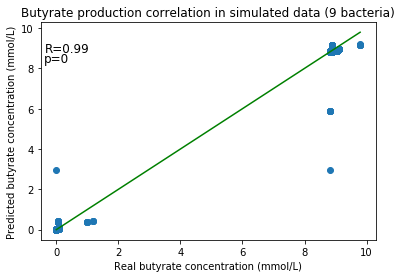

In [32]:
plt.title ('Butyrate production correlation in simulated data (9 bacteria)')  
plt.scatter (x9, y9)  
plt.plot (np.unique(x9), np.poly1d(np.polyfit(x9,y9, 1))(np.unique(x9)), color = 'green')  
plt.xlabel ('Real butyrate concentration (mmol/L)')  
plt.ylabel ('Predicted butyrate concentration (mmol/L)') 
plt.annotate("R=0.99",xy=(2, 9), xycoords='data',
            xytext=(0.35, 9),size=12, va="center", ha="center")
plt.annotate("p=0",xy=(2, 9), xycoords='data',
            xytext=(0, 8.5),size=12, va="center", ha="center")
plt.savefig("Correlation9sim.png", dpi=300,bbox_inches='tight')


# 10 bacteria

In [6]:
tr10=pd.read_table(folder + "simulaciones/res_simulations/train_data_simulated/train_10bactS")
tr10

,but,rb1,rb2,rb3,rb4,rb5,rb6,rb7,rb8,rb9,...,Unnamed: 331,Unnamed: 332,Unnamed: 333,Unnamed: 334,Unnamed: 335,Unnamed: 336,Unnamed: 337,Unnamed: 338,Unnamed: 339,Unnamed: 340
0,8.907439,1,0,1,0,0,1,1,1,0,...,0.992508,0.997826,0.973405,0.998870,0.999831,0.995245,0.998501,0.997740,0.995471,0.997540
1,8.808490,1,0,1,0,0,1,1,1,0,...,0.623788,0.901604,0.528617,0.779402,0.994248,0.889697,0.955700,0.780337,0.675149,0.763636
2,9.042754,1,0,1,0,0,1,1,1,0,...,0.997762,0.997826,0.973405,0.998870,0.999831,0.995245,0.995831,0.998501,0.997740,0.995471
3,8.808553,1,0,1,0,0,1,1,1,0,...,0.992508,0.997826,0.973405,0.998870,0.999831,0.995245,0.995831,0.998501,0.997740,0.997540
4,8.808481,1,0,1,0,0,1,1,1,0,...,0.992508,0.997826,0.973405,0.998870,0.999831,0.995245,0.995831,0.998501,0.995471,0.997540
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
88584,0.069692,0,0,1,0,0,1,1,1,0,...,0.992508,0.984968,0.996583,0.991835,0.998638,0.998241,0.998501,0.997740,0.995471,0.997540
88585,0.069692,0,0,1,0,0,1,1,1,0,...,0.992508,0.984968,0.996583,0.991835,0.998638,0.998241,0.998501,0.997740,0.995471,0.997540
88586,0.069692,0,0,1,0,0,1,1,1,0,...,0.992508,0.984968,0.996583,0.998638,0.998638,0.998241,0.998501,0.997740,0.995471,0.997540
88587,0.000000,0,0,1,0,0,1,1,1,0,...,0.992508,0.984968,0.991835,0.998638,0.998638,0.998241,0.998501,0.997740,0.995471,0.997540


In [7]:
X10 = tr10.iloc [:, 1:298].values
y10 = tr10.iloc[:, 0].values

In [8]:
neigh = KNeighborsRegressor(n_neighbors=3)
neigh.fit(X10, y10)
dump(neigh, 'knn_10bact.joblib') 

['knn_10bact.joblib']

In [9]:
from sklearn.model_selection import LeaveOneOut
loo = LeaveOneOut()
loo.get_n_splits(X10)


88589

In [10]:

for i, (train_index, test_index) in enumerate(loo.split(X10)):
    X10_train, X10_test = X10[train_index], X10[test_index]
 #   print(neigh.predict(X_test))
    print(f"real value {y10[i]} \tpredict: {neigh.predict(X10_test)}")

real value 8.90743941663472 	predict: [8.84161971]
real value 8.808489924183199 	predict: [8.80865118]
real value 9.04275382417133 	predict: [8.88672451]
real value 8.80855274474601 	predict: [8.80865749]
real value 8.80848084534171 	predict: [8.80848938]
real value 8.808604109166618 	predict: [8.80867461]
real value 8.9074279026013 	predict: [8.84161587]
real value 8.80848084534069 	predict: [8.80863352]
real value 8.80848084534706 	predict: [8.80848938]
real value 8.80848084539651 	predict: [8.84147173]
real value 8.80852430711311 	predict: [8.80850386]
real value 8.80848084537258 	predict: [8.80855718]
real value 8.80848084535906 	predict: [8.80848511]
real value 8.808494477002789 	predict: [8.80848965]
real value 8.80848084532967 	predict: [8.80848511]
real value 8.80849307777328 	predict: [8.80848919]
real value 9.79240307788116 	predict: [9.15970178]
real value 8.80848084533572 	predict: [8.80856126]
real value 8.808581362251589 	predict: [8.80851862]
real value 8.80852473923065 

real value 8.80848084533824 	predict: [8.80855995]
real value 8.808480845307859 	predict: [8.80848511]
real value 9.04085205791116 	predict: [8.88594218]
real value 8.808480845344551 	predict: [8.80849083]
real value 8.80848084539064 	predict: [8.80848938]
real value 8.80848084538635 	predict: [8.84147111]
real value 8.8084808453738 	predict: [8.80849974]
real value 8.80848915779706 	predict: [8.80855995]
real value 8.80848084537466 	predict: [8.80848511]
real value 8.80848084538642 	predict: [8.88594218]
real value 8.8084979922228 	predict: [8.80849083]
real value 8.80849179529552 	predict: [8.80848876]
real value 8.808480845341641 	predict: [8.80848511]
real value 8.80848084536787 	predict: [8.80855718]
real value 8.8084808453251 	predict: [8.80848938]
real value 8.80852473918966 	predict: [8.80850401]
real value 8.80849894874936 	predict: [8.80849115]
real value 8.80848084535824 	predict: [8.8086218]
real value 8.80848084538703 	predict: [8.80848688]
real value 8.808480845367699 	pr

real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0

real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value

real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.069701006421603 	predict: [0.06969483]
real value 0.069701006421603 	predict: [0.06969792]
real value 0.069701006421603 	predict: [0.06969792]
real value 0.069701006421603 	predict: [0.06969792]
real value 0.069701006421603 	predict: [0.06969792]
real value 0.0697010

real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0

real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0

real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0

real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.069701006421603 	predict: [0.06969483]
real value 0.069701006421603 	predict: [0.06969792]
real value 0.069701006421603 	predict: [0.06969792]
real value 0.069701006421603 	predict: [0.06969792]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06969483]
real value 0.069701006421603 	predict: [0.06969483]
real value 0.069701006421603 	predict: [0.06969483]
real value 0.069701006421603 	predict: [0.06969792]
real value 0.069701006421603 	predict: [0.06969792]
real value 0.069701006421603 	predict: [0.06969792]
real value 0.069701006421603 	predict: [0.06969792]
real value 0.069701006421603 	predict: [0.06969792]
real value 0.069701006421603 	predict: [0.06969792]
real value 0.069701006421603 	predict: [0.06969483]
real value 0.069701006421603 	predict: [0.06969483]
real value 0.069701006421603 	predict: [0.06969792]
real

real value 0.06969173790806199 	predict: [0.06969792]
real value 0.06969173790806199 	predict: [0.06969483]
real value 0.06969173790806199 	predict: [0.06969483]
real value 0.06969173790806199 	predict: [0.06969483]
real value 0.06969173790806199 	predict: [0.06969483]
real value 0.06969173790806199 	predict: [0.06969483]
real value 0.06969173790806199 	predict: [0.06969483]
real value 0.06969173790806199 	predict: [0.06969483]
real value 0.06969173790806199 	predict: [0.06969483]
real value 0.06969173790806199 	predict: [0.06969483]
real value 0.06969173790806199 	predict: [0.06969483]
real value 0.06969173790806199 	predict: [0.06969483]
real value 0.06969173790806199 	predict: [0.06969483]
real value 0.06969173790806199 	predict: [0.06969483]
real value 0.06969173790806199 	predict: [0.06969483]
real value 0.06969173790806199 	predict: [0.06969483]
real value 0.06969173790806199 	predict: [0.06969483]
real value 0.06969173790806199 	predict: [0.06969483]
real value 0.069691737908061

real value 0.06969173790806199 	predict: [0.06969483]
real value 0.06969173790806199 	predict: [0.06969483]
real value 0.06969173790806199 	predict: [0.06969483]
real value 0.06969173790806199 	predict: [0.06969483]
real value 0.06969173790806199 	predict: [0.06969483]
real value 0.06969173790806199 	predict: [0.06969483]
real value 0.06969173790806199 	predict: [0.06969483]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predic

real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.04646116]
real value 0.06969173790806199 	predict: [0.04646116]
real value 0.06969173790806199 	predict: [0.04646116]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.

real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value

real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predic

real value 8.87818185175117 	predict: [8.87817844]
real value 8.87818185175117 	predict: [8.87817844]
real value 8.87818185175117 	predict: [8.87817844]
real value 8.87818185175117 	predict: [8.87817844]
real value 8.87818185175117 	predict: [8.87817844]
real value 8.87818185175117 	predict: [8.87817844]
real value 8.87818185175117 	predict: [8.87817844]
real value 8.87818185175117 	predict: [8.87817844]
real value 8.87818185175117 	predict: [8.87817844]
real value 8.87818185175117 	predict: [8.87817844]
real value 8.87818185175117 	predict: [8.87817844]
real value 8.87818185175117 	predict: [8.87817844]
real value 8.87818185175117 	predict: [8.87817844]
real value 8.87818185175117 	predict: [8.87817844]
real value 8.87818185175117 	predict: [8.87817844]
real value 8.87818185175117 	predict: [8.87817844]
real value 8.87818185175117 	predict: [8.87817844]
real value 8.87818185175117 	predict: [8.87817844]
real value 8.87818185175117 	predict: [8.87817844]
real value 8.87818185175117 	pr

real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	pr

real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	pr

real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	pr

real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	pr

real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	pr

real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	pr

real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	pr

real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	pr

real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	pr

real value 8.87822141855997 	predict: [8.87823025]
real value 8.87822141855997 	predict: [8.87825741]
real value 8.87843763514834 	predict: [9.25273886]
real value 8.87822141855997 	predict: [8.87822347]
real value 8.87822141855997 	predict: [8.87823375]
real value 8.87822141855997 	predict: [8.95551182]
real value 8.87822141855997 	predict: [8.87823025]
real value 8.87822141855997 	predict: [8.87832532]
real value 8.87843763514834 	predict: [8.87839739]
real value 8.87822141855997 	predict: [8.87822553]
real value 8.87822141855997 	predict: [8.87822332]
real value 8.87822141855997 	predict: [8.87825748]
real value 8.80870985833375 	predict: [8.80863352]
real value 8.80870985833375 	predict: [8.8087708]
real value 8.80870985833375 	predict: [8.80864037]
real value 8.80849364174538 	predict: [8.80848938]
real value 8.80870985833375 	predict: [8.80863352]
real value 8.80849364174538 	predict: [8.80848511]
real value 8.80849364174538 	predict: [8.80848511]
real value 8.80849364174538 	pre

real value 8.87822141855997 	predict: [8.87821039]
real value 8.878219196728141 	predict: [8.91121552]
real value 8.87822141855997 	predict: [8.87825724]
real value 8.87822141855997 	predict: [8.87820283]
real value 8.87822141855997 	predict: [8.9112356]
real value 8.87843763514834 	predict: [8.91134022]
real value 8.87822141855997 	predict: [8.95565385]
real value 8.87822141855997 	predict: [8.87818851]
real value 8.87822141855997 	predict: [8.87825676]
real value 8.87822141855997 	predict: [8.87823417]
real value 8.87822141855997 	predict: [8.95554053]
real value 8.87843763514834 	predict: [8.91134144]
real value 8.87822141855997 	predict: [8.87820908]
real value 8.87822141855997 	predict: [8.8782456]
real value 8.87822141855997 	predict: [8.87822093]
real value 8.80870985833375 	predict: [8.80863352]
real value 8.80870985833375 	predict: [8.80863352]
real value 8.80870985833375 	predict: [8.84161995]
real value 8.80849364174538 	predict: [8.80848938]
real value 8.80870985833375 	pre

real value 8.80849364174538 	predict: [8.80848511]
real value 8.80849364174538 	predict: [8.8085045]
real value 8.80870985833375 	predict: [8.80855718]
real value 8.80849364174538 	predict: [8.88594218]
real value 8.80849364174538 	predict: [8.80848511]
real value 8.80849364174538 	predict: [8.80849043]
real value 8.80870985833375 	predict: [8.8085989]
real value 8.80849364174538 	predict: [8.80848511]
real value 8.80849364174538 	predict: [8.80849057]
real value 8.80849364174538 	predict: [8.80848511]
real value 8.80870985833375 	predict: [8.87236764]
real value 8.80870985833375 	predict: [8.80855718]
real value 8.80870985833375 	predict: [8.91925622]
real value 8.80849364174538 	predict: [8.80849024]
real value 8.80849364174538 	predict: [8.80848762]
real value 8.80849364174538 	predict: [8.80848511]
real value 8.80849364174538 	predict: [8.80848938]
real value 8.80870985833375 	predict: [8.80863352]
real value 8.80849364174538 	predict: [8.80849419]
real value 8.80849364174538 	pred

real value 8.80849364174538 	predict: [8.80849474]
real value 8.80849364174538 	predict: [8.80848938]
real value 8.80870985833375 	predict: [8.80863352]
real value 8.80849364174538 	predict: [8.80848938]
real value 8.80849364174538 	predict: [8.88594645]
real value 8.80849364174538 	predict: [8.80857782]
real value 8.80870985833375 	predict: [8.80866602]
real value 8.80849364174538 	predict: [8.80849831]
real value 8.80849364174538 	predict: [8.80850401]
real value 8.80849364174538 	predict: [8.80848938]
real value 8.80870985833375 	predict: [8.84162146]
real value 8.80870985833375 	predict: [8.84161587]
real value 8.80870985833375 	predict: [8.80866114]
real value 8.80849364174538 	predict: [8.88595055]
real value 8.80849364174538 	predict: [8.88596653]
real value 8.80849364174538 	predict: [8.84147173]
real value 8.80849364174538 	predict: [8.84147706]
real value 8.80870985833375 	predict: [8.80863352]
real value 8.80849364174538 	predict: [8.88594645]
real value 8.80849364174538 	pr

real value 8.87843763514834 	predict: [8.8783786]
real value 8.87822141855997 	predict: [8.95566778]
real value 8.87822141855997 	predict: [8.8782062]
real value 8.87822141855997 	predict: [8.8782397]
real value 8.87822141855997 	predict: [8.87826143]
real value 8.87822141855997 	predict: [8.87821054]
real value 8.87822141855997 	predict: [8.87825027]
real value 8.87822141855997 	predict: [8.87821852]
real value 8.87843763514834 	predict: [8.95583013]
real value 8.87822141855997 	predict: [8.87821268]
real value 8.87822141855997 	predict: [8.87823879]
real value 8.87822141855997 	predict: [8.87823133]
real value 8.87822141855997 	predict: [8.87821548]
real value 8.87822141855997 	predict: [8.87821883]
real value 8.87822141855997 	predict: [8.87819738]
real value 8.87843763514834 	predict: [8.87841869]
real value 8.87822141855997 	predict: [8.87821536]
real value 8.87822141855997 	predict: [8.87823704]
real value 8.87822141855997 	predict: [8.87820371]
real value 8.87822141855997 	predi

real value 8.80849364174538 	predict: [8.80848938]
real value 8.80849364174538 	predict: [8.80849038]
real value 8.80849364174538 	predict: [8.80849526]
real value 8.80849364174538 	predict: [8.80848938]
real value 8.80849364174538 	predict: [8.84148636]
real value 8.80870985833375 	predict: [8.80939012]
real value 8.80849364174538 	predict: [8.80850401]
real value 8.80849364174538 	predict: [8.80849726]
real value 8.80849364174538 	predict: [8.80849521]
real value 8.80849364174538 	predict: [8.88594645]
real value 8.80849364174538 	predict: [8.80849224]
real value 8.80870985833375 	predict: [8.80864815]
real value 8.80849364174538 	predict: [8.80848938]
real value 8.80849364174538 	predict: [8.80848938]
real value 8.80849364174538 	predict: [8.80849422]
real value 8.80870985833375 	predict: [8.84161587]
real value 8.80849364174538 	predict: [8.80849489]
real value 8.80849364174538 	predict: [8.80848938]
real value 8.80849364174538 	predict: [8.80848938]
real value 8.80870985833375 	pr

real value 8.80870985833375 	predict: [8.80865622]
real value 8.80870985833375 	predict: [8.80863539]
real value 8.80849364174538 	predict: [8.808493]
real value 8.80849364174538 	predict: [8.84150752]
real value 8.80849364174538 	predict: [8.80848965]
real value 8.80849364174538 	predict: [8.80856145]
real value 8.80870985833375 	predict: [8.88588196]
real value 8.80849364174538 	predict: [8.80848938]
real value 8.80849364174538 	predict: [8.80848938]
real value 8.80849364174538 	predict: [8.80848938]
real value 8.80849364174538 	predict: [8.80849346]
real value 8.80849364174538 	predict: [8.80848938]
real value 8.80870985833375 	predict: [8.80998527]
real value 8.80849364174538 	predict: [8.80849364]
real value 8.80849364174538 	predict: [8.80849364]
real value 8.80849364174538 	predict: [8.80849364]
real value 8.80870985833375 	predict: [8.80864651]
real value 8.80849364174538 	predict: [8.88581604]
real value 8.80849364174538 	predict: [8.80849511]
real value 8.80849364174538 	pred

real value 8.80870985833375 	predict: [8.80864651]
real value 8.80849364174538 	predict: [8.80850439]
real value 8.80849364174538 	predict: [8.80848938]
real value 8.80849364174538 	predict: [8.8084912]
real value 8.80849364174538 	predict: [8.80848938]
real value 8.80870985833375 	predict: [8.80887638]
real value 8.80849364174538 	predict: [8.80848938]
real value 8.80849364174538 	predict: [8.80851015]
real value 8.80849364174538 	predict: [8.80848938]
real value 8.80849364174538 	predict: [8.84147297]
real value 8.80849364174538 	predict: [8.80849528]
real value 8.80849364174538 	predict: [8.80849121]
real value 8.80871128211493 	predict: [8.808634]
real value 8.80849364174538 	predict: [8.80848938]
real value 8.80849364174538 	predict: [8.80849673]
real value 8.80849364174538 	predict: [8.80850401]
real value 8.80849364174538 	predict: [8.80848938]
real value 8.80849364174538 	predict: [8.80850401]
real value 8.80870985833375 	predict: [8.80863352]
real value 8.80849364174538 	predi

real value 8.80849364174538 	predict: [8.80850616]
real value 8.80870985833375 	predict: [8.80863352]
real value 8.80849364174538 	predict: [8.80848938]
real value 8.80849364174538 	predict: [8.80848938]
real value 8.80849364174538 	predict: [8.8085093]
real value 8.80870985833375 	predict: [8.80864815]
real value 8.80870985833375 	predict: [8.84161587]
real value 8.80870985833375 	predict: [8.80863575]
real value 8.80849364174538 	predict: [8.80848938]
real value 8.80849364174538 	predict: [8.80848991]
real value 8.80849364174538 	predict: [8.80848938]
real value 8.80849364174538 	predict: [8.80849516]
real value 8.80870985833375 	predict: [8.80863352]
real value 8.80849364174538 	predict: [8.80848938]
real value 8.80849364174538 	predict: [8.80848938]
real value 8.80849364174538 	predict: [8.8085079]
real value 8.80849364174538 	predict: [8.80849474]
real value 8.80849364174538 	predict: [8.80848938]
real value 8.80870985833375 	predict: [8.80863352]
real value 8.80849364174538 	pred

real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	predict: [8.85499377]
real value 8.87843763514834 	predict: [8.87838367]
real value 8.87822141855997 	predict: [8.87821599]
real value 8.87822141855997 	predict: [8.87823085]
real value 8.87822141855997 	predict: [8.87825047]
real value 8.87822141855997 	predict: [9.21594012]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87843763514834 	predict: [8.87843764]
real value 8.87822141855997 	predict: [8.87822142]
real value 9.79243295726944 	predict: [9.1829586]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87843763514834 	predict: [8.87843764]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87843763514834 	predict: [8.87843764]
real value 8.87843763514834 	pre

real value 8.87843763514834 	predict: [8.87843764]
real value 8.87843763514834 	predict: [8.87836556]
real value 8.87822141855997 	predict: [8.87836556]
real value 8.87843763514834 	predict: [8.87829349]
real value 8.87843763514834 	predict: [8.87843764]
real value 8.87843763514834 	predict: [8.87836556]
real value 8.87843763514834 	predict: [8.87836556]
real value 8.87822141855997 	predict: [8.87836556]
real value 8.87822141855997 	predict: [8.87836556]
real value 8.87822141855997 	predict: [8.87829349]
real value 8.87843763514834 	predict: [8.87836556]
real value 8.87843763514834 	predict: [8.87836556]
real value 8.87843763514834 	predict: [8.87829349]
real value 8.87822141855997 	predict: [8.87836556]
real value 8.87843763514834 	predict: [8.87836556]
real value 8.87822141855997 	predict: [8.87829349]
real value 8.87822141855997 	predict: [8.87829349]
real value 8.87822141855997 	predict: [8.87829349]
real value 8.87843763514834 	predict: [8.87836556]
real value 8.87843763514834 	pr

real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	pr

real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	pr

real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.87818185175117 	predict: [8.87817844]
real value 8.87818185175117 	predict: [8.87817844]
real value 8.87818185175117 	predict: [8.87817844]
real value 8.87818185175117 	predict: [8.87817844]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	pr

real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	pr

real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.87818185175117 	predict: [8.87817503]
real value 8.87818185175117 	pr

real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	pr

real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	pr

real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	pr

real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]


real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	pr

real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict

real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]


real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict:

real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.88593792]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	pr

real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]


real value 8.8781716155006 	predict: [8.87817503]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817503]
real value 8.8781716155006 	predict: [8.87817503]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817503]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817503]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817503]
real value 8.8781716155006 	predict: [8.87817503]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817503]


real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	pr

real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]


real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	pr

real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	pr

real value 0.06974475332418 	predict: [0.06975412]
real value 0.06974475332418 	predict: [0.06975412]
real value 0.06974475332418 	predict: [0.06975412]
real value 0.06974475332418 	predict: [0.06975412]
real value 0.06974475332418 	predict: [0.06975412]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06975412]
real value 0.06974475332418 	predict: [0.06975412]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	pr

real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	pr

real value 0.06974475332418 	predict: [0.06976349]
real value 0.06974475332418 	predict: [0.06976349]
real value 0.06974475332418 	predict: [0.06975412]
real value 0.06974475332418 	predict: [0.06975412]
real value 0.06974475332418 	predict: [0.06975412]
real value 0.06974475332418 	predict: [0.06975412]
real value 0.06974475332418 	predict: [0.06975412]
real value 0.06974475332418 	predict: [0.06975412]
real value 0.06974475332418 	predict: [0.06976349]
real value 0.06974475332418 	predict: [0.06975412]
real value 0.06974475332418 	predict: [0.06975412]
real value 0.06974475332418 	predict: [0.06976349]
real value 0.06974475332418 	predict: [0.06975412]
real value 0.06974475332418 	predict: [0.06975412]
real value 0.06974475332418 	predict: [0.06975412]
real value 0.06974475332418 	predict: [0.06975412]
real value 0.06974475332418 	predict: [0.06975412]
real value 0.06974475332418 	predict: [0.06975412]
real value 0.06974475332418 	predict: [0.06975412]
real value 0.06974475332418 	pr

real value 0.06974475332418 	predict: [0.06976349]
real value 0.06974475332418 	predict: [0.06976349]
real value 0.06974475332418 	predict: [0.06976349]
real value 0.06974475332418 	predict: [0.06976349]
real value 0.06974475332418 	predict: [0.06976349]
real value 0.06974475332418 	predict: [0.06976349]
real value 0.06974475332418 	predict: [0.06976349]
real value 0.06974475332418 	predict: [0.06976349]
real value 0.06974475332418 	predict: [0.06976349]
real value 0.06974475332418 	predict: [0.06976349]
real value 0.06974475332418 	predict: [0.06975412]
real value 0.06974475332418 	predict: [0.06975412]
real value 0.06974475332418 	predict: [0.06975412]
real value 0.06974475332418 	predict: [0.06975412]
real value 0.06974475332418 	predict: [0.06975412]
real value 0.06974475332418 	predict: [0.06975412]
real value 0.06974475332418 	predict: [0.06975412]
real value 0.06974475332418 	predict: [0.06975412]
real value 0.06974475332418 	predict: [0.06975412]
real value 0.06974475332418 	pr

real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [4.09744366e-06]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.

real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.808480845319892 	predict: [8.85499608]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.87824113]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.878253

real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value

real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value

real value 0.06977285439052901 	predict: [0.06976349]
real value 0.06977285439052901 	predict: [0.06976349]
real value 0.06977285439052901 	predict: [0.06976349]
real value 0.06977285439052901 	predict: [0.06976349]
real value 0.06977285439052901 	predict: [0.06976349]
real value 0.06977285439052901 	predict: [0.06975412]
real value 0.06977285439052901 	predict: [0.06976349]
real value 0.06977285439052901 	predict: [0.06976349]
real value 0.06977285439052901 	predict: [0.06976349]
real value 0.06977285439052901 	predict: [0.06977285]
real value 0.06977285439052901 	predict: [0.06976349]
real value 0.06977285439052901 	predict: [0.06976349]
real value 0.06977285439052901 	predict: [0.06976349]
real value 0.06977285439052901 	predict: [0.06976349]
real value 0.06977285439052901 	predict: [0.06976349]
real value 0.06977285439052901 	predict: [0.06976349]
real value 0.06977285439052901 	predict: [0.06976349]
real value 0.06977285439052901 	predict: [0.06976349]
real value 0.069772854390529

real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.06977285439052901 	predict: [0.06976349]
real value 0.06977285439052901 	predict: [0.06976349]
real value 0.06977285439052901 	predict: [0.06976349]
real value 0.06977285439052901 	predict: [0.06976349]
real value 0.06977285439052901 	predict: [0.06976349]
real value 0.06977285439052901 	predict: [0.06976349]
real value 0.06977285439052901 	predict: [0.06976349]
real value 0.06977285439052901 	predict: [0.06976349]
real value 0.06977285439052901 	predict: [0.06976349]
real value 0.06977285439052901 	predict: [0.06976349]
real value 0.06977285439052901 	predict: [0.06976349]
real value 0.06977285439052901 	predict: [0.06976349]
real value 0.06977285439052901 	predict: [0.06976349]
real value 0.06977285439052901 	predict: [0.06976349]
real value 0.06977285439052901 	predict: [0.06976349]
real value

real value 0.06977285439052901 	predict: [0.06976349]
real value 0.06977285439052901 	predict: [0.06976349]
real value 0.06977285439052901 	predict: [0.06976349]
real value 0.06977285439052901 	predict: [0.06976349]
real value 0.06977285439052901 	predict: [0.06976349]
real value 0.06977285439052901 	predict: [0.06976349]
real value 0.06977285439052901 	predict: [0.06976349]
real value 0.06977285439052901 	predict: [0.06976349]
real value 0.06977285439052901 	predict: [0.06976349]
real value 0.06977285439052901 	predict: [0.06976349]
real value 0.06977285439052901 	predict: [0.06976349]
real value 0.06977285439052901 	predict: [0.06976349]
real value 0.06977285439052901 	predict: [0.06976349]
real value 0.06977285439052901 	predict: [0.06976349]
real value 0.06977285439052901 	predict: [0.06976349]
real value 0.06977285439052901 	predict: [0.06976349]
real value 0.06977285439052901 	predict: [0.06976349]
real value 0.06977285439052901 	predict: [0.06976349]
real value 0.069772854390529

real value 0.06977285439052901 	predict: [0.06977285]
real value 0.06977285439052901 	predict: [0.06977285]
real value 0.06977285439052901 	predict: [0.06977285]
real value 0.06977285439052901 	predict: [0.06977285]
real value 0.06977285439052901 	predict: [0.06977285]
real value 0.06977285439052901 	predict: [0.06977285]
real value 0.06977285439052901 	predict: [0.06974582]
real value 0.06977285439052901 	predict: [0.06977285]
real value 0.06977285439052901 	predict: [0.06977285]
real value 0.06977285439052901 	predict: [0.06977285]
real value 0.06977285439052901 	predict: [0.06977285]
real value 0.06977285439052901 	predict: [0.06977285]
real value 0.06977285439052901 	predict: [0.06974582]
real value 0.06977285439052901 	predict: [0.06977285]
real value 0.06977285439052901 	predict: [0.06977285]
real value 0.06977285439052901 	predict: [0.06977285]
real value 0.06977285439052901 	predict: [0.06974582]
real value 0.06977285439052901 	predict: [0.06977285]
real value 0.069772854390529

real value 0.06977285439052901 	predict: [0.06977285]
real value 0.06977285439052901 	predict: [0.06977285]
real value 0.06977285439052901 	predict: [0.06977285]
real value 0.06977285439052901 	predict: [0.06977285]
real value 0.06977285439052901 	predict: [0.06977285]
real value 0.06977285439052901 	predict: [0.06977285]
real value 0.06977285439052901 	predict: [0.06977285]
real value 0.06977285439052901 	predict: [0.06977285]
real value 0.06977285439052901 	predict: [0.06977285]
real value 0.06977285439052901 	predict: [0.06977285]
real value 0.06977285439052901 	predict: [0.06977285]
real value 0.06977285439052901 	predict: [0.06977285]
real value 0.06977285439052901 	predict: [0.06977285]
real value 0.06977285439052901 	predict: [0.06977285]
real value 0.06977285439052901 	predict: [0.06977285]
real value 0.06977285439052901 	predict: [0.06977285]
real value 0.06977285439052901 	predict: [0.06977285]
real value 0.06977285439052901 	predict: [0.06977285]
real value 0.069772854390529

real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.8782160

real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8

real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8

real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.8782160

real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8

real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predic

real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.85497095]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821

real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8

real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.88580136]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8

real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.8782160

real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.8782160

real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821

real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.8782160

real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0

real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.0464901]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.

real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069735157108077 	predict: [0.06973516]
real value 0

real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06976382]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0

real value 0.069735157108077 	predict: [0.06976382]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06976382]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06976382]
real value 0.069735157108077 	predict: [0.06976382]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06976382]
real value 0.069735157108077 	predict: [0.06976382]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0

real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.069735157108077 	predict: [0.06976382]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06976382]
real value 0.069735157108077 	predict: [0.06976382]
real value 0.069735157108077 	predict: [0.06976382]
real value 0.069735157108077 	predict: [0.06976382]
real v

real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value

real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0

real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.04654743]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.04654743]
real value 0.069821145701638 	predict: [0.04654743]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value

real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982304]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.44420983]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0

real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0

real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0

real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0

real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0

real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	pr

real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.069821145701638 	predict: [0.06973423]
real value 0.069821145701638 	predict: [0.06977769]
real value 0.069821145701638 	predict: [0.06977769]
real value 0.069821145701638 	predict: [0.06977769]
real value 0.069821145701638 	predict: [0.

real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0

real value 8.87822141855997 	predict: [8.87829349]
real value 8.87822141855997 	predict: [8.87829349]
real value 8.87843763514834 	predict: [8.87836556]
real value 8.87843763514834 	predict: [8.87836556]
real value 8.87843763514834 	predict: [8.87836556]
real value 8.87822141855997 	predict: [8.87829349]
real value 8.87822141855997 	predict: [8.87829349]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87843763514834 	predict: [8.87843764]
real value 8.87843763514834 	predict: [8.85512297]
real value 8.87843763514834 	predict: [8.87836556]
real value 8.80849364174538 	predict: [8.85512297]
real value 8.87822141855997 	predict: [8.87836556]
real value 8.87822141855997 	predict: [8.87829349]
real value 8.87843763514834 	predict: [8.85512297]
real value 8.87843763514834 	predict: [8.87836556]
real value 8.87843763514834 	predict: [8.87829349]
real value 8.87822141855997 	predict: [8.87829349]
real value 8.80870985833375 	predict: [8.80870986]
real value 8.90765691563196 	pr

real value 8.87822141855997 	predict: [8.87829349]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.80870985833375 	predict: [8.80863779]
real value 8.80870985833375 	predict: [8.80863779]
real value 8.80870985833375 	predict: [8.80863779]
real value 8.80849364174538 	predict: [8.80849364]
real value 8.80849364174538 	predict: [8.80849364]
real value 8.80849364174538 	predict: [8.80849364]
real value 8.80849364174538 	predict: [8.80856571]
real value 8.80870985833375 	predict: [8.80856571]
real value 8.80849364174538 	predict: [8.80856571]
real value 8.80849364174538 	predict: [8.80849364]
real value 8.80849364174538 	predict: [8.80849364]
real value 8.80849364174538 	predict: [8.80849364]
real value 8.80849364174538 	predict: [8.80849364]
real value 8.80849364174538 	predict: [8.80849364]
real value 8.80849364174538 	pr

real value 8.87843763514834 	predict: [8.87836556]
real value 8.87843763514834 	predict: [8.87836556]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	predict: [8.87829349]
real value 8.87843763514834 	predict: [8.87836556]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87843763514834 	predict: [8.87843764]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	pr

real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	predict: [8.87829349]
real value 8.87843763514834 	predict: [8.87836556]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87843763514834 	predict: [8.87843764]
real value 8.87822141855997 	predict: [8.87829349]
real value 8.87822141855997 	predict: [8.87829349]
real value 8.87822141855997 	predict: [8.87829349]
real value 8.87843763514834 	predict: [8.87836556]
real value 8.87843763514834 	predict: [8.87836556]
real value 8.87843763514834 	predict: [8.87836556]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	predict: [8.87829349]
real value 8.87843763514834 	predict: [8.87836556]
real value 8.87822141855997 	pr

real value 8.80849364174538 	predict: [8.80856571]
real value 8.80849364174538 	predict: [8.80856571]
real value 8.87843763514834 	predict: [8.87843764]
real value 8.87822141855997 	predict: [8.8550509]
real value 8.87822141855997 	predict: [8.87829349]
real value 8.87822141855997 	predict: [8.87829349]
real value 8.80870985833375 	predict: [8.85512297]
real value 8.87843763514834 	predict: [8.87836556]
real value 8.87843763514834 	predict: [8.87836556]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	predict: [8.87829349]
real value 8.87843763514834 	predict: [8.87836556]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.97716847585817 	predict: [8.91120377]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	pre

real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87843763514834 	predict: [8.87843764]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87843763514834 	predict: [8.87843764]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87843763514834 	predict: [8.87843764]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87843763514834 	predict: [8.87843764]
real value 8.87843763514834 	pr

real value 8.80870985833375 	predict: [8.80870986]
real value 8.80870985833375 	predict: [8.80870986]
real value 8.80870985833375 	predict: [8.80870986]
real value 8.80849364174538 	predict: [8.80849364]
real value 8.87843763514834 	predict: [8.87843764]
real value 8.87843763514834 	predict: [8.87843764]
real value 8.87843763514834 	predict: [8.87843764]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87843763514834 	predict: [8.87843764]
real value 8.87843763514834 	predict: [8.87843764]
real value 8.87843763514834 	predict: [8.87843764]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87843763514834 	predict: [8.87843764]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87843763514834 	predict: [8.87843764]
real value 8.87843763514834 	pr

real value 8.80870985833375 	predict: [8.80870986]
real value 8.80849364174538 	predict: [8.80849364]
real value 8.80849364174538 	predict: [8.80849364]
real value 8.80849364174538 	predict: [8.80849364]
real value 8.80849364174538 	predict: [8.80849364]
real value 8.80870985833375 	predict: [8.80870986]
real value 8.80849364174538 	predict: [8.80849364]
real value 8.80849364174538 	predict: [8.80849364]
real value 8.80849364174538 	predict: [8.80849364]
real value 8.80870985833375 	predict: [8.80870986]
real value 8.80849364174538 	predict: [8.80849364]
real value 8.80849364174538 	predict: [8.80849364]
real value 8.80849364174538 	predict: [8.80849364]
real value 8.80870985833375 	predict: [8.80870986]
real value 8.80870985833375 	predict: [8.80870986]
real value 8.80870985833375 	predict: [8.80870986]
real value 8.80849364174538 	predict: [8.80849364]
real value 8.80849364174538 	predict: [8.80849364]
real value 8.80849364174538 	predict: [8.80849364]
real value 8.80870985833375 	pr

real value 8.87843763514834 	predict: [8.87843764]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87843763514834 	predict: [8.87843764]
real value 8.87843763514834 	predict: [8.87843764]
real value 8.87843763514834 	predict: [8.87843764]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87843763514834 	predict: [8.87843764]
real value 8.87843763514834 	predict: [8.87843764]
real value 8.87843763514834 	predict: [8.87843764]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.80870985833375 	predict: [8.80870986]
real value 8.80870985833375 	predict: [8.80870986]
real value 8.80870985833375 	predict: [8.80870986]
real value 8.80849364174538 	predict: [8.80849364]
real value 8.80870985833375 	predict: [8.80870986]
real value 8.80870985833375 	pr

real value 8.87843763514834 	predict: [8.87836556]
real value 8.87822141855997 	predict: [8.87829349]
real value 8.87822141855997 	predict: [8.91120377]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	predict: [8.87829349]
real value 8.87843763514834 	predict: [8.87836556]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	predict: [8.87829349]
real value 8.87843763514834 	predict: [8.87836556]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	pr

real value 8.87843763514834 	predict: [8.87843764]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87843763514834 	predict: [8.87843764]
real value 8.87843763514834 	predict: [8.87843764]
real value 8.87843763514834 	predict: [8.91141999]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87843763514834 	predict: [8.87843764]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87843763514834 	predict: [8.87843764]
real value 8.87822141855997 	predict: [8.87829349]
real value 8.87822141855997 	predict: [8.87829349]
real value 8.87822141855997 	predict: [8.87829349]
real value 8.87843763514834 	pr

real value 8.87843763514834 	predict: [8.87843764]
real value 8.87822141855997 	predict: [8.87829349]
real value 8.87822141855997 	predict: [8.87829349]
real value 8.87822141855997 	predict: [8.87829349]
real value 8.87843763514834 	predict: [8.87836556]
real value 8.87843763514834 	predict: [8.87836556]
real value 8.87843763514834 	predict: [8.87836556]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87843763514834 	predict: [8.87843764]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87843763514834 	predict: [8.87843764]
real value 8.87822141855997 	pr

real value 8.80870985833375 	predict: [8.80870986]
real value 8.80870985833375 	predict: [8.80870986]
real value 8.80849364174538 	predict: [8.80849364]
real value 8.80849364174538 	predict: [8.80849364]
real value 8.80849364174538 	predict: [8.80849364]
real value 8.80870985833375 	predict: [8.80870986]
real value 8.80870985833375 	predict: [8.80870986]
real value 8.80870985833375 	predict: [8.88616693]
real value 8.80849364174538 	predict: [8.80849364]
real value 8.80849364174538 	predict: [8.80849364]
real value 8.80849364174538 	predict: [8.80849364]
real value 8.80870985833375 	predict: [8.80870986]
real value 8.80870985833375 	predict: [8.80870986]
real value 8.80870985833375 	predict: [8.80870986]
real value 8.80849364174538 	predict: [8.80849364]
real value 8.80870985833375 	predict: [8.80870986]
real value 8.80849364174538 	predict: [8.80849364]
real value 8.80849364174538 	predict: [8.80849364]
real value 8.80849364174538 	predict: [8.80849364]
real value 8.80870985833375 	pr

real value 8.80870985833375 	predict: [8.80870986]
real value 8.80870985833375 	predict: [8.80870986]
real value 8.80849364174538 	predict: [8.80856571]
real value 8.80870985833375 	predict: [8.80863779]
real value 8.80870985833375 	predict: [8.80870986]
real value 8.80870985833375 	predict: [8.80870986]
real value 8.80870985833375 	predict: [8.80870986]
real value 8.80849364174538 	predict: [8.80856571]
real value 8.80849364174538 	predict: [8.80856571]
real value 8.80849364174538 	predict: [8.80856571]
real value 8.80870985833375 	predict: [8.80863779]
real value 8.80870985833375 	predict: [8.80863779]
real value 8.80870985833375 	predict: [8.80863779]
real value 8.80849364174538 	predict: [8.80849364]
real value 8.80870985833375 	predict: [8.80870986]
real value 8.80849364174538 	predict: [8.80856571]
real value 8.80849364174538 	predict: [8.80856571]
real value 8.80849364174538 	predict: [8.80856571]
real value 8.80870985833375 	predict: [8.80863779]
real value 8.80870985833375 	pr

real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87843763514834 	predict: [8.87843764]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87843763514834 	predict: [8.87843764]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87843763514834 	predict: [8.87843764]
real value 8.87843763514834 	predict: [8.87843764]
real value 8.87843763514834 	predict: [8.87843764]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	predict: [8.91120377]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87843763514834 	predict: [8.87843764]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	pr

real value 8.80849364174538 	predict: [8.80849364]
real value 8.80849364174538 	predict: [8.80849364]
real value 8.80849364174538 	predict: [8.80849364]
real value 8.80870985833375 	predict: [8.80870986]
real value 8.80870985833375 	predict: [8.80870986]
real value 8.80870985833375 	predict: [8.80870986]
real value 8.80849364174538 	predict: [8.80849364]
real value 8.80849364174538 	predict: [8.80849364]
real value 8.80849364174538 	predict: [8.80849364]
real value 8.80870985833375 	predict: [8.80870986]
real value 8.80870985833375 	predict: [8.80870986]
real value 8.80870985833375 	predict: [8.80870986]
real value 8.80849364174538 	predict: [8.80849364]
real value 8.87843763514834 	predict: [8.87843764]
real value 8.87843763514834 	predict: [8.87843764]
real value 8.87843763514834 	predict: [8.87843764]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87843763514834 	predict: [8.87843764]
real value 8.87843763514834 	predict: [8.87843764]
real value 8.87843763514834 	pr

real value 8.80849364174538 	predict: [8.80849364]
real value 8.80849364174538 	predict: [8.80849364]
real value 8.80849364174538 	predict: [8.80849364]
real value 8.80870985833375 	predict: [8.80870986]
real value 8.80849364174538 	predict: [8.80849364]
real value 8.80849364174538 	predict: [8.80849364]
real value 8.80849364174538 	predict: [8.80849364]
real value 8.80870985833375 	predict: [8.80870986]
real value 8.80849364174538 	predict: [8.80849364]
real value 8.80849364174538 	predict: [8.80849364]
real value 8.80849364174538 	predict: [8.80849364]
real value 8.80870985833375 	predict: [8.80870986]
real value 8.80870985833375 	predict: [8.80870986]
real value 8.80870985833375 	predict: [8.80870986]
real value 8.80849364174538 	predict: [8.80849364]
real value 8.80849364174538 	predict: [8.80849364]
real value 8.80849364174538 	predict: [8.80849364]
real value 8.80870985833375 	predict: [8.80870986]
real value 8.80870985833375 	predict: [8.80870986]
real value 8.80870985833375 	pr

real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87843763514834 	predict: [8.87843764]
real value 8.87843763514834 	predict: [8.87843764]
real value 8.87843763514834 	predict: [8.87843764]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87843763514834 	predict: [8.87843764]
real value 8.87843763514834 	predict: [8.87843764]
real value 8.87843763514834 	predict: [8.87843764]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87843763514834 	predict: [8.87843764]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87843763514834 	predict: [8.87843764]
real value 8.87843763514834 	predict: [8.87843764]
real value 8.87843763514834 	pr

real value 8.80849364174538 	predict: [8.80849364]
real value 8.80849364174538 	predict: [8.80849364]
real value 8.80870985833375 	predict: [8.80870986]
real value 8.80870985833375 	predict: [8.80870986]
real value 8.80870985833375 	predict: [8.80870986]
real value 8.80849364174538 	predict: [8.80849364]
real value 8.80849364174538 	predict: [8.80849364]
real value 8.80849364174538 	predict: [8.80849364]
real value 8.80870985833375 	predict: [8.80870986]
real value 8.80870985833375 	predict: [8.80870986]
real value 8.80870985833375 	predict: [8.80870986]
real value 8.80849364174538 	predict: [8.80849364]
real value 8.80870985833375 	predict: [8.80870986]
real value 8.80870985833375 	predict: [8.80870986]
real value 8.80870985833375 	predict: [8.80870986]
real value 8.80849364174538 	predict: [8.80849364]
real value 8.80870985833375 	predict: [8.80870986]
real value 8.80870985833375 	predict: [8.80870986]
real value 8.80870985833375 	predict: [8.80870986]
real value 8.80870985833375 	pr

real value 8.80849364174538 	predict: [8.80856571]
real value 8.80870985833375 	predict: [8.80863779]
real value 8.80870985833375 	predict: [8.80870986]
real value 8.80870985833375 	predict: [8.80863779]
real value 8.80870985833375 	predict: [8.80863779]
real value 8.80849364174538 	predict: [8.80863779]
real value 8.80849364174538 	predict: [8.80863779]
real value 8.80849364174538 	predict: [8.80856571]
real value 8.80870985833375 	predict: [8.88609486]
real value 8.80870985833375 	predict: [8.80863779]
real value 8.80870985833375 	predict: [8.80856571]
real value 8.80849364174538 	predict: [8.80856571]
real value 8.80870985833375 	predict: [8.80863779]
real value 8.80849364174538 	predict: [8.80863779]
real value 8.80849364174538 	predict: [8.80856571]
real value 8.80849364174538 	predict: [8.80856571]
real value 8.80870985833375 	predict: [8.80863779]
real value 8.80870985833375 	predict: [8.80856571]
real value 8.80870985833375 	predict: [8.80856571]
real value 8.80849364174538 	pr

real value 8.87843763514834 	predict: [8.87843764]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	predict: [8.87829349]
real value 8.87843763514834 	predict: [8.87836556]
real value 8.87822141855997 	predict: [8.87829349]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.87822141855997 	predict: [8.87822142]
real value 8.80870985833375 	predict: [8.80870986]
real value 8.80870985833375 	predict: [8.80870986]
real value 8.80870985833375 	predict: [8.80870986]
real value 8.80849364174538 	predict: [8.80849364]
real value 8.80870985833375 	predict: [8.80863779]
real value 8.80849364174538 	predict: [8.80856571]
real value 8.80849364174538 	predict: [8.80856571]
real value 8.80849364174538 	predict: [8.80856571]
real value 8.80870985833375 	predict: [8.80863779]
real value 8.80870985833375 	pr

real value 8.80849364174538 	predict: [8.80849364]
real value 8.80870985833375 	predict: [8.80870986]
real value 8.80849364174538 	predict: [8.80849364]
real value 8.80849364174538 	predict: [8.80849364]
real value 8.80849364174538 	predict: [8.80849364]
real value 8.80870985833375 	predict: [8.80870986]
real value 8.80870985833375 	predict: [8.80870986]
real value 8.80870985833375 	predict: [8.80870986]
real value 8.80849364174538 	predict: [8.80849364]
real value 8.80849364174538 	predict: [8.80849364]
real value 8.80849364174538 	predict: [8.80849364]
real value 8.80849364174538 	predict: [8.80856571]
real value 8.80870985833375 	predict: [8.80863779]
real value 8.80849364174538 	predict: [8.80849364]
real value 8.80849364174538 	predict: [8.80849364]
real value 8.80849364174538 	predict: [8.80849364]
real value 8.80849364174538 	predict: [8.80849364]
real value 8.80849364174538 	predict: [8.80849364]
real value 8.80870985833375 	predict: [8.80870986]
real value 8.80849364174538 	pr

real value 8.80849364174538 	predict: [8.80849364]
real value 8.80870985833375 	predict: [8.80870986]
real value 8.80849364174538 	predict: [8.80856571]
real value 8.80849364174538 	predict: [8.80856571]
real value 8.80849364174538 	predict: [8.80856571]
real value 8.80870985833375 	predict: [8.80863779]
real value 8.80870985833375 	predict: [8.80863779]
real value 8.80870985833375 	predict: [8.80863779]
real value 8.80849364174538 	predict: [8.80849364]
real value 8.80849364174538 	predict: [8.80849364]
real value 8.80849364174538 	predict: [8.80849364]
real value 8.80849364174538 	predict: [8.80856571]
real value 8.80870985833375 	predict: [8.80863779]
real value 8.80849364174538 	predict: [8.80849364]
real value 8.80849364174538 	predict: [8.80849364]
real value 8.80849364174538 	predict: [8.80849364]
real value 8.80870985833375 	predict: [8.80870986]
real value 8.80849364174538 	predict: [8.80856571]
real value 8.80849364174538 	predict: [8.80856571]
real value 8.80849364174538 	pr

real value 8.80849364174538 	predict: [8.80849364]
real value 8.80849364174538 	predict: [8.80849364]
real value 8.80849364174538 	predict: [8.80856571]
real value 8.80870985833375 	predict: [8.80863779]
real value 8.80849364174538 	predict: [8.80848938]
real value 8.80849364174538 	predict: [8.80848938]
real value 8.80849364174538 	predict: [8.80849364]
real value 8.80870985833375 	predict: [8.80870986]
real value 8.80849364174538 	predict: [8.80856571]
real value 8.80849364174538 	predict: [8.80856571]
real value 8.80849364174538 	predict: [8.80856571]
real value 8.80870985833375 	predict: [8.80863779]
real value 8.80870985833375 	predict: [8.80863779]
real value 8.80870985833375 	predict: [8.80863779]
real value 8.80849364174538 	predict: [8.80849364]
real value 8.80849364174538 	predict: [8.80849364]
real value 8.80849364174538 	predict: [8.80849364]
real value 8.80849364174538 	predict: [8.80856571]
real value 8.80870985833375 	predict: [8.80863779]
real value 8.80849364174538 	pr

real value 8.80849364174538 	predict: [8.80848938]
real value 8.80849364174538 	predict: [8.80848938]
real value 8.80849364174538 	predict: [8.80848938]
real value 8.80849364174538 	predict: [8.80849364]
real value 8.80870985833375 	predict: [8.80870986]
real value 8.80849364174538 	predict: [8.80849364]
real value 8.80849364174538 	predict: [8.80849364]
real value 8.80849364174538 	predict: [8.80849364]
real value 8.80870985833375 	predict: [8.80890306]
real value 8.80849364174538 	predict: [8.80848938]
real value 8.80849364174538 	predict: [8.80849364]
real value 8.80849364174538 	predict: [8.80848938]
real value 8.80870985833375 	predict: [8.80890306]
real value 8.80870985833375 	predict: [8.80870986]
real value 8.80870985833375 	predict: [8.80890306]
real value 8.80849364174538 	predict: [8.80849364]
real value 8.80849364174538 	predict: [8.80848938]
real value 8.80849364174538 	predict: [8.80849364]
real value 8.80849364174538 	predict: [8.80849364]
real value 8.80870985833375 	pr

real value 8.87843763514834 	predict: [8.87861753]
real value 8.87822141855997 	predict: [8.87820385]
real value 8.87822141855997 	predict: [8.87820385]
real value 8.87822141855997 	predict: [8.87820385]
real value 8.87843763514834 	predict: [8.87861753]
real value 8.87843763514834 	predict: [8.87861753]
real value 8.87843763514834 	predict: [8.87861753]
real value 8.87822141855997 	predict: [8.87820385]
real value 8.87822141855997 	predict: [8.87820385]
real value 8.87822141855997 	predict: [8.87820385]
real value 8.87822141855997 	predict: [8.87820385]
real value 8.87843763514834 	predict: [8.87861753]
real value 8.87822141855997 	predict: [8.87820385]
real value 8.87822141855997 	predict: [8.87820385]
real value 8.87822141855997 	predict: [8.87820385]
real value 8.87843763514834 	predict: [8.87861753]
real value 8.87822141855997 	predict: [8.87820385]
real value 8.87822141855997 	predict: [8.87820385]
real value 8.87822141855997 	predict: [8.87820385]
real value 8.87843763514834 	pr

real value 8.87843763514834 	predict: [8.87861753]
real value 8.87822141855997 	predict: [8.87820385]
real value 8.87822141855997 	predict: [8.87820385]
real value 8.87822141855997 	predict: [8.87820385]
real value 8.87843763514834 	predict: [8.87861753]
real value 8.87843763514834 	predict: [8.87861753]
real value 8.87843763514834 	predict: [8.87861753]
real value 8.87822141855997 	predict: [8.87820385]
real value 8.87822141855997 	predict: [8.87820385]
real value 8.87822141855997 	predict: [8.87820385]
real value 8.87822141855997 	predict: [8.87818628]
real value 8.87843763514834 	predict: [8.87879743]
real value 8.87822141855997 	predict: [8.87818628]
real value 8.87822141855997 	predict: [8.87818628]
real value 8.87822141855997 	predict: [8.87818628]
real value 8.87822141855997 	predict: [8.87818628]
real value 8.87822141855997 	predict: [8.87820385]
real value 8.87843763514834 	predict: [8.87861753]
real value 8.87822141855997 	predict: [8.87820385]
real value 8.87822141855997 	pr

real value 8.80848084534109 	predict: [8.80875465]
real value 8.87897732904303 	predict: [8.87852789]
real value 8.878168703364109 	predict: [8.87845582]
real value 8.878168703364109 	predict: [8.87845582]
real value 8.878168703364109 	predict: [8.87845582]
real value 8.87897732904303 	predict: [8.87852789]
real value 8.87897732904303 	predict: [8.87852789]
real value 8.87897732904303 	predict: [8.87852789]
real value 8.878168703364109 	predict: [8.87818628]
real value 8.878168703364109 	predict: [8.87818628]
real value 8.878168703364109 	predict: [8.87818628]
real value 8.878168703364109 	predict: [8.87845582]
real value 8.87897732904303 	predict: [8.87852789]
real value 8.878168703364109 	predict: [8.87845582]
real value 8.878168703364109 	predict: [8.87818628]
real value 8.878168703364109 	predict: [8.87818628]
real value 8.878168703364109 	predict: [8.87818628]
real value 8.878168703364109 	predict: [8.87818628]
real value 8.878168703364109 	predict: [8.87818628]
real value 8.87816

real value 8.878168703364109 	predict: [8.8781687]
real value 8.878168703364109 	predict: [8.87843825]
real value 8.87897732904303 	predict: [8.87870779]
real value 8.878168703364109 	predict: [8.87818628]
real value 8.878168703364109 	predict: [8.8781687]
real value 8.878168703364109 	predict: [8.87818628]
real value 8.878168703364109 	predict: [8.8781687]
real value 8.878168703364109 	predict: [8.8781687]
real value 8.87897732904303 	predict: [8.87897733]
real value 8.878168703364109 	predict: [8.8781687]
real value 8.878168703364109 	predict: [8.8781687]
real value 8.878168703364109 	predict: [8.8781687]
real value 8.87897732904303 	predict: [8.87897733]
real value 8.878168703364109 	predict: [8.8781687]
real value 8.878168703364109 	predict: [8.8781687]
real value 8.878168703364109 	predict: [8.8781687]
real value 8.87897732904303 	predict: [8.87897733]
real value 8.87897732904303 	predict: [8.87897733]
real value 8.87897732904303 	predict: [8.87897733]
real value 8.878168703364109

real value 8.87897732904303 	predict: [8.87879743]
real value 8.87897732904303 	predict: [8.87879743]
real value 8.878168703364109 	predict: [8.87843825]
real value 8.878168703364109 	predict: [8.87843825]
real value 8.878168703364109 	predict: [8.87843825]
real value 8.87897732904303 	predict: [8.87870779]
real value 8.87897732904303 	predict: [8.87870779]
real value 8.87897732904303 	predict: [8.87870779]
real value 8.878168703364109 	predict: [8.87818628]
real value 8.87897732904303 	predict: [8.87879743]
real value 8.878168703364109 	predict: [8.87843825]
real value 8.878168703364109 	predict: [8.87843825]
real value 8.878168703364109 	predict: [8.87843825]
real value 8.87897732904303 	predict: [8.87870779]
real value 8.87897732904303 	predict: [8.87870779]
real value 8.87897732904303 	predict: [8.87870779]
real value 8.878168703364109 	predict: [8.87818628]
real value 8.878168703364109 	predict: [8.87818628]
real value 8.878168703364109 	predict: [8.8781687]
real value 8.878168703

real value 8.80848084534109 	predict: [8.80848085]
real value 8.80928947102 	predict: [8.80928947]
real value 8.80848084534109 	predict: [8.80848085]
real value 8.80848084534109 	predict: [8.80848085]
real value 8.80848084534109 	predict: [8.80848085]
real value 8.80928947102 	predict: [8.80928947]
real value 8.80928947102 	predict: [8.80928947]
real value 8.80928947102 	predict: [8.80928947]
real value 8.80848084534109 	predict: [8.80848085]
real value 8.80848084534109 	predict: [8.80848085]
real value 8.80848084534109 	predict: [8.80848085]
real value 8.80928947102 	predict: [8.80928947]
real value 8.80928947102 	predict: [8.80928947]
real value 8.80928947102 	predict: [8.80928947]
real value 8.80848084534109 	predict: [8.80848085]
real value 8.80848084534109 	predict: [8.80848085]
real value 8.80848084534109 	predict: [8.80848085]
real value 8.80928947102 	predict: [8.80928947]
real value 8.80928947102 	predict: [8.80928947]
real value 8.80928947102 	predict: [8.80928947]
real value

real value 8.878168703364109 	predict: [8.87843825]
real value 8.878168703364109 	predict: [8.87843825]
real value 8.87897732904303 	predict: [8.87870779]
real value 8.87897732904303 	predict: [8.87870779]
real value 8.87897732904303 	predict: [8.87870779]
real value 8.878168703364109 	predict: [8.87818628]
real value 8.80928947102 	predict: [8.80909627]
real value 8.80928947102 	predict: [8.80909627]
real value 8.80928947102 	predict: [8.80909627]
real value 8.80848084534109 	predict: [8.80875039]
real value 8.80928947102 	predict: [8.80901993]
real value 8.80928947102 	predict: [8.80928947]
real value 8.80928947102 	predict: [8.80928947]
real value 8.80928947102 	predict: [8.80928947]
real value 8.80848084534109 	predict: [8.80875039]
real value 8.80848084534109 	predict: [8.80875039]
real value 8.80848084534109 	predict: [8.80875039]
real value 8.80928947102 	predict: [8.80901993]
real value 8.80928947102 	predict: [8.80901993]
real value 8.80928947102 	predict: [8.80901993]
real va

real value 8.878168703364109 	predict: [8.87818628]
real value 8.878168703364109 	predict: [8.87818628]
real value 8.878168703364109 	predict: [8.87818628]
real value 8.878168703364109 	predict: [8.87818628]
real value 8.878168703364109 	predict: [8.87820385]
real value 8.87897732904303 	predict: [8.87861753]
real value 8.878168703364109 	predict: [8.87820385]
real value 8.878168703364109 	predict: [8.87820385]
real value 8.878168703364109 	predict: [8.87820385]
real value 8.87897732904303 	predict: [8.87879743]
real value 8.878168703364109 	predict: [8.87818628]
real value 8.878168703364109 	predict: [8.87818628]
real value 8.878168703364109 	predict: [8.87818628]
real value 8.87897732904303 	predict: [8.87879743]
real value 8.87897732904303 	predict: [8.87879743]
real value 8.87897732904303 	predict: [8.87879743]
real value 8.878168703364109 	predict: [8.87818628]
real value 8.878168703364109 	predict: [8.87818628]
real value 8.878168703364109 	predict: [8.87818628]
real value 8.8781

real value 8.80848084534109 	predict: [8.80848511]
real value 8.80848084534109 	predict: [8.80848511]
real value 8.80848084534109 	predict: [8.80848511]
real value 8.80928947102 	predict: [8.80890306]
real value 8.80928947102 	predict: [8.80890306]
real value 8.80928947102 	predict: [8.80890306]
real value 8.80848084534109 	predict: [8.80848938]
real value 8.80848084534109 	predict: [8.80848938]
real value 8.80848084534109 	predict: [8.80848938]
real value 8.80928947102 	predict: [8.80890306]
real value 8.80928947102 	predict: [8.80890306]
real value 8.80928947102 	predict: [8.80890306]
real value 8.80848084534109 	predict: [8.80848938]
real value 8.87897732904303 	predict: [8.87879743]
real value 8.87897732904303 	predict: [8.87879743]
real value 8.87897732904303 	predict: [8.87879743]
real value 8.878168703364109 	predict: [8.87818628]
real value 8.87897732904303 	predict: [8.87879743]
real value 8.87897732904303 	predict: [8.87879743]
real value 8.87897732904303 	predict: [8.8787974

real value 8.80848084534109 	predict: [8.80848511]
real value 8.80848084534109 	predict: [8.80848511]
real value 8.80848084534109 	predict: [8.80848511]
real value 8.80848084534109 	predict: [8.80848511]
real value 8.80928947102 	predict: [8.80909627]
real value 8.907427902747019 	predict: [8.84146746]
real value 8.80848084534109 	predict: [8.80848511]
real value 8.80848084534109 	predict: [8.80848511]
real value 8.80928947102 	predict: [8.80909627]
real value 8.80848084534109 	predict: [8.80848511]
real value 8.80848084534109 	predict: [8.80848511]
real value 8.80848084534109 	predict: [8.80848511]
real value 8.80928947102 	predict: [8.80909627]
real value 8.80928947102 	predict: [8.80909627]
real value 8.80928947102 	predict: [8.80909627]
real value 8.80848084534109 	predict: [8.80848511]
real value 8.80848084534109 	predict: [8.80848511]
real value 8.80848084534109 	predict: [8.80848511]
real value 8.80928947102 	predict: [8.80909627]
real value 8.80928947102 	predict: [8.80909627]


real value 8.87897732904303 	predict: [8.87879743]
real value 8.87897732904303 	predict: [8.87879743]
real value 8.87897732904303 	predict: [8.87879743]
real value 8.878168703364109 	predict: [8.87818628]
real value 8.878168703364109 	predict: [8.87818628]
real value 8.878168703364109 	predict: [8.87818628]
real value 8.87897732904303 	predict: [8.87879743]
real value 8.87897732904303 	predict: [8.87879743]
real value 8.87897732904303 	predict: [8.87879743]
real value 8.878168703364109 	predict: [8.87818628]
real value 8.87897732904303 	predict: [8.87879743]
real value 8.878168703364109 	predict: [8.87818628]
real value 8.878168703364109 	predict: [8.87818628]
real value 8.878168703364109 	predict: [8.87818628]
real value 8.87897732904303 	predict: [8.87879743]
real value 8.87897732904303 	predict: [8.87879743]
real value 8.87897732904303 	predict: [8.87879743]
real value 8.878168703364109 	predict: [8.87818628]
real value 8.878168703364109 	predict: [8.87818628]
real value 8.878168703

real value 8.80848084534109 	predict: [8.80848085]
real value 8.80928947102 	predict: [8.80928947]
real value 8.80928947102 	predict: [8.80928947]
real value 8.80928947102 	predict: [8.80928947]
real value 8.80848084534109 	predict: [8.80848085]
real value 8.80928947102 	predict: [8.80928947]
real value 8.80928947102 	predict: [8.80928947]
real value 8.80928947102 	predict: [8.80928947]
real value 8.80848084534109 	predict: [8.80848085]
real value 8.80928947102 	predict: [8.80928947]
real value 8.80928947102 	predict: [8.80928947]
real value 8.80928947102 	predict: [8.80928947]
real value 8.80928947102 	predict: [8.80928947]
real value 8.80848084534109 	predict: [8.80848085]
real value 8.80848084534109 	predict: [8.80848085]
real value 8.80848084534109 	predict: [8.80848085]
real value 8.80928947102 	predict: [8.80928947]
real value 8.80928947102 	predict: [8.80928947]
real value 8.80928947102 	predict: [8.80928947]
real value 8.80848084534109 	predict: [8.80848085]
real value 8.809289

real value 8.80848084534109 	predict: [8.80875039]
real value 8.80928947102 	predict: [8.83457404]
real value 8.80928947102 	predict: [8.80901993]
real value 8.80928947102 	predict: [8.80875039]
real value 8.80848084534109 	predict: [8.80875039]
real value 8.80928947102 	predict: [8.83457404]
real value 8.80848084534109 	predict: [8.80901993]
real value 8.80848084534109 	predict: [8.80875039]
real value 8.80848084534109 	predict: [8.80875039]
real value 8.80928947102 	predict: [8.80901993]
real value 8.80928947102 	predict: [8.80875039]
real value 8.80928947102 	predict: [8.80875039]
real value 8.80848084534109 	predict: [8.80875239]
real value 8.80848084534109 	predict: [8.80875039]
real value 8.80848084534109 	predict: [8.80848085]
real value 8.80928947102 	predict: [8.80928947]
real value 8.80928947102 	predict: [8.80901993]
real value 8.80928947102 	predict: [8.80901993]
real value 8.80848084534109 	predict: [8.80875039]
real value 8.80848084534109 	predict: [8.80875039]
real value

real value 8.80848084534109 	predict: [8.80848085]
real value 8.80848084534109 	predict: [8.8317144]
real value 8.80848084534109 	predict: [8.80848085]
real value 8.80848084534109 	predict: [8.80875039]
real value 8.80928947102 	predict: [8.80901993]
real value 8.80848084534109 	predict: [8.80848085]
real value 8.80848084534109 	predict: [8.80848085]
real value 8.80848084534109 	predict: [8.80848085]
real value 8.80928947102 	predict: [8.80928947]
real value 8.80848084534109 	predict: [8.80875039]
real value 8.80848084534109 	predict: [8.80875039]
real value 8.80848084534109 	predict: [8.80875039]
real value 8.80928947102 	predict: [8.80901993]
real value 8.80928947102 	predict: [8.80901993]
real value 8.80928947102 	predict: [8.80901993]
real value 8.80848084534109 	predict: [8.80848085]
real value 8.80848084534109 	predict: [8.80848085]
real value 8.80848084534109 	predict: [8.80848085]
real value 8.80848084534109 	predict: [8.80875039]
real value 8.80928947102 	predict: [8.80901993]

real value 8.80848084534109 	predict: [8.80848085]
real value 8.80848084534109 	predict: [8.80848085]
real value 8.80928947102 	predict: [8.80901993]
real value 8.80848084534109 	predict: [8.80875039]
real value 8.80848084534109 	predict: [8.80875039]
real value 8.80848084534109 	predict: [8.80875039]
real value 8.80928947102 	predict: [8.80901993]
real value 8.80928947102 	predict: [8.80901993]
real value 8.80928947102 	predict: [8.80901993]
real value 8.80848084534109 	predict: [8.80875039]
real value 8.80848084534109 	predict: [8.80875039]
real value 8.80848084534109 	predict: [8.80848085]
real value 8.80928947102 	predict: [8.80928947]
real value 8.80928947102 	predict: [8.80928947]
real value 8.80928947102 	predict: [8.80928947]
real value 8.80848084534109 	predict: [8.80848085]
real value 8.80848084534109 	predict: [8.80848085]
real value 8.80848084534109 	predict: [8.80848085]
real value 8.80928947102 	predict: [8.80928947]
real value 8.80928947102 	predict: [8.80928947]
real va

real value 8.878168703364109 	predict: [8.8781687]
real value 8.80928947102 	predict: [8.80901993]
real value 8.80928947102 	predict: [8.80928947]
real value 8.80928947102 	predict: [8.80928947]
real value 8.80928947102 	predict: [8.80928947]
real value 8.80848084534109 	predict: [8.80875039]
real value 8.80848084534109 	predict: [8.80875039]
real value 8.80848084534109 	predict: [8.80875039]
real value 8.80928947102 	predict: [8.80901993]
real value 8.80928947102 	predict: [8.80901993]
real value 8.80928947102 	predict: [8.80901993]
real value 8.80848084534109 	predict: [8.80848085]
real value 8.80928947102 	predict: [8.80928947]
real value 8.80848084534109 	predict: [8.80848085]
real value 8.80848084534109 	predict: [8.80848085]
real value 8.80848084534109 	predict: [8.80848085]
real value 8.80928947102 	predict: [8.80928947]
real value 8.80928947102 	predict: [8.80928947]
real value 8.80928947102 	predict: [8.80928947]
real value 8.80848084534109 	predict: [8.80848085]
real value 8.

real value 8.87897732904303 	predict: [8.87870779]
real value 8.87897732904303 	predict: [8.87870779]
real value 8.878168703364109 	predict: [8.8781687]
real value 8.878168703364109 	predict: [8.8781687]
real value 8.878168703364109 	predict: [8.8781687]
real value 8.878168703364109 	predict: [8.87843825]
real value 8.87897732904303 	predict: [8.87870779]
real value 8.878168703364109 	predict: [8.8781687]
real value 8.878168703364109 	predict: [8.8781687]
real value 8.878168703364109 	predict: [8.8781687]
real value 8.87897732904303 	predict: [8.90454921]
real value 8.878168703364109 	predict: [8.87843825]
real value 8.878168703364109 	predict: [8.87843825]
real value 8.878168703364109 	predict: [8.87843825]
real value 8.87897732904303 	predict: [8.87870779]
real value 8.87897732904303 	predict: [8.87870779]
real value 8.87897732904303 	predict: [8.87870779]
real value 8.878168703364109 	predict: [8.87818847]
real value 8.878168703364109 	predict: [8.87818847]
real value 8.878168703364

real value 8.80848084534109 	predict: [8.80848085]
real value 8.80848084534109 	predict: [8.80848085]
real value 8.80848084534109 	predict: [8.80848085]
real value 8.80928947102 	predict: [8.80928947]
real value 8.80928947102 	predict: [8.80928947]
real value 8.80928947102 	predict: [8.80928947]
real value 8.80848084534109 	predict: [8.80848085]
real value 8.80928947102 	predict: [8.80928947]
real value 8.80848084534109 	predict: [8.80848085]
real value 8.80848084534109 	predict: [8.80848085]
real value 8.80848084534109 	predict: [8.80848085]
real value 8.80928947102 	predict: [8.80928947]
real value 8.80928947102 	predict: [8.80928947]
real value 8.80928947102 	predict: [8.80928947]
real value 8.80848084534109 	predict: [8.80848085]
real value 8.80848084534109 	predict: [8.80848085]
real value 8.80848084534109 	predict: [8.80848085]
real value 8.80928947102 	predict: [8.80928947]
real value 8.80928947102 	predict: [8.80928947]
real value 8.80928947102 	predict: [8.80928947]
real value

real value 8.80848084534109 	predict: [8.80875039]
real value 8.80928947102 	predict: [8.80901993]
real value 8.80848084534109 	predict: [8.80848085]
real value 8.80848084534109 	predict: [8.80848085]
real value 8.80848084534109 	predict: [8.80848085]
real value 8.80928947102 	predict: [8.80928947]
real value 8.80848084534109 	predict: [8.80875039]
real value 8.80848084534109 	predict: [8.80875039]
real value 8.80848084534109 	predict: [8.80875039]
real value 8.80928947102 	predict: [8.80901993]
real value 8.80928947102 	predict: [8.80901993]
real value 8.80928947102 	predict: [8.80901993]
real value 8.80848084534109 	predict: [8.80848085]
real value 8.80848084534109 	predict: [8.80848085]
real value 8.80848084534109 	predict: [8.80848085]
real value 8.80848084534109 	predict: [8.80875039]
real value 8.80928947102 	predict: [8.80901993]
real value 8.80848084534109 	predict: [8.80848085]
real value 8.80848084534109 	predict: [8.80848085]
real value 8.80848084534109 	predict: [8.80848085

real value 8.87897732904303 	predict: [8.90454921]
real value 8.87897732904303 	predict: [8.90454921]
real value 8.878168703364109 	predict: [8.87818847]
real value 8.87897732904303 	predict: [8.90454921]
real value 8.878168703364109 	predict: [8.87818847]
real value 8.878168703364109 	predict: [8.87818847]
real value 8.878168703364109 	predict: [8.87818847]
real value 8.87897732904303 	predict: [8.90454921]
real value 8.87897732904303 	predict: [8.90454921]
real value 8.87897732904303 	predict: [8.90454921]
real value 8.878168703364109 	predict: [8.87818847]
real value 8.878168703364109 	predict: [8.87818847]
real value 8.878168703364109 	predict: [8.87818847]
real value 8.878168703364109 	predict: [8.87818847]
real value 8.87897732904303 	predict: [8.90454921]
real value 8.878168703364109 	predict: [8.87818847]
real value 8.878168703364109 	predict: [8.87818847]
real value 8.878168703364109 	predict: [8.87818847]
real value 8.87897732904303 	predict: [8.90454921]
real value 8.8781687

real value 8.80928947102 	predict: [8.80928947]
real value 8.80848084534109 	predict: [8.80848085]
real value 8.80928947102 	predict: [8.80928947]
real value 8.80928947102 	predict: [8.80928947]
real value 8.80928947102 	predict: [8.80928947]
real value 8.80928947102 	predict: [8.80928947]
real value 8.80848084534109 	predict: [8.80848085]
real value 8.80848084534109 	predict: [8.80848085]
real value 8.80848084534109 	predict: [8.80848085]
real value 8.80928947102 	predict: [8.80928947]
real value 8.80928947102 	predict: [8.80928947]
real value 8.80928947102 	predict: [8.80928947]
real value 8.80848084534109 	predict: [8.80848085]
real value 8.80928947102 	predict: [8.83484358]
real value 8.80928947102 	predict: [8.83484358]
real value 8.80928947102 	predict: [8.83484358]
real value 8.80848084534109 	predict: [8.80848285]
real value 8.80928947102 	predict: [8.83484358]
real value 8.80928947102 	predict: [8.83484358]
real value 8.87897732904303 	predict: [8.90454921]
real value 8.878977

real value 8.80848084534109 	predict: [8.80848285]
real value 8.80848084534109 	predict: [8.80848285]
real value 8.80928947102 	predict: [8.83484358]
real value 8.80928947102 	predict: [8.83484358]
real value 8.80928947102 	predict: [8.83484358]
real value 8.80848084534109 	predict: [8.80848285]
real value 8.80848084534109 	predict: [8.80848285]
real value 8.80848084534109 	predict: [8.80848285]
real value 8.80848084534109 	predict: [8.80848285]
real value 8.80928947102 	predict: [8.83484358]
real value 8.80848084534109 	predict: [8.80848285]
real value 8.80848084534109 	predict: [8.80848285]
real value 8.80848084534109 	predict: [8.80848285]
real value 8.80928947102 	predict: [8.83484358]
real value 8.80848084534109 	predict: [8.80848285]
real value 8.80848084534109 	predict: [8.80848285]
real value 8.80848084534109 	predict: [8.80848285]
real value 8.80928947102 	predict: [8.83484358]
real value 8.80928947102 	predict: [8.83484358]
real value 8.80928947102 	predict: [8.83484358]
real

real value 8.87897732904303 	predict: [8.90454921]
real value 8.87897732904303 	predict: [8.90454921]
real value 8.878168703364109 	predict: [8.87818847]
real value 8.878168703364109 	predict: [8.87818847]
real value 8.878168703364109 	predict: [8.87818847]
real value 8.87897732904303 	predict: [8.9301211]
real value 8.87897732904303 	predict: [8.9301211]
real value 8.87897732904303 	predict: [8.9301211]
real value 8.878168703364109 	predict: [8.87820825]
real value 8.878168703364109 	predict: [8.87820825]
real value 8.878168703364109 	predict: [8.87820825]
real value 8.87897732904303 	predict: [8.9301211]
real value 8.87897732904303 	predict: [8.9301211]
real value 8.87897732904303 	predict: [8.9301211]
real value 8.878168703364109 	predict: [8.87820825]
real value 8.87897732904303 	predict: [8.90454921]
real value 8.87897732904303 	predict: [8.90454921]
real value 8.87897732904303 	predict: [8.90454921]
real value 8.878168703364109 	predict: [8.87818847]
real value 8.87897732904303 	

real value 8.87897732904303 	predict: [8.87870779]
real value 8.87897732904303 	predict: [8.87870779]
real value 8.878168703364109 	predict: [8.8781687]
real value 8.87897732904303 	predict: [8.87870779]
real value 8.878168703364109 	predict: [8.87843825]
real value 8.878168703364109 	predict: [8.87843825]
real value 8.878168703364109 	predict: [8.87843825]
real value 8.87897732904303 	predict: [8.87870779]
real value 8.87897732904303 	predict: [8.87870779]
real value 8.87897732904303 	predict: [8.87870779]
real value 8.878168703364109 	predict: [8.87843825]
real value 8.878168703364109 	predict: [8.87843825]
real value 8.878168703364109 	predict: [8.8781687]
real value 8.878168703364109 	predict: [8.87843825]
real value 8.87897732904303 	predict: [8.87870779]
real value 8.878168703364109 	predict: [8.8781687]
real value 8.878168703364109 	predict: [8.8781687]
real value 8.878168703364109 	predict: [8.8781687]
real value 8.878168703364109 	predict: [8.8781687]
real value 8.878168703364

real value 8.80928947102 	predict: [8.80901993]
real value 8.80928947102 	predict: [8.80901993]
real value 8.80928947102 	predict: [8.80901993]
real value 8.80848084534109 	predict: [8.80848085]
real value 8.80848084534109 	predict: [8.80848085]
real value 8.80848084534109 	predict: [8.80848085]
real value 8.80928947102 	predict: [8.80928947]
real value 8.80928947102 	predict: [8.80928947]
real value 8.80928947102 	predict: [8.80928947]
real value 8.80848084534109 	predict: [8.80875039]
real value 8.80848084534109 	predict: [8.80875039]
real value 8.80848084534109 	predict: [8.80875039]
real value 8.80928947102 	predict: [8.80901993]
real value 8.80928947102 	predict: [8.80901993]
real value 8.80928947102 	predict: [8.80901993]
real value 8.80848084534109 	predict: [8.80848085]
real value 8.80928947102 	predict: [8.80928947]
real value 8.80848084534109 	predict: [8.80875039]
real value 8.80848084534109 	predict: [8.80875039]
real value 8.80848084534109 	predict: [8.80875039]
real value

real value 8.80928947102 	predict: [8.80928947]
real value 8.80928947102 	predict: [8.80928947]
real value 8.80848084534109 	predict: [8.80875039]
real value 8.80928947102 	predict: [8.80901993]
real value 8.80928947102 	predict: [8.80928947]
real value 8.80928947102 	predict: [8.80928947]
real value 8.80928947102 	predict: [8.80928947]
real value 8.80848084534109 	predict: [8.80875039]
real value 8.80848084534109 	predict: [8.80875039]
real value 8.80848084534109 	predict: [8.80875039]
real value 8.80928947102 	predict: [8.80901993]
real value 8.80928947102 	predict: [8.80901993]
real value 8.80928947102 	predict: [8.80901993]
real value 8.80848084534109 	predict: [8.80848085]
real value 8.80928947102 	predict: [8.80901993]
real value 8.80848084534109 	predict: [8.80875039]
real value 8.80848084534109 	predict: [8.80875039]
real value 8.80848084534109 	predict: [8.80875039]
real value 8.80928947102 	predict: [8.80901993]
real value 8.80928947102 	predict: [8.80901993]
real value 8.809

real value 8.87897732904303 	predict: [8.87897733]
real value 8.87897732904303 	predict: [8.87897733]
real value 8.878168703364109 	predict: [8.8781687]
real value 8.878168703364109 	predict: [8.8781687]
real value 8.878168703364109 	predict: [8.8781687]
real value 8.878168703364109 	predict: [8.8781687]
real value 8.87897732904303 	predict: [8.87897733]
real value 8.878168703364109 	predict: [8.8781687]
real value 8.878168703364109 	predict: [8.8781687]
real value 8.878168703364109 	predict: [8.8781687]
real value 8.87897732904303 	predict: [8.87897733]
real value 8.878168703364109 	predict: [8.87843825]
real value 8.878168703364109 	predict: [8.87843825]
real value 8.878168703364109 	predict: [8.87843825]
real value 8.87897732904303 	predict: [8.87870779]
real value 8.87897732904303 	predict: [8.87870779]
real value 8.87897732904303 	predict: [8.87870779]
real value 8.878168703364109 	predict: [8.8781687]
real value 8.878168703364109 	predict: [8.8781687]
real value 8.878168703364109

real value 8.8782280178503 	predict: [8.9040299]
real value 8.8782280178503 	predict: [8.9040299]
real value 8.8782280178503 	predict: [8.9040299]
real value 8.955692984008369 	predict: [8.90429944]
real value 8.955692984008369 	predict: [8.90429944]
real value 8.955692984008369 	predict: [8.90429944]
real value 8.8782280178503 	predict: [8.87820825]
real value 8.8782280178503 	predict: [8.87820825]
real value 8.8782280178503 	predict: [8.87820825]
real value 8.8782280178503 	predict: [8.9040299]
real value 8.955692984008369 	predict: [8.90429944]
real value 8.8782280178503 	predict: [8.87820825]
real value 8.8782280178503 	predict: [8.87820825]
real value 8.8782280178503 	predict: [8.87820825]
real value 8.955692984008369 	predict: [8.9301211]
real value 8.8782280178503 	predict: [8.90404967]
real value 8.8782280178503 	predict: [8.90404967]
real value 8.8782280178503 	predict: [8.90404967]
real value 8.955692984008369 	predict: [8.92987133]
real value 8.955692984008369 	predict: [8.9

real value 8.80848684613581 	predict: [8.8343065]
real value 8.88595181229387 	predict: [8.83457604]
real value 8.88595181229387 	predict: [8.8603977]
real value 8.88595181229387 	predict: [8.83484358]
real value 8.88595181229387 	predict: [8.83484358]
real value 8.88595181229387 	predict: [8.83484358]
real value 8.80848684613581 	predict: [8.8343065]
real value 8.88595181229387 	predict: [8.83457604]
real value 8.88595181229387 	predict: [8.83484358]
real value 8.88595181229387 	predict: [8.83484358]
real value 8.88595181229387 	predict: [8.83484358]
real value 8.80848684613581 	predict: [8.8343065]
real value 8.80848684613581 	predict: [8.8343065]
real value 8.80848684613581 	predict: [8.8343065]
real value 8.88595181229387 	predict: [8.83457604]
real value 8.88595181229387 	predict: [8.83457604]
real value 8.88595181229387 	predict: [8.83457604]
real value 8.80848684613581 	predict: [8.80848285]
real value 8.88595181229387 	predict: [8.8603977]
real value 8.88595181229387 	predict: 

real value 8.88595181229387 	predict: [8.8603977]
real value 8.88595181229387 	predict: [8.8603977]
real value 8.80848684613581 	predict: [8.80848485]
real value 8.80848684613581 	predict: [8.80848485]
real value 8.80848684613581 	predict: [8.80848485]
real value 8.88595181229387 	predict: [8.8603977]
real value 8.88595181229387 	predict: [8.8603977]
real value 8.88595181229387 	predict: [8.8603977]
real value 8.80848684613581 	predict: [8.80848485]
real value 8.88595181229387 	predict: [8.83484358]
real value 8.80848684613581 	predict: [8.80848285]
real value 8.80848684613581 	predict: [8.80848285]
real value 8.80848684613581 	predict: [8.80848285]
real value 8.88595181229387 	predict: [8.83484358]
real value 8.88595181229387 	predict: [8.83484358]
real value 8.88595181229387 	predict: [8.83484358]
real value 8.80848684613581 	predict: [8.80848285]
real value 8.80848684613581 	predict: [8.80848285]
real value 8.80848684613581 	predict: [8.80848285]
real value 8.80848684613581 	predict

real value 8.8782280178503 	predict: [8.87820825]
real value 8.8782280178503 	predict: [8.87820825]
real value 8.8782280178503 	predict: [8.87820825]
real value 8.955692984008369 	predict: [8.9301211]
real value 8.955692984008369 	predict: [8.9301211]
real value 8.955692984008369 	predict: [8.9301211]
real value 8.8782280178503 	predict: [8.87820825]
real value 8.955692984008369 	predict: [8.9301211]
real value 8.8782280178503 	predict: [8.87820825]
real value 8.8782280178503 	predict: [8.87820825]
real value 8.8782280178503 	predict: [8.87820825]
real value 8.955692984008369 	predict: [8.9301211]
real value 8.955692984008369 	predict: [8.9301211]
real value 8.955692984008369 	predict: [8.9301211]
real value 8.8782280178503 	predict: [8.87820825]
real value 8.8782280178503 	predict: [8.87820825]
real value 8.8782280178503 	predict: [8.87820825]
real value 8.955692984008369 	predict: [8.9301211]
real value 8.955692984008369 	predict: [8.9301211]
real value 8.955692984008369 	predict: [8

real value 0.0 	predict: [0.02582366]
real value 0.0 	predict: [0.02582366]
real value 0.0 	predict: [2.0002635e-06]
real value 0.0 	predict: [2.0002635e-06]
real value 0.0 	predict: [0.05164731]
real value 0.0 	predict: [0.05164731]
real value 0.0 	predict: [0.05164731]
real value 0.0 	predict: [4.00052699e-06]
real value 0.0 	predict: [4.00052699e-06]
real value 0.0 	predict: [4.00052699e-06]
real value 0.0 	predict: [0.05164731]
real value 0.0 	predict: [0.05164731]
real value 0.0 	predict: [0.05164731]
real value 0.0 	predict: [4.00052699e-06]
real value 0.0 	predict: [0.02582366]
real value 0.0 	predict: [0.02582366]
real value 0.0 	predict: [0.02582366]
real value 0.0 	predict: [2.0002635e-06]
real value 0.0 	predict: [0.02582366]
real value 0.0 	predict: [0.05164731]
real value 0.0 	predict: [0.05164731]
real value 0.0 	predict: [0.05164731]
real value 0.0 	predict: [4.00052699e-06]
real value 0.0 	predict: [4.00052699e-06]
real value 0.0 	predict: [4.00052699e-06]
real value 0.

real value 0.06971819818355 	predict: [0.06972786]
real value 0.06971819818355 	predict: [0.09554951]
real value 0.06971819818355 	predict: [0.09554951]
real value 0.06971819818355 	predict: [0.09554951]
real value 0.06971819818355 	predict: [0.06972786]
real value 0.06971819818355 	predict: [0.09554951]
real value 0.06971819818355 	predict: [0.09554951]
real value 0.06971819818355 	predict: [0.09554951]
real value 0.06971819818355 	predict: [0.06972786]
real value 0.06971819818355 	predict: [0.09554951]
real value 0.0 	predict: [0.02582366]
real value 0.0 	predict: [0.02582366]
real value 0.0 	predict: [0.02582366]
real value 0.0 	predict: [0.02582366]
real value 0.0 	predict: [2.0002635e-06]
real value 0.0 	predict: [0.02582366]
real value 0.0 	predict: [0.02582366]
real value 0.0 	predict: [0.02582366]
real value 0.0 	predict: [0.02582366]
real value 0.0 	predict: [2.0002635e-06]
real value 0.0 	predict: [2.0002635e-06]
real value 0.0 	predict: [2.0002635e-06]
real value 0.0 	predic

real value 0.06971819818355 	predict: [0.06972786]
real value 0.06971819818355 	predict: [0.09554951]
real value 0.06971819818355 	predict: [0.09554951]
real value 0.06971819818355 	predict: [0.09554951]
real value 0.06971819818355 	predict: [0.06972786]
real value 0.06971819818355 	predict: [0.06972786]
real value 0.06971819818355 	predict: [0.06972786]
real value 0.06971819818355 	predict: [0.09554951]
real value 0.06971819818355 	predict: [0.09554951]
real value 0.06971819818355 	predict: [0.09554951]
real value 0.06971819818355 	predict: [0.06972786]
real value 0.06971819818355 	predict: [0.09554951]
real value 0.06971819818355 	predict: [0.09554951]
real value 0.06971819818355 	predict: [0.09554951]
real value 0.06971819818355 	predict: [0.06972786]
real value 0.06971819818355 	predict: [0.09554951]
real value 0.06971819818355 	predict: [0.09554951]
real value 0.06971819818355 	predict: [0.09554951]
real value 0.06971819818355 	predict: [0.09554951]
real value 0.06971819818355 	pr

real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.06972228]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.0464788]
real value 0.06971819818355 	predict: [0.0464788]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.04648288]
real value 0.0 	predict: [0.02582366]
real value 0.0 	predict: [0.02582366]
real value 0.0 	predict: [0.02582366]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.02582366]
real value 0.0 	predict: [0.02582366

real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]


real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value

real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value

real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.0697182]
real value

real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value

real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value

real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.983931206729497 	predict: [0.37445587]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.

real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value

real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value

real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value

real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.37445587]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real valu

real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value

real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.0697182]


real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.0697182]


real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.06972228]
real value 0.06971819818355 	predict: [0.06972228]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.04648288]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0

real value 0.06971819818355 	predict: [0.06972705]
real value 0.06971819818355 	predict: [0.06972705]
real value 0.06971819818355 	predict: [0.06972705]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.06972705]
real value 0.06971819818355 	predict: [0.06972705]
real value 0.06971819818355 	predict: [0.06972705]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.06972705]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.0697182]
real value 0.06971819818355 	predict: [0.06

real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [1.29795698e-05]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.

real value 0.077470966948557 	predict: [0.07747097]
real value 6.00079048911421e-06 	predict: [6.00079049e-06]
real value 6.00079048911421e-06 	predict: [6.00079049e-06]
real value 6.00079048911421e-06 	predict: [6.00079049e-06]
real value 0.077470966948557 	predict: [0.07747097]
real value 0.077470966948557 	predict: [0.07747097]
real value 0.077470966948557 	predict: [0.07747097]
real value 6.00079048911421e-06 	predict: [6.00079049e-06]
real value 6.00079048911421e-06 	predict: [6.00079049e-06]
real value 0.077470966948557 	predict: [0.07747097]
real value 0.077470966948557 	predict: [0.07747097]
real value 0.077470966948557 	predict: [0.07747097]
real value 6.00079048911421e-06 	predict: [6.00079049e-06]
real value 6.00079048911421e-06 	predict: [2.06320978e-05]
real value 6.00079048911421e-06 	predict: [6.00079049e-06]
real value 0.077470966948557 	predict: [0.07747097]
real value 0.077470966948557 	predict: [0.07747097]
real value 0.077470966948557 	predict: [0.07747097]
real val

real value 0.077470966948557 	predict: [0.05164931]
real value 6.00079048911421e-06 	predict: [6.00079049e-06]
real value 0.077470966948557 	predict: [0.07747097]
real value 6.00079048911421e-06 	predict: [0.02582766]
real value 6.00079048911421e-06 	predict: [0.02582766]
real value 6.00079048911421e-06 	predict: [0.02582766]
real value 0.077470966948557 	predict: [0.05164931]
real value 0.077470966948557 	predict: [0.05164931]
real value 0.077470966948557 	predict: [0.05164931]
real value 6.00079048911421e-06 	predict: [6.00079049e-06]
real value 6.00079048911421e-06 	predict: [6.00079049e-06]
real value 0.147212138663048 	predict: [0.14721214]
real value 0.147212138663048 	predict: [0.14721214]
real value 0.147212138663048 	predict: [0.14721214]
real value 0.06974717250498 	predict: [0.09556883]
real value 0.06974717250498 	predict: [0.09556883]
real value 0.06974717250498 	predict: [0.09556883]
real value 0.147212138663048 	predict: [0.12139048]
real value 0.147212138663048 	predict

real value 0.077470966948557 	predict: [0.07747097]
real value 0.077470966948557 	predict: [0.07747097]
real value 6.00079048911421e-06 	predict: [6.00079049e-06]
real value 6.00079048911421e-06 	predict: [6.00079049e-06]
real value 6.00079048911421e-06 	predict: [6.00079049e-06]
real value 0.077470966948557 	predict: [0.07747097]
real value 0.077470966948557 	predict: [0.07747097]
real value 0.077470966948557 	predict: [0.07747097]
real value 6.00079048911421e-06 	predict: [6.00079049e-06]
real value 0.077470966948557 	predict: [0.07747097]
real value 6.00079048911421e-06 	predict: [6.00079049e-06]
real value 6.00079048911421e-06 	predict: [6.00079049e-06]
real value 6.00079048911421e-06 	predict: [6.00079049e-06]
real value 0.077470966948557 	predict: [0.07747097]
real value 0.077470966948557 	predict: [0.07747097]
real value 0.077470966948557 	predict: [0.07747097]
real value 6.00079048911421e-06 	predict: [6.00079049e-06]
real value 6.00079048911421e-06 	predict: [6.00079049e-06]
r

real value 6.00079048911421e-06 	predict: [0.02582766]
real value 6.00079048911421e-06 	predict: [0.02582766]
real value 6.00079048911421e-06 	predict: [0.02582766]
real value 0.077470966948557 	predict: [0.05164931]
real value 0.077470966948557 	predict: [0.05164931]
real value 0.077470966948557 	predict: [0.05164931]
real value 6.00079048911421e-06 	predict: [6.00079049e-06]
real value 6.00079048911421e-06 	predict: [6.00079049e-06]
real value 6.00079048911421e-06 	predict: [0.02582766]
real value 0.077470966948557 	predict: [0.05164931]
real value 6.00079048911421e-06 	predict: [6.00079049e-06]
real value 0.077470966948557 	predict: [0.07747097]
real value 6.00079048911421e-06 	predict: [6.00079049e-06]
real value 6.00079048911421e-06 	predict: [6.00079049e-06]
real value 6.00079048911421e-06 	predict: [6.00079049e-06]
real value 0.077470966948557 	predict: [0.07747097]
real value 0.077470966948557 	predict: [0.07747097]
real value 0.077470966948557 	predict: [0.07747097]
real value

real value 0.147212138663048 	predict: [0.12139048]
real value 0.147212138663048 	predict: [0.12139048]
real value 0.147212138663048 	predict: [0.12139048]
real value 0.06974717250498 	predict: [0.06974717]
real value 0.077470966948557 	predict: [0.07747097]
real value 0.077470966948557 	predict: [0.07747097]
real value 0.077470966948557 	predict: [0.07747097]
real value 6.00079048911421e-06 	predict: [0.02582766]
real value 0.077470966948557 	predict: [0.05164931]
real value 0.077470966948557 	predict: [0.07747097]
real value 0.077470966948557 	predict: [0.07747097]
real value 0.077470966948557 	predict: [0.07747097]
real value 6.00079048911421e-06 	predict: [0.02582766]
real value 6.00079048911421e-06 	predict: [0.02582766]
real value 6.00079048911421e-06 	predict: [0.02582766]
real value 0.077470966948557 	predict: [0.05164931]
real value 0.077470966948557 	predict: [0.05164931]
real value 0.077470966948557 	predict: [0.05164931]
real value 6.00079048911421e-06 	predict: [6.00079049

real value 0.06974717250498 	predict: [0.06974717]
real value 0.147212138663048 	predict: [0.14721214]
real value 0.06974717250498 	predict: [0.06974717]
real value 0.147212138663048 	predict: [0.14721214]
real value 0.06974717250498 	predict: [0.06974717]
real value 0.06974717250498 	predict: [0.06974717]
real value 0.06974717250498 	predict: [0.06974717]
real value 0.147212138663048 	predict: [0.14721214]
real value 0.147212138663048 	predict: [0.14721214]
real value 0.147212138663048 	predict: [0.14721214]
real value 0.06974717250498 	predict: [0.06974717]
real value 0.06974717250498 	predict: [0.06974717]
real value 0.06974717250498 	predict: [0.06974717]
real value 0.147212138663048 	predict: [0.14721214]
real value 0.06974717250498 	predict: [0.06974717]
real value 0.06974717250498 	predict: [0.06974717]
real value 0.147212138663048 	predict: [0.14721214]
real value 0.06974717250498 	predict: [0.06974717]
real value 0.147212138663048 	predict: [0.14721214]
real value 0.0697471725

real value 0.147256032584897 	predict: [0.14722677]
real value 0.06974717250498 	predict: [0.06974717]
real value 0.06974717250498 	predict: [0.06974717]
real value 0.06974717250498 	predict: [0.06974717]
real value 0.147212138663048 	predict: [0.14721214]
real value 0.147212138663048 	predict: [0.14721214]
real value 0.147212138663048 	predict: [0.14721214]
real value 0.06974717250498 	predict: [0.06974717]
real value 0.147212138663048 	predict: [0.14721214]
real value 0.06974717250498 	predict: [0.06974717]
real value 0.06974717250498 	predict: [0.06974717]
real value 0.06974717250498 	predict: [0.06974717]
real value 0.147212138663048 	predict: [0.14721214]
real value 0.147212138663048 	predict: [0.14721214]
real value 0.147212138663048 	predict: [0.14721214]
real value 0.06974717250498 	predict: [0.06974717]
real value 0.06974717250498 	predict: [0.06974717]
real value 0.06974717250498 	predict: [0.06974717]
real value 0.147212138663048 	predict: [0.14721214]
real value 0.069747172

real value 0.077470966948557 	predict: [0.07747097]
real value 6.00079048911421e-06 	predict: [6.00079049e-06]
real value 6.00079048911421e-06 	predict: [6.00079049e-06]
real value 0.077470966948557 	predict: [0.07747097]
real value 0.077470966948557 	predict: [0.07747097]
real value 0.077470966948557 	predict: [0.07747097]
real value 6.00079048911421e-06 	predict: [6.00079049e-06]
real value 4.98947123380647e-05 	predict: [2.06320978e-05]
real value 6.00079048911421e-06 	predict: [6.00079049e-06]
real value 0.077470966948557 	predict: [0.07747097]
real value 0.077470966948557 	predict: [0.07747097]
real value 0.077470966948557 	predict: [0.07747097]
real value 6.00079048911421e-06 	predict: [6.00079049e-06]
real value 0.077470966948557 	predict: [0.07747097]
real value 0.077470966948557 	predict: [0.07747097]
real value 0.077470966948557 	predict: [0.07747097]
real value 6.00079048911421e-06 	predict: [6.00079049e-06]
real value 0.077470966948557 	predict: [0.07747097]
real value 0.07

real value 0.147212138663048 	predict: [0.14721214]
real value 0.147212138663048 	predict: [0.14721214]
real value 0.147212138663048 	predict: [0.14721214]
real value 0.06974717250498 	predict: [0.06974717]
real value 0.147212138663048 	predict: [0.14721214]
real value 0.06974717250498 	predict: [0.06974717]
real value 0.06974717250498 	predict: [0.06974717]
real value 0.06974717250498 	predict: [0.06974717]
real value 0.147212138663048 	predict: [0.14721214]
real value 0.147212138663048 	predict: [0.14721214]
real value 0.147212138663048 	predict: [0.14721214]
real value 0.06974717250498 	predict: [0.06974717]
real value 0.06974717250498 	predict: [0.06974717]
real value 0.147212138663048 	predict: [0.14721214]
real value 0.147212138663048 	predict: [0.14721214]
real value 0.147212138663048 	predict: [0.14721214]
real value 0.06974717250498 	predict: [0.06974717]
real value 0.06974717250498 	predict: [0.06974717]
real value 0.06974717250498 	predict: [0.06974717]
real value 0.14721213

real value 0.06974717250498 	predict: [0.09556883]
real value 0.147212138663048 	predict: [0.12139048]
real value 0.147212138663048 	predict: [0.12139048]
real value 0.147212138663048 	predict: [0.12139048]
real value 0.06974717250498 	predict: [0.09556883]
real value 0.147212138663048 	predict: [0.12139048]
real value 0.06974717250498 	predict: [0.12139048]
real value 0.06974717250498 	predict: [0.09556883]
real value 0.06974717250498 	predict: [0.09556883]
real value 0.147212138663048 	predict: [0.12139048]
real value 0.147212138663048 	predict: [0.09556883]
real value 0.147212138663048 	predict: [0.12139048]
real value 0.06974717250498 	predict: [0.09556883]
real value 0.06974717250498 	predict: [0.06974717]
real value 0.06974717250498 	predict: [0.09556883]
real value 0.147212138663048 	predict: [0.12139048]
real value 0.06974717250498 	predict: [0.06974717]
real value 0.147212138663048 	predict: [0.12139048]
real value 0.06974717250498 	predict: [0.09556883]
real value 0.069747172

real value 0.077470966948557 	predict: [0.07747097]
real value 0.077470966948557 	predict: [0.07747097]
real value 0.077470966948557 	predict: [0.05164931]
real value 6.00079048911421e-06 	predict: [0.05164931]
real value 0.077470966948557 	predict: [0.05164931]
real value 0.077470966948557 	predict: [0.07747097]
real value 0.077470966948557 	predict: [0.07747097]
real value 0.077470966948557 	predict: [0.07747097]
real value 0.077470966948557 	predict: [0.07747097]
real value 6.00079048911421e-06 	predict: [6.00079049e-06]
real value 0.077470966948557 	predict: [0.07747097]
real value 0.077470966948557 	predict: [0.07747097]
real value 0.077470966948557 	predict: [0.07747097]
real value 0.077470966948557 	predict: [0.07747097]
real value 6.00079048911421e-06 	predict: [6.00079049e-06]
real value 6.00079048911421e-06 	predict: [6.00079049e-06]
real value 6.00079048911421e-06 	predict: [6.00079049e-06]
real value 0.077470966948557 	predict: [0.07747097]
real value 0.077470966948557 	pre

real value 0.147212138663048 	predict: [0.14721214]
real value 0.147212138663048 	predict: [0.14721214]
real value 0.147212138663048 	predict: [0.14721214]
real value 0.06974717250498 	predict: [0.06974717]
real value 0.06974717250498 	predict: [0.06974717]
real value 0.06974717250498 	predict: [0.09556883]
real value 0.147212138663048 	predict: [0.12139048]
real value 0.06974717250498 	predict: [0.06974717]
real value 0.06974717250498 	predict: [0.06974717]
real value 0.147212138663048 	predict: [0.14721214]
real value 0.06974717250498 	predict: [0.06974717]
real value 0.147212138663048 	predict: [0.14721214]
real value 0.06974717250498 	predict: [0.06974717]
real value 0.06974717250498 	predict: [0.06974717]
real value 0.06974717250498 	predict: [0.06974717]
real value 0.147212138663048 	predict: [0.14721214]
real value 0.147212138663048 	predict: [0.14721214]
real value 0.147212138663048 	predict: [0.14721214]
real value 0.06974717250498 	predict: [0.06974717]
real value 0.069747172

real value 0.147212138663048 	predict: [0.14721214]
real value 0.06974717250498 	predict: [0.09556883]
real value 0.06974717250498 	predict: [0.09556883]
real value 0.06974717250498 	predict: [0.09556883]
real value 0.147212138663048 	predict: [0.12139048]
real value 0.147212138663048 	predict: [0.12139048]
real value 0.147212138663048 	predict: [0.12139048]
real value 0.06974717250498 	predict: [0.06974717]
real value 0.06974717250498 	predict: [0.06974717]
real value 0.06974717250498 	predict: [0.06974717]
real value 0.147212138663048 	predict: [0.14721214]
real value 0.06974717250498 	predict: [0.06974717]
real value 0.06974717250498 	predict: [0.06974717]
real value 0.147212138663048 	predict: [0.14721214]
real value 0.06974717250498 	predict: [0.06974717]
real value 0.06974717250498 	predict: [0.09556883]
real value 0.147212138663048 	predict: [0.12139048]
real value 0.06974717250498 	predict: [0.06974717]
real value 0.147212138663048 	predict: [0.14721214]
real value 0.0697471725

real value 6.00079048911421e-06 	predict: [0.02582766]
real value 4.98947123380647e-05 	predict: [0.02584229]
real value 6.00079048911421e-06 	predict: [0.02582766]
real value 0.077470966948557 	predict: [0.05164931]
real value 0.077470966948557 	predict: [0.05166394]
real value 0.077470966948557 	predict: [0.05164931]
real value 6.00079048911421e-06 	predict: [6.00079049e-06]
real value 0.147212138663048 	predict: [0.14721214]
real value 0.147212138663048 	predict: [0.14721214]
real value 0.147212138663048 	predict: [0.14721214]
real value 0.06974717250498 	predict: [0.09556883]
real value 0.147212138663048 	predict: [0.12139048]
real value 0.147212138663048 	predict: [0.14721214]
real value 0.147212138663048 	predict: [0.14721214]
real value 0.147212138663048 	predict: [0.14721214]
real value 0.06974717250498 	predict: [0.09556883]
real value 0.06974717250498 	predict: [0.09556883]
real value 0.06974717250498 	predict: [0.09556883]
real value 0.147212138663048 	predict: [0.12139048]


real value 6.00079048911421e-06 	predict: [0.02582766]
real value 6.00079048911421e-06 	predict: [0.02582766]
real value 0.077470966948557 	predict: [0.05164931]
real value 0.077470966948557 	predict: [0.05164931]
real value 0.077470966948557 	predict: [0.05164931]
real value 6.00079048911421e-06 	predict: [6.00079049e-06]
real value 0.077470966948557 	predict: [0.07747097]
real value 6.00079048911421e-06 	predict: [0.02582766]
real value 6.00079048911421e-06 	predict: [0.02582766]
real value 6.00079048911421e-06 	predict: [0.02582766]
real value 0.077470966948557 	predict: [0.05164931]
real value 0.077470966948557 	predict: [0.05164931]
real value 0.077470966948557 	predict: [0.05164931]
real value 6.00079048911421e-06 	predict: [6.00079049e-06]
real value 6.00079048911421e-06 	predict: [6.00079049e-06]
real value 0.077470966948557 	predict: [0.05164731]
real value 0.077470966948557 	predict: [0.05164731]
real value 0.077470966948557 	predict: [0.05164731]
real value 6.00079048911421e

real value 0.077470966948557 	predict: [0.05164931]
real value 0.077470966948557 	predict: [0.05164931]
real value 0.077470966948557 	predict: [0.05164931]
real value 6.00079048911421e-06 	predict: [6.00079049e-06]
real value 0.077470966948557 	predict: [0.07747097]
real value 6.00079048911421e-06 	predict: [0.02582766]
real value 6.00079048911421e-06 	predict: [0.02582766]
real value 6.00079048911421e-06 	predict: [0.02582766]
real value 0.077470966948557 	predict: [0.05164931]
real value 0.077470966948557 	predict: [0.05164931]
real value 0.077470966948557 	predict: [0.05164931]
real value 6.00079048911421e-06 	predict: [6.00079049e-06]
real value 6.00079048911421e-06 	predict: [6.00079049e-06]
real value 6.00079048911421e-06 	predict: [0.02582766]
real value 0.077470966948557 	predict: [0.05164931]
real value 6.00079048911421e-06 	predict: [6.00079049e-06]
real value 6.00079048911421e-06 	predict: [0.02582766]
real value 0.077470966948557 	predict: [0.05164931]
real value 6.00079048

real value 0.06974717250498 	predict: [0.06974717]
real value 0.06974717250498 	predict: [0.06973751]
real value 0.147212138663048 	predict: [0.12138083]
real value 0.147212138663048 	predict: [0.12138083]
real value 0.147212138663048 	predict: [0.12138083]
real value 0.06974717250498 	predict: [0.06973751]
real value 0.147212138663048 	predict: [0.12138083]
real value 0.06974717250498 	predict: [0.06973751]
real value 0.06974717250498 	predict: [0.06973751]
real value 0.06974717250498 	predict: [0.06973751]
real value 0.147212138663048 	predict: [0.12138083]
real value 0.147212138663048 	predict: [0.12138083]
real value 0.147212138663048 	predict: [0.12138083]
real value 0.06974717250498 	predict: [0.06973751]
real value 0.06974717250498 	predict: [0.06973751]
real value 0.06974717250498 	predict: [0.06973751]
real value 0.147212138663048 	predict: [0.12138083]
real value 0.06974717250498 	predict: [0.06973751]
real value 0.147212138663048 	predict: [0.12138083]
real value 0.069747172

real value 0.077470966948557 	predict: [0.05164731]
real value 6.00079048911421e-06 	predict: [4.00052699e-06]
real value 0.077470966948557 	predict: [0.07747097]
real value 0.077470966948557 	predict: [0.07747097]
real value 0.077470966948557 	predict: [0.07747097]
real value 6.00079048911421e-06 	predict: [6.00079049e-06]
real value 0.077470966948557 	predict: [0.07747097]
real value 0.077470966948557 	predict: [0.07747097]
real value 0.077470966948557 	predict: [0.07747097]
real value 0.077470966948557 	predict: [0.07747097]
real value 6.00079048911421e-06 	predict: [6.00079049e-06]
real value 6.00079048911421e-06 	predict: [6.00079049e-06]
real value 6.00079048911421e-06 	predict: [6.00079049e-06]
real value 0.077470966948557 	predict: [0.07747097]
real value 0.077470966948557 	predict: [0.07747097]
real value 0.077470966948557 	predict: [0.07747097]
real value 6.00079048911421e-06 	predict: [6.00079049e-06]
real value 0.077470966948557 	predict: [0.05164731]
real value 0.077470966

real value 6.00079048911421e-06 	predict: [4.00052699e-06]
real value 0.077470966948557 	predict: [0.05164731]
real value 6.00079048911421e-06 	predict: [4.00052699e-06]
real value 0.077470966948557 	predict: [0.05164731]
real value 6.00079048911421e-06 	predict: [4.00052699e-06]
real value 6.00079048911421e-06 	predict: [4.00052699e-06]
real value 6.00079048911421e-06 	predict: [4.00052699e-06]
real value 0.077470966948557 	predict: [0.05164731]
real value 0.077470966948557 	predict: [0.05164731]
real value 0.077470966948557 	predict: [0.05164731]
real value 6.00079048911421e-06 	predict: [4.00052699e-06]
real value 6.00079048911421e-06 	predict: [4.00052699e-06]
real value 0.077470966948557 	predict: [0.05164731]
real value 0.077470966948557 	predict: [0.05164731]
real value 0.077470966948557 	predict: [0.05164731]
real value 6.00079048911421e-06 	predict: [4.00052699e-06]
real value 6.00079048911421e-06 	predict: [4.00052699e-06]
real value 6.00079048911421e-06 	predict: [4.00052699

real value 0.06974717250498 	predict: [0.06972786]
real value 0.06974717250498 	predict: [0.06972786]
real value 0.06974717250498 	predict: [0.06972786]
real value 0.147212138663048 	predict: [0.09554951]
real value 0.147212138663048 	predict: [0.09554951]
real value 0.147212138663048 	predict: [0.09554951]
real value 0.06974717250498 	predict: [0.06972786]
real value 0.147212138663048 	predict: [0.12138083]
real value 0.147212138663048 	predict: [0.12138083]
real value 0.147212138663048 	predict: [0.12138083]
real value 0.06974717250498 	predict: [0.06973751]
real value 0.147212138663048 	predict: [0.12138083]
real value 0.147212138663048 	predict: [0.09554951]
real value 0.147212138663048 	predict: [0.09554951]
real value 0.147212138663048 	predict: [0.09554951]
real value 0.06974717250498 	predict: [0.06972786]
real value 0.06974717250498 	predict: [0.06972786]
real value 0.06974717250498 	predict: [0.06972786]
real value 0.147212138663048 	predict: [0.09554951]
real value 0.1472121

real value 0.147212138663048 	predict: [0.12139048]
real value 0.147212138663048 	predict: [0.12139048]
real value 0.06974717250498 	predict: [0.06974717]
real value 0.147212138663048 	predict: [0.12139048]
real value 0.06974717250498 	predict: [0.09556883]
real value 0.06974717250498 	predict: [0.09556883]
real value 0.06974717250498 	predict: [0.09556883]
real value 0.147212138663048 	predict: [0.12139048]
real value 0.147212138663048 	predict: [0.12139048]
real value 0.147212138663048 	predict: [0.12139048]
real value 0.06974717250498 	predict: [0.09556883]
real value 0.06974717250498 	predict: [0.06974717]
real value 0.06974717250498 	predict: [0.09556883]
real value 0.147212138663048 	predict: [0.12139048]
real value 0.06974717250498 	predict: [0.06974717]
real value 0.06974717250498 	predict: [0.09556883]
real value 0.147212138663048 	predict: [0.12139048]
real value 0.06974717250498 	predict: [0.06974717]
real value 0.06974717250498 	predict: [0.09556883]
real value 0.1472121386

real value 0.077470966948557 	predict: [0.07747097]
real value 6.00079048911421e-06 	predict: [0.02582766]
real value 6.00079048911421e-06 	predict: [0.02582766]
real value 6.00079048911421e-06 	predict: [0.02582766]
real value 0.077470966948557 	predict: [0.05164931]
real value 0.077470966948557 	predict: [0.05164931]
real value 0.077470966948557 	predict: [0.05164931]
real value 6.00079048911421e-06 	predict: [6.00079049e-06]
real value 0.147212138663048 	predict: [0.14721214]
real value 0.147212138663048 	predict: [0.14721214]
real value 0.147212138663048 	predict: [0.14721214]
real value 0.06974717250498 	predict: [0.09556883]
real value 0.147212138663048 	predict: [0.12139048]
real value 0.147212138663048 	predict: [0.14721214]
real value 0.147212138663048 	predict: [0.14721214]
real value 0.147212138663048 	predict: [0.14721214]
real value 0.06974717250498 	predict: [0.09556883]
real value 0.06974717250498 	predict: [0.09556883]
real value 0.06974717250498 	predict: [0.09556883]


real value 0.077470966948557 	predict: [0.07747097]
real value 6.00079048911421e-06 	predict: [6.00079049e-06]
real value 6.00079048911421e-06 	predict: [6.00079049e-06]
real value 6.00079048911421e-06 	predict: [6.00079049e-06]
real value 0.077470966948557 	predict: [0.07747097]
real value 0.077470966948557 	predict: [0.07747097]
real value 0.077470966948557 	predict: [0.07747097]
real value 6.00079048911421e-06 	predict: [6.00079049e-06]
real value 0.077470966948557 	predict: [0.07747097]
real value 6.00079048911421e-06 	predict: [6.00079049e-06]
real value 6.00079048911421e-06 	predict: [6.00079049e-06]
real value 6.00079048911421e-06 	predict: [6.00079049e-06]
real value 0.077470966948557 	predict: [0.07747097]
real value 0.077470966948557 	predict: [0.07747097]
real value 0.077470966948557 	predict: [0.07747097]
real value 6.00079048911421e-06 	predict: [6.00079049e-06]
real value 6.00079048911421e-06 	predict: [6.00079049e-06]
real value 0.077470966948557 	predict: [0.07747097]
r

real value 0.06974717250498 	predict: [0.06974717]
real value 0.06974717250498 	predict: [0.06974717]
real value 0.06974717250498 	predict: [0.06974717]
real value 0.147212138663048 	predict: [0.14721214]
real value 0.147212138663048 	predict: [0.12396508]
real value 0.147212138663048 	predict: [0.14721214]
real value 0.06974717250498 	predict: [0.06974717]
real value 0.06974717250498 	predict: [0.06974717]
real value 0.147212138663048 	predict: [0.14721214]
real value 0.147212138663048 	predict: [0.14721214]
real value 0.147212138663048 	predict: [0.14721214]
real value 0.06974717250498 	predict: [0.06974717]
real value 0.06974717250498 	predict: [0.06974717]
real value 0.06974717250498 	predict: [0.06974717]
real value 0.147212138663048 	predict: [0.14721214]
real value 0.147212138663048 	predict: [0.14722299]
real value 0.147212138663048 	predict: [0.14721214]
real value 0.06974717250498 	predict: [0.06974717]
real value 0.147212138663048 	predict: [0.14721214]
real value 0.06974717

real value 6.00079048911421e-06 	predict: [0.02582766]
real value 0.077470966948557 	predict: [0.05164931]
real value 0.147212138663048 	predict: [0.12138083]
real value 0.147212138663048 	predict: [0.12138083]
real value 0.147212138663048 	predict: [0.12138083]
real value 0.147212138663048 	predict: [0.12138083]
real value 0.06974717250498 	predict: [0.09556883]
real value 0.147212138663048 	predict: [0.12139048]
real value 0.147212138663048 	predict: [0.14721214]
real value 0.147212138663048 	predict: [0.14721214]
real value 0.147212138663048 	predict: [0.14721214]
real value 0.06974717250498 	predict: [0.09556883]
real value 0.06974717250498 	predict: [0.09556883]
real value 0.06974717250498 	predict: [0.09556883]
real value 0.147212138663048 	predict: [0.12139048]
real value 0.147212138663048 	predict: [0.12139048]
real value 0.147212138663048 	predict: [0.12139048]
real value 0.06974717250498 	predict: [0.06974717]
real value 0.147212138663048 	predict: [0.12138083]
real value 0.0

real value 0.077470966948557 	predict: [0.07747097]
real value 0.077470966948557 	predict: [0.07747097]
real value 6.00079048911421e-06 	predict: [0.02582766]
real value 0.077470966948557 	predict: [0.05164931]
real value 0.077470966948557 	predict: [0.07747097]
real value 0.077470966948557 	predict: [0.07747097]
real value 0.077470966948557 	predict: [0.07747097]
real value 6.00079048911421e-06 	predict: [0.02582766]
real value 6.00079048911421e-06 	predict: [0.02582766]
real value 6.00079048911421e-06 	predict: [0.02582766]
real value 0.077470966948557 	predict: [0.05164931]
real value 0.077470966948557 	predict: [0.05164931]
real value 0.077470966948557 	predict: [0.05164931]
real value 6.00079048911421e-06 	predict: [6.00079049e-06]
real value 0.077470966948557 	predict: [0.05164731]
real value 0.077470966948557 	predict: [0.05164731]
real value 0.077470966948557 	predict: [0.05164731]
real value 6.00079048911421e-06 	predict: [0.02582766]
real value 0.077470966948557 	predict: [0.

real value 8.80848684613581 	predict: [8.80848285]
real value 8.80848684613581 	predict: [8.80848285]
real value 8.88595181229387 	predict: [8.83484358]
real value 8.88595181229387 	predict: [8.83484358]
real value 8.88595181229387 	predict: [8.83484358]
real value 8.80848684613581 	predict: [8.80848285]
real value 8.88595181229387 	predict: [8.8603977]
real value 8.88595181229387 	predict: [8.8603977]
real value 8.88595181229387 	predict: [8.8603977]
real value 8.80848684613581 	predict: [8.80848485]
real value 8.88595181229387 	predict: [8.8603977]
real value 8.88595181229387 	predict: [8.8603977]
real value 8.88595181229387 	predict: [8.8603977]
real value 8.88595181229387 	predict: [8.8603977]
real value 8.88595181229387 	predict: [8.8603977]
real value 8.80848684613581 	predict: [8.80848485]
real value 8.88595181229387 	predict: [8.8603977]
real value 8.88595181229387 	predict: [8.8603977]
real value 8.955692984008369 	predict: [8.9301211]
real value 8.955692984008369 	predict: [8

real value 8.80848684613581 	predict: [8.80848485]
real value 8.88595181229387 	predict: [8.8603977]
real value 8.88595181229387 	predict: [8.8603977]
real value 8.88595181229387 	predict: [8.8603977]
real value 8.80848684613581 	predict: [8.80848485]
real value 8.80848684613581 	predict: [8.80848485]
real value 8.80848684613581 	predict: [8.80848485]
real value 8.88595181229387 	predict: [8.8603977]
real value 8.88595181229387 	predict: [8.8603977]
real value 8.88595181229387 	predict: [8.8603977]
real value 8.80848684613581 	predict: [8.80848485]
real value 8.80848684613581 	predict: [8.80848485]
real value 8.80848684613581 	predict: [8.80848485]
real value 8.88595181229387 	predict: [8.8603977]
real value 8.88595181229387 	predict: [8.8603977]
real value 8.88595181229387 	predict: [8.8603977]
real value 8.80848684613581 	predict: [8.80848485]
real value 8.88595181229387 	predict: [8.8603977]
real value 8.88595181229387 	predict: [8.8603977]
real value 8.88595181229387 	predict: [8.8

real value 8.88595181229387 	predict: [8.86013016]
real value 8.88595181229387 	predict: [8.8343085]
real value 8.80848684613581 	predict: [8.8343065]
real value 8.88595181229387 	predict: [8.8603977]
real value 8.88595181229387 	predict: [8.88595181]
real value 8.88595181229387 	predict: [8.86013016]
real value 8.80848684613581 	predict: [8.8343085]
real value 8.88595181229387 	predict: [8.86013016]
real value 8.88595181229387 	predict: [8.8603977]
real value 8.88595181229387 	predict: [8.8603977]
real value 8.88595181229387 	predict: [8.88595181]
real value 8.88595181229387 	predict: [8.86013016]
real value 8.80848684613581 	predict: [8.8343085]
real value 8.88595181229387 	predict: [8.86013016]
real value 8.88595181229387 	predict: [5.89841376]
real value 8.88595181229387 	predict: [8.8603977]
real value 8.88595181229387 	predict: [8.8603977]
real value 8.88595181229387 	predict: [8.8603977]
real value 8.88595181229387 	predict: [8.8603977]
real value 8.80848684613581 	predict: [8.8

real value 0.147212138663048 	predict: [0.12139048]
real value 0.06974717250498 	predict: [0.06974717]
real value 0.06974717250498 	predict: [0.06974717]
real value 0.147212138663048 	predict: [0.14721214]
real value 0.06974717250498 	predict: [0.06974717]
real value 0.06974717250498 	predict: [0.06974717]
real value 0.147212138663048 	predict: [0.14721214]
real value 0.06974717250498 	predict: [0.06974717]
real value 0.06974717250498 	predict: [0.09556883]
real value 0.147212138663048 	predict: [0.12139048]
real value 0.06974717250498 	predict: [0.06974717]
real value 0.077470966948557 	predict: [0.05164931]
real value 0.077470966948557 	predict: [0.05164931]
real value 0.077470966948557 	predict: [0.05164931]
real value 6.00079048911421e-06 	predict: [6.00079049e-06]
real value 0.077470966948557 	predict: [0.07747097]
real value 6.00079048911421e-06 	predict: [0.02582766]
real value 6.00079048911421e-06 	predict: [0.02582766]
real value 6.00079048911421e-06 	predict: [0.02582766]
rea

real value 0.077470966948557 	predict: [0.05164931]
real value 6.00079048911421e-06 	predict: [6.00079049e-06]
real value 6.00079048911421e-06 	predict: [0.02582766]
real value 0.077470966948557 	predict: [0.05164931]
real value 6.00079048911421e-06 	predict: [6.00079049e-06]
real value 0.077470966948557 	predict: [0.07747097]
real value 6.00079048911421e-06 	predict: [0.02582766]
real value 6.00079048911421e-06 	predict: [0.02582766]
real value 6.00079048911421e-06 	predict: [0.02582766]
real value 0.077470966948557 	predict: [0.05164931]
real value 0.077470966948557 	predict: [0.05164931]
real value 0.077470966948557 	predict: [0.05164931]
real value 6.00079048911421e-06 	predict: [6.00079049e-06]
real value 6.00079048911421e-06 	predict: [6.00079049e-06]
real value 6.00079048911421e-06 	predict: [0.02582766]
real value 0.077470966948557 	predict: [0.05164931]
real value 6.00079048911421e-06 	predict: [6.00079049e-06]
real value 0.077470966948557 	predict: [0.07747097]
real value 6.0

real value 6.00079048911421e-06 	predict: [0.02582766]
real value 0.077470966948557 	predict: [0.05164931]
real value 6.00079048911421e-06 	predict: [6.00079049e-06]
real value 0.077470966948557 	predict: [0.07747097]
real value 6.00079048911421e-06 	predict: [0.02582766]
real value 6.00079048911421e-06 	predict: [0.02582766]
real value 6.00079048911421e-06 	predict: [0.02582766]
real value 0.077470966948557 	predict: [0.05164931]
real value 0.077470966948557 	predict: [0.05164931]
real value 0.077470966948557 	predict: [0.05164931]
real value 6.00079048911421e-06 	predict: [6.00079049e-06]
real value 6.00079048911421e-06 	predict: [6.00079049e-06]
real value 6.00079048911421e-06 	predict: [0.02582766]
real value 0.077470966948557 	predict: [0.05164931]
real value 6.00079048911421e-06 	predict: [6.00079049e-06]
real value 0.077470966948557 	predict: [0.07747097]
real value 6.00079048911421e-06 	predict: [0.02582766]
real value 6.00079048911421e-06 	predict: [0.02582766]
real value 6.00

real value 6.00079048911421e-06 	predict: [6.00079049e-06]
real value 6.00079048911421e-06 	predict: [6.00079049e-06]
real value 0.077470966948557 	predict: [0.07747097]
real value 6.00079048911421e-06 	predict: [6.00079049e-06]
real value 0.077470966948557 	predict: [0.07747097]
real value 6.00079048911421e-06 	predict: [6.00079049e-06]
real value 6.00079048911421e-06 	predict: [6.00079049e-06]
real value 6.00079048911421e-06 	predict: [6.00079049e-06]
real value 0.077470966948557 	predict: [0.07747097]
real value 0.077470966948557 	predict: [0.07747097]
real value 0.077470966948557 	predict: [0.07747097]
real value 6.00079048911421e-06 	predict: [6.00079049e-06]
real value 6.00079048911421e-06 	predict: [6.00079049e-06]
real value 0.077470966948557 	predict: [0.07747097]
real value 0.077470966948557 	predict: [0.07747097]
real value 0.077470966948557 	predict: [0.07747097]
real value 6.00079048911421e-06 	predict: [6.00079049e-06]
real value 6.00079048911421e-06 	predict: [6.00079049

real value 0.077470966948557 	predict: [0.07747097]
real value 0.077470966948557 	predict: [0.07747097]
real value 6.00079048911421e-06 	predict: [6.00079049e-06]
real value 6.00079048911421e-06 	predict: [6.00079049e-06]
real value 0.077470966948557 	predict: [0.07747097]
real value 0.077470966948557 	predict: [0.07747097]
real value 0.077470966948557 	predict: [0.07747097]
real value 6.00079048911421e-06 	predict: [6.00079049e-06]
real value 6.00079048911421e-06 	predict: [6.00079049e-06]
real value 6.00079048911421e-06 	predict: [6.00079049e-06]
real value 0.077470966948557 	predict: [0.07747097]
real value 0.077470966948557 	predict: [0.07747097]
real value 0.077470966948557 	predict: [0.07747097]
real value 6.00079048911421e-06 	predict: [6.00079049e-06]
real value 0.077470966948557 	predict: [0.07747097]
real value 6.00079048911421e-06 	predict: [4.00052699e-06]
real value 6.00079048911421e-06 	predict: [6.00079049e-06]
real value 6.00079048911421e-06 	predict: [6.00079049e-06]
r

real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value

real value 0.069694298169309 	predict: [0.0696943]
real value 0.069694298169309 	predict: [0.0696943]
real value 0.069694298169309 	predict: [0.0696943]
real value 0.069694298169309 	predict: [0.06970634]
real value 0.069694298169309 	predict: [0.06970634]
real value 0.069694298169309 	predict: [0.0696943]
real value 0.069694298169309 	predict: [0.06970634]
real value 0.069694298169309 	predict: [0.0696943]
real value 0.069694298169309 	predict: [0.0696943]
real value 0.069694298169309 	predict: [0.0696943]
real value 0.069694298169309 	predict: [0.06970634]
real value 0.069694298169309 	predict: [0.06970634]
real value 0.069694298169309 	predict: [0.0696943]
real value 0.069694298169309 	predict: [0.0696943]
real value 0.069694298169309 	predict: [0.0696943]
real value 0.069694298169309 	predict: [0.0696943]
real value 0.069694298169309 	predict: [0.0696943]
real value 0.069694298169309 	predict: [0.0696943]
real value 0.069694298169309 	predict: [0.06970634]
real value 0.069694298169

real value 0.069694298169309 	predict: [0.06970634]
real value 0.069694298169309 	predict: [0.06970634]
real value 0.069694298169309 	predict: [0.06970634]
real value 0.069694298169309 	predict: [0.06970634]
real value 0.069694298169309 	predict: [0.06971431]
real value 0.069694298169309 	predict: [0.06971431]
real value 0.069694298169309 	predict: [0.06970634]
real value 0.069694298169309 	predict: [0.06970634]
real value 0.069694298169309 	predict: [0.06970634]
real value 0.069694298169309 	predict: [0.0696943]
real value 0.069694298169309 	predict: [0.0696943]
real value 0.069694298169309 	predict: [0.0696943]
real value 0.069694298169309 	predict: [0.0696943]
real value 0.069694298169309 	predict: [0.0696943]
real value 0.069694298169309 	predict: [0.0696943]
real value 0.069694298169309 	predict: [0.06970634]
real value 0.069694298169309 	predict: [0.06971431]
real value 0.069694298169309 	predict: [0.06970634]
real value 0.069694298169309 	predict: [0.06970634]
real value 0.06969

real value 0.069694298169309 	predict: [0.06971839]
real value 0.069694298169309 	predict: [0.06970634]
real value 0.069694298169309 	predict: [0.06970634]
real value 0.069694298169309 	predict: [0.06971839]
real value 0.069694298169309 	predict: [0.06970634]
real value 0.069694298169309 	predict: [0.06970634]
real value 0.069694298169309 	predict: [0.06970634]
real value 0.069694298169309 	predict: [0.06970634]
real value 0.069694298169309 	predict: [0.06970634]
real value 0.069694298169309 	predict: [0.06970634]
real value 0.069694298169309 	predict: [0.06970634]
real value 0.069694298169309 	predict: [0.06970634]
real value 0.069694298169309 	predict: [0.06970634]
real value 0.069694298169309 	predict: [0.06970634]
real value 0.069694298169309 	predict: [0.06970634]
real value 0.069694298169309 	predict: [0.06970634]
real value 0.069694298169309 	predict: [0.06970634]
real value 0.069694298169309 	predict: [0.06970634]
real value 0.069694298169309 	predict: [0.06970634]
real value 0

real value 0.069694298169309 	predict: [0.06971839]
real value 0.069694298169309 	predict: [0.06970634]
real value 0.069694298169309 	predict: [0.06970634]
real value 0.06973043695150599 	predict: [0.06973044]
real value 0.06973043695150599 	predict: [0.06973044]
real value 0.06973043695150599 	predict: [0.06973044]
real value 0.06973043695150599 	predict: [0.06973044]
real value 0.06973043695150599 	predict: [0.06973044]
real value 0.06973043695150599 	predict: [0.06971839]
real value 0.06973043695150599 	predict: [0.06971839]
real value 0.06973043695150599 	predict: [0.06971839]
real value 0.06973043695150599 	predict: [0.06971839]
real value 0.06973043695150599 	predict: [0.06971839]
real value 0.06973043695150599 	predict: [0.06971839]
real value 0.06973043695150599 	predict: [0.06971839]
real value 0.06973043695150599 	predict: [0.06971839]
real value 0.06973043695150599 	predict: [0.06971839]
real value 0.06973043695150599 	predict: [0.06971839]
real value 0.06973043695150599 	pr

real value 0.06973043695150599 	predict: [0.06973044]
real value 0.06973043695150599 	predict: [0.06973044]
real value 0.06973043695150599 	predict: [0.06973044]
real value 0.06973043695150599 	predict: [0.06973044]
real value 0.06973043695150599 	predict: [0.06973044]
real value 0.06973043695150599 	predict: [0.06973044]
real value 0.06973043695150599 	predict: [0.06973044]
real value 0.06973043695150599 	predict: [0.06973044]
real value 0.06973043695150599 	predict: [0.06973044]
real value 0.06973043695150599 	predict: [0.06973044]
real value 0.06973043695150599 	predict: [0.06973044]
real value 0.06973043695150599 	predict: [0.06973044]
real value 0.06973043695150599 	predict: [0.06973044]
real value 0.06973043695150599 	predict: [0.06973044]
real value 0.06973043695150599 	predict: [0.06973044]
real value 0.06973043695150599 	predict: [0.06973044]
real value 0.06973043695150599 	predict: [0.06973044]
real value 0.06973043695150599 	predict: [0.06973044]
real value 0.069730436951505

real value 0.06973043695150599 	predict: [0.06971839]
real value 0.06973043695150599 	predict: [0.06971839]
real value 0.06973043695150599 	predict: [0.06972316]
real value 0.06973043695150599 	predict: [0.06972316]
real value 0.06973043695150599 	predict: [0.06972316]
real value 0.06973043695150599 	predict: [0.06971839]
real value 0.06973043695150599 	predict: [0.06971839]
real value 0.06973043695150599 	predict: [0.06971839]
real value 0.06973043695150599 	predict: [0.06971839]
real value 0.06973043695150599 	predict: [0.06971839]
real value 0.06973043695150599 	predict: [0.06971839]
real value 0.06973043695150599 	predict: [0.06972316]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predic

real value 0.06973043695150599 	predict: [0.06973044]
real value 0.06973043695150599 	predict: [0.06973044]
real value 0.06973043695150599 	predict: [0.06973044]
real value 0.06973043695150599 	predict: [0.06973044]
real value 0.06973043695150599 	predict: [0.06973044]
real value 0.06973043695150599 	predict: [0.06973044]
real value 0.06973043695150599 	predict: [0.06971839]
real value 0.06973043695150599 	predict: [0.06971839]
real value 0.06973043695150599 	predict: [0.06973044]
real value 0.06973043695150599 	predict: [0.06973044]
real value 0.06973043695150599 	predict: [0.06973044]
real value 0.06973043695150599 	predict: [0.06973044]
real value 0.06973043695150599 	predict: [0.06973044]
real value 0.06973043695150599 	predict: [0.06973044]
real value 0.06973043695150599 	predict: [0.06971839]
real value 0.06973043695150599 	predict: [0.06971839]
real value 0.06973043695150599 	predict: [0.06973044]
real value 0.06973043695150599 	predict: [0.06973044]
real value 0.069730436951505

real value 0.06973043695150599 	predict: [0.06973044]
real value 0.06973043695150599 	predict: [0.06973044]
real value 0.06973043695150599 	predict: [0.06973044]
real value 0.06973043695150599 	predict: [0.06973044]
real value 0.06973043695150599 	predict: [0.06973044]
real value 0.06973043695150599 	predict: [0.06973044]
real value 0.06973043695150599 	predict: [0.06973044]
real value 0.06973043695150599 	predict: [0.06973044]
real value 0.06973043695150599 	predict: [0.06973044]
real value 0.06973043695150599 	predict: [0.06973044]
real value 0.06973043695150599 	predict: [0.06973044]
real value 0.06973043695150599 	predict: [0.06973044]
real value 0.06973043695150599 	predict: [0.06973044]
real value 0.06973043695150599 	predict: [0.06973044]
real value 0.06973043695150599 	predict: [0.06973044]
real value 0.06973043695150599 	predict: [0.06973044]
real value 0.06973043695150599 	predict: [0.06973044]
real value 0.06973043695150599 	predict: [0.06973044]
real value 0.069730436951505

real value 0.06973043695150599 	predict: [0.06973044]
real value 0.06973043695150599 	predict: [0.06973044]
real value 0.06973043695150599 	predict: [0.06973044]
real value 0.06973043695150599 	predict: [0.06973044]
real value 0.06973043695150599 	predict: [0.06973044]
real value 0.06973043695150599 	predict: [0.06973044]
real value 0.06973043695150599 	predict: [0.06973044]
real value 0.06973043695150599 	predict: [0.06973044]
real value 0.06973043695150599 	predict: [0.06973044]
real value 0.06973043695150599 	predict: [0.06973044]
real value 0.06973043695150599 	predict: [0.06973044]
real value 0.06973043695150599 	predict: [0.06973044]
real value 0.06973043695150599 	predict: [0.06973044]
real value 0.06973043695150599 	predict: [0.06973044]
real value 0.06973043695150599 	predict: [0.06973044]
real value 0.06973043695150599 	predict: [0.06973044]
real value 0.06973043695150599 	predict: [0.06973044]
real value 0.06973043695150599 	predict: [0.06973044]
real value 0.069730436951505

real value 0.06973043695150599 	predict: [0.06973044]
real value 0.06973043695150599 	predict: [0.06973044]
real value 0.06973043695150599 	predict: [0.06973044]
real value 0.06973043695150599 	predict: [0.06973044]
real value 0.06973043695150599 	predict: [0.06973044]
real value 0.06973043695150599 	predict: [0.06973044]
real value 0.06973043695150599 	predict: [0.06973044]
real value 0.06973043695150599 	predict: [0.06973044]
real value 0.06973043695150599 	predict: [0.06973044]
real value 0.06973043695150599 	predict: [0.06973044]
real value 0.06973043695150599 	predict: [0.06973044]
real value 0.06973043695150599 	predict: [0.06973044]
real value 0.06973043695150599 	predict: [0.06973044]
real value 0.06973043695150599 	predict: [0.06973044]
real value 0.06973043695150599 	predict: [0.06973044]
real value 0.06973043695150599 	predict: [0.06973044]
real value 0.06973043695150599 	predict: [0.06973044]
real value 0.06973043695150599 	predict: [0.06971839]
real value 0.069730436951505

real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value

real value 0.06973043695150599 	predict: [0.06974458]
real value 0.06973043695150599 	predict: [0.06974458]
real value 0.06973043695150599 	predict: [0.06974458]
real value 0.06973043695150599 	predict: [0.06974458]
real value 0.06973043695150599 	predict: [0.06974458]
real value 0.06973043695150599 	predict: [0.06974458]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.

real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8

real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8

real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8

real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8

real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8

real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8

real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8

real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8

real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8

real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8

real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8

real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8

real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8

real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8

real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8

real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8

real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8

real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8

real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.878211282301212 	predict: [8.8549678]
real value 8.

real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8

real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8

real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8

real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8

real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.8414632]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.9771583395875 	predict: [8.91119363]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.87

real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8

real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8

real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8

real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80849548]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80849548]
real value 8

real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8

real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8

real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8

real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8

real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8

real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8

real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8

real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8

real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 9.04085205788639 	predict: [8.88593792]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.

real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8

real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8

real value 8.878211282301212 	predict: [8.87818714]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87818714]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87818714]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87818714]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8.878211282301212 	predict: [8.87821128]
real value 8

real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8

real value 8.878211282301212 	predict: [8.87823702]
real value 8.878211282301212 	predict: [8.87823702]
real value 8.878211282301212 	predict: [8.87823702]
real value 8.878211282301212 	predict: [8.87823702]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8

real value 8.878211282301212 	predict: [8.87823702]
real value 8.878211282301212 	predict: [8.87823702]
real value 8.878211282301212 	predict: [8.87823702]
real value 8.878211282301212 	predict: [8.87823702]
real value 8.878211282301212 	predict: [8.87823702]
real value 8.878211282301212 	predict: [8.87823702]
real value 8.878211282301212 	predict: [8.87823702]
real value 8.878211282301212 	predict: [8.87823702]
real value 8.878211282301212 	predict: [8.87823702]
real value 8.878211282301212 	predict: [8.87823702]
real value 8.878211282301212 	predict: [8.87823702]
real value 8.878211282301212 	predict: [8.87823702]
real value 8.878211282301212 	predict: [8.87823702]
real value 8.878211282301212 	predict: [8.87823702]
real value 8.878211282301212 	predict: [8.87823702]
real value 8.878211282301212 	predict: [8.87823702]
real value 8.878211282301212 	predict: [8.87823702]
real value 8.878211282301212 	predict: [8.87823702]
real value 8.878211282301212 	predict: [8.87823702]
real value 8

real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8

real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8

real value 8.878211282301212 	predict: [8.87823702]
real value 8.878211282301212 	predict: [8.87823702]
real value 8.878211282301212 	predict: [8.87823702]
real value 8.878211282301212 	predict: [8.87823702]
real value 8.878211282301212 	predict: [8.87823702]
real value 8.878211282301212 	predict: [8.87823702]
real value 8.878211282301212 	predict: [8.87823702]
real value 8.878211282301212 	predict: [8.87823702]
real value 8.878211282301212 	predict: [8.87823702]
real value 8.878211282301212 	predict: [8.87823702]
real value 8.878211282301212 	predict: [8.87826276]
real value 8.878211282301212 	predict: [8.87823702]
real value 8.878211282301212 	predict: [8.87826276]
real value 8.878211282301212 	predict: [8.87823702]
real value 8.878211282301212 	predict: [8.87823702]
real value 8.878211282301212 	predict: [8.87823702]
real value 8.878211282301212 	predict: [8.87823702]
real value 8.878211282301212 	predict: [8.87823702]
real value 8.878211282301212 	predict: [8.87823702]
real value 8

real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.878211282301212 	predict: [8.87826276]
real value 8.878211282301212 	predict: [8.87826276]
real value 8.878211282301212 	predict: [8.87826276]
real value 8.878211282301212 	predict: [8.87826276]
real value 8.878211282301212 	predict: [8.87826276]
real value 8.878211282301212 	predict: [8.87826276]
real value 8.878211282301212 	predict: [8.87826276]
real value 8.878211282301212 	predict: [8.87826276]
real value 8.878211282301212 	predict: [8.87826276]
real value 8.878211282301212 	predict: [8.87826276]
real value 8.878211282301212 	predict: [8.87826276]
real value 8

real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8.808480845349711 	predict: [8.80848085]
real value 8

real value 8.87828850133488 	predict: [8.87823702]
real value 8.87828850133488 	predict: [8.87823702]
real value 8.87828850133488 	predict: [8.87823702]
real value 8.87828850133488 	predict: [8.87823702]
real value 8.87828850133488 	predict: [8.87823702]
real value 8.87828850133488 	predict: [8.87823702]
real value 8.87828850133488 	predict: [8.87823702]
real value 8.87828850133488 	predict: [8.87823702]
real value 8.87828850133488 	predict: [8.87823702]
real value 8.87828850133488 	predict: [8.87823702]
real value 8.87828850133488 	predict: [8.87823702]
real value 8.87828850133488 	predict: [8.87823702]
real value 8.87828850133488 	predict: [8.87823702]
real value 8.87828850133488 	predict: [8.87823702]
real value 8.87828850133488 	predict: [8.87823702]
real value 8.87828850133488 	predict: [8.87823702]
real value 8.87828850133488 	predict: [8.87823702]
real value 8.87828850133488 	predict: [8.87823702]
real value 8.87828850133488 	predict: [8.87823702]
real value 8.87828850133488 	pr

real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	pr

real value 8.87828850133488 	predict: [8.87826276]
real value 8.87828850133488 	predict: [8.87826276]
real value 8.87828850133488 	predict: [8.87823702]
real value 8.87828850133488 	predict: [8.87823702]
real value 8.87828850133488 	predict: [8.87823702]
real value 8.87828850133488 	predict: [8.87823702]
real value 8.87828850133488 	predict: [8.87823702]
real value 8.87828850133488 	predict: [8.87823702]
real value 8.87828850133488 	predict: [8.87826276]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	pr

real value 8.87828850133488 	predict: [8.87823702]
real value 8.87828850133488 	predict: [8.87823702]
real value 8.87828850133488 	predict: [8.87826276]
real value 8.87828850133488 	predict: [8.87823702]
real value 8.87828850133488 	predict: [8.87823702]
real value 8.87828850133488 	predict: [8.87823702]
real value 8.87828850133488 	predict: [8.87823702]
real value 8.87828850133488 	predict: [8.87823702]
real value 8.87828850133488 	predict: [8.87823702]
real value 8.87828850133488 	predict: [8.87823702]
real value 8.87828850133488 	predict: [8.87823702]
real value 8.87828850133488 	predict: [8.87823702]
real value 8.87828850133488 	predict: [8.87826276]
real value 8.87828850133488 	predict: [8.87826276]
real value 8.87828850133488 	predict: [8.87823702]
real value 8.87828850133488 	predict: [8.87823702]
real value 8.87828850133488 	predict: [8.87823702]
real value 8.87828850133488 	predict: [8.87823702]
real value 8.87828850133488 	predict: [8.87823702]
real value 8.87828850133488 	pr

real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	pr

real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	pr

real value 8.87828850133488 	predict: [8.8782885]
real value 8.87828850133488 	predict: [8.87826276]
real value 8.87828850133488 	predict: [8.87826276]
real value 8.87828850133488 	predict: [8.87826276]
real value 8.87828850133488 	predict: [8.87826276]
real value 8.87828850133488 	predict: [8.87826276]
real value 8.87828850133488 	predict: [8.87826276]
real value 8.87828850133488 	predict: [8.87826276]
real value 8.87828850133488 	predict: [8.87826276]
real value 8.87828850133488 	predict: [8.87826276]
real value 8.87828850133488 	predict: [8.87826276]
real value 8.87828850133488 	predict: [8.8782885]
real value 8.87828850133488 	predict: [8.8782885]
real value 8.87828850133488 	predict: [8.8782885]
real value 8.87828850133488 	predict: [8.8782885]
real value 8.87828850133488 	predict: [8.8782885]
real value 8.87828850133488 	predict: [8.8782885]
real value 8.87828850133488 	predict: [8.8782885]
real value 8.87828850133488 	predict: [8.8782885]
real value 8.87828850133488 	predict: [8

real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.8414632]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	pre

real value 8.87828850133488 	predict: [8.87818874]
real value 8.87828850133488 	predict: [8.87818874]
real value 8.87828850133488 	predict: [8.87818874]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	pr

real value 8.87828850133488 	predict: [8.8782885]
real value 8.87828850133488 	predict: [8.87826276]
real value 8.87828850133488 	predict: [8.87826276]
real value 8.87828850133488 	predict: [8.8782885]
real value 8.87828850133488 	predict: [8.87827575]
real value 8.87828850133488 	predict: [8.87826276]
real value 8.87828850133488 	predict: [8.87826276]
real value 8.87828850133488 	predict: [8.87826276]
real value 8.87828850133488 	predict: [8.87826276]
real value 8.87828850133488 	predict: [8.87826276]
real value 8.87828850133488 	predict: [8.87826276]
real value 8.87828850133488 	predict: [8.87826276]
real value 8.87828850133488 	predict: [8.87826276]
real value 8.87828850133488 	predict: [8.87826276]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	pred

real value 8.87828850133488 	predict: [8.8782885]
real value 8.87828850133488 	predict: [8.87826276]
real value 8.87828850133488 	predict: [8.8782885]
real value 8.87828850133488 	predict: [8.87826276]
real value 8.87828850133488 	predict: [8.8782885]
real value 8.87828850133488 	predict: [8.8782885]
real value 8.87828850133488 	predict: [8.8782885]
real value 8.87828850133488 	predict: [8.8782885]
real value 8.87828850133488 	predict: [8.8782885]
real value 8.87828850133488 	predict: [8.8782885]
real value 8.87828850133488 	predict: [8.87830149]
real value 8.87828850133488 	predict: [8.8782885]
real value 8.87828850133488 	predict: [8.8782885]
real value 8.87828850133488 	predict: [8.8782885]
real value 8.87828850133488 	predict: [8.8782885]
real value 8.87828850133488 	predict: [8.8782885]
real value 8.87828850133488 	predict: [8.8782885]
real value 8.87828850133488 	predict: [8.8782885]
real value 8.87828850133488 	predict: [8.8782885]
real value 8.87828850133488 	predict: [8.878288

real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	pr

real value 8.87828850133488 	predict: [8.8782885]
real value 8.87828850133488 	predict: [8.8782885]
real value 8.87828850133488 	predict: [8.8782885]
real value 8.87828850133488 	predict: [8.8782885]
real value 8.87828850133488 	predict: [8.8782885]
real value 8.87828850133488 	predict: [8.8782885]
real value 8.87828850133488 	predict: [8.8782885]
real value 8.87828850133488 	predict: [8.8782885]
real value 8.87828850133488 	predict: [8.8782885]
real value 8.87828850133488 	predict: [8.8782885]
real value 8.87828850133488 	predict: [8.8782885]
real value 8.87828850133488 	predict: [8.8782885]
real value 8.87828850133488 	predict: [8.8782885]
real value 8.87828850133488 	predict: [8.8782885]
real value 8.87828850133488 	predict: [8.8782885]
real value 8.87828850133488 	predict: [8.8782885]
real value 8.87828850133488 	predict: [8.8782885]
real value 8.87828850133488 	predict: [8.8782885]
real value 8.87828850133488 	predict: [8.8782885]
real value 8.87828850133488 	predict: [8.8782885]


real value 8.87828850133488 	predict: [8.8782885]
real value 8.87828850133488 	predict: [8.8782885]
real value 8.87828850133488 	predict: [8.8782885]
real value 8.87828850133488 	predict: [8.87823862]
real value 8.87828850133488 	predict: [8.8782885]
real value 8.87828850133488 	predict: [8.8782885]
real value 8.87828850133488 	predict: [8.8782885]
real value 8.87828850133488 	predict: [8.8782885]
real value 8.87828850133488 	predict: [8.8782885]
real value 8.87828850133488 	predict: [8.8782885]
real value 8.87828850133488 	predict: [8.8782885]
real value 8.87828850133488 	predict: [8.8782885]
real value 8.87828850133488 	predict: [8.8782885]
real value 8.87828850133488 	predict: [8.8782885]
real value 8.87828850133488 	predict: [8.8782885]
real value 8.87828850133488 	predict: [8.8782885]
real value 8.87828850133488 	predict: [8.87823862]
real value 8.87828850133488 	predict: [8.8782885]
real value 8.87828850133488 	predict: [8.8782885]
real value 8.87828850133488 	predict: [8.8782885

real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	pr

real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	predict: [8.80848085]
real value 8.80848084534027 	pr

real value 8.87828850133488 	predict: [8.8782885]
real value 8.87828850133488 	predict: [8.8782885]
real value 8.87828850133488 	predict: [8.8782885]
real value 8.87828850133488 	predict: [8.8782885]
real value 8.87828850133488 	predict: [8.8782885]
real value 8.87828850133488 	predict: [8.8782885]
real value 8.87828850133488 	predict: [8.8782885]
real value 8.87828850133488 	predict: [8.8782885]
real value 8.87828850133488 	predict: [8.8782885]
real value 8.87828850133488 	predict: [8.8782885]
real value 8.87828850133488 	predict: [8.8782885]
real value 8.87828850133488 	predict: [8.8782885]
real value 8.87828850133488 	predict: [8.8782885]
real value 8.87828850133488 	predict: [8.8782885]
real value 8.87828850133488 	predict: [8.8782885]
real value 8.87828850133488 	predict: [8.8782885]
real value 8.87828850133488 	predict: [8.8782885]
real value 8.87828850133488 	predict: [8.8782885]
real value 8.87828850133488 	predict: [8.8782885]
real value 8.87828850133488 	predict: [8.8782885]


real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.87813886583965 	predict: [8.87823862]
real value 8.87813886583965 	predict: [8.87823862]
real value 8.87813886583965 	predict: [8.87823862]
real value 8.87813886583965 	predict: [8.87823862]
real value 8.87813886583965 	predict: [8.87823862]
real value 8.87813886583965 	predict: [8.87823862]
real value 8.87813886583965 	predict: [8.87818874]
real value 8.87813886583965 	predict: [8.87818874]
real value 8.87813886583965 	predict: [8.87818874]
real value 8.87813886583965 	predict: [8.87818874]
real value 8.87813886583965 	predict: [8.87818874]
real value 8.87813886583965 	predict: [8.87818874]
real value 8.87813886583965 	pr

real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	pr

real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.87813886583965 	predict: [8.85491953]
real value 8.87813886583965 	pr

real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	pr

real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.97708592334625 	predict: [8.91112122]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.95559594]
real value 9.110510078393368 	p

real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	pr

real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	pr

real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	pr

real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [9.25258179]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	pr

real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	pr

real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	pr

real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	pr

real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	pr

real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	pr

real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.

real value 0.06965802053213001 	predict: [0.06968693]
real value 0.06965802053213001 	predict: [0.06968693]
real value 0.06965802053213001 	predict: [0.06968693]
real value 0.06965802053213001 	predict: [0.06968693]
real value 0.06965802053213001 	predict: [0.06968693]
real value 0.06965802053213001 	predict: [0.06968693]
real value 0.06965802053213001 	predict: [0.06968693]
real value 0.06965802053213001 	predict: [0.06968693]
real value 0.06965802053213001 	predict: [0.06968693]
real value 0.06965802053213001 	predict: [0.06968693]
real value 0.06965802053213001 	predict: [0.06968693]
real value 0.06965802053213001 	predict: [0.06968693]
real value 0.06965802053213001 	predict: [0.06968693]
real value 0.06965802053213001 	predict: [0.06968693]
real value 0.06965802053213001 	predict: [0.06968693]
real value 0.06965802053213001 	predict: [0.06968693]
real value 0.06965802053213001 	predict: [0.06968693]
real value 0.06965802053213001 	predict: [0.06968693]
real value 0.0 	predict: [0.

real value 0.06965802053213001 	predict: [0.06971584]
real value 0.06965802053213001 	predict: [0.06971584]
real value 0.06965802053213001 	predict: [0.06971584]
real value 0.06965802053213001 	predict: [0.06971584]
real value 0.06965802053213001 	predict: [0.06971584]
real value 0.06965802053213001 	predict: [0.06971584]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.

real value 8.87813886583965 	predict: [9.24649457]
real value 9.98320598015588 	predict: [9.24649457]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	predict: [8.80848085]
real value 8.80848084530752 	pr

real value 8.87813886583965 	predict: [8.87815185]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.91112122]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	pr

real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	pr

real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	pr

real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	pr

real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	predict: [8.87813887]
real value 8.87813886583965 	pr

real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.06965802053213001 	predict: [0.06965802]
real value 0.06965802053213001 	predict: [0.06965802]
real value 0.06965802053213001 	predict: [0.06965802]
real value 0.06965802053213001 	predict: [0.06965802]
real value 0.06965802053213001 	predict: [0.06965802]
real value 0.06965802053213001 	predict: [0.06965802]
real value 0.06965802053213001 	predict: [0.06965802]
real value 0.06965802053213001 	predict: [0.06965802]
real value 0.06965802053213001 	predict: [0.06965802]
real value 0.06965802053213001 	predict: [0.06965802]
real value 0.06965802053213001 	predict: [0.06965802]
real value 0.06965802053213001 	predict: [0.06965802]
real value 0.06965802053213001 	predict: [0.06965802]
real value 0.06965802053213001 	predict: [0.06965802]
real

real value 0.06965802053213001 	predict: [0.06965802]
real value 0.06965802053213001 	predict: [0.06965802]
real value 0.06965802053213001 	predict: [0.06965802]
real value 0.06965802053213001 	predict: [0.06965802]
real value 0.06965802053213001 	predict: [0.06965802]
real value 0.06965802053213001 	predict: [0.06965802]
real value 0.06965802053213001 	predict: [0.06965802]
real value 0.06965802053213001 	predict: [0.06965802]
real value 0.06965802053213001 	predict: [0.06965802]
real value 0.06965802053213001 	predict: [0.06965802]
real value 0.06965802053213001 	predict: [0.06965802]
real value 0.06965802053213001 	predict: [0.06965802]
real value 0.06965802053213001 	predict: [0.06965802]
real value 0.06965802053213001 	predict: [0.06965802]
real value 0.06965802053213001 	predict: [0.06965802]
real value 0.06965802053213001 	predict: [0.06965802]
real value 0.06965802053213001 	predict: [0.06965802]
real value 0.06965802053213001 	predict: [0.06965802]
real value 0.069658020532130

real value 0.06965802053213001 	predict: [0.06965802]
real value 0.06965802053213001 	predict: [0.06965802]
real value 0.06965802053213001 	predict: [0.06968693]
real value 0.06965802053213001 	predict: [0.06965802]
real value 0.06965802053213001 	predict: [0.06965802]
real value 0.06965802053213001 	predict: [0.06965802]
real value 0.06965802053213001 	predict: [0.06965802]
real value 0.06965802053213001 	predict: [0.06965802]
real value 0.06965802053213001 	predict: [0.06965802]
real value 0.06965802053213001 	predict: [0.06965802]
real value 0.06965802053213001 	predict: [0.06968693]
real value 0.06965802053213001 	predict: [0.06965802]
real value 0.06965802053213001 	predict: [0.06965802]
real value 0.06965802053213001 	predict: [0.06968693]
real value 0.06965802053213001 	predict: [0.06965802]
real value 0.06965802053213001 	predict: [0.06965802]
real value 0.06965802053213001 	predict: [0.06968693]
real value 0.06965802053213001 	predict: [0.06968693]
real value 0.069658020532130

real value 0.06965802053213001 	predict: [0.06965802]
real value 0.06965802053213001 	predict: [0.06965802]
real value 0.06965802053213001 	predict: [0.06968693]
real value 0.06965802053213001 	predict: [0.06968693]
real value 0.06965802053213001 	predict: [0.06968693]
real value 0.06965802053213001 	predict: [0.06968693]
real value 0.06965802053213001 	predict: [0.06968693]
real value 0.06965802053213001 	predict: [0.06965802]
real value 0.06965802053213001 	predict: [0.06965802]
real value 0.06965802053213001 	predict: [0.06965802]
real value 0.06965802053213001 	predict: [0.06965802]
real value 0.06965802053213001 	predict: [0.06965802]
real value 0.06965802053213001 	predict: [0.06965802]
real value 0.06965802053213001 	predict: [0.06968693]
real value 0.06965802053213001 	predict: [0.06968693]
real value 0.06965802053213001 	predict: [0.06968693]
real value 0.06965802053213001 	predict: [0.06968693]
real value 0.06965802053213001 	predict: [0.06968693]
real value 0.069658020532130

real value 0.06965802053213001 	predict: [0.06968693]
real value 0.06965802053213001 	predict: [0.06968693]
real value 0.06965802053213001 	predict: [0.06968693]
real value 0.06965802053213001 	predict: [0.06968693]
real value 0.06965802053213001 	predict: [0.06968693]
real value 0.06965802053213001 	predict: [0.06968693]
real value 0.06965802053213001 	predict: [0.06968693]
real value 0.06965802053213001 	predict: [0.06968693]
real value 0.06965802053213001 	predict: [0.06968693]
real value 0.06965802053213001 	predict: [0.06968693]
real value 0.06965802053213001 	predict: [0.06968693]
real value 0.06965802053213001 	predict: [0.06968693]
real value 0.06965802053213001 	predict: [0.06968693]
real value 0.06965802053213001 	predict: [0.06968693]
real value 0.06965802053213001 	predict: [0.06968693]
real value 0.06965802053213001 	predict: [0.06968693]
real value 0.06965802053213001 	predict: [0.06968693]
real value 0.06965802053213001 	predict: [0.06968693]
real value 0.069658020532130

real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06971584]
real value 0.06974475332418 	predict: [0.06971584]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06971584]
real value 0.06974475332418 	predict: [0.06971584]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06971584]
real value 0.06974475332418 	predict: [0.06971584]
real value 0.06974475332418 	predict: [0.06971584]
real value 0.06974475332418 	predict: [0.06971584]
real value 0.06974475332418 	predict: [0.06971584]
real value 0.06974475332418 	pr

real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	pr

real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06971584]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06971584]
real value 0.06974475332418 	predict: [0.06971584]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06971584]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	pr

real value 0.06974475332418 	predict: [0.06971584]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	pr

real value 0.06974475332418 	predict: [0.06971584]
real value 0.06974475332418 	predict: [0.06971584]
real value 0.06974475332418 	predict: [0.06971584]
real value 0.06974475332418 	predict: [0.06971584]
real value 0.06974475332418 	predict: [0.06971584]
real value 0.06974475332418 	predict: [0.06971584]
real value 0.06974475332418 	predict: [0.06971584]
real value 0.06974475332418 	predict: [0.06971584]
real value 0.06974475332418 	predict: [0.06971584]
real value 0.06974475332418 	predict: [0.06971584]
real value 0.06974475332418 	predict: [0.06971584]
real value 0.06974475332418 	predict: [0.06971584]
real value 0.06974475332418 	predict: [0.06971584]
real value 0.06974475332418 	predict: [0.06971584]
real value 0.06974475332418 	predict: [0.06971584]
real value 0.06974475332418 	predict: [0.06968693]
real value 0.06974475332418 	predict: [0.06968693]
real value 0.06974475332418 	predict: [0.06968693]
real value 0.06974475332418 	predict: [0.06968693]
real value 0.06974475332418 	pr

real value 0.06974475332418 	predict: [0.06971584]
real value 0.06974475332418 	predict: [0.06971584]
real value 0.06974475332418 	predict: [0.06971584]
real value 0.06974475332418 	predict: [0.06971584]
real value 0.06974475332418 	predict: [0.06971584]
real value 0.06974475332418 	predict: [0.06971584]
real value 0.06974475332418 	predict: [0.06971584]
real value 0.06974475332418 	predict: [0.06971584]
real value 0.06974475332418 	predict: [0.06971584]
real value 0.06974475332418 	predict: [0.06971584]
real value 0.06974475332418 	predict: [0.06971584]
real value 0.06974475332418 	predict: [0.06971584]
real value 0.06974475332418 	predict: [0.06971584]
real value 0.06974475332418 	predict: [0.06971584]
real value 0.06974475332418 	predict: [0.06971584]
real value 0.06974475332418 	predict: [0.06971584]
real value 0.06974475332418 	predict: [0.06971584]
real value 0.06974475332418 	predict: [0.06971584]
real value 0.06974475332418 	predict: [0.06971584]
real value 0.06974475332418 	pr

real value 0.06974475332418 	predict: [0.06971584]
real value 0.06974475332418 	predict: [0.06971584]
real value 0.06974475332418 	predict: [0.06971584]
real value 0.06974475332418 	predict: [0.06971584]
real value 0.06974475332418 	predict: [0.06971584]
real value 0.06974475332418 	predict: [0.06971584]
real value 0.06974475332418 	predict: [0.06971584]
real value 0.06974475332418 	predict: [0.06971584]
real value 0.06974475332418 	predict: [0.06971584]
real value 0.06974475332418 	predict: [0.06971584]
real value 0.06974475332418 	predict: [0.06971584]
real value 0.06974475332418 	predict: [0.06971584]
real value 0.06974475332418 	predict: [0.06971584]
real value 0.06974475332418 	predict: [0.06971584]
real value 0.06974475332418 	predict: [0.06971584]
real value 0.06974475332418 	predict: [0.06971584]
real value 0.06974475332418 	predict: [0.06971584]
real value 0.06974475332418 	predict: [0.06971584]
real value 0.06974475332418 	predict: [0.06971584]
real value 0.06974475332418 	pr

real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.06974475332418 	predict: [0.0464965]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real val

real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.0464965]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.0464965]
real value 0.06974475332418 	predict: [0.0464965]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real va

real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	pr

real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	pr

real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	pr

real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	pr

real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	pr

real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	pr

real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	pr

real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	pr

real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	pr

real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	pr

real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	pr

real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	pr

real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value

real value 0.06974475332418 	predict: [0.06973645]
real value 0.06974475332418 	predict: [0.06973645]
real value 0.06974475332418 	predict: [0.04650587]
real value 0.06974475332418 	predict: [0.06975412]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06974475]
real value 0.06974475332418 	predict: [0.06975412]
real value 0.06974475332418 	predict: [0.06975412]
real value 0.06974475332418 	predict: [0.06975412]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.06974475332418 	predict: [0.0697359]
real value 0.06974475332418 	predict: [0.0697359]
real value 0.06974475

real value 8.878217143490302 	predict: [8.87820551]
real value 8.8782573819207 	predict: [8.91118764]
real value 8.87822201874764 	predict: [8.87827485]
real value 8.87823752132874 	predict: [8.87823896]
real value 8.87817262234184 	predict: [8.87820265]
real value 8.87823435436173 	predict: [8.87820773]
real value 8.878253128973391 	predict: [8.87823871]
real value 9.79248114469117 	predict: [9.18296154]
real value 10.0247729257179 	predict: [9.26040902]
real value 8.87815802393749 	predict: [8.9112335]
real value 8.87820651871861 	predict: [8.87822998]
real value 8.80848084539348 	predict: [8.85496427]
real value 8.87821443993067 	predict: [8.87820534]
real value 8.878307213975491 	predict: [8.87825778]
real value 8.878270374676369 	predict: [8.9112248]
real value 8.87819544636943 	predict: [8.87828555]
real value 8.878298560072869 	predict: [8.91120494]
real value 8.87826034011733 	predict: [8.87823911]
real value 8.87821192290909 	predict: [8.91119443]
real value 8.80848084537486 	

real value 8.87847312263135 	predict: [8.87844946]
real value 8.87824933095452 	predict: [8.87837487]
real value 8.97708917523779 	predict: [8.91117734]
real value 8.8781609932471 	predict: [8.87820128]
real value 8.87825282289415 	predict: [8.87823189]
real value 8.87829554161356 	predict: [8.87824613]
real value 8.87829244144256 	predict: [8.87838924]
real value 9.110570267097689 	predict: [8.95567103]
real value 8.87809895885946 	predict: [8.8781806]
real value 8.878318220951849 	predict: [8.87825369]
real value 8.87817023890924 	predict: [8.8783485]
real value 8.97717865860899 	predict: [8.91120717]
real value 8.87827495076372 	predict: [8.87823926]
real value 8.878249752201038 	predict: [8.87823086]
real value 8.87872863218765 	predict: [8.87853463]
real value 8.878229465606038 	predict: [8.87836825]
real value 8.978574806766211 	predict: [8.91181669]
real value 8.87817998207463 	predict: [8.87820761]
real value 8.87834694223515 	predict: [8.87826326]
real value 8.878306280576368 

real value 8.87824382246608 	predict: [8.87826036]
real value 8.87821493147524 	predict: [8.87823203]
real value 8.878270873918579 	predict: [8.8782379]
real value 8.87820318896342 	predict: [8.87821534]
real value 8.87817436107668 	predict: [8.87820573]
real value 8.80849588763626 	predict: [8.80856646]
real value 8.81080510475819 	predict: [8.8093362]
real value 8.808597495082589 	predict: [8.80860033]
real value 9.04044238023298 	predict: [8.88580562]
real value 8.808617351420699 	predict: [8.80853061]
real value 8.808480845331099 	predict: [8.80848938]
real value 8.9074279026914 	predict: [8.8415438]
real value 8.808497904428892 	predict: [8.80856713]
real value 8.80848084533922 	predict: [8.80848511]
real value 8.808593936884 	predict: [8.80852707]
real value 8.80848084535537 	predict: [8.80848511]
real value 8.808480845339151 	predict: [8.80848938]
real value 8.90742790260352 	predict: [8.84147173]
real value 8.80848084529991 	predict: [8.80848938]
real value 8.80848084536049 	pr

real value 8.97742676830352 	predict: [8.91143401]
real value 8.97722871464847 	predict: [8.91136799]
real value 8.878260009992 	predict: [8.87823428]
real value 8.878292892878822 	predict: [8.87824524]
real value 9.110647020079991 	predict: [8.95569662]
real value 8.87819557573598 	predict: [8.8782128]
real value 8.87821411581345 	predict: [8.87836313]
real value 8.87825402011788 	predict: [8.87823229]
real value 8.87825264931756 	predict: [8.87823183]
real value 8.977233202907632 	predict: [8.91122535]
real value 8.87824054950637 	predict: [8.8782278]
real value 8.878251502056711 	predict: [8.87823145]
real value 8.878207904926109 	predict: [8.87821691]
real value 9.11063713679552 	predict: [8.95569332]
real value 8.87826737199185 	predict: [8.87838088]
real value 8.878225356096081 	predict: [8.87822273]
real value 8.87824082361068 	predict: [8.87822789]
real value 8.87831826742113 	predict: [8.8782537]
real value 9.11065219836683 	predict: [8.95569835]
real value 8.878199977784881 	

real value 8.878248169509911 	predict: [8.87823034]
real value 8.97717033723699 	predict: [8.91120439]
real value 9.11059859262457 	predict: [8.95568048]
real value 8.80848084531819 	predict: [8.85497456]
real value 9.11058717916057 	predict: [8.95582082]
real value 10.2338880676151 	predict: [9.3301103]
real value 8.87826285946239 	predict: [8.87823523]
real value 8.87818131895259 	predict: [8.87820805]
real value 8.878246817614679 	predict: [8.87837403]
real value 8.80852473929789 	predict: [8.85498919]
real value 8.87817739039448 	predict: [8.87820674]
real value 8.87829946203169 	predict: [8.87824743]
real value 8.878136368180881 	predict: [8.87833721]
real value 8.97731655731639 	predict: [8.91139728]
real value 8.90742790270548 	predict: [8.88810106]
real value 8.8781995312397 	predict: [8.87821412]
real value 9.11058845140061 	predict: [8.9556771]
real value 8.878256158874132 	predict: [8.878233]
real value 8.878201028147322 	predict: [8.87821462]
real value 8.878257517366471 	p

real value 0.06977285439052901 	predict: [0.06977285]
real value 0.06977285439052901 	predict: [0.06977285]
real value 0.06977285439052901 	predict: [0.06977285]
real value 0.06977285439052901 	predict: [0.06977285]
real value 0.06977285439052901 	predict: [0.06977285]
real value 0.06977285439052901 	predict: [0.06977285]
real value 0.06977285439052901 	predict: [0.06977285]
real value 0.06977285439052901 	predict: [0.06977285]
real value 0.06977285439052901 	predict: [0.06977285]
real value 0.06977285439052901 	predict: [0.06977285]
real value 0.06977285439052901 	predict: [0.06977285]
real value 0.06977285439052901 	predict: [0.06977285]
real value 0.06977285439052901 	predict: [0.06977285]
real value 0.06977285439052901 	predict: [0.06977285]
real value 0.06977285439052901 	predict: [0.06977285]
real value 0.06977285439052901 	predict: [0.06977285]
real value 0.06977285439052901 	predict: [0.06977285]
real value 0.06977285439052901 	predict: [0.06977285]
real value 0.069772854390529

real value 0.06977285439052901 	predict: [0.06977285]
real value 0.06977285439052901 	predict: [0.06977285]
real value 0.06977285439052901 	predict: [0.06977285]
real value 0.06977285439052901 	predict: [0.06977285]
real value 0.06977285439052901 	predict: [0.06977285]
real value 0.06977285439052901 	predict: [0.06977285]
real value 0.06977285439052901 	predict: [0.04651524]
real value 0.06977285439052901 	predict: [0.06977285]
real value 0.06977285439052901 	predict: [0.06977285]
real value 0.06977285439052901 	predict: [0.06977285]
real value 0.06977285439052901 	predict: [0.06977285]
real value 0.06977285439052901 	predict: [0.06977285]
real value 0.06977285439052901 	predict: [0.06977285]
real value 0.06977285439052901 	predict: [0.06977285]
real value 0.06977285439052901 	predict: [0.06977285]
real value 0.06977285439052901 	predict: [0.06977285]
real value 0.06977285439052901 	predict: [0.06977285]
real value 0.06977285439052901 	predict: [0.06977285]
real value 0.069772854390529

real value 0.06977285439052901 	predict: [0.06977285]
real value 0.06977285439052901 	predict: [0.06974582]
real value 0.06977285439052901 	predict: [0.06977285]
real value 0.06977285439052901 	predict: [0.06977285]
real value 0.06977285439052901 	predict: [0.06977285]
real value 0.06977285439052901 	predict: [0.06977285]
real value 0.06977285439052901 	predict: [0.06977285]
real value 0.06977285439052901 	predict: [0.06977285]
real value 0.06977285439052901 	predict: [0.06974582]
real value 0.06977285439052901 	predict: [0.06974582]
real value 0.06977285439052901 	predict: [0.06977285]
real value 0.06977285439052901 	predict: [0.06977285]
real value 0.06977285439052901 	predict: [0.06977285]
real value 0.06977285439052901 	predict: [0.06977285]
real value 0.06977285439052901 	predict: [0.06977285]
real value 0.06977285439052901 	predict: [0.06977285]
real value 0.06977285439052901 	predict: [0.06974582]
real value 0.06977285439052901 	predict: [0.06974582]
real value 0.069772854390529

real value 0.06977285439052901 	predict: [0.06977285]
real value 0.06977285439052901 	predict: [0.06977285]
real value 0.06977285439052901 	predict: [0.06977285]
real value 0.06977285439052901 	predict: [0.06977285]
real value 0.06977285439052901 	predict: [0.06977285]
real value 0.06977285439052901 	predict: [0.06977285]
real value 0.06977285439052901 	predict: [0.06977285]
real value 0.06977285439052901 	predict: [0.06977285]
real value 0.06977285439052901 	predict: [0.06977285]
real value 0.06977285439052901 	predict: [0.06977285]
real value 0.06977285439052901 	predict: [0.06977285]
real value 0.06977285439052901 	predict: [0.06977285]
real value 0.06977285439052901 	predict: [0.06977285]
real value 0.06977285439052901 	predict: [0.06977285]
real value 0.06977285439052901 	predict: [0.06977285]
real value 0.06977285439052901 	predict: [0.06977285]
real value 0.06977285439052901 	predict: [0.06977285]
real value 0.06977285439052901 	predict: [0.06977285]
real value 0.069772854390529

real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.06977285439052901 	predict: [0.06974582]
real value 0.06977285439052901 	predict: [0.06974582]
real value 0.06977285439052901 	predict: [0.06974582]
real value 0.06977285439052901 	predict: [0.06974582]
real value 0.06977285439052901 	predict: [0.06974582]
real value 0.06977285439052901 	predict: [0.06974582]
real value 0.06977285439052901 	predict: [0.06974582]
real value 0.06977285439052901 	predict: [0.06974582]
real value 0.06977285439052901 	predict: [0.06974582]
real value 0.06977285439052901 	predict: [0.06974582]
real value 0.06977285439052901 	predict: [0.06974582]
real value 0.06977285439052901 	predict: [0.06974582]
real value 0.06977285439052901 	predict: [0.06974582]
real value 0.06977285439052901 	predict: [0.06974582]
real value 0.06977285439052901 	predict: [0.06974582]
real value 0.06977285439052901 	predict: [0.06974582]
real value 0.069

real value 0.06977285439052901 	predict: [0.06974582]
real value 0.06977285439052901 	predict: [0.06974582]
real value 0.06977285439052901 	predict: [0.06974582]
real value 0.06977285439052901 	predict: [0.06974582]
real value 0.06977285439052901 	predict: [0.06974582]
real value 0.06977285439052901 	predict: [0.06974582]
real value 0.06977285439052901 	predict: [0.06974582]
real value 0.06977285439052901 	predict: [0.06974582]
real value 0.06977285439052901 	predict: [0.06974582]
real value 0.06977285439052901 	predict: [0.06974582]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value

real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.06977285439052901 	predict: [0.06974582]
real value 0.06977285439052901 	predict: [0.06974582]
real value 0.06977285439052901 	predict: [0.06974582]
real value 0.06977285439052901 	predict: [0.06974582]
real value 0.06977285439052901 	predict: [0.06974582]
real value 0.06977285439052901 	predict: [0.06974582]
real value 0.06977285439052901 	predict: [0.06974582]
real value 0.06977285439052901 	predict: [0.06974582]
real value 0.06977285439052901 	predict: [0.06974582]
real value 0.06977285439052901 	predict: [0.06974582]
real value 0.06977285439052901 	predict: [0.06974582]
real value 0.069

real value 0.06977285439052901 	predict: [0.06974582]
real value 0.06977285439052901 	predict: [0.06974582]
real value 0.06977285439052901 	predict: [0.06974582]
real value 0.06977285439052901 	predict: [0.06974582]
real value 0.06977285439052901 	predict: [0.06974582]
real value 0.06977285439052901 	predict: [0.06974582]
real value 0.06977285439052901 	predict: [0.06974582]
real value 0.06977285439052901 	predict: [0.06974582]
real value 0.06977285439052901 	predict: [0.06974582]
real value 0.06977285439052901 	predict: [0.06974582]
real value 0.06977285439052901 	predict: [0.06974582]
real value 0.06977285439052901 	predict: [0.06974582]
real value 0.06977285439052901 	predict: [0.06974582]
real value 0.06977285439052901 	predict: [0.06974582]
real value 0.06977285439052901 	predict: [0.06974582]
real value 0.06977285439052901 	predict: [0.06974582]
real value 0.06977285439052901 	predict: [0.06974582]
real value 0.06977285439052901 	predict: [0.06974582]
real value 0.069772854390529

real value 0.06977285439052901 	predict: [0.06971878]
real value 0.06977285439052901 	predict: [0.06971878]
real value 0.06977285439052901 	predict: [0.06971878]
real value 0.06977285439052901 	predict: [0.06971878]
real value 0.06977285439052901 	predict: [0.06971878]
real value 0.06977285439052901 	predict: [0.06971878]
real value 0.06977285439052901 	predict: [0.06971878]
real value 0.06977285439052901 	predict: [0.06971878]
real value 0.06977285439052901 	predict: [0.06971878]
real value 0.06977285439052901 	predict: [0.06971878]
real value 0.06977285439052901 	predict: [0.06971878]
real value 0.06977285439052901 	predict: [0.06971878]
real value 0.06977285439052901 	predict: [0.06971878]
real value 0.06977285439052901 	predict: [0.06971878]
real value 0.06977285439052901 	predict: [0.06971878]
real value 0.06977285439052901 	predict: [0.06971878]
real value 0.06977285439052901 	predict: [0.06971878]
real value 0.06977285439052901 	predict: [0.06971878]
real value 0.069772854390529

real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8

real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971

real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8

real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8

real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.88580136]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8

real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8

real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.95571077]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]

real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8

real value 8.808480845319892 	predict: [8.80849383]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	p

real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808519795423981 	predict: [8.80849383]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8

real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.88593792]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.8414632]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.

real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]


real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8

real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8

real value 8.87825369971042 	predict: [8.8782537]
real value 8.808480845319892 	predict: [8.85499608]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537

real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 

real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8

real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]


real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]


real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]


real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]


real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8

real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.80848084531

real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]


real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808519795423981 	predict: [8.80849383]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.88593792]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8

real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8

real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]


real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8

real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808

real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict:

real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]


real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 9.04085205782825 	predict: [8.88593792]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.

real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]


real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]


real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8

real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808519795423981 	predict: [8.80849383]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845

real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]


real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.8

real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.8414632]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.

real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8.808480845319892 	predict: [8.80848085]
real value 8

real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.95571077]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]
real value 8.87825369971042 	predict: [8.8782537]

real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.8782160

real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8

real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8

real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.8782160

real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.8782160

real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8

real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.8782160

real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.8782160

real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.87821600244432 	predict: [8.85497095]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.878216002444

real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.8782160

real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8

real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8

real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.8782160

real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8

real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8

real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.8782160

real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real 

real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8

real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.

real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.85497095]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
rea

real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.87821600244432 	predict: [8.878216]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.80848085]
real value 8.808480845336241 	predict: [8.808480

real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.0 	predict: [0.]
real value 3.89501058856419e-05 	predict: [1.29833686e-05]
real value 0.0 	predict: [1.29833686e-05]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 

real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value

real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [1.29833686e-05]
real value 0.0 	predict: [1.29833686e-05]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 4.3893914116217496e-05 	predict: [1.46313047e-05]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [1.46313047e-05]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [1.46313047e-05]
real value 4.3893914116217496e-05 	predict: [1.46313047e-05]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [1.46313047e-05]
real value 0.0 	predict:

real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.06977905102219299 	predict: [0.06974979]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value

real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0

real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06974979]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.069735157108077 	predict: [0.06973516]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real

real value 0.069821145701638 	predict: [0.06979248]
real value 0.069821145701638 	predict: [0.06979248]
real value 0.069821145701638 	predict: [0.06979248]
real value 0.069821145701638 	predict: [0.06979248]
real value 0.069821145701638 	predict: [0.06979248]
real value 0.069821145701638 	predict: [0.06979248]
real value 0.069821145701638 	predict: [0.06979248]
real value 0.069821145701638 	predict: [0.06979248]
real value 0.069821145701638 	predict: [0.06979248]
real value 0.069821145701638 	predict: [0.06979248]
real value 0.069821145701638 	predict: [0.06979248]
real value 0.069821145701638 	predict: [0.06979248]
real value 0.069821145701638 	predict: [0.06979248]
real value 0.069821145701638 	predict: [0.06979248]
real value 0.069821145701638 	predict: [0.06979248]
real value 0.069821145701638 	predict: [0.06979248]
real value 0.069821145701638 	predict: [0.06979248]
real value 0.069821145701638 	predict: [0.06979248]
real value 0.069821145701638 	predict: [0.06979248]
real value 0

real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0

real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0

real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0

real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0

real value 0.069821145701638 	predict: [0.06979248]
real value 0.069821145701638 	predict: [0.06979248]
real value 0.069821145701638 	predict: [0.06979248]
real value 0.069821145701638 	predict: [0.06979248]
real value 0.069821145701638 	predict: [0.06979248]
real value 0.069821145701638 	predict: [0.06979248]
real value 0.069821145701638 	predict: [0.06979248]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0

real value 0.069821145701638 	predict: [0.06979248]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06979248]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0

real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0

real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0.069821145701638 	predict: [0.06982115]
real value 0

real value 0.069821145701638 	predict: [0.06979248]
real value 0.069821145701638 	predict: [0.06979248]
real value 0.069821145701638 	predict: [0.06979248]
real value 0.069821145701638 	predict: [0.06979248]
real value 0.069821145701638 	predict: [0.06979248]
real value 0.069821145701638 	predict: [0.06979248]
real value 0.069821145701638 	predict: [0.06979248]
real value 0.069821145701638 	predict: [0.06979248]
real value 0.069821145701638 	predict: [0.06979248]
real value 0.069821145701638 	predict: [0.06979248]
real value 0.069821145701638 	predict: [0.06979248]
real value 0.069821145701638 	predict: [0.06979248]
real value 0.069821145701638 	predict: [0.06979248]
real value 0.069821145701638 	predict: [0.06979248]
real value 0.06986011764894 	predict: [0.06980547]
real value 0.069821145701638 	predict: [0.06979248]
real value 0.069821145701638 	predict: [0.06979248]
real value 0.069821145701638 	predict: [0.06979248]
real value 0.069821145701638 	predict: [0.06979248]
real value 0.

real value 0.069735157108077 	predict: [0.06979248]
real value 0.069735157108077 	predict: [0.06979248]
real value 0.069735157108077 	predict: [0.06979248]
real value 0.069735157108077 	predict: [0.06979248]
real value 0.069735157108077 	predict: [0.06979248]
real value 0.069735157108077 	predict: [0.06979248]
real value 0.069735157108077 	predict: [0.06979248]
real value 0.069735157108077 	predict: [0.06979248]
real value 0.069735157108077 	predict: [0.06979248]
real value 0.069735157108077 	predict: [0.06979248]
real value 0.069735157108077 	predict: [0.06979248]
real value 0.069735157108077 	predict: [0.06979248]
real value 0.069735157108077 	predict: [0.06979248]
real value 0.069735157108077 	predict: [0.06979248]
real value 0.069735157108077 	predict: [0.06979248]
real value 0.069735157108077 	predict: [0.06979248]
real value 0.069735157108077 	predict: [0.06979248]
real value 0.069735157108077 	predict: [0.06979248]
real value 0.069735157108077 	predict: [0.06979248]
real value 0

real value 0.06969077016491701 	predict: [0.06973423]
real value 0.06969077016491701 	predict: [0.06973423]
real value 0.06969077016491701 	predict: [0.06973423]
real value 0.06969077016491701 	predict: [0.06973423]
real value 0.06969077016491701 	predict: [0.06973423]
real value 0.06969077016491701 	predict: [0.06973423]
real value 0.06969077016491701 	predict: [0.44416625]
real value 0.06969077016491701 	predict: [0.06973423]
real value 0.06969077016491701 	predict: [0.06973423]
real value 0.06969077016491701 	predict: [0.06973423]
real value 0.06969077016491701 	predict: [0.06973423]
real value 0.06969077016491701 	predict: [0.06973423]
real value 0.06969077016491701 	predict: [0.06973423]
real value 0.06969077016491701 	predict: [0.06973423]
real value 0.06969077016491701 	predict: [0.06973423]
real value 0.06969077016491701 	predict: [0.06973423]
real value 0.06969077016491701 	predict: [0.06973423]
real value 0.06969077016491701 	predict: [0.06973423]
real value 0.069690770164917

real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969109]
real value 0.06969077016491701 	predict: [0.06969109]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969109]
real value 0.06969077016491701 	predict: [0.06969109]
real value 0.06969077016491701 	predict: [0.06969109]
real value 0.06969077016491701 	predict: [0.06969109]
real value 0.06969077016491701 	predict: [0.06969109]
real value 0.06969077016491701 	predict: [0.06969109]
real value 0.06969077016491701 	predict: [0.06969109]
real value 0.06969077016491701 	predict: [0.06969109]
real value 0.06969077016491701 	predict: [0.06969109]
real value 0.06969077016491701 	predict: [0.06969109]
real value 0.06969077016491701 	predict: [0.06969109]
real value 0.06969077016491701 	predict: [0.06969109]
real value 0.06969077016491701 	predict: [0.06969109]
real value 0.069690770164917

real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969109]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969109]
real value 0.06969077016491701 	predict: [0.06969109]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969109]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.069690770164917

real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value

real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.069

real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.069690770164917

real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.069690770164917

real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real

real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969109]
real value 0.06969077016491701 	predict: [0.06969109]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969109]
real value 0.06969077016491701 	predict: [0.06969109]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.069690770164917

real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.0 	predict: [0.

real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.069690770164917

real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.06969077016491701 	predict: [0.06969077]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value

real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.8317111]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	pre

real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	pr

real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predic

real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]


real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	pr

real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	pr

real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]


real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	pr

real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	pr

real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]


real value 8.80848084533569 	predict: [8.80848085]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.8781846]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]


real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	pr

real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162

real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	pr

real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817503]
real value 8.8781716155006 	predict: [8.87817503]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817503]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817503]


real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.91115397]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]
real value 8.8781716155006 	predict: [8.87817162]


real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	predict: [8.80848085]
real value 8.80848084533569 	pr

real value 8.8781716155006 	predict: [8.87817503]
real value 8.8781716155006 	predict: [8.87817503]
real value 8.8781716155006 	predict: [8.87817503]
real value 8.8781716155006 	predict: [8.87817503]
real value 8.8781716155006 	predict: [8.87817503]
real value 8.8781716155006 	predict: [8.87817503]
real value 8.8781716155006 	predict: [8.87817503]
real value 8.8781716155006 	predict: [8.87817503]
real value 8.8781716155006 	predict: [8.87817503]
real value 8.8781716155006 	predict: [8.87817503]
real value 8.8781716155006 	predict: [8.87817503]
real value 8.8781716155006 	predict: [8.87817503]
real value 8.8781716155006 	predict: [8.87817503]
real value 8.8781716155006 	predict: [8.87817503]
real value 8.8781716155006 	predict: [8.87817503]
real value 8.8781716155006 	predict: [8.87817503]
real value 8.8781716155006 	predict: [8.87817503]
real value 8.8781716155006 	predict: [8.87817503]
real value 8.8781716155006 	predict: [8.87817503]
real value 8.8781716155006 	predict: [8.87817503]


real value 8.8781716155006 	predict: [8.87817503]
real value 8.8781716155006 	predict: [8.87817503]
real value 8.8781716155006 	predict: [8.87817503]
real value 8.8781716155006 	predict: [8.87817503]
real value 8.8781716155006 	predict: [8.87817503]
real value 8.8781716155006 	predict: [8.87817503]
real value 8.8781716155006 	predict: [8.87817503]
real value 8.8781716155006 	predict: [8.87817503]
real value 8.8781716155006 	predict: [8.87817503]
real value 8.8781716155006 	predict: [8.87817503]
real value 8.8781716155006 	predict: [8.87817503]
real value 8.8781716155006 	predict: [8.87817503]
real value 8.8781716155006 	predict: [8.87817503]
real value 8.8781716155006 	predict: [8.87817503]
real value 8.8781716155006 	predict: [8.87817503]
real value 8.8781716155006 	predict: [8.87817503]
real value 8.8781716155006 	predict: [8.87817503]
real value 8.8781716155006 	predict: [8.87817503]
real value 8.8781716155006 	predict: [8.87817503]
real value 8.8781716155006 	predict: [8.87817503]


real value 8.8781716155006 	predict: [8.87817844]
real value 8.8781716155006 	predict: [8.87817844]
real value 8.8781716155006 	predict: [8.87817844]
real value 8.8781716155006 	predict: [8.87817844]
real value 8.8781716155006 	predict: [8.87817844]
real value 8.8781716155006 	predict: [8.87817844]
real value 8.8781716155006 	predict: [8.87817844]
real value 8.8781716155006 	predict: [8.87817844]
real value 8.8781716155006 	predict: [8.87817844]
real value 8.8781716155006 	predict: [8.87817844]
real value 8.8781716155006 	predict: [8.87817844]
real value 8.8781716155006 	predict: [8.87817844]
real value 8.8781716155006 	predict: [8.87817844]
real value 8.8781716155006 	predict: [8.87817844]
real value 8.8781716155006 	predict: [8.87817844]
real value 8.8781716155006 	predict: [8.87817844]
real value 8.8781716155006 	predict: [8.87817503]
real value 8.8781716155006 	predict: [8.87817503]
real value 8.8781716155006 	predict: [8.87817503]
real value 8.8781716155006 	predict: [8.87817503]


real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	pr

real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	pr

real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.87818185175117 	predict: [8.85494818]
real value 8.87818185175117 	pr

real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	pr

real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	pr

real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	pr

real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	pr

real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	pr

real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	pr

real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	pr

real value 8.87818185175117 	predict: [8.87818185]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [5.87232056]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.87818185175117 	predict: [8.85494477]
real value 8.87818185175117 	predict: [8.85494818]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87817844]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87817844]
real value 8.87818185175117 	pr

real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	pr

real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	pr

real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	pr

real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	pr

real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	pr

real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	pr

real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	pr

real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	pr

real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	pr

real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	pr

real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	pr

real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.80848084532956 	predict: [8.80848085]
real value 8.87818185175117 	predict: [8.87818185]
real value 8.87818185175117 	pr

real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.02323367]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.02323367]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.02323367]
real value 0.0 	

real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value

real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0

real value 0.069701006421603 	predict: [0.06969792]
real value 0.069701006421603 	predict: [0.06969792]
real value 0.069701006421603 	predict: [0.06969792]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06969792]
real value 0.069701006421603 	predict: [0.06969792]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06969792]
real value 0.069701006421603 	predict: [0.06969792]
real value 0

real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06971564]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0.069701006421603 	predict: [0.06970101]
real value 0

real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.069691737908061

real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.069691737908061

real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.069691737908061

real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06

real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.069691737908061

real value 0.06969173790806199 	predict: [0.06969174]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	

real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.069691737908061

real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value

real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969142]
real value 0.06969173790806199 	predict: [0.06969142]
real value 0.06969173790806199 	predict: [0.06969142]
real value 0.06969173790806199 	predict: [0.06969142]
real value 0.06969173790806199 	predict: [0.06969142]
real value 0.06969173790806199 	predict: [0.06969142]
real value 0.06969173790806199 	predict: [0.06969142]
real value 0.06969173790806199 	predict: [0.06969142]
real value 0.06969173790806199 	predict: [0.06969142]
real value 0.06969173790806199 	predict: [0.06969142]
real value 0.06969173790806199 	predict: [0.06969142]
real value 0.06969173790806199 	predict: [0.06969142]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.

real value 0.06969173790806199 	predict: [0.06969142]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969142]
real value 0.06969173790806199 	predict: [0.06969142]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969142]
real value 0.06969173790806199 	predict: [0.06969142]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.069691737908061

real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.069691737908061

real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.069691737908061

real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.069691737908061

real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 8.80848084535011 	predict: [8.80848938]
real value 8.808480845357 	predict: [8.88595083]
real value 8.808480845372301 	predict: [8.80856237]
real value 8.90742790268117 	predict: [8.84146746]
real value 8.80848084533837 	predict: [8.80848689]
real value 8.80848084534067 	predict: [8.80848511]
real value 8.80848084536898 	predict: [8.80848938]
real value 8.80848084535835 	predict: [8.808

real value 8.87817797753829 	predict: [8.87820551]
real value 8.97708411542693 	predict: [8.91118764]
real value 8.87816489791176 	predict: [8.87827485]
real value 8.87825794201265 	predict: [8.87823896]
real value 8.878213894385949 	predict: [8.87820265]
real value 8.87816740715167 	predict: [8.87820773]
real value 8.87824158863194 	predict: [8.87823871]
real value 8.878182056834472 	predict: [9.18296154]
real value 8.8782327205273 	predict: [9.26040902]
real value 8.97710485389423 	predict: [8.9112335]
real value 8.87826198987892 	predict: [8.87822998]
real value 8.878190549667881 	predict: [8.85496427]
real value 8.87818015560164 	predict: [8.87820534]
real value 8.87824472184626 	predict: [8.87825778]
real value 8.97718260059301 	predict: [8.9112248]
real value 8.878223562989279 	predict: [8.87828555]
real value 8.97709485242425 	predict: [8.91120494]
real value 8.87823558576321 	predict: [8.87823911]
real value 8.97714995377678 	predict: [8.91119443]
real value 8.8084808453415 	pr

real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value

real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969142]
real value 0.06969173790806199 	predict: [0.06969142]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.37443715]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.069691737908061

real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value

real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	

real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.069691737908061

real value 0.06969173790806199 	predict: [0.06974582]
real value 0.06969173790806199 	predict: [0.06971878]
real value 0.06969173790806199 	predict: [0.06971878]
real value 0.06969173790806199 	predict: [0.06971878]
real value 0.06969173790806199 	predict: [0.06971878]
real value 0.06969173790806199 	predict: [0.06971878]
real value 0.06969173790806199 	predict: [0.06971878]
real value 0.06969173790806199 	predict: [0.06971878]
real value 0.06969173790806199 	predict: [0.06971878]
real value 0.06969173790806199 	predict: [0.06971878]
real value 0.06969173790806199 	predict: [0.06971878]
real value 0.06969173790806199 	predict: [0.06971878]
real value 0.06969173790806199 	predict: [0.06971878]
real value 0.06969173790806199 	predict: [0.06971878]
real value 0.06969173790806199 	predict: [0.06971878]
real value 0.06969173790806199 	predict: [0.06971878]
real value 0.06969173790806199 	predict: [0.06971878]
real value 0.06969173790806199 	predict: [0.06971878]
real value 0.069691737908061

real value 0.06969173790806199 	predict: [0.06971878]
real value 0.06969173790806199 	predict: [0.06971878]
real value 0.06969173790806199 	predict: [0.06971878]
real value 0.06969173790806199 	predict: [0.06971878]
real value 0.06969173790806199 	predict: [0.06971878]
real value 0.06969173790806199 	predict: [0.06971878]
real value 0.06969173790806199 	predict: [0.06974582]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predic

real value 0.06969173790806199 	predict: [0.06971878]
real value 0.06969173790806199 	predict: [0.06971878]
real value 0.06969173790806199 	predict: [0.06971878]
real value 0.06969173790806199 	predict: [0.06971878]
real value 0.06969173790806199 	predict: [0.06971878]
real value 0.06969173790806199 	predict: [0.06971878]
real value 0.06969173790806199 	predict: [0.06971878]
real value 0.06969173790806199 	predict: [0.06974582]
real value 0.06969173790806199 	predict: [0.06971878]
real value 0.06969173790806199 	predict: [0.06971878]
real value 0.06969173790806199 	predict: [0.06971878]
real value 0.06969173790806199 	predict: [0.06971878]
real value 0.06969173790806199 	predict: [0.06971878]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.069691737908061

real value 0.06969173790806199 	predict: [0.06974582]
real value 0.06969173790806199 	predict: [0.06974582]
real value 0.06969173790806199 	predict: [0.06974582]
real value 0.06969173790806199 	predict: [0.06974582]
real value 0.06969173790806199 	predict: [0.06974582]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.06969173790806199 	predict: [0.06971878]
real value 0.06969173790806199 	predict: [0.06971878]
real value 0.06969173790806199 	predict: [0.06971878]
real value 0.06969173790806199 	predict: [0.06971878]
real value 0.06969173790806199 	predict: [0.06971878]
real value 0.06969173790806199 	predict: [0.06971878]
real value 0.06969173790806199 	predict: [0.06971878]
real value 0.06969173790806199 	predict: [0.06971878]
real value 0.069691737908061

real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.0 	predict: [0.]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06971878]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06971878]
real value 0.069691737

real value 0.0 	predict: [0.]
real value 0.06969173790806199 	predict: [0.06971878]
real value 0.06969173790806199 	predict: [0.06971878]
real value 0.06969173790806199 	predict: [0.06971878]
real value 0.06969173790806199 	predict: [0.06971878]
real value 0.06969173790806199 	predict: [0.06971878]
real value 0.06969173790806199 	predict: [0.06971878]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06969174]
real value 0.06969173790806199 	predict: [0.06971878]
real value 0.0 	predict: [0.]
real value 0.06969173790806199 	predict: [0.02323058]


In [33]:
dat10=pd.read_table("/home/clau/Escritorio/train_real_pred_10")
y10 = dat10.iloc [:, 1].values
x10 = dat10.iloc[:, 0].values

In [54]:
scipy.stats.pearsonr(x10,y10)    # Pearson's r

(0.9999772412536618, 0.0)

In [55]:
scipy.stats.spearmanr(x10,y10)

SpearmanrResult(correlation=0.9849096827215265, pvalue=0.0)

In [56]:
scipy.stats.linregress(x10,y10)

LinregressResult(slope=0.999938619612148, intercept=2.267494261687375e-05, rvalue=0.9999772412536659, pvalue=0.0, stderr=2.266652393884825e-05)

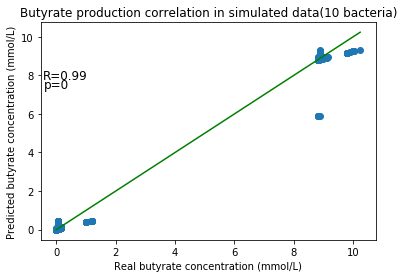

In [34]:

plt.title ('Butyrate production correlation in simulated data(10 bacteria)')  
plt.scatter (x10, y10)  
plt.plot (np.unique(x10), np.poly1d(np.polyfit(x10,y10, 1))(np.unique(x10)), color = 'green')  
plt.xlabel ('Real butyrate concentration (mmol/L)')  
plt.ylabel ('Predicted butyrate concentration (mmol/L)') 
plt.annotate("R=0.99",xy=(2, 9), xycoords='data',
            xytext=(0.3, 8),size=12, va="center", ha="center")
plt.annotate("p=0",xy=(2, 9), xycoords='data',
            xytext=(0.,7.5),size=12, va="center", ha="center")
plt.savefig("Correlation10bact_S.png", dpi=300,bbox_inches='tight')

# 11 bacteria

In [12]:
tr11=pd.read_table(folder + "simulaciones/res_simulations/train_data_simulated/train_11bactS")
tr11

,but,rb1,rb2,rb3,rb4,rb5,rb6,rb7,rb8,rb9,...,rb16.10,rb17.10,rb18.10,rb19.10,rb20.10,rb21.10,rb22.10,rb23.10,rb24.10,rb25.10
0,8.809063,1,0,1,0,0,1,1,1,0,...,1,1,1,0,0,1,1,1,0,0
1,8.856417,1,0,1,0,0,1,1,1,0,...,1,1,1,0,0,0,0,0,1,1
2,8.808495,1,0,1,0,0,1,1,1,0,...,1,1,1,0,0,1,1,1,0,0
3,8.907755,1,0,1,0,0,1,1,1,0,...,1,1,1,0,0,1,1,1,0,0
4,8.808486,1,0,1,0,0,1,1,1,0,...,1,1,1,0,0,1,1,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
58051,0.000000,0,0,1,0,1,1,1,1,0,...,1,1,1,0,0,1,1,1,0,0
58052,0.000000,0,0,1,0,1,1,1,1,0,...,1,1,1,0,0,1,1,1,0,0
58053,0.000000,0,0,1,0,1,1,1,1,0,...,1,1,1,0,0,1,1,1,0,0
58054,0.000000,0,0,1,0,1,1,1,1,0,...,1,1,1,0,0,1,1,1,0,0


In [13]:
X11 = tr11.iloc [:, 1:276].values
y11 = tr11.iloc[:, 0].values

In [14]:
neigh = KNeighborsRegressor(n_neighbors=3)
neigh.fit(X11, y11)
dump(neigh, 'knn_11bact.joblib') 

['knn_11bact.joblib']

In [15]:
from sklearn.model_selection import LeaveOneOut
loo = LeaveOneOut()
loo.get_n_splits(X11)

58056

In [16]:
for i, (train_index, test_index) in enumerate(loo.split(X11)):
    X11_train, X11_test = X11[train_index], X11[test_index]
 #   print(neigh.predict(X_test))
    print(f"{y11[i]}\t{neigh.predict(X11_test)}")
    

8.809063118635722	[8.80867764]
8.856417187478039	[8.82445963]
8.808495290252631	[8.84309634]
8.90775509800842	[8.84158195]
8.808485573334119	[8.80848242]
8.808480845305619	[8.80850122]
8.80848084542221	[8.80848408]
8.80848084535435	[8.80848312]
8.907427902729198	[8.8414632]
8.80848084538721	[8.80848085]
8.80848084535956	[8.80848559]
8.808480845374948	[8.80848653]
8.90742894472908	[8.84146355]
8.80848084536738	[8.80848085]
8.808480845333301	[8.80848085]
8.87824031303024	[8.87826316]
8.878275737258189	[8.87824906]
8.87823113758605	[8.87822941]
8.87827343812484	[8.91123621]
8.87818136688092	[8.87822941]
8.878226309606438	[8.91122822]
8.977209154455071	[8.91122822]
8.878249203191169	[8.91122822]
8.977204067658679	[8.91123621]
8.80848084530966	[8.8414691]
8.80848084535749	[8.80848085]
8.80848084535723	[8.80850286]
8.80848084538144	[8.80848085]
8.90744372902643	[8.84146905]
8.80848084537131	[8.80849218]
8.808480845340949	[8.80849383]
8.80851981360967	[8.80849383]
8.808480845330019	[8.8084938

8.8084808452807	[8.80848085]
8.80848084532174	[8.80848085]
8.808504236442529	[8.80848864]
8.80848084536808	[8.80849383]
8.80852697859268	[8.80849763]
8.80848084532691	[8.8414632]
8.80849681960338	[8.84146996]
8.80853185450624	[8.84151627]
8.80848084529572	[8.80849203]
8.80848756105215	[8.80848806]
8.80848084537447	[8.80848085]
8.808480845321311	[8.80848085]
8.808480845319892	[8.80848308]
8.808480845363249	[8.80848085]
8.808480845372788	[8.8414632]
8.808613434244382	[8.80852504]
8.80848638695375	[8.8414847]
8.87818036933051	[8.87821773]
8.878558883218911	[9.18308122]
8.8782265711341	[8.88122949]
8.878233759519462	[8.87827103]
8.87852195893804	[8.87843048]
8.87825124043464	[8.8782219]
8.87831412416973	[8.87827361]
8.878223171659538	[8.8783186]
8.878201919296869	[8.87824632]
8.87825262333528	[8.91119476]
8.87807284586169	[8.90168349]
8.87827291106817	[8.87828882]
8.87828029105075	[8.87823696]
8.97719326679584	[8.91118524]
8.878295456014591	[8.87827184]
8.87828061706806	[8.87826231]
8.8781

8.8084808454274	[8.80848085]
8.8084808453412	[8.80848379]
8.80848084535955	[8.80848847]
8.80848084540381	[8.8084857]
8.80848084534086	[8.80849332]
8.80850372019587	[8.80849111]
8.808480845369349	[8.80848085]
8.808480845320961	[8.80848085]
8.80849493550134	[8.80848554]
8.80848084534409	[8.80848498]
8.80848704070657	[8.80881413]
8.80947449467121	[8.80881519]
8.80848084534249	[8.80848577]
8.907441608680688	[8.87445577]
8.808583920463231	[8.8085152]
8.80848084534683	[8.80848085]
8.90742790262391	[8.87445012]
8.80848084533252	[8.80848397]
8.808484032843369	[8.80881312]
8.80849561009776	[8.80849025]
8.808497807637359	[8.84147342]
8.80848084539819	[8.8085152]
8.80848084534057	[8.84146885]
8.80848084543931	[8.80850603]
8.80848084535331	[8.80848085]
8.808480845378769	[8.80850339]
8.907452121233518	[8.84148103]
8.808493257247779	[8.80848498]
8.808492858192249	[8.80935175]
8.80848084535998	[8.80848085]
8.808480845299421	[8.88603492]
8.80848084538692	[8.80848085]
8.80848084533855	[8.80851563]
8.80

8.80848241463738	[8.80848137]
8.808488513672948	[8.8084834]
8.8084808453422	[8.80848288]
8.80848084533403	[8.80850448]
8.80848084534153	[8.80848085]
8.809162000848119	[8.80906687]
8.80906846477135	[8.80868259]
8.80848084533873	[8.80848613]
8.808480845302538	[8.80848085]
8.80850202935036	[8.80849115]
8.80848084535858	[8.81206782]
8.8084866132623	[8.80848859]
8.87820573247184	[8.87838487]
9.79240782960534	[9.18294098]
8.88705809503536	[8.88121422]
8.97716958684539	[8.91120524]
8.87822113459784	[8.87831935]
8.97715064279193	[8.91120549]
8.87823988898703	[8.9112078]
8.87990225994829	[8.87882229]
8.87825970641236	[8.87825902]
8.97718136832451	[8.91120656]
8.87824811488817	[8.9017513]
8.878273224068108	[8.87826844]
8.878225067535721	[8.87820419]
8.87825158701489	[8.87824038]
8.8782650016971	[8.95575074]
8.878102584287461	[8.878446]
8.878280550224732	[8.87833577]
8.878155363349151	[8.955661]
8.87820237780148	[8.87822193]
8.87820134884198	[8.8782183]
8.87832462339451	[8.8783223]
8.878864916463

8.87810190450075	[8.87822495]
8.87822018740521	[8.87822881]
8.8781895950427	[8.87820921]
8.87838658837112	[8.87829202]
8.87827684639832	[8.87829171]
9.11298364818817	[8.95647356]
8.87820378515961	[8.87824452]
8.87820162755003	[8.87825409]
8.87817304291626	[8.87816647]
8.87827101293629	[8.8782271]
8.87923540752549	[8.87854505]
8.87819895818692	[8.87821363]
8.88410205636211	[8.91317841]
8.8782667008469	[8.87818966]
8.878244703095039	[8.8781872]
8.878255378086589	[8.87826196]
8.87816841373942	[8.87819588]
8.87822813165216	[8.87823174]
8.87883478122487	[8.87853925]
8.878215446501981	[8.87852636]
8.879549435668679	[8.8786792]
8.87819603949515	[8.87824334]
8.87819126607052	[9.18292763]
8.878173451491929	[8.95566664]
8.87827533180416	[8.87823404]
8.87826091275016	[8.8782777]
8.87829657795314	[8.87822511]
8.87816070755546	[8.87822526]
8.87819540667635	[8.87823778]
8.87827225967887	[8.87826452]
8.878229203649699	[8.87823315]
8.87821111441356	[8.87820559]
8.87822949998477	[8.87822801]
8.87820164

8.80848084535462	[8.80848894]
8.80848084540122	[8.80848557]
8.808480845345569	[8.80848859]
8.8084808453622	[8.80848186]
8.808495009887169	[8.80848557]
8.80848084536786	[8.80848085]
8.80848084538953	[8.80848398]
8.80848084536098	[8.80848085]
8.80848632498928	[8.84146502]
8.808480845322538	[8.80848303]
8.90742790276612	[8.8744492]
8.90743886641748	[8.90743565]
8.808480845325901	[8.84146821]
8.80849274292069	[8.80848481]
8.80848084534677	[8.8416822]
8.808480845345171	[8.80848955]
8.80848084538085	[8.8088636]
8.809629111965972	[8.80886564]
8.80850223591904	[8.80849167]
8.907443329311539	[8.84147628]
8.808480845386528	[8.80848849]
8.808493109864552	[8.80934533]
8.80848084534808	[8.80848085]
8.80850408768048	[8.80848859]
8.8084839033716	[8.808485]
8.80848084538022	[8.80848557]
8.808480845361698	[8.80848859]
8.808490253283859	[8.808485]
8.808480845350868	[8.80848085]
8.90742790258567	[8.84146502]
8.80848738876575	[8.80849067]
8.808480845366251	[8.80848288]
8.808486963913051	[8.80886564]
8.808

8.97705976901649	[8.91115572]
8.878208068133839	[8.87819461]
8.87834598535818	[8.91126308]
8.87818882821291	[8.87823017]
8.878258201490919	[9.25264955]
8.87832397800207	[8.87848668]
8.87820849378409	[8.87823264]
8.878241127588769	[8.87823667]
8.878197524752029	[8.91120397]
8.87829516678849	[8.87825668]
8.87823359027707	[8.87826376]
10.0015135398441	[9.28565015]
8.878949271342039	[8.8784766]
8.87822027604246	[8.87820916]
8.878207383846561	[8.87823319]
8.977165601727359	[8.91118528]
8.87828392069603	[8.87824426]
8.87826634677837	[8.87825176]
8.87818665502566	[8.87823558]
8.87824198315397	[8.87822963]
8.87825117623241	[8.8783722]
8.87820796023239	[8.87817769]
8.87848332963289	[8.87833408]
8.87820231480909	[8.87822036]
8.87829560919056	[8.87825955]
8.87823982712394	[8.87824324]
8.87843695980133	[8.89024183]
8.87827164809503	[8.87824624]
8.87825707183639	[8.87864185]
8.878262739739199	[8.87826794]
8.87819227121213	[8.87823937]
8.87824410122506	[8.87816844]
8.87821889254065	[8.87823226]
8.87

8.87821066597666	[8.8782219]
8.87819572215756	[8.87824051]
8.87824181935616	[8.87823469]
8.87820450917666	[8.87817675]
8.878226592842381	[8.91220923]
8.8781606389124	[8.87822448]
8.87825541359809	[8.87850031]
8.87832259296168	[8.87823507]
8.8782339030073	[8.87820249]
8.87902528298323	[8.87852617]
8.87816735614883	[8.87822759]
8.87829152414055	[8.87823975]
8.87818891790871	[8.87824024]
8.87822229151985	[8.87823862]
8.878282421559721	[8.87826244]
8.87851466734159	[8.87834062]
8.87825732819702	[8.8782849]
8.87824505078398	[8.87824007]
8.87824236123847	[8.87823416]
8.8781761750434	[8.87821194]
8.87826541678877	[8.87874889]
8.8782852884999	[8.87829035]
8.878193357518118	[8.91134007]
9.79239540044027	[9.21591975]
8.980128848748269	[8.91221591]
8.87827891213251	[8.8782175]
8.8782202221728	[8.87825782]
8.87821524803623	[8.87824355]
8.87821293838307	[8.87824192]
8.87829782290823	[8.87851444]
8.87819281746691	[8.87819181]
8.87819404599574	[8.87821317]
8.87822443378912	[8.87821151]
8.878183305545

8.80848586486946	[8.80848445]
8.808480845349779	[8.80848085]
8.808480845349271	[8.80865334]
8.80869220611825	[8.80857544]
8.80848084529739	[8.80848085]
8.808480845384778	[8.80848085]
8.80849133788278	[8.80848434]
8.80848084535256	[8.80849011]
8.80848084538851	[8.8414632]
8.90744618859409	[8.84147184]
8.808480845368189	[8.80848544]
8.80848084530588	[8.80848085]
8.8084808453452	[8.84147003]
8.808480845344981	[8.80929574]
8.808480845315652	[8.84146585]
8.907446619368189	[8.84147489]
8.80849682113074	[8.80849418]
8.808498727119801	[8.81095543]
8.80852473925091	[8.80849548]
8.80848084536653	[8.80849376]
8.80854737309788	[8.80850302]
8.808490412008188	[8.80848597]
8.90742790264083	[8.8414632]
8.808585354003311	[8.80868817]
8.8084808453095	[8.80850498]
8.80849863461018	[8.80848678]
8.80849012418719	[8.80848394]
8.80848084541499	[8.84147003]
8.808662635763019	[8.80935634]
8.80849872080627	[8.8414718]
8.808480845358039	[8.8084863]
8.80848084533151	[8.80848885]
8.915071191070618	[8.84402046]
8.8

8.809077760830231	[8.80868247]
8.80851122215539	[8.80849097]
8.80848084536263	[8.84147993]
8.80850864859822	[8.80849011]
8.808512721448858	[8.80849746]
8.808480845278599	[8.8414632]
8.80849387199265	[8.8084886]
8.80851502360512	[8.8420439]
8.907427902757311	[8.8414632]
8.813618618258241	[8.81019344]
8.8084808453524	[8.88594188]
8.80852473927383	[8.80851303]
8.808480845345109	[8.84151185]
8.8084808453324	[8.80848085]
8.80849385279642	[8.80849775]
8.808487331062679	[8.84157327]
9.040965891013	[8.88917233]
8.8084808453459	[8.8084856]
8.80853686786484	[8.80849952]
8.80848084538063	[8.80849141]
8.808480845338481	[8.8084835]
8.808526650837289	[8.80851426]
8.81079677024426	[8.80925282]
8.8084918456491	[8.80848451]
8.80848084532691	[8.80848642]
8.80848084533325	[8.80848085]
8.808480845329118	[8.80848085]
8.80848084538205	[8.80848716]
8.80848084529749	[8.84148224]
8.80848084536536	[8.80848085]
8.80848084533595	[8.80848964]
8.808480845405038	[8.80848808]
8.912268002059381	[8.84309152]
8.80848084

8.8085316115489	[8.80851426]
8.808480845367471	[8.80925282]
8.80848084534623	[8.80848451]
8.80849757174384	[8.80848642]
8.808480845359359	[8.80848085]
8.80848084540311	[8.80848085]
8.80848084533441	[8.80848716]
8.907485033802661	[8.84148224]
8.80848084531965	[8.80848085]
8.808480845394651	[8.80848964]
8.80848084531031	[8.80848085]
8.80848084530546	[8.80891514]
8.80848597783298	[8.80874961]
8.808488024144118	[8.80848324]
8.808486207454939	[8.80848263]
8.808488478029268	[8.84146868]
8.80849911446185	[8.80872925]
8.80849856671449	[8.80849175]
8.80848084535808	[8.80848437]
8.80848084532241	[8.80848085]
8.80848084537715	[8.80854672]
8.808480845425132	[8.80848085]
8.80848084539187	[8.80848085]
8.80853789317295	[8.80850536]
8.8085024463349	[8.84147198]
8.80850841277496	[8.80850467]
8.80848084535102	[8.80848377]
8.80852473926515	[8.84149795]
8.808490545072699	[8.80848408]
8.808550417693349	[8.88599335]
8.808538116257449	[8.80878117]
8.808480845392051	[8.80868104]
8.80848084532936	[8.80848085]


8.81006998144489	[8.80919799]
8.80848084530825	[8.80849337]
8.80848084540003	[8.841556]
8.808545606710949	[8.80991233]
8.808480845359382	[8.80848085]
8.80848084537293	[8.81140798]
8.808480845368141	[8.88580136]
8.80848084534705	[8.80848596]
8.80848084534285	[8.80848085]
8.80848084532789	[8.80848151]
8.80852955682827	[8.80850254]
8.808480845333438	[8.80848267]
9.040852057904699	[8.88594469]
8.87820362524859	[8.87819663]
8.87821728738157	[8.87823674]
8.878168989106179	[8.8781878]
8.87830598758737	[8.8782789]
8.87828929634617	[8.87822791]
8.87817713443407	[8.87821181]
8.878308976199449	[8.8782599]
8.8782894705021	[8.87824251]
8.878164737335132	[8.87823622]
8.878221735736858	[8.87821201]
8.8782618410076	[8.87823577]
8.87818453460107	[8.87824493]
8.87828841801934	[8.87824463]
8.878260936712561	[8.87828248]
8.878234943186118	[8.8782095]
8.878228811219131	[8.87825411]
8.87829856446525	[8.87825411]
8.87829703423324	[8.87828213]
8.878293726186909	[8.87838384]
8.878639952515869	[8.87838262]
8.87

8.80848084535355	[8.80864309]
8.80848137156467	[8.80849728]
8.80887694113615	[8.80861792]
8.80848084534569	[8.80848085]
8.808485205206448	[8.80848592]
8.80848084532881	[8.80848085]
8.80850221920884	[8.80849569]
8.808480845351431	[8.80848085]
8.80848084534448	[8.80848085]
8.80848084533894	[8.80875393]
8.80848084534416	[8.80848204]
8.80848084532452	[8.80848085]
8.808502045622491	[8.80848791]
8.80851227230824	[8.80849132]
8.80848084539258	[8.80849132]
8.808512266157619	[8.80849597]
8.80848084534646	[8.8414632]
8.80848084532552	[8.80848085]
8.80848084531075	[8.80849132]
8.80850596697819	[8.80855556]
8.80848084531382	[8.80848085]
8.808480845329811	[8.80849628]
8.808480845366109	[8.80848085]
8.80848135441061	[8.80855214]
8.907427902647001	[8.84153028]
8.80848084535706	[8.80854575]
8.8084808453579	[8.80848085]
8.808480845381471	[8.80848509]
8.80849492569739	[8.80849042]
8.80848084539701	[8.80849894]
8.80848084536675	[8.80848085]
8.808482826117551	[8.80850716]
8.80848084531544	[8.84146866]
8.8

8.97718660019675	[8.91119699]
8.87864764815825	[8.88034209]
8.8781907337462	[8.87820783]
8.87821304588547	[8.87824282]
8.87824399051053	[8.87824979]
8.87826304960093	[8.87874519]
8.87820476827275	[8.87830493]
8.87822130825437	[8.87823402]
8.87976772295986	[8.87891426]
8.87824520020356	[8.9442008]
8.87824778551273	[8.87832748]
8.87823085094122	[8.87823117]
8.87825968711266	[8.87823219]
8.87827061504475	[8.87831419]
8.878232290625311	[8.87822906]
8.87821209531302	[8.87825152]
8.878441006504461	[8.87832626]
8.87816400625606	[8.87817081]
8.878283873253029	[8.87824726]
8.878339778265259	[8.87826415]
8.87831899929541	[8.87830508]
8.87827833974978	[8.87827472]
8.87811818182602	[8.87823435]
8.878240595012901	[8.87826105]
8.87822961504701	[8.87822677]
8.87825118080497	[8.87824178]
8.87823605346348	[8.87826634]
8.87831500982828	[8.87826363]
8.878204184218609	[8.87819332]
8.87823253136254	[8.87822864]
8.878290453975609	[8.87829905]
8.87835456366161	[8.87828283]
8.878230379655982	[8.87822843]
8.87

8.97719356558248	[8.94420525]
8.87819483368592	[8.91119055]
8.878189613639279	[8.87818747]
8.87825284803675	[8.91121459]
8.97713496025119	[8.91119779]
8.878219655621	[8.91121905]
8.87823691700554	[8.87823734]
8.97716932536302	[8.94418675]
8.97717373910341	[8.91119503]
8.87819735229697	[8.91120651]
8.87827323456157	[8.91121642]
8.878192106120599	[8.87824777]
8.87832588538682	[8.95556527]
8.87842566858413	[8.87831287]
8.878288892470461	[8.91123018]
8.87833005753145	[8.87826931]
8.8782137398882	[8.87824824]
8.878251363755421	[8.87828373]
8.87815362824015	[8.87821672]
8.87830318940004	[8.88229814]
8.87835986375434	[8.87826009]
8.878299303175618	[8.87959246]
8.87820597068974	[8.87819864]
8.878211486499449	[8.87824658]
8.878288508302221	[8.87826353]
8.97719744509698	[8.91120241]
8.878201746523471	[8.91122333]
8.878185548030391	[8.87823257]
8.878156454109618	[8.87816821]
8.87824930911102	[8.87823303]
8.87824757204334	[8.8782227]
8.97717029281266	[8.91117452]
8.87816754027221	[8.91120944]
8.87

8.8084808453844	[8.80848667]
8.80848556537254	[8.84147175]
8.808480845357211	[8.8414632]
8.80851565705205	[8.80850544]
8.80848084535368	[8.80964112]
8.80848084535743	[8.80850272]
8.80848084531688	[8.80848994]
8.80849565373676	[8.80849458]
8.8084808453587	[8.80848085]
8.8084808452691	[8.88593897]
8.808490445913051	[8.80931782]
8.81218227159061	[8.80971465]
8.80849525844698	[8.80849283]
8.80849753111542	[8.80848641]
8.80848084536805	[8.80849661]
8.808480845327448	[8.80868639]
8.80929300735947	[8.8096718]
8.90742790250109	[8.87444555]
8.80848084533561	[8.80848085]
8.90755737544718	[8.84150636]
8.809960374025811	[8.82456791]
8.80849738623002	[8.84172333]
8.80848084537798	[8.80848085]
8.809569412275259	[8.8088437]
8.80848084531422	[8.8085053]
8.80848084535114	[8.80848405]
8.80848084533528	[8.80971465]
8.808480845372241	[8.80848565]
8.80848084535103	[8.80848641]
8.80852814617437	[8.80851264]
8.809097469278822	[8.80869135]
8.811239689508518	[8.80967118]
8.90742790269299	[8.87444555]
8.8084808

8.80849004213977	[8.80940904]
8.80848084536316	[8.80849548]
8.808480845361919	[8.80854011]
8.80855421941408	[8.918967]
8.808480845358721	[8.80931824]
8.808480845329859	[8.80848085]
8.80848084533908	[8.80849213]
8.808480845280279	[8.80848085]
8.808528937860881	[8.80849688]
8.8084957431335	[8.80905831]
8.8084808453332	[8.80848146]
8.80848084536358	[8.80848653]
8.80848084524731	[8.80848603]
8.80943702425769	[8.80898117]
8.80848084539351	[8.80929036]
8.808816696414171	[8.80911692]
8.80848084534709	[8.80848085]
8.808501019780222	[8.80848757]
8.878240228653551	[8.87822006]
8.87822932592832	[8.87823566]
8.97716524178797	[8.91117824]
8.87822591066568	[8.87822202]
9.110591921101731	[9.02165595]
8.878210075256199	[8.88583283]
8.87818285280435	[8.87821733]
8.87819820650553	[8.87821712]
8.87822531802522	[8.88013857]
8.87821118426267	[8.8781851]
8.87820678339576	[8.87819787]
8.878131227005731	[8.87821745]
8.87820847671815	[8.87822057]
8.87825698434202	[8.87826857]
8.878225990143278	[8.8916933]
8.87

8.878187080724901	[8.87822935]
8.87981341316798	[8.87875503]
8.878243503341169	[8.8782425]
8.87822236950874	[8.87821558]
8.87815476106223	[8.87819174]
8.87814775488385	[8.87820608]
8.87817325659816	[8.91119105]
8.878202434711561	[8.87819248]
8.878242645490849	[8.87821021]
8.87829756621032	[8.87820983]
8.87823389090433	[8.85502119]
8.87817546930089	[8.8782402]
8.87823129095066	[8.87821804]
8.8782146260481	[8.87823166]
8.87829265030284	[8.87827512]
8.87827693834507	[8.87825688]
8.87819934978961	[8.87818934]
8.878198759163961	[8.89612132]
8.87826468185383	[8.87825522]
8.878182913711711	[8.87821153]
8.87822529922122	[8.87823643]
8.87821914786819	[8.87822364]
8.87821546372951	[8.87873726]
8.87826112175968	[8.87824331]
8.87821840490775	[8.87821771]
8.87820896721921	[8.87819833]
8.87827113559017	[8.87821327]
8.87820820710772	[8.87822952]
8.87824907567212	[8.87822397]
8.87829619040695	[8.87826731]
8.87819548615483	[8.87824073]
8.87822090836784	[8.87823046]
8.87821656002647	[8.87820966]
8.87819

8.878171774126711	[8.87823621]
8.87819130302808	[8.87823798]
8.87824001039442	[8.87823604]
8.87859018962381	[8.9114307]
8.87831075796445	[8.87826623]
8.87822167664607	[8.87824509]
8.878232453211961	[9.25261412]
8.87828516793256	[8.87826347]
8.87834597142544	[8.8784639]
8.878209951989339	[8.87830872]
8.88488277440307	[8.88043063]
8.878255531373402	[8.87827622]
8.878651627744471	[8.87835485]
9.110654890567229	[8.95570864]
8.87822298010514	[8.87825659]
8.87811828979319	[8.87830584]
8.87825515069115	[8.95570494]
8.87812849717492	[8.87820362]
8.9074668511382	[8.84147618]
8.80878790019186	[8.80938595]
8.808484609946051	[8.86007404]
8.80848084536909	[8.80848085]
8.808480845411859	[8.80848647]
8.907427902779949	[8.84146922]
8.808480845350038	[8.81244881]
8.808484577222659	[8.80850216]
8.808480845365311	[8.80848085]
8.808480845314199	[8.80848085]
8.808480845321581	[8.80848976]
8.82233160442515	[8.81320147]
8.80849105348928	[8.80848704]
8.808931641456232	[8.80863771]
8.80848084531939	[8.80849438

8.808480845303029	[8.80848647]
8.808497714111331	[8.80848647]
8.808498922112891	[8.84146922]
8.81905892115978	[8.81200687]
8.8085410692119	[8.80850216]
8.80848084535919	[8.80848085]
8.808480845324882	[8.80848085]
8.80850759631291	[8.80848976]
8.80879195856798	[8.81320147]
8.80848922521891	[8.80866623]
8.80850065033417	[8.80863771]
8.80849314993671	[8.80849731]
8.8085666172644	[8.80854652]
8.80848084532907	[8.80850576]
8.8084808453589	[8.8084862]
8.80848084541774	[8.86789254]
8.80848084532942	[8.80849383]
8.808496923000831	[8.80914576]
8.88776887227934	[8.83491064]
8.80848084534591	[8.80848134]
8.8084808453373	[8.80848085]
8.80848084537526	[8.8084847]
8.80848670396245	[8.80848786]
8.80848084532516	[8.8084828]
8.808498450827921	[8.80853161]
8.80848084532341	[8.80848361]
8.808480845334222	[8.80848085]
8.80857633370973	[8.8126906]
8.80848084535196	[8.8084865]
8.808499898719539	[8.8084872]
8.8084808453631	[8.80848085]
8.80850282548776	[8.80848817]
8.80867406402866	[8.80855376]
8.80848629455

8.80848084540165	[8.80918338]
8.809237419339961	[8.84171539]
8.808480845362439	[8.80848085]
8.80849832028418	[8.80848901]
8.808480845359279	[8.8961287]
8.80849253465013	[8.80852477]
8.80848084532025	[8.80849963]
8.839036566378722	[8.8959866]
8.80860093997066	[8.80863159]
8.80853527097567	[8.80849899]
8.80910137482353	[8.80868769]
8.80848084534992	[8.81025378]
8.80849492579435	[8.80848554]
8.80848084536377	[8.80848085]
8.80848084540038	[8.80848218]
8.81058845638905	[8.80918338]
8.90742790272365	[8.92551898]
8.808480845374051	[8.80848085]
8.8084878742721	[8.80850197]
9.04086868516227	[8.96326397]
8.80848084537054	[8.80859156]
8.80851970996942	[8.80849614]
9.040442380263778	[8.97344921]
8.80880129239526	[8.80862769]
8.80848084537217	[8.80858879]
8.80849154089761	[8.80850368]
8.809750721725768	[8.80891125]
8.808480845352811	[8.8414632]
8.808480845351431	[8.8414723]
8.90745522408057	[8.8414723]
8.80910857424124	[8.80869009]
8.80849999146247	[8.80850019]
8.81055481514879	[8.84215452]
8.80848

8.90744391225417	[8.84147175]
8.8084808453437	[8.8414632]
8.808519814011019	[8.80850544]
8.808480845344018	[8.80964112]
8.80848084534989	[8.80850272]
8.80849458986336	[8.80848994]
8.80850723467932	[8.80849458]
8.80848084539895	[8.80848085]
8.80848084536365	[8.88596343]
8.808871765105529	[8.80944493]
8.809910192428921	[8.80895729]
8.808480845304	[8.80848803]
8.808480845373039	[8.80848085]
8.808480845363789	[8.80849688]
8.80848084539558	[8.80848581]
8.8084808453163	[8.80848146]
8.80848084533085	[8.80848085]
8.80850114639387	[8.80848761]
8.80848084529269	[8.80848085]
8.808498064897462	[8.82417314]
8.808480845344189	[8.80940904]
8.80852473928027	[8.80849548]
8.80849041195351	[8.80854011]
8.90749157815044	[8.918967]
8.80849170264602	[8.80931824]
8.80848084532676	[8.80848085]
8.80849316533217	[8.80849213]
8.808480845378211	[8.80848085]
8.808480845403288	[8.80849688]
8.81019832911818	[8.80905831]
8.80848084534459	[8.80848146]
8.80849789948501	[8.80848653]
8.808496391292948	[8.80848603]
8.8090

8.87820847986905	[8.87823851]
8.87823426856265	[8.87822677]
8.87818981721832	[8.87820542]
8.87818984378207	[8.91120128]
8.87821573866258	[8.87820609]
8.8783208763816	[8.88745059]
8.878262813026641	[8.8782212]
8.878255089832779	[8.87821737]
8.8782395541959	[8.91122383]
8.878818687367609	[8.87841084]
8.878220544169029	[8.87827036]
8.878237864215	[8.87822156]
8.878231954967449	[8.87823416]
8.878203948634141	[8.87824432]
8.87816297851573	[8.87819822]
8.87822222492684	[8.87824128]
8.878246869697211	[8.87835187]
8.87837086811912	[8.88040553]
8.977225604689519	[8.91120717]
8.87824757306833	[8.87821484]
8.878277481940689	[8.87824053]
8.878262556813151	[8.87824273]
8.87832135687927	[8.87954987]
8.87821169765911	[8.89216452]
8.878295671041052	[8.87821246]
8.90575696746599	[8.88758251]
8.87826666660797	[8.87824893]
8.878245715311449	[8.87826242]
8.97721788390381	[8.91123057]
8.878212085639689	[8.87841572]
8.87827494009741	[8.87824012]
8.8782064813331	[8.87824583]
8.87820836087711	[8.87823135]
8.8

8.80848084533865	[8.80848365]
8.808501687313061	[8.80848987]
8.80848084534632	[8.80848779]
8.808531988660539	[8.80849789]
8.808480845391411	[8.80916792]
8.80848084536133	[8.80849789]
8.80848084536308	[8.80848085]
8.81054208293203	[8.80916792]
8.80848084535803	[8.80848085]
8.808480845363189	[8.80848085]
8.808480845347699	[8.80848085]
8.80848084536057	[8.80848741]
8.80882791357056	[8.80859653]
8.80848084536556	[8.80859653]
8.80848084531973	[8.80848085]
8.808480845335259	[8.80848085]
8.80848932409209	[8.808504]
8.80848084534314	[8.80848085]
8.80848084535196	[8.80859653]
8.80848084540192	[8.80848085]
8.80848084535463	[8.80848085]
8.80848084536227	[8.80848085]
8.80851009154976	[8.80849409]
8.808480845335712	[8.80848245]
8.808485049600142	[8.84160941]
8.80848084533321	[8.80848644]
8.808634247746609	[8.80854588]
8.808480845345711	[8.80848085]
8.808772542880009	[8.8085862]
8.808636200848369	[8.8085657]
8.808495051090189	[8.8085657]
8.80906580161824	[8.84190665]
8.80848084531533	[8.80877303]
8.

8.80848084533535	[8.84146985]
8.8084808453456	[8.80848625]
8.9074429731096	[8.84146822]
8.80848364806766	[8.80916604]
8.80848084532958	[8.80848085]
8.80848084536783	[8.84148291]
8.808480845390848	[8.80848494]
8.90742790262603	[8.8414632]
8.80848084535394	[8.8084878]
8.80848084528435	[8.80915234]
8.808493396345801	[8.80849053]
8.80848084528883	[8.80848635]
8.808491984015431	[8.80848456]
8.80848699768766	[8.8084829]
8.808480845391589	[8.81261683]
8.80848084536496	[8.80848587]
8.80850654648546	[8.80849739]
8.82088879192614	[8.81261683]
8.80849592411219	[8.80849271]
8.80848084533925	[8.80848941]
8.808480845363562	[8.80848971]
8.808480845314289	[8.80848085]
8.80848084536852	[8.80849174]
8.80968908597473	[8.80893926]
8.80848270581866	[8.80861238]
8.8084808453698	[8.80848085]
8.8084980614695	[8.8084936]
8.80849090738318	[8.8084842]
8.80848084528185	[8.80848085]
8.808480845401641	[8.80848085]
8.80848084534712	[8.80848085]
8.80848084538327	[8.80852936]
8.8084808453765	[8.80848085]
8.80848084532

8.808480845368411	[8.80848085]
8.8084919254445	[8.80853305]
8.808480845310429	[8.80848085]
8.80848084534805	[8.80848196]
8.808480845337881	[8.80848085]
8.8084808453395	[8.80848085]
8.808480845314259	[8.80848512]
8.808492586499302	[8.84147242]
8.808480845294788	[8.8268883]
8.80850904865104	[8.80849025]
8.80851474742149	[8.80849509]
8.80848084528401	[8.8414632]
8.80848084537106	[8.80850194]
8.80848084534767	[8.80917512]
8.80849640132487	[8.80848603]
8.81518419442932	[8.81091019]
8.808493126897869	[8.80848494]
8.90742790268374	[8.84188557]
8.80848084534351	[8.80848573]
8.808480845352829	[8.80848676]
8.80974796739532	[8.84188557]
8.80849549521651	[8.80848573]
8.80848084529854	[8.80852151]
8.8787821101515	[8.87848754]
8.87823468624898	[8.87827396]
8.87824197788014	[8.87824069]
8.878272147008119	[8.87825708]
8.87825830472244	[8.87824894]
8.87832291387196	[8.87827423]
8.87968668328963	[8.91168818]
8.878136239491552	[8.87822203]
8.87813215517065	[8.87821223]
8.87819193973632	[8.95568636]
8.878

8.80848084534497	[8.8428275]
8.808480845386711	[8.80848085]
8.80849305366466	[8.808489]
8.80848474238286	[8.80868638]
8.808488250137	[8.80940627]
8.8782049593829	[8.87924718]
8.87928805501075	[8.87861378]
8.87834857166925	[8.87825683]
8.87820476280993	[8.87823554]
8.87823157963991	[8.87823545]
8.878186937039779	[8.87822474]
8.87825992353937	[8.87823815]
8.87822765147839	[8.87822683]
8.878236565632381	[8.87822364]
8.87827284137175	[8.87826925]
8.878265135270981	[8.87828084]
8.87829211538491	[8.878587]
8.8782285527606	[8.87824841]
8.87831295519242	[8.87830571]
8.879254754740789	[8.91163233]
8.87822105347787	[8.87847049]
8.87826211791839	[8.87826074]
8.878241414698211	[8.8782692]
9.110219513861999	[8.95559454]
8.878454266994789	[8.87832773]
8.87821866070844	[8.8782311]
8.8782282216182	[8.87820819]
8.87827341396199	[8.87827107]
8.87818477345265	[8.87818189]
8.878221676489499	[8.87826652]
8.87827664645982	[8.91277566]
8.87815192653771	[8.87818853]
8.87824643107744	[8.87821426]
8.87817769557

8.97714808691591	[8.92723099]
10.0014861471364	[9.25268267]
8.87815238709776	[8.87821766]
8.878308020018359	[8.87824329]
8.87819752050495	[8.95573709]
8.87827580639344	[8.87823849]
8.8782375354024	[8.87827271]
9.11242620042816	[8.95628497]
8.878247007285651	[8.87824365]
8.87827866618719	[8.87936048]
8.878188719578741	[8.87820862]
8.8781685593308	[8.87826468]
8.87830331691723	[8.87826614]
8.878375668818551	[8.95571599]
8.87821122012204	[8.87820874]
8.89241631497185	[8.88296149]
8.87824020230302	[8.87819639]
8.878212326011608	[8.8782512]
8.87824079092919	[8.87823883]
8.87817706561567	[8.87823788]
8.87828106291832	[8.87828515]
8.87817185398071	[8.87827006]
8.87824049174049	[8.8782466]
8.87825302091297	[8.87820203]
8.878227799076381	[8.95561511]
8.87825533205801	[8.87824538]
8.87827974897636	[8.87822147]
8.87828391586911	[8.87824113]
8.87828610106803	[8.87823244]
8.87828728471768	[8.8782546]
8.9771871756414	[8.91123739]
8.8782194482409	[8.91122418]
8.87817110371507	[8.87822111]
8.878333033

8.87817072671917	[8.87820203]
8.878246489723539	[8.87826354]
8.878263172134009	[8.87821585]
8.87822365565597	[8.91119738]
8.8782009394971	[8.87819442]
8.87829357645956	[8.91125918]
8.87829723875647	[8.95556708]
8.87828447704742	[8.95557408]
8.87829540428001	[8.8782948]
8.87828183165692	[8.87826656]
8.878174496334669	[8.95565096]
10.0014677817706	[9.25263467]
8.87821150356706	[8.89351698]
8.878260868662212	[8.87825712]
8.878299071521651	[8.87823189]
8.808480845389381	[8.85497213]
8.878156702374971	[8.95572434]
8.97711723484476	[8.94435748]
8.87822320136803	[8.87852308]
8.97716843039071	[8.9112053]
8.878225332457019	[8.87826676]
8.87825789426157	[8.87838444]
8.878156799991679	[8.91117833]
8.878211212955518	[8.87822376]
8.8782463647951	[8.87822932]
8.97723174702186	[8.91127108]
8.87822770275806	[8.87829239]
8.878203850738819	[8.87824757]
8.87829992481255	[8.87828514]
8.87829318538403	[8.87824977]
9.11054804862732	[8.95564488]
8.878208687262461	[8.91119983]
8.87820939764193	[8.878236]
8.87

9.04085205786496	[8.88593792]
8.808480845368631	[8.84146492]
8.80848084538293	[8.80848221]
8.80848084531857	[8.80848085]
8.80848602440468	[8.80848512]
8.80848494784893	[8.80848221]
8.8084808453457	[8.80848085]
8.80848084538228	[8.80848558]
8.80848084534833	[8.82075434]
8.80848084534909	[8.88594196]
8.808480845395051	[8.80848085]
8.808494879486519	[8.80848552]
8.80848084535949	[8.80848085]
8.808480845404551	[8.80887175]
8.80848084535003	[8.80848552]
8.80849079136843	[8.80851137]
8.80848084529501	[8.8084852]
8.80848084530465	[8.88580136]
8.80848084528409	[8.80848182]
8.80848084536361	[8.80848085]
8.80848084538131	[8.80848085]
8.80848084534807	[8.80848085]
8.80848084536823	[8.80848085]
8.808480845338199	[8.80848569]
8.80852903655148	[8.88583041]
9.040481335683511	[8.885831]
8.80848084530593	[8.80848377]
8.80849718680931	[8.84146864]
9.04044238019647	[8.88580136]
8.845301339282472	[8.82075434]
9.040864199578472	[8.88594196]
8.80848084534426	[8.80887175]
8.80848084535479	[8.80848552]
8.8084

8.80848084534653	[8.8414632]
8.80848084535235	[8.80848085]
8.808494142394279	[8.80848646]
8.80848084533868	[8.84146633]
8.80848084534242	[8.80849774]
8.80848084542842	[8.80849902]
8.808480845353051	[8.80848085]
8.8084808453615	[8.80858522]
8.80848084538709	[8.80848085]
8.80848084537825	[8.80848085]
8.80848084539173	[8.8414632]
8.808480845348779	[8.80848085]
8.808595519279491	[8.80851995]
8.808493409638269	[8.84186944]
8.812416234430382	[8.80979264]
8.80848084538185	[8.80848085]
8.80848084534188	[8.8414632]
8.80848084534415	[8.80848085]
8.80848084535374	[8.80848085]
8.80849266926781	[8.80848623]
8.808480845390509	[8.80849827]
8.80849304047308	[8.80849007]
8.80848438348915	[8.80849038]
8.80848084537354	[8.8414762]
8.80848984710108	[8.80848963]
8.80853536054019	[8.80849902]
8.80848084529	[8.8085924]
8.80848084534728	[8.80848085]
8.80848084537438	[8.80848085]
8.80848084537285	[8.80848085]
8.80848084534305	[8.80848475]
8.80848084535587	[8.80848085]
8.80848084531843	[8.81370998]
8.8084808453

8.90746691665485	[8.87446169]
8.80849821067587	[8.80850353]
8.8084808453406	[8.80849902]
8.80881552164194	[8.8085924]
8.80848084534966	[8.80858522]
8.80848084535357	[8.80848085]
8.808480845368221	[8.80848085]
8.80849255574747	[8.8414671]
8.808480845331289	[8.80848085]
8.80873035486168	[8.80856402]
8.808500522056429	[8.80851077]
8.808480845412632	[8.88580544]
8.80848546241291	[8.80849409]
8.808480845372241	[8.8414632]
8.808480845395382	[8.84147192]
8.80848084538702	[8.80848423]
8.90742790264197	[8.87461128]
8.80849095024368	[8.84149119]
8.80848084537457	[8.84146598]
8.82032083128483	[8.81243808]
8.80848084533284	[8.80848604]
8.80848084534222	[8.80848576]
8.8084808453743	[8.80848085]
8.90742790256549	[8.8414632]
8.808480845320892	[8.89313788]
8.80854631877859	[8.80850267]
8.80848084535775	[8.8084919]
8.80848084536475	[8.80848085]
8.8084808453081	[8.8086371]
8.80848235037889	[8.80848135]
8.808480845407939	[8.80848085]
8.80894962392124	[8.8086371]
8.80848084535902	[8.80848303]
8.8084808453

8.80849958458642	[8.80869183]
8.90742790274744	[8.84157048]
8.80849624000231	[8.80848598]
8.80848084538548	[8.80848085]
8.808480845319641	[8.80848513]
8.809506415059909	[8.80886155]
8.80909504557453	[8.80870071]
8.80848084536065	[8.8414632]
8.808480845334039	[8.80848598]
8.808480845383249	[8.80848085]
8.808480845359849	[8.80848085]
8.80850319219113	[8.80985259]
9.891354838434511	[9.21601178]
8.87830538173773	[8.87829752]
8.878228833026089	[8.8782363]
8.87819234958201	[8.87822277]
8.87825486387266	[8.87821022]
8.97719994105203	[8.91123324]
8.878583178680438	[8.91132035]
8.87825313001924	[8.878261]
8.87819333216517	[8.8782332]
8.87832150919106	[8.98865428]
8.878094809792971	[8.87819076]
8.87833604531056	[8.87833766]
8.878209708766802	[8.85715498]
8.89391731387434	[8.88346639]
8.87822774974113	[8.87828822]
8.878237216479539	[8.87823534]
8.878326055374089	[8.87823727]
8.878274219949619	[8.87824535]
8.9771187973149	[8.98863734]
8.878236449207439	[8.87836723]
8.87828357079801	[8.87827022]
8.

8.878268411894119	[8.87823]
9.11064612888284	[8.95577424]
8.87824250140668	[8.91123139]
8.878457986719411	[8.87833791]
8.87822055131951	[8.8782316]
8.878855217124949	[8.87847304]
8.8781227790562	[8.87892203]
8.87832263647216	[8.87821603]
8.878180311308052	[8.87825537]
8.88048317080506	[8.87894415]
8.878161357819689	[8.87875737]
8.878288093748811	[8.87825084]
8.87824354864126	[8.8782341]
8.87822443020498	[8.87824049]
8.87826270147744	[8.87821876]
8.87818227285331	[8.87825378]
8.878235981226501	[8.87819156]
8.87823009252426	[8.87825974]
8.87814190756177	[8.87821929]
8.87822028133857	[8.87825693]
8.87975570969346	[8.87951135]
8.87823194257971	[8.8782543]
8.87822186372034	[8.87819832]
8.8782564554058	[8.91123859]
8.87828024044231	[8.95581279]
9.11065413434236	[9.03330245]
8.97718226411994	[8.91192945]
9.11020296368482	[8.95557133]
9.11021107547514	[9.03302069]
8.87820577992481	[8.87823793]
8.87814591786877	[8.91115803]
8.878230814088239	[8.9112386]
8.878208122872	[8.87826839]
8.87823299026

8.878114924307859	[8.88218722]
8.878213540503198	[8.91200547]
8.87834795665722	[8.87825942]
8.87816779066867	[8.87827208]
8.878193034365712	[8.87821258]
8.87820915457173	[8.87824946]
8.87843735034485	[8.87827004]
8.87823254054052	[8.878208]
8.87822480159119	[8.87849306]
8.87832746275565	[8.87822883]
8.878248864522849	[8.95678375]
8.87824374306179	[9.26052276]
9.110135948012509	[9.29325741]
8.878301874028491	[8.87839762]
9.792694683977901	[9.18312977]
9.89137761496547	[9.29322358]
8.878643181600669	[8.87838039]
8.87814799584523	[8.87819892]
8.87821947634517	[8.87824712]
8.878171766282358	[8.8782025]
8.978070934845778	[8.91238666]
8.8817276599218	[8.87943145]
8.87876964651541	[8.87914647]
8.97720696334026	[8.91119632]
8.97722928633406	[8.91124922]
8.87832399673249	[8.87825821]
10.0014679475454	[9.25267591]
9.11065317274031	[8.9557045]
8.87833908891844	[8.91260878]
8.8782365375741	[8.87826048]
8.878190619106189	[8.87825922]
8.87821278091949	[9.25384556]
8.87811892325651	[8.87820461]
8.878

8.80848084537048	[8.80848669]
8.808480845363519	[8.80848085]
8.80848084537456	[8.80848085]
8.808480845341778	[8.80848463]
8.80849218521757	[8.80848463]
8.80850968761174	[8.84150572]
8.808540624302449	[8.84150572]
8.90746684868962	[8.84150572]
8.80848084531839	[8.80848085]
8.808480845339439	[8.80848085]
8.808480845369631	[8.80848085]
8.8085403894742	[8.88588785]
8.80864181768238	[8.88588785]
9.04048134278492	[8.88588785]
8.80848084531775	[8.80848267]
8.80848084533141	[8.80848267]
8.80848633201093	[8.80848267]
8.80848084539641	[8.8085]
8.808487962646971	[8.8085]
8.80853118324014	[8.8085]
8.80848084538345	[8.8416491]
8.808984912806562	[8.8416491]
8.90748155334373	[8.8416491]
8.80848084536374	[8.80858901]
8.808480888559279	[8.80858901]
8.80880528144325	[8.80858901]
8.80848084534899	[8.80848593]
8.80848084536083	[8.80848593]
8.80849608456953	[8.80848593]
8.8084811572701	[8.80849908]
8.808496274414109	[8.80849908]
8.80851980650776	[8.80849908]
8.80848084529439	[8.80854626]
8.80856962283802	[

8.8782984474846	[8.87818995]
8.878180373707199	[8.87824041]
8.87819495047308	[8.87824041]
8.8783458996994	[8.87824041]
8.87818537785165	[8.87821902]
8.87823460606007	[8.87821902]
8.878237090866131	[8.87821902]
8.87809149255438	[8.87819573]
8.878196157308789	[8.87819573]
8.87829953602911	[8.87819573]
8.87821715621582	[8.87824109]
8.87825180708776	[8.87824109]
8.87825430591477	[8.87824109]
8.87822512429891	[8.9112467]
8.878268221926131	[8.9112467]
8.97724674152086	[8.9112467]
8.87816463378253	[8.87820243]
8.878221242098821	[8.87820243]
8.87822140948456	[8.87820243]
8.878223238556881	[9.24989994]
8.878237090760841	[9.24989994]
9.993239480324759	[9.24989994]
8.87823203710157	[8.91124798]
8.87831602731128	[8.91124798]
8.97719588092085	[8.91124798]
8.878184379865099	[8.87827232]
8.87830661169579	[8.87827232]
8.87832596895052	[8.87827232]
8.87821434266422	[8.94417825]
8.97710085118958	[8.94417825]
8.97721955949793	[8.94417825]
8.87826455576419	[8.87828142]
8.878274451252471	[8.87828142]
8.878

8.808501943247869	[8.80850285]
8.80850866558701	[8.80850285]
8.80848084533077	[8.80851674]
8.80848084537317	[8.80851674]
8.80858853072502	[8.80851674]
8.80848084531847	[8.8084826]
8.808480845349589	[8.8084826]
8.80848611855821	[8.8084826]
8.80848084534142	[8.84147554]
8.808504906573859	[8.84147554]
8.90744087017483	[8.84147554]
8.808480845380679	[8.80848636]
8.80848084541254	[8.80848636]
8.80849739107475	[8.80848636]
8.80848084531174	[8.80855589]
8.80854785515777	[8.80855589]
8.80863897911756	[8.80855589]
8.80848084532169	[8.80848085]
8.80848084538428	[8.80848085]
8.808480845385699	[8.80848085]
8.80848084532393	[8.80848605]
8.808480845330312	[8.80848605]
8.8084964693862	[8.80848605]
8.808480845345471	[8.84146576]
8.80848853931074	[8.84146576]
8.9074279026914	[8.84146576]
8.80848393537252	[8.80852448]
8.808502203130448	[8.80852448]
8.80858730142558	[8.80852448]
8.80848084533906	[8.80848293]
8.808480845346411	[8.80848293]
8.80848711172481	[8.80848293]
8.808480845329528	[8.80848757]
8.808

8.878207148149839	[8.87818865]
8.878146703139189	[8.87821532]
8.878238460600231	[8.87821532]
8.878260802495472	[8.87821532]
8.878212038332899	[8.87825101]
8.87825621256961	[8.87825101]
8.87828477775513	[8.87825101]
8.878194736370538	[8.87825709]
8.87827757407449	[8.87825709]
8.87829895948908	[8.87825709]
8.87822902270383	[8.87825063]
8.878232564888311	[8.87825063]
8.878290291198471	[8.87825063]
8.87815551140796	[8.87823571]
8.87824313184686	[8.87823571]
8.87830849991679	[8.87823571]
8.878269753067348	[8.95561788]
8.87831063525233	[8.95561788]
9.110273238897939	[8.95561788]
8.87820615509877	[8.87822972]
8.87823248162533	[8.87822972]
8.878250513638962	[8.87822972]
8.87819331019397	[9.26040251]
8.878213491474039	[9.26040251]
10.0248007280967	[9.26040251]
8.87816441705316	[8.88061446]
8.87823825001786	[8.88061446]
8.88544069966236	[8.88061446]
8.878199702585581	[8.87823615]
8.878234707193439	[8.87823615]
8.87827405343327	[8.87823615]
8.878132499674232	[8.87823295]
8.878263946240981	[8.8782

8.808703604071571	[8.80924187]
8.81039244977019	[8.80924187]
8.80848084529963	[8.80848176]
8.80848084536799	[8.80848176]
8.80848358604147	[8.80848176]
8.80848084534526	[8.84146675]
8.808491510100101	[8.84146675]
8.907427902780132	[8.84146675]
8.80848084532648	[8.80848085]
8.80848084535016	[8.80848085]
8.80848084537203	[8.80848085]
8.80848084533822	[8.80850795]
8.80850715925613	[8.80850795]
8.80853584352461	[8.80850795]
8.8084808453478	[8.83495545]
8.80848573998428	[8.83495545]
8.887899757385462	[8.83495545]
8.80848084535091	[8.80848481]
8.80848084537586	[8.80848481]
8.80849274855068	[8.80848481]
8.808480845355211	[8.80848085]
8.808480845378051	[8.80848085]
8.80848084538218	[8.80848085]
8.80848084534245	[8.80899175]
8.8084860572672	[8.80899175]
8.81000835039141	[8.80899175]
8.808480845311381	[8.80848085]
8.80848084535083	[8.80848085]
8.80848084534065	[8.80848085]
8.80848084538692	[8.80848085]
8.80848084535282	[8.88593792]
9.04085205785368	[8.88593792]
8.80992085511941	[8.8419432]
8.9074

8.97719167831457	[8.91123118]
8.87819743240235	[8.87821557]
8.878238475980801	[8.87821557]
8.87816448754249	[8.87823604]
8.87831594792787	[8.87823604]
8.87822044338141	[8.8782268]
8.87827051029659	[8.8782268]
8.87826544935282	[8.87825804]
8.87826998138503	[8.87825804]
8.878246297958642	[8.91121274]
8.97714679343811	[8.91121274]
8.878124378823392	[8.91117856]
8.97720779963976	[8.91117856]
8.87821404721791	[8.87822365]
8.87824567656384	[8.87822365]
8.878262088341618	[8.87835437]
8.8786038319723	[8.87835437]
8.87821733095311	[8.87821782]
8.87825949709639	[8.87821782]
8.87820622349751	[8.87823102]
8.87825121764085	[8.87823102]
8.878288582482561	[8.87828865]
8.87833877642663	[8.87828865]
8.87819040266266	[8.87819992]
8.87823256521176	[8.87819992]
8.87820906965007	[8.87821413]
8.87825928383883	[8.87821413]
8.878274971569601	[8.87824086]
8.878281822668288	[8.87824086]
8.87822063513485	[8.87822253]
8.87825591996978	[8.87822253]
8.878151180717401	[8.87819041]
8.878252436380839	[8.87819041]
8.87

8.808480845319211	[8.80848085]
8.808480845369631	[8.80848085]
8.808480845355989	[8.80848085]
8.80848084536677	[8.80848085]
8.80848084534553	[8.80850247]
8.80848084539005	[8.80850247]
8.808493507702732	[8.80850127]
8.808529463009132	[8.80850127]
8.808483052401401	[8.80848554]
8.80849271732768	[8.80848554]
8.8084808453369	[8.80848619]
8.808496893146321	[8.80848619]
8.80848084531015	[8.80848085]
8.808480845354039	[8.80848085]
8.808480845371198	[8.80848595]
8.80849614905159	[8.80848595]
8.80848084537671	[8.80886839]
8.809643481848429	[8.80886839]
8.808480845394369	[8.80848851]
8.80850382941742	[8.80848851]
8.80848084533077	[8.80848085]
8.80848084536385	[8.80848085]
8.80848084538003	[8.80853907]
8.80865551044645	[8.80853907]
8.80848084528965	[8.80848612]
8.80849666358206	[8.80848612]
8.808488009325211	[8.80848684]
8.80849166032184	[8.80848684]
8.80848084531523	[8.80848085]
8.80848084534042	[8.80848085]
8.80848084535559	[8.80848855]
8.80850396547195	[8.80848855]
8.80848084533	[8.80848141]
8.

8.878132815520212	[8.87822456]
8.878321577371189	[8.87822456]
8.87826165082049	[8.87825095]
8.87829949854342	[8.87825095]
8.87827643536905	[8.8782434]
8.87828126400975	[8.8782434]
8.878127482567919	[8.87820907]
8.8782912978635	[8.87820907]
8.87826091010756	[8.87822256]
8.878266512721131	[8.87822256]
8.87821145530128	[8.87820824]
8.87823991255399	[8.87820824]
8.878312213985199	[8.87832819]
8.87839532862258	[8.87832819]
8.87824358352885	[8.87823497]
8.87824379360071	[8.87823497]
8.87820779242646	[8.91123049]
8.97719215751067	[8.91123049]
8.87825499696731	[8.87827438]
8.87829720533987	[8.87827438]
8.878198728033551	[8.8782169]
8.87823704420246	[8.8782169]
8.87818728013809	[8.87824048]
8.8782678461561	[8.87824048]
8.87821498776229	[8.87823699]
8.87824755393313	[8.87823699]
8.878203701993188	[8.88662109]
8.90344357936127	[8.88662109]
8.87818817504828	[8.87819679]
8.87819964596785	[8.87819679]
8.878221094815471	[8.87827891]
8.87834423878388	[8.87827891]
8.87819765922348	[8.87821315]
8.878308

8.808480845326619	[8.80848085]
8.80848084534142	[8.80848085]
8.80848084533166	[8.80848853]
8.8085038947274	[8.80848853]
8.80848084533018	[8.81757031]
8.83573603713892	[8.81757031]
8.80848084533558	[8.80848085]
8.80848084534807	[8.80848085]
8.80848205347706	[8.81048353]
8.80855454638987	[8.81048353]
8.80848084530077	[8.80848085]
8.80848084537158	[8.80848085]
8.80848084533021	[8.80848847]
8.80848084533785	[8.80848847]
8.80848084534141	[8.80848718]
8.80849985745123	[8.80848718]
8.808480845324741	[8.84147618]
8.90746684327174	[8.84147618]
8.80848084532988	[8.80848245]
8.8084808453804	[8.80848245]
8.80848084531365	[8.80848085]
8.80848084535747	[8.80848085]
8.80848084533063	[8.80848324]
8.80848803107974	[8.80848324]
8.80848084538316	[8.80848334]
8.808488328847108	[8.80848334]
8.80848084535121	[8.80848085]
8.808480845362071	[8.80848085]
8.80851980640694	[8.80863255]
8.80889698563208	[8.80863255]
8.808480845291179	[8.80848085]
8.80848084536077	[8.80848085]
8.8084808453724	[8.80848546]
8.808494

8.87822992447532	[8.8781999]
8.878176351942551	[8.95565178]
9.1106315760523	[8.95565178]
8.87815669836993	[8.87821013]
8.87823498868048	[8.87821013]
8.87822454862852	[8.95556564]
9.1102191329104	[8.95556564]
8.878297210788679	[8.87826486]
8.87829890760137	[8.87826486]
8.878221755520029	[8.88021667]
8.88418152674205	[8.88021667]
8.878207478736618	[8.87915317]
8.8811022073608	[8.87915317]
8.878186643823359	[8.87821545]
8.87823556102841	[8.87821545]
8.87818983387948	[8.87820001]
8.87825186430023	[8.87820001]
8.87823410779177	[8.87824234]
8.878285912125211	[8.87824234]
8.87827659709874	[8.91123787]
8.977191636661711	[8.91123787]
8.87821698250608	[8.87822174]
8.878227461809448	[8.87822174]
8.87822484979582	[8.8782267]
8.87825297661576	[8.8782267]
8.878265908242561	[8.87862046]
8.87937078923647	[8.87862046]
8.87819730722253	[8.87821872]
8.878235473661	[8.87821872]
8.87822497748536	[8.87821789]
8.87823835575065	[8.87821789]
8.87820416730387	[8.87823686]
8.87827074981543	[8.87823686]
8.8782307

8.80848577086408	[8.80848481]
8.808487813255132	[8.80848481]
8.808498315852859	[8.84148201]
8.9074668637789	[8.84148201]
8.808480845366311	[8.8859437]
9.04085205791271	[8.8859437]
8.808480845317401	[8.80848085]
8.80848084532874	[8.80848085]
8.80848084534556	[8.80848639]
8.808497484968589	[8.80848639]
8.80878166488753	[8.88590163]
9.04044238020457	[8.88590163]
8.80848084534875	[8.80848228]
8.80848084535657	[8.80848228]
8.80848084534063	[8.80848085]
8.8084808453516	[8.80848085]
8.80848728480434	[8.80850953]
8.80849639983636	[8.80850953]
8.808499644569741	[8.84146946]
8.90742790256444	[8.84146946]
8.80848084538104	[8.80848085]
8.80848084539873	[8.80848085]
8.808489647655971	[8.84148902]
8.90749655211431	[8.84148902]
8.808480845343938	[8.84151591]
8.90745744483646	[8.84151591]
8.90743550580948	[8.9208772]
9.046699699742891	[8.9208772]
8.808480845339561	[8.80849435]
8.80850368173467	[8.80849435]
8.808498517322901	[8.80849972]
8.80851980138447	[8.80849972]
8.87820057908192	[8.8782727]
8.8783

8.80848084533132	[8.8414632]
8.80848084535042	[8.80850125]
8.808480845373651	[8.81666662]
8.80848084535761	[8.80848085]
8.81065845524948	[8.80921403]
8.80848084534575	[8.80848085]
8.80848084536906	[8.80848085]
8.809721501335382	[8.8088944]
8.808480845384711	[8.80850859]
8.80848084533107	[8.80848406]
8.80848084534988	[8.80848085]
8.80848084536852	[8.80848264]
8.8084808453716	[8.84146718]
8.80848488248892	[8.80848219]
8.80892334575049	[8.8086288]
8.80849872527783	[8.80848681]
8.90742790258338	[8.91893518]
9.04044238028026	[8.88580136]
8.82394173203185	[8.81363447]
8.80848084533443	[8.80848085]
8.80848084536749	[8.80848085]
8.80848084537211	[8.80848526]
8.80848084529509	[8.80848085]
8.80861295770309	[8.80852588]
8.809395620027448	[8.80878577]
8.808485173414661	[8.8085156]
8.80849663747224	[8.80849156]
8.80848084531354	[8.80848092]
8.9074360238324	[8.91892298]
8.80901449030208	[8.80870959]
8.80850386214447	[8.84147773]
8.8085396337202	[8.80850044]
8.80848084542534	[8.80848085]
8.8085429450

8.80848196790935	[8.80848859]
8.80851327421105	[8.81224219]
8.808480845386642	[8.80848617]
8.8084808453252	[8.8084854]
8.80968670602681	[8.80910024]
8.81038098688803	[8.80912342]
8.80848084533818	[8.80848085]
8.80848084532525	[8.84146368]
8.80848084534221	[8.80848879]
8.80848084539394	[8.80848085]
8.80848084534752	[8.80888921]
8.80848084535026	[8.84602226]
8.80848084536067	[8.80848349]
8.907427902371118	[8.8414632]
8.808504692209311	[8.80848953]
8.80870028784542	[8.80855427]
8.87822573594998	[8.87833803]
8.87824318590543	[8.87948952]
8.87818005704206	[8.8782256]
8.87829886698028	[8.87823139]
8.87818210522245	[8.87817159]
9.1105943065057	[8.95575358]
8.87822740709535	[8.88796468]
8.87825714601294	[8.87884224]
10.1008855123346	[9.28671469]
8.87817541737696	[8.87821127]
8.87824149794418	[8.87822346]
8.977219330440919	[8.91121178]
8.878750358350821	[8.87843797]
8.878254688413401	[8.87824936]
8.878196231740331	[8.87823414]
8.87816435413276	[8.87820559]
8.87826982390621	[8.8792716]
8.8782853

8.808489107206759	[8.8084836]
8.80848084540406	[8.80848527]
8.80849487924	[8.80850083]
8.80848084535226	[8.8414632]
8.80849561000242	[8.89043396]
8.80848084531951	[8.8084913]
9.04085205790179	[8.88593792]
8.808480845330841	[8.80848085]
8.808512195088971	[8.8084913]
8.80848084540821	[8.88594327]
8.80848084533539	[8.80848085]
8.808480845364189	[8.80848279]
8.808480845349571	[8.80848636]
9.04085205790232	[8.88593792]
8.808501079737821	[8.80850101]
8.808521115864881	[8.80850906]
8.80850594534356	[8.80849184]
8.808480845323551	[8.80848085]
8.808480845345619	[8.88593792]
8.80848084532405	[8.80851809]
8.80848084538813	[8.84146328]
8.80848084537152	[8.81048645]
8.907447237369439	[8.874452]
8.80848107872373	[8.80850789]
8.81449766428814	[8.81048783]
8.907427902644349	[8.874452]
8.808480845369301	[8.80848085]
8.808480845344981	[8.80848085]
8.80850767930263	[8.80848979]
8.80848084532594	[8.80875081]
8.80851980505868	[8.80849587]
8.808480845379538	[8.80848085]
8.8084808453845	[8.80848085]
8.808480

8.82111628438076	[8.84567787]
8.80848084537161	[8.80848085]
8.80848084535902	[8.80848085]
8.80848084530715	[8.80849169]
8.80850669712024	[8.84149063]
8.808910602220688	[8.8088022]
8.80848084538204	[8.80848085]
8.80848084540548	[8.80848085]
8.80851486067765	[8.80849218]
8.80903286525037	[8.82905127]
8.808551355425099	[8.80851292]
8.8084808453081	[8.80848292]
8.80848511068513	[8.80848227]
8.80849328573724	[8.88594723]
8.8084808453336	[8.80848085]
8.80848155920876	[8.8126929]
8.80848084539308	[8.80848113]
8.8084808453799	[8.80848085]
8.80848308665117	[8.81047013]
8.808480845353591	[8.80848085]
8.80848084532707	[8.80848847]
8.80850277571267	[8.89145438]
8.95843084145476	[8.85847566]
8.808850201929669	[8.84158632]
8.80857711192907	[8.84149744]
8.80848084533213	[8.80877706]
8.80849785116126	[8.80848651]
8.808480845388392	[8.80849976]
8.80853757628643	[8.80849976]
8.80848830778347	[8.80848333]
8.80849590624555	[8.80853107]
8.80891693875928	[8.80888938]
8.80848084532541	[8.80848085]
8.80849941

8.879638287030721	[8.87885601]
8.88058994244553	[8.87902144]
8.878244925414188	[8.87823757]
8.87829923992876	[8.87821445]
8.8781875151331	[8.87926406]
8.87818890732177	[8.87821124]
8.878187732605939	[8.87820167]
8.878277188177359	[8.87823934]
8.878159418714539	[8.87818241]
8.87819926519652	[8.87820848]
8.87818062572903	[8.87820368]
8.87822015716445	[8.87824659]
8.87818958443971	[8.87821448]
8.87815622380171	[8.87817175]
8.87829148695056	[8.87826829]
8.87824541914175	[8.87825482]
8.878680386914288	[8.87938233]
8.878200513400849	[8.87826577]
8.87821838680793	[8.8811203]
8.87819213475723	[8.87837273]
8.87831732468565	[8.87824707]
8.88693742545947	[8.88130588]
8.878731712454382	[8.87839838]
8.878134813398688	[8.87818919]
8.87818320702091	[8.8782286]
8.87840821716897	[8.8784882]
8.87845929728183	[8.87830866]
8.87812380510437	[8.87817282]
8.878198423186081	[8.8781913]
8.8782620309888	[8.87825646]
8.87826817792849	[8.87823632]
8.880305586091572	[8.87908186]
8.878279486334462	[8.87823446]
8.87

8.90742790274189	[8.8414632]
8.80848084538077	[8.80850125]
8.809736000470439	[8.8089049]
8.809449910672669	[8.80930574]
8.80848084535624	[8.80852153]
8.808480845387539	[8.80850948]
8.8084808453288	[8.80848085]
8.80848084534884	[8.80848085]
8.90833022270414	[8.84193089]
8.80848084534322	[8.80851411]
8.80915110056523	[8.84232159]
8.80848084534677	[8.80848085]
8.80848084537184	[8.8434539]
8.808480845317689	[8.80848085]
8.80849574008079	[8.80854464]
8.80848084539585	[8.80848085]
8.90955273063351	[8.84229414]
8.907427902669552	[8.8414632]
8.808480845383901	[8.84200249]
9.04045317258155	[8.88640765]
8.80848084534418	[8.80848364]
8.808480845340961	[8.80848917]
8.80850967434943	[8.80849915]
8.808480845321881	[8.80848784]
8.810708234290349	[8.80922331]
8.813588076444962	[8.81043587]
8.80848084536308	[8.80848085]
8.80848084536168	[8.80848085]
8.80848652564582	[8.80849261]
8.8084808452986	[8.80848859]
8.81973244628046	[8.81224219]
8.80849681491505	[8.80848617]
8.808480845357561	[8.8084854]
8.8091

8.8085009414551	[8.80849332]
8.80848728197407	[8.80970777]
8.80854211818672	[8.80850477]
8.80848084535308	[8.80848085]
8.808485590810731	[8.84147811]
8.80848289942093	[8.88610466]
8.808480845368369	[8.80848784]
8.80848084536326	[8.80848085]
8.80851980313025	[8.80851088]
8.80848397272671	[8.80848518]
8.80849070142708	[8.80848655]
8.87813597091157	[8.85496383]
8.878216122158891	[8.83174494]
8.87828793690438	[8.85519021]
8.87874468718248	[8.87842417]
8.878239885384131	[8.87839723]
8.87820710687859	[8.85497595]
8.878229387812109	[8.8549959]
8.87825663364422	[8.87821375]
8.87818674102455	[8.85501266]
8.878155227557802	[8.87820827]
8.87831925501557	[8.87994152]
8.878219204792089	[8.87829024]
8.87821296046952	[8.85563676]
8.8833185745294	[8.87999003]
8.87833226835488	[8.87995668]
8.878339953884788	[8.85505102]
8.8781881294251	[8.85496129]
8.87826452706994	[8.87826559]
8.87830644936069	[8.87823959]
8.87829457749745	[8.87825549]
8.878234306417609	[8.91124335]
8.87827466668935	[8.85496665]
8.878

0.0	[0.0001732]
0.0	[4.74012116e-07]
2.71447271853766e-05	[1.69067592e-05]
1.90390469430057e-05	[0.01591496]
0.0	[0.]
5.8399224263938e-06	[2.7907117e-05]
1.28139753473176e-05	[5.09444413e-06]
0.0	[3.46933092e-06]
0.0	[1.2067726e-05]
0.030469761005146	[0.01018157]
1.57831789672471e-05	[0.00016097]
0.0	[0.00159238]
0.0	[5.40768884e-07]
0.0	[0.]
6.370513979874921e-05	[2.12350466e-05]
4.38938909887101e-05	[1.4631297e-05]
1.4086571627289903e-05	[6.4279754e-06]
2.91555778397487e-05	[9.71852595e-06]
1.22628334594998e-05	[6.26603794e-05]
1.7132126322568303e-05	[5.71070877e-06]
1.42203634773325e-06	[4.74012116e-07]
1.20941434193071e-05	[1.30796235e-05]
0.0	[0.00105422]
0.0	[1.70325412e-05]
0.0	[0.00037229]
4.38938664841323e-05	[1.46312888e-05]
0.0	[5.9540161e-07]
1.033923842672e-05	[3.44641281e-06]
0.0	[1.33069051e-05]
0.0	[0.00011945]
0.0	[3.42973934e-05]
0.0	[3.09105008e-05]
0.0	[2.17546393e-06]
0.0	[0.00082929]
1.8271172225661604e-05	[6.09039074e-06]
0.0	[0.00029687]
0.06970842646837401	[0.0

0.069812874381517	[0.06972887]
0.069765715871813	[0.06976963]
0.069822527490427	[0.04652024]
0.069795140591108	[0.06975374]
0.06976090684991801	[0.06973393]
0.06983153895130201	[0.06978784]
0.069928760735339	[0.06984862]
0.069751754491929	[0.06969789]
0.069776102483024	[0.06974442]
0.06971417064733	[0.06973636]
0.069698092131428	[0.0697473]
0.06975588308607901	[0.06977799]
0.069719559877226	[0.06972755]
0.069788274420248	[0.06973942]
0.06964443083731099	[0.06971738]
0.070064477008917	[0.06986709]
0.069783642833586	[0.06971913]
0.06974568202679599	[0.06976296]
0.069753685105928	[0.0464973]
0.06966659052134701	[0.06975437]
0.06976354556504501	[0.06975831]
0.0	[0.0465254]
0.06971227348987	[0.06976391]
0.069761215865072	[0.06975651]
0.069671630450026	[0.06983409]
0.069730722263896	[0.06973332]
1.23075202621934e-05	[0.04666577]
0.069746185805753	[0.06975746]
0.06981665943018299	[0.06985578]
0.069729434019319	[0.06976364]
0.069676292851423	[0.06999882]
0.070120900506145	[0.06988656]
0.069792

9.88552489971814e-06	[1.24865736e-05]
0.0	[0.]
1.29593676832086e-05	[1.23406812e-05]
0.0	[0.0158829]
0.0	[0.]
0.0	[2.88741937e-05]
0.0	[7.10550239e-07]
0.0	[0.]
0.0	[1.74660355e-05]
2.13165071753629e-06	[7.10550239e-07]
0.0	[3.4768005e-05]
5.23981065963753e-05	[0.03489646]
0.0	[0.]
8.908389349392081e-06	[2.96946312e-06]
0.0	[0.]
0.0	[0.]
6.747931333379811e-06	[1.1440709e-05]
0.0	[1.57544623e-05]
0.0	[2.12377225e-05]
2.7574195793511602e-05	[1.4735884e-05]
0.0	[0.]
1.25812688469172e-05	[8.51354551e-06]
0.0	[0.00522158]
6.09142805712223e-05	[6.40543815e-05]
0.000130875997667	[0.00041592]
0.0	[2.43660116e-06]
0.0	[0.]
5.206963617996599e-06	[1.73565454e-06]
7.30980349300549e-06	[1.23786108e-05]
0.0	[0.]
0.0	[1.73565454e-06]
0.0	[3.25091819e-05]
0.07007870645815201	[0.06990135]
0.06976647521427001	[0.06978264]
0.07052467337153301	[0.06999966]
0.06980109896384701	[0.06975897]
0.069761227125764	[0.06977693]
0.069690923086598	[0.07012918]
0.069813463172375	[0.06990712]
0.069723361023978	[0.0697

0.06980177963231099	[0.06973449]
0.069704199429467	[0.06969152]
0.06978637602318	[0.06972069]
0.06973040038205701	[0.06975412]
0.069794839544239	[0.06981332]
0.069676783124255	[0.06970042]
0.06975846493599801	[0.06995011]
0.069705906450208	[0.06969514]
0.069723807185217	[0.06978512]
0.069744618769256	[0.0697635]
0.069768787596362	[0.06977179]
0.06975590787136501	[0.06976287]
0.069752952263806	[0.06977323]
0.06978246722422901	[0.06976526]
0.07059919671066	[0.07001019]
0.069917164834676	[0.06981158]
0.069878526719571	[0.07010749]
0.069698441751525	[0.37448755]
0.069670986792474	[0.04647672]
0.9839523298835391	[0.37451629]
0.06970200015290201	[0.37445986]
0.06975782363091	[0.06978933]
0.069709831381012	[0.06973409]
0.06963703179652	[0.0697248]
0.069750126236705	[0.04650146]
0.069776724990008	[0.06976209]
0.070027376404402	[0.06985186]
0.06991567080743501	[0.06980053]
0.069746361756222	[0.06975678]
0.06967991124191	[0.37446996]
0.06979164040589199	[0.06980606]
0.069684057363437	[0.06970961

0.06969644309782201	[0.07059295]
0.069775725246287	[0.0697675]
0.069818136372516	[0.07098061]
0.069774153023763	[0.06970652]
0.072408933778641	[0.07087426]
0.069779496984028	[0.06976368]
0.069692455976459	[0.06972793]
0.06986101178739301	[0.06979936]
0.070397044156964	[0.06996869]
0.069793781391728	[0.07001199]
0.06977585302123199	[0.06983584]
0.069905035406739	[0.06983151]
0.069686843736285	[0.06972814]
0.069723208808932	[0.06972871]
0.070312853973698	[0.07039195]
0.07764270043863299	[0.07241889]
0.06979231277924401	[0.06978]
0.06974028500528	[0.06977508]
0.06969106819918801	[0.06974615]
0.06991154484406	[0.0699963]
0.069735480418883	[0.06974894]
0.069774128382459	[0.08067142]
0.07004122250587401	[0.0698491]
0.070012661704049	[0.06988053]
0.06974034110759401	[0.06975375]
0.069725559416005	[0.06975706]
0.069781550245368	[0.06974808]
0.069927738251959	[0.07076373]
0.06974690092019299	[0.06971626]
0.06975666696071099	[0.06994596]
0.069819221093851	[0.07240405]
0.06977908667674	[0.0697433

0.0	[0.]
0.0	[0.]
1.56984602989762e-05	[2.40578746e-05]
0.0	[0.]
0.040242058544479	[0.01343432]
0.0	[4.36253326e-05]
0.0	[2.20462203e-05]
5.89145758915878e-06	[0.00149563]
1.77045060162255e-05	[2.64942125e-05]
6.61386607505183e-05	[2.44828214e-05]
0.004481011789936	[0.00149563]
5.6571167904695496e-05	[2.4758558e-05]
0.0	[0.]
0.069777300634672	[0.06987949]
1.19304116794996	[0.44418022]
0.069686571285219	[0.06997864]
0.06979117077498401	[0.06978741]
0.06977640828963999	[0.06976945]
0.069777110598077	[0.06974503]
0.07123500729616299	[0.07025361]
0.06971992197726201	[0.06985613]
0.069691415062693	[0.06970654]
0.06971487923995401	[0.0697362]
0.06979672797391999	[0.0697413]
0.069722673170289	[0.06973226]
0.069740551540619	[0.06975147]
0.069733332150015	[0.06975146]
0.06977240707384799	[0.06978143]
0.06967978756696601	[0.06973465]
0.069722045968551	[0.06978114]
0.069684398175923	[0.06974352]
0.06982261216562699	[0.06976107]
0.070489294601418	[0.07016927]
0.06979283749803	[0.07093636]
0.069822

0.06979272473571699	[0.06978284]
0.069771825317216	[0.06978543]
0.06964898075317899	[0.06972807]
0.06963882223257599	[0.06974112]
0.069781779127801	[0.06974834]
0.069731628868856	[0.06971334]
0.069759066099694	[0.06971289]
0.06973856935189598	[0.06978074]
0.06969538936686999	[0.06971598]
0.069791557716681	[0.06974836]
0.069771746771957	[0.06979175]
0.069718146980261	[0.06977386]
0.069810626649298	[0.06977497]
0.06981980938424001	[0.06979477]
0.06981684605561299	[0.0697644]
0.069780090266045	[0.0697714]
0.071289988775578	[0.07022326]
0.983952282246198	[0.37450582]
0.98397106751983	[0.37447235]
0.06975988074739099	[0.06972037]
0.070172852208035	[0.06989556]
0.069728570549215	[0.0699263]
0.069769741253327	[0.06975578]
0.069779117023864	[0.06976385]
0.070324698351934	[0.0700016]
0.06975332461136399	[0.06980205]
0.069724304103442	[0.06974744]
0.069833386409024	[0.06978245]
0.06972147598287201	[0.06973042]
0.06980070434802901	[0.06980354]
0.06988889830349401	[0.06980557]
0.06977636962496901	

1.19298695900123	[0.44425386]
0.069708083030196	[0.06982337]
0.06976005322284401	[0.07030617]
0.069706414823101	[0.06975269]
0.06975425291567501	[0.37451319]
0.983959568748907	[0.37451828]
0.06977363506010699	[0.06975295]
0.069701392332225	[0.06975653]
0.069689144677515	[0.06975927]
0.06976513215572999	[0.44418403]
0.069776460650923	[0.06980737]
0.069727643254875	[0.06975484]
0.069799888204968	[0.0724264]
0.06980763430403099	[0.06979972]
0.06980058278865599	[0.07154554]
0.069733384149479	[0.44416965]
0.06984886294310201	[0.06982602]
0.069793014857922	[0.44422974]
0.06978192026074499	[0.06976755]
0.069760546270596	[0.06972642]
0.069746784184868	[0.06972656]
0.0	[7.29289505e-05]
0.0	[0.00038835]
0.0030662253395340004	[0.00116167]
0.04700400807253201	[0.03437446]
7.36381478354652e-06	[2.77952612e-05]
5.3184229584927896e-05	[2.01826815e-05]
0.004218429254159	[0.0014395]
5.11386075755336e-05	[0.00501813]
0.0	[0.00017853]
0.0	[3.48767702e-05]
2.585148529735e-05	[8.61716177e-06]
0.0	[0.]
0.00

0.0	[0.00099112]
0.0	[0.]
0.002124983368314	[0.00070833]
1.9437430949412e-05	[6.47914365e-06]
1.34780757879445e-05	[1.31551819e-05]
0.0	[6.24861406e-05]
0.0	[4.24309498e-06]
0.0	[3.96231978e-06]
0.0	[3.31594722e-07]
2.58686541559216e-05	[1.41688637e-05]
0.0	[0.]
0.0	[6.12359386e-06]
4.11205024305396e-05	[1.57633949e-05]
5.96503584015203e-06	[1.98834528e-06]
0.0	[1.46312941e-05]
0.0	[1.06325508e-05]
0.0	[7.81670183e-06]
0.0	[0.]
0.0	[2.30172262e-05]
0.00036532131000300004	[0.00013509]
0.0	[8.88371264e-06]
0.0	[0.]
2.11819092299601e-05	[1.26605985e-05]
0.0005754095621900001	[0.00020932]
0.0	[1.41353102e-06]
4.73377437068147e-05	[1.57792479e-05]
0.00027409981323900005	[9.74901983e-05]
0.0	[2.05656074e-06]
1.93166440725243e-05	[6.43888136e-06]
0.0	[1.46312941e-05]
2.8303578245076e-05	[2.00670769e-05]
1.9660358483142898e-05	[1.43701547e-05]
1.0471589742905198e-05	[3.49052991e-06]
3.89676613939877e-05	[3.60064466e-05]
0.000219584184992	[8.65115778e-05]
1.59104691846178e-05	[1.41872024e-05]
0

0.069775384292568	[0.06977003]
0.069723039073208	[0.0697416]
0.06970962405047701	[0.0697487]
0.069863789302665	[0.06980294]
8.5917780729141e-06	[0.04655123]
0.069800719126958	[0.06975721]
0.069784841765776	[0.06979408]
0.06980332854129	[0.06978362]
3.0214819669360603e-05	[0.04652213]
0.069764550930593	[0.0698594]
0.06971941652189799	[0.06973052]
0.06965185623190599	[0.44414344]
0.069737049394961	[0.0697263]
0.06981350771445301	[0.06980826]
0.06985909153629699	[0.06977538]
0.069759466515486	[0.04651012]
0.069839176190723	[0.37452719]
0.069726492991397	[0.37497465]
0.069778241823764	[0.06972024]
0.069727973697785	[0.06974142]
0.069734497192491	[0.06971573]
0.070282455928294	[0.06989789]
0.069773596670834	[0.06975229]
0.069697974612411	[0.06970526]
0.06969718440991901	[0.06973166]
0.069699684025437	[0.06974394]
0.069717680918248	[0.06976856]
0.069694766432272	[0.06978967]
0.069812238966178	[0.0697619]
0.074097947832494	[0.07121556]
0.06979095049785	[0.06975077]
0.06981634764084199	[0.0698

0.0	[1.29853923e-05]
3.89561770207996e-05	[1.29853923e-05]
0.0	[0.00141295]
1.66261640278684e-05	[2.44809211e-05]
0.00016427034486100002	[5.79852639e-05]
0.0	[0.]
0.0	[8.59784504e-06]
0.070047385350431	[0.06985176]
0.069735917725746	[0.06985378]
0.069776828382135	[0.06981325]
0.069778029812658	[0.06993514]
0.069827126498754	[0.06978905]
0.06983580451594501	[0.06983523]
0.07029147510732	[0.06995163]
0.069763192692087	[0.06981102]
0.06984274790301599	[0.06981392]
0.06983015563111901	[0.44421997]
0.08285203246175	[0.07408086]
0.069698689705741	[0.07410205]
0.06969186476772	[0.06968555]
0.069731916791893	[0.44414037]
0.069755419090261	[0.06970673]
0.069666093875134	[0.06970446]
0.06970219522688001	[0.44414037]
0.069785393137873	[0.06991432]
1.1929870092808998	[0.44421997]
0.06981696925198799	[0.06977715]
0.06979446671411299	[0.06978961]
0.069763823478851	[0.06979523]
0.06972001279235901	[0.06976479]
0.06975739443017699	[0.06975729]
0.06980489460166701	[0.06976291]
0.06969567573637599	[0.06

0.06973527175736999	[0.06974825]
0.069718541427547	[0.0755091]
0.07227825114161099	[0.0755091]
0.0697676556508	[0.06977406]
0.069771462741155	[0.06977406]
0.06975916936479401	[0.06974315]
0.069818056021181	[0.06974315]
0.069750440155722	[0.0697876]
0.06983345969543901	[0.0697876]
0.06968261345884799	[0.06975797]
0.069801609519745	[0.06975797]
0.06964907344042699	[0.06971792]
0.069762227266823	[0.06971792]
0.06971216947418402	[0.06972432]
0.069720639875033	[0.06972432]
0.06967393592431799	[0.06973998]
0.069805426366519	[0.06973998]
0.069755978382858	[0.06978102]
0.06977457536040599	[0.06971806]
0.069820578735002	[0.06979092]
0.069718575044799	[0.06976392]
0.06973377382069501	[0.7488796]
0.06974317676165401	[0.06979266]
0.06978992538314599	[0.06974825]
0.08453049417076401	[0.0755091]
0.069783050294697	[0.06977406]
0.069652224987638	[0.06974315]
0.069778905701307	[0.0697876]
0.0697896820758	[0.06975797]
0.069743351680632	[0.06976557]
0.069662645213886	[0.06972861]
0.069732866337865	[0.374

0.069741212127184	[0.06974494]
0.069790259664597	[0.37448607]
0.069703246769673	[0.0696758]
0.06967058671369701	[0.06970204]
0.06973671041367	[0.06977044]
0.069735331554759	[0.06977509]
0.069811817004188	[0.06976802]
0.06969569530273101	[0.06971991]
0.069651535713905	[0.06971327]
0.069949722190574	[0.07004505]
0.069707437139813	[0.04648365]
0.06969706525088701	[0.06982518]
0.06972341743200099	[0.06971698]
0.06979441083088	[0.06977765]
0.069814830425773	[0.0698109]
0.07125214655148401	[0.04702895]
0.07098494342726401	[0.07021996]
0.069747311709568	[0.06972089]
0.06981687908933701	[0.06976646]
0.069737907355295	[0.0697613]
0.06978641364257901	[0.06978045]
0.069775665795142	[0.07316935]
0.07022164781286899	[0.04691489]
0.06982248658683901	[0.06976017]
0.069768035805443	[0.06975316]
0.069767863026074	[0.06977954]
0.069684586482	[0.06971896]
0.069744317639147	[0.06972029]
0.06976776513112799	[0.06983278]
0.069743499108937	[0.06971725]
0.069985912465067	[0.0698014]
0.06971012131016399	[0.069

0.0	[2.16810565e-06]
1.85261211776165e-05	[6.17537373e-06]
0.0	[0.]
0.0	[0.]
0.0	[6.17537373e-06]
0.0	[1.0536236e-05]
0.0	[3.13137909e-06]
0.0	[0.00296483]
0.0017259510392589998	[0.00064349]
0.0	[0.00012851]
0.0	[0.00145537]
0.0	[0.]
0.0	[0.]
0.0043661141661700004	[0.00145537]
0.0	[0.]
0.0	[0.00489107]
0.0	[1.12072579e-05]
0.00040745813495300003	[0.00033919]
0.0	[0.00161058]
0.0	[0.00010699]
0.000324430324951	[0.00013448]
7.9024528073188e-05	[0.00013812]
5.01193416184625e-05	[1.67064472e-05]
0.000194600306765	[0.00064018]
0.00038553226188300005	[0.00013346]
0.0	[0.]
0.0	[0.]
0.0	[0.00489107]
0.0	[0.00145537]
0.0	[0.]
0.01467320597415	[0.00489107]
1.4124280888380701e-05	[4.70809363e-06]
3.8938433529006895e-05	[1.71914671e-05]
9.67222440877159e-06	[1.78553777e-05]
3.89612830000996e-05	[2.22345898e-05]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[1.89388665e-05]
0.0	[3.22848228e-06]
1.27720719853908e-05	[4.25735733e-06]
8.416520904547189e-06	[5.71022204e-06]
0.0	[4.65506413e-06]
0.003046582922512	[0.0

0.069735921826769	[0.06972199]
0.9839736716843019	[0.374497]
0.069778589516547	[0.069727]
3.656180275924621e-05	[0.04649595]
0.069728833086188	[0.06972377]
0.069766933419858	[0.06973407]
0.069761823180575	[0.06993614]
0.06976299318468598	[0.0697996]
0.069685715914312	[0.0697482]
0.069808241908211	[0.06978819]
0.06969200007171901	[0.06975612]
0.071118058329783	[0.07020413]
0.06982287095746001	[0.06979294]
0.06975574922137	[0.06974941]
0.07108326999724099	[0.070204]
0.069716461742449	[0.0697727]
0.069696677576495	[0.0697468]
0.069742487593875	[0.06973355]
0.06973085061547502	[0.06972139]
0.06975475531887401	[0.35651301]
0.069861113653142	[0.06985576]
0.069775514147849	[0.06977969]
0.069650907801502	[0.06974442]
0.069703393741517	[0.06973115]
0.069765819307069	[0.0697719]
0.069735773424735	[0.06971954]
0.069776118497136	[0.06975213]
0.9839483351858409	[0.37443331]
0.9839321080907859	[0.35122729]
0.069761780012578	[0.06980561]
0.069752022128725	[0.06972649]
0.070279248768351	[0.06993241]
0

0.069744178704489	[0.06973348]
0.06979579347995798	[0.06976406]
0.069862998312111	[0.06978573]
0.06971028766039	[0.06973328]
0.07111785276103	[0.07020491]
0.06966217272912201	[0.06971479]
0.069735729256893	[0.06973283]
0.06964646135577	[0.06970716]
0.09798700274317998	[0.05912337]
0.069720968173016	[0.06987219]
0.06975131808868901	[0.06971754]
0.069734853642214	[0.06973948]
0.069769132149664	[0.06972055]
0.069738077444072	[0.06973411]
0.069989596377618	[0.07018681]
0.073335028327774	[0.07112298]
0.069760942597615	[0.06976716]
0.069855592973472	[0.06977901]
0.069711738487471	[0.06978054]
0.069723957019813	[0.07005873]
0.069831141631925	[0.06985084]
0.069777926338566	[0.06973187]
0.069811105197935	[0.06977262]
0.069721978406707	[0.06977474]
0.069707838734186	[0.06974761]
0.06972817120009599	[0.06977494]
0.069835975277857	[0.06977104]
0.069760023170481	[0.06984245]
0.069726161879848	[0.06974817]
0.07087167724323701	[0.07026997]
0.069757804057606	[0.07280973]
0.06964670584957201	[0.0697153

0.06984586704134199	[0.06974463]
0.069794103571988	[0.06987234]
0.069803306310394	[0.06974128]
0.06977849148561	[0.06976157]
0.069679760326215	[0.44412618]
0.06966442015639501	[0.06972262]
0.06978673417627299	[0.06974855]
1.19298881567446	[0.44415495]
0.069753618682974	[0.06974869]
0.06977112085857201	[0.0697175]
0.077565303661532	[0.04911556]
0.069738000775712	[0.06973764]
0.069779058967521	[0.06976902]
0.069696757513207	[0.0697144]
0.06977602380691701	[0.06978665]
0.06972733106747	[0.06971955]
0.069691314107934	[0.06972505]
0.06987258140920401	[0.06980028]
0.069699009496205	[0.44414427]
0.06981800641033299	[0.06974937]
0.08164391171531599	[0.07374206]
0.069765738496042	[0.06976196]
0.069849126214809	[0.06976406]
0.06981121517017401	[0.0698176]
0.06970431252066	[0.06976268]
0.06965389342269099	[0.06972807]
0.069841846464452	[0.06980633]
0.06976553843291901	[0.06972757]
0.069797521493733	[0.06974863]
0.069780171496517	[0.06994268]
0.07027473620780701	[0.06993224]
0.069744782722986	[0.0

0.069844794123148	[0.06975487]
0.06979584288961	[0.06979223]
0.069777549412051	[0.0697295]
0.072322997684427	[0.07089189]
0.06967748419708099	[0.06972173]
0.069735753107073	[0.06975253]
0.069705901160491	[0.06979463]
0.069732978054368	[0.06970656]
0.06972599428446201	[0.07085199]
0.06989980945741	[0.06981392]
0.06972750728199499	[0.06978689]
0.069920912448806	[0.06979718]
0.06973990649627	[0.0697761]
0.10453903788244501	[0.08134894]
0.06976457685401201	[0.06980726]
0.06976481103663701	[0.06976927]
0.06983383153023	[0.06982598]
0.06969854960035	[0.06974059]
0.06984606542300399	[0.07065126]
0.06975472992987401	[0.06971381]
0.069795842961319	[0.07087527]
0.069778183468066	[0.06977338]
0.069709223384188	[0.06973231]
0.073094219212554	[0.07087202]
0.069836048313529	[0.06983801]
0.069787256142903	[0.06974821]
1.19298696241881	[0.44427]
0.06981297127812401	[0.08549324]
0.069700325618124	[0.07118639]
0.06976363557059401	[0.07000505]
0.070543305219882	[0.07000122]
0.0	[0.00413393]
3.41148691265

0.06976902919322099	[0.06980479]
0.06961742944931501	[0.06971816]
0.06971802250358701	[0.06975602]
0.06977533032730901	[0.06975989]
0.069719743355313	[0.06972541]
0.069787825085166	[0.0697561]
0.06979209353232699	[0.0697651]
0.06973169150650799	[0.070204]
0.069754195252692	[0.0697727]
0.06979151301286	[0.0697468]
0.06975879889242	[0.06973355]
0.06971321432375	[0.06972139]
0.999745308578555	[0.35651301]
0.069867831255412	[0.06985576]
0.06978554853791201	[0.06977969]
0.069800502287854	[0.06974442]
0.069722771758194	[0.06973115]
0.069815943277746	[0.0697719]
0.06967039957377799	[0.06971954]
0.069715029327426	[0.06973345]
0.06972743640676202	[0.0697082]
0.069790314125345	[0.04651002]
0.069724389943569	[0.06973429]
0.069714507491212	[0.07035083]
0.069768481481451	[0.06975391]
0.069690398985204	[0.0697443]
0.069717821073262	[0.06974057]
0.06975639478883298	[0.0697722]
0.06973205006148199	[0.06987127]
0.06971061102673301	[0.0697115]
0.07011211602996699	[0.06996016]
0.069759515665619	[0.069801

0.000130276593337	[5.96868626e-05]
0.0	[1.46313018e-05]
0.0	[1.46312898e-05]
0.0	[5.33021635e-06]
0.0	[0.00015532]
0.0	[0.]
0.0	[0.00010476]
1.2746362656555198e-05	[4.24878755e-06]
7.93958173361716e-06	[4.34018861e-06]
0.0	[0.]
6.7148997149038395e-06	[8.61591857e-06]
0.0	[0.]
1.30291049988503e-05	[0.00017859]
0.0	[2.94430821e-06]
0.0	[0.00070495]
0.0	[0.]
0.0	[1.46313044e-05]
0.0	[1.46312993e-05]
3.39152915069904e-06	[0.00020325]
2.04065673996506e-05	[6.80218913e-06]
1.3635431252185301e-05	[0.0007095]
0.0	[0.]
0.0	[1.46313044e-05]
0.0	[1.46312993e-05]
0.0	[0.00020212]
0.0	[0.]
1.90731152832355e-05	[6.35770509e-06]
0.0	[0.00671918]
2.76073722867263e-05	[1.63609283e-05]
7.54907349052072e-06	[2.42236295e-05]
0.0	[6.72313434e-06]
1.37736968635271e-05	[0.00089747]
0.0	[0.]
0.0	[0.]
0.071440757253038	[0.4447268]
0.06982489660588001	[0.06994345]
0.06980576024736	[0.07015423]
0.069783214692982	[0.06975955]
0.069780605247507	[0.06977757]
0.069738740006633	[0.07053139]
0.06971493049335699	[0.069

1.5441727827904997e-05	[6.10160858e-05]
2.0022068258793802e-05	[6.67402275e-06]
0.0	[0.]
0.0	[0.]
0.0	[6.67402275e-06]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[4.80637258e-06]
0.0	[5.30084853e-05]
0.00012812051958899999	[5.30084853e-05]
3.09049363048909e-05	[1.03016454e-05]
3.78841160275632e-05	[1.56744795e-05]
0.0	[1.26280387e-05]
0.0	[2.93317028e-06]
0.00014758446120700003	[5.4342063e-05]
0.0	[6.67402275e-06]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
1.44191177378401e-05	[4.80637258e-06]
9.139322551138429e-06	[1.56744795e-05]
0.0	[3.04644085e-06]
8.799510846141879e-06	[2.93317028e-06]
5.37294408707798e-06	[9.5511695e-06]
9.9930921469167e-06	[9.88863836e-06]
1.32874722741456e-05	[9.44369736e-05]
0.0	[0.]
1.42998788488504e-05	[9.47744425e-05]
0.00026003035646700003	[9.58725692e-05]
0.0	[7.43694339e-06]
2.53986227456779e-05	[9.51429931e-05]
0.0	[0.]
0.000356852499866	[0.00013194]
9.315857289165919e-06	[3.87678452e-06]
5.38797889128851e-05	[0.00184046]
1.58075740867313e-05	[5.26919136

0.000143706611427	[0.00013457]
0.0	[3.98923867e-06]
1.94468415383403e-05	[1.81642408e-05]
0.0	[0.]
3.8965360016248e-05	[0.00098772]
0.00041073989932899997	[0.00720336]
0.0	[7.38899624e-05]
8.34126571066187e-06	[6.63133868e-06]
4.97817701975673e-05	[0.00026201]
0.0	[0.]
0.0	[5.73517229e-06]
0.0	[2.58120933e-08]
0.10293194079402199	[0.03431229]
0.0	[0.00643897]
0.0	[2.47489561e-06]
0.000241326124998	[0.00012834]
0.0	[0.]
1.5941829157096602e-05	[1.17962236e-05]
0.0	[0.]
0.001951420612832	[0.00066346]
0.020554196864483003	[0.00699119]
0.00022166988729700003	[7.38899624e-05]
1.15527503176458e-05	[1.31656705e-05]
0.00011964425567399999	[3.98814186e-05]
0.0	[0.]
0.0	[8.71358087e-06]
4.27770819909266e-05	[4.23633933e-05]
0.0	[0.00024547]
0.011283361668121999	[0.00376112]
0.069812349084815	[0.069755]
0.069706540911792	[0.07036495]
0.069779754023996	[0.06979304]
0.0696821109056	[0.06981476]
0.069966705742197	[0.44422483]
0.069733437186489	[0.06975799]
0.069794317174257	[0.06979096]
0.06959619317

0.069817856514642	[0.06993249]
0.06978787590333	[0.07040105]
0.06974580441244001	[0.06973416]
0.069783334007287	[0.06974265]
0.06970305713748799	[0.06974453]
0.069732594355276	[0.06977014]
0.069716032214067	[0.06973436]
0.06981267502548401	[0.06976124]
0.06974613874446	[0.0697335]
0.06973850917117301	[0.06974118]
0.069725841097035	[0.06993485]
0.06973010530625298	[0.06976829]
0.069825183525223	[0.06979163]
0.069659648442024	[0.06987557]
0.069778331448952	[0.06972515]
0.069783066431466	[0.06976597]
0.070201584363082	[0.06984086]
0.06977458817889501	[0.06976399]
0.06973968602592301	[0.06971223]
0.075089478811714	[0.44594307]
0.069678486997647	[0.06975469]
0.069787902009011	[0.44426008]
0.06967822378461501	[0.06973153]
0.069730601862896	[0.06980398]
0.06975483913008501	[0.06972414]
0.069802669911054	[0.06970233]
0.06988329400373	[0.06979248]
0.069683777858332	[0.07154826]
0.06974146636914301	[0.06973535]
0.06984031228519	[0.06980163]
0.14666190573889	[0.09539875]
0.069751290451256	[0.0700

1.77781884263478e-05	[0.00018363]
0.0	[0.00022099]
0.0	[0.]
0.000533098345247	[0.00018363]
0.000662976638299	[0.00024261]
6.5360703721084e-06	[9.73487884e-06]
0.003224677374175	[0.00109632]
0.0	[0.]
0.0	[0.]
0.0	[0.00651938]
0.0	[0.]
0.0	[0.]
0.019558150078895	[0.006557]
0.0	[0.]
0.0	[4.92085595e-06]
0.0	[2.33068292e-05]
1.1574043938703802e-05	[3.85801465e-06]
0.0	[0.]
0.0	[0.]
7.79758720130174e-05	[2.59919573e-05]
6.41752928374436e-06	[6.25308232e-05]
0.0	[0.]
0.0	[3.459187e-05]
0.00018117494022299997	[0.00011719]
0.0	[0.]
0.0	[0.]
0.0	[2.47146041e-06]
6.42805617856129e-05	[0.00383633]
0.0	[0.01986644]
0.0	[0.03079039]
0.0	[0.]
0.0	[5.92606281e-06]
0.0	[2.16224445e-05]
0.0	[0.]
0.0	[0.0001777]
6.486733346091429e-05	[0.00024261]
0.0	[5.44799197e-06]
0.0	[2.20905672e-05]
0.0	[3.459187e-05]
0.0	[5.67983179e-05]
0.0	[0.]
2.57997378899492e-05	[8.59991263e-06]
0.000163977424536	[0.00011505]
0.0	[0.]
0.0	[0.]
6.00738943606737e-06	[2.00246315e-06]
0.0	[1.8571612e-05]
1.53565962173796e-05	[1.6

5.25003454552895e-06	[4.66705409e-05]
0.06975623287470199	[0.06973813]
0.069800409697681	[0.06977519]
0.06981102966421901	[0.06976436]
0.069890147142414	[0.06978057]
0.06973654934257599	[0.0697422]
0.069837936501364	[0.06983163]
0.06978222184466601	[0.06976568]
0.069718841417548	[0.06977411]
0.06981624254813201	[0.06976324]
0.06974565260339301	[0.06977826]
0.06982634922918901	[0.0697823]
0.069788756795762	[0.06975841]
0.069761164759539	[0.07012047]
0.069812208111165	[0.07064049]
0.069722774535784	[0.06973066]
0.069753700194161	[0.06973209]
0.06977911958317999	[0.06977007]
0.06992376351200501	[0.06982443]
0.069747198926592	[0.32491878]
0.06973438330823199	[0.06977131]
0.06974713357810601	[0.06976756]
0.069949499403997	[0.06983776]
0.11839234191248199	[0.08599757]
0.06984166328763	[0.06973215]
0.069774080605024	[0.37449592]
0.069761612491338	[0.06975109]
0.06975681834822399	[0.06974021]
0.069806810057976	[0.06978274]
0.069801266450384	[0.06973764]
0.06975710028734501	[0.06973368]
0.06980

0.06972847010124901	[0.06977067]
0.069815076834411	[0.06976134]
0.0696615191791	[0.37445541]
1.192986989424	[0.44417371]
0.06984463668621099	[0.06977222]
0.06968217137279	[0.069765]
0.069798227998808	[0.0698054]
0.069776751962903	[0.06977177]
0.983938398398071	[0.37459676]
0.069759672430105	[0.06973288]
0.0	[9.62483983e-06]
0.00042655058002599993	[0.0001576]
1.9557255846802e-05	[5.85720845e-05]
9.47677653299057e-06	[2.23850512e-05]
1.3565995463129602e-06	[2.03812265e-06]
0.0	[8.18363302e-05]
5.35919298133201e-05	[0.00021607]
7.45440616309673e-05	[2.48480205e-05]
0.000138940823562	[0.00097941]
5.52517308499182e-06	[1.84172436e-06]
9.830650680602471e-06	[3.27688356e-06]
0.0	[5.45816852e-06]
0.0	[9.17674809e-06]
0.0	[0.00116355]
4.12476968387466e-05	[1.87693863e-05]
0.0	[1.42676575e-05]
0.0	[0.00035357]
0.0	[0.]
0.00044864051553199994	[0.00034994]
2.01500990560568e-05	[6.71669969e-06]
0.0	[0.00014501]
0.0	[0.]
0.0	[5.49203411e-06]
0.0	[0.]
1.86393921916872e-05	[0.00015576]
0.0	[6.71669969

0.069673797830113	[0.06968277]
0.069987034497274	[0.37455485]
0.06974926249085099	[0.06974289]
0.069675061808309	[0.06972502]
0.06974324228766901	[0.06975318]
0.06978395365876401	[0.06975676]
0.069755131413542	[0.06972386]
0.069829023796027	[0.06977519]
0.06976099246450701	[0.06975294]
0.069747158008754	[0.069758]
0.06979372592320099	[0.06976309]
0.984037620922932	[0.37468551]
0.069715772926898	[0.06973655]
0.069744934949066	[0.37445654]
0.06969067907677999	[0.06976023]
0.06980205488039098	[0.0697314]
0.06974643813101401	[0.06975524]
0.06968513226622099	[0.06975519]
0.069827756723762	[0.06976958]
0.069762781643745	[0.0698066]
0.069712326803816	[0.06973513]
0.07001008308082599	[0.06981798]
0.069716504285828	[0.06971839]
0.069714392306779	[0.06973331]
0.069778839355507	[0.06976481]
0.069694868007991	[0.06973149]
0.06979759011659199	[0.06977682]
0.069761745157485	[0.06975736]
0.06981703245966901	[0.06989968]
0.06977133822594099	[0.06983907]
0.07026205157294702	[0.37466259]
0.0697862144836

0.06967813865712	[0.07245989]
0.069706447446217	[0.06971634]
0.9839187074709491	[0.37534219]
0.06971746960431599	[0.0697328]
0.086166482760832	[0.07523575]
0.069860926694561	[0.06980543]
0.07274617471483599	[0.07076622]
0.06977681143153501	[0.06975532]
0.06984353563309	[0.0699788]
1.1976036692204801	[0.44596479]
0.070226973555271	[0.07068749]
0.06971584111647501	[0.44416269]
0.06976423471542	[0.06979977]
0.069721236174303	[0.06969794]
0.069746177418519	[0.06977306]
0.070307141040172	[0.06989673]
0.069755276434819	[0.06977896]
0.07236213611084	[0.37535225]
0.06976833139731599	[0.06974352]
0.06975697547494901	[0.06996758]
0.06972217509722299	[0.06969267]
0.069836343097952	[0.06980523]
0.069830398427052	[0.06979576]
0.069756395192624	[0.06976867]
7.21009425394167e-05	[4.27093889e-05]
0.000254542935638	[0.00010026]
0.0	[1.05426841e-05]
0.0	[4.0267987e-05]
0.0	[3.94593124e-06]
9.78371598654232e-06	[1.7613566e-05]
0.0	[0.00277749]
0.0	[1.29838354e-05]
2.03871269489543e-05	[5.13645173e-05]
0.

0.069697818261551	[0.07154628]
0.069780249213873	[0.06974828]
0.06972794670898899	[0.07054546]
0.069730555754381	[0.06977431]
0.164130909822841	[0.10124586]
0.069744798070857	[0.06972512]
0.069795754500621	[0.0697739]
0.069917445765274	[0.06998299]
0.06981099729055099	[0.06971785]
0.069793575292149	[0.37461108]
0.069765830306817	[0.06973499]
0.06976456172605901	[0.0697673]
0.06975407342451	[0.06971274]
0.069791864207903	[0.07077372]
0.0698047075298	[0.06977584]
0.06972967466239599	[0.069753]
0.06981672277359	[0.06973697]
0.06973332469273599	[0.04709074]
0.069768034463412	[0.06973556]
0.069805524133177	[0.06979988]
0.069715398795331	[0.06973387]
0.06978050857076	[0.07170524]
0.06966989547043499	[0.06994443]
0.07130870386178599	[0.07026252]
0.06975928258946	[0.06977746]
0.06977008358231901	[0.06972893]
0.06978948948232201	[0.06978542]
0.06977224159575299	[0.07106461]
0.06971406760049399	[0.04774677]
0.069718128726308	[0.06972382]
0.06959415021337201	[0.06972603]
0.069849883346063	[0.0697

0.069746335786186	[0.06975276]
0.06976934950829401	[0.06978072]
0.06971700587548199	[0.0697399]
0.069753909170277	[0.06973832]
0.069706379254223	[0.06975951]
0.06974527455115	[0.37447478]
0.06974040912722901	[0.37583032]
0.06976988825536701	[0.06976864]
0.06966189776636501	[0.0697257]
0.069834903126761	[0.06991159]
0.069649766725357	[0.06972474]
0.069713363733121	[0.06973188]
0.069805876583869	[0.06979434]
0.069781451065036	[0.06974584]
0.06981943790214501	[0.06987481]
0.069787972583794	[0.07099224]
0.069738636362559	[0.06973898]
0.06974746361856402	[0.06974166]
0.069755785527456	[0.06975855]
0.07003373682625999	[0.06985772]
0.06979450706237401	[0.069792]
0.06972255108110001	[0.07236794]
0.070183557365465	[0.06988341]
0.07004907464812599	[0.06983527]
0.069772329372013	[0.0697785]
0.07095779435958201	[0.07016853]
0.070842116091276	[0.07013784]
0.069727791419489	[0.07011834]
0.069740781864015	[0.07692734]
0.00702993353741	[0.42322815]
0.069691294027464	[0.06976277]
0.06968736030972299	[0

1.3739420776819e-05	[1.13906028e-05]
0.00013191635983800002	[0.00092332]
0.0	[0.]
0.0	[3.28663321e-05]
0.002638029619678	[0.00092332]
0.0	[0.]
0.0	[0.00088535]
0.0	[1.72641477e-06]
2.1531715360145802e-05	[0.00241803]
0.006137387956534	[0.00214524]
0.0	[7.13118875e-06]
0.0	[0.]
0.0	[2.44619441e-06]
0.0	[2.77314816e-06]
0.0	[0.00051776]
7.33858321692464e-06	[4.15057855e-06]
8.31944449087642e-06	[2.77314816e-06]
0.0	[4.49956294e-06]
4.1807521213567296e-05	[5.94791398e-05]
2.0432387547556895e-05	[3.96771279e-05]
0.0	[4.39721199e-05]
0.0	[0.]
8.485957542023241e-05	[3.5097321e-05]
0.0	[0.00087934]
0.0	[0.]
1.80206730879357e-05	[6.00689103e-06]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[1.17982755e-05]
0.0	[0.]
3.5394826497478794e-05	[1.17982755e-05]
3.4733229766254e-05	[2.33760188e-05]
0.0	[1.11724891e-05]
0.0	[1.17982755e-05]
0.0	[1.15777433e-05]
0.0	[5.74313537e-06]
1.47760776606176e-06	[4.92535922e-07]
0.000446473254875	[0.00019212]
1.69727603908007e-05	[1.36088666e-05]
1.9146957281137398e-05	[0.000

0.069733454223509	[0.06975694]
0.08613347951516799	[0.07526598]
0.069823648410563	[0.06979366]
0.983947598284693	[0.37446144]
0.069743913067603	[0.06974701]
0.06981948815677201	[0.06998381]
0.069748478366407	[0.06975539]
0.06974899519783799	[0.04678746]
0.06998453158502901	[0.04657972]
0.07010736049753301	[0.37460286]
0.06979658501449401	[0.07029708]
0.06972625455773401	[0.06973875]
0.069704006272888	[0.07002795]
0.07135637136041499	[0.07030871]
0.069711714710608	[0.0697231]
0.070675166936428	[0.07003688]
0.069752855062276	[0.06975924]
0.069801375871206	[0.06979447]
0.983934618596275	[0.35122865]
0.0	[0.35125604]
0.06974054519691499	[0.06970279]
0.069759031042848	[0.06981319]
0.069759644145577	[0.06976527]
0.069702593430707	[0.06975125]
0.0	[0.04648337]
0.069753440973298	[0.06971684]
0.06973497797969999	[0.06981259]
0.06978186450106	[0.06981199]
0.06972208768943	[0.37446111]
0.069666341408648	[0.06970699]
0.070013433485957	[0.37466604]
0.069808150786506	[0.06974498]
0.06983606042911	[0

0.0	[2.1647367e-06]
0.0	[0.]
0.0	[0.0050051]
0.00025289379481200004	[0.00027859]
6.81878698004005e-05	[2.27292899e-05]
0.0	[1.08224067e-05]
7.694128645345249e-06	[2.56470955e-06]
0.0	[3.57159446e-05]
2.1024065215944397e-05	[0.00311412]
0.0	[1.04370419e-05]
0.0	[1.15127439e-05]
0.000548323462813	[0.00041719]
0.0	[4.00084606e-06]
0.0	[0.]
0.0	[3.31541032e-06]
9.94623096979975e-06	[3.31541032e-06]
0.0	[0.]
0.000416608195326	[0.00034106]
1.20025381716631e-05	[5.98279523e-06]
0.0	[0.]
0.0	[0.]
0.0	[3.31541032e-06]
2.92370060248299e-06	[9.74566867e-07]
0.008879582341332	[0.00295986]
3.27566826723254e-05	[0.00030406]
0.001402843922728	[0.00046761]
3.19222023532807e-05	[0.00036188]
4.76557128598532e-06	[1.58852376e-06]
0.001272078354954	[0.00042403]
3.89478175096357e-05	[1.29826058e-05]
0.0	[1.29826058e-05]
0.07101001930054	[0.07014658]
0.069727380481436	[0.06976896]
0.069703035640407	[0.07092614]
0.069824586486769	[0.09265618]
0.069769145257759	[0.06974136]
0.069690370825955	[0.06974022]
0.07

0.06981499169472401	[0.07001462]
0.06975984617828099	[0.06971237]
1.1929869480228101	[0.44418284]
0.069737746336785	[0.04668958]
0.069824642193892	[0.06979307]
0.069803633650991	[0.0697174]
0.069765558211308	[0.07100376]
0.06975242652345799	[0.06976739]
0.069795764211915	[0.07309004]
0.06972469393857	[0.06978196]
0.06981189159428	[0.06977959]
0.069831147305724	[0.37450332]
0.070238960812538	[0.06991109]
0.06981411878774901	[0.06978557]
0.069845890986866	[0.06980733]
0.069753551727037	[0.06974672]
0.06965520701608399	[0.0697284]
0.06965781987070098	[0.06974784]
0.06970796173591	[0.06970124]
0.0	[0.04646873]
0.069688884437421	[0.06995594]
0.06971332270024701	[0.06975528]
0.06970754052715598	[0.0697433]
0.069784822380464	[0.06981071]
0.06976147439387699	[0.06974271]
0.0697390276838	[0.0699291]
0.069783878076134	[0.44419044]
0.06980328103992	[0.06974693]
0.06980050393077701	[0.06974954]
0.069716677778713	[0.09013625]
0.06974675223184301	[0.04650274]
0.06980312905337599	[0.0774363]
0.069758

0.069965385425869	[0.06980356]
0.06985912708107	[0.06974613]
0.06974309491250599	[0.06977331]
0.069753650716653	[0.0697541]
0.069699900248457	[0.06978845]
0.069744016199078	[0.3424563]
0.06975032439041001	[0.06997515]
0.069801961738866	[0.06976367]
0.06975420443281799	[0.44419674]
0.069621792115399	[0.37444959]
0.06977994052274901	[0.0696862]
0.06970061759140801	[0.06976029]
0.06979448501555499	[0.06976658]
0.069788921632206	[0.07010139]
0.069720507754835	[0.06976714]
0.069694258038453	[0.06971666]
0.070703367572528	[0.07007675]
0.06987656803392099	[0.06977518]
0.069858732516991	[0.37456085]
0.06978774613641	[0.06999823]
0.071516417782723	[0.07042001]
0.069789317929066	[0.07268857]
0.069761473183563	[0.06977096]
0.0698176410822	[0.06976994]
0.069769200894086	[0.06978535]
0.069812766152791	[0.06977544]
0.069805239556039	[0.06978622]
0.069805216123386	[0.06978725]
0.069845303100527	[0.06979379]
0.06972530342576201	[0.06969832]
0.06981930640801401	[0.06975478]
0.069774927980809	[0.0697981

0.06978211013233099	[0.37450793]
0.06964726969813201	[0.06976912]
0.06973712448819999	[0.06974754]
0.069712816386174	[0.06975608]
0.06985464318785001	[0.06976016]
0.069779467811914	[0.06976984]
0.06985658796783902	[0.06974953]
0.069786083417395	[0.06978825]
0.069745023244058	[0.06977407]
0.06973658470403399	[0.06973756]
0.06978580575982901	[0.06978752]
0.069668728620229	[0.06974087]
0.069692522272338	[0.06974105]
0.069785167533032	[0.06975425]
0.069812616335728	[0.0697498]
0.06974687175424299	[0.06973866]
0.06979554989969901	[0.06976728]
0.06976920038781	[0.07029941]
0.07002958541622	[0.07002231]
0.069663405318978	[0.06972301]
0.069745975754646	[0.06979117]
0.06963253200137401	[0.06970608]
0.069732158491612	[0.06973451]
0.069777018975716	[0.06978803]
0.069834817325718	[0.07046043]
0.069732343906591	[0.04653189]
0.069740856008098	[0.06973467]
0.069698771245071	[0.07016892]
0.09768701028073501	[0.10328201]
0.069751916529308	[0.04650362]
0.069768409570614	[0.06976073]
0.07103545477642499	

0.0	[2.76445525e-05]
5.5403093340911096e-05	[2.76445525e-05]
0.0	[0.00091358]
0.002740736574742	[0.00091358]
0.0	[0.00030138]
0.0009041270498560001	[0.00030138]
0.0	[3.57241284e-06]
0.0	[0.00018347]
0.0	[0.00152882]
0.0005744849479939999	[0.00152882]
0.0	[0.00135608]
0.0	[0.00031176]
0.0009352713690889999	[0.00031176]
0.069692788731269	[0.06981707]
0.06979294034448799	[0.06981707]
0.06964075046873901	[0.44420593]
1.19298713525036	[0.44420593]
0.069820326317168	[0.06979789]
0.069870947158712	[0.06979789]
0.06979109648465201	[0.06984407]
0.070013816564677	[0.06984407]
0.069687263075783	[0.06974605]
0.06982192391252401	[0.06974605]
0.069760993989504	[0.06978973]
0.069784942960641	[0.06978973]
0.069684817469464	[0.06970753]
0.069689674458894	[0.06970753]
0.06970161112025	[0.07157741]
0.071904913794375	[0.07157741]
0.06974747520695401	[0.07120553]
0.074175457951444	[0.07120553]
0.06977329589415598	[0.06978748]
0.06980339841119901	[0.06978748]
0.069714197325836	[0.06976126]
0.069762221307571

8.808480845381288	[8.80848085]
8.808480845364189	[8.84146729]
8.907440186154961	[8.84146729]
8.80848084533251	[8.80848085]
8.808480845365	[8.80848085]
8.80848084533758	[8.80848085]
8.80848084534267	[8.80848085]
8.808480845328491	[8.80848085]
8.80848084533105	[8.80848085]
8.80848084532569	[8.80848085]
8.80848084533406	[8.80848085]
8.80848084534058	[8.80848085]
8.80848084535911	[8.80848085]
8.808480845290461	[8.80848085]
8.808480845317641	[8.80848085]
8.80848084533631	[8.80848085]
8.80848084535523	[8.80848085]
8.80848084533614	[8.80848085]
8.80848084537164	[8.80848085]
8.80848084535069	[8.80848085]
8.80848084536589	[8.80848085]
8.80848084530336	[8.80848085]
8.80848084538852	[8.80848085]
8.808480845343869	[8.80848085]
8.808480845384919	[8.80848085]
8.8084808453232	[8.80848085]
8.808480845378972	[8.80848085]
8.80848084535352	[8.80848085]
8.808480845378	[8.80848085]
8.80848084535463	[8.80848085]
8.80848084540765	[8.80848085]
8.80848084534259	[8.80848085]
8.80848084534988	[8.80848085]
8.8084

8.87829814058725	[8.87826499]
8.87828422126127	[8.91124307]
8.97721153174067	[8.91124307]
8.87819543384049	[8.87821077]
8.878224410082689	[8.87821077]
8.878245911938869	[8.87823137]
8.87826384689149	[8.87823137]
8.878204070158802	[8.87822588]
8.87828091476726	[8.87822588]
8.878269459133099	[8.91122728]
8.977145104049312	[8.91122728]
8.87819691093221	[8.87821004]
8.87822351759015	[8.87821004]
8.87818525328614	[8.85497764]
8.87822293026951	[8.85497764]
8.87819479533789	[8.87822774]
8.8782608588516	[8.87822774]
8.87817381274716	[8.87820408]
8.878230905595501	[8.87820408]
8.87826087330437	[8.87821485]
8.878288791289778	[8.87821485]
8.878262281171938	[8.87826954]
8.878343867178359	[8.87826954]
8.87819074747436	[8.87820464]
8.87827066095323	[8.87820464]
8.88998220289767	[9.63527522]
10.0243904989904	[9.63527522]
8.87818201398138	[8.87824352]
8.878287823598619	[8.87824352]
8.878193284000991	[9.48773299]
9.79256463763395	[9.48773299]
8.87821767623743	[8.87819861]
8.87827038547785	[8.87819861]


8.80848084535603	[8.80848125]
8.808480845409699	[8.80848085]
8.80848084530026	[8.80848085]
8.808480845314119	[8.80848085]
8.808480845334099	[8.80848085]
8.80848084537482	[8.80848085]
8.80848193590477	[8.84165585]
8.80848084536071	[8.80848085]
8.808480845370632	[8.80880153]
8.808480845304679	[8.80848085]
8.80848084528406	[8.80848085]
8.80848084530448	[8.80848085]
8.80848084537392	[8.80851607]
8.80904929841855	[8.80867033]
8.80848084536803	[8.80849548]
8.80848084532092	[8.80848085]
8.80848084535108	[8.80848085]
8.80848084536277	[8.80848085]
8.80848084533566	[8.80848085]
8.80848084539483	[8.80848085]
8.80848084536507	[8.80848085]
8.808480845383821	[8.80848085]
8.808480845325741	[8.80848085]
8.808480845265331	[8.80848085]
8.808480845388722	[8.80848085]
8.808480845371712	[8.80848085]
8.80848084531037	[8.80848085]
8.80848084536381	[8.80848085]
8.80848084534807	[8.8414632]
8.80944289896246	[8.80982104]
8.80848084536149	[8.80848085]
8.80848084535362	[8.80848085]
8.80848084535239	[8.80848085]
8

8.80848084537919	[8.8414632]
8.808480845347509	[8.80849548]
9.04085205785368	[8.89441721]
8.80848084530116	[8.8414632]
8.90742790271035	[8.91910833]
8.80848084536163	[8.80848085]
8.808480845281471	[8.80870339]
9.04141623917946	[8.91910833]
8.80848084527334	[8.80848085]
8.808480845314609	[8.80848085]
8.80848084538856	[8.80848085]
8.80848084534712	[8.80848085]
8.80848084536263	[8.80848085]
8.80848084533386	[8.80862227]
9.043565532516368	[8.88684241]
9.040852057884779	[8.88613372]
8.80848084533063	[8.84147783]
8.808480845393868	[8.80848085]
8.809068257754971	[8.88613372]
8.90747179669787	[8.84147783]
8.80848084538777	[8.80848085]
8.808480845341231	[8.80848085]
8.808480845358382	[8.88593792]
8.907427902713868	[8.84168575]
8.808480845351689	[8.8414632]
8.80848084539447	[8.80848085]
8.80914849407929	[8.84168575]
8.808480845336211	[8.88612598]
8.80848084540043	[8.80848085]
8.80848084537435	[8.80848085]
8.80848084534238	[8.80848085]
8.8084808453504	[8.80848085]
8.80897680781789	[8.80864617]
8.

8.80848084537651	[8.80848085]
8.81639735981776	[8.81111968]
8.808480845383071	[8.80848085]
8.808480845305539	[8.80848085]
8.808480845341249	[8.80848085]
8.80848084536158	[8.80848085]
8.80848084533978	[8.80848493]
8.809222559018481	[8.80892376]
8.808480845345189	[8.80848085]
8.80848084530551	[8.80848085]
8.80848084532226	[8.80848085]
8.80848084538349	[8.81535423]
8.80848084534348	[8.8090908]
8.80848084534102	[8.80848085]
8.8084808453391	[8.80848085]
8.80848084535784	[8.80848085]
8.808480845319261	[8.80848085]
8.80848084538428	[8.80848085]
8.80848084532718	[8.80848085]
8.808480845341721	[8.80848085]
8.808480845366349	[8.80848085]
8.8084808453546	[8.81111968]
8.80848084535152	[8.80848085]
8.80848084537714	[8.80848085]
8.80848084531559	[8.80849548]
8.812075323755339	[8.809679]
8.808480845376039	[8.81281305]
8.816985672020529	[8.81131579]
8.8084808453908	[8.8414632]
8.808480845336712	[8.81057785]
8.8084808453212	[8.88593792]
8.808480845271811	[8.8087618]
8.814771846851599	[8.8116475]
8.8084

8.80848084532955	[8.80848085]
8.80848084536368	[8.80848085]
8.80848084534134	[8.80848085]
8.808480845352062	[8.80848085]
8.80848084533892	[8.81014174]
8.808480845370552	[8.80848085]
8.80848084535384	[8.80848085]
8.808480845356211	[8.80848085]
8.80933077415883	[8.80876415]
8.80848084536142	[8.84236493]
8.80848084532545	[8.8414632]
8.80848084536116	[8.80848085]
8.80848084536097	[8.80889064]
8.88275993545962	[8.87974268]
8.87826538323208	[8.88284095]
8.878196609972859	[8.87824385]
8.87828451379792	[8.87826058]
8.87828144004322	[8.87828417]
8.87823496526419	[8.92743473]
8.878264187430029	[8.87824599]
8.87831247877531	[8.9112413]
8.87823754854859	[8.87823548]
8.878165836300141	[8.87821528]
8.87821052516798	[8.87821402]
8.87821856361263	[8.87823181]
8.87821622455399	[8.87822505]
8.87817235893727	[8.87820539]
8.87806753454349	[8.87815829]
8.880836195522939	[8.87907015]
8.878252971670411	[8.87820894]
8.878263452703301	[8.87820513]
8.8781323623192	[8.878191]
8.878209666968381	[8.87825242]
8.878

8.80848084532381	[8.80848085]
8.80848084536429	[8.80848085]
8.808480845384778	[8.80848085]
8.80848084537814	[8.80857775]
8.80848084538451	[8.80848085]
9.0408520578832	[8.88594322]
8.80848084533959	[8.80851737]
8.80848084534767	[8.80848085]
8.80848084534548	[8.80848085]
8.80859042605764	[8.81476583]
8.80848084537865	[8.80848085]
8.80848084531771	[8.80848085]
8.80848084534322	[8.80848085]
8.80848084536194	[8.80848088]
8.808480845372419	[8.80848085]
8.808480845309528	[8.80848085]
8.808480845366269	[8.80848085]
8.808480845377279	[8.80851353]
8.808480845387528	[8.80848085]
8.808480845315241	[8.80848085]
8.80848084538477	[8.80848085]
8.808480845364269	[8.80848085]
8.80848084537516	[8.80848085]
8.808480845349589	[8.80857687]
8.808481200107789	[8.81071955]
8.80848084536666	[8.80848085]
8.80848084537833	[8.83917556]
8.808480845316641	[8.80848085]
8.808480845336321	[8.80848085]
8.90056498270456	[8.83917556]
8.8084808453409	[8.80848085]
8.80848084537641	[8.80848085]
8.80848084529579	[8.80848085]


8.80848084536562	[8.80848085]
8.80848084535496	[8.80848085]
8.80848084530071	[8.80848085]
8.80848084537309	[8.80848085]
8.8084808453879	[8.80848085]
8.80848084536908	[8.80848085]
8.80848084537688	[8.80848085]
8.808480845324699	[8.80848085]
8.80848084534019	[8.8086723]
8.80848084535495	[8.81014529]
8.808480845373948	[8.80848085]
8.8085544784441	[8.80850539]
8.808480845391081	[8.80848085]
8.878197394002859	[8.88144482]
8.878201458159259	[8.87819661]
8.87820336911432	[8.88014977]
8.87828155881576	[8.87822111]
8.878173279476801	[8.87820151]
8.878154678538928	[8.87873841]
8.87823715214487	[8.87823623]
8.87819836931651	[8.87823242]
8.878264991167779	[8.87857425]
8.87825517774506	[8.87877551]
8.87823829606379	[8.87823191]
8.87922319492757	[8.87858999]
8.8798247893359	[8.87877874]
8.87817850606482	[8.8782229]
8.878242147533571	[8.87823318]
8.87890026200035	[8.87918351]
8.87817412740251	[8.87822314]
8.878200091884368	[8.87824169]
8.87824527635086	[8.87822553]
8.878287158000699	[8.87820222]
8.87

8.87821875579507	[8.87824521]
8.878197542463369	[8.87928973]
8.8781618837933	[8.87827197]
8.87824357444057	[8.87821769]
8.88149861757863	[8.87932105]
8.87836510460577	[8.87826799]
8.87825492508048	[8.87820982]
8.87820764374885	[8.87823152]
8.87830483682725	[8.87825786]
8.87818374368755	[8.87852775]
8.87830094817275	[9.25263572]
8.878273580025109	[8.87842057]
8.87927696912642	[8.87854302]
10.0014678382841	[9.25263916]
8.87819942934351	[8.87820858]
8.878276328140759	[8.87825847]
8.878291354320869	[8.87823974]
8.8782625158576	[8.91124035]
8.977200794293939	[8.91132425]
8.87829982914386	[8.87823081]
8.87822942453275	[8.87823199]
8.878225166167901	[8.87821929]
8.87815242272178	[8.88252646]
8.87825303325886	[8.87824809]
8.87827245883558	[8.87830527]
8.87821707127664	[8.87822999]
8.87825265799185	[8.87824534]
8.87837687567858	[8.87936688]
8.878290424897198	[8.87823253]
8.87820690140915	[8.87821565]
8.87825315232278	[8.87824178]
8.87827082395356	[8.8782147]
8.87825156583148	[8.87996351]
8.8800

8.878256740118369	[8.87825364]
8.878207692635801	[8.87821053]
8.87822260415933	[8.87854538]
8.87823162029333	[8.87824732]
8.87827574051535	[8.87823811]
8.87924366000959	[8.87858582]
8.87825927084868	[8.87824059]
8.87819126173401	[8.87823822]
8.87817284595842	[8.85498231]
8.878262564264169	[8.87825472]
8.87815795905556	[8.87817944]
8.87832272249686	[8.87820397]
8.87809452590449	[8.87819419]
8.87823271952109	[8.87823421]
8.87824556206683	[8.87822875]
8.878152798123859	[8.87819459]
8.87828172180182	[8.87820436]
8.87822733566765	[8.8782178]
8.87829291673893	[8.87823906]
8.87822435482679	[8.87822738]
8.87818458718247	[8.87820579]
8.87827426206814	[8.87824768]
8.87818323098463	[8.87819857]
8.87825692007881	[8.87826838]
8.87824989064918	[8.87822803]
8.87823043171155	[8.87820805]
8.878191366998939	[8.87824029]
8.87825143856892	[8.87829599]
8.878288739293339	[8.87844769]
8.87819350265635	[8.87818802]
8.87827397814997	[8.87822461]
8.87827990966318	[8.87827631]
8.878237659418462	[8.87821272]
8.87

8.878227471078269	[8.87821501]
8.87827147405152	[8.87821474]
8.878317443209902	[8.8782338]
8.87826544165817	[8.87824883]
10.0014677435143	[9.25262846]
8.878202726764659	[8.87845281]
8.880053309224401	[8.87955828]
8.878257634773119	[8.88098435]
8.878250186836938	[8.87826107]
8.87827717831468	[8.87824515]
8.87828016275669	[8.8782599]
8.87819666155818	[8.87820044]
8.878284117495099	[8.95573247]
8.878267244324189	[8.87829732]
8.87822053697714	[8.8782371]
8.878253991897688	[8.87823159]
8.878207869195471	[8.8782159]
8.878186125186401	[8.87818621]
8.878301757926211	[8.87823819]
8.878199179221962	[8.95611474]
8.87812126286355	[8.87819286]
8.87823641337583	[8.87885896]
8.886428794762029	[8.88100019]
8.87823683298393	[8.87824825]
8.87825458371203	[8.8782349]
8.87825058945849	[8.8782326]
8.878249238660029	[8.9556444]
8.87828679457982	[8.87829093]
8.8781859228305	[8.87866732]
8.87829038071849	[8.87824411]
8.878172679662962	[8.87820406]
8.878241277592789	[8.87817677]
8.897199628959159	[8.88450068]


8.808480845341562	[8.80862681]
8.80848084530844	[8.80848085]
8.808480845360881	[8.80848085]
8.80848084534919	[8.80848085]
8.80848084534617	[8.80848085]
8.80955634672834	[8.80902034]
8.80893968427522	[8.80863379]
8.808480845345109	[8.80848085]
8.808480845356929	[8.80848085]
8.80848084530996	[8.80848085]
8.808480845335222	[8.80848085]
8.80848084540577	[8.80848085]
8.808480845340949	[8.80848085]
8.808480845353461	[8.80848085]
8.80848084531714	[8.80848085]
8.808480845352358	[8.80848085]
8.808480845366619	[8.80848085]
8.80848084537064	[8.80848085]
8.80848084536799	[8.80848085]
8.80848084534493	[8.80848085]
8.80848084536782	[8.81698859]
8.82207945828317	[8.81301372]
8.80848084535654	[8.80848085]
8.8084808453508	[8.80852857]
8.808480845362789	[8.81307164]
8.80848084538997	[8.80858607]
8.80848084536884	[8.80848085]
8.812615931719812	[8.80985921]
8.80848084538148	[8.80848085]
8.80848910845571	[8.80861796]
8.808480845340869	[8.81688487]
8.80999005992968	[8.80909857]
8.80848084533847	[8.80848085]

8.878219188025462	[8.87823055]
8.80848084535063	[8.85499]
8.88399080486922	[8.88036109]
8.87820116005696	[8.87907521]
8.87831709965395	[8.87824546]
8.878195227457	[8.87824431]
8.8782124293116	[8.87822278]
8.87824372208747	[8.87825768]
8.878308387679631	[8.87825091]
8.87823374342185	[8.87821617]
8.87826283803014	[8.8782285]
8.91922038840565	[8.89189268]
8.8782924901519	[8.88173281]
8.87824222877601	[8.87822429]
8.87817433431219	[8.8782121]
8.88867048600954	[8.88168316]
8.87824032623652	[8.87837346]
8.87823467786928	[8.87824704]
8.87821954669722	[8.87824791]
8.87813499219097	[8.87823276]
8.87824202696041	[8.87824077]
8.87861883435204	[8.87835186]
8.87819414143816	[8.87834524]
8.87816189430685	[8.87822152]
8.87820461215275	[8.87822168]
8.878256492677302	[8.87822292]
8.878188677308671	[8.87824325]
8.878196449119509	[8.88135094]
8.87821727484977	[8.87825833]
8.87824051925971	[8.87822804]
8.87818645122283	[8.87820498]
8.80851979951084	[8.80849383]
8.80957181108467	[8.8089538]
8.8088073532460

8.878271723948222	[8.87826093]
8.87822127395967	[8.87824852]
8.878262446267438	[8.88849]
8.87827811336012	[8.87824458]
8.878265024184001	[8.87860919]
8.8782064811745	[8.87840553]
8.87815933609274	[8.8782019]
8.878196166993671	[8.8782028]
8.87959422732573	[8.87885792]
8.80848084532378	[8.80848085]
8.8084808454355	[8.81779762]
8.808480845392788	[8.80848085]
8.8084808453667	[8.80848085]
9.0408520578743	[8.88593792]
8.808480845375051	[8.80848085]
8.80848084537399	[8.80848085]
8.808480845298131	[8.80848085]
8.80848084531796	[8.80848222]
8.80848084534745	[8.80848085]
8.808480845391301	[8.80848085]
8.808480845360949	[8.80848085]
8.808480845342268	[8.80848371]
8.80848084534169	[8.80848085]
8.80848084531231	[8.82071769]
8.80848084536886	[8.80848085]
8.80848084531272	[8.80848085]
8.808480845308269	[8.80848085]
8.808480845356039	[8.80848085]
8.80848084534702	[8.80848085]
8.80848084538449	[8.80848085]
8.80848084530909	[8.80851038]
8.80848084533108	[8.80848085]
8.808480845320481	[8.80848085]
8.8084

8.87824611367878	[8.87821444]
8.87821405656382	[8.87822959]
8.87827090652787	[8.87822959]
8.87820842030687	[8.87822627]
8.87821916896877	[8.87822627]
8.87815032307369	[8.87818701]
8.87823249191226	[8.87818701]
8.87820073778618	[8.87823507]
8.87828213804051	[8.87823507]
8.87822397557166	[8.87892364]
8.87831255088762	[8.87892364]
8.87821838867886	[8.87830545]
8.87847150055375	[8.87830545]
8.878208481756099	[8.87823791]
8.87826869034603	[8.87823791]
8.878216652062301	[8.87903179]
8.880690728291471	[8.87903179]
8.87824739159274	[8.87822422]
8.878271347654552	[8.87822422]
8.878289038771829	[8.87835989]
8.87858139091436	[8.87835989]
8.87815172796068	[8.87819284]
8.87826740219017	[8.87819284]
8.878212740673051	[8.87824888]
8.87829251666966	[8.87824888]
8.8781409939216	[8.87860356]
8.87851955605683	[8.87860356]
8.87818584765911	[8.87825727]
8.87826957109571	[8.87825727]
8.878122625880751	[8.87820904]
8.87824969489149	[8.87820904]
8.87820296035714	[8.87822048]
8.878239173452858	[8.87822048]
8.8

8.80848084531558	[8.80848085]
8.808480845365642	[8.80848085]
8.80848084535426	[8.80848085]
8.80848084538555	[8.80848085]
8.80848084535093	[8.80848085]
8.80848084536575	[8.80848085]
8.80848084532984	[8.80848085]
8.80848084535156	[8.80848085]
8.808480845315538	[8.80848348]
8.808488741770539	[8.80848348]
8.808480845284961	[8.80848085]
8.808480845331278	[8.80848085]
8.80848084531328	[8.80848085]
8.80848084536308	[8.80848085]
8.80848084534041	[8.80848085]
8.80848084537682	[8.80848085]
8.80848084536716	[8.80848085]
8.80848084535465	[8.80848085]
8.87831847873184	[8.87836985]
8.87822726105434	[8.87823651]
8.878163107681289	[8.87824809]
8.87826334367096	[8.87825763]
8.878161507310368	[8.87821978]
8.87826703679165	[8.87823833]
8.87830824902665	[8.87832677]
8.87863778810526	[8.87832795]
8.87826712447503	[8.87826537]
8.878259067103029	[8.87820636]
8.87832964703392	[8.87822782]
8.87823435045156	[8.87824573]
8.878158230031518	[8.87823852]
8.87819433338342	[8.87827551]
8.87828377922512	[8.91561833]
8

8.878214837487599	[8.91121948]
8.878290264484221	[8.91121948]
8.878179312033948	[8.88433388]
8.89655315312951	[8.88433388]
8.878198761238778	[8.8782004]
8.87821076966089	[8.8782004]
8.8782129964844	[8.87828239]
8.878440627616222	[8.87828239]
8.87824314855234	[8.87826289]
8.878281350525839	[8.87826289]
8.87818192748071	[8.87821734]
8.87824111212018	[8.87821734]
8.878223123059119	[8.87826213]
8.87832035987682	[8.87826213]
8.8782652374406	[8.87827393]
8.87828926207931	[8.87827393]
8.878203468017	[8.87990297]
8.88329286141127	[8.87990297]
8.87821086318411	[8.8856863]
8.880678663744071	[8.8856863]
8.87817237684853	[8.87823856]
8.87829274120892	[8.87823856]
8.87824728318502	[9.1830246]
8.87844844156584	[9.1830246]
8.87826639323666	[8.87828526]
8.87827420157543	[8.87828526]
8.87823917119504	[8.91293154]
8.982304302038632	[8.91293154]
8.87818865610597	[8.87823481]
8.87827388470447	[8.87823481]
9.11012253264084	[9.36294287]
10.001467786176901	[9.36294287]
8.87822379488589	[8.9112133]
8.97723703

8.80848084529684	[8.80848085]
8.80848084534548	[8.80848085]
8.808480845357801	[8.8696331]
8.80848084536069	[8.8696331]
8.808480845326429	[8.80859023]
8.80848084534646	[8.80859023]
8.80848084533411	[8.81142966]
8.808480845350449	[8.81142966]
8.80848084531832	[8.80848085]
8.8084808453488	[8.80848085]
8.80848084533417	[8.80861464]
8.80848084536751	[8.80861464]
8.808480845332552	[8.80849788]
8.80848084533496	[8.80849788]
8.80848084534338	[8.84149394]
8.808573086909009	[8.84149394]
8.80848084537493	[8.80874886]
8.80928488719482	[8.80874886]
8.808480845346251	[8.8087141]
8.809180618048279	[8.8087141]
8.808480845330891	[8.80848085]
8.8084808453475	[8.80848085]
8.808480845321311	[8.80848085]
8.808480845364091	[8.80848085]
8.808480845333971	[8.80848085]
8.80848084535592	[8.80848085]
8.878560444992189	[8.87977165]
8.882523874082661	[8.87977165]
8.878216244244461	[8.88338351]
8.89370359395744	[8.88338351]
8.87817106177903	[8.87823582]
8.878245585763839	[8.87823582]
8.878255703448529	[8.8782453]
8

8.87813776364054	[8.8782064]
8.87825134434523	[8.8782064]
8.878236116157101	[8.87826646]
8.87832623092111	[8.87826646]
8.87823160302316	[8.87831153]
8.878274415186052	[8.87831153]
8.87823659842692	[8.87822887]
8.8782713990011	[8.87822887]
8.878162507068641	[8.87825775]
8.87837736576799	[8.87825775]
8.878189733963971	[8.87821077]
8.878240783472789	[8.87821077]
8.87812127124475	[8.87815339]
8.878179413741972	[8.87815339]
8.87820636679952	[8.87824407]
8.878306778176901	[8.87824407]
8.87817981325385	[8.87823725]
8.878233676332961	[8.87823725]
8.878177742092609	[8.87825177]
8.87827502043726	[8.87825177]
8.87832609777738	[8.91566598]
8.87833497795492	[8.91566598]
8.878143090294369	[8.87820831]
8.87821870958552	[8.87820831]
8.878283416496249	[8.87840369]
8.87869548597827	[8.87840369]
8.87819120635423	[9.25263254]
8.87823856852475	[9.25263254]
8.878173707587349	[8.87820534]
8.8782478241509	[8.87820534]
8.8782374996582	[8.87822302]
8.87825374550741	[8.87822302]
8.878207434752019	[8.87865066]
8.

8.87832701315032	[8.87821192]
8.878285864530751	[8.87825655]
8.87831336668718	[8.87825655]
8.87817996072664	[8.87922377]
8.881387529734651	[8.87922377]
8.87823326182783	[8.8787993]
8.879912326846382	[8.8787993]
8.878265433269661	[8.87824375]
8.87827051134739	[8.87824375]
8.878289013213141	[8.87833673]
8.87829564735013	[8.87833673]
8.87820017347061	[8.85579961]
8.87858864675532	[8.85579961]
8.87818623897491	[8.85513394]
8.878222145897189	[8.85513394]
8.878214189512391	[8.85511225]
8.878323104782801	[8.85511225]
8.87815307603152	[8.87818106]
8.87819567977268	[8.87818106]
8.8781944164026	[8.87818681]
8.87821292976847	[8.87818681]
8.8781609057716	[8.87819126]
8.87826907523562	[8.87819126]
8.878143800054788	[8.87818023]
8.87823597373442	[8.87818023]
8.878239948184971	[8.87831745]
8.87851537990382	[8.87831745]
8.87819703555799	[8.87822136]
8.878227090597269	[8.87822136]
8.808480845353891	[8.84147477]
8.90746260616272	[8.84147477]
8.808480845336131	[8.80848085]
8.80848084539377	[8.80848085]
8

8.8084808453314	[8.80848085]
8.80848084533989	[8.80848085]
8.8084808452991	[8.80848085]
8.80848084539213	[8.80848085]
8.80848084533957	[8.80848085]
8.80848084536581	[8.80848085]
8.80848084534473	[8.80848085]
8.8084808453626	[8.80848085]
8.808480845387301	[8.80862389]
8.80882479638625	[8.80862389]
8.808480845346018	[8.80848085]
8.80848084536025	[8.80848085]
8.80848084533855	[8.80848085]
8.80848084538658	[8.80848085]
8.808480845317119	[8.80848085]
8.80848084533576	[8.80848085]
8.80848084535133	[8.80848085]
8.80848084535926	[8.80848085]
8.8084808453089	[8.80848085]
8.808480845322501	[8.80848085]
8.808480845350571	[8.80848085]
8.80848084542742	[8.80848085]
8.80848084532448	[8.80848085]
8.80848084537175	[8.80848085]
8.808480845356259	[8.80866472]
8.80903247555061	[8.80866472]
8.80848084532586	[8.80890431]
8.80848084538368	[8.80890431]
8.80848084536041	[8.80848085]
8.80848084536846	[8.80848085]
8.80848084534238	[8.80848085]
8.80848084537726	[8.80848085]
8.808480845337279	[8.80848085]
8.80848

8.87829136738582	[8.87821493]
8.87825872162486	[8.87823919]
8.87826432707839	[8.87823919]
8.87818030408841	[8.87821286]
8.878239095028619	[8.87821286]
8.878136158583489	[8.87818607]
8.878169872635722	[8.87818607]
8.87815268749109	[8.87820402]
8.878308067770721	[8.87820402]
8.87812490074315	[8.87818876]
8.878265344138018	[8.87818876]
8.87816240965572	[8.87821999]
8.878271303809699	[8.87821999]
8.878256960065599	[8.87824921]
8.87829482017018	[8.87824921]
8.87820230646807	[8.87818605]
8.878212998926632	[8.87818605]
8.878284421863778	[8.87826615]
8.8782871954782	[8.87826615]
8.8781554998607	[8.87819549]
8.87826493490258	[8.87819549]
8.8782059310057	[8.87822551]
8.87823610126801	[8.87822551]
8.878198337121471	[8.95569094]
9.11063094398852	[8.95569094]
8.87820970750498	[8.87820892]
8.87827498681333	[8.87820892]
8.878197420112151	[8.87820734]
8.878224233849911	[8.87820734]
8.878194666210039	[8.87820341]
8.8782001052755	[8.87820341]
8.87823702664927	[8.87823722]
8.878271898675811	[8.87823722]


8.808480845349289	[8.80848085]
8.80848084539339	[8.80848085]
8.80848084535279	[8.81001543]
8.81308461260833	[8.81001543]
8.80848084526693	[8.80848085]
8.80848084536899	[8.80848085]
8.80848084532776	[8.80852294]
8.808607132653439	[8.80852294]
8.808480845371669	[8.80848085]
8.80848084538181	[8.80848085]
8.808480845323132	[8.80848085]
8.80848084535013	[8.80848085]
8.80848084534975	[8.80848085]
8.80848084535166	[8.80848085]
8.80848084533867	[8.8085488]
8.80868470709956	[8.8085488]
8.80848084534692	[8.80870193]
8.809144106313651	[8.80870193]
8.808480845411731	[8.80848233]
8.80848530967391	[8.80848233]
8.80848084531833	[8.80848085]
8.80848084534895	[8.80848085]
8.8084808453383	[8.80848085]
8.80848084541969	[8.80848085]
8.808480845336161	[8.80848085]
8.808480845362249	[8.80848085]
8.808480845355211	[8.80848085]
8.80848084535566	[8.80848085]
8.80848084534373	[8.80848085]
8.80848084534916	[8.80848085]
8.80989541452659	[8.87079178]
8.993999065464939	[8.87079178]
8.80848084533969	[8.80848085]
8.8

8.87821837701415	[8.8788685]
8.87819167720817	[8.87819701]
8.87823036026711	[8.87819701]
8.8782049719947	[8.87821824]
8.878271280569802	[8.87821824]
8.878160659772439	[8.87822667]
8.87826167797458	[8.87822667]
8.878182811113689	[8.87818538]
8.87818981231861	[8.87818538]
8.87825493280288	[8.87851088]
8.879018549690858	[8.87851088]
8.878221676105161	[8.8783987]
8.878737213346449	[8.8783987]
8.87821190299339	[8.87823131]
8.87828365412557	[8.87823131]
8.87821930871502	[8.87821375]
8.87823890891139	[8.87821375]
8.87815689449697	[8.8782124]
8.878259447694608	[8.8782124]
8.87817135742958	[8.8782061]
8.87826087033348	[8.8782061]
8.87814411679217	[8.87821773]
8.87827729805133	[8.87821773]
8.87817727761141	[8.87824611]
8.878306821432481	[8.87824611]
8.878307470654189	[8.87825487]
8.8783125842102	[8.87825487]
8.87819829307889	[8.87822844]
8.878265183823551	[8.87822844]
8.878220467214279	[8.87821044]
8.87826659638519	[8.87821044]
8.87820874575023	[8.87824859]
8.87828111686217	[8.87824859]
8.878198

8.808480845356561	[8.80848085]
8.808480845390038	[8.80848085]
8.80848084536601	[8.80848085]
8.80848084536858	[8.80848085]
8.808480845328539	[8.80906198]
8.81022424445559	[8.80906198]
8.80848084535719	[8.8414632]
8.90742790260259	[8.8414632]
8.80848084534673	[8.80848085]
8.80848084538041	[8.80848085]
8.808480845307079	[8.80849428]
8.80848084538934	[8.80849428]
8.80848084531541	[8.80848085]
8.80848084533529	[8.80848085]
8.80848084528507	[8.80848085]
8.80848084531409	[8.80848085]
8.80848084537992	[8.81587754]
8.83067091938451	[8.81587754]
8.808480845310802	[8.80848085]
8.808480845334831	[8.80848085]
8.80848084534524	[8.80848085]
8.808480845397039	[8.80848085]
8.80848084531602	[8.80848085]
8.808480845339801	[8.80848085]
8.80848084533011	[8.80848085]
8.80848084538658	[8.80848085]
8.80848084533063	[8.80848085]
8.808480845417689	[8.80848085]
8.80848084532526	[8.80848085]
8.808480845328779	[8.80848085]
8.80848084534966	[8.80848085]
8.80848084536616	[8.80848085]
8.808480845318028	[8.80848085]
8

8.878129982077251	[8.87819205]
8.87817661306737	[8.87835197]
8.878227579969632	[8.87822804]
8.87820778968298	[8.87819737]
8.87863387807537	[8.85509711]
8.87820716985864	[8.87821739]
8.87819457137778	[8.87822141]
8.87819772515029	[8.87822063]
8.88329899271946	[8.88214207]
8.878219357039029	[8.87838615]
8.87853254037527	[8.87828312]
8.87821837787155	[8.878225]
8.87822959807165	[8.87839996]
8.87990903491545	[8.87877586]
8.87831059415166	[8.87826047]
8.878188388815119	[8.87815537]
8.878245429477671	[8.85496763]
8.878249379380769	[8.87823145]
8.87818975120586	[8.8782198]
8.8084808453526	[8.85512005]
8.878217405351961	[8.87822465]
8.87826186840003	[8.8782154]
8.878232058837071	[8.87821621]
8.87828239878883	[8.8782646]
8.87824344980474	[8.87822779]
8.87818536006436	[8.87820682]
8.87827040954659	[8.87824485]
8.87822819870872	[8.87823986]
8.878156259649439	[8.87820134]
8.87823801928614	[8.87820703]
8.878122192328359	[8.87819087]
8.87827927452269	[8.87816868]
8.878189769581562	[8.87820541]
8.878

8.87825662606623	[8.87844386]
8.878122067637289	[8.87822664]
8.87822968651884	[8.87820773]
8.87822017838169	[8.87822471]
8.878182657276009	[8.87818029]
8.878198658770991	[8.87925124]
8.87825030890206	[8.87824967]
8.87826366050069	[8.87824049]
8.878269617080491	[8.87825823]
8.8782444099173	[8.87824901]
8.878200587484079	[8.87826349]
8.87830656834822	[8.87822588]
8.878327341632948	[8.88477957]
8.87821868724038	[8.87819532]
8.87826193655726	[8.87824528]
8.87818223794607	[8.87819456]
8.8781609692375	[8.87823935]
8.87821624720998	[8.88411875]
8.878260701146859	[8.878196]
8.8781972910925	[8.87820623]
8.878923668835268	[8.87848255]
8.87825579377397	[8.87820508]
8.87818355320677	[8.8782428]
8.878179069345439	[8.87820711]
8.878198198283279	[8.87817834]
8.87826284165172	[8.8782289]
8.878236705209279	[8.87900467]
8.878165485444269	[8.87823658]
8.87819232277639	[8.87824174]
8.87818603017316	[9.25263274]
8.87820398199347	[8.87890372]
8.87820537814091	[8.87819389]
8.87823618338124	[8.8782083]
8.8781

8.878307839233381	[8.87820223]
8.87819716132806	[8.87820815]
8.894020724330119	[8.88351662]
8.878240617854631	[8.87822749]
8.87808872867708	[8.89145623]
8.87819091305314	[8.87818875]
8.878237649320882	[8.87821216]
8.87829801190216	[8.87821615]
8.87828151498456	[8.91125589]
8.88195425146849	[8.8794568]
8.87820399123947	[8.87824112]
8.878288038006461	[8.87824782]
8.87824669501156	[8.88006185]
8.880399027249759	[8.87895573]
8.87828320291832	[8.95569174]
8.87823097156372	[8.87819622]
8.8782644727896	[8.87827237]
8.8783225556967	[8.8835346]
8.878298530200599	[8.87825716]
8.9146116818922	[8.89149055]
8.878155550694892	[8.87820868]
8.878133113593881	[8.87818894]
8.878186204271561	[8.87823852]
8.87817907607176	[8.87822732]
8.87816931103967	[8.8794152]
8.87825104855168	[8.87837384]
8.878256780077141	[8.87825619]
8.87823339014569	[8.87823251]
8.878236451030249	[8.87821279]
8.87820551205014	[8.87820368]
8.87831015677027	[8.87826903]
8.878257412078359	[8.8783069]
8.80848084535357	[8.80848085]
8.80

8.878180160173141	[8.8782304]
8.878189983239759	[8.87820213]
8.87821406562268	[8.8782408]
8.87824494915869	[8.87825095]
8.87824341135407	[8.87821873]
8.87827552189321	[8.87822424]
8.87814802198007	[8.87821731]
8.8782324159617	[8.8782328]
8.87825709120932	[8.8782521]
8.878237889654471	[8.87820981]
8.87823618440199	[8.87822109]
8.87826745478946	[8.87827242]
8.878231819710141	[8.87822146]
8.87822320204745	[8.87824464]
8.878232361645061	[8.87825202]
8.87823493655134	[8.87825714]
8.878215377129631	[8.87823205]
8.87817391479713	[8.87823082]
8.878288667301561	[8.87822569]
8.87823987185184	[8.87850106]
8.878287035163561	[8.87825161]
8.87817027494431	[8.87823243]
8.87819866199907	[8.87824701]
8.87815792745747	[8.87821581]
8.87821450903872	[8.8782043]
8.87828548311842	[8.87825264]
8.87818764802933	[8.8782061]
8.878281328269251	[8.87822508]
8.87828095644849	[8.87820208]
8.87831295932548	[8.87826604]
8.87821188203035	[8.87821751]
8.87811972256647	[8.87820334]
8.87821759904444	[8.87826155]
8.878191

8.87809498901964	[8.87819225]
8.878256839614028	[8.87828587]
8.87823154616833	[8.87829416]
8.87824334794985	[8.87822523]
8.878240160101061	[8.87826836]
8.87820271395911	[8.87823221]
8.87814224917781	[8.87817278]
8.87821177682331	[8.87819298]
8.878291093877051	[8.87992041]
8.87821986038124	[8.87823098]
8.87813916590405	[8.87817008]
8.8781773709673	[8.87819695]
8.878274993747151	[8.87823655]
8.87832451577026	[8.87906714]
8.88277307137237	[8.8797017]
8.878238401433482	[8.8782329]
8.878218318258439	[8.87962277]
8.87820169309101	[8.878231]
8.878320219369561	[8.87828646]
8.87822619995231	[8.87829619]
8.878217318426689	[8.87823119]
8.87820090166804	[8.878191]
8.878291907161948	[8.87843799]
8.87820331878994	[8.87824671]
8.87814216308606	[8.87822048]
8.87877436882769	[8.87844066]
8.878257177204409	[8.87824652]
8.878273126197199	[8.87824683]
8.87826640106496	[8.87820362]
8.87820854976839	[8.87821811]
8.878257077514911	[8.87862314]
8.87816713768969	[8.87822637]
8.8782207387471	[8.87820839]
8.8794

8.878337984819868	[8.87827066]
8.881766677882359	[8.879426]
8.878271124742419	[8.87823545]
8.87825470835887	[8.87828033]
8.87827384368909	[8.87826305]
8.80976372806426	[8.80890847]
8.808480845317279	[8.80848085]
8.8084808453726	[8.80848085]
8.808480845262869	[8.80848085]
8.808480845370099	[8.80848085]
8.808480845334161	[8.80848085]
8.80848084535584	[8.80862539]
8.808480845341789	[8.80849232]
8.80851582254167	[8.8084925]
8.80848084533026	[8.80848085]
8.80848084536875	[8.80874985]
8.808480845372198	[8.80848085]
8.80848084532276	[8.80848085]
8.80928785130209	[8.80874985]
8.80848084535258	[8.80848085]
8.80848084534257	[8.80848085]
8.8085313461716	[8.80855131]
8.80848084537527	[8.80848085]
8.8084808453486	[8.80848085]
8.80848084532952	[8.80848085]
8.808480845395	[8.80848085]
8.80848084536823	[8.80848085]
8.808480845338618	[8.80848085]
8.80848084538768	[8.80848085]
8.808480845328619	[8.80848085]
8.80848084527806	[8.80848085]
8.80848084538818	[8.80848085]
8.80848084532565	[8.80871252]
8.80889

8.87829313201201	[8.87823664]
8.8781530936752	[8.88120671]
8.87816487905293	[8.87819477]
8.883353635364571	[8.87997096]
8.87821656787795	[8.87819014]
8.87826321814302	[8.87825231]
8.878208948211759	[8.87891776]
8.87823732520076	[8.87822806]
8.878296053339241	[8.87823324]
8.880796967011461	[8.87911081]
8.88824130513466	[8.88185863]
8.87822476129091	[8.87826018]
8.879670208709939	[8.87918637]
8.87828487623242	[8.87822434]
8.87819972241455	[8.87822464]
8.87811462261675	[8.87819622]
8.87825608570337	[8.87818453]
8.878254990267251	[8.8782352]
8.879360494248019	[8.87862231]
8.87817413026362	[8.87818623]
8.87815431835027	[8.87823322]
8.878240006926061	[8.87821314]
8.8782136026285	[8.8782399]
8.87819306749595	[8.87820077]
8.878206584798551	[8.87822225]
8.87901719704782	[8.8784748]
8.8782366574719	[8.87837048]
8.87823979058226	[8.87826155]
8.878142451312721	[8.87820223]
8.87819268013513	[8.87820815]
8.878206578151449	[8.88351662]
8.878143311495231	[8.87822749]
8.88166829396075	[8.89145623]
8.87

8.87823593453974	[8.87818375]
8.878249591937509	[8.87820359]
8.87823100980972	[8.87822807]
8.87832732668244	[8.87827037]
8.878170065435109	[8.8791636]
8.87832618517457	[8.87824654]
8.878140039504391	[8.87821848]
8.87822692699982	[8.87821496]
8.878221688282311	[8.87899735]
8.87822744187201	[8.87821769]
8.87824494732706	[8.87820308]
8.87827243354096	[8.87823932]
8.87842270891319	[8.87826634]
8.87825890468282	[8.87825217]
8.87823814302888	[8.88221166]
8.87829292928791	[8.87826641]
8.87823333483393	[8.87821694]
8.87818462033051	[8.87822013]
8.87875418259003	[8.87839636]
8.93515945035804	[8.89720658]
8.87813772510069	[8.87820067]
8.87819057234648	[8.87821224]
8.878182067869359	[8.87820916]
8.87821224078995	[8.87822641]
8.87816602055225	[8.87822592]
8.878231599148961	[8.87822652]
8.878276437079698	[8.8782883]
8.8782294979067	[8.87821327]
8.878348285365679	[8.8783053]
8.87903663540472	[8.87848305]
8.87827014124318	[8.87823454]
8.878220148188241	[8.87820016]
8.878263459710858	[8.87820852]
8.87

8.87822044946118	[8.87821459]
8.87829910221318	[8.87825323]
8.878277476752679	[8.87837357]
8.87822440773006	[8.87823593]
8.87867716124781	[8.8783589]
8.87820590416537	[8.87820861]
8.878237657785869	[8.87839119]
8.87825790996964	[8.87827257]
8.878195505775961	[8.87819929]
8.87825875000324	[8.87827285]
8.878322155322401	[8.87827961]
8.87818548418395	[8.87823136]
8.80848084532839	[8.80849383]
8.808480845342789	[8.80886769]
8.80855040818991	[8.80850403]
8.808480845327061	[8.80901427]
8.81001155811289	[8.80899108]
8.80848084538513	[8.80848085]
8.80848084532553	[8.80848085]
8.80873069617591	[8.80856413]
8.808480845358538	[8.80848085]
8.80848084529235	[8.80848085]
8.808480845329528	[8.81134177]
8.80848084535124	[8.80848085]
8.80848084534234	[8.80848085]
8.81706361806328	[8.81134177]
8.80848084535981	[8.81134177]
8.80848084537333	[8.80851122]
8.808480845316652	[8.80848085]
8.80848084530531	[8.80848085]
8.808480845366269	[8.80848085]
8.80848084535177	[8.80848085]
8.80848084534534	[8.80848085]
8

8.80848084534952	[8.80848085]
8.80848084540632	[8.80848085]
8.808480845330688	[8.80848085]
8.808480845374948	[8.80848085]
8.80848084532707	[8.80848085]
8.808648013189998	[8.80853657]
8.80848084532025	[8.80848085]
8.808480845344	[8.80848085]
8.8084808453044	[8.80848085]
8.808480845332099	[8.80848085]
8.80848084537578	[8.80848085]
8.80848084538114	[8.80848085]
8.80848084538751	[8.80848085]
8.80848084533458	[8.80848085]
8.80848084532066	[8.80848085]
8.81034571949506	[8.80924003]
8.80848084539835	[8.80848085]
8.80848084537003	[8.80848085]
8.80848084534166	[8.80848085]
8.808480845317419	[8.80848085]
8.808480845388619	[8.80848085]
8.80848084531417	[8.80848085]
8.80848084527894	[8.80848085]
8.80848084529949	[8.80848085]
8.80848084533582	[8.80848085]
8.81929343536647	[8.81208504]
8.808480845365391	[8.80889008]
8.8084808453433	[8.80848795]
8.80848084531463	[8.80848085]
8.808480845360801	[8.80848085]
8.80889351248227	[8.80924003]
8.808480845327619	[8.80848085]
8.808480845339368	[8.80848085]
8.80

8.80848084534181	[8.80848085]
8.80848084531219	[8.80848085]
8.80848084535044	[8.80848085]
8.80848084531522	[8.80848085]
8.80876735373526	[8.80857635]
8.80848084532114	[8.80850492]
8.808480845356518	[8.80848085]
8.80848084533055	[8.80848085]
8.80848084531074	[8.80848085]
8.80848084528872	[8.80848085]
8.80848084537056	[8.80848085]
8.8783012226517	[8.85503352]
8.878243682155132	[8.87821963]
8.87834000841792	[8.87823728]
8.87817172715615	[8.87826854]
8.878319065199051	[8.87824622]
8.87822558305323	[8.8785692]
8.878288302655509	[8.87823575]
8.878110706973109	[8.87822584]
8.879326099202501	[8.87861758]
8.87827850702978	[8.87818103]
8.8782595287063	[8.87858554]
8.87814584308083	[8.91118004]
8.878153886174859	[8.87819687]
8.87817099786624	[8.91118842]
8.977134738098211	[8.91115053]
8.878291301301472	[8.91121866]
8.878181255353661	[8.87819647]
8.8782304976129	[8.8781953]
8.8782880240798	[8.87826497]
8.87826025350418	[8.87827404]
8.87817413863927	[8.87822701]
8.878276384251329	[8.87824618]
8.878

8.80848084536018	[8.80853657]
8.80848084532839	[8.80848085]
8.808480845389939	[8.80848085]
8.80848084532761	[8.80848085]
8.8084808453368	[8.80848085]
8.80848084542936	[8.80848085]
8.80848084536789	[8.80848085]
8.80848084532902	[8.80848085]
8.808480845351431	[8.80848085]
8.80848084536649	[8.80848085]
8.81271087588799	[8.80989086]
8.80848084534797	[8.80848085]
8.808480845362698	[8.80848085]
8.80848084536259	[8.80848085]
8.80848084538008	[8.80848085]
8.808480845363519	[8.80848085]
8.80848084531261	[8.80848085]
8.80848084540076	[8.8187474]
8.808480845327288	[8.80848085]
8.80848084533578	[8.80848085]
8.808480845396579	[8.80848085]
8.808694787971051	[8.8089614]
8.808480845309722	[8.80848085]
8.80848084536299	[8.80848085]
8.80848084535584	[8.80848085]
8.80848084535866	[8.80989086]
8.808480845355811	[8.80848085]
8.80848084534166	[8.80848085]
8.80848084534679	[8.80848085]
8.80848084535072	[8.8187474]
8.80848084539258	[8.80848085]
8.80848084534537	[8.80848085]
8.83928050584401	[8.8187474]
0.0698

3.29247334107515e-05	[3.29247334e-05]
3.29247334107515e-05	[3.29247334e-05]
3.29247334107515e-05	[3.29247334e-05]
3.29247334107515e-05	[3.29247334e-05]
3.29247334107515e-05	[3.29247334e-05]
3.29247334107515e-05	[3.29247334e-05]
0.069855179731628	[0.04658109]
0.069855179731628	[0.06981808]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06981808]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.0698551

0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855

0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.0698442]
0.069855179731628	[0.06985518]
0.0698551

0.069855179731628	[0.06982242]
0.069855179731628	[0.06982242]
0.069855179731628	[0.06982242]
0.069855179731628	[0.06982242]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06982242]
0.069855179731628	[0.06982242]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06982242]
0.069855179731628	[0.06982242]
0.069855179731628	[0.06978967]
0.069855179731628	[0.06978967]
0.069855179731628	[0.06978967]
0.069855179731628	[0.06982242]
0.069855179731628	[0.06982242]
0.069855179731628	[0.06982242]
0.069855179731628	[0.06982242]
0.069855179731628	[0.06982242]
0.069855179731628	[0.06982242]
0.069855179731628	[0.06978967]
0.069855179731628	[0.06982242]
0.069855179731628	[0.06982242]
0.069855

0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
3.29247334107515e-05	[3.29247334e-05]
3.29247334107515e-05	[3.29247334e-05]
3.29247334107515e-05	[3.29247334e-05]
3.29247334107515e-05	[3.29247334e-05]
3.29247334107515e-05	[3.29247334e-05]
3.29247334107515e-05	[3.29247334e-05]
3.29247334107515e-05	[3.29247334e-05]
3.29247334107515e-05	[3.29247334e-05]
3.29247334107515e-05	[3.29247334e-05]
3.29247334107515e-05	[3.29247334e-05]
3.29247334107515e-05	[3.29247334e-05]
3.29247334107515e-05	[3.29247334e-05]
3.29247334107515e-05	[3.29247334e-05]
3.29247334107515e-05	[3.29247334e-05]
3.29247334107515e-05	[3.29247334e-05]
3.29247334107515e-05	[3.29247334e-05]
3.29247334107515e-05	[3.29247334e-05]
3.29247334107515e-05	[3.29247334e-05]
3.29247334107515e-05	[3.29247334e-05]
3.29247334107515e-05	[3.29247334e-05]
3.29247334107515e-05	[3.29247334e-05]
3.29247334107515e-05	[3.29247334e-05]
3.29247334107515e-05	[3.29247334e-05]
3.29247334107515e-05	[3.29247334e

0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
0.069855

0.069855179731628	[0.06985518]
0.069855179731628	[0.06985518]
3.29247334107515e-05	[3.29247334e-05]
3.29247334107515e-05	[3.29247334e-05]
3.29247334107515e-05	[3.29247334e-05]
3.29247334107515e-05	[3.29247334e-05]
3.29247334107515e-05	[3.29247334e-05]
3.29247334107515e-05	[3.29247334e-05]
3.29247334107515e-05	[3.29247334e-05]
3.29247334107515e-05	[3.29247334e-05]
3.29247334107515e-05	[3.29247334e-05]
3.29247334107515e-05	[3.29247334e-05]
3.29247334107515e-05	[3.29247334e-05]
3.29247334107515e-05	[3.29247334e-05]
3.29247334107515e-05	[3.29247334e-05]
3.29247334107515e-05	[3.29247334e-05]
3.29247334107515e-05	[3.29247334e-05]
3.29247334107515e-05	[3.29247334e-05]
3.29247334107515e-05	[3.29247334e-05]
3.29247334107515e-05	[3.29247334e-05]
3.29247334107515e-05	[3.29247334e-05]
3.29247334107515e-05	[3.29247334e-05]
3.29247334107515e-05	[3.29247334e-05]
3.29247334107515e-05	[3.29247334e-05]
3.29247334107515e-05	[3.29247334e-05]
3.29247334107515e-05	[3.29247334e-05]
3.29247334107515e-05	[3.29

0.02142642637528	[0.01429526]
0.02142642637528	[0.01429526]
0.02142642637528	[0.01429526]
0.09121465199800698	[0.08409483]
0.09121465199800698	[0.08409483]
0.09121465199800698	[0.08409483]
0.09121465199800698	[0.08409483]
0.09121465199800698	[0.08409483]
0.09121465199800698	[0.08409483]
0.09121465199800698	[0.08409483]
0.09121465199800698	[0.08409483]
0.069788225622726	[0.06981054]
0.069788225622726	[0.06981054]
0.09121465199800698	[0.08409483]
0.09121465199800698	[0.08409483]
0.09121465199800698	[0.08409483]
0.09121465199800698	[0.08409483]
0.09121465199800698	[0.08409483]
0.09121465199800698	[0.08409483]
0.09121465199800698	[0.08409483]
0.09121465199800698	[0.08409483]
0.02142642637528	[0.01429526]
0.02142642637528	[0.01429526]
0.09121465199800698	[0.08409483]
0.09121465199800698	[0.08409483]
0.09121465199800698	[0.08409483]
0.09121465199800698	[0.08409483]
0.09121465199800698	[0.08409483]
0.09121465199800698	[0.08409483]
0.09121465199800698	[0.08409483]
0.09121465199800698	[0.084094

8.80848084528632	[8.80848085]
8.80848084528632	[8.80848085]
8.80848084528632	[8.80848085]
8.80848084528632	[8.80848085]
8.80848084528632	[8.80848085]
8.80848084528632	[8.80848085]
8.80848084528632	[8.80848085]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.80848084528632	[8.80848085]
8.80848084528632	[8.80848085]
8.80848084528632	[8.80848085]
8.80848084528632	[8.80848085]
8.80848084528632	[8.80848085]
8.80848084528632	[8.80848085]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.80848084528632	[8.80848085]
8.80848084528632	[8.80848085]
8.80848084528632	[8.80848085]
8.80848084528632	[8.80848085]
8.80848084528632	[8.80848085]
8.80848084528632	[8.80848085]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.80848084528632	[8.80848085]
8.80848084528632	[8.80848085]
8.80848084528632	[8.80848085]
8.80848084528632	[8.80848085]


8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.89969549728432	[8.

8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.80848084528632	[8.80848085]
8.80848084528632	[8.80848085]
8.80848084528632	[8.80848085]
8.80848084528632	[8.80848085]
8.80848084528632	[8.80848085]
8.80848084528632	[8.80848085]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.80848084528632	[8.80848085]
8.80848084528632	[8.80848085]
8.80848084528632	[8.80848085]
8.80848084528632	[8.80848085]
8.80848084528632	[8.80848085]
8.80848084528632	[8.80848085]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.80848084528632	[8.80848085]
8.80848084528632	[8.80848085]
8.80848084528632	[8.80848085]
8.80848084528632	[8.80848085]
8.80848084528632	[8.80848085]
8.80848084528632	[8.80848085]
8.829907271661641	[8.82990

8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]


8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.80848084528632	[8.80848085]
8.80848084528632	[8.80848085]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.80848084528632	[8.80848085]
8.80848084528632	[8.80848085]
8.80848084528632	[8.80848085]
8.80848084528632	[8.80848085]
8.80848084528632	[8.80848085]
8.80848084528632	[8.80848085]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.80848084528632	[8.80848085]
8.80848084528632	[8.80848085]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.80848084528632	[8.80848085]
8.80848084528632	[8.80848085]
8.80848084528632	[8.80848085]
8.80848084528632	[8.8

8.89969549728432	[8.89255336]
8.89969549728432	[8.89255336]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.87826907090907	[8.88541121]
8.87826907090907	[8.88541121]
8.87826907090907	[8.88541121]
8.87826907090907	[8.88541121]
8.87826907090907	[8.88541121]
8.87826907090907	[8.88541121]
8.89969549728432	[8.89255336]
8.89969549728432	[8.89255336]
8.89969549728432	[8.89255336]
8.89969549728432	[8.89255336]
8.89969549728432	[8.89255336]
8.89969549728432	[8.89255336]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[

8.87826907090907	[8.88541121]
8.87826907090907	[8.88541121]
8.87826907090907	[8.88541121]
8.87826907090907	[8.88541121]
8.89969549728432	[8.89255336]
8.89969549728432	[8.89255336]
8.89969549728432	[8.89255336]
8.89969549728432	[8.89255336]
8.89969549728432	[8.89255336]
8.89969549728432	[8.89255336]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[8.88541121]
8.87826907090907	[

8.829907271661641	[8.82276513]
8.829907271661641	[8.82276513]
8.80848084528632	[8.80848085]
8.80848084528632	[8.80848085]
8.80848084528632	[8.80848085]
8.80848084528632	[8.80848085]
8.80848084528632	[8.80848085]
8.80848084528632	[8.80848085]
8.80848084528632	[8.81562299]
8.80848084528632	[8.81562299]
8.829907271661641	[8.82276513]
8.829907271661641	[8.82276513]
8.80848084528632	[8.80848085]
8.80848084528632	[8.80848085]
8.80848084528632	[8.80848085]
8.80848084528632	[8.80848085]
8.80848084528632	[8.80848085]
8.80848084528632	[8.80848085]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.80848084528632	[8.80848085]
8.80848084528632	[8.80848085]
8.80848084528632	[8.80848085]
8.80848084528632	[8.80848085]
8.80848084528632	[8.80848085]
8.80848084528632	[8.80848085]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.80848084528632	[8.80848085

8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.89969

8.80848084528632	[8.80848085]
8.80848084528632	[8.80848085]
8.80848084528632	[8.80848085]
8.80848084528632	[8.80848085]
8.80848084528632	[8.80848085]
8.80848084528632	[8.80848085]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.80848084528632	[8.80848085]
8.80848084528632	[8.80848085]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.80848084528632	[8.80848085]
8.80848084528632	[8.80848085]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.80848084528632	[

8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.87826907090907	[8.87826907]
8.8

8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]


8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.87826907090907	[8.88541121]
8.87826907090907	[8.88541121]
8.87826907090907	[8.88541121]
8.87826907090907	[8.88541121]
8.87826907090907	[8.88541121]
8.87826907090907	[8.88541121]
8.89969549728432	[8.89255336]
8.89969549728432	[8.89255336]
8.89969549728432	[8.89255336]
8.89969549728432	[8.89255336]
8.89969549728432	[8.89255336]
8.89969549728432	[

8.80848084528632	[8.80848085]
8.80848084528632	[8.80848085]
8.80848084528632	[8.80848085]
8.80848084528632	[8.80848085]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.80848084528632	[8.80848085]
8.80848084528632	[8.80848085]
8.80848084528632	[8.80848085]
8.80848084528632	[8.80848085]
8.80848084528632	[8.80848085]
8.80848084528632	[8.80848085]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.80848084528632	[8.81562299]
8.80848084528632	[8.81562299]
8.80848084528632	[8.81562299]
8.80848084528632	[8.81562299]
8.80848084528632	[8.81562299]
8.80848084528632	[8.81562299]
8.829907271661641	[8.82276513]
8.829907271661641	[8.82276513]
8.829907271661641	[8.82276513]
8.829907271661641	[8.82276513]
8.829907271661641	[8.822

8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]


8.829907271661641	[8.82990727]
8.80848084528632	[8.80848085]
8.80848084528632	[8.80848085]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.80848084528632	[8.80848085]
8.80848084528632	[8.80848085]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969

8.829907271661641	[8.82990727]
8.80848084528632	[8.80848085]
8.80848084528632	[8.80848085]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.80848084528632	[8.80848085]
8.80848084528632	[8.80848085]
8.80848084528632	[8.80848085]
8.80848084528632	[8.80848085]
8.80848084528632	[8.80848085]
8.80848084528632	[8.80848085]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.80848084528632	[8.80848085]
8.80848084528632	[8.80848085]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.80848084528632	[8.80848085]
8.80848084528632	[8.80848085]
8.80848084528632	[8.80848085]
8.80848084528632	[8.80848085]
8.80848084528632	[8.80848085]
8.80848084528632	[8.808

8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.87826907090907	[8.88541121]
8.87826907090907	[8.88541121]
8.89969549728432	[8.89255336]
8.89969549728432	[8.89255336]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.87826907090907	[8.88541121]
8.87826907090907	[8.88541121]
8.87826907090907	[8.88541121]
8.87826907090907	[8.88541121]
8.87826907090907	[8.88541121]
8.87826907090907	[8.88541121]
8.89969549728432	[8.89255336]
8.89969549728432	[8.89255336]
8.89969549728432	[8.89255336]
8.89969549728432	[8.89255336]
8.89969549728432	[8.89255336]
8.89969549728432	[8.89255336]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.89969549728432	[8.8996955]
8.89969549728432	[8.89969

8.89969549728432	[8.8996955]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.89969549728432	[8.8996955

8.829907271661641	[8.82990727]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.89969549728432	[8.8996955]
8.

8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.87826907090907	[8.87826907]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.87826907090907	[8.87826907

8.829907271661641	[8.82276513]
8.829907271661641	[8.82276513]
8.829907271661641	[8.82276513]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.80848084528632	[8.81562299]
8.80848084528632	[8.81562299]
8.829907271661641	[8.82276513]
8.829907271661641	[8.82276513]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82276513]
8.829907271661641	[8.82276513]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.87826907090907	[8.88541121]
8.87826907090907	[8.88541121]
8.89969549728432	[8.89255336]
8.89969549728432	[8.89255336]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.89969549728432	[8.8996955]
8.8

8.80848084528632	[8.81562299]
8.829907271661641	[8.82276513]
8.829907271661641	[8.82276513]
8.829907271661641	[8.82276513]
8.80848084528632	[8.81562299]
8.80848084528632	[8.81562299]
8.80848084528632	[8.80848085]
8.829907271661641	[8.82990727]
8.829907271661641	[8.82276513]
8.829907271661641	[8.81562299]
8.80848084528632	[8.82276513]
8.80848084528632	[8.82276513]
8.80848084528632	[8.81562299]
8.829907271661641	[8.82276513]
8.829907271661641	[8.82276513]
8.829907271661641	[8.82276513]
8.80848084528632	[8.81562299]
8.829907271661641	[8.82276513]
8.92885432913458	[8.86288962]
8.829907271661641	[8.86288962]
8.80848084528632	[8.81562299]
8.829907271661641	[8.82276513]
8.829907271661641	[8.85317001]
8.829907271661641	[8.82276513]
8.829907271661641	[8.84602787]
8.80848084528632	[8.82276513]
8.80848084528632	[8.82276513]
8.80848084528632	[8.81562299]
8.829907271661641	[8.84602787]
8.829907271661641	[8.82276513]
8.829907271661641	[8.82276513]
8.80848084528632	[8.81562299]
8.829907271661641	[8.8

8.878224722654231	[8.87823951]
8.878224722654231	[8.87823951]
8.878224722654231	[8.87823951]
8.878224722654231	[8.88538165]
8.878224722654231	[8.88538165]
8.878224722654231	[8.88538165]
8.878224722654231	[8.88538165]
8.878224722654231	[8.88538165]
8.878224722654231	[8.88538165]
8.878224722654231	[8.87823951]
8.878224722654231	[8.87823951]
8.878224722654231	[8.87823951]
8.878224722654231	[8.87823951]
8.878224722654231	[8.87823951]
8.878224722654231	[8.87823951]
8.878224722654231	[8.87823951]
8.878224722654231	[8.87823951]
8.878224722654231	[8.88538165]
8.878224722654231	[8.88538165]
8.878224722654231	[8.87823951]
8.878224722654231	[8.87823951]
8.878224722654231	[8.87823951]
8.878224722654231	[8.87823951]
8.878224722654231	[8.87823951]
8.878224722654231	[8.87823951]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224

8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480

8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87823935]
8.878224722654231	[8.87823935]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480

8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224

8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224

8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
9.110595

8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224

8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480

8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224

8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224

8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[9.03313886]
8.878224722654231	[9.03313886]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224

8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
9.1105959351594	[9.03313886]
9.1105959351594	[9.03313886]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.977171779907689	[8.94418943]
8.977171779907689	[8.94418943]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.8782247226

8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224

8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.88593792]
8.808480845376199	[8.88593792]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
9.040852057881349	[8.96339499]
9.040852057881349	[8.96339499]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480

8.878224722654231	[8.87822472]
8.977171779907689	[8.94418943]
8.977171779907689	[8.94418943]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.95568179]
8.878224722654231	[8.95568179]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224

8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224

8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480

8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480

8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87823771]
8.878224722654231	[8.87823771]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224

8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87823771]
8.878224722654231	[8.87823771]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224

8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.87826367887814	[8.87825069]
8.87826367887814	[8.87825069]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.87823696189891	[8.87823288]
8.87823696189891	[8.87823288]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.8782247226

8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.8414632]
8.808480845376199	[8.8414632]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.977171779907689	[8.94418943]
8.977171779907689	[8.94418943]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.87822472

8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808493084620839	[8.808489]
8.808493084620839	[8.808489]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.8084808453

8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224

8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224

8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.977171779907689	[8.87822472]
8.977171779907689	[8.87822472]
8.878224722654231	[8.87825069]
8.878224

8.808480845376199	[8.80848085]
8.808480845376199	[8.96339499]
8.808480845376199	[8.96339499]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87825069]
8.878224722654231	[8.87825069]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224

8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.95554523]
8.878224722654231	[8.95554523]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
9.1105959351594	[9.03313886]
9.1105959351594	[9.03313886]
8.977171779907689	[8.94418943]
8.977171779907689	[8.94418943]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.8782247226

8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.8414632]
8.808480845376199	[8.8414632]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.80848084

8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.90742790262964	[8.87444555]
8.90742790262964	[8.87444555]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.90742790262964	[8.87444555]
8.90742790262964	[8.87444555]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.8084808453

8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.88593792]
8.808480845376199	[8.88593792]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.8414632]
8.808480845376199	[8.8414632]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.80848084

8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.808480845376199	[8.88593792]
8.808480

8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
9.04044238024528	[8.96312187]
9.04044238024528	[8.96312187]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
9.040852057881349	[8.96339499]
9.040852057881349	[8.96339499]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.87822472

8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224

8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.878224722654231	[8.87822472]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.96312187]
8.808480845376199	[8.96312187]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480845376199	[8.80848085]
8.808480

0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743

0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743

0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743

0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743

0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743

0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0

0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0

0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0

0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743

0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.069743877278034	[0.04650026]
0.069743877278034	[0.06975257]
0.069743877278034	[0.06974822]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974822]
0.069743877278034	[0.06974822]
0.069743877278034	[0.06974822]
0.069743877278034	[0.06975257]
0.0	[0.]
0.069743877278034	[0.06978098]
0.069743877278034	[0.06978098]
0.069743877278034	[0.06978098]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06978098]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877278034	[0.06974388]
0.069743877

0.0	[0.]
0.0	[0.]
0.0	[0.]
0.069743877278034	[0.06974822]
0.069743877278034	[0.06975257]
0.069743877278034	[0.06975257]
0.069743877278034	[0.06977855]
0.069743877278034	[0.06975257]
0.069743877278034	[0.06975257]
0.069743877278034	[0.06974822]
0.069743877278034	[0.06974822]
0.069756913639742	[0.06975257]
0.069756913639742	[0.06975257]
0.069756913639742	[0.06975257]
0.069756913639742	[0.06975257]
0.069756913639742	[0.06975257]
0.069756913639742	[0.06975257]
0.069756913639742	[0.06975257]
0.069756913639742	[0.06975257]
0.069756913639742	[0.06975257]
0.069756913639742	[0.06975257]
0.069756913639742	[0.06975257]
0.069756913639742	[0.06975257]
0.069756913639742	[0.06975257]
0.069756913639742	[0.06975257]
0.069756913639742	[0.06975257]
0.069756913639742	[0.06975257]
0.069756913639742	[0.06975257]
0.069756913639742	[0.06975257]
0.069756913639742	[0.06975257]
0.069756913639742	[0.06975257]
0.069756913639742	[0.06975257]
0.069756913639742	[0.06975257]
0.069756913639742	[0.06975257]
0.0697569136

0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975257]
0.069756913639742	[0.06975257]
0.069756913639742	[0.06975257]
0.069756913639742	[0.06975257]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756

0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756

0.0	[0.0232523]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.04650461]
0.069756913639742	[0.04650461]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.

0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.0	[0.0232523]
0.0	[0.0232523]
0.069756913639742	[0.04650461]
0.069756913639742	[0.04650461]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.0	[0.0232523]
0.0	[0.0232523]
0.0697

0.069756913639742	[0.06978967]
0.069756913639742	[0.06978967]
0.069756913639742	[0.06978967]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.069756913639742	[0.06975691]
0.0	[1.09749111e-05]
0.0	[1.09749111e-05]
0.0	[1.09749111e-05]
0.0	[1.09749111e-05]
0.0	[1.09749111e-05]
0.0	[1.09749111e-05]
0.0	[1.09749111e-05]
0.0	[1.09749111e-05]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[1.09749111e-05]
0.0	[1.09749111e-05]
0.0	[1.09749111e-05]
0.0	[1.09749111e-05]
0.0	[1.09749111e-05]
0.0	[1.09749111e-05]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[1.09749111e-05]
0.0	[1.09749111e-05]


In [35]:
dat11=pd.read_table("/home/clau/Escritorio/train_real_pred_11")
y11 = dat11.iloc [:, 1].values
x11 = dat11.iloc[:, 0].values

In [59]:
scipy.stats.pearsonr(x11,y11)    # Pearson's r


(0.9998994309736411, 0.0)

In [58]:
scipy.stats.spearmanr(x11,y11)

SpearmanrResult(correlation=0.9509404993062164, pvalue=0.0)

In [61]:
scipy.stats.linregress(x11,y11)

LinregressResult(slope=0.9997385246241594, intercept=0.0012882446189577124, rvalue=0.9998994309736439, pvalue=0.0, stderr=5.885051036868809e-05)

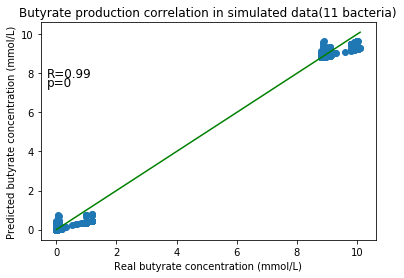

In [36]:
plt.title ('Butyrate production correlation in simulated data(11 bacteria)')  
plt.scatter (x11, y11)  
plt.plot (np.unique(x11), np.poly1d(np.polyfit(x11,y11, 1))(np.unique(x11)), color = 'green')  
plt.xlabel ('Real butyrate concentration (mmol/L)')  
plt.ylabel ('Predicted butyrate concentration (mmol/L)') 
plt.annotate("R=0.99",xy=(2, 9), xycoords='data',
            xytext=(0.43, 8),size=12, va="center", ha="center")
plt.annotate("p=0",xy=(2, 9), xycoords='data',
            xytext=(0.1,7.5),size=12, va="center", ha="center")
plt.savefig("Correlation11bact_S.png", dpi=300,bbox_inches='tight')

# 12 bacteria

In [10]:
tr12=pd.read_table(folder + "simulaciones/res_simulations/train_data_simulated/train_12bactS")
tr12


,butyrate,rb1,rb2,rb3,rb4,rb5,rb6,rb7,rb8,rb9,...,pLB,pLC,pLD,pLE,pLF,pLG,pLH,pLI,pLJ,pLK
0,8.808481,1,0,1,0,0,1,1,1,0,...,0.973405,0.998870,0.999831,0.995245,0.995831,0.995263,0.998501,0.997740,0.995471,0.997540
1,8.808481,1,0,1,0,0,1,1,1,0,...,0.528617,0.779402,0.994248,0.889697,0.955700,0.967754,0.895122,0.780337,0.675149,0.763636
2,8.808500,1,0,1,0,0,1,1,1,0,...,0.973405,0.998870,0.999831,0.995245,0.995831,0.995263,0.998702,0.998501,0.997740,0.995471
3,8.808481,1,0,1,0,0,1,1,1,0,...,0.973405,0.998870,0.999831,0.995245,0.995831,0.995263,0.998702,0.998501,0.997740,0.997540
4,8.808481,1,0,1,0,0,1,1,1,0,...,0.973405,0.998870,0.999831,0.995245,0.995831,0.995263,0.998702,0.998501,0.995471,0.997540
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
45840,0.069757,0,0,1,0,0,1,1,1,0,...,0.998702,0.984968,0.996583,0.998638,0.998638,0.998241,0.998501,0.997740,0.995471,0.997540
45841,0.000000,0,0,1,0,0,1,1,1,0,...,0.998702,0.984968,0.991835,0.998638,0.998638,0.998241,0.998501,0.997740,0.995471,0.997540
45842,0.069757,0,0,1,0,0,1,1,1,0,...,0.998702,0.996583,0.991835,0.998638,0.998638,0.998241,0.998501,0.997740,0.995471,0.997540
45843,0.069757,0,0,1,0,0,1,1,1,0,...,0.984968,0.996583,0.991835,0.998638,0.998638,0.998241,0.998501,0.997740,0.995471,0.997540


In [12]:
X12 = tr12.iloc[:, 1:433].values
y12 = tr12.iloc[:, 0].values

In [13]:
neigh = KNeighborsRegressor(n_neighbors=3)
neigh.fit(X12, y12)
dump(neigh, 'knn_12bact.joblib') 

['knn_12bact.joblib']

In [14]:
from sklearn.model_selection import LeaveOneOut
loo = LeaveOneOut()
loo.get_n_splits(X12)

45845

In [15]:
for i, (train_index, test_index) in enumerate(loo.split(X12)):
    X12_train, X12_test = X12[train_index], X12[test_index]
 #   print(neigh.predict(X_test))
    print(f"{y12[i]}\t{neigh.predict(X12_test)}")

8.80848084535292	[8.80848085]
8.808480845362359	[8.80848435]
8.808499543818	[8.81147877]
8.80848084533776	[8.80848085]
8.808480845389381	[8.80848085]
8.808505997257331	[8.84158463]
8.80848208361287	[8.80850298]
8.808480845341858	[8.80848085]
8.8084939638278	[8.80848522]
8.808480845350712	[8.80848085]
8.80848084538779	[8.80945885]
8.878236852848689	[8.85498414]
8.87823473031394	[8.87822214]
8.87822171462236	[8.87845825]
8.87814041651149	[8.87822656]
8.878194831698949	[8.87844928]
8.87891829113138	[8.87847657]
8.87825754935735	[8.87819691]
8.87828969450601	[8.87846898]
8.87819277803574	[8.87823005]
8.87828170130717	[8.87820388]
8.878207964080689	[8.87818519]
8.87814863634387	[8.87816422]
8.878136073225688	[8.87816122]
8.878198959329	[8.87823186]
8.87823983071769	[8.87822521]
8.87824302475911	[8.8782178]
8.87817053843233	[8.8782178]
8.878206939963881	[8.87818066]
8.87825354649811	[8.87822612]
8.878185942701949	[8.87826284]
8.87822855475523	[8.87821892]
8.87830495052377	[8.87830863]
8.8781

8.808501589086461	[8.8084899]
8.80851116554226	[8.80851898]
8.80905007828689	[8.80867059]
8.80848597796192	[8.80906822]
8.80850042993019	[8.80849317]
8.812313799226661	[8.81842123]
8.80848084539494	[8.81297256]
8.8084808453366	[8.80848085]
8.80851657908938	[8.80851304]
8.82195599880986	[8.81297256]
8.80848084536034	[8.80865677]
8.80854170345526	[8.80851304]
8.80848803382098	[8.84147829]
8.80848084532155	[8.80848975]
8.808480845374099	[8.8414632]
8.80848084534548	[8.8085974]
8.80878662526445	[8.88590328]
8.80849705761957	[8.80848863]
8.80848084536582	[8.80848577]
8.80848084531991	[8.80848085]
8.80848084531199	[8.8414632]
8.8084808453456	[8.80849604]
8.80848084531306	[8.80848997]
8.80848084538641	[8.80848085]
8.80848084534322	[8.80848085]
8.80848084533782	[8.84147783]
8.80849749432447	[8.80848639]
8.80848084535519	[8.80848085]
8.80850971629899	[8.80849047]
8.80848084540872	[8.80848831]
8.9074419389427	[8.84158098]
8.808546011412849	[8.80893847]
8.808480845363528	[8.80848085]
8.8084808453

8.87831418210919	[8.87824145]
8.878312753407132	[8.87828906]
8.878260350907759	[8.87824669]
8.87825867519706	[8.87823605]
8.87824738850545	[8.8782077]
8.87812034917862	[8.87853151]
8.87816803096808	[8.87825034]
8.87817434075171	[8.87821023]
8.878266172015971	[8.87845624]
8.878267853014849	[8.87820647]
8.878153121542448	[8.87820754]
8.87891576274902	[8.87847695]
8.878248922919779	[8.87823597]
8.878286102830499	[8.87824685]
8.878216498326651	[8.87823589]
8.87817419354008	[8.87820296]
8.87825893491882	[8.88019694]
8.878230961358732	[8.87858327]
8.878221431353289	[8.87837079]
8.8840265355775	[8.88951459]
8.87828025022384	[8.87829775]
8.87821120391402	[8.87825699]
8.878178190064471	[8.87823741]
8.87822745004368	[8.87822572]
8.87822271370623	[8.87824654]
8.87819301848652	[8.87818846]
8.87825658338442	[8.87822044]
8.878172731059461	[8.87820801]
8.87823118147928	[8.87821395]
8.87821352645706	[8.87823091]
8.87824678790822	[8.87824646]
8.977164122267949	[8.91120169]
8.87824058801759	[8.87824038]

8.878248923188961	[8.87819725]
8.87813478440909	[8.87821502]
8.87824446054768	[8.87821765]
8.878288977381619	[8.87825317]
8.87818001376957	[8.87818124]
8.87828246781148	[8.87828678]
8.87808401176101	[8.878178]
8.878171268006039	[8.87818151]
8.87826581597641	[8.87822477]
8.87827370389332	[8.87826133]
8.87823287678599	[8.87824957]
8.87819245119355	[8.87818857]
8.878295228966039	[8.87823427]
8.87819325416985	[8.87818566]
8.87822426642206	[8.87823861]
8.878179450247881	[8.87821178]
8.87824480594267	[8.87821812]
8.87832140815039	[8.87828278]
8.87814072896038	[8.87822726]
8.87859155704413	[8.87835379]
8.8781864204927	[8.87825775]
8.87822614834725	[8.87821793]
8.87821575678804	[8.87828837]
8.878300386686051	[8.87824269]
8.878168514554789	[8.87820612]
8.87836119100769	[8.87828022]
8.87828769335997	[8.87825765]
8.87827092583286	[8.87825751]
8.87830591992259	[8.87823628]
8.878209174515689	[8.87820406]
8.87821136133637	[8.87822557]
8.878276986352509	[8.87825639]
8.878232160375301	[8.87825084]
8.8

8.87820705515696	[9.25262947]
9.792400202793608	[9.21594913]
8.87825065775361	[8.87826329]
8.80858475990179	[8.85501912]
8.8781106855015	[8.8782067]
8.87830340082712	[8.88202537]
8.87826596390641	[8.87827037]
8.878259396371948	[8.87824507]
8.87828213605962	[8.87824937]
8.878198392332429	[8.95677878]
8.87822021464389	[8.87826625]
8.87832911529624	[8.8782467]
8.87813602964948	[8.91119258]
8.878229655474259	[8.91119258]
8.87823421471625	[8.8782192]
8.87824416572361	[8.8782192]
8.87822358183785	[8.87823236]
8.87822630116744	[8.87823236]
8.878252469200929	[8.87824883]
8.87828190261878	[8.87824883]
8.87819522017453	[8.87821962]
8.878293215284689	[8.87821962]
8.87820843020576	[8.87828077]
8.87824037550384	[8.87828077]
8.87826286923571	[8.87822972]
8.878284717018529	[8.87822972]
8.878194470759249	[8.91120996]
8.87824013319359	[8.91120996]
8.87821361087216	[9.25262947]
10.001467740432801	[9.25262947]
8.87818282321736	[9.21594913]
8.97726435659216	[9.21594913]
8.878253586670368	[8.87826329]
8.87

8.87815828329666	[8.87821181]
8.87822720838113	[8.87822232]
8.87830142764984	[8.87819803]
8.87821777078774	[8.87822403]
8.87827297758585	[8.87826131]
8.87821886507015	[8.91118739]
8.878295339950991	[8.87825478]
8.878263297557009	[8.89216629]
8.878285201755869	[8.8782696]
8.878282151420981	[8.87823696]
8.87822043294364	[8.8782735]
8.87820929273111	[8.8782082]
8.87821005138421	[8.87819145]
8.97715258543002	[8.91122191]
8.87814062404992	[8.87818424]
8.878262121296961	[8.87820833]
8.87825640488995	[8.87823901]
8.87809134197105	[8.8781988]
8.878266608962981	[8.87826029]
8.87827137715722	[8.87826694]
8.8782786605545	[8.91120989]
8.878162843017359	[8.8781851]
8.87824785857794	[8.87823519]
8.878707212701348	[8.87881949]
8.87822749855934	[8.87822594]
8.87824968273425	[8.8784915]
8.87818821804825	[8.87822027]
8.87816774523801	[8.87822998]
8.97736197257406	[8.9116559]
8.87824887975919	[8.87824929]
8.87827240797206	[8.87827222]
8.87818403461867	[8.87825058]
8.8781869202461	[8.87824727]
8.878234293

8.878260616082029	[8.87828591]
8.878196050369072	[8.8781827]
8.87825011770513	[8.87826542]
8.87818339346511	[8.87821424]
8.87818052766119	[8.87822551]
8.87824587298667	[8.87824289]
8.87822988133975	[8.87820891]
8.87828206240953	[8.87826156]
8.9771893092306	[8.91122391]
8.87823634190646	[8.87823931]
8.87818666560054	[8.88223252]
8.87827007049165	[8.87824706]
8.87825554032001	[8.87825174]
8.878229268625539	[8.87826951]
8.87811200099825	[8.87817487]
8.87820595979767	[8.87822247]
8.87822560585108	[8.87839487]
8.87827410608005	[8.87824617]
8.87830330386083	[8.91128055]
8.878524759252171	[8.87837063]
8.87845522371326	[8.87834253]
8.878313202870249	[8.88418357]
8.87820493531318	[8.87819606]
8.878215989781632	[8.87824449]
8.87828367546044	[8.87825295]
8.878217447965481	[8.87825602]
8.97715588753598	[8.9112844]
8.87819359150532	[8.87821406]
8.87826682392767	[8.91122315]
8.87832014619782	[8.87829302]
8.87819676678267	[8.87819933]
8.97719696826099	[8.94421985]
8.97719696826099	[8.94421985]
8.8781

8.80848084535423	[8.80848306]
8.9074279027144	[8.8414632]
8.90761531268898	[8.84152567]
9.04086908911551	[8.88594359]
8.808480845364699	[8.80848163]
8.808563070202538	[8.80851692]
8.808480845285011	[8.88594359]
8.80848084534306	[8.80848085]
8.808492456761359	[8.80851212]
8.80848084536953	[8.80848085]
8.80853837593634	[8.80850002]
8.80848084532009	[8.80848484]
8.80848084534481	[8.80848085]
8.808480845354211	[8.80854054]
8.80848084531569	[8.80848085]
8.80848084527462	[8.80848085]
8.8084808453613	[8.80848252]
8.80848084535517	[8.80848085]
8.80848084533797	[8.80848085]
8.80848084536892	[8.80848085]
8.8084808453612	[8.80848085]
8.80848084532218	[8.80848609]
8.80849281947998	[8.80848484]
8.8084808453422	[8.84152567]
8.808480845350289	[8.88594359]
8.80848320492566	[8.80848163]
8.808495221509132	[8.80851305]
8.8084808453675	[8.80848085]
8.80848084531953	[8.80848163]
8.80848084528853	[8.80848951]
8.80848084531573	[8.80848085]
8.808480845362519	[8.80850002]
8.808480845334369	[8.80848085]
8.80848

8.88685419809574	[8.83490199]
8.80848084536381	[8.80848085]
8.808480845357131	[8.8414632]
8.80848084533158	[8.80848085]
8.808480845309	[8.80848279]
8.80848084533372	[8.80848852]
8.80848084532298	[8.8087708]
8.80848084538866	[8.80854999]
8.80849329592329	[8.80849334]
8.80854566361659	[8.80850245]
8.80848084536628	[8.80848274]
8.80852724415698	[8.80875493]
8.80852040399697	[8.80849403]
8.808480845288221	[8.80862156]
8.808480845328999	[8.80848401]
8.80848084535024	[8.80848085]
8.808480845340439	[8.80850257]
8.80848084537115	[8.80848085]
8.80848084534599	[8.80850503]
8.80876736037062	[8.8085798]
8.80891676619703	[8.8347506]
8.808480845295211	[8.80848085]
8.808480845353289	[8.80848085]
8.808480845364778	[8.80848242]
8.80848667475744	[8.80848279]
8.80854103215672	[8.80850091]
8.808480845324471	[8.80848085]
8.80848084532609	[8.80848085]
8.80850392955396	[8.8114893]
8.80848084536753	[8.80848085]
8.80848084538356	[8.80849027]
8.817477479597938	[8.81151566]
8.80848084536106	[8.80848085]
8.808497

8.80848084530375	[8.8414632]
8.808485565783288	[8.80848242]
8.80848084532832	[8.80848279]
8.808480845336538	[8.84148326]
8.808480845341151	[8.80848085]
8.80848084533409	[8.80848085]
8.808486477187099	[8.80851866]
8.808480845348651	[8.80848085]
8.80849225998409	[8.80863859]
8.80856557660443	[8.81150984]
8.808480845408841	[8.80848085]
8.80894265258899	[8.80864421]
8.808480845384778	[8.80848654]
8.80848084531576	[8.80866069]
8.81525378122208	[8.81079369]
8.80901850631677	[8.80875086]
8.80848084534852	[8.80848085]
8.808480845356051	[8.80848085]
8.80909959062319	[8.80870484]
8.809250459287199	[8.80971083]
8.80848900459288	[8.80890756]
8.80848084536905	[8.8086769]
8.808480845371081	[8.80848085]
8.808491935458571	[8.8128481]
8.80906901409015	[8.80867929]
8.80848084530084	[8.81316387]
8.8215715111736	[8.81286303]
8.808480845366802	[8.80848085]
8.80848084539319	[8.81004167]
8.80848084537323	[8.80848085]
8.808482102704358	[8.80848652]
8.8084808453318	[8.80850896]
8.8084808453224	[8.80849221]
8.8

8.80848412165528	[8.80848498]
8.8084808453337	[8.80848085]
8.80848084535939	[8.80848283]
8.80848084535347	[8.80848988]
8.80848084535847	[8.80848085]
8.80848084531059	[8.80848514]
8.878211473399869	[8.87820608]
8.87828060116341	[8.88008541]
8.8782294999831	[8.87841733]
8.87822255670452	[8.87826883]
8.878284345736029	[8.87855267]
8.878360201398289	[8.8782699]
8.87811666323836	[8.87855578]
8.87824878186757	[8.87857432]
8.878225044275199	[8.87827659]
8.87826630625402	[8.87828437]
8.87826853875093	[8.87821957]
8.878146901099631	[8.87819939]
8.878276497640789	[8.88197841]
8.878202688350381	[8.87821176]
8.87820268939563	[8.87822056]
8.87826355878721	[8.87823929]
8.878201963397599	[8.87823764]
8.87825064365856	[8.91119798]
8.87820951441059	[8.87822617]
8.87821290607719	[8.8921495]
8.8783228446627	[8.87828215]
8.87822308183527	[8.87821727]
8.87824646711125	[8.87828218]
8.878290885510198	[8.8782354]
8.87817872575988	[8.878181]
8.8782318889831	[8.87822533]
8.87819444457489	[8.87824208]
8.87824000

8.80848084536797	[8.80848085]
8.80848084530911	[8.80848231]
8.80848084538116	[8.80848231]
8.80848084535487	[8.80848085]
8.80848084536235	[8.80848085]
8.80848084537916	[8.80848085]
8.808480845379679	[8.80848085]
8.808480845336929	[8.80849178]
8.80849320632271	[8.80849178]
8.80848084535019	[8.8414632]
8.90742790264004	[8.8414632]
8.8084808453278	[8.80848085]
8.8084808453518	[8.80848085]
8.80848084531814	[8.80848085]
8.808480845373051	[8.80848085]
8.80848084534469	[8.8084979]
8.80848084534694	[8.8084979]
8.80848084534408	[8.80848085]
8.80848084535016	[8.80848085]
8.80848084537117	[8.84279702]
8.81248231772038	[8.84279702]
8.80848084531574	[8.80848085]
8.80848084531919	[8.80848085]
8.808480845343231	[8.80848489]
8.8084929830046	[8.80848489]
8.80848084534465	[8.80852119]
8.80860189396866	[8.80852119]
8.80848084537582	[8.80848329]
8.8084808453882	[8.80848329]
8.80848084531054	[8.80848212]
8.8084846738924	[8.80848212]
8.8084808453716	[8.80848452]
8.808491856734289	[8.80848452]
8.8084808453572

8.80848084535056	[8.80850446]
8.80848084531731	[8.80848085]
8.80848084537679	[8.80848085]
8.8085068200495	[8.80849156]
8.808480845350699	[8.80848085]
8.80853788301743	[8.80860595]
8.80848084530216	[8.85208839]
8.81101882288811	[8.80932684]
8.808480845354039	[8.80848489]
8.90777635045629	[8.84158638]
8.80848084537724	[8.80850895]
8.80848084538211	[8.80848085]
8.808480845384368	[8.80848639]
8.808495058969509	[8.8087534]
8.808523962275052	[8.80852151]
8.80849802993756	[8.84190887]
8.80850061005343	[8.80849067]
8.80852473920849	[8.80849548]
8.80848084537845	[8.80848085]
8.80938724700923	[8.80902563]
8.854328494166971	[8.82376402]
8.80848084532316	[8.81139564]
8.80850504112228	[8.80848891]
8.80848084537322	[8.80848085]
8.80848084532702	[8.80848361]
8.80848084538538	[8.80921226]
8.808519812824	[8.80852664]
8.808480845352312	[8.80868425]
8.80848084533842	[8.80848415]
8.80848084529615	[8.80866902]
8.808922237989721	[8.808632]
8.808480845320311	[8.83771334]
8.80848084539411	[8.80848757]
8.80891

8.80848271410736	[8.80849104]
8.81439823880659	[8.81192546]
8.90742790275599	[8.84148292]
8.80848084532289	[8.80848719]
8.81808216306622	[8.81174665]
8.808643799048019	[8.80853516]
8.808480845369212	[8.80849079]
8.808498189198689	[8.80850473]
8.80848084533865	[8.81066008]
8.808499874171929	[8.80848719]
8.80848084533677	[8.81168128]
8.808480845319881	[8.80853516]
8.808503874344149	[8.80848852]
8.80848084534367	[8.80871855]
8.80848084534332	[8.80848085]
8.8782370433707	[8.9324053]
8.8782507966777	[8.87829131]
8.878258188644132	[8.87821908]
8.87815712658973	[8.87834481]
8.87826667335632	[8.87824671]
8.87820379234401	[8.8782641]
8.87824041869616	[8.8782269]
8.878197255608141	[8.87819259]
8.87830198299853	[8.87827034]
8.878140099963801	[8.87819187]
8.87826714943835	[8.87827428]
8.878250033021368	[8.87825341]
8.8782382490571	[8.87818339]
8.878253705371462	[8.87825463]
8.87824304805619	[8.87822107]
8.87817013380698	[9.18294721]
8.8782443491659	[8.87821905]
8.87829043336572	[8.87820717]
8.8783

8.80848084543442	[8.80891136]
8.80849354754408	[8.80848508]
8.80848084535258	[8.80848085]
8.80885996127152	[8.80860722]
8.8084808453504	[8.80848508]
8.80848084542477	[8.80848085]
8.808480845336929	[8.80848085]
8.80848084534208	[8.80848085]
8.808480845357911	[8.80848085]
8.81243840854904	[8.81502581]
8.80848084535262	[8.80848738]
8.80849788142632	[8.84157529]
8.808665359709341	[8.80854487]
8.808480845407109	[8.8084849]
8.80849467257006	[8.80912643]
8.80848840619282	[8.80848589]
8.80848840619286	[8.80848589]
8.80848084533076	[8.80848085]
8.81040378384687	[8.80912643]
8.80848084536011	[8.88595818]
8.808480845357831	[8.8317002]
8.80848084536524	[8.80848085]
8.80871255841103	[8.80855808]
8.808490208468868	[8.80848397]
8.80848084533707	[8.80848085]
8.80848084535741	[8.8085672]
8.80848084532009	[8.80848397]
8.80850820389215	[8.80848996]
8.808480845348429	[8.80848085]
8.80848084534067	[8.80848126]
8.80848084534605	[8.80848512]
8.808493679020891	[8.80848512]
8.80848084535226	[8.80848512]
8.8084

8.808687202996198	[8.80856262]
8.80848084530849	[8.8084864]
8.8084808453033	[8.80848356]
8.80848084534316	[8.81370662]
8.808483898858741	[8.80848738]
8.90765370858149	[8.84156961]
8.80849241834864	[8.82019892]
8.80848084538377	[8.80849854]
8.80848084540401	[8.80851841]
8.84362349142859	[8.8531959]
8.808524739241038	[8.80851184]
8.8085935439385	[8.81135934]
8.808480845362212	[8.88607545]
8.808480845379881	[8.84178524]
8.80850131208985	[8.81039134]
8.808486599346	[8.84146512]
8.80848163809547	[8.80848558]
8.81419187394983	[8.81042349]
8.907427902667349	[8.84156064]
8.80849425713598	[8.80865741]
8.80849434492249	[8.80849023]
8.80848084538328	[8.80848272]
8.808612749583471	[8.80852483]
8.80848084533442	[8.84168495]
8.80851980125343	[8.80895602]
8.80849155231405	[8.80848997]
8.80850348161037	[8.80849363]
8.808480845377359	[8.80848085]
8.808480845353019	[8.80848085]
8.80848084535651	[8.83354201]
8.80848088558477	[8.80935715]
8.808484968507882	[8.80848235]
8.80848084536485	[8.80848672]
8.8085

8.80848088176208	[8.80852483]
8.907444027154279	[8.84151896]
8.80848084532326	[8.80849803]
8.808497497849801	[8.80849536]
8.8084808453715	[8.80848839]
8.808480845358721	[8.80856195]
8.808480845358199	[8.80848085]
8.883664334367449	[8.83354201]
8.811109726338561	[8.80939053]
8.808480845404212	[8.80877624]
8.80849848195184	[8.80848672]
8.80848084541307	[8.80849879]
8.80848084536169	[8.80849614]
8.80848084539598	[8.80849383]
8.80848084531655	[8.8084864]
8.808480845339322	[8.80848356]
8.80863200968126	[8.84173534]
8.808493454075212	[8.80894724]
8.80849703320659	[8.80849179]
8.8084808453209	[8.80848608]
8.808724156149971	[8.80856195]
8.808480845409811	[8.80848085]
8.80848084529935	[8.83354201]
8.80858096448226	[8.80939051]
8.8093629056343	[8.808775]
8.80848084539874	[8.80848672]
8.80848084536632	[8.80848246]
8.90742790259713	[8.84159009]
8.80870154569595	[8.80855603]
8.80848084537223	[8.80848085]
8.80848084533301	[8.80848085]
8.9803219774357	[8.91226792]
8.87818360464689	[8.9111881]
8.87826

8.87820819729896	[8.87823567]
8.87825457219808	[9.18295846]
8.878252677789732	[8.91122186]
8.878189315940881	[9.18294671]
8.8782632750153	[8.8782761]
8.878169071272279	[8.87819803]
8.97721593027196	[8.91125153]
8.878224252701841	[8.87825061]
8.87827717411457	[8.87823021]
8.87834266325584	[8.91130548]
8.87829527943607	[8.87826197]
8.8782059263579	[8.88190685]
8.878184283465892	[8.8782322]
8.87821404184408	[8.87821492]
8.8782000107725	[8.87825501]
8.87824424778257	[9.18295501]
9.792412595936849	[9.18297047]
8.878215117174381	[8.87821579]
8.87824606350181	[8.8782239]
8.87830216369628	[8.87825515]
8.878222376666269	[8.87820872]
8.878225667045669	[8.87819321]
8.87823458127394	[8.87823974]
8.87813605372695	[8.87822065]
8.8781204803752	[8.87818884]
8.87825781174127	[8.87823906]
8.878223310735539	[8.878166]
8.87818117900449	[8.87820875]
8.87823800485663	[8.87821966]
8.878156986887712	[8.87827199]
8.87821522963437	[8.87820546]
8.87824765618178	[8.8782333]
8.87828116283154	[8.87828061]
8.8782474

8.8782893596777	[8.91126024]
8.97718189763283	[8.91121638]
10.0019084320776	[9.28576452]
9.110648499958181	[8.95574173]
8.878256487837241	[8.87838773]
8.8781882992306	[8.87815027]
8.87822728563668	[8.87823788]
9.11016341018569	[8.95551945]
8.97722388862022	[9.28565544]
8.87823434355122	[8.87823748]
8.97726899462863	[8.91173423]
8.87825513826588	[8.87823389]
9.11071857388022	[8.95575325]
8.878205556441461	[8.87822781]
8.87825919410373	[8.87824003]
8.878272041078052	[8.87823442]
8.87822963207541	[8.91132271]
8.87823192188717	[8.87823451]
8.878306921171859	[8.95558495]
8.87817633145689	[8.87865473]
8.97825655377799	[8.91159665]
8.977219486481438	[8.88796807]
8.87829192221766	[8.87821414]
8.97727356338827	[8.91129133]
8.878210368108642	[8.89490849]
8.87826379016389	[8.87823686]
8.87816305276947	[8.8782165]
8.8781916107631	[8.87820246]
8.87822954431239	[8.87822842]
8.878208539913551	[8.87823337]
8.87821184882274	[8.87823066]
8.87837536086371	[8.91129461]
8.878149566082712	[8.87821857]
8.878

8.888374906230029	[8.88157703]
8.87823859054256	[8.87826477]
8.87820876382256	[8.87826697]
8.87821305973522	[8.95567886]
8.87825996067033	[8.87823969]
8.92281083433163	[8.89307075]
8.87830534002998	[8.87825779]
8.87823975264976	[9.25262653]
8.878194477716141	[8.89920931]
8.80857321049542	[8.80873721]
8.82123688851955	[8.81274183]
8.808502793114972	[8.8086372]
8.808480845347038	[8.8414632]
8.80848084534899	[8.80848085]
8.81004748569473	[8.80902065]
9.04089801186322	[8.88600968]
8.80848084539598	[8.80848085]
8.80848084532082	[8.80848085]
8.808480845371259	[8.80848662]
8.808485235299651	[8.84146977]
8.80848084531462	[8.80848234]
8.809335602662859	[8.80877548]
8.8084808453153	[8.81565516]
8.808524739247698	[8.80851473]
8.808480845368539	[8.80848085]
8.81031651428449	[8.81059801]
8.80848650475416	[8.80848431]
8.808480845301132	[8.8414632]
8.90745611734591	[8.8414726]
8.80914026951849	[8.80870065]
8.808481172487472	[8.80849621]
8.8084808453351	[8.80848439]
8.80848084535874	[8.80848085]
8.808

8.87824546114017	[8.87822064]
8.808568601082449	[8.8085101]
8.8084808453163	[8.80851108]
8.80848084533955	[8.80848085]
8.808480845320108	[8.80848609]
8.808480845316529	[8.84146704]
8.907471796337061	[8.84152613]
8.80848084537315	[8.80848963]
8.907439443765039	[8.84146704]
8.808625761812301	[8.84152784]
8.80850718979385	[8.80866388]
8.808480845366539	[8.80848085]
8.808532580407869	[8.80849809]
8.808480845354751	[8.80857494]
8.808500314595198	[8.80849833]
8.808480845330449	[8.80848085]
8.80876311790031	[8.80857494]
8.808495199082731	[8.82155624]
8.80848084535468	[8.80919113]
8.80848084533283	[8.80848563]
8.808480845378188	[8.80848085]
8.808480845343599	[8.80848085]
8.80858113573681	[8.80851428]
8.80848084536446	[8.80851428]
8.80848084536865	[8.80848085]
8.80848084536307	[8.80848085]
8.8084808453662	[8.8084817]
8.80850079804552	[8.8084875]
8.80848084538758	[8.80848614]
8.808489743319349	[8.80848389]
8.80848084534393	[8.80848345]
8.808496722601689	[8.80849409]
8.80848084534351	[8.80848381]

8.80848084540314	[8.84146542]
8.808568867625551	[8.80851019]
8.8084808453574	[8.80848791]
8.80850025860443	[8.80851736]
8.808568039766769	[8.84149226]
8.80848406385219	[8.80848192]
8.80874737926781	[8.8085714]
8.80848084538725	[8.8084836]
8.80851155139366	[8.8093241]
8.80848084531868	[8.80851975]
8.80848084534482	[8.84146511]
8.808573786180212	[8.80851183]
8.80848084539976	[8.80848852]
8.808480845343801	[8.80849165]
8.80852735420151	[8.80849635]
8.80848084532472	[8.81016418]
8.80848084535352	[8.80851019]
8.80848084538155	[8.80848085]
8.80852709293055	[8.84149972]
8.80848084531455	[8.80850991]
8.808480845335712	[8.80848192]
8.80848084532803	[8.80856969]
8.808480845363231	[8.80849383]
8.810979909799869	[8.8093241]
8.80849872378318	[8.84147582]
8.8085161347621	[8.80849261]
8.8128543403789	[8.84374827]
8.808488654677529	[8.80848575]
8.80855948701502	[8.80851016]
8.80848084537584	[8.80850973]
8.80848084535609	[8.80848085]
8.80848084542018	[8.80848108]
8.808480845337721	[8.80849383]
8.808480

8.87817862779328	[8.91131262]
8.87853367565535	[8.87830907]
8.8782430324527	[8.91122929]
8.87820439634978	[8.87818504]
8.8782419004445	[8.9558356]
8.87830129248055	[8.87824539]
8.878210950295381	[8.87824538]
8.87820837810165	[8.88793764]
8.87817180748066	[8.87824814]
8.87824245032182	[8.87823172]
8.90742790257827	[8.88795725]
9.79242846170401	[9.18296544]
8.87812235838699	[8.87821605]
8.87822919647631	[8.87826383]
8.87824922204592	[8.87824127]
8.87825072357689	[8.87823763]
8.87830558145182	[8.87827053]
8.8783404261958	[8.87829248]
8.878167438088141	[8.87820921]
8.977382916730061	[8.94426116]
8.878211760221	[8.87821283]
8.977091323554381	[8.91118335]
8.878239277391199	[8.91393589]
9.11062127156719	[8.95571832]
8.893066553538869	[8.88316407]
8.87822176745347	[8.87840568]
8.87818101115671	[8.87824733]
8.87812989977017	[8.8782161]
8.878776897358609	[8.87841205]
8.87828900122181	[8.99688655]
8.87824951476258	[8.9111731]
8.87824345747208	[8.87823805]
8.880917638375902	[8.87919056]
8.87826791

8.808497791388131	[8.80849265]
8.80855655202177	[8.80863388]
8.808480845341	[8.80983068]
8.80952174031246	[8.80882781]
8.80848084534374	[8.80848085]
8.80848295025844	[8.80849051]
8.808491716347211	[8.80863351]
8.808496672170449	[8.84146847]
8.80849377941624	[8.80848516]
8.80849315572667	[8.80850254]
8.80848084537882	[8.80854306]
8.80848084539124	[8.80866418]
8.82226490134774	[8.81308306]
8.80849055975209	[8.80848942]
8.80850584010931	[8.80848918]
8.80848084540987	[8.80848649]
8.808818144645938	[8.80861851]
8.812530353899179	[8.80983068]
8.808480845309699	[8.80882781]
8.80848084538153	[8.80848085]
8.80849416152265	[8.80848528]
8.80848084534059	[8.84230029]
8.80848084532522	[8.80932694]
8.80848084537955	[8.84146471]
8.80849922464589	[8.80851529]
8.80848084531362	[8.8415124]
8.808599709738449	[8.80852047]
8.808480845362448	[8.80850846]
8.81072399555269	[8.80927177]
8.80848084536205	[8.80848085]
8.80980143307827	[8.80894299]
8.80848084530513	[8.80864803]
8.80848084535315	[8.80848085]
8.808

8.90743286492677	[8.8417636]
8.80848084537496	[8.80849383]
8.80848084531675	[8.84195754]
8.808480845292081	[8.80848085]
8.90742790261281	[8.8414632]
8.80848638270398	[8.80848269]
8.80848084529715	[8.87446341]
8.808519800309089	[8.80849383]
8.907427902611131	[8.84146814]
8.80848084533149	[8.808483]
8.80848084537416	[8.8414632]
8.808480845294609	[8.88593792]
8.80848084531869	[8.80933333]
8.808480845348589	[8.80849851]
8.80849758131068	[8.80850298]
8.80852881137494	[8.80849683]
8.808480845337948	[8.87444555]
8.80848084533067	[8.81108433]
8.80848084531827	[8.80923278]
8.80848084536753	[8.80885848]
8.88151097066002	[8.8797294]
8.878272347368501	[8.87839285]
8.87826386812433	[8.87948599]
8.882035096625499	[8.87952561]
8.87827786521593	[8.87951023]
8.878217741984061	[8.87824373]
8.878260771888	[8.87824773]
8.878240861102368	[8.87824377]
8.87819704900305	[8.88211786]
8.87822969014589	[8.87822651]
8.87825221243376	[8.87820448]
8.878194831646882	[8.87822304]
8.87820897683262	[8.87822191]
8.87816

8.80848084533935	[8.80848826]
8.808480845367711	[8.80851793]
8.80848084533983	[8.80848361]
8.878269337833562	[8.91126407]
9.79242483492336	[9.21593009]
8.8798277685796	[8.95623531]
9.110580317657229	[8.95571608]
8.87830167544697	[8.95570142]
9.11058844732154	[8.9556738]
8.87825463984277	[8.91246967]
8.87828414136321	[8.87824962]
8.878247409666919	[9.04420136]
8.87822544861437	[8.95569505]
8.87818617561175	[8.87896172]
9.37606060395425	[9.04419639]
9.110616714471199	[8.95582404]
8.880510714124991	[8.87899161]
8.8782507603088	[8.87896655]
8.878273175915199	[8.87821823]
8.87820628316067	[8.87818997]
8.80848084536708	[8.8549508]
8.87816997253281	[8.87820197]
8.87828523747637	[8.87824454]
8.87827485800718	[8.87868307]
8.88407949643382	[8.8802162]
8.87811575629147	[8.87819641]
8.87823667049667	[8.8782928]
8.878265799282829	[8.87825827]
8.87825711640975	[8.87824077]
8.87832105008615	[8.87827495]
8.878224297878301	[8.87828085]
8.87816619248526	[8.87827426]
8.878240610401841	[8.87822735]
8.8782

8.87819670487491	[8.85496813]
8.8782534311497	[8.87821907]
8.87818365841584	[8.8788895]
8.87948151585782	[8.87867559]
8.87822270535208	[8.85693222]
8.87822518661145	[8.87819636]
8.87830812688337	[8.87825009]
8.87823629351231	[8.87826961]
8.878144136703801	[8.87821598]
8.878246688868881	[8.87823729]
8.87829721141532	[8.87821702]
8.878435112867882	[9.25268969]
8.878252033649321	[8.87822735]
10.001467775877801	[9.25270812]
8.87814504351703	[9.26040121]
8.878346462670141	[8.87827942]
8.97711881670465	[8.91119235]
8.87819603526798	[8.95564561]
8.87817083313525	[8.87823426]
8.97725758511759	[8.91121304]
8.87824480320298	[8.87820281]
8.87822683239805	[8.87819946]
8.87823382101081	[8.87822325]
8.88019961494993	[8.87888266]
8.87827039418549	[8.87868158]
8.80849444980569	[8.85502119]
8.8782481368821	[8.87824054]
8.878205468997212	[8.8782824]
8.878306731933689	[8.87827192]
9.11060263430121	[8.95567305]
8.8781906702633	[8.87824372]
8.878178493812241	[8.91116002]
8.87821880079285	[8.87822715]
8.878

8.87829863507432	[8.87825601]
8.97722655177677	[8.91122179]
8.87874155444702	[8.87838721]
8.878287483995098	[8.87821767]
8.87825276045893	[8.87939787]
8.878100573395141	[8.87820763]
8.87831338845088	[8.87824029]
8.878253429436311	[8.9112553]
8.87826706322906	[8.87868265]
8.87819586862554	[8.87823581]
8.97722447996854	[8.98857579]
8.87823593808741	[9.25261863]
8.8781334226908	[8.85531855]
8.87814444672518	[8.87823884]
8.87823294139846	[8.87822738]
8.87827130177268	[8.87826575]
8.87833527503823	[8.87820671]
8.878261725748882	[8.87825012]
8.878319013954359	[8.87823999]
8.87818146936615	[8.87819071]
8.87823775205917	[8.87825889]
8.878206646767019	[8.91122077]
8.87826079245384	[8.87829425]
8.87822496120377	[9.25564706]
9.79252681531455	[9.18311789]
8.87821364184547	[8.87821711]
8.97722069184685	[9.28566108]
8.87832819357885	[8.87826845]
8.87822538218234	[8.87822314]
8.878280709183901	[8.91162088]
8.87824556919361	[8.87831157]
8.87825766792081	[8.87824052]
8.87823637738281	[8.87821296]
8.878

8.878205835732802	[8.87819091]
8.87818072352646	[8.87821182]
8.87815300822489	[8.91121807]
8.87814815646183	[8.87819412]
8.8782017580716	[8.87819851]
8.87824394230757	[8.87821756]
8.88140030410801	[8.87925797]
8.87816275218423	[8.91122143]
8.87838796236181	[8.87824707]
8.87821191538527	[8.87822557]
8.9772231104616	[8.91119737]
8.87813754853407	[8.87824781]
8.87824677903502	[8.87822855]
8.878331852656391	[8.87825125]
9.79242972143735	[9.18293026]
8.87820378108082	[8.87820877]
8.87820770112309	[8.8782408]
8.87820675034218	[8.87962034]
8.878268691930689	[8.87823181]
8.907447716297519	[8.88792475]
8.87826119500552	[8.87827451]
8.87821658338364	[8.87821807]
8.87818566961029	[8.88790578]
8.87831054961778	[8.8782845]
8.87822825946056	[8.95566201]
8.97718970262615	[8.91123926]
8.907427902692461	[8.84410229]
8.80849414711967	[8.80849037]
8.90743069166041	[8.84146413]
8.80848084533018	[8.8414632]
8.90742790269308	[8.84149055]
8.808486369976269	[8.80848269]
8.80848084537741	[8.80856114]
8.8086337

8.879138776042529	[8.87854223]
8.87824642060548	[8.87826764]
8.878322561771439	[8.87825061]
8.808480845372669	[8.80851557]
8.808533126555051	[8.80880847]
8.80848084543371	[8.88593842]
8.81854739750856	[8.81186829]
8.907444216328301	[8.84147406]
8.80868989326556	[8.8087719]
8.80848084533359	[8.80848085]
8.80851153474331	[8.80853824]
8.80997060025473	[8.80898461]
8.80848704086916	[8.80850009]
8.808480845353142	[8.80848085]
8.808480845360279	[8.80848085]
8.80848084533796	[8.80848494]
8.80848084529615	[8.80848683]
8.808485957566061	[8.80848378]
8.80848084541917	[8.80848625]
8.80848084533655	[8.80856009]
8.80848084533143	[8.8414632]
8.80848084533267	[8.80848182]
8.808495607040449	[8.80848577]
8.80972990690729	[8.80892915]
8.80848084530607	[8.80848085]
8.80848084533861	[8.81509648]
8.80848084535276	[8.80848085]
8.80848084541549	[8.80848782]
8.80898366518076	[8.80864845]
8.80848084535285	[8.80848085]
8.808480845309699	[8.80848085]
8.80851243222995	[8.80855633]
8.80848084536212	[8.80848085]
8.

8.80848084533582	[8.80848088]
8.808480845324462	[8.81496732]
8.808481505315369	[8.8086609]
8.810672000625269	[8.80961316]
8.80848084535136	[8.80848085]
8.80848084540924	[8.80848085]
8.80848084534181	[8.80848085]
8.8085311847703	[8.80849763]
8.808480845337321	[8.80848392]
8.80849174951157	[8.80848448]
8.808480845320561	[8.88581038]
8.80859536966806	[8.80853283]
8.80848084533376	[8.81455966]
8.808497243702949	[8.87705118]
8.80866994488939	[8.80854388]
8.80848084538543	[8.80848085]
8.808480845340481	[8.84146833]
8.80849552664909	[8.80848574]
8.808480845335	[8.80848085]
8.91511172886084	[8.84403199]
8.808480845300538	[8.80854388]
8.80848084534047	[8.80848085]
8.90744331221459	[8.85993634]
8.80848264885886	[8.80848145]
8.87818891160118	[8.85498642]
8.878216369154131	[8.87824752]
8.97718099879866	[8.91121021]
8.87822854277218	[8.87826405]
8.878228271297429	[8.87820624]
8.87823459456621	[8.91131972]
10.001478249252198	[9.25264654]
8.87822508943061	[8.87878466]
8.89561636112991	[8.88403463]
8.

8.80849612281812	[8.80849037]
8.808480845372381	[8.84146413]
8.80848084538015	[8.80850819]
8.80856289208443	[8.84149055]
8.80848084534773	[8.80848679]
8.80848084537348	[8.8085809]
8.80848084538232	[8.80853181]
8.808480845351529	[8.80848085]
8.80848084535243	[8.84147984]
8.80849932711075	[8.80851196]
8.80848084536808	[8.80848085]
8.90743612773391	[8.87444829]
8.80848084536438	[8.80848701]
8.808506620042401	[8.80849375]
8.819236201940921	[8.81207367]
8.808503952757981	[8.80851065]
8.808480845370221	[8.80848149]
8.808480845287619	[8.8084827]
8.808547149374869	[8.81724098]
8.80848278992542	[8.80848149]
8.80848641191341	[8.8084827]
8.808480845340869	[8.80848149]
8.808480845332062	[8.8084827]
8.808803384710222	[8.88604993]
8.80848084534063	[8.80848085]
8.80848084536492	[8.80848085]
8.808500707577231	[8.80848747]
8.80848828157896	[8.80848994]
8.80848084528674	[8.80858836]
8.81230128729114	[8.80975679]
9.040852057861699	[8.88593849]
8.808480845363869	[8.80848304]
8.80848084540059	[8.80848085]


8.80848084532731	[8.80850122]
8.808480845354211	[8.80864845]
8.80848084534955	[8.80866392]
8.808484178016052	[8.80865706]
8.808480845345619	[8.80848085]
8.80849313977246	[8.80851001]
8.808480845403551	[8.80848321]
8.8084808453411	[8.8085023]
8.907427902811591	[8.8414632]
8.80848084535533	[8.80848085]
8.808480845408571	[8.80903535]
8.80848084535595	[8.80848085]
9.04102181668191	[8.91897789]
8.80848084538246	[8.80848982]
8.80848084535376	[8.80848085]
8.808480845349301	[8.80848263]
8.8084808453364	[8.80848085]
8.80900059778133	[8.81030865]
8.80849846923617	[8.80849763]
8.80848084529937	[8.80848085]
8.80848120881831	[8.80848506]
8.80848084535077	[8.80848524]
8.80852701275025	[8.80849623]
8.80848084534253	[8.8414632]
8.80848084531287	[8.80849239]
8.810144368911882	[8.8090407]
8.8084808453443	[8.80848085]
8.80942529281685	[8.80879807]
8.81193156679457	[8.81015328]
8.80889011183425	[8.82116846]
8.80848084535554	[8.80853058]
8.80863005298895	[8.80853058]
8.808480845333301	[8.8085094]
8.8085122

8.8782441145554	[8.87831626]
8.8782374809506	[8.87862646]
8.87931758726115	[8.87856948]
8.87841716200489	[9.25270062]
8.8782069103702	[8.87823872]
8.87833126116586	[8.88406595]
8.878197036330802	[8.87820531]
8.87824224114384	[8.87866121]
8.878273074481118	[8.87829542]
8.87822647569352	[8.87821053]
8.879517136864118	[8.87867879]
8.87828137523179	[8.88170367]
8.87817983621664	[8.8782416]
8.878231712685391	[8.87824053]
8.878254106834891	[8.87821734]
8.87821563356163	[8.87825471]
8.87828645986517	[8.8782214]
8.878186041990471	[8.87821915]
8.8782455373918	[8.8782517]
8.878182592134	[8.87821528]
8.87828922298931	[8.878313]
8.97719076251112	[8.91118551]
8.878223608206179	[8.87824254]
8.87823438593997	[8.87840432]
8.87823148407422	[8.87871785]
8.87814892458534	[8.87830201]
8.87819564833776	[8.87820034]
8.878224268391321	[8.87820181]
8.878171657378141	[8.87823725]
8.878201177611741	[8.87823159]
8.87819367911239	[8.87819636]
8.87827066049647	[8.95556256]
8.878350761930449	[8.87825279]
8.87820993

8.80848084537552	[8.80852559]
8.80849750007275	[8.84184027]
8.808480845353369	[8.80906204]
8.83164513664612	[8.81620858]
8.8084808452919	[8.8084866]
8.81492657984936	[8.8437813]
8.80848084536283	[8.88580136]
8.80848084537293	[8.80848085]
8.8084808452958	[8.80848085]
8.80848084538876	[8.80848133]
8.80849906058559	[8.80850003]
8.8084808453027	[8.80848873]
8.80848679699675	[8.80848456]
8.80848084538435	[8.80849395]
8.907427902653689	[8.84146848]
8.808508494505679	[8.808496]
8.80959542197173	[8.80885792]
8.810224436587118	[8.80906204]
8.80848084533722	[8.81621527]
8.80849809945878	[8.8084866]
8.808480845350449	[8.80848085]
8.811605591131071	[8.80952737]
8.80848084535971	[8.82102786]
8.808480845360132	[8.88594905]
8.808483776274448	[8.80849677]
8.821753854011689	[8.81290518]
8.808485296547099	[8.81961148]
8.90742790275044	[8.84174206]
8.80848084536975	[8.80870154]
8.80848094849032	[8.80848088]
8.808480845364562	[8.81496732]
8.80852306315292	[8.8086609]
8.8096866383759	[8.80961316]
8.8084808

8.80848084534993	[8.80848085]
8.81868413390339	[8.81188806]
8.80848084535837	[8.80911916]
8.80848084537571	[8.8084828]
8.80848084531647	[8.80848604]
8.80848084531759	[8.80848085]
8.80848084531219	[8.80850513]
8.80849921241517	[8.81188806]
8.809495300832868	[8.80942656]
8.8084808453635	[8.8414632]
8.80848084534791	[8.8084823]
8.808480845349822	[8.80848085]
8.80848084539931	[8.80858247]
8.808480845329731	[8.80881337]
8.80859879739159	[8.80852145]
8.80958162187992	[8.80886943]
8.808486637032539	[8.80849387]
8.80848084532557	[8.80848085]
8.854245970447499	[8.82453237]
8.80848923614455	[8.80848364]
8.808480845371369	[8.80848364]
8.80848084538249	[8.88950139]
9.79241490558234	[9.19824335]
8.878258766165	[8.87823334]
8.878246970072391	[8.87823466]
8.87819823076627	[8.87822352]
8.8782253738889	[8.878227]
8.878200726996312	[8.87828344]
8.878132862848231	[8.87817366]
8.87816499918395	[8.87829137]
8.878187388785651	[8.87816301]
8.87827177610476	[8.87822704]
8.8782899365084	[8.87825341]
8.87816878

8.80848084537111	[8.80848085]
8.80848084530655	[8.80852594]
8.809140339030789	[8.80870068]
8.80848084535508	[8.80848085]
8.80848084534677	[8.80848085]
8.808491625105368	[8.81389003]
8.80848084533533	[8.80848444]
8.80848084533819	[8.80848085]
8.80848084532041	[8.80848608]
8.80848084533794	[8.80848085]
8.80848084533594	[8.80848085]
8.80849653477631	[8.8084865]
8.80848084541577	[8.80848085]
8.808482112359311	[8.8084865]
8.80848084535323	[8.80848127]
8.80848084533834	[8.80848569]
8.8084808453799	[8.80848566]
8.80848084539066	[8.80978981]
8.80848084531174	[8.80848501]
8.80848084537064	[8.80887561]
8.80848084534624	[8.80848085]
8.80849332927238	[8.8120927]
8.80965475312291	[8.80887215]
8.80848084531963	[8.80848085]
8.808480845353689	[8.80848085]
8.80848084531057	[8.80848455]
8.808700850324449	[8.80871253]
8.80860584376623	[8.80988728]
8.80848084533117	[8.8099004]
8.812739500531551	[8.8099004]
8.808480845378222	[8.80848569]
8.80848084536039	[8.80848566]
8.808480845380961	[8.80978981]
8.808480

8.87828434874904	[8.87824827]
8.878583667582038	[8.87835571]
8.87818674355154	[8.91124061]
8.87825878014938	[8.87821634]
8.87816048314273	[8.87820909]
8.87814586126012	[8.87821187]
8.87819722499009	[8.87843468]
8.87885607476936	[8.87845736]
8.878247023189939	[8.87827975]
8.87819677919217	[8.87819401]
8.8782153187075	[8.87821042]
8.87825857562342	[8.9112697]
8.878355020907051	[8.87825646]
8.87824644000959	[8.87823503]
8.878241563042671	[8.87825647]
8.88368655382143	[8.88028564]
8.87822907693043	[8.87851173]
8.878267774223369	[8.87826987]
8.878273290586929	[8.87822978]
8.87823025736353	[8.87821541]
9.11063916276623	[8.95573743]
8.8784071110081	[8.87829636]
8.87827425416987	[8.91124659]
8.88086231719594	[8.87922895]
8.87824208633254	[8.87823852]
8.87829052552472	[8.87825097]
8.87823256278212	[9.25264252]
8.878281020785261	[8.87894545]
8.87820221386102	[8.87823807]
8.87821479467715	[8.91119243]
8.87825048196684	[8.87825094]
8.87823344157426	[8.87821127]
8.878193659993839	[8.87826621]
8.878

8.878267515854269	[8.87822085]
8.8084808453562	[8.80848085]
8.913051304678199	[8.84333767]
8.90845948493843	[8.84180875]
8.80867151348702	[8.80995522]
8.808567761499189	[8.80851182]
8.80848084539321	[8.80857332]
8.80848084534166	[8.80913569]
8.80848084534807	[8.80848801]
8.80848084530111	[8.80848182]
8.808480845374511	[8.80848085]
8.80852496426261	[8.80872396]
8.808480845319721	[8.80848085]
8.80848084532422	[8.80848085]
8.80909340596664	[8.80871054]
8.80848084534773	[8.80848085]
8.80848084537533	[8.80848289]
8.80849180546973	[8.80882448]
8.80884952125716	[8.83141522]
8.80849828516687	[8.84157352]
8.808495590160721	[8.80848576]
8.808480845330699	[8.80848576]
8.808480845344619	[8.80882094]
8.8095007964537	[8.80882448]
8.87691529241717	[8.83141522]
8.80879438188264	[8.80859468]
8.80848084540608	[8.80848576]
8.80848084534803	[8.80848085]
8.80848084530217	[8.80848708]
8.90742790271801	[8.84147676]
8.80897419603742	[8.80916764]
8.80848084534631	[8.80890314]
8.90742790259713	[8.85816894]
8.80

8.878274204073609	[9.25264699]
8.87821948941171	[8.87823826]
8.97736158108388	[8.94424688]
8.8782785483747	[8.87826564]
8.87820409211907	[8.87825521]
8.87816932842413	[8.87819528]
8.977129414641539	[8.91219423]
8.878295506569382	[8.87833287]
8.878256215407811	[8.91122578]
8.878255944766051	[9.18297867]
8.97721059659092	[8.91125825]
8.878278730065801	[8.8782395]
8.878230439182222	[8.87871075]
8.87833248094819	[8.87826203]
8.878241337228278	[8.8782606]
8.87817652815911	[8.87822178]
8.878300114288349	[8.87826685]
8.97719972518535	[8.94427009]
8.87826101569172	[8.87823434]
8.878251425832712	[8.87825087]
8.87822692618092	[8.87821491]
8.87818831024567	[8.91118622]
8.87828713801709	[8.87828569]
8.87819497437116	[8.87824084]
8.87826006049473	[8.87826414]
8.878569925474961	[8.87939758]
8.878164506366131	[8.87898861]
8.8782925497362	[8.87825377]
8.977140160768949	[8.91120851]
8.8781691607278	[8.87817719]
8.87822114099057	[8.8782897]
8.87831588650242	[8.87828506]
8.878169203130039	[8.87822943]
8.

8.87828704708396	[8.87839148]
8.87821416528857	[8.87827328]
8.87820348241285	[8.87819281]
8.8782667325858	[8.87824335]
8.87827409225947	[8.87822435]
8.87823991512328	[9.18295357]
8.878191071858721	[8.89607786]
8.87827151283402	[8.8782369]
8.87823725271918	[8.87820715]
8.87825028163387	[8.87823541]
8.87826475628035	[8.88014603]
8.88388766424063	[8.88038104]
8.87826300632341	[8.88013865]
8.87821668193793	[8.87822009]
8.8782034273152	[8.87821632]
8.88030746130057	[8.87892629]
8.87830304015553	[8.87825217]
8.87818936811257	[8.8782521]
8.878203469473188	[8.91123267]
8.87826219768269	[8.87825796]
8.87820991504174	[8.87822045]
8.97725069543958	[8.9112194]
8.878314115813732	[8.8782629]
8.87825676578966	[8.87823231]
8.878252262131241	[8.87824459]
8.87817625328957	[8.87820629]
8.87828046251299	[8.87850991]
8.87825020621365	[8.87817837]
8.87825768435632	[8.8782661]
8.87817932045445	[8.87824455]
8.8782362727869	[8.87820652]
8.878245599363972	[8.87820009]
8.8783116923866	[8.87823387]
8.878214426751

8.878219806067241	[8.87821845]
8.878205385873619	[8.87823726]
8.87821921444463	[8.87821732]
8.87826512367147	[8.91123117]
8.878298056056991	[8.87824034]
8.808480845362551	[8.80848251]
8.808723229939222	[8.80856164]
8.808480845361881	[8.80851551]
8.80848084539003	[8.80849699]
8.80848084528679	[8.80851356]
8.80857898594669	[8.80852081]
8.80848084527374	[8.84328797]
8.80848084533796	[8.84227956]
8.808480845329301	[8.80849392]
8.808480845378302	[8.88593971]
8.80848084536832	[8.80849008]
8.808491811239689	[8.80848723]
9.04085744514993	[8.88593971]
8.80848084532525	[8.80848567]
8.808480845315529	[8.8084845]
8.808508125703009	[8.80849635]
8.80848084532	[8.81209802]
8.808865423923582	[8.80861325]
8.80849904668946	[8.80848691]
8.80851677606182	[8.80850031]
8.808508558318382	[8.84147244]
8.8084858443641	[8.80848251]
8.80848084534567	[8.80848299]
8.80849348051457	[8.80861325]
8.808480845312891	[8.80848691]
8.808487218949232	[8.80849858]
8.907427902560741	[8.84147244]
8.80848084534451	[8.84147618]

8.878174467306039	[8.87820576]
8.87825253497972	[8.91118184]
8.878487396791108	[8.87842447]
8.88480834193318	[8.88043519]
8.87825886028983	[8.8782134]
8.8782744538815	[8.88093586]
8.878235554581051	[8.87864453]
8.87830704554115	[8.87825673]
8.87826288317585	[8.87826348]
8.878287999782849	[8.91124801]
8.87817578585184	[8.87822695]
8.88624623401364	[8.88093236]
8.878230839880331	[8.87822617]
8.87821305219617	[8.87826316]
8.878252297214349	[8.87826321]
8.878325435060919	[8.87830456]
8.87839782961744	[8.87826429]
8.90742790261281	[8.84146934]
8.80848084536292	[8.80848085]
8.80848591952289	[8.80848254]
8.808480845397778	[8.80990781]
8.808483826027881	[8.80848385]
8.808480845379801	[8.80855733]
8.80848084533726	[8.81070161]
8.808480845365679	[8.84148826]
8.808483770867788	[8.80848182]
8.80848084535792	[8.80848595]
8.80848084534041	[8.80851108]
8.80848084533969	[8.80848085]
8.90785254069663	[8.84160474]
8.8084808453633	[8.80849165]
8.80848084532161	[8.80919673]
8.808480845362448	[8.80848528]


0.0	[2.22321591e-06]
0.0	[0.02325057]
0.0	[0.00144638]
0.004339149548575	[0.0246756]
0.0	[0.]
1.8896922756605e-05	[0.03959255]
0.0	[0.]
1.6037683202016298e-05	[0.0003812]
0.0	[0.00234864]
0.0	[1.46312991e-05]
0.0011131366677580002	[0.00038604]
0.007045918047494	[0.00234864]
0.0	[0.00024139]
0.0	[8.11969568e-07]
0.00014956185904499997	[5.82069942e-05]
1.9174944383725397e-06	[0.00356191]
0.0	[0.00392198]
0.0	[0.]
2.0122330608830102e-05	[6.70744354e-06]
1.2978939251963198e-05	[4.32631308e-06]
0.0	[0.00011925]
0.0	[6.70744354e-06]
0.0	[4.32631308e-06]
0.0	[2.81698183e-06]
0.0	[0.03959255]
0.0	[1.46312991e-05]
1.44402748792716e-05	[1.98082828e-05]
0.0	[0.]
4.3893897413000704e-05	[1.46312991e-05]
2.8946890177189696e-05	[0.00038551]
0.0	[0.00234864]
0.000634714430295	[0.00024139]
2.4359087049490797e-06	[8.11969568e-07]
0.0	[0.]
2.9977133723470503e-05	[9.99237791e-06]
1.2641085904292699e-05	[0.00218884]
0.0	[5.87096711e-06]
2.13640009138312e-05	[1.41774774e-05]
0.0	[3.13832146e-06]
6.901231109

0.0	[0.]
5.9969889109875194e-06	[1.9989963e-06]
0.00022369501516999996	[7.94684157e-05]
0.0	[6.71739959e-06]
0.0	[6.94644767e-06]
0.0	[1.23387557e-06]
0.0	[0.00182501]
0.001122352350036	[0.00037985]
0.0	[0.00020106]
0.0	[0.]
1.6559357151132997e-05	[5.51978572e-06]
0.0	[0.]
0.00042135240886	[0.00014193]
0.00695085461533	[0.00318563]
0.0	[0.]
0.0	[2.03590978e-06]
0.0	[4.71977679e-06]
0.0	[1.05338403e-05]
0.0	[0.00087903]
0.0	[5.469963e-07]
0.0	[5.38223366e-06]
0.0	[0.00386947]
0.000472714788214	[0.00015757]
0.0	[6.98289303e-06]
0.0	[0.]
3.84893948756337e-05	[0.00063627]
1.56613356124331e-05	[5.2204452e-06]
0.0	[0.00357088]
0.0	[3.23155953e-05]
0.0	[0.]
0.0	[0.]
0.0	[2.41253427e-06]
0.0	[2.7175559e-05]
0.0	[5.44691985e-05]
7.237602814390021e-06	[2.41253427e-06]
0.0	[0.]
0.0	[0.03958625]
0.0	[4.64556942e-06]
0.0	[4.28505971e-05]
0.0	[3.03153888e-06]
1.39367082715542e-05	[4.64556942e-06]
0.000114294116433	[3.98310457e-05]
9.09461664443002e-06	[3.03153888e-06]
0.0	[2.98178131e-05]
0.0	[5.726

0.069793616699914	[0.06982319]
0.069852378932362	[0.06977881]
0.069767533520398	[0.06974173]
0.069743264593483	[0.0697647]
0.069795551829912	[0.0697268]
0.069764697415666	[0.06973948]
0.069802957121809	[0.06977305]
0.069730294686022	[0.06973377]
0.06992053996517901	[0.06977853]
0.06983688996186001	[0.0697756]
0.069785886472008	[0.06977095]
0.069676815856699	[0.06978625]
0.069736112746959	[0.06978617]
0.06982968302560799	[0.06975122]
0.06975645819439799	[0.06979437]
0.06975527120714099	[0.06971338]
0.069641597166218	[0.06973081]
0.069717836675493	[0.06974697]
0.069737279393017	[0.06986892]
0.069756966704427	[0.0697436]
0.069755792931538	[0.06978471]
0.06975687410221001	[0.0697517]
0.06970926116475298	[0.06978877]
0.06975037480612599	[0.0698344]
0.069753087649828	[0.06974711]
0.069706143405957	[0.06974422]
0.069796045085619	[0.04654029]
0.06998770427694799	[0.06985833]
0.069736411420882	[0.06979603]
0.06974705684784	[0.06977626]
0.0	[0.04653025]
0.069758358067716	[0.06980179]
0.069747287

0.069764352742038	[0.06992677]
1.1929870873780801	[0.44417261]
0.06971033996319599	[0.06976007]
0.069825041641334	[0.06976411]
0.069793754117444	[0.07653625]
0.069755692933521	[0.06980295]
0.069688567835358	[0.06971463]
0.069750801385035	[0.06976346]
0.06980110690355	[0.06976759]
0.069789421577872	[0.0698207]
0.06981710331147901	[0.06978323]
0.06975724465885201	[0.07830615]
0.069725880573138	[0.06973086]
0.983960746378944	[0.37446792]
0.06978291925812201	[0.06978545]
0.0698142679267	[0.07000929]
0.069716374914255	[0.06972878]
0.06970626122882201	[0.04669572]
0.069810549047778	[0.44418234]
0.06970411735904901	[0.06972361]
0.069766263817092	[0.06975638]
0.069779892881741	[0.06974826]
0.06983977974522	[0.06976309]
0.06976773163786501	[0.06975083]
0.069872735497991	[0.06977972]
0.0697376282073	[0.06977106]
0.06976182663762699	[0.04650636]
0.069803853447815	[0.06977284]
0.06969441541398401	[0.37447183]
0.06984537632874001	[0.06977819]
0.06971803563609599	[0.06973978]
0.069668758007605	[0.06

0.0	[2.69802133e-05]
0.0009292202997769999	[0.00278718]
0.00065366499433	[0.00023088]
3.9441517945955606e-05	[1.31471726e-05]
0.0058924384475390005	[0.00213038]
0.000643120438869	[0.00027168]
1.0960125241915399e-06	[3.65337508e-07]
0.0	[0.]
7.4966810405729996e-06	[1.57817009e-05]
0.0	[6.02880506e-06]
0.0	[0.01018886]
0.0	[0.00011472]
0.0	[1.29903689e-05]
1.4589064030977401e-05	[8.72067022e-06]
0.0005962960971410001	[0.00021325]
8.73053482086196e-06	[9.20636772e-06]
0.002855021128914	[0.00120312]
3.28706250970444e-06	[1.0956875e-06]
0.0	[1.46312926e-05]
1.66423626726245e-05	[2.01787552e-05]
1.8197627195145e-05	[2.34505274e-05]
0.0	[0.]
0.0	[0.]
0.0	[0.00035685]
0.0	[2.17374547e-06]
0.007972605453574	[0.00266898]
0.0	[1.8122703e-06]
0.0	[1.77957191e-06]
2.2785879013828e-05	[7.595293e-06]
1.86195663103776e-05	[1.31314419e-05]
1.8086415169679603e-05	[7.74665296e-05]
0.0	[0.00265754]
0.0	[4.5479406e-05]
5.33871573627602e-06	[0.00046002]
0.0	[8.22775939e-06]
2.06187047619722e-05	[2.25707641e

0.00015451583795500002	[5.15052793e-05]
0.0	[0.]
0.0	[0.00617317]
0.0	[0.00957394]
1.67288291331773e-05	[1.56980478e-05]
0.0	[7.65190194e-06]
0.0	[3.55021397e-06]
0.0	[0.]
0.0	[0.]
1.0650641912147099e-05	[3.55021397e-06]
0.0	[0.]
0.0	[6.43733152e-05]
0.0	[9.50814763e-06]
0.0	[0.00080601]
0.0	[1.21725337e-06]
0.0	[0.00031117]
0.000197080013028	[8.6694092e-05]
3.65176011181221e-06	[1.03234058e-05]
0.0009334982243260001	[0.00032547]
6.3002262858388e-05	[8.6694092e-05]
0.0	[0.00032016]
1.42090288811285e-05	[7.04296806e-05]
6.02922486617398e-05	[2.00974162e-05]
0.0	[2.06263962e-05]
0.00021281915741000002	[9.10371354e-05]
0.0	[0.00238032]
1.3423969795536e-05	[4.4746566e-06]
0.0	[2.28222934e-05]
1.1022744872177099e-05	[7.1387448e-06]
0.0	[1.91059541e-05]
5.31948476959596e-05	[1.77316159e-05]
1.03934895420899e-05	[7.1387448e-06]
0.0	[2.02564019e-06]
0.0	[0.]
0.02847471491481	[0.00949157]
2.6740036958141898e-05	[0.00031888]
2.29557058196647e-05	[7.65190194e-06]
0.0	[0.]
0.0	[0.]
0.0	[6.43733152

0.0	[3.15362865e-05]
0.0	[0.]
1.66835901062195e-05	[0.00030145]
5.35320137873103e-05	[1.78440046e-05]
0.0	[0.]
0.0	[0.]
0.0012319886515220002	[0.00041162]
0.00023805790530500003	[7.93526351e-05]
0.0	[9.79665679e-05]
0.0	[0.]
4.389392318184821e-05	[1.46313077e-05]
0.0	[0.]
0.0	[0.00041066]
0.0	[0.00105574]
0.00014444622060799997	[5.79877204e-05]
0.0	[6.3233275e-06]
0.0	[2.76156339e-05]
1.66725485693648e-05	[2.00607595e-05]
0.06990972609016201	[0.06979261]
0.083000391690642	[0.05296581]
0.069776567418566	[0.06976864]
0.069834684302905	[0.07775139]
0.06967469630825501	[0.0734917]
0.081156685277108	[0.07353979]
0.069796154578816	[0.06983559]
0.069823350344364	[0.06979513]
0.069748110322161	[0.06974404]
0.069808344235239	[0.06976397]
0.06977282253782001	[0.0697729]
0.06973474491661	[0.06976365]
0.069774853277062	[0.07003527]
0.0698001942567	[0.06991272]
0.069801985712603	[0.07003268]
0.069814509688269	[0.06980288]
0.069777427023272	[0.06977234]
0.06981626900157001	[0.06979161]
0.06972944458

0.069702362402522	[0.06974254]
0.069698054683933	[0.06986035]
0.069654427138462	[0.07676028]
0.06979854828922401	[0.06973576]
0.06972130611053098	[0.06977582]
0.06980573898895098	[0.06974881]
0.06969332177066499	[0.06974403]
0.06983882917848501	[0.06978356]
0.06974738228008	[0.06975641]
0.069805528835413	[0.06975592]
0.069710231500869	[0.06969479]
0.06975515658604299	[0.0697895]
0.070317713096442	[0.06989895]
0.069817736246202	[0.06976681]
0.069755940632319	[0.06974585]
0.06971815470484301	[0.06974459]
0.069790077719105	[0.04653702]
0.069877442623493	[0.06976422]
0.06968768774194001	[0.04675228]
0.06977189536079902	[0.06977638]
0.06976345524918699	[0.06975969]
0.06975966025266099	[0.06974709]
0.06979746834722	[0.06978612]
0.0	[0.00190305]
0.0	[0.01578458]
0.0	[6.43657631e-05]
5.07616801665335e-06	[1.69205601e-06]
9.65584832661294e-06	[0.0004524]
0.001347529527292	[0.0004524]
0.0	[0.]
0.001335595026561	[0.0004452]
0.016246379637807	[0.00541546]
0.0	[1.17193709e-06]
0.0	[0.]
1.6201460893

0.069780330417362	[0.06974992]
0.069843957183345	[0.0698924]
0.069737684859698	[0.06974166]
0.069770623012498	[0.06974412]
0.069784306413678	[0.06977893]
0.06971963330352	[0.06974596]
0.06995153347409	[0.06983346]
0.070018848450083	[0.06982298]
0.069684057566894	[0.06973364]
0.069805025397438	[0.06977153]
0.069768452558226	[0.06977266]
0.06981155427090201	[0.06978428]
0.069677852130036	[0.06972561]
0.072832884790866	[0.07092229]
0.069787487249156	[0.06979884]
0.073279718086858	[0.07094174]
0.069820667137834	[0.06999029]
0.069788005921785	[0.06974061]
0.06974489516931799	[0.06973714]
0.069676197045901	[0.06970506]
0.06970911515872799	[0.37447573]
0.06981580442569701	[0.0698576]
0.06978331246243699	[0.06987147]
0.069794187328199	[0.0697711]
0.069746679482907	[0.06977874]
0.069782847677282	[0.0697417]
0.069688613977516	[0.06976177]
0.069682403537568	[0.06970822]
0.070233677865224	[0.07092466]
0.06980995812706799	[0.06975127]
0.070881973690507	[0.07015798]
0.069733677751375	[0.06978224]
0.

0.069700160510915	[0.06973147]
0.06978144216394501	[0.06976716]
0.06976313241018599	[0.07008788]
0.07071504170120099	[0.07008788]
0.06978545238475099	[0.07008788]
0.06966900260305701	[0.06970964]
0.069741077622928	[0.06971719]
0.069657367869773	[0.06967314]
0.069956157772695	[0.06980595]
0.06973013770951202	[0.06982821]
0.06974388190215598	[0.07048927]
0.069777170218849	[0.06979479]
0.069979241005698	[0.06981744]
0.071961793854892	[0.07046254]
0.069868890810554	[0.06990344]
0.069812283694828	[0.07049141]
0.06978170372424701	[0.06978011]
0.06971884047807	[0.06970978]
0.06974148839099499	[0.0697338]
0.069693062391759	[0.06968976]
0.06977309318450099	[0.06972729]
0.069687704255382	[0.0710092]
0.069721082575167	[0.069698]
0.069783127753637	[0.06971806]
0.07356681657362599	[0.07097991]
0.06968522132848401	[0.06972698]
0.069643460157474	[0.06971806]
0.06977462189688499	[0.0697309]
0.069727577367204	[0.06977755]
0.069756951938156	[0.07006706]
0.07054808453843901	[0.07000698]
0.06980698635885	

0.069814515937422	[0.06977782]
0.06984312902302499	[0.06982532]
0.069814250564229	[0.06988784]
0.069741181173922	[0.06976038]
0.069808994261956	[0.06976773]
0.069814430598402	[0.06978096]
0.069761090381077	[0.06976676]
0.06976540575519	[0.06976201]
0.06982691908071499	[0.0698]
0.069808980842943	[0.04652336]
0.06968188552159199	[0.06975275]
0.06976374474401599	[0.06972917]
0.069732256042214	[0.06999049]
0.070358322859705	[0.07012999]
0.06977407309155399	[0.06971858]
0.069743086452248	[0.069783]
0.06981049336207598	[0.06977485]
0.069713220688601	[0.06967047]
0.06973493157152001	[0.06975973]
0.06973889908759301	[0.07360428]
0.069802256885442	[0.06976893]
0.06970825969573	[0.06975661]
0.069692248856353	[0.07113051]
0.069731334903211	[0.06974972]
0.07016389025994299	[0.06991781]
0.06978999913830701	[0.06980994]
0.069823646882566	[0.06979299]
0.070559822392538	[0.07002172]
0.07009369740524	[0.07069884]
0.069709272941063	[0.07004857]
0.069820650466525	[0.06975839]
0.06977508017228999	[0.06979

0.0	[0.00038828]
0.0	[0.]
0.000486474320918	[0.00025484]
0.0	[1.43690234e-05]
0.0	[0.00055318]
0.0	[0.00016839]
0.000108317850784	[7.58526839e-05]
1.63811266945703e-05	[0.00078284]
1.5936626022647598e-05	[1.70128872e-05]
0.0	[6.51260672e-06]
2.0024398786612802e-05	[6.6747996e-06]
0.0	[0.]
0.0	[0.00221605]
0.0	[3.0713143e-06]
0.0	[6.01567945e-05]
0.0	[7.57280636e-06]
4.5875029910148296e-05	[2.13947995e-05]
0.0	[9.34956481e-06]
0.0	[0.]
0.0	[4.3385595e-05]
0.00029188762423199997	[9.97171814e-05]
1.61301100003603e-05	[0.00079079]
0.0	[0.00013964]
2.0343729471096102e-05	[1.31381659e-05]
0.0	[0.04256148]
0.12759969923306302	[0.04279763]
0.0	[0.00748796]
0.000348550784249	[0.00012256]
0.012633715180113001	[0.00421124]
0.0	[0.01502943]
0.0	[0.0001998]
0.0	[0.00157447]
0.045088295059728	[0.01502943]
0.000599399537232	[0.00089209]
0.004679509409640999	[0.00389153]
8.5505731245369e-05	[3.47152965e-05]
0.0	[0.00013068]
0.0	[0.]
0.011282727621795	[0.00376091]
1.3694111626492e-05	[7.86784074e-06]
0

0.069712358888059	[0.06970884]
0.06975918288455299	[0.06972622]
0.06984779859001801	[0.06976708]
0.06971108288701201	[0.06973634]
0.06968570652528701	[0.06975301]
0.06977775327970098	[0.04653713]
0.06975192471576201	[0.06979467]
0.069730573638073	[0.0697871]
0.069809004417834	[0.07471728]
0.06975674163692099	[0.06975671]
0.069783568754329	[0.06976032]
0.0	[1.53465871e-05]
0.0	[0.]
0.0	[6.62444065e-06]
0.0	[1.25496563e-05]
0.0	[3.29527326e-05]
9.88581979115783e-05	[0.01272733]
1.8489859259942402e-06	[4.03134682e-06]
4.38938862740075e-05	[1.68168674e-05]
0.00016769821379100002	[0.00034906]
0.0	[0.]
3.5281735079633295e-05	[1.94711423e-05]
0.0	[1.20087111e-05]
0.0	[0.]
0.0	[1.17605784e-05]
3.6026133321611296e-05	[1.20087111e-05]
0.0	[0.]
0.0	[0.00754952]
0.0	[2.43910375e-06]
0.0	[0.]
5.09213479315735e-06	[3.75133817e-05]
7.31731123640699e-06	[2.43910375e-06]
0.0	[0.]
2.1762381134994197e-05	[8.95150531e-06]
1.69195955521933e-05	[5.63986518e-06]
0.0	[6.9398347e-06]
0.001055297672628	[0.00035

0.000516453001056	[0.00017215]
0.07095077294850799	[0.07016375]
0.069725302805764	[0.0697418]
0.06977121422544799	[0.06976055]
0.069765089663518	[0.06976571]
0.06972849964593598	[0.06971602]
0.069632522164839	[0.06973362]
0.06974951153194	[0.07208672]
0.069723813173375	[0.37509511]
0.069745452412772	[0.06975013]
0.069715645426772	[0.0725277]
0.069792881698278	[0.37448647]
0.06968280556417099	[0.06973632]
0.078133822176495	[0.07255448]
0.06972379862977499	[0.06990306]
0.06976331056818401	[0.06977399]
0.069709762977099	[0.06974344]
0.069638178497304	[0.06968108]
0.069730737779087	[0.06978606]
0.069751791688743	[0.06974397]
0.069671356234217	[0.0742252]
0.069834213631398	[0.11015213]
0.069787051161856	[0.07044907]
0.083281286231532	[0.07425605]
0.06963073362045301	[0.06969423]
0.069677627600374	[0.06971056]
0.06976274160173199	[0.06988219]
0.070085460658008	[0.0698912]
0.06974917576711	[0.06973199]
0.06972926672716499	[0.06973167]
0.06979942687922999	[0.06977931]
0.06968405723575999	[0.06

0.069826066235373	[0.44429238]
0.06978980000042	[0.07080734]
0.0	[2.0796861e-05]
3.39085828013581e-05	[1.13028609e-05]
0.0	[0.]
0.0	[3.4768653e-06]
0.0	[6.23137342e-06]
0.0	[0.]
0.0	[1.86294456e-06]
0.00020021251958	[7.08096847e-05]
0.0	[4.30464322e-06]
0.0	[0.]
0.0	[0.]
0.0	[8.41261209e-06]
0.0	[0.]
0.0	[8.18139023e-06]
0.0	[4.20977604e-06]
0.0	[1.60990888e-06]
0.0008265036605489999	[0.03546302]
0.00018637639457799997	[6.92011134e-05]
0.0	[2.06301594e-06]
0.0	[2.41045866e-06]
0.0	[3.06070529e-06]
3.89362253753957e-05	[6.0968668e-05]
0.0	[0.00031757]
0.0	[6.21254649e-05]
0.0	[6.42388392e-06]
0.0	[0.]
0.0	[5.71919091e-06]
0.0	[5.82693305e-06]
0.000349077398067	[0.00012239]
0.0	[0.00037338]
0.0	[0.00015332]
0.0	[5.93954463e-06]
1.9335874648049104e-05	[7.99914586e-06]
0.0	[1.16391342e-05]
0.0	[0.]
0.0	[0.]
0.06980501215832001	[0.06975743]
0.069760024707271	[0.06978135]
0.069677836444818	[0.06979587]
0.9839292910315309	[0.37447792]
0.069764000748546	[0.06975494]
0.071299403018243	[0.444699

0.069801600689209	[0.06979212]
0.06975546231540598	[0.06981141]
0.06970593928250299	[0.07006654]
0.069783247617147	[0.06989659]
0.069734424584218	[0.07057517]
0.069673409841533	[0.06969345]
0.069731041671282	[0.06977324]
0.069697000859795	[0.0707764]
0.028578829853639003	[0.00953151]
4.97059173366484e-05	[1.65686391e-05]
0.00023146965018900001	[0.000108]
4.43467916785035e-05	[0.00078487]
1.3326952151892999e-05	[0.00019718]
0.000578220317744	[0.00019718]
0.0	[0.]
0.0	[2.34853331e-06]
1.74264799406038e-05	[2.32205743e-05]
0.0	[1.18660322e-06]
0.0	[0.]
4.38938853161186e-05	[3.09023324e-05]
0.0	[0.00047626]
0.0	[0.]
4.88131119101149e-05	[3.2644588e-05]
0.0	[1.60990888e-06]
0.0	[4.38686509e-06]
9.1792769999554e-05	[0.00022987]
1.3435635467315302e-05	[3.77956804e-05]
0.0	[0.]
0.00033475074510600004	[0.00012742]
1.57125778580726e-05	[0.00953151]
0.0	[0.01482109]
0.0	[3.059759e-05]
4.38938908488556e-05	[2.21493328e-05]
0.0	[6.6793595e-06]
3.59481684948457e-05	[0.00021559]
0.000418164335518	[0.

3.8983488019492604e-05	[1.7103496e-05]
0.0	[1.2994496e-05]
1.23269998828013e-05	[0.00510235]
0.0	[3.01220476e-05]
0.0	[0.00509825]
0.015294735019914	[0.00510235]
9.03661428137818e-05	[3.01220476e-05]
0.0	[0.00510463]
0.0	[3.01220476e-05]
0.0	[3.44233991e-05]
8.412646325937891e-05	[3.44233991e-05]
1.91437340107568e-05	[6.38124467e-06]
6.809604373478929e-05	[2.57206665e-05]
0.0	[0.]
0.0	[3.37754105e-05]
3.36450757681863e-05	[1.12150253e-05]
0.0	[0.00524667]
0.0	[0.]
0.0	[1.12150253e-05]
0.0	[0.]
0.0	[1.12150253e-05]
0.0005788708847760001	[0.00189402]
0.005103196743193	[0.00171166]
0.0	[0.]
0.0	[2.3285324e-06]
0.0	[0.]
0.0	[0.]
0.0	[9.85409669e-06]
0.0	[0.00017458]
0.0	[7.97465136e-05]
1.5731400944332198e-05	[5.24380031e-06]
9.06595568035768e-06	[2.57206665e-05]
0.0	[0.00524667]
0.000101326231414	[3.37754105e-05]
0.0	[1.12150253e-05]
0.015740003778556	[0.00524667]
0.0	[3.37754105e-05]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.000532543150273	[0.00037474]
1.28033782627465e-05	[0.0001863]
0.0	[4.9964369

0.000768662786007	[0.00025854]
0.0	[0.]
0.0	[8.06973936e-05]
0.0	[7.49516436e-06]
0.000576888755304	[0.0001923]
0.000941885996242	[0.00041192]
6.970402399736791e-06	[0.00025854]
0.0	[0.]
0.00023621035013099998	[9.90043058e-05]
0.0	[1.314282e-05]
0.06977219409057599	[0.06977981]
0.069652629525961	[0.06973609]
0.069728453756819	[0.06975415]
0.06982220404546499	[0.06977726]
0.06970968337309401	[0.37447183]
0.069773168062654	[0.06977404]
0.171830932346492	[0.10374932]
0.06984075191166099	[0.06984146]
0.069757888362054	[0.06976021]
0.069786238733337	[0.06976521]
0.069776513085387	[0.06978259]
0.06977451388818201	[0.06978029]
0.06969063734536099	[0.04654613]
0.069724999041485	[0.06973339]
0.069855695409772	[0.06972981]
0.9839449862752769	[0.37446161]
0.069803531051846	[0.06986371]
0.069763095650851	[0.06976434]
0.069772184306049	[0.06978663]
0.069805864267474	[0.06978773]
0.069782339813688	[0.06978531]
0.069762738779839	[0.06977024]
0.069744930901775	[0.06974988]
0.06975124180551201	[0.06971

0.06972764200387599	[0.07205004]
1.19298705402989	[0.44418679]
0.070230162105793	[0.06994607]
0.069787943755258	[0.06979185]
0.07086309626192999	[0.07014547]
0.069757985281956	[0.06990844]
0.06973175109690599	[0.06976516]
0.069733739101995	[0.06971846]
0.06974774933892501	[0.0697385]
0.07005591749328301	[0.0704863]
0.069767412887192	[0.07044705]
0.07018938349817	[0.06987999]
0.06978118058628599	[0.06974606]
0.06967388236853099	[0.06971388]
0.06973401818443901	[0.06971855]
0.069838546491142	[0.06977796]
0.003267169299028	[0.01035715]
0.0	[0.00051935]
0.0	[1.49032735e-05]
0.000102053687136	[3.44447534e-05]
0.0	[0.]
0.0	[0.]
5.96619876212852e-06	[0.01164061]
5.77185078904927e-06	[0.00014046]
0.0	[5.7294844e-06]
0.00010230113305	[3.90843709e-05]
2.86704129430753e-06	[7.83505738e-06]
0.0	[0.]
1.4951979656992301e-05	[3.90843709e-05]
5.51141167486695e-06	[7.92281873e-06]
0.0	[0.]
0.0	[0.]
0.0	[3.9083961e-05]
1.59124991134952e-05	[5.30416637e-06]
0.0	[0.00031108]
0.0	[0.00057699]
0.00173095921

0.070645497744104	[0.07003031]
0.069774771824124	[0.06993661]
0.06974768420743299	[0.07058693]
0.069776155081819	[0.06975221]
0.06971634701421901	[0.06971364]
0.06979119765006199	[0.06978927]
0.06980816019002299	[0.06973003]
0.070324428095828	[0.06995104]
0.06979416482214301	[0.06976699]
0.069813073133226	[0.06975297]
0.069695821952988	[0.06971239]
0.069655071504816	[0.06988278]
0.069743919628205	[0.07087564]
0.069749993783286	[0.07197208]
0.06968473430984799	[0.06981542]
0.07508438159814701	[0.07154947]
0.06976001460674701	[0.06973654]
0.10661560388923802	[0.08258924]
0.06977785197151301	[0.06977299]
0.06974580316581401	[0.07009856]
0.069709407940078	[0.06974646]
0.069793705949305	[0.08058728]
0.070133973322783	[0.08167402]
0.069754662993047	[0.06973645]
0.06983600831339301	[0.04650484]
0.07132968562175299	[0.07030634]
0.069785289176541	[0.06974785]
0.07718027250275	[0.04933761]
0.069801984350244	[0.06978401]
0.069784042877715	[0.06979931]
0.069709821472412	[0.06968052]
0.069706462934

0.06974575052267701	[0.06983501]
0.069741010237309	[0.06973892]
0.070656046687934	[0.07005039]
0.06992727363641901	[0.06984612]
0.069775679683438	[0.06976955]
0.069666957401828	[0.06975186]
0.069822689348888	[0.0697606]
0.07245229020789	[0.07068179]
0.06997856251267	[0.06986439]
0.069688696875952	[0.07065011]
0.06973667243074701	[0.06973708]
0.069731834410161	[0.06972838]
0.072492540710791	[0.0706623]
0.06975290005818699	[0.06973428]
0.06971105610742301	[0.0697144]
0.06974996353475099	[0.06971674]
0.069752197612207	[0.06978091]
0.06983699337938701	[0.06977092]
0.069762481662274	[0.06975253]
0.069831999576406	[0.06981436]
0.06982194737071801	[0.06979998]
0.069748492390679	[0.07005567]
0.069865330736165	[0.06987487]
0.06978195438159598	[0.0697726]
0.069784933686909	[0.06971814]
1.1929869048447699	[0.44415871]
0.069820119188944	[0.06977685]
0.06977241952943901	[0.069746]
0.069748260494368	[0.06974909]
0.06968108926763	[0.0697223]
0.069713398323528	[0.06975149]
0.069685585418702	[0.0697314

0.0	[4.34986326e-05]
0.00011311225618000001	[3.77040854e-05]
0.0	[0.00016346]
0.000416661335294	[0.00013889]
0.07113023147761399	[0.07122845]
0.06999150118675901	[0.06981046]
0.06979300933336	[0.06979081]
0.07023159543737201	[0.06999695]
0.069715777884863	[0.06974101]
0.119095530090416	[0.0868385]
0.069810095326062	[0.06992746]
0.069731529856787	[0.07068823]
0.069750302828647	[0.06976005]
0.069748612584152	[0.06975111]
0.069704134784839	[0.0697037]
0.069739239544693	[0.06975409]
0.069751549231072	[0.06976372]
0.06970569184037	[0.06970602]
0.069792665732059	[0.06975675]
0.0697026462716	[0.06971168]
0.069688290430131	[0.06993499]
0.069785829311079	[0.06978041]
0.06971272522861299	[0.09604183]
0.069808734797822	[0.06976317]
0.069795110118953	[0.06977521]
0.148734937407901	[0.09607835]
0.06975103086934599	[0.06977228]
0.06972870815299902	[0.0697934]
0.06973904046537599	[0.44417183]
0.069750470302087	[0.06975056]
0.069814401761724	[0.07027767]
0.06976836543033	[0.06978629]
0.069697172600706

8.70183355724708e-06	[0.01069728]
0.0061877417494130005	[0.0021611]
4.7505563842977706e-05	[0.00136194]
7.4124812872476e-06	[2.4708271e-06]
0.0	[0.00026068]
0.0	[0.00106331]
0.000232541936651	[8.1673704e-05]
0.0	[9.39680192e-05]
0.0	[0.]
6.42919922378471e-05	[4.44097611e-05]
8.81687899045492e-05	[3.44572722e-05]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.06972689364946401	[0.0697413]
0.069716129170418	[0.06974188]
0.069759304869147	[0.0700238]
0.06973646730330499	[0.06976912]
0.069743727953351	[0.06975371]
0.069755924760368	[0.06980183]
0.069698599112	[0.07007471]
0.070029623689468	[0.07323663]
0.06981845914997199	[0.06990062]
1.19298680229503	[0.44416616]
0.069774827555769	[0.06980472]
0.069715691553505	[0.06974741]
0.9840015821663709	[0.374874]
0.069759856489203	[0.09203021]
0.06982214371690201	[0.07318755]
0.069758921390516	[0.06976944]
0.08006927449752499	[0.07314553]
0.06974848166993901	[0.45045669]
0.069727352779637	[0.06971193]
0.069714340854545	[0.06978485]
0.06975509127690101	[0.06975964]
0

0.0	[0.]
0.0	[0.00010854]
0.000313514512329	[0.0005123]
0.0	[0.]
0.0	[0.]
0.0	[3.94673745e-05]
0.0	[6.90532955e-06]
0.0	[0.]
0.000105713944417	[3.52379815e-05]
0.0	[0.]
0.0	[2.83223351e-06]
0.0	[0.]
0.028099408831914998	[0.01002951]
4.374759604904171e-05	[1.4582532e-05]
0.0	[0.]
0.0	[0.]
0.0	[1.35935831e-05]
0.000140123585996	[0.00026484]
0.001522229419452	[0.00050741]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.00747147]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[5.41594589e-06]
0.0	[0.]
0.0	[0.]
1.6247837677290697e-05	[5.41594589e-06]
0.0	[0.]
3.0431263894611604e-05	[1.01437546e-05]
0.00044916603408299996	[0.00016336]
0.002678701270973	[0.0008929]
0.0	[0.00021911]
0.0	[0.]
0.0	[1.75156145e-05]
4.07807494381961e-05	[1.35935831e-05]
0.0	[0.00016336]
0.0	[0.0008929]
0.0006573201483869999	[0.00021911]
0.0	[1.75156145e-05]
5.2546843569921e-05	[1.75156145e-05]
3.89515163878588e-05	[0.00048263]
0.06973203220644501	[0.06979208]
0.06976023447209499	[0.06974154]
0.069709951100934	[0.0697347]
0.070222318939007	[0.1

0.069751387846931	[0.07020179]
0.069731189424355	[0.06973803]
0.06983271469150999	[0.06976916]
0.06972400450037401	[0.06972566]
0.07030167833261701	[0.07013214]
0.06977889658924	[0.0697776]
0.06977917638446	[0.06977024]
0.070043920837856	[0.06986071]
0.06973154051310901	[0.06977862]
0.06968492391815401	[0.06970613]
0.069737472416147	[0.06992104]
0.0697747314844	[0.06976876]
0.06975264723551401	[0.06976885]
5.633097860349139e-05	[0.04730109]
0.069762044777985	[0.0699783]
0.069726093662525	[0.06971275]
0.069748586279946	[0.06993093]
0.06980107567064	[0.04652153]
0.069787270037665	[0.06971836]
0.069632977255349	[0.0699075]
0.07414233700053201	[0.0712244]
0.069768055618165	[0.0712309]
1.0154887519749699e-05	[5.02155476e-05]
0.0	[2.28939743e-06]
2.80466952532889e-05	[1.70514491e-05]
0.0012593976780420001	[0.00042636]
5.56159244174884e-06	[6.53125371e-06]
1.40321686746608e-05	[6.53125371e-06]
0.0	[5.77926616e-06]
1.73377984853558e-05	[2.07907207e-05]
0.029575807715806	[0.01032825]
0.06980576

0.069727546242721	[0.06968688]
0.07028139620164199	[0.06993932]
0.069763508848453	[0.04652153]
0.06985217826391299	[0.0697973]
0.069804877442861	[0.06998644]
0.069751666299438	[0.06974827]
0.06973035270078701	[0.06975477]
0.00014049175521	[5.02155476e-05]
6.86819230219419e-06	[2.28939743e-06]
2.31076519125093e-05	[1.70514491e-05]
0.0	[0.00042636]
0.0	[1.77745829e-06]
0.0	[0.00099912]
0.0	[1.97266075e-05]
4.5034363708663104e-05	[1.50114546e-05]
1.2207964461773e-05	[0.00986267]
0.06982966368383701	[0.07912478]
0.06984787181152499	[0.06990141]
0.069757412292617	[0.06979878]
0.069730233891017	[0.06977731]
0.06967209128873401	[0.06975871]
0.06980635721141801	[0.06976649]
0.069820366444039	[0.06994012]
0.070210197165899	[0.06992476]
0.06976316975975999	[0.06979416]
0.0	[0.]
0.09627122153315701	[0.07912478]
0.070084516608364	[0.06990141]
0.06979024157451699	[0.06979878]
0.06987195635219999	[0.06977731]
0.06979768002285601	[0.0697636]
0.069821018197657	[0.06980835]
0.069789801852641	[0.0697846

8.878277792434949	[8.87827344]
8.87831687495723	[8.87825669]
8.87825344393182	[8.87826111]
8.87823388664333	[8.87823481]
8.87822196772803	[8.87823621]
8.87817450725908	[8.87823372]
8.878270692085051	[9.25266087]
8.93004949365725	[8.89546866]
8.87826898189744	[8.87823383]
8.878315330802609	[9.2526631]
8.87824728860925	[8.87822833]
8.87832143929771	[8.88573042]
8.878283389275278	[8.87827304]
8.878315719822359	[8.8782663]
8.87824906617545	[8.91123341]
10.001472991435302	[9.25267807]
8.87818438362432	[8.8811799]
8.977247577761949	[8.91123638]
8.8781914657788	[8.87818485]
8.87830023931547	[8.87828976]
8.87828511628089	[8.87826261]
10.0014675300781	[9.25266583]
8.87813015302686	[8.89547714]
8.878255826225152	[8.87827909]
10.0014676127827	[9.25264531]
8.87823648028269	[8.87820857]
9.110555375990788	[8.95565463]
8.878200753273891	[8.8782496]
8.878273789128821	[8.95567766]
8.87820584389778	[8.91120645]
8.878258566802641	[8.87821643]
9.11051432534707	[8.9556984]
8.977214889312231	[8.91118383]
8.

8.87825926981348	[9.25265706]
8.87825176762444	[8.87820275]
8.878312455162881	[8.87824832]
8.87815298949755	[9.25260899]
8.87814194805713	[8.87819321]
8.87820775153584	[8.9556361]
8.878289469540741	[8.87822673]
8.878244873727642	[8.87827525]
8.87819860835586	[8.8781784]
8.8781899598351	[8.878246]
8.878307079147179	[8.95568876]
8.87813074463009	[8.91118141]
8.97720579041483	[8.91124568]
8.87825033601642	[8.87817304]
9.79241456685164	[9.2159326]
8.97722998052641	[8.91125827]
8.87922088225188	[8.91163658]
8.88329410747408	[8.8850242]
8.878255960373501	[8.87824435]
8.87823791663332	[8.91121812]
8.87823985008153	[8.87827466]
8.878285633986788	[8.87844266]
9.11058695599353	[8.95569268]
8.87825414767079	[8.91124688]
8.87822399062869	[8.87824069]
8.87819188243812	[8.8782475]
10.0014676421493	[9.25267368]
8.878271399058189	[8.91119785]
8.878331853948971	[8.87823321]
8.87831297283099	[9.25264446]
8.87814712570691	[8.87822071]
8.878225847482788	[8.87825714]
8.878207711929429	[8.87822834]
8.878193

8.97724403779714	[8.91122286]
8.8782563465421	[8.87824961]
8.87834424440547	[8.87822687]
8.87823693537542	[8.87823817]
8.878159323727118	[8.87820672]
9.11016847501652	[8.95553588]
8.878149674895742	[8.87823439]
8.87829939324289	[8.87821541]
8.87819806137206	[8.88795924]
8.87933425745278	[8.8786204]
8.977155278394099	[8.91118316]
8.87823989053424	[8.87825147]
8.87815870595425	[8.87830783]
8.87829566291749	[8.87867985]
8.87825627282161	[8.87826909]
8.87844647323734	[8.87829326]
8.87949711152809	[8.87938014]
8.878292966456849	[8.87826979]
8.87831640106738	[8.878244]
8.87813170678891	[8.87819443]
8.87823833353336	[8.87826025]
8.878265568862052	[9.18296347]
8.87825401014095	[8.87897637]
8.87828553083395	[8.87824158]
8.87820822973718	[8.87824369]
8.87822662479749	[8.87827976]
8.87826214470321	[8.87819465]
8.87815747235522	[8.91122649]
8.878765383601099	[8.87839486]
8.878250122746609	[8.87859727]
8.8861182962628	[8.88085288]
8.87827551816642	[8.87827668]
8.878123898257961	[8.87816558]
8.87828

8.81359081215138	[8.81152335]
8.80854919220115	[8.80850363]
8.82667125583561	[8.84752667]
8.8084808453775	[8.80848085]
8.80848084534785	[8.80848085]
8.80848084537399	[8.80848085]
8.808480845354971	[8.80848085]
8.808480845332438	[8.80984907]
8.808480845317211	[8.80848085]
8.80848084535737	[8.8414632]
8.808480845341519	[8.84148027]
8.80848084537213	[8.80848484]
8.808480845359359	[8.80861511]
8.80848084532214	[8.80848085]
8.80849282272068	[8.80848484]
8.8088836420935	[8.80861511]
8.80848084538393	[8.80858009]
8.80848084534672	[8.80848085]
8.808480845350731	[8.80849548]
8.80848084534322	[8.80848085]
8.80848084529706	[8.80977656]
8.81236798156724	[8.84275891]
8.808480845369099	[8.88593792]
8.80848084535741	[8.80848085]
8.808480845310159	[8.80848085]
8.8084808454017	[8.8113352]
8.80848084537201	[8.80850846]
8.80848084534544	[8.80848085]
8.80848084537957	[8.80855206]
8.808563697088449	[8.80901564]
8.808480845368491	[8.81014539]
8.8086944950575	[8.80855221]
8.9074279026959	[8.8414632]
8.808480

8.808480845386141	[8.80867253]
8.80848084535933	[8.8414632]
8.80848084534803	[8.80848085]
8.808480845335788	[8.80848085]
8.80893607945925	[8.80863259]
9.04089100829017	[8.88620984]
8.809051745784151	[8.80867115]
8.80848084535457	[8.80848085]
8.808519811172289	[8.80849383]
8.808480845354849	[8.80848085]
8.80848084533104	[8.80888775]
8.80848084537933	[8.80848085]
8.81629268935506	[8.81108479]
8.808480845316788	[8.80848085]
8.80848084535671	[8.88837642]
8.808989691142	[8.80865046]
8.80848084532137	[8.80848085]
8.80848084539003	[8.80848085]
8.80848084539048	[8.80848085]
8.808480845351369	[8.80863259]
8.80925766928523	[8.88621324]
8.80848084534779	[8.80867115]
8.80848084540257	[8.80848085]
8.808519808236962	[8.8695635]
8.80848084536212	[8.80848085]
8.81414583011884	[8.81036917]
8.808480845317199	[8.80848085]
8.808493100833301	[8.88580544]
8.80848084529477	[8.80849548]
8.80848084536432	[8.80848085]
8.80851854012612	[8.80855593]
8.80848084535	[8.80848085]
8.80848084535492	[8.80848085]
8.80931

8.87817457763685	[8.91122819]
8.87826394173926	[8.91123021]
8.878232189408509	[8.91120068]
8.87818139079688	[8.91122812]
8.87817081155571	[9.18294872]
8.87830799652586	[8.87885444]
8.878283860743519	[8.8782574]
8.87818199467251	[8.87821059]
8.87823282242009	[8.87823239]
8.87821971758656	[8.93247539]
8.87821500878886	[8.91118667]
8.87827088232714	[8.87821686]
8.87820228968585	[8.87820951]
8.878244301819368	[8.87840447]
8.87819151492532	[8.91150308]
8.87821180223027	[8.87828448]
8.87827383061779	[8.87826155]
8.87818507247314	[8.8781769]
8.87824174636901	[8.87819689]
8.977129509578472	[8.91117366]
8.878308096195099	[8.8782485]
8.8795970925572	[8.878792]
8.87816746205388	[8.87822214]
8.87823971266341	[8.87826466]
8.8782664554402	[8.87827044]
8.92941524175109	[8.8953004]
8.878274160571241	[8.87828128]
8.87814868511584	[8.87830501]
8.87821170101337	[8.87820966]
8.87826224662895	[8.87826059]
8.878299214792829	[8.87826574]
8.878208333933161	[8.87823977]
8.87830936034857	[8.87823679]
8.87834336

8.80848084535731	[8.80848085]
8.8084808453896	[8.80848085]
8.80848084539221	[8.80848085]
8.80848084538618	[8.80848085]
8.80848084530513	[8.8414632]
8.80848084538283	[8.80848085]
8.80848084534919	[8.80848085]
8.80848084537576	[8.80982003]
8.80848084532902	[8.80848085]
8.808480845362869	[8.8414632]
8.808480845386491	[8.8414632]
8.80848084533527	[8.8414632]
8.80848084535427	[8.80848085]
8.80848084534888	[8.80943787]
8.80848084535293	[8.80848085]
8.80848084539702	[8.80848085]
8.907427902697659	[8.87444555]
8.80848084531784	[8.8113352]
8.90742790268435	[8.8414632]
8.80848084530475	[8.80848085]
8.808480845376	[8.80848085]
8.808480845311811	[8.8414632]
8.80848084539005	[8.80848085]
8.808480845342231	[8.80848085]
8.808480845368331	[8.80848085]
8.808480845340402	[8.80848085]
8.808480845361109	[8.80848085]
8.80848084531239	[8.80952004]
8.81121552829323	[8.80939241]
8.80848084536848	[8.80849548]
8.80848084531168	[8.841513]
8.808480845393161	[8.81175308]
8.80848084535055	[8.80849739]
8.90757732354

8.80848084534204	[8.80848085]
8.80848084530077	[8.88587202]
8.80848084532087	[8.80849341]
8.80848084531598	[8.8414632]
8.808480845350509	[8.8414632]
8.80848084538249	[8.80861661]
8.808480845316359	[8.8085128]
8.808480845370038	[8.80848216]
8.80848084534732	[8.80848085]
8.80848084540162	[8.80848085]
8.80848084537578	[8.8088931]
8.808480845332019	[8.80849813]
8.80848084535221	[8.80848085]
8.80971760623108	[8.8088931]
8.80853269442584	[8.80849813]
8.80848084540241	[8.80848085]
8.808480845303961	[8.80848085]
8.80848084537097	[8.80848085]
8.808524739186831	[8.80849548]
8.808480845420341	[8.80848085]
8.8084808453547	[8.81444644]
8.80848084529654	[8.80848085]
8.80848084534944	[8.80848085]
8.8084808453631	[8.80848085]
8.80848084537379	[8.80849548]
8.80848084538972	[8.80848085]
8.808480845301501	[8.81094849]
8.80848084535366	[8.80849383]
8.880389858448009	[8.87894228]
8.87827658575969	[8.87950636]
8.878173436308462	[8.87821128]
8.87828757390475	[8.95569631]
8.878178901326631	[8.88369158]
8.8945

8.87819736507935	[8.8782271]
8.87823514122171	[8.91124943]
8.87822998236764	[8.91123257]
8.87820612206721	[8.87821219]
8.878256541405301	[8.87820491]
8.87818902194362	[8.87821884]
8.8781606711359	[8.95565062]
8.87823090928378	[8.95567681]
8.878313106429529	[8.91132978]
8.878201452767641	[8.8782391]
8.8782405361823	[8.87825527]
8.878214482204289	[8.87825172]
8.87821398307885	[8.87822845]
8.878241995834141	[8.87824891]
8.87827034633938	[8.91123158]
8.878272225994769	[8.87824914]
8.878190224267039	[8.89519909]
9.11059987578734	[8.98864422]
8.87818108854416	[8.87823635]
8.87824912798233	[8.87823479]
8.87818570588377	[8.87822661]
8.87824381940567	[8.9562418]
8.8782613914317	[8.89983911]
9.11082056110415	[8.95585532]
8.87819425698333	[8.85498988]
8.87816744868125	[8.878225]
8.87822740278967	[8.90712074]
8.878843925139341	[8.95576506]
8.87830649247635	[8.9556792]
8.87829949295971	[8.87823588]
8.8781903542241	[8.87820092]
8.87826080853418	[8.87823287]
8.878225684635689	[8.85495639]
8.878246184

8.808480845300199	[8.808513]
8.808798927207508	[8.8089431]
8.80848084540249	[8.80848085]
8.80848084535217	[8.88593792]
8.8084808453724	[8.88580136]
8.80848084538775	[8.80848085]
8.80848084527816	[8.80895975]
8.808480845341439	[8.81724295]
8.808480845333081	[8.8090829]
8.808480845300231	[8.80848085]
8.80848084527434	[8.80848085]
8.80848084545382	[8.81117887]
8.80930127287475	[8.80886058]
8.80848084536632	[8.80848085]
8.811242177707161	[8.81323156]
8.80848084535091	[8.80849548]
8.80848084536708	[8.80848085]
8.80848351080433	[8.80848173]
8.808480845398721	[8.80879442]
8.80848084535673	[8.80848085]
8.819927768391711	[8.81321693]
8.808480845339961	[8.80933201]
8.878272510578089	[8.87825574]
8.87822402759903	[8.87824785]
8.8781807022871	[8.87822624]
8.87817077266413	[8.87822725]
8.87827130745771	[8.87822411]
8.878234743605859	[8.87822991]
8.8782517753775	[8.91122901]
8.87837383793558	[8.91122819]
8.87828517627737	[8.91123021]
8.878226531406712	[8.91120068]
8.977269200440821	[8.91122812]
9.79

8.87825846541755	[8.87821594]
8.87819814710009	[8.87818933]
8.878145695657109	[8.87820919]
8.878233967217461	[8.87821723]
8.87891413719573	[8.88189551]
8.878218747283029	[8.87828853]
8.878331206486731	[8.87829061]
8.87830402356595	[8.94420576]
8.977137047344039	[8.91122272]
8.87819531821603	[8.9558069]
8.8782845174322	[8.87966512]
8.878315627287028	[8.878257]
8.87823661332932	[8.91124801]
8.97717622207009	[8.91123578]
8.878227084198539	[8.94418012]
8.878414863566901	[8.85506099]
8.878639679893661	[8.85511798]
8.87821569481631	[8.85496248]
8.87825055847258	[8.87826909]
8.87829145654794	[8.87825723]
8.87822966490344	[8.87824273]
8.87820706951122	[8.8782273]
8.87813125361768	[8.87820408]
8.878252982274448	[8.87820939]
8.808480845356131	[8.80901231]
8.80848084534226	[8.84155633]
8.808480845397279	[8.8092721]
8.8108545980195	[8.8092721]
8.80848084537442	[8.8092721]
8.80848084540423	[8.80848085]
8.80848084538449	[8.80848085]
8.80848084533826	[8.80848085]
8.80966589171555	[8.80901459]
8.92281

8.808480845391289	[8.8414632]
9.04085205786064	[8.88594847]
8.808480845372339	[8.8414632]
8.907427902678721	[8.8414632]
8.80851250986741	[8.88594847]
8.90742790273784	[8.8414632]
8.808480845347589	[8.80848085]
8.808480845377481	[8.80865371]
8.80848084534321	[8.80853673]
8.808481578236039	[8.80848109]
8.90742790272083	[8.8414632]
8.808480845355179	[8.84550338]
9.11045991255126	[8.95765777]
9.11018036760535	[8.95554397]
8.878189073433079	[8.87819768]
8.878304982344261	[8.87828628]
8.87820722625557	[8.88795478]
8.808519806469288	[8.85497087]
8.92304480260656	[8.92612803]
8.87826586119341	[8.87823963]
8.87863148608262	[8.95582141]
8.87826315463959	[8.87824642]
8.878315334943599	[8.8782881]
8.97721499648298	[8.91124583]
8.878282900873359	[8.87854548]
8.87822389957555	[8.85609895]
8.8781867453185	[8.87824848]
8.87822393717693	[8.87822233]
8.8781807034898	[8.87823425]
8.87827885423605	[8.87825985]
8.87828106719985	[8.87823193]
8.878261604007118	[8.87826]
8.878205350705132	[8.8782497]
8.878146

8.878212921896019	[8.87822886]
8.87826897002876	[8.87826757]
8.87826109369356	[8.87822154]
8.87816245388306	[8.87819307]
8.87823504717398	[8.87940744]
8.87823435831238	[8.87819686]
8.87823288327124	[8.87847186]
8.87815268207832	[8.87820029]
8.878241337002539	[8.87821316]
8.87821723545508	[8.87821151]
8.8783026556397	[8.88057002]
8.87818340582879	[8.8781994]
8.87815199695188	[8.87818726]
8.87823652503719	[8.87823175]
8.87826685863077	[8.87825657]
8.87825524431816	[8.87820859]
8.87824385550134	[8.87824206]
8.87826269901432	[8.87825539]
8.878155763584859	[8.91121856]
8.878233374685552	[8.87822981]
8.87916628543905	[8.87852837]
8.87987914202008	[8.92660284]
8.878254114971499	[8.87823947]
8.87821574254612	[8.87821302]
8.878202938533608	[8.87820631]
8.87832326858511	[8.8782693]
8.879005309173131	[8.87851596]
8.87826399416286	[8.87819084]
8.878240994347689	[8.87821654]
8.878152975978649	[8.87819956]
8.878232678167631	[8.87823234]
8.8781684188364	[8.8781977]
8.87816221172841	[8.87818719]
8.878

8.80848084531172	[8.80853673]
8.80848084537859	[8.80848085]
8.80848084532382	[8.80848085]
8.80848084533484	[8.80848085]
8.808513339463769	[8.80849168]
8.808480845350491	[8.80928802]
8.8842926782588	[8.88026538]
8.87824897391609	[8.87822041]
8.878219311044289	[8.87820001]
8.87865493989981	[8.87837672]
8.878156411496539	[8.87826536]
8.87843783584681	[8.87827795]
8.87913680538299	[8.87889222]
8.878241240639369	[8.87825787]
8.878160885020721	[8.87854757]
8.878296473131849	[8.89114275]
8.878186167557	[8.88127335]
8.87814596774124	[8.87821139]
8.91685069359856	[8.89123956]
8.88743172601708	[8.88129273]
8.87822665516972	[8.87817429]
8.87822557572212	[8.8782553]
8.87830303506594	[8.87825938]
8.87825605346128	[8.8782404]
8.87822220147099	[8.87824957]
8.878272780537971	[8.87826975]
8.878181558752509	[8.87822978]
8.87831694726286	[8.8784177]
8.87829544985033	[8.87824925]
8.878272647285339	[8.87822601]
8.87815824432675	[8.87822293]
8.87822616416714	[8.87823197]
8.87825065440516	[8.87824585]
8.8782

8.879528606889199	[8.87861675]
8.87812515515751	[8.87831274]
9.79239725618057	[9.1829586]
8.87825790611853	[8.87824895]
8.87823732496224	[8.88053713]
8.87823318852357	[8.87856626]
8.878145938329151	[8.87834139]
8.878339692189538	[8.87826769]
8.878147195522631	[8.87819834]
8.87823913939658	[8.87820723]
8.87821876286035	[8.87821118]
8.878222078212769	[8.87837314]
8.97717841425394	[8.91118051]
8.8782772301453	[8.87830353]
8.87824561440091	[8.87821706]
8.87828664691891	[8.87822048]
8.87820958022206	[8.87892674]
8.87820203466326	[8.87819377]
8.87822052742108	[8.87821736]
8.87816975933525	[8.87823073]
8.87860661481378	[8.87833713]
8.87817524364166	[8.87821297]
8.88032497606348	[8.87892489]
8.87824174829967	[8.87821629]
8.878250193229231	[8.87824176]
8.87824853698573	[8.87818781]
8.879333815821061	[8.91158763]
8.808480845402471	[8.80848085]
8.80848084535191	[8.81124516]
8.80848084532573	[8.80889217]
8.808480845364938	[8.80848085]
8.808480845295868	[8.80848085]
8.80848084534801	[8.80939618]
8.

8.87813226737477	[8.87819018]
8.80848084535252	[8.85493112]
8.87821429113282	[8.87822463]
8.87821439114569	[8.8808554]
8.878110955036242	[8.85493945]
8.87826999287881	[8.89861191]
8.878217249700711	[8.87825252]
8.87827236022833	[8.87823596]
8.87818133444269	[8.87818665]
8.8782427192435	[8.8782291]
8.8782966870416	[8.87824661]
8.8781885259964	[8.87819767]
8.878274414969301	[8.88046526]
8.87821375784775	[8.87824138]
8.878222023806599	[8.87823718]
8.878199706403471	[8.87820941]
8.878292721936349	[8.87822482]
8.878786269729439	[8.8803838]
8.87826411013589	[8.87822934]
8.87819691285539	[8.87820426]
8.878187432406449	[8.87819872]
8.878251530532768	[8.8782412]
8.878281549453721	[8.87832005]
8.878271570527211	[8.8782822]
8.878256779644161	[8.87824533]
8.8783540039409	[8.87827687]
8.87825591947434	[8.87829146]
8.87830234434822	[8.87824378]
8.87826199082253	[8.87835389]
8.87843252230568	[8.87844671]
8.87831187948668	[8.8782511]
8.87822025784968	[8.87832218]
8.87817822733104	[8.87828791]
8.878483

8.80848084535379	[8.80848085]
8.808480845302391	[8.81542254]
8.80848084536805	[8.80848085]
8.808480845355302	[8.80848085]
8.81094359856571	[8.80943274]
8.80848741255891	[8.80848303]
8.80971293865225	[8.80903913]
8.8084808453656	[8.80854147]
8.808662734242839	[8.80854147]
8.80861278767701	[8.84173343]
8.80915959579208	[8.80876893]
9.11022329131427	[8.95559939]
9.11024455805976	[8.95561711]
8.87817488298549	[8.91119392]
8.97729051633159	[8.9112572]
8.878210746008472	[8.87821706]
8.878201542538509	[8.87843378]
8.977191050799028	[9.21605737]
8.878200647843311	[8.8782194]
8.87933134365728	[9.2529907]
8.87816592609075	[8.8784654]
8.878201923816741	[8.91117084]
8.87814994447234	[8.87818201]
8.87903265516226	[8.87849106]
8.87825139052976	[8.85498146]
8.87825208963909	[8.87875024]
8.87819225044399	[8.87824919]
8.878151294113831	[8.87820505]
8.878293647171539	[8.87824962]
8.87821547335905	[8.87819199]
8.878215196213722	[8.87820568]
8.87822240358626	[8.87825519]
8.878192043451039	[8.87827362]
8.8

8.80848084534315	[8.80848085]
8.808519792021778	[8.80849383]
8.808480845415161	[8.80848085]
8.80848084539676	[8.80848085]
8.808480845325212	[8.8414632]
8.80848084535223	[8.84934879]
8.808480845361402	[8.80848085]
8.808660859244641	[8.84362004]
8.80848084532567	[8.80848085]
8.809217758752169	[8.80872648]
8.80860103855135	[8.80852091]
8.90742790260867	[8.84154447]
8.808480845322961	[8.8414632]
8.90742790259281	[8.84160107]
8.808480845346882	[8.8414632]
8.80848084537918	[8.80872648]
8.80848084534002	[8.80848085]
8.80848084532285	[8.80848085]
8.80848084534691	[8.80861182]
8.80856891521216	[8.8085102]
8.80848084532743	[8.80861095]
8.80848084539152	[8.80848085]
8.80848084531084	[8.80871839]
8.808480845351712	[8.80848085]
8.80848084536842	[8.80848085]
8.878179563608619	[8.95567889]
8.87824614945699	[8.87822203]
8.8782119875033	[8.87822757]
8.878209477934721	[8.91137004]
8.8782378039801	[8.87826159]
8.87841504861226	[8.87829425]
8.87827238829145	[8.85499112]
8.87827692843763	[8.91121527]
8.878

8.80848084532154	[8.80848085]
8.808480845312241	[8.80848085]
8.80848084534869	[8.80848085]
8.808480845321268	[8.80848085]
8.80848084543823	[8.80848085]
8.80848084532059	[8.80848085]
8.80848084534873	[8.80848085]
8.80848084534582	[8.80848085]
8.80848084533156	[8.80848085]
8.80853305733907	[8.80849825]
8.80848084534333	[8.80848085]
8.80848084538681	[8.80863582]
8.808480845347551	[8.80848085]
8.80848084533359	[8.8414632]
8.808945781749221	[8.88595634]
8.80848084532175	[8.80848085]
8.80848084538677	[8.80863582]
8.80848084531154	[8.80848085]
8.80848084529871	[8.80848085]
8.80848084538241	[8.80848085]
8.80848084536734	[8.80848085]
8.80848084537392	[8.80848085]
8.808480845340481	[8.80848494]
8.80848084537533	[8.8085855]
8.808480845323519	[8.80848085]
8.80849313241057	[8.80865232]
8.80879480800948	[8.8085855]
8.80848084531244	[8.8414632]
8.808480845348699	[8.80848085]
8.8084808453613	[8.80849825]
8.808480845342029	[8.8414632]
8.80848084533892	[8.88580136]
8.80848084534993	[8.80848085]
8.907427

8.8084808454034	[8.80848085]
8.80848084534848	[8.80848085]
8.80848084543695	[8.80848085]
8.808480845327038	[8.80848085]
8.90742790268621	[8.84221244]
8.808480845335868	[8.80848085]
8.80848084537264	[8.8414632]
8.80848084535722	[8.80849423]
8.80861703004584	[8.80852624]
8.80848084537169	[8.80848085]
8.80848084536953	[8.80891456]
8.808480845326509	[8.80856827]
8.80848084541274	[8.83898062]
9.04085205790416	[8.88593792]
8.90742790263598	[8.8414632]
8.808480845339789	[8.80849383]
8.808519808780401	[8.80849383]
8.80851980894281	[8.80849383]
8.80848084531744	[8.80848085]
8.808480845364642	[8.80853784]
8.8084808453643	[8.80848085]
8.80848084533154	[8.80848085]
8.808480845363448	[8.80848085]
8.80848084537269	[8.80848085]
8.8084808453424	[8.80848085]
8.8084808453633	[8.80848085]
8.80848084531256	[8.80848085]
8.808480845391928	[8.80848085]
8.80854263776656	[8.80850144]
8.837314406065481	[8.81816854]
8.808480845364409	[8.80848085]
8.80848084532534	[8.90240317]
8.80874311679727	[8.80856827]
8.8084

8.97710350232617	[8.88791546]
8.87828191926373	[8.87820962]
8.87825002986157	[8.91121827]
8.878174045005471	[8.8782069]
8.878275327186142	[8.91125229]
8.878171386745631	[8.87821715]
8.878237018290278	[8.87831972]
8.87830170646274	[8.87825048]
8.87824987581648	[8.87822768]
8.87848124858888	[8.87833511]
8.878186561688802	[8.87820641]
8.87899359672414	[8.87988059]
8.878833948913051	[8.87861981]
8.80851982196177	[8.85495689]
8.87817921453495	[8.87824192]
8.87830097467342	[8.87822529]
8.87814107354819	[8.87821952]
8.97717932286329	[8.91124656]
8.878159842420471	[8.8805805]
8.977179836277351	[8.91120986]
8.878230186262991	[8.87822112]
8.87824090791292	[8.878255]
8.87817441006353	[8.91121865]
8.87826178156058	[8.87824728]
8.87828707492971	[8.87833641]
8.87822735864824	[8.8782272]
8.878246500149421	[8.99658895]
8.878142465312962	[8.87822949]
8.87824183635681	[8.87824026]
8.878152018613278	[8.87824921]
8.87828751692005	[8.87823128]
8.878344721601652	[8.87847541]
8.89238351422144	[8.88292081]
8.

8.808480845376609	[8.8414632]
8.808520999871881	[8.80849423]
8.808480845380391	[8.80861552]
8.808480845306288	[8.84195094]
8.809944086665599	[8.80896859]
8.80848084532947	[8.80883776]
8.80848084536567	[8.80848085]
8.80848084533151	[8.80848085]
8.80848084533759	[8.88593792]
8.80848084534456	[8.8414632]
8.80848084533456	[8.84201672]
8.80851224071826	[8.80851548]
8.80848084537575	[8.80851377]
8.808480845337948	[8.8414632]
8.80848084529072	[8.80848085]
8.808480845389349	[8.80848085]
8.80848084535015	[8.80849384]
8.808480845379439	[8.80848085]
8.80848084532336	[8.80848085]
8.808519818071199	[8.80849384]
8.808480845281151	[8.80848085]
8.808480845363231	[8.80849954]
8.80848084539978	[8.80858733]
8.8084808886567	[8.84166013]
8.80848084532217	[8.80848085]
8.80848084532982	[8.80848085]
8.80848084533978	[8.80918473]
8.80848084532173	[8.80848085]
8.80848084533004	[8.80902838]
8.80848084532166	[8.82183158]
8.80848084536691	[8.80848085]
8.80848084529588	[8.80848085]
8.80851980844371	[8.80851302]
8.8

8.87821399964133	[8.87919987]
8.87825085347667	[8.91165463]
9.11066324583535	[9.03316362]
8.87815330473556	[9.19460228]
8.87822183328635	[8.87822309]
8.878262342715018	[8.87827436]
8.87814758417901	[8.87878895]
8.88664271377846	[8.88127815]
8.977308328772189	[8.91132791]
8.87819800182671	[8.87824592]
8.87823475551692	[9.40743083]
8.878213262749108	[8.95553735]
8.878241359443189	[8.91121548]
8.87817107558226	[8.87823825]
8.87821991453471	[8.87842402]
8.878246180873669	[8.87823683]
8.87823877013101	[8.87823785]
8.87823384924231	[8.87841195]
8.878240810121481	[8.87863834]
8.878242920868779	[8.87826123]
8.87869686091623	[8.90797302]
8.88086290168764	[8.87906988]
8.87818565040091	[9.21593798]
8.878156283306359	[8.95567086]
8.879404712277609	[8.95593961]
8.878277711539491	[8.87825762]
8.878167683146449	[8.95579675]
8.87826828384183	[8.95571945]
8.878236637831652	[8.87826962]
8.87821783345034	[8.87824881]
8.87816785898529	[8.95316029]
8.87818400253711	[8.8781981]
8.87819494506216	[8.8782432]


8.87822678384309	[8.87823861]
8.878279468187669	[8.95553471]
8.878410215873481	[8.87832275]
8.878242745449619	[8.91122706]
8.87825008990501	[8.87826406]
8.87829337210251	[8.87824936]
8.878212614135721	[8.87819291]
8.87821950048467	[8.87834533]
8.878224424326199	[8.91121034]
8.87887506627957	[8.87846382]
8.87821372367482	[8.91120209]
8.87826013595152	[8.87824442]
8.87821999040314	[8.8782156]
8.878158912556868	[8.87824885]
8.87815632255567	[8.85492351]
8.87890522069414	[8.87848737]
8.87826850021399	[8.87819863]
8.880521250600301	[8.8791835]
8.87830200078319	[8.87826047]
8.87844812435776	[8.87829771]
8.87825800055298	[8.91123058]
8.87821381066018	[8.91121833]
8.87858956539151	[8.87831897]
8.97725463677407	[8.91121235]
8.87822016349348	[8.87863444]
8.97715742614558	[8.98863697]
8.87826106162866	[8.87824391]
8.878235104023869	[8.91122722]
8.87835247352183	[8.87901436]
8.80848084538048	[8.85496562]
8.87823974323714	[8.87846263]
8.87815551790774	[8.85496829]
8.878188491820472	[8.96357571]
8.8

8.878283583744631	[8.85501296]
8.878311642824992	[8.87823293]
8.87811599374942	[9.1829064]
8.878244704238618	[9.25265347]
8.878162219042599	[8.87867854]
8.87827790603553	[8.87826806]
8.8781558134382	[8.8782361]
8.87820793154281	[9.26028601]
8.878148552807492	[8.87818963]
8.977146481921949	[8.91120696]
8.87824385222955	[8.87825408]
8.8781925456465	[8.8782319]
8.87827376135646	[8.87825745]
8.878228329737981	[8.87823383]
8.878207407393429	[8.87822803]
8.87823797118372	[8.87825509]
8.87822698917252	[8.87825108]
8.80848084539806	[8.85494474]
8.97716689057956	[8.91120697]
8.87820099798831	[8.91215923]
8.878239327699902	[8.87827235]
8.80848084531282	[8.85501105]
10.001467789832999	[9.25263883]
8.87820095579878	[8.87821211]
8.878197534402801	[8.87832987]
8.878221091637961	[8.87823462]
8.87827511887137	[8.88337619]
8.87830131322922	[8.87823297]
8.878117584024599	[8.87815525]
8.878230696833661	[8.87821389]
8.87814759509981	[8.95563286]
8.87826658624919	[8.87826996]
8.8782388671425	[8.87823919]
8

8.87825750914633	[8.87826514]
8.87821854521649	[8.87842549]
8.878271665658259	[8.87822744]
9.79243997055133	[9.21592289]
8.87819210642775	[8.87824308]
8.977131782396631	[9.21598543]
8.87820916134148	[8.91119055]
8.878265477248618	[8.87824305]
8.87838454278866	[8.91124901]
8.87823071697587	[8.9556936]
9.11064092615387	[8.95570919]
10.0247884835851	[9.26291977]
8.878242034636019	[8.87818716]
8.878150383125151	[8.87818974]
8.878230869322461	[8.87823273]
8.8781861063483	[8.87823122]
8.97829090777404	[8.91157983]
8.87827034738534	[8.94458769]
9.11055511792118	[8.95565131]
8.9772018130415	[8.91123281]
8.87821380954039	[8.95567507]
8.87826923382684	[8.87824129]
8.87822625785565	[8.91121028]
8.87825628411282	[8.87823698]
8.878240834310411	[8.87822925]
8.87817767963787	[8.8781998]
8.87822772209908	[8.90522869]
8.878242298655	[8.85498362]
9.110619613302	[8.93244759]
10.198536036232099	[9.62305182]
8.808480845408571	[8.83173466]
8.80848084535056	[8.93242415]
9.79243852441784	[9.62306027]
8.878171

8.878252643238179	[8.95568725]
8.87814707130674	[8.87820532]
8.87828970685207	[8.87826827]
8.878217605318401	[8.88342947]
8.87825250680619	[8.88188839]
8.878229647975392	[8.87869348]
8.878218867054391	[8.87823174]
8.87828179112906	[8.88121374]
8.87958038602389	[8.87866039]
8.8782135541843	[8.87854302]
8.88712851983371	[8.88120096]
8.87821324108947	[9.25263787]
8.87837487666763	[8.87828806]
8.87818344169872	[9.28566667]
8.87820783657124	[8.87825813]
8.87830342315366	[8.87827122]
10.0015981309809	[9.25274068]
8.87828478674085	[8.87823869]
8.87829211044071	[8.87829392]
8.87825933512863	[8.87825711]
8.878225110580269	[8.87823173]
8.87814100426219	[8.87820229]
8.87823371008887	[8.87825279]
8.87824083614821	[8.87823167]
8.878243343519939	[8.87824248]
8.87821766310552	[8.9112205]
8.878236128351519	[8.9555446]
8.878317509589948	[8.94422087]
8.87825677745842	[8.87823576]
8.878270446092062	[8.87826253]
8.878377271249311	[8.87835683]
8.878150949684429	[8.91118718]
8.87985310465186	[8.87876927]
8.

8.8084808452969	[8.80848085]
8.82276047400907	[8.84622307]
8.80897709158863	[8.96342384]
8.80848084530022	[8.8085657]
8.80873645971025	[8.80990377]
9.04085205793615	[8.88593792]
8.80848084537447	[8.88610784]
8.80848482533137	[8.80848217]
8.808480845357641	[8.80848217]
8.88036661576616	[8.87899868]
8.87825401471403	[8.87825833]
8.87829104857009	[8.87824251]
8.878177661378391	[8.87822029]
8.878190676515759	[8.87818894]
8.97717726416001	[8.91120464]
8.87870079987616	[8.87839034]
8.879266487740288	[8.9115327]
8.87833321291294	[8.91935437]
8.878149023376391	[8.91119977]
9.110169454383039	[8.98852644]
10.0014679150466	[9.25266081]
8.80848084537746	[8.85501531]
8.878202702804028	[8.87822601]
8.87869212687087	[8.87840438]
8.87820322371282	[8.87824624]
8.87825709297064	[8.95595338]
8.878179349415669	[8.87820167]
8.878179496792779	[8.87819169]
8.87827029447299	[8.87827245]
8.87910754781702	[8.91151071]
8.878147273998069	[8.8789101]
9.11068642873147	[8.9557062]
8.878169770784	[8.87821879]
8.87822

8.977188759570641	[8.91123226]
8.878240557342	[8.87824561]
8.87823053015659	[8.87821518]
8.878248900147142	[8.87821293]
8.878246400177439	[8.87831426]
8.87845536125341	[8.87833758]
8.87824390247234	[8.87824537]
8.878279078171929	[8.91127448]
8.87816822850603	[8.87821436]
8.87822194690402	[8.95564723]
8.87828715992731	[8.8782168]
8.87824414622425	[8.91169073]
8.878163257333929	[8.87820279]
8.87814703646901	[8.87820815]
8.879612451118179	[8.8787891]
8.8782195762064	[8.87826083]
8.87877292672031	[9.18314677]
8.87820325524466	[8.87821013]
8.88785662630912	[8.88142337]
8.878221948632302	[8.87826602]
8.87820567647292	[8.87821169]
8.87828013388181	[8.91151683]
9.79240783862789	[9.18320596]
8.878210710830642	[8.87823863]
8.878207585841992	[8.88142007]
8.8783008549114	[8.87825443]
8.87821239872756	[8.87819867]
8.87829195303096	[8.85497361]
9.11058586847656	[8.95627721]
8.9138329000566	[8.89011024]
8.87819898059435	[8.87823035]
8.878293348357039	[8.87827429]
8.878169829229561	[8.8781798]
8.87821

0.0	[0.]
0.0	[0.02324478]
0.0	[0.00200168]
0.0	[1.46312931e-05]
0.0	[4.0298301e-05]
0.006005026759481999	[0.02525534]
4.38938793576276e-05	[5.49295941e-05]
0.00012089490308600001	[4.0298301e-05]
0.0	[4.0298301e-05]
0.0	[0.02321686]
0.0	[0.]
1.22803527287081e-05	[4.09345091e-06]
0.0	[0.]
0.0	[0.]
0.0	[4.09345091e-06]
0.0	[0.02323896]
0.0	[0.39767691]
0.0	[0.]
0.0	[1.10022568e-05]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.00013554]
0.0	[1.46313082e-05]
0.0	[0.]
0.0	[0.00029787]
0.0	[0.00013226]
0.0	[0.]
0.0	[0.]
0.0	[0.]
3.30067703038276e-05	[1.10022568e-05]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.00013554]
0.0	[1.46313082e-05]
0.0	[0.]
0.00040661164826199993	[0.00013554]
4.38939244997671e-05	[1.46313082e-05]
0.0	[0.]
0.0	[2.50854711e-05]
6.40617907804726e-05	[0.0004402]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.06975089184698599	[0.06980311]
0.06972720225373799	[0.06972925]
0.069779945562379	[0.06987047]
0.0	[0.04699942]
0.069783362758063	[0.06980004]
0.06981513805308201	[0.0697841]
0.0

0.07058762548585	[0.07000423]
0.06971211575241099	[0.44414423]
0.06976069474105001	[0.07511196]
0.06982030700656	[0.06976535]
1.1929871277074098	[0.44414238]
0.085852380606347	[0.07512286]
0.06976357911923599	[0.07021287]
0.069839113289239	[0.06976956]
0.06975230889745401	[0.06975815]
0.069775028265203	[0.06975027]
0.06981748839471401	[0.06977216]
0.069739365327287	[0.06974492]
0.06980540891151402	[0.07049853]
0.06974946500841901	[0.06978341]
0.069755542757222	[0.06986344]
0.069735193037292	[0.06973747]
0.069723873263095	[0.06974544]
0.06991229659174701	[0.06983285]
0.9839295632938979	[0.37519497]
0.06994620300504201	[0.0699531]
0.069673939833924	[0.0697184]
0.06977715690302	[0.06976446]
0.069740523410116	[0.06970374]
0.069826086475134	[0.06978221]
0.069705238491854	[0.0697229]
0.06975956972648199	[0.07230158]
0.06970796917298501	[0.06972894]
0.06969356042956	[0.37446749]
0.06972654207332901	[0.06972696]
0.069768341649925	[0.06978595]
0.069684146276062	[0.06972834]
0.06983515837339999	

0.074590290305493	[0.07134244]
0.06973172775972299	[0.0699215]
0.069792887271348	[0.06976255]
0.069707671355614	[0.06974595]
1.19298670038375	[0.44415935]
0.069791141050192	[0.06983117]
0.069751689493841	[0.07458497]
0.06979092146863701	[0.74890526]
0.069791306233768	[0.0697417]
0.06974518514675501	[0.06979475]
0.069730800969072	[0.06990994]
0.06973565145116499	[0.08123095]
0.069776935465522	[0.44424844]
1.1931283651232198	[0.4444227]
0.06979707125030099	[0.37452261]
0.06973480820711399	[0.06985355]
0.069690586809143	[0.07002153]
0.069755323547331	[0.06977299]
0.069853223989129	[0.44417755]
0.06977549122534599	[0.06975985]
0.069767804615728	[0.06976843]
1.19299931012475	[0.44421298]
0.069770027674058	[0.06975902]
0.069729243616735	[0.06976264]
0.06976929280211501	[0.06975922]
0.069803259641652	[0.0697459]
0.06978513388409599	[0.44418238]
0.069741632263142	[0.06972486]
0.06970742787025298	[0.06986431]
0.06977506421773401	[0.06978755]
0.06979795077873	[0.07403614]
0.06974443414289501	[0.

0.06974587049879499	[0.0698858]
0.072738910003472	[0.07073052]
0.070315373836338	[0.05023072]
0.06982836019696201	[0.06980048]
0.069678214258899	[0.06967811]
0.06976317446830001	[0.06977283]
0.069664362583888	[0.06973732]
0.06970278993527	[0.07207535]
0.072802276356177	[0.07078412]
0.06966929340230901	[0.06969691]
0.069774802340157	[0.06971228]
0.069677072979552	[0.06967592]
0.069697085859337	[0.06970744]
0.06973592482416201	[0.07781977]
0.069751510138649	[0.06972491]
0.06969663715149499	[0.06973433]
0.06974154171124	[0.06973931]
0.07315406390272501	[0.07085038]
0.06978905771590699	[0.06976216]
0.069660009871823	[0.0697362]
0.069689102954196	[0.06974662]
0.07011553259380499	[0.0700098]
0.06971877057423	[0.06973418]
0.069652549464728	[0.06973994]
0.069698803366349	[0.0697293]
0.06971396914527901	[0.06977976]
0.069788036444245	[0.0697608]
0.069724591642379	[0.06987652]
0.069792490366909	[0.06975407]
0.069729107970987	[0.06970436]
0.069671944667684	[0.06971123]
0.069806439348025	[0.069744

0.0	[0.]
0.0	[0.]
0.00039570585199000003	[0.0001319]
0.0	[1.2491368e-07]
3.74741040598536e-07	[1.2491368e-07]
0.0	[0.00075968]
0.0	[2.61438819e-05]
0.069756510491006	[0.06972892]
0.069710133460173	[0.0697028]
0.06974506311487	[0.07230203]
0.06971660747942099	[0.06988988]
0.069820705441354	[0.06977138]
0.069722071484367	[0.07031548]
0.069813902538913	[0.069802]
0.069774941509464	[0.06973876]
0.069701596518617	[0.06971234]
0.069772244928179	[0.069753]
0.06974400018132001	[0.06994145]
0.069737185089372	[0.06976905]
0.06972932910204299	[0.06976367]
0.07030399581143401	[0.44435961]
0.069914070117543	[0.06979981]
0.069746484734338	[0.06973383]
0.06982682997312101	[0.07054646]
0.069733258120334	[0.06972723]
0.069783641290154	[0.06976913]
0.069706390685672	[0.44605916]
0.06970229554634699	[0.44415546]
0.069716598671848	[0.06975495]
1.1985873912648999	[0.8205011]
0.069771763763168	[0.06975653]
0.069715857287315	[0.06971352]
0.06974581979460201	[0.07059625]
0.069790292880227	[0.06974927]
0.98393

0.0696853036916	[0.06996509]
0.069802667280862	[0.04654253]
0.071279544194037	[0.07028473]
0.070461285000135	[0.06997884]
0.0	[0.04652552]
0.069671458098329	[0.06972324]
3.89632324445267e-05	[0.04650608]
0.06980743265129902	[0.09823185]
0.983979143169145	[0.37461803]
0.06978519016558099	[0.0697753]
0.06978981394342901	[0.06974714]
0.06976453093826201	[0.0707699]
0.06970311740045199	[0.04649536]
0.06971263913112201	[0.06972711]
0.06973549846738701	[0.3747979]
0.06976390679526401	[0.06978494]
0.069690092029271	[0.06976061]
0.069695587870942	[0.06974331]
0.069755237114282	[0.06977049]
0.069779645788592	[0.07007063]
0.06974832804005701	[0.06974904]
0.069754240803288	[0.06993152]
0.069736772122418	[0.06972913]
0.069748668430325	[0.06974677]
0.069859841808986	[0.07034787]
0.071380069357269	[0.07032569]
0.001112893834173	[0.00084279]
0.0	[1.70771036e-05]
0.0	[0.00076829]
0.0	[0.00028571]
0.0	[3.23986747e-06]
9.71960241075386e-06	[3.23986747e-06]
0.0	[0.]
0.0	[2.85988807e-07]
0.0	[0.00125064]


0.06968689960608299	[0.06969759]
0.06966320174324299	[0.0696835]
0.069823679738937	[0.06978259]
0.069662511006625	[0.06970727]
0.069687951684387	[0.06969778]
0.069818248770177	[0.06975272]
0.0	[0.04667633]
0.06978871548311298	[0.06995181]
0.06978929141960201	[0.07010544]
0.06970509033510999	[0.06970445]
0.070270612103351	[0.06992142]
0.070866226417343	[0.07048724]
0.06975698931167999	[0.06975935]
0.069748201185941	[0.070083]
0.06979677361254501	[0.06978196]
0.069820625734084	[0.06977211]
0.06973516076986999	[0.07213035]
0.06972290980207699	[0.06979543]
0.069729317280808	[0.06977259]
1.1929870024054	[0.44412079]
0.069701366167621	[0.06971033]
0.069772745354522	[0.0697444]
0.069769791032064	[0.06972846]
0.069683113070929	[0.06973017]
0.069757003112583	[0.0697932]
0.069767878635446	[0.07099756]
0.06976678936327299	[0.06975903]
0.06968643568152401	[0.0697298]
0.06979002445099901	[0.06980456]
0.06970279392055201	[0.06975486]
0.069711175779863	[0.073763]
0.074000357506377	[0.07116391]
0.0698

0.069726648578149	[0.0464818]
0.06980127815689399	[0.04665448]
0.069723694062765	[0.44417383]
0.069785775132358	[0.35123736]
0.069759801588472	[0.0697377]
0.06978951338454902	[0.37448577]
0.0	[0.04653237]
0.069748655656644	[0.06970626]
0.9839155287943241	[0.37449456]
0.069744090128806	[0.22274173]
0.070652152226221	[0.07004964]
0.069842519945932	[0.07091909]
0.070137338489027	[0.06988925]
0.06968047236765201	[0.04645246]
0.0	[0.046452]
0.0	[0.0232552]
0.000403343051118	[0.04664529]
0.069760629505221	[0.06974172]
0.9839263051115659	[0.37450781]
0.06970463209392098	[0.06969159]
0.06975227195259501	[0.06977348]
0.069811336305743	[0.35124588]
0.069610321976513	[0.06968787]
0.069778649466338	[0.37448215]
0.528708682407741	[0.22273264]
0.06976056915314799	[0.06978422]
0.069792533520026	[0.06973616]
0.06973159283310601	[0.44443959]
0.06973260919193	[0.06974441]
0.069714246160699	[0.06972254]
0.06975191212467098	[0.06995841]
0.072810416915725	[0.07078356]
0.06975924190129598	[0.07277508]
0.069

0.0	[8.25615276e-05]
0.0	[0.00011726]
0.0	[0.]
0.0	[0.]
0.0	[0.]
8.477598732302409e-07	[2.82586624e-07]
3.89618848991658e-05	[0.00670463]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.00028984]
0.020074935719106998	[0.00728497]
0.0	[0.]
0.0	[0.]
0.0	[3.68714332e-05]
0.007940586595167	[0.00264904]
0.0	[1.05255029e-05]
0.0	[5.23590832e-05]
0.000157077249627	[5.23590832e-05]
0.0	[0.]
0.0	[0.]
0.0	[1.46312946e-05]
4.38938838517727e-05	[1.46312946e-05]
0.069665084345114	[0.06972674]
0.06978410016910601	[0.06975148]
0.069834018483467	[0.06979388]
0.069701020742879	[0.06973427]
0.06968047415077701	[0.37484375]
0.07090612543453999	[0.07009913]
0.06981850452413099	[0.07008896]
0.069723718716431	[0.07130128]
0.069736663090891	[0.06975704]
0.069776805168325	[0.06978493]
0.069811612792035	[0.06979034]
0.069786319725285	[0.06977093]
0.06983639368720901	[0.06981104]
0.069789296450291	[0.06977041]
0.06970301930056501	[0.06975559]
0.0	[0.04655304]
1.1929869907367099	[0.44412889]
0.069725367848066	[0.0697

0.06981527502021201	[0.0697992]
0.069700792202945	[0.06972238]
0.069823981759685	[0.06979127]
0.06972782075476401	[0.06970969]
0.06967773305066499	[0.06969574]
0.06976569921623799	[0.06976861]
0.069718346844257	[0.06975689]
0.069736539023403	[0.06976064]
0.069754299381173	[0.0697563]
0.069706788374419	[0.06973498]
0.069757180172793	[0.06975292]
0.069699315717047	[0.07164347]
0.07549254204839	[0.0716741]
0.06974828365616201	[0.06974214]
0.06980037149481401	[0.0697659]
0.06977882846310601	[0.0701427]
0.06978862540304401	[0.06973271]
0.06978412197264	[0.06977475]
0.069682908025925	[0.06974507]
0.06970870259612401	[0.06972502]
0.069716155833849	[0.06975533]
0.06982449184103999	[0.06974192]
0.069846087536589	[0.06979338]
0.06978263639711099	[0.06976452]
0.069729282048623	[0.06976624]
0.069788510915744	[0.06979773]
0.069786256325233	[0.06976306]
0.069760419236125	[0.06975416]
0.0	[0.]
0.0	[0.]
0.000122220597232	[0.00023372]
0.0	[2.34273261e-06]
0.0	[0.]
0.0	[0.]
0.0038203147008909993	[0.0013

0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.00101426]
0.0	[0.]
0.0	[0.]
0.0030427783579429998	[0.00101426]
0.0	[0.]
0.0	[0.04520632]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0009531464289669999	[0.00031772]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.10035758835801199	[0.03360392]
0.0	[0.00017169]
0.0	[0.02806419]
0.0	[0.]
0.0	[0.00013642]
0.0	[2.04454396e-05]
6.13363188733731e-05	[2.04454396e-05]
0.0	[1.77336543e-05]
5.2580821851702295e-05	[1.75269406e-05]
0.069801981106548	[0.06976024]
0.069769862738218	[0.07220851]
0.069778510253725	[0.06972754]
0.069976971929596	[0.06981342]
0.069769245861649	[0.06977103]
0.06978819185161099	[0.06976458]
0.069685954855847	[0.0708]
0.069783121615078	[0.06983289]
0.069786790255585	[0.06976772]
0.069780559530218	[0.07036886]
0.06977396474973599	[0.07156531]
0.069725712262535	[0.04651755]
0.071558542671962	[0.07035814]
0.07521933482559699	[0.07155767]
3.89702944889522e-05	[0.04651512]
0.069731987651176	[0.06971077]
0.07450043571505	[0.07159448]
0.070882666652975

0.0	[0.04654307]
0.06968629338156901	[0.44413542]
0.06974167516607499	[0.06971862]
0.069818560622607	[0.06979023]
0.069751170535504	[0.06972817]
0.069742267426676	[0.06987517]
0.069763174300649	[0.06976072]
0.06972817434282001	[0.06975004]
0.070185393935964	[0.06989202]
0.069790795957182	[0.06974918]
0.06970087655784402	[0.0698564]
0.069656392570489	[0.07004216]
0.06981510560855	[0.06976988]
0.06969284566257598	[0.06973853]
0.983911564840997	[0.37448878]
0.06964996430356099	[0.06970996]
0.06965476576531099	[0.06970575]
0.069752867183974	[0.06972502]
0.06977717376973501	[0.06975327]
0.06973030750483901	[0.06971168]
0.069668362528666	[0.06971385]
0.069689878518295	[0.06975007]
0.069708969877184	[0.06977101]
0.9839266106081709	[0.37447813]
0.069679203003327	[0.0697379]
0.069769328343619	[0.06978855]
0.06976425710932299	[0.0697476]
0.06975639336034199	[0.06986195]
0.06978901542437	[0.06973075]
0.069791388363181	[0.37447319]
0.0697027354402	[0.06972845]
0.06973218161073	[0.0697123]
0.069753

0.069705128210327	[0.06972399]
0.069727216885319	[0.06995053]
0.06978894545984798	[0.06975193]
0.069708566889306	[0.06972728]
0.070378872895483	[0.0699544]
0.06976815408503301	[0.06974461]
0.06974550539532401	[0.06972356]
0.069781499575629	[0.07043667]
0.07003666515212	[0.06983747]
0.071418951789342	[0.07037138]
0.069777528656672	[0.06978716]
0.06979729349452	[0.06981582]
0.06964370400603301	[0.06969941]
0.069771666832783	[0.06976565]
0.06982457189314199	[0.06977968]
0.069703221793247	[0.06968695]
0.069758215176242	[0.06972369]
0.069841073909539	[0.06977902]
0.06977448014663201	[0.07133585]
0.06973930209193901	[0.06976123]
0.06977782455738299	[0.06978366]
0.069743082662963	[0.06977904]
0.071491841236777	[0.07032385]
0.069698223556755	[0.06984906]
0.069897884874658	[0.07038081]
0.069812286061875	[0.06977919]
0.069825603011967	[0.06978003]
0.06975129066027701	[0.06970297]
0.069747760657142	[0.06977724]
0.069717181033182	[0.06978912]
0.06971392604483999	[0.06972281]
0.069709628069322	[0.0

0.069813790804784	[0.0697888]
0.06973580421705	[0.06977468]
0.069783099946459	[0.06977985]
0.069762921080346	[0.06977184]
0.069756130228612	[0.06977632]
0.06981573640729599	[0.06977632]
0.069741262756309	[0.06974978]
0.069750977108849	[0.06974978]
0.004525980739012001	[0.00499952]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.06972905410062201	[0.06975464]
0.06980440883111	[0.06974892]
0.06970340674618598	[0.06973374]
0.069685251432066	[0.07060594]
0.069719984989559	[0.0697404]
0.069829678323601	[0.07042877]
0.06971021991212699	[0.0697344]
0.06973588255016	[0.0697344]
0.06970001727696201	[0.06975725]
0.0	[0.]
0.069777750746853	[0.06975464]
0.06968523130777901	[0.06974892]
0.069740701579914	[0.06973374]
0.072375449378325	[0.07060594]
0.06974409596943	[0.0697404]
0.071699511779558	[0.07042877]
0.069777090070202	[0.06975346]
0.069726194945876	[0.06975346]
0.06981462542650299	[0.06975725]
0.0	[0.]
0.069735737854173	[0.08663276]
0.06983645352228901	[0.06979834]
0

8.87824066343243	[8.87824525]
8.87827636403026	[8.91122846]
8.878262838583211	[8.87846381]
8.878220350099	[8.91131318]
8.977184131634118	[8.9116012]
8.87813669891101	[8.87818637]
8.87820146717424	[8.87819647]
8.87822062851083	[8.8782217]
8.878340857991901	[8.87849015]
8.87887402399219	[8.88412752]
8.87824427290334	[8.8784569]
8.87817871862782	[9.2526464]
8.87823614651901	[8.87821791]
10.0014677033681	[9.25260963]
8.87826531600591	[8.8782014]
8.878200624257321	[8.87844688]
8.87830906598284	[8.87825307]
8.87827478207274	[8.87824258]
8.87818690679179	[8.87820852]
8.87817529041283	[8.87824667]
8.878187939208651	[8.8782609]
8.878275286475711	[8.87825512]
8.97719603988407	[8.91122404]
8.87816855543457	[8.87825226]
8.97720609667867	[8.91122216]
8.878310972656712	[8.9112592]
8.87822195045538	[8.87816883]
8.878192007771869	[9.18295517]
8.87824131811801	[8.87825803]
8.87815681696088	[8.87821766]
8.87892700955332	[8.87846931]
8.878275846680669	[8.8782748]
8.87823034776492	[8.87824849]
8.878210185

8.878320501151949	[8.87825885]
8.87824941158093	[8.87824817]
8.87819972441051	[8.91120291]
8.87832539080195	[8.87848466]
8.87824002320667	[8.91131974]
8.87828250780143	[8.878634]
8.87814784540349	[8.87819008]
9.79247204486051	[9.18295333]
8.8783121497664	[8.87825221]
8.87823084940863	[8.87818991]
8.87828030830604	[8.87847344]
8.878239494753199	[8.87822988]
8.87824033191177	[8.87823109]
8.87823966643738	[8.87822611]
8.87826650772943	[8.87829878]
8.878134889292241	[8.95565373]
8.87821500346314	[8.87826295]
8.878266889002461	[8.87825222]
8.87825185614089	[8.87821401]
8.878198720403491	[8.87820799]
8.87827981416639	[8.87825757]
8.87829894183096	[8.8782375]
9.110199456178849	[8.95557245]
8.878236605999529	[8.8782596]
8.87820917477667	[8.87898834]
8.87835844492861	[8.87831831]
8.87875709829108	[8.87841377]
8.977244872892179	[8.91125026]
8.87814411792597	[8.87819754]
8.87824838918826	[8.87825682]
8.87831779328248	[8.8782615]
8.878247450633141	[8.87822959]
8.878239036926411	[8.85604]
9.1104881

8.8084808453399	[8.80848085]
8.808480845351811	[8.81891198]
8.80849825428051	[8.80848665]
8.80848823785037	[8.80848855]
8.808480845332848	[8.80849016]
8.808517521672599	[8.80849827]
8.808480845374358	[8.80849372]
8.8084926828974	[8.80848479]
8.80848084535824	[8.80868673]
8.80848084535356	[8.80849799]
8.80849607165322	[8.80849891]
8.808480845380199	[8.8414632]
8.808480845342551	[8.80848494]
8.80848567153894	[8.84311232]
8.80905376460738	[8.80868759]
8.80850075871199	[8.80868143]
8.80849670737683	[8.80852569]
8.80853931470031	[8.80850521]
8.808496667099169	[8.80848612]
8.808480845352278	[8.80848085]
8.80849073454897	[8.88605425]
8.91235810535728	[8.8431082]
8.808480845330019	[8.80852214]
8.80849087559168	[8.80848419]
8.81358386875676	[8.81021561]
8.81259614035769	[8.80985261]
8.90743040398408	[8.84146403]
8.80848084531425	[8.80850183]
8.8111311188861	[8.80936858]
8.80892253143255	[8.809255]
8.80848084531254	[8.81018185]
8.80848084535535	[8.88731948]
8.808480845391811	[8.84146403]
8.80854

8.808497659895869	[8.80849787]
8.82007541594505	[8.81235366]
8.808480845332062	[8.88595675]
8.80848084535375	[8.80848085]
8.90747179670562	[8.84148418]
8.80848084535182	[8.80848085]
8.80850115903531	[8.80849474]
8.80848084535633	[8.84147783]
8.808480845371081	[8.80865123]
8.80849066712694	[8.80849089]
8.80848084535032	[8.80848195]
8.80899791804239	[8.8086532]
8.808480845339	[8.80848085]
8.80854370673476	[8.88650857]
8.808496866963381	[8.80852826]
8.8086020930702	[8.8085266]
8.878756624780099	[8.87743328]
8.878229024663401	[8.95572731]
8.808480845338961	[8.85496573]
8.9022150166475	[8.88694538]
8.87829497524916	[8.87825573]
8.87824498071344	[8.87834442]
8.87824598861272	[8.87822368]
8.87815101189089	[8.95565522]
8.878245089217641	[8.87822472]
8.97721012607779	[8.91121198]
8.878233087138302	[8.87826517]
8.87825428963415	[8.85499828]
8.87822207574304	[8.87855793]
8.87821978433482	[8.87822473]
8.8814700375471	[9.21701892]
8.87833171947742	[8.88800162]
8.8782307498238	[9.21594224]
8.8782311

8.88697500428169	[8.88116824]
8.87817592663752	[8.87847989]
8.88154551168592	[9.19379123]
8.878152924597039	[8.87820212]
8.878359870624891	[8.87829246]
8.87821785761451	[8.8782438]
8.87819695670007	[8.878195]
8.977155475987212	[8.91125754]
8.87820823743033	[8.87830087]
8.87876134091041	[8.8784049]
8.87819729533632	[8.87823284]
8.87823921670958	[8.87824847]
8.87829919515117	[8.8782741]
8.878220284340392	[8.87823504]
8.87824743692243	[8.87828678]
8.878271498539052	[8.87827627]
8.87824050007244	[8.87826743]
8.87824869721606	[8.87819765]
8.87826542702751	[8.87832735]
8.878287104086189	[8.87826346]
8.87826706360714	[9.18299329]
8.87829272212139	[8.87830733]
8.80849396257279	[8.85501698]
8.878253856590769	[8.87824587]
8.87816628968909	[8.88198346]
8.97712263724615	[8.91119091]
8.97761634158939	[8.91135594]
8.8782018648796	[8.91123884]
8.87822503103421	[9.33139588]
8.878233060065538	[8.87841463]
8.878303198968778	[8.87828795]
8.878253810012561	[8.87820371]
8.87823266054317	[8.87823561]
8.8783

8.808480845355671	[8.80848085]
8.810361627180999	[8.80910777]
8.8084808453822	[8.81099151]
9.040881449426859	[8.9259121]
8.80848084533115	[8.84146331]
8.80848512963374	[8.80848805]
8.80851980719683	[8.80849383]
8.808480845291779	[8.8414632]
8.90742790263034	[8.8414632]
8.8085437379764	[8.88596751]
8.87829816912432	[8.8782663]
8.87824779068901	[8.87823914]
8.87828235448069	[8.95560242]
8.87826438546351	[8.87824971]
8.87820299535082	[8.87822114]
8.977144750278141	[8.91178658]
8.87992113888625	[8.87880456]
8.878187599507331	[8.87826481]
8.87821913632375	[8.87822393]
8.87835959217861	[8.87826061]
8.878204037848072	[8.87816815]
8.87825152297416	[8.87820035]
8.87822377311726	[8.87833854]
8.878119947327939	[8.87818295]
8.87819495656712	[8.87818386]
8.87835013922924	[8.87827716]
8.878236948312171	[8.87828761]
8.878222191676509	[8.87823357]
8.87824199214718	[8.87823833]
8.87838158545792	[8.87826599]
8.87826538202576	[8.8782396]
8.878193090679892	[8.91139417]
8.878235341127882	[8.87822929]
8.878

8.87819376467011	[8.87864041]
8.977132901334599	[8.9112204]
8.87822972078297	[8.87822066]
8.87817632546294	[8.8781979]
8.878224759599368	[8.87826867]
8.87824858581929	[8.87965209]
8.87827822792929	[8.87823925]
8.878306006034519	[8.87826583]
8.882543494639581	[8.87969375]
8.878181107924132	[8.87821375]
8.87832459284748	[8.87826051]
8.8781899690648	[8.87823228]
8.87826529178015	[8.87822471]
8.87827341476088	[8.8782537]
8.87823270076573	[8.8781824]
8.87819650922225	[8.87843659]
8.878241812840779	[8.87821527]
8.87820224852711	[8.87835389]
8.87819401419023	[8.87821887]
8.87826983508552	[8.87834165]
8.87815076864385	[8.87820526]
8.878184041990131	[8.87820874]
8.87826069133924	[8.87819831]
8.878263091374759	[8.87823834]
8.882489080328721	[8.87967547]
8.87825025268119	[8.95569945]
8.87816043618301	[8.87821261]
8.87832421180521	[8.87824949]
8.878263520691789	[8.87821683]
8.87828989026916	[8.87822744]
8.87817506501432	[8.8782094]
8.87819951033969	[8.87818523]
8.878176992699	[8.87815552]
8.878121

8.878619694677461	[8.87838039]
8.87923630780933	[8.87857434]
8.87818083737392	[8.88174918]
10.024791705295401	[9.26048613]
9.79240054976392	[9.18336843]
8.87822486299425	[8.87825182]
9.11057593131966	[8.95991974]
8.87946321847158	[9.18335868]
8.878260468955858	[8.87824175]
8.89100098106249	[8.95993916]
8.878267652380721	[8.87826429]
8.87832742683558	[8.87825266]
8.87817808661752	[8.8783849]
8.87817265500308	[9.18294145]
8.878286960376402	[8.87821206]
8.878791174213461	[8.87839783]
8.878185602088779	[8.87826907]
8.87812642070902	[8.87821702]
8.87818512001721	[8.87820684]
8.87818016302042	[9.18291881]
8.87823739465752	[8.87820212]
8.878267520432289	[8.87828292]
8.87825709037421	[8.87851616]
8.87818489071992	[8.87819454]
8.87827817159352	[9.25266286]
8.87818864795509	[8.87819984]
8.87835857479156	[8.95571832]
8.87814658748724	[8.87820685]
8.87816948465541	[8.87820652]
8.8781898029356	[8.87818125]
8.87833702469639	[8.87824929]
8.87827778945886	[8.87823611]
8.87828821625264	[8.8782433]
8.87

8.97710850419976	[8.88792794]
8.87825741474157	[8.87827532]
8.8782845833131	[8.87825926]
8.878241421157462	[8.87824916]
8.878295332882802	[8.8782412]
8.87817843182941	[8.87823042]
8.878184989839971	[9.2159557]
8.878302165943438	[9.25265817]
8.878235816242551	[9.25263351]
8.87832225988782	[8.87825478]
8.87832077581364	[8.87825702]
8.87822145633274	[8.91119799]
8.878170274541288	[8.87822926]
8.8782114777362	[8.87819984]
8.87828098718284	[8.87829937]
8.87822585550309	[8.87830675]
10.103491110898	[9.28664816]
8.878568628319538	[8.87835661]
8.8782661761278	[8.87825745]
8.87819776115926	[8.87824029]
8.87829159959426	[8.87825881]
8.87827747704292	[8.87824732]
8.8789187900013	[8.87853164]
8.87828523439375	[8.91133333]
8.87823672045592	[8.87822836]
8.87821853008624	[8.87822344]
8.878307881436221	[8.87824693]
8.878311049755869	[8.88713266]
8.87902436663306	[8.8784692]
8.80848084531159	[8.85611982]
8.878208213835439	[8.87819726]
8.878248855507529	[8.87825967]
8.87826220113079	[8.8782438]
8.878192

8.9776630615418	[8.98880556]
8.87819199982073	[8.87870275]
8.808519802324911	[8.80882921]
8.808480845350351	[8.80848333]
8.808480845370411	[8.80850925]
8.80848084535849	[8.80848185]
8.80848084535099	[8.80848085]
8.80848084537781	[8.81530617]
8.80848084535333	[8.80848483]
8.80848084536033	[8.80849464]
8.80852473923273	[8.80850208]
8.90742790249818	[8.84146885]
8.80848084533735	[8.80848085]
8.808480845339801	[8.80848085]
9.04149058134991	[8.88615076]
8.808480845378439	[8.80848085]
8.808485848525269	[8.80890702]
8.808480845375199	[8.80848085]
8.80848084537227	[8.80848401]
8.808480845363778	[8.80848329]
8.80848084537053	[8.81070921]
8.8084878262235	[8.80848317]
8.8125158498889	[8.80984117]
8.808501400806579	[8.80850068]
8.808480845337051	[8.80848085]
8.808481141525249	[8.80848094]
8.815165937709109	[8.81071913]
8.8084808453495	[8.80848317]
8.808497124861528	[8.80983127]
8.808480845366	[8.80848085]
8.80848084533905	[8.80910777]
8.808534811813711	[8.81099151]
8.829426951892811	[8.9259121]
8.

8.878200469175882	[8.87820425]
8.87831228357421	[8.87825683]
8.87827676708496	[8.87888925]
8.87818144922447	[8.87822617]
8.87829737290095	[8.87828319]
8.88007869922157	[8.87885859]
8.87822028884326	[8.87821398]
8.878255658454721	[8.95572955]
8.87824020973175	[8.8782315]
9.11063563280156	[8.95572927]
8.878296524982641	[8.95571675]
8.87818556114882	[8.87862355]
8.87945109592772	[8.87863399]
8.87826530472351	[8.87865014]
8.87823400649567	[8.87822829]
8.878218083409779	[8.95571675]
8.878229763959869	[8.87868119]
8.87817178229926	[8.87904014]
8.878251756468659	[8.8782407]
8.87821216641638	[8.91121647]
8.88065576775781	[8.87901257]
8.8782400034688	[8.8782888]
8.878276681579232	[8.87824998]
8.87815686498004	[8.87821478]
8.87826969568157	[8.87828496]
8.878209244730279	[8.87831104]
8.87833146092621	[8.87825651]
8.87822255500294	[8.87833002]
8.87895985648623	[8.85520436]
8.87831650403784	[8.87828389]
8.878170993983142	[8.87823824]
8.8782050424975	[8.87822219]
8.87835703732572	[8.87833122]
8.8782

8.87830360476326	[8.91124178]
8.8781877762114	[8.87822771]
8.87820153871665	[8.87819897]
8.977175123380329	[9.2159405]
8.878221704721971	[8.91122227]
8.87822999511795	[8.87822785]
8.878545257043712	[8.87832581]
8.878229457061462	[8.87828022]
8.87822254793017	[8.87995063]
8.8782100293894	[8.88030257]
8.931476174869431	[8.89615207]
8.87818394732421	[8.87826194]
8.878257757387699	[8.87822888]
8.87823295736866	[8.87824795]
8.87887650729553	[8.87840149]
8.878262749431311	[8.87824555]
8.87819463368371	[8.87821817]
8.87820564936993	[8.87821529]
8.87823358075	[8.9111931]
8.878267878653721	[8.91124791]
8.87824465473983	[8.87824595]
8.878201543727199	[8.87830058]
8.87838062280392	[8.87831283]
8.88338766335035	[8.87993492]
8.878312935322471	[8.87828956]
8.878245774432811	[8.8960223]
8.878238715646159	[8.87821778]
8.87829896165077	[9.26048365]
8.98804749553458	[8.91484181]
8.87826694146518	[8.87820948]
8.878209854821812	[8.87818985]
8.87822822306849	[8.87821651]
8.80848084533379	[8.80870711]
8.808

8.80848084536365	[8.80848085]
8.808480845379462	[8.80867346]
8.808480845361009	[8.81153295]
8.80848084532229	[8.80848085]
8.80848084535825	[8.80849412]
8.80848084538617	[8.80848406]
8.80848771757515	[8.80850041]
8.80848084538734	[8.80866244]
8.808480845340169	[8.80848854]
8.808480845325741	[8.80967928]
8.808529837855671	[8.80927711]
8.8084808453329	[8.80852496]
8.80848084528842	[8.8085803]
8.80851495154427	[8.80849221]
8.80849069059537	[8.80848413]
8.80848084540929	[8.80848085]
8.80905870145592	[8.8086933]
8.80878439734069	[8.80858203]
8.80848084535894	[8.80849059]
8.8085043861295	[8.80848869]
8.80848084529466	[8.80848085]
8.90742790273035	[8.87445854]
8.80848084535007	[8.80922815]
8.808480845276039	[8.84224779]
8.90978167512876	[8.8432392]
8.80848084535866	[8.80872508]
8.80849846904612	[8.80848875]
8.808480845329461	[8.8090578]
8.808484763953619	[8.80848215]
8.80848462041283	[8.80848423]
8.80848084538702	[8.8084881]
8.808480845380991	[8.8171499]
8.80852473921907	[8.80849718]
8.8084808

8.878102692733949	[8.8781717]
8.878230522580711	[8.87823394]
8.8782154153195	[8.87822137]
8.87817869562414	[8.87818997]
8.878176827400239	[8.87838907]
8.87825828827495	[8.87838352]
8.878223417534642	[8.87823331]
8.88808642661751	[8.8815112]
8.97719573297747	[8.91123861]
8.878413310938381	[8.8782932]
8.878182521204119	[8.87824467]
8.878248268882071	[8.91132436]
8.878249250877358	[8.87833511]
8.878217627426519	[8.87833262]
8.878275736057251	[8.87822872]
8.878233708130269	[8.87820831]
8.87829446306018	[8.87842828]
8.87819041255291	[8.87836089]
8.87828851752584	[8.87823364]
8.878759846689839	[8.87841038]
8.87867684789375	[8.87837518]
8.878236716309551	[8.87822183]
10.0248541516229	[9.26044255]
8.87823433359223	[8.87831186]
8.8781796530104	[8.87822531]
8.878172809419029	[8.87904493]
8.880770772429631	[8.87905344]
8.80914237470308	[8.8087348]
8.8084808452985	[8.80848085]
8.80848084533034	[8.80848085]
8.80849734970407	[8.80848635]
8.80848084536047	[8.80850435]
8.808551357898631	[8.80850435]
9

8.878238023127109	[8.95521429]
8.87825917484684	[8.87822492]
8.878274259977731	[8.87829492]
8.878267862663689	[8.87825798]
8.87828151650296	[8.87826571]
8.87842395825528	[8.87830237]
8.87817334183357	[8.91118337]
8.87826559825281	[8.87824222]
8.880420299217349	[8.87899377]
8.878185006552151	[8.8784922]
8.87831008861217	[8.91127166]
8.87824030476993	[8.87821392]
8.87892501495482	[8.87934124]
8.878326465781312	[8.87827431]
8.87814170759251	[8.9189759]
8.878263534664098	[8.87822568]
8.87828191169693	[8.87826476]
8.87820889533131	[8.87818617]
8.87819834698759	[8.87875239]
8.878298782202599	[8.95558342]
8.977287897539211	[8.91126336]
8.87830721186551	[8.87827246]
8.87822621704168	[8.87822124]
8.87828321753762	[8.9111984]
8.878222893873561	[8.95569227]
8.878299675997841	[8.8782774]
8.87819607611842	[8.91245135]
8.87817807454407	[8.85498972]
8.878245536990109	[8.87824465]
8.878155611424699	[8.87828508]
8.878228668653179	[8.8782274]
8.878167070165539	[8.88793807]
8.87822409785574	[8.87823415]


8.878299105802789	[8.87822681]
8.878732485202429	[8.88029009]
8.88395847358229	[8.88029009]
8.87823651515336	[8.87822325]
8.87827445179197	[8.87822325]
8.87820642777252	[8.87825287]
8.878262476181222	[8.87825287]
8.87816204288886	[8.87839166]
8.87880543857715	[8.87839166]
8.878234177708462	[8.91118379]
8.977078281403811	[8.91118379]
8.878270258427811	[8.91155142]
8.9782238461736	[8.91155142]
8.878185290755269	[9.18293031]
9.792452447778471	[9.18293031]
8.87883924004516	[8.88089579]
8.88555984154716	[8.88089579]
8.87814342340101	[8.87827093]
8.87844015325312	[8.87827093]
8.878213218694029	[8.91121703]
8.97720672562724	[8.91121703]
8.87825460501553	[8.87830997]
8.87838897919738	[8.87830997]
8.878161134198619	[8.87820782]
8.8782238026201	[8.87820782]
8.87818063222229	[8.87824117]
8.878328767646071	[8.87824117]
8.87818196691328	[8.8781698]
8.87818692212443	[8.8781698]
8.87823851584581	[8.87822202]
8.87826639857683	[8.87822202]
8.87821410371589	[8.87822446]
8.87827864819425	[8.87822446]
8.8

8.87819748410547	[8.87818313]
8.878171402152631	[8.8781983]
8.88001922131474	[8.87894659]
8.878216138800841	[8.87821048]
8.87823000497376	[8.87824835]
8.8782441145309	[8.87822978]
8.87827110609923	[8.8782366]
8.977179726704641	[8.91121651]
8.87946203170363	[8.87861833]
8.878219784975471	[8.87956095]
8.87833676054261	[8.88758079]
8.87818287690561	[8.8782098]
8.87826229790588	[8.87822559]
8.878279271009301	[8.87819816]
8.87820973083351	[8.87822128]
8.8782379059291	[8.87823763]
8.87825082989042	[8.87823836]
8.87816539004035	[8.85492649]
8.87827057567306	[8.87827846]
8.8795155854317	[8.87864533]
8.87823023164052	[8.87823753]
8.878143786242841	[8.8781847]
8.87827483264075	[8.87862684]
8.878177571620029	[8.87860461]
8.882311044369368	[8.87957407]
8.88118129000432	[8.87927447]
8.8781933295824	[8.87820056]
8.87813835247843	[8.87821271]
8.87822306048261	[8.87822187]
8.87817419777464	[8.87820707]
8.87831427731478	[8.87828822]
8.87824180243992	[8.87823434]
8.87813324431475	[8.87815727]
8.87823125

8.87822870080161	[8.87825176]
8.87822027538851	[8.87916133]
8.880902425415641	[8.87916133]
8.87819786943923	[8.87824061]
8.87824976592957	[8.87824061]
8.8084808453153	[8.85501224]
8.87825450274563	[8.85501224]
8.87826192349927	[8.87825022]
8.87826313326525	[8.87825022]
8.87826694912132	[8.87825255]
8.87827867461879	[8.87825255]
8.87826935861738	[8.87826327]
8.87831210448235	[8.87826327]
8.87821064749761	[8.87822086]
8.87823187174932	[8.87822086]
8.87823623720235	[8.87828462]
8.87831265353938	[8.87828462]
8.878202848214961	[8.91121932]
8.977180038392	[8.91121932]
8.87820625016532	[8.87991557]
8.87823465728432	[8.87991557]
8.87826878340834	[8.87828399]
8.878281338997882	[8.87828399]
8.8781831039049	[8.87825452]
8.87825282336991	[8.87825452]
8.878311399713109	[8.95571166]
9.11065021085288	[8.95571166]
8.87822858572731	[8.87828321]
8.87828985238292	[8.87828321]
8.87821526251429	[8.87822847]
8.87828596575019	[8.87822847]
8.87818785014063	[8.87823262]
8.878222397184619	[8.87823262]
8.8782087

8.80848084535671	[8.80848491]
8.907433684033812	[8.84146512]
8.80848084533751	[8.80848466]
8.80848084537754	[8.80981719]
8.8084808453844	[8.80848085]
8.80850599020919	[8.80849398]
8.90836258758671	[8.85826418]
9.04089103023679	[8.88595527]
8.80848084531715	[8.80848562]
8.80852085428733	[8.80892446]
8.80848084536968	[8.80889825]
8.808495119375529	[8.80849398]
8.85794909553101	[8.85970151]
8.80849393106092	[8.88595527]
8.80849516171607	[8.80848562]
8.80977167956245	[8.80894786]
8.80848084537142	[8.88580136]
8.809009162055009	[8.80865695]
8.80848084526953	[8.8089888]
8.808498610850778	[8.80848948]
8.80848084537277	[8.8084826]
8.80848084536357	[8.80848336]
8.80848084537244	[8.82623715]
8.80848633141999	[8.84160676]
8.90742790290498	[8.84146503]
8.87820762269814	[8.9556903]
8.87820294791415	[8.91162679]
8.918033213478921	[8.89149548]
8.8782403638483	[8.87822678]
8.87829197346376	[8.87820486]
8.87825211151398	[8.87819427]
8.87828398771426	[8.87823008]
8.878188656854991	[8.87824897]
8.8782414

8.808483222087858	[8.80848164]
8.80848084533718	[8.80850435]
8.80848084534546	[8.80848164]
8.80848084540224	[8.80848085]
8.808480845361661	[8.80848227]
8.80848084537403	[8.80848085]
8.80848084536261	[8.80848227]
8.80848513250828	[8.80848227]
8.80848084537839	[8.80848085]
8.80848084534146	[8.80848085]
8.80848084537817	[8.80849028]
8.80848084538961	[8.80848309]
8.907427902735991	[8.8414632]
8.80849571457281	[8.80851986]
8.80848084536605	[8.8414632]
8.808480845361151	[8.8414632]
8.80848084535385	[8.8414632]
8.80848084533151	[8.80848085]
8.80848084534158	[8.808508]
8.808480845325741	[8.80861152]
8.808746367826211	[8.80856935]
8.907441327102369	[8.84146924]
8.80848084537019	[8.80848912]
8.80848084532813	[8.80851657]
8.808480845341961	[8.80848085]
8.80850565631798	[8.80848912]
8.80856991169351	[8.80851362]
8.80848084532409	[8.80848085]
8.8084808453434	[8.80848085]
8.808480845315481	[8.80848532]
8.80849426790688	[8.80851937]
8.808487577970011	[8.84146544]
8.808480845361439	[8.8414632]
8.80858

8.80848084533054	[8.80922554]
8.8084808453981	[8.80848532]
8.80848084531796	[8.80848085]
8.80848084530566	[8.80848858]
8.81071854386684	[8.80960979]
8.80848084539599	[8.80848085]
8.808480845307392	[8.81027699]
8.80849507491204	[8.80848559]
8.90742790263739	[8.84151973]
8.80849340350691	[8.8085712]
8.80848084532969	[8.80950862]
8.80848084535618	[8.80850013]
8.808480845317279	[8.80865466]
8.861123503444	[8.8260284]
8.80849712241508	[8.80848627]
8.80849395298105	[8.80854304]
8.80932308221967	[8.80876159]
8.8084808453561	[8.80849336]
8.80851839289807	[8.84155136]
8.82645060839949	[8.81447401]
8.808480845365061	[8.80848483]
8.80848084531809	[8.80848085]
8.8084808453848	[8.80848542]
8.808480845336051	[8.8416107]
8.808480845348491	[8.80848085]
8.80848084541072	[8.80851092]
8.90787042350152	[8.8416107]
8.808480845343938	[8.80898222]
8.80848084535351	[8.88593792]
8.90744126921595	[8.84268386]
8.80861098360165	[8.8108441]
8.808480845350038	[8.8085706]
8.80849655888899	[8.80848608]
8.808519370275

8.87822971823404	[8.94418996]
8.97713492661291	[8.94419237]
8.878229047262991	[8.87823384]
8.87826350441118	[8.87822415]
8.878142671109812	[8.87829078]
8.878158583032869	[8.87817427]
8.87826775766159	[8.90740129]
8.878220555717519	[8.87820943]
8.87822868299784	[8.87820391]
8.965717106581481	[8.90742861]
8.878172144781859	[8.87826471]
8.87819759946076	[8.87822409]
8.87822788083717	[8.87822956]
8.881647593385368	[8.8793861]
8.87825184554804	[8.87830771]
8.87826785409341	[8.87825788]
8.87828405296985	[8.87825626]
8.878243814579882	[8.91266899]
8.87825047980101	[8.87827031]
8.878280000001132	[8.87822732]
8.87813553076458	[8.87817286]
8.87821901498077	[8.87826258]
8.87823557797064	[8.87828585]
8.87822446683733	[8.87819623]
8.878300960186369	[8.90741236]
8.87840142647875	[8.87826972]
8.87823795502769	[8.91120145]
8.87812340424987	[8.87821773]
8.87818939206175	[8.87822846]
8.880422711859119	[8.91201036]
8.87822825105504	[8.87825673]
8.8782557465367	[8.8787254]
8.87817091751344	[8.91202174]
8.

8.808480845360151	[8.80853771]
8.808526469468699	[8.80856701]
8.808488160450528	[8.80951106]
8.90742790270339	[8.8414632]
8.808480845335199	[8.87448911]
8.80867594032751	[8.80854588]
8.80848084533067	[8.80848085]
8.808480845351	[8.81322167]
8.80848084532004	[8.80848085]
8.808480845316211	[8.80848536]
8.80848084532516	[8.80848548]
8.808491190877652	[8.84146855]
8.80848084537006	[8.80848085]
9.041326133007939	[8.88609594]
8.808480845388651	[8.80848204]
8.80848084532333	[8.80849551]
9.04085205787668	[8.88593792]
8.80848084539178	[8.84175361]
8.80848084538081	[8.80848085]
8.80848084532317	[8.88593801]
8.80848084539516	[8.80848085]
8.80880910514664	[8.80863345]
8.808489461385939	[8.81023628]
8.808499268993609	[8.80862967]
8.80848084534905	[8.80848787]
8.808480845351278	[8.80848085]
8.808480845392019	[8.80854588]
8.80861039355432	[8.81017025]
8.81370814924257	[8.81041607]
8.80848084536684	[8.84157065]
8.8085019283492	[8.80848787]
8.80848084535156	[8.80848787]
8.80848084529439	[8.80848298]
8.

8.878293922482161	[8.87822372]
8.87815009724688	[8.87822418]
8.87826799466622	[8.87838883]
8.878184054750221	[8.87823726]
8.878212023635449	[8.87823241]
8.878168875021789	[8.87822956]
8.87885946357988	[8.91221626]
8.97722110157747	[8.91222913]
8.87826622628539	[8.87824001]
8.87825033570107	[8.87826154]
8.878292200952849	[8.87823755]
10.001467815411	[9.25268733]
8.878200103870679	[8.88107337]
8.87966842816236	[8.87965316]
8.8782603394072	[8.87904316]
8.87827126717462	[8.87821199]
8.87926706766032	[8.87853901]
8.87821698366957	[8.87824422]
8.979598094284402	[8.91199501]
8.977236544834009	[8.91119915]
8.878179843194339	[8.87822716]
8.87820447455251	[8.88229695]
8.87815521034693	[8.87857083]
8.878250513226071	[8.87824942]
8.87818004756971	[8.91201621]
8.87821165933426	[8.91121364]
8.87827204157349	[8.91136831]
8.96493962786326	[8.90726229]
8.88249275091907	[8.87966934]
8.87823850057802	[8.87842174]
8.87820773189189	[8.87827088]
8.878248889688571	[8.87823927]
8.87820788667605	[8.87821569]
8

8.87824791055465	[8.8782731]
8.977131113207962	[8.91117296]
8.977159033855619	[8.91120826]
8.87828154119226	[8.87824338]
8.878183255376472	[8.91115722]
8.87821813372931	[8.87821052]
8.87823284875555	[8.87825792]
8.87824223527483	[8.87822262]
8.87827688207503	[8.87829127]
8.878140846972189	[8.91117475]
8.87856535493348	[9.25281726]
8.878186113838801	[8.87821523]
8.87821054210263	[8.87823307]
8.87824407166142	[8.87823629]
8.8792625844376	[8.91155394]
8.97724012281705	[8.91129043]
8.878226795073859	[8.87826723]
8.87824005011758	[8.87821124]
8.878147783784991	[8.87821708]
8.87824366959443	[8.87822906]
8.878231053214108	[8.91122271]
8.87822790941918	[8.87827532]
8.87821258505448	[8.87820411]
8.87832957186102	[8.8782669]
8.87819626733272	[8.87817925]
10.0014678314035	[9.25284747]
8.878210414369132	[8.9111822]
8.87832314655796	[8.87826331]
8.878272760345801	[8.87827698]
8.87826616344912	[8.91155453]
8.87831645585946	[8.91126309]
8.87825787783258	[8.87824252]
8.87823467522131	[8.87822467]
8.87

8.8782889494334	[8.88535941]
8.87842662269049	[8.87831737]
8.97714212233527	[8.98863412]
8.87826347886492	[8.87840283]
8.878165861089188	[8.87827205]
8.878255390174221	[8.87824183]
8.878227463431118	[8.87823172]
8.87886532750409	[8.8783956]
8.87827216780376	[8.87820097]
8.878199588132981	[8.8782492]
8.87825593917494	[8.87825691]
8.87823179959507	[8.87823818]
8.87820340250175	[8.87819909]
8.87830278479363	[8.87826442]
8.87820371983485	[8.87820951]
8.97715334186627	[8.91135468]
8.87875413206617	[8.95590786]
8.87841996340048	[8.87845749]
8.87820365945606	[8.8781877]
8.97715977635709	[8.94419588]
8.97726653681358	[8.91120222]
8.878241986109801	[8.87823125]
8.87820850168641	[8.87819051]
8.878469545076	[8.87840887]
8.87826423660537	[8.87823865]
8.878279223887189	[8.87824196]
8.878247269621099	[8.87823073]
8.87829713461424	[8.87824038]
8.87827147675068	[8.87823757]
8.87827262767716	[8.87854559]
8.87830955140021	[8.878268]
8.87817992092084	[8.87822274]
8.878191525649369	[8.87823975]
8.87817896

10.100415007945	[9.2856354]
8.878170267520339	[8.87820116]
8.87828062648491	[8.87824234]
8.87849723296215	[8.8783095]
8.878212878346599	[8.87830228]
8.87819771936085	[8.8782053]
8.878196714804641	[8.87823466]
8.87826142246008	[8.87821139]
8.87815968535549	[8.87822829]
8.87829439948802	[8.87824049]
8.87817503531667	[8.8782334]
8.87826374914675	[8.87820683]
8.878197041332019	[8.87822241]
8.87823158094543	[8.91266925]
8.878244161980689	[8.95570715]
8.878283821660839	[8.87819695]
8.87817694024853	[8.88126485]
8.88739225395415	[8.88127823]
8.878227141374179	[8.87822322]
8.87829908672591	[8.87825428]
8.87816741213375	[8.87821257]
8.87823661127759	[8.87826936]
8.87821570527973	[8.87823751]
8.878119606699789	[8.87818158]
8.878272377746711	[8.87824917]
8.87832940256109	[8.87825151]
8.87820943214995	[8.87818791]
8.87823469105283	[8.91122743]
8.87819969970799	[8.87822724]
8.87820431293692	[8.87822465]
8.878212311923528	[8.87823106]
8.878165977132529	[8.91121746]
8.878269940071581	[8.87825026]
8.8

8.97716980122909	[8.91161309]
8.87824966757422	[8.87826623]
8.87828521744465	[8.87826317]
8.878276512692802	[8.87823024]
8.87987531353114	[8.89017827]
8.878216598492301	[8.87819974]
8.8781538515175	[8.91124038]
8.87820771426505	[8.91120193]
8.87821934130268	[8.87822857]
8.87830542003262	[8.87822778]
8.87825442152117	[8.8782654]
8.878206442408741	[8.95569166]
8.878173638480641	[8.87961893]
8.878243693542471	[8.91121693]
8.87821015061889	[8.87818922]
8.97714712541025	[8.91122513]
8.878237675190329	[8.87821724]
8.878225820566241	[8.9112359]
8.97717756705866	[8.91118176]
8.87818903396077	[8.87821608]
8.878261707596721	[8.87822018]
8.8781737724534	[8.91135503]
8.87828639024162	[8.8782818]
8.87822034355807	[8.87820475]
8.97719134537728	[8.91126462]
8.878221647081551	[8.87818922]
8.977244530356892	[8.91124207]
8.87820197877403	[8.8781821]
8.878248578987241	[8.87823626]
8.8782251511455	[8.87821768]
8.87821074402027	[8.87823116]
8.89559979814673	[8.88405324]
8.87819160788816	[8.87826742]
8.8782

0.069741170268798	[0.06974117]
0.069741170268798	[0.06974117]
0.069741170268798	[0.06974117]
0.069741170268798	[0.06974117]
0.069741170268798	[0.06974117]
0.069741170268798	[0.06974117]
0.069741170268798	[0.06974117]
0.069741170268798	[0.06974117]
0.069741170268798	[0.06974117]
0.069741170268798	[0.06974117]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.069741170268798	[0.06974117]
0.069741170268798	[0.06974117]
0.069741170268798	[0.06974117]
0.069741170268798	[0.06974117]
0.069741170268798	[0.06974117]
0.069741170268798	[0.06974117]
0.069741170268798	[0.06974117]
0.069741170268798	[0.06974117]
0.069741170268798	[0.06974117]
0.0	[0.]
0.069741170268798	[0.06974117]
0.069741170268798	[0.06974117]
0.069741170268798	[0.06974117]
0.069741170268798	[0.06974117]
0.069741170268798	[0.06974117]
0.069741170268798	[0.06974117]
0.069741170268798	[0.06974117]
0.069741170268798	[0.06974117]
0.069741170268798	[0.06974117]
0.069741170268798	[0.06974117]
0.069741170

0.069741170268798	[0.06974117]
0.069741170268798	[0.06974117]
0.069741170268798	[0.06974648]
0.069741170268798	[0.06974648]
0.069741170268798	[0.06974648]
0.069741170268798	[0.06974648]
0.069741170268798	[0.06974648]
0.069741170268798	[0.06974648]
0.069741170268798	[0.06974648]
0.069741170268798	[0.06974648]
0.069741170268798	[0.06974648]
0.069741170268798	[0.06974648]
0.069741170268798	[0.06974648]
0.069741170268798	[0.06974648]
0.069741170268798	[0.06974648]
0.069741170268798	[0.06974648]
0.069741170268798	[0.06974648]
0.069741170268798	[0.06974648]
0.069741170268798	[0.06974648]
0.069741170268798	[0.06974648]
0.069741170268798	[0.06974648]
0.069741170268798	[0.06974648]
0.069741170268798	[0.06974648]
0.069741170268798	[0.06974648]
0.069741170268798	[0.06974117]
0.069741170268798	[0.06974117]
0.069741170268798	[0.06974117]
0.069741170268798	[0.06974117]
0.069741170268798	[0.06974117]
0.069741170268798	[0.06974117]
0.069741170268798	[0.06974648]
0.069741170268798	[0.06974648]
0.069741

0.069741170268798	[0.06974648]
0.069741170268798	[0.06974648]
0.069741170268798	[0.06974117]
0.069741170268798	[0.06974117]
0.069741170268798	[0.06974117]
0.069741170268798	[0.06974117]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.069741170268798	[0.06974117]
0.069741170268798	[0.06974117]
0.069741170268798	[0.06974117]
0.069741170268798	[0.06974117]
0.069741170268798	[0.06974117]
0.069741170268798	[0.06974117]
0.069741170268798	[0.06974117]
0.069741170268798	[0.06974117]
0.069741170268798	[0.06974117]
0.0	[0.]
0.069741170268798	[0.06974117]
0.069741170268798	[0.06974117]
0.069741170268798	[0.06974117]
0.069741170268798	[0.06974117]
0.069741170268798	[0.06974117]
0.069741170268798	[0.06974117]
0.069741170268798	[0.06974117]
0.069741170268798	[0.06974117]
0.069741170268798	[0.06974117]
0.0	[0.]
0.069741170268798	[0.06974117]
0.069741170268798	[0.06974117]
0.069741170268798	[0.06974117]
0.069741170268798	[0.06974117]
0.069741170268798	[0.06974117]
0.

8.808480845364409	[8.80848085]
8.808480845364409	[8.80848085]
8.808480845364409	[8.80848085]
8.808480845364409	[8.80848085]
8.808480845364409	[8.80848085]
8.808480845364409	[8.80848085]
8.808480845364409	[8.80848085]
8.808480845364409	[8.80848085]
8.808480845364409	[8.80848085]
8.808480845364409	[8.80848085]
8.808480845364409	[8.80848085]
8.808480845364409	[8.80848085]
8.808480845364409	[8.80848085]
8.808480845364409	[8.80848085]
8.808480845364409	[8.80848085]
8.808480845364409	[8.80848085]
8.808480845364409	[8.80848085]
8.808480845364409	[8.80848085]
8.808480845364409	[8.80848085]
8.808480845364409	[8.80848085]
8.87822201563326	[8.87822202]
8.87822201563326	[8.87822202]
8.87822201563326	[8.87822202]
8.87822201563326	[8.87822202]
8.87822201563326	[8.87822202]
8.87822201563326	[8.87822202]
8.87822201563326	[8.87822202]
8.87822201563326	[8.87822202]
8.87822201563326	[8.87822202]
8.87822201563326	[8.87822202]
8.97716907283931	[8.91120437]
8.87822201563326	[8.87822202]
8.87822201563326	[8.

8.87822201563326	[8.87822202]
8.87822201563326	[8.87822202]
8.87822201563326	[8.87822202]
8.87822201563326	[8.87822202]
8.87822201563326	[8.87822202]
8.87822201563326	[8.87822202]
8.87822201563326	[8.87822202]
8.87822201563326	[8.87822202]
8.87822201563326	[8.87822202]
8.87822201563326	[8.87822202]
8.87822201563326	[8.87822202]
8.87822201563326	[8.87822202]
8.87822201563326	[8.87822202]
8.87822201563326	[8.87822202]
8.87822201563326	[8.87822202]
8.87822201563326	[8.87822202]
8.87822201563326	[8.87822202]
8.87822201563326	[8.87822202]
8.87822201563326	[8.87822202]
8.87822201563326	[8.87822202]
8.87822201563326	[8.87822202]
8.87822201563326	[8.87822202]
8.87822201563326	[8.87822611]
8.87822201563326	[8.87822202]
8.87822201563326	[8.87822202]
8.87822201563326	[8.87822202]
8.87822201563326	[8.87822202]
8.87822201563326	[8.87822202]
8.87822201563326	[8.87822202]
8.87822201563326	[8.87822202]
8.87822201563326	[8.87822202]
8.87822201563326	[8.87822202]
8.87822201563326	[8.87822202]
8.87822201

8.808480845364409	[8.80848085]
8.808480845364409	[8.80848085]
8.808480845364409	[8.80848085]
8.808480845364409	[8.80848085]
8.808480845364409	[8.80848085]
8.808480845364409	[8.80848085]
8.808480845364409	[8.80848085]
8.808480845364409	[8.80848085]
8.808480845364409	[8.80848085]
8.808480845364409	[8.80848085]
8.808480845364409	[8.80848085]
8.808480845364409	[8.80848085]
8.808480845364409	[8.80848085]
8.808480845364409	[8.80848085]
8.808480845364409	[8.80848085]
8.808480845364409	[8.80848085]
8.808480845364409	[8.80848085]
8.808480845364409	[8.80848085]
8.808480845364409	[8.80848085]
8.808480845364409	[8.8414632]
8.87822201563326	[8.87822733]
8.87822201563326	[8.87822733]
8.87822201563326	[8.87822733]
8.87822201563326	[8.87822733]
8.87822201563326	[8.87822733]
8.87822201563326	[8.87822733]
8.87822201563326	[8.87822733]
8.87822201563326	[8.87822733]
8.87822201563326	[8.87822733]
8.87822201563326	[8.87822202]
8.87822201563326	[8.87822202]
8.87822201563326	[8.87822202]
8.87822201563326	[8.8

8.87822201563326	[8.87822733]
8.87822201563326	[8.87822202]
8.87822201563326	[8.87824032]
8.87822201563326	[8.87822202]
8.87822201563326	[8.87822733]
8.87822201563326	[8.87822202]
8.87822201563326	[8.87822202]
8.87822201563326	[8.87822733]
8.87822201563326	[8.87822202]
8.87822201563326	[8.87822202]
8.87822201563326	[8.87822733]
8.87822201563326	[8.87822733]
8.87822201563326	[8.87822733]
8.87822201563326	[8.87822733]
8.87822201563326	[8.87822733]
8.87822201563326	[8.87822733]
8.87822201563326	[8.87822733]
8.87822201563326	[8.87822733]
8.87822201563326	[8.87822733]
8.87822201563326	[8.87822733]
8.87822201563326	[8.87822733]
8.87822201563326	[8.87822733]
8.87822201563326	[8.87822733]
8.87822201563326	[8.87822733]
8.87822201563326	[8.87822733]
8.87822201563326	[8.87822733]
8.87822201563326	[8.87822733]
8.87822201563326	[8.87822733]
8.87822201563326	[8.87822733]
8.87822201563326	[8.87822733]
8.87822201563326	[8.87822733]
8.87822201563326	[8.87822202]
8.87822201563326	[8.87822733]
8.87822201

9.11060916502824	[8.95568971]
8.87823795255277	[8.87823264]
8.87823795255277	[8.87823264]
8.87823795255277	[8.87823795]
9.11060916502824	[8.95569502]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.95569502]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823264]
8.87823795255277	[8.87823264]
8.87823795255277	[8.87823264]
8.87823795255277	[8.87823264]
8.87823795255277	[8.87823264]
8.87823795255277	[8.87823264]
8.87823795255277	[8.95569502]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
9.11060916502824	[8.95569502]
8.87823795255277	[8.9112203]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823264]
8.87823795255277	[8.87823264]
8.87823795255277	[8.87823795]
8.87823795255277	[8.95569502]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823264]
8.87823795255277	[8.87823264]
8.87823795255277	[8.87823264]
8.87823795255277	[8.87823264]
8.878237952

8.808480845403288	[8.80848085]
9.0408520578787	[8.88593792]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.8414632]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.87823795255277	[8.91121499]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.878237952552

8.87823795255277	[8.87823264]
8.87823795255277	[8.87823264]
8.87823795255277	[8.87823264]
8.87823795255277	[8.87823264]
8.87823795255277	[8.87823264]
8.87823795255277	[8.87822733]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403

8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480

8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8

8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.87823795255277	[8.87823795]
8

8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.8

8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.9112203]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.9771850097694	[8.9112203]
8.87823795255277	[8.87823795]
8.87823795255277	[8.9112203]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
9.11060916502824	[8.95569502]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.878237952552

8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.878

8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795

8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[5.94206034]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795

8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.808480845403288	[8.80848085]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8.87823795255277	[8.87823795]
8

0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.0697

0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0

0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0

0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.0	[1.29890559e-05]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
3.896716779521579e-05	[1.29890559e-05]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.0

0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.0	[0.]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.0	[0.]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.069757107149507	[0.06975711]
0.06975

In [37]:
   
dat12=pd.read_table("/home/clau/Escritorio/train_real_pred_12")
y12 = dat12.iloc [:, 1].values
x12 = dat12.iloc[:, 0].values

In [17]:
scipy.stats.pearsonr(x12,y12)    # Pearson's r


(0.9996484382740118, 0.0)

In [63]:
scipy.stats.spearmanr(x12,y12) 

SpearmanrResult(correlation=0.9202554807644129, pvalue=0.0)

In [64]:
scipy.stats.linregress(x12,y12) 

LinregressResult(slope=0.9991862520715072, intercept=0.004132677735726453, rvalue=0.9996484382740126, pvalue=0.0, stderr=0.00012377708793542215)

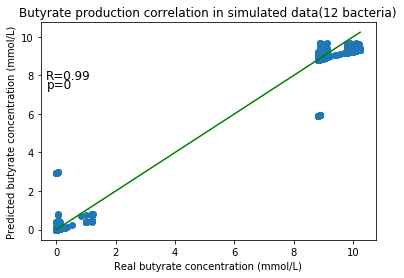

In [39]:
plt.title ('Butyrate production correlation in simulated data(12 bacteria)')  
plt.scatter (x12, y12)  
plt.plot (np.unique(x12), np.poly1d(np.polyfit(x12,y12, 1))(np.unique(x12)), color = 'green')  
plt.xlabel ('Real butyrate concentration (mmol/L)')  
plt.ylabel ('Predicted butyrate concentration (mmol/L)') 
plt.annotate("R=0.99",xy=(2, 9), xycoords='data',
            xytext=(0.4, 8),size=12, va="center", ha="center")
plt.annotate("p=0",xy=(2, 9), xycoords='data',
            xytext=(0.1,7.5),size=12, va="center", ha="center")
plt.savefig("Correlation12bact_S.png", dpi=300,bbox_inches='tight')

# 13 bact example


In [18]:
#tst=pd.read_table(folder + "train/13_bac/train13.txt")
tr=pd.read_table(folder + "simulaciones/res_simulations/train_data_simulated/train_13bactS")
tr


,conc,b1r1,b1r2,b1r3,b1r4,b1r5,b1r6,b1r7,b1r8,b1r9,...,pMC,pMD,pME,pMF,pMG,pMH,pMI,pMJ,pMK,pML
0,9.012388,1,0,1,0,0,1,1,1,0,...,0.998870,0.999831,0.995245,0.995831,0.995263,0.998702,0.998501,0.997740,0.995471,0.997540
1,9.012388,1,0,1,0,0,1,1,1,0,...,0.779402,0.994248,0.889697,0.955700,0.967754,0.895122,0.925139,0.780337,0.675149,0.763636
2,9.012388,1,0,1,0,0,1,1,1,0,...,0.998870,0.999831,0.995245,0.995831,0.995263,0.998702,0.984968,0.998501,0.997740,0.995471
3,9.012388,1,0,1,0,0,1,1,1,0,...,0.998870,0.999831,0.995245,0.995831,0.995263,0.998702,0.984968,0.998501,0.997740,0.997540
4,9.012388,1,0,1,0,0,1,1,1,0,...,0.998870,0.999831,0.995245,0.995831,0.995263,0.998702,0.984968,0.998501,0.995471,0.997540
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
26904,0.069801,1,0,1,0,0,1,1,1,0,...,0.998702,0.984968,0.996583,0.991835,0.998638,0.998241,0.998501,0.997740,0.995471,0.997540
26905,0.069801,1,0,1,0,0,1,1,1,0,...,0.998702,0.984968,0.996583,0.998638,0.998638,0.998241,0.998501,0.997740,0.995471,0.997540
26906,0.000000,1,0,1,0,0,1,1,1,0,...,0.998702,0.984968,0.991835,0.998638,0.998638,0.998241,0.998501,0.997740,0.995471,0.997540
26907,0.069801,1,0,1,0,0,1,1,1,0,...,0.998702,0.996583,0.991835,0.998638,0.998638,0.998241,0.998501,0.997740,0.995471,0.997540


In [19]:
X_test=tst.iloc [:, 1:26910].values


In [20]:
X = tr.iloc [:, 1:26910].values
y = tr.iloc[:, 0].values


In [22]:
#KNN regressor
neigh = KNeighborsRegressor(n_neighbors=3)
neigh.fit(X, y)
dump(neigh, 'knn_13bact.joblib') 

['knn_13bact.joblib']

In [23]:
from sklearn.model_selection import LeaveOneOut
loo = LeaveOneOut()
loo.get_n_splits(X)


26909

In [21]:

for i, (train_index, test_index) in enumerate(loo.split(X)):
    X_train, X_test = X[train_index], X[test_index]
 #   print(neigh.predict(X_test))
    print(f"{y[i]}\t{neigh.predict(X_test)}")
    
 

real value 9.01238847896118	predict: [9.01238848]
real value 9.01238847896118	predict: [9.01238848]
real value 9.01238847896118	predict: [9.01238848]
real value 9.01238847896118	predict: [9.01238848]
real value 9.01238847896118	predict: [9.01238848]
real value 9.12452574721451	predict: [9.08714666]
real value 9.12452574721451	predict: [9.12452575]
real value 9.12452574721451	predict: [9.08714666]
real value 9.12452574721451	predict: [9.12452575]
real value 9.12452574721451	predict: [9.12452575]
real value 9.12452574721451	predict: [9.12452575]
real value 9.12452574721451	predict: [9.12452575]
real value 9.12452574721451	predict: [9.12452575]
real value 9.12452574721451	predict: [9.12452575]
real value 9.12452574721451	predict: [9.12452575]
real value 9.12452574721451	predict: [9.12452575]
real value 9.12452574721451	predict: [9.12452575]
real value 9.12452574721451	predict: [9.12452575]
real value 9.12452574721451	predict: [9.12452575]
real value 9.12452574721451	predict: [9.12452575]


real value 9.01238847896118	predict: [9.01238848]
real value 9.01238847896118	predict: [9.01238848]
real value 9.01238847896118	predict: [9.01238848]
real value 9.01238847896118	predict: [9.01238848]
real value 9.01238847896118	predict: [9.01238848]
real value 9.01238847896118	predict: [9.01238848]
real value 9.01238847896118	predict: [9.01238848]
real value 9.01238847896118	predict: [9.01238848]
real value 9.01238847896118	predict: [9.01238848]
real value 9.01238847896118	predict: [9.01238848]
real value 9.01238847896118	predict: [9.01238848]
real value 9.01238847896118	predict: [9.01238848]
real value 9.01238847896118	predict: [9.01238848]
real value 9.01238847896118	predict: [9.01238848]
real value 9.01238847896118	predict: [9.01238848]
real value 9.01238847896118	predict: [9.01238848]
real value 9.01238847896118	predict: [9.01238848]
real value 9.01238847896118	predict: [9.01238848]
real value 9.01238847896118	predict: [9.01238848]
real value 9.01238847896118	predict: [9.01238848]


real value 9.12452574721451	predict: [9.12452575]
real value 9.12452574721451	predict: [9.12452575]
real value 9.12452574721451	predict: [9.12452575]
real value 9.12452574721451	predict: [9.12452575]
real value 9.01238847896118	predict: [9.01238848]
real value 9.01238847896118	predict: [9.01238848]
real value 9.01238847896118	predict: [9.01238848]
real value 9.01238847896118	predict: [9.01238848]
real value 9.01238847896118	predict: [9.01238848]
real value 9.01238847896118	predict: [9.01238848]
real value 9.01238847896118	predict: [9.01238848]
real value 9.01238847896118	predict: [9.01238848]
real value 9.01238847896118	predict: [9.01238848]
real value 9.01238847896118	predict: [9.01238848]
real value 9.01238847896118	predict: [9.01238848]
real value 9.01238847896118	predict: [9.01238848]
real value 9.01238847896118	predict: [9.01238848]
real value 9.01238847896118	predict: [9.01238848]
real value 9.01238847896118	predict: [9.01238848]
real value 9.01238847896118	predict: [9.01238848]


real value 9.12452574721451	predict: [9.12452575]
real value 9.12452574721451	predict: [9.12452575]
real value 9.12452574721451	predict: [9.12452575]
real value 9.12452574721451	predict: [9.12452575]
real value 9.12452574721451	predict: [9.12452575]
real value 9.12452574721451	predict: [9.12452575]
real value 9.12452574721451	predict: [9.12452575]
real value 9.12452574721451	predict: [9.12452575]
real value 9.12452574721451	predict: [9.12452575]
real value 9.12452574721451	predict: [9.12452575]
real value 9.12452574721451	predict: [9.12452575]
real value 9.12452574721451	predict: [9.12452575]
real value 9.12452574721451	predict: [9.12452575]
real value 9.12452574721451	predict: [9.12452575]
real value 9.12452574721451	predict: [9.12452575]
real value 9.12452574721451	predict: [9.12452575]
real value 9.12452574721451	predict: [9.12452575]
real value 9.12452574721451	predict: [9.12452575]
real value 9.12452574721451	predict: [9.12452575]
real value 9.12452574721451	predict: [9.12452575]


real value 9.01238847896118	predict: [9.01238848]
real value 9.01238847896118	predict: [9.01238848]
real value 9.01238847896118	predict: [9.01238848]
real value 9.01238847896118	predict: [9.01238848]
real value 9.01238847896118	predict: [9.01238848]
real value 9.01238847896118	predict: [9.01238848]
real value 9.01238847896118	predict: [9.01238848]
real value 9.01238847896118	predict: [9.01238848]
real value 9.01238847896118	predict: [9.01238848]
real value 9.01238847896118	predict: [9.01238848]
real value 9.01238847896118	predict: [9.01238848]
real value 9.01238847896118	predict: [9.01238848]
real value 9.01238847896118	predict: [9.01238848]
real value 9.01238847896118	predict: [9.01238848]
real value 9.01238847896118	predict: [9.01238848]
real value 9.01238847896118	predict: [9.01238848]
real value 9.01238847896118	predict: [9.01238848]
real value 9.01238847896118	predict: [9.01238848]
real value 9.01238847896118	predict: [9.01238848]
real value 9.01238847896118	predict: [9.01238848]


real value 9.12452574721451	predict: [9.12452575]
real value 9.12452574721451	predict: [9.12452575]
real value 9.12452574721451	predict: [9.12452575]
real value 9.12452574721451	predict: [9.12452575]
real value 9.12452574721451	predict: [9.12452575]
real value 9.12452574721451	predict: [9.12452575]
real value 9.12452574721451	predict: [9.12451678]
real value 9.12452574721451	predict: [9.12451678]
real value 9.12452574721451	predict: [9.12451678]
real value 9.12452574721451	predict: [9.12450781]
real value 9.12452574721451	predict: [9.12451678]
real value 9.12452574721451	predict: [9.12451678]
real value 9.01238847896118	predict: [9.01238848]
real value 9.01238847896118	predict: [9.01238848]
real value 9.01238847896118	predict: [9.01238848]
real value 9.01238847896118	predict: [9.01238848]
real value 9.01238847896118	predict: [9.01238848]
real value 9.01238847896118	predict: [9.01238848]
real value 9.01238847896118	predict: [9.01238848]
real value 9.01238847896118	predict: [9.01238848]


real value 9.12452574721451	predict: [9.12451678]
real value 9.12452574721451	predict: [9.12451678]
real value 9.12452574721451	predict: [9.12451678]
real value 9.12452574721451	predict: [9.12451678]
real value 9.12452574721451	predict: [9.12451678]
real value 9.12452574721451	predict: [9.12451678]
real value 9.12452574721451	predict: [9.12451678]
real value 9.12452574721451	predict: [9.12451678]
real value 9.12452574721451	predict: [9.12451678]
real value 9.12452574721451	predict: [9.12451678]
real value 9.12452574721451	predict: [9.12451678]
real value 9.12452574721451	predict: [9.12451678]
real value 9.12452574721451	predict: [9.12451678]
real value 9.12452574721451	predict: [9.12451678]
real value 9.12452574721451	predict: [9.12451678]
real value 9.12452574721451	predict: [9.12451678]
real value 9.12452574721451	predict: [9.12452575]
real value 9.12452574721451	predict: [9.12452575]
real value 9.12452574721451	predict: [9.12452575]
real value 9.12452574721451	predict: [9.12452575]


real value 9.01238847896118	predict: [9.01238848]
real value 9.01238847896118	predict: [9.01238848]
real value 9.01238847896118	predict: [9.01238848]
real value 9.01238847896118	predict: [9.01238848]
real value 9.01238847896118	predict: [9.01238848]
real value 9.01238847896118	predict: [9.01238848]
real value 9.01238847896118	predict: [9.01238848]
real value 9.01238847896118	predict: [9.01238848]
real value 9.01238847896118	predict: [9.01238848]
real value 9.01238847896118	predict: [9.01238848]
real value 9.01238847896118	predict: [9.01238848]
real value 9.01238847896118	predict: [9.01238848]
real value 9.01238847896118	predict: [9.01238848]
real value 9.01238847896118	predict: [9.01238848]
real value 9.01238847896118	predict: [9.01238848]
real value 9.12452574721451	predict: [9.12450781]
real value 9.12452574721451	predict: [9.12450781]
real value 9.12452574721451	predict: [9.12450781]
real value 9.12452574721451	predict: [9.12450781]
real value 9.12452574721451	predict: [9.12450781]


real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	pr

real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12450781]
real value 9.1244988353275	predict: [9.12450781]
real value 9.1244988353275	predict: [9.12450781]
real value 9.1244988353275	predict: [9.12450781]
real value 9.1244988353275	predict: [9.12450781]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012

real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.012388478805189	predict: [9.01238848]
real value 9.01238

real value 9.1244988353275	predict: [9.12450781]
real value 9.1244988353275	predict: [9.12450781]
real value 9.1244988353275	predict: [9.12450781]
real value 9.1244988353275	predict: [9.12450781]
real value 9.1244988353275	predict: [9.12450781]
real value 9.1244988353275	predict: [9.12450781]
real value 9.1244988353275	predict: [9.12450781]
real value 9.1244988353275	predict: [9.12450781]
real value 9.1244988353275	predict: [9.12450781]
real value 9.1244988353275	predict: [9.12450781]
real value 9.1244988353275	predict: [9.12450781]
real value 9.1244988353275	predict: [9.12450781]
real value 9.1244988353275	predict: [9.12450781]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real v

real value 9.1244988353275	predict: [9.12450781]
real value 9.1244988353275	predict: [9.12450781]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988

real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [

real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	pr

real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.1244988353275	predict: [9.12450781]
real value 9.1244988353275	predict: [9.12450781]
real value 9.1244988353275	predict: [9.12450781]
real value 9.1244988353275	predict: [9.12450781]
real value 9.1244988353275	predict: [9.

real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	pr

real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.124498

real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.1244988353275	predict: [9.08712872]
real value 9.1244988353275	predict: [9.08712872]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real

real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	pr

real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988

real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988

real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]


real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988

real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.012388478805189	predict: [9.01238848]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12507517]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value

real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988

real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988

real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988

real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988

real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988353275	predict: [9.12449884]
real value 9.1244988

real value 8.87819919905953	predict: [8.87821753]
real value 8.87819919905953	predict: [8.87823586]
real value 8.80848084537168	predict: [8.87645006]
real value 8.80848084537168	predict: [8.80848085]
real value 8.87819919905953	predict: [8.85495975]
real value 8.87819919905953	predict: [8.85495975]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.8

real value 8.80848084537168	predict: [8.80848085]
real value 8.80848084537168	predict: [8.80848085]
real value 8.80848084537168	predict: [8.80848085]
real value 8.80848084537168	predict: [8.80848085]
real value 8.80848084537168	predict: [8.80848085]
real value 8.80848084537168	predict: [8.80848085]
real value 8.80848084537168	predict: [8.80848085]
real value 8.90742790277527	predict: [8.8414632]
real value 8.80848084537168	predict: [8.80848085]
real value 8.80848084537168	predict: [8.80848085]
real value 8.80848084537168	predict: [8.80848085]
real value 8.80848084537168	predict: [8.80848085]
real value 8.80848084537168	predict: [8.80848085]
real value 8.80848084537168	predict: [8.80848085]
real value 8.80848084537168	predict: [8.80848085]
real value 8.80848084537168	predict: [8.80848085]
real value 8.80848084537168	predict: [8.80848085]
real value 8.80848084537168	predict: [8.80848085]
real value 8.80848084537168	predict: [8.80848085]
real value 8.80848084537168	predict: [8.80848085]
r

real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.8781991

real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.91118155]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.878199

real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.8781991

real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.8781991

real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.8781991

real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.8781991

real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.8781991

real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.8781991

real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.80848084537168	predict: [8.80848085]
real value 8.80848084537168	predict: [8.80848085]
real value 8.80848084537168	predict: [8.80848085]
real value 8.80848084537168	predict: [8.80848085]
real value 8.80848084537168	predict: [8.80848085]
real value 8.80848084537168	predict: [8.80848085]
real value 8.80848084537168	predict: [8.80848085]
real value 8.

real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.80848084537168	predict: [8.80848085]
real value 8.80848084537168	predict: [8.80848085]
real value 8.80848084537168	predict: [8.80848085]
real value 8.80848084537168	predict: [8.80848085]
real value 8.80848084537168	predict: [8.80848085]
real value 8.80848084537168	predict: [8.80848085]
real value 8.80848084537168	predict: [8.80848085]
real value 8.80848084537168	predict: [8.80848085]
real value 8.80848084537168	predict: [8.80848085]
real value 8.80848084537168	predict: [8.80848085]
real value 8.80848084537168	predict: [8.80848085]
real valu

real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.87819919905953	predict: [8.8781992]
real value 8.8781991

real value 8.80848084537168	predict: [8.87645006]
real value 8.80848084537168	predict: [8.80848085]
real value 8.80848084537168	predict: [8.80848085]
real value 8.80848084537168	predict: [8.80848085]
real value 8.80848084537168	predict: [8.87645006]
real value 8.80848084537168	predict: [8.80848085]
real value 8.80848084537168	predict: [8.80848085]
real value 8.80848084537168	predict: [8.87645006]
real value 8.80848084537168	predict: [8.80848085]
real value 8.80848084537168	predict: [8.80848085]
real value 8.80848084537168	predict: [8.80848085]
real value 8.80848084537168	predict: [8.80848085]
real value 8.80848084537168	predict: [8.80848085]
real value 8.80848084537168	predict: [8.80848085]
real value 8.80848084537168	predict: [8.80848085]
real value 8.80848084537168	predict: [8.80848085]
real value 8.80848084537168	predict: [8.80848085]
real value 8.80848084537168	predict: [8.80848085]
real value 8.80848084537168	predict: [8.80848085]
real value 8.80848084537168	predict: [8.80848085]


real value 8.80848084532733	predict: [8.80848085]
real value 8.80848084532733	predict: [8.80848085]
real value 8.80848084532733	predict: [8.80848085]
real value 8.80848084532733	predict: [8.80848085]
real value 8.80848084532733	predict: [8.80848085]
real value 8.80848084532733	predict: [8.80848085]
real value 8.80848084532733	predict: [8.80848085]
real value 8.80848084532733	predict: [8.80848085]
real value 8.80848084532733	predict: [8.80848085]
real value 8.80848084532733	predict: [8.80848085]
real value 8.80848084532733	predict: [8.80848085]
real value 8.80848084532733	predict: [8.80848085]
real value 8.80848084532733	predict: [8.80848085]
real value 8.80848084532733	predict: [8.80848085]
real value 8.80848084532733	predict: [8.80848085]
real value 8.80848084532733	predict: [8.80848085]
real value 8.80848084532733	predict: [8.80848085]
real value 8.80848084532733	predict: [8.80848085]
real value 8.80848084532733	predict: [8.80848085]
real value 8.80848084532733	predict: [8.80848085]


real value 8.80848084532733	predict: [8.80848085]
real value 8.80848084532733	predict: [8.80848085]
real value 8.80848084532733	predict: [8.80848085]
real value 8.80848084532733	predict: [8.80848085]
real value 8.80848084532733	predict: [8.80848085]
real value 8.80848084532733	predict: [8.80848085]
real value 8.80848084532733	predict: [8.80848085]
real value 8.80848084532733	predict: [8.80848085]
real value 8.80848084532733	predict: [8.80848085]
real value 8.80848084532733	predict: [8.80848085]
real value 8.80848084532733	predict: [8.80848085]
real value 8.80848084532733	predict: [8.80848085]
real value 8.80848084532733	predict: [8.80848085]
real value 8.80848084532733	predict: [8.80848085]
real value 8.80848084532733	predict: [8.80848085]
real value 8.80848084532733	predict: [8.80848085]
real value 8.80848084532733	predict: [8.80848085]
real value 8.80848084532733	predict: [8.80848085]
real value 8.80848084532733	predict: [8.80848085]
real value 8.80848084532733	predict: [8.80848085]


real value 8.87825418315185	predict: [8.87825418]
real value 8.87825418315185	predict: [8.87825418]
real value 8.87825418315185	predict: [8.87825418]
real value 8.87825418315185	predict: [8.87825418]
real value 8.87825418315185	predict: [8.87825418]
real value 8.87825418315185	predict: [8.87825418]
real value 8.87825418315185	predict: [8.87825418]
real value 8.87825418315185	predict: [8.87825418]
real value 8.87825418315185	predict: [8.87825418]
real value 8.87825418315185	predict: [8.87825418]
real value 8.87825418315185	predict: [8.87823586]
real value 8.87825418315185	predict: [8.87825418]
real value 8.87825418315185	predict: [8.87825418]
real value 8.87825418315185	predict: [8.87825418]
real value 8.87825418315185	predict: [8.87825418]
real value 8.87825418315185	predict: [8.87825418]
real value 8.87825418315185	predict: [8.87823586]
real value 8.87825418315185	predict: [8.87825418]
real value 8.87825418315185	predict: [8.87825418]
real value 8.87825418315185	predict: [8.87825418]


real value 8.80848084532733	predict: [8.80848085]
real value 8.80848084532733	predict: [8.80848085]
real value 8.87825418315185	predict: [8.87825418]
real value 8.87825418315185	predict: [8.87825418]
real value 8.87825418315185	predict: [8.87825418]
real value 8.87825418315185	predict: [8.87825418]
real value 8.87825418315185	predict: [8.87825418]
real value 8.87825418315185	predict: [8.87825418]
real value 8.87825418315185	predict: [8.87825418]
real value 8.87825418315185	predict: [8.87825418]
real value 8.87825418315185	predict: [8.87825418]
real value 8.80848084532733	predict: [8.80848085]
real value 8.87825418315185	predict: [8.87825418]
real value 8.87825418315185	predict: [8.87825418]
real value 8.87825418315185	predict: [8.87825418]
real value 8.87825418315185	predict: [8.87825418]
real value 8.87825418315185	predict: [8.87825418]
real value 8.87825418315185	predict: [8.87825418]
real value 9.11062539573819	predict: [8.95571125]
real value 8.87825418315185	predict: [8.87825418]


real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.069

real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.069

real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.069

real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.069

real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.069

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	pre

real value 0.0	predict: [0.00062228]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.00062228]
real value 0.0	predict: [0.00031114]
real value 0.0	predict: [0.00031114]
real value 0.0	predict: [0.00031114]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.0

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value

real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.069

real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.06977334]
real value 0.06977333782451599	predict: [0.069

real value 0.069731238343095	predict: [0.07004238]
real value 0.069731238343095	predict: [0.06973124]
real value 0.070664659863807	predict: [0.07066466]
real value 0.070664659863807	predict: [0.07035352]
real value 0.070664659863807	predict: [0.07035352]
real value 0.069731238343095	predict: [0.07004238]
real value 0.069731238343095	predict: [0.07004238]
real value 0.069731238343095	predict: [0.07004238]
real value 0.070664659863807	predict: [0.07035352]
real value 0.070664659863807	predict: [0.07035352]
real value 0.070664659863807	predict: [0.07035352]
real value 0.069731238343095	predict: [0.07004238]
real value 0.070664659863807	predict: [0.07035352]
real value 0.069731238343095	predict: [0.07004238]
real value 0.069731238343095	predict: [0.07004238]
real value 0.069731238343095	predict: [0.07004238]
real value 0.070664659863807	predict: [0.07035352]
real value 0.070664659863807	predict: [0.07035352]
real value 0.070664659863807	predict: [0.07035352]
real value 0.069731238343095	pr

real value 0.070664659863807	predict: [0.07066466]
real value 0.070664659863807	predict: [0.07066466]
real value 0.069731238343095	predict: [0.06973124]
real value 0.070664659863807	predict: [0.07066466]
real value 0.070664659863807	predict: [0.07066466]
real value 0.070664659863807	predict: [0.07035352]
real value 0.070664659863807	predict: [0.07035352]
real value 0.069731238343095	predict: [0.07004238]
real value 0.069731238343095	predict: [0.07004238]
real value 0.069731238343095	predict: [0.07004238]
real value 0.070664659863807	predict: [0.07035352]
real value 0.070664659863807	predict: [0.07035352]
real value 0.070664659863807	predict: [0.07035352]
real value 0.069731238343095	predict: [0.07004238]
real value 0.070664659863807	predict: [0.07035352]
real value 0.069731238343095	predict: [0.07004238]
real value 0.069731238343095	predict: [0.07004238]
real value 0.069731238343095	predict: [0.07004238]
real value 0.070664659863807	predict: [0.07035352]
real value 0.070664659863807	pr

real value 0.070664659863807	predict: [0.07066466]
real value 0.070664659863807	predict: [0.07066466]
real value 0.070664659863807	predict: [0.07066466]
real value 0.069731238343095	predict: [0.07004238]
real value 0.070664659863807	predict: [0.07035352]
real value 0.070664659863807	predict: [0.07066466]
real value 0.070664659863807	predict: [0.07066466]
real value 0.070664659863807	predict: [0.07066466]
real value 0.070664659863807	predict: [0.07066466]
real value 0.069731238343095	predict: [0.07004238]
real value 0.070664659863807	predict: [0.07035352]
real value 0.070664659863807	predict: [0.07066466]
real value 0.070664659863807	predict: [0.07066466]
real value 0.070664659863807	predict: [0.07066466]
real value 0.069731238343095	predict: [0.07004238]
real value 0.069731238343095	predict: [0.07004238]
real value 0.069731238343095	predict: [0.07004238]
real value 0.070664659863807	predict: [0.07035352]
real value 0.070664659863807	predict: [0.07035352]
real value 0.070664659863807	pr

real value 0.070664659863807	predict: [0.07066466]
real value 0.070664659863807	predict: [0.07066466]
real value 0.069731238343095	predict: [0.07004238]
real value 0.070664659863807	predict: [0.07035352]
real value 0.070664659863807	predict: [0.07066466]
real value 0.070664659863807	predict: [0.07066466]
real value 0.070664659863807	predict: [0.07066466]
real value 0.070664659863807	predict: [0.07066466]
real value 0.069731238343095	predict: [0.07004238]
real value 0.070664659863807	predict: [0.07035352]
real value 0.070664659863807	predict: [0.07066466]
real value 0.070664659863807	predict: [0.07066466]
real value 0.070664659863807	predict: [0.07066466]
real value 0.069731238343095	predict: [0.07004238]
real value 0.069731238343095	predict: [0.07004238]
real value 0.069731238343095	predict: [0.07004238]
real value 0.070664659863807	predict: [0.07035352]
real value 0.070664659863807	predict: [0.07035352]
real value 0.070664659863807	predict: [0.07035352]
real value 0.069731238343095	pr

real value 0.070664659863807	predict: [0.07038656]
real value 0.070664659863807	predict: [0.07038656]
real value 0.070664659863807	predict: [0.07010845]
real value 0.000933421520712	predict: [0.00032257]
real value 0.070664659863807	predict: [0.07036755]
real value 0.070664659863807	predict: [0.07066466]
real value 0.070664659863807	predict: [0.07066466]
real value 0.070664659863807	predict: [0.07066466]
real value 0.069731238343095	predict: [0.07004238]
real value 0.070664659863807	predict: [0.07035352]
real value 0.070664659863807	predict: [0.07066466]
real value 0.070664659863807	predict: [0.07035352]
real value 0.070664659863807	predict: [0.07035352]
real value 0.069731238343095	predict: [0.07004238]
real value 0.069731238343095	predict: [0.07004238]
real value 0.069731238343095	predict: [0.07004238]
real value 0.070664659863807	predict: [0.07035352]
real value 0.070664659863807	predict: [0.07035352]
real value 0.070664659863807	predict: [0.07035352]
real value 0.069731238343095	pr

real value 0.000933421520712	predict: [0.00093342]
real value 0.000933421520712	predict: [0.00093342]
real value 0.070664659863807	predict: [0.07066466]
real value 0.070664659863807	predict: [0.07066466]
real value 0.070664659863807	predict: [0.07066466]
real value 0.070664659863807	predict: [0.07066466]
real value 0.069731238343095	predict: [0.07004238]
real value 0.070664659863807	predict: [0.07035352]
real value 0.070664659863807	predict: [0.07066466]
real value 0.070664659863807	predict: [0.07066466]
real value 0.070664659863807	predict: [0.07066466]
real value 0.069731238343095	predict: [0.07004238]
real value 0.069731238343095	predict: [0.07004238]
real value 0.069731238343095	predict: [0.07004238]
real value 0.070664659863807	predict: [0.07035352]
real value 0.070664659863807	predict: [0.07035352]
real value 0.070664659863807	predict: [0.07035352]
real value 0.069731238343095	predict: [0.06973124]
real value 0.070664659863807	predict: [0.07066466]
real value 0.070664659863807	pr

real value 0.069830346544231	predict: [0.06983035]
real value 0.069830346544231	predict: [0.06983035]
real value 0.069830346544231	predict: [0.06983035]
real value 0.069830346544231	predict: [0.06983035]
real value 0.069830346544231	predict: [0.06983035]
real value 0.069830346544231	predict: [0.06983035]
real value 0.069830346544231	predict: [0.06983035]
real value 0.069830346544231	predict: [0.06983035]
real value 0.069830346544231	predict: [0.06983035]
real value 0.069830346544231	predict: [0.06983035]
real value 0.069830346544231	predict: [0.06983035]
real value 0.069830346544231	predict: [0.06983035]
real value 0.069830346544231	predict: [0.06983035]
real value 0.069830346544231	predict: [0.06983035]
real value 0.069830346544231	predict: [0.06983035]
real value 0.069830346544231	predict: [0.06983035]
real value 0.069830346544231	predict: [0.06983035]
real value 0.069830346544231	predict: [0.06983035]
real value 0.069830346544231	predict: [0.06983035]
real value 0.069830346544231	pr

real value 1.71507654742462e-05	predict: [1.71507655e-05]
real value 1.71507654742462e-05	predict: [2.00377854e-05]
real value 1.71507654742462e-05	predict: [2.00377854e-05]
real value 1.71507654742462e-05	predict: [2.00377854e-05]
real value 1.71507654742462e-05	predict: [2.00377854e-05]
real value 1.71507654742462e-05	predict: [1.71507655e-05]
real value 1.71507654742462e-05	predict: [1.71507655e-05]
real value 1.71507654742462e-05	predict: [2.29248053e-05]
real value 0.069830346544231	predict: [0.06981309]
real value 0.069830346544231	predict: [0.06982172]
real value 0.069830346544231	predict: [0.06982172]
real value 0.069830346544231	predict: [0.06982172]
real value 0.069830346544231	predict: [0.06982172]
real value 0.069830346544231	predict: [0.06982172]
real value 0.069830346544231	predict: [0.06981309]
real value 0.069830346544231	predict: [0.06982172]
real value 0.069830346544231	predict: [0.06982172]
real value 0.069830346544231	predict: [0.06982172]
real value 0.0698303465442

real value 0.069804458369027	predict: [0.06981309]
real value 0.069804458369027	predict: [0.06981309]
real value 0.069804458369027	predict: [0.06981309]
real value 0.069804458369027	predict: [0.06981309]
real value 0.069804458369027	predict: [0.06981309]
real value 0.069804458369027	predict: [0.06981309]
real value 0.069804458369027	predict: [0.06981309]
real value 0.069804458369027	predict: [0.06981309]
real value 0.069804458369027	predict: [0.06981309]
real value 0.069804458369027	predict: [0.06981309]
real value 0.069804458369027	predict: [0.06981309]
real value 0.069804458369027	predict: [0.06981309]
real value 0.069804458369027	predict: [0.06981309]
real value 0.069804458369027	predict: [0.06981309]
real value 0.069804458369027	predict: [0.06981309]
real value 0.069804458369027	predict: [0.06981309]
real value 0.069804458369027	predict: [0.06981309]
real value 0.069804458369027	predict: [0.06981309]
real value 0.069804458369027	predict: [0.06981309]
real value 0.069804458369027	pr

real value 0.069804458369027	predict: [0.06980446]
real value 0.069804458369027	predict: [0.06980446]
real value 0.069804458369027	predict: [0.06980446]
real value 0.069804458369027	predict: [0.06980446]
real value 0.069804458369027	predict: [0.06980446]
real value 0.069804458369027	predict: [0.06980446]
real value 0.069804458369027	predict: [0.06980446]
real value 0.069804458369027	predict: [0.06980446]
real value 0.069804458369027	predict: [0.06980446]
real value 0.069804458369027	predict: [0.06980446]
real value 0.069804458369027	predict: [0.06980446]
real value 0.069804458369027	predict: [0.06980446]
real value 0.069804458369027	predict: [0.06980446]
real value 0.069804458369027	predict: [0.06980446]
real value 0.069804458369027	predict: [0.06980446]
real value 0.069804458369027	predict: [0.06980446]
real value 0.069804458369027	predict: [0.06980446]
real value 0.069804458369027	predict: [0.06980446]
real value 0.069804458369027	predict: [0.06980446]
real value 0.069804458369027	pr

real value 0.069804458369027	predict: [0.069798]
real value 0.069804458369027	predict: [0.069798]
real value 0.069804458369027	predict: [0.069798]
real value 0.069804458369027	predict: [0.069798]
real value 0.069804458369027	predict: [0.069798]
real value 0.069804458369027	predict: [0.069798]
real value 0.069804458369027	predict: [0.069798]
real value 0.069804458369027	predict: [0.069798]
real value 0.069804458369027	predict: [0.069798]
real value 0.069804458369027	predict: [0.069798]
real value 0.069804458369027	predict: [0.069798]
real value 0.069804458369027	predict: [0.069798]
real value 0.069804458369027	predict: [0.069798]
real value 0.069804458369027	predict: [0.069798]
real value 0.069804458369027	predict: [0.069798]
real value 0.069804458369027	predict: [0.069798]
real value 2.5811825221315e-05	predict: [1.72078835e-05]
real value 2.5811825221315e-05	predict: [1.72078835e-05]
real value 2.5811825221315e-05	predict: [1.72078835e-05]
real value 2.5811825221315e-05	predict: [1.72

real value 0.069804458369027	predict: [0.06980446]
real value 0.069804458369027	predict: [0.06980446]
real value 0.069804458369027	predict: [0.06980446]
real value 0.069804458369027	predict: [0.06980446]
real value 0.069804458369027	predict: [0.06980446]
real value 0.069804458369027	predict: [0.06980446]
real value 0.069804458369027	predict: [0.06980446]
real value 0.069804458369027	predict: [0.06980446]
real value 0.069804458369027	predict: [0.06980446]
real value 0.069804458369027	predict: [0.06980446]
real value 0.069804458369027	predict: [0.06980446]
real value 0.069804458369027	predict: [0.06980446]
real value 0.069804458369027	predict: [0.06980446]
real value 0.069804458369027	predict: [0.06980446]
real value 0.069804458369027	predict: [0.06980446]
real value 0.069804458369027	predict: [0.06980446]
real value 0.069804458369027	predict: [0.06980446]
real value 0.069804458369027	predict: [0.06980446]
real value 0.069804458369027	predict: [0.06980446]
real value 0.069804458369027	pr

real value 0.06978508906568201	predict: [0.07065589]
real value 0.06978508906568201	predict: [0.0703627]
real value 0.06978508906568201	predict: [0.0703627]
real value 0.06978508906568201	predict: [0.0703627]
real value 0.06978508906568201	predict: [0.06978509]
real value 0.06978508906568201	predict: [0.06978509]
real value 0.06978508906568201	predict: [0.0703627]
real value 0.06978508906568201	predict: [0.0703627]
real value 0.06978508906568201	predict: [0.0703627]
real value 0.06978508906568201	predict: [0.06978486]
real value 0.06978508906568201	predict: [0.06978486]
real value 0.06978508906568201	predict: [0.06978486]
real value 0.06978508906568201	predict: [0.0703627]
real value 0.06978508906568201	predict: [0.0703627]
real value 0.06978508906568201	predict: [0.0703627]
real value 0.06978508906568201	predict: [0.06978486]
real value 0.06978508906568201	predict: [0.0703627]
real value 0.06978508906568201	predict: [0.06978486]
real value 0.06978508906568201	predict: [0.06978486]
rea

real value 0.06978508906568201	predict: [0.06978509]
real value 0.06978508906568201	predict: [0.06978509]
real value 0.06978508906568201	predict: [0.06978509]
real value 0.06978508906568201	predict: [0.06978509]
real value 0.06978508906568201	predict: [0.06978509]
real value 0.06978508906568201	predict: [0.06978509]
real value 0.06978508906568201	predict: [0.06978509]
real value 0.06978508906568201	predict: [0.06978509]
real value 0.06978508906568201	predict: [0.06978509]
real value 0.06978508906568201	predict: [0.06978509]
real value 0.06978508906568201	predict: [0.06978509]
real value 0.06978508906568201	predict: [0.06978509]
real value 0.06978508906568201	predict: [0.06978509]
real value 0.06978508906568201	predict: [0.06978509]
real value 0.06978508906568201	predict: [0.06978509]
real value 0.06978508906568201	predict: [0.06978509]
real value 0.06978508906568201	predict: [0.06978509]
real value 0.06978508906568201	predict: [0.06978509]
real value 0.06978508906568201	predict: [0.069

real value 0.06978508906568201	predict: [0.06978509]
real value 0.06978508906568201	predict: [0.06978509]
real value 0.06978508906568201	predict: [0.06978509]
real value 0.06978508906568201	predict: [0.06978509]
real value 0.06978508906568201	predict: [0.06978509]
real value 0.06978508906568201	predict: [0.06978509]
real value 0.0	predict: [0.]
real value 0.06978508906568201	predict: [0.06978509]
real value 0.06978508906568201	predict: [0.06978509]
real value 0.06978508906568201	predict: [0.06978509]
real value 0.06978508906568201	predict: [0.06978509]
real value 0.06978508906568201	predict: [0.06978509]
real value 0.06978508906568201	predict: [0.06978509]
real value 0.06978508906568201	predict: [0.06978509]
real value 0.06978508906568201	predict: [0.06978509]
real value 0.06978508906568201	predict: [0.06978509]
real value 0.06978508906568201	predict: [0.06978509]
real value 0.0	predict: [0.]
real value 0.06978508906568201	predict: [0.06978509]
real value 0.06978508906568201	predict: [

real value 8.808480845337929	predict: [8.80848085]
real value 8.808480845337929	predict: [8.80848085]
real value 8.808480845337929	predict: [8.80848085]
real value 8.808480845337929	predict: [8.80848085]
real value 8.808480845337929	predict: [8.80848085]
real value 8.808480845337929	predict: [8.80848085]
real value 8.808480845337929	predict: [8.80848085]
real value 8.808480845337929	predict: [8.80848085]
real value 8.808480845337929	predict: [8.80848085]
real value 8.808480845337929	predict: [8.80848085]
real value 8.808480845337929	predict: [8.80848085]
real value 8.808480845337929	predict: [8.80848085]
real value 8.808480845337929	predict: [8.80848085]
real value 8.808480845337929	predict: [8.80848085]
real value 8.808480845337929	predict: [8.80848085]
real value 8.808480845337929	predict: [8.80848085]
real value 8.808480845337929	predict: [8.80848085]
real value 8.808480845337929	predict: [8.80848085]
real value 8.808480845337929	predict: [8.80848085]
real value 8.808480845337929	pr

real value 8.87826593440361	predict: [8.87826593]
real value 8.87826593440361	predict: [8.87826593]
real value 8.87826593440361	predict: [8.87826593]
real value 8.87826593440361	predict: [8.87826593]
real value 8.87826593440361	predict: [8.87826593]
real value 8.87826593440361	predict: [8.87826593]
real value 8.87826593440361	predict: [8.87826593]
real value 8.87826593440361	predict: [8.87826593]
real value 8.87826593440361	predict: [8.87826593]
real value 8.87826593440361	predict: [8.87826593]
real value 8.87826593440361	predict: [8.87826593]
real value 8.87826593440361	predict: [8.87826593]
real value 8.87826593440361	predict: [8.87826593]
real value 8.87826593440361	predict: [8.87826593]
real value 8.87826593440361	predict: [8.87826593]
real value 8.87826593440361	predict: [8.87826593]
real value 8.87826593440361	predict: [8.87826593]
real value 8.87826593440361	predict: [8.87826593]
real value 8.87826593440361	predict: [8.87826593]
real value 8.87826593440361	predict: [8.87826593]


real value 8.87826593440361	predict: [8.87826593]
real value 8.87826593440361	predict: [8.87826593]
real value 8.87826593440361	predict: [8.87826593]
real value 8.87826593440361	predict: [8.87826593]
real value 8.87826593440361	predict: [8.87826593]
real value 8.87826593440361	predict: [8.87826593]
real value 8.87826593440361	predict: [8.87826593]
real value 8.87826593440361	predict: [8.87826593]
real value 8.87826593440361	predict: [8.87826593]
real value 8.87826593440361	predict: [8.87826593]
real value 8.87826593440361	predict: [8.87826593]
real value 8.87826593440361	predict: [8.87826593]
real value 8.87826593440361	predict: [8.87826593]
real value 8.87826593440361	predict: [8.87826593]
real value 8.87826593440361	predict: [8.87826593]
real value 8.87826593440361	predict: [8.87826593]
real value 8.87826593440361	predict: [8.87826593]
real value 8.87826593440361	predict: [8.87826593]
real value 8.87826593440361	predict: [8.87826593]
real value 8.87826593440361	predict: [8.87826593]


real value 8.808480845337929	predict: [8.80848085]
real value 8.808480845337929	predict: [8.80848085]
real value 8.808480845337929	predict: [8.80848085]
real value 8.808480845337929	predict: [8.80848085]
real value 8.808480845337929	predict: [8.80848085]
real value 8.808480845337929	predict: [8.80848085]
real value 8.808480845337929	predict: [8.80848085]
real value 8.808480845337929	predict: [8.80848085]
real value 8.808480845337929	predict: [8.80848085]
real value 8.808480845337929	predict: [8.80848085]
real value 8.808480845337929	predict: [8.80848085]
real value 8.808480845337929	predict: [8.80848085]
real value 8.808480845337929	predict: [8.80848085]
real value 8.808480845337929	predict: [8.80848085]
real value 8.808480845337929	predict: [8.80848085]
real value 8.808480845337929	predict: [8.80848085]
real value 8.808480845337929	predict: [8.80848085]
real value 8.808480845337929	predict: [8.80848085]
real value 8.808480845337929	predict: [8.80848085]
real value 8.808480845337929	pr

real value 8.87826593440361	predict: [8.87826593]
real value 8.87826593440361	predict: [8.87826571]
real value 8.87826593440361	predict: [8.87884355]
real value 8.87826593440361	predict: [8.87826571]
real value 8.87826593440361	predict: [8.87826571]
real value 8.87826593440361	predict: [8.87826571]
real value 8.87826593440361	predict: [8.87884355]
real value 8.87826593440361	predict: [8.87884355]
real value 8.87826593440361	predict: [8.87884355]
real value 8.87826593440361	predict: [8.87826571]
real value 8.87826593440361	predict: [8.87826571]
real value 8.87826593440361	predict: [8.87826571]
real value 8.87826593440361	predict: [8.87826571]
real value 8.87826593440361	predict: [8.87884355]
real value 8.87826593440361	predict: [8.87826571]
real value 8.87826593440361	predict: [8.87826571]
real value 8.87826593440361	predict: [8.87826571]
real value 8.87826593440361	predict: [8.87884355]
real value 8.87826593440361	predict: [8.87826593]
real value 8.87826593440361	predict: [8.87826593]


real value 8.808480845337929	predict: [8.88651576]
real value 8.808480845337929	predict: [8.80905869]
real value 8.808480845337929	predict: [8.80905869]
real value 8.808480845337929	predict: [8.80848085]
real value 8.808480845337929	predict: [8.80905869]
real value 8.808480845337929	predict: [8.80905869]
real value 8.808480845337929	predict: [8.80905869]
real value 8.808480845337929	predict: [8.80905869]
real value 8.808480845337929	predict: [8.80905869]
real value 8.808480845337929	predict: [8.80848085]
real value 8.808480845337929	predict: [8.80905869]
real value 8.808480845337929	predict: [8.80905869]
real value 8.808480845337929	predict: [8.80905869]
real value 8.808480845337929	predict: [8.80905869]
real value 8.808480845337929	predict: [8.80848085]
real value 8.808480845337929	predict: [8.80848085]
real value 8.808480845337929	predict: [8.80848085]
real value 8.808480845337929	predict: [8.80905869]
real value 8.808480845337929	predict: [8.80905869]
real value 8.808480845337929	pr

real value 8.87826593440361	predict: [8.87826571]
real value 8.87826593440361	predict: [8.87826571]
real value 8.87826593440361	predict: [8.87884355]
real value 8.87826593440361	predict: [8.87884355]
real value 8.87826593440361	predict: [8.87884355]
real value 8.87826593440361	predict: [8.87826571]
real value 8.87826593440361	predict: [8.87884355]
real value 8.87826593440361	predict: [8.87826571]
real value 8.87826593440361	predict: [8.87826571]
real value 8.87826593440361	predict: [8.87826571]
real value 8.87826593440361	predict: [8.87884355]
real value 8.87826593440361	predict: [8.87884355]
real value 8.87826593440361	predict: [8.87884355]
real value 8.87826593440361	predict: [8.87826571]
real value 8.87826593440361	predict: [8.87826571]
real value 8.87826593440361	predict: [8.87826571]
real value 8.87826593440361	predict: [8.87884355]
real value 8.87826593440361	predict: [8.87884355]
real value 8.87826593440361	predict: [8.87884355]
real value 8.87826593440361	predict: [8.87826571]


real value 8.8799987778635	predict: [8.87942094]
real value 8.8799987778635	predict: [8.87942094]
real value 8.8799987778635	predict: [8.87942094]
real value 8.87826525379117	predict: [8.87826548]
real value 8.8799987778635	predict: [8.87884332]
real value 8.87826525379117	predict: [8.87884332]
real value 8.87826525379117	predict: [8.87884332]
real value 8.87826525379117	predict: [8.87884332]
real value 8.8799987778635	predict: [8.87884332]
real value 8.8799987778635	predict: [8.87884332]
real value 8.8799987778635	predict: [8.87884332]
real value 8.87826525379117	predict: [8.87884332]
real value 8.87826525379117	predict: [8.87884332]
real value 8.87826525379117	predict: [8.87826548]
real value 8.87826525379117	predict: [8.87884332]
real value 8.8799987778635	predict: [8.87884332]
real value 8.87826525379117	predict: [8.87884332]
real value 8.87826525379117	predict: [8.87826548]
real value 8.87826525379117	predict: [8.87826548]
real value 8.8799987778635	predict: [8.87942116]
real valu

real value 8.8102143694015	predict: [8.80963653]
real value 8.8102143694015	predict: [8.80905869]
real value 8.80848084532917	predict: [8.80905869]
real value 8.8102143694015	predict: [8.80905869]
real value 8.8102143694015	predict: [8.80963653]
real value 8.8102143694015	predict: [8.80905869]
real value 8.8102143694015	predict: [8.80963653]
real value 8.8102143694015	predict: [8.80905869]
real value 8.80848084532917	predict: [8.80905869]
real value 8.8102143694015	predict: [8.80905869]
real value 8.8102143694015	predict: [8.80963653]
real value 8.8102143694015	predict: [8.80905869]
real value 8.8102143694015	predict: [8.80905869]
real value 8.80848084532917	predict: [8.80905869]
real value 8.80848084532917	predict: [8.80905869]
real value 8.80848084532917	predict: [8.80905869]
real value 8.8102143694015	predict: [8.80905869]
real value 8.8102143694015	predict: [8.80905869]
real value 8.8102143694015	predict: [8.80905869]
real value 8.80848084532917	predict: [8.80905869]
real value 8.8

real value 8.8799987778635	predict: [8.87942116]
real value 9.11063646637149	predict: [8.95630017]
real value 8.87826525379117	predict: [8.8788431]
real value 8.87826525379117	predict: [8.8788431]
real value 8.8799987778635	predict: [8.95687801]
real value 8.8799987778635	predict: [8.87942094]
real value 8.8799987778635	predict: [8.87942094]
real value 8.87826525379117	predict: [8.87826548]
real value 8.87826525379117	predict: [8.87826548]
real value 8.87826525379117	predict: [8.87826548]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.87826525379117	predict: [8.87826525]
real value 8.87826525379117	predict: [8.87826525]
real value 8.87826525379117	predict: [8.87826525]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.87826525379117	predict: [8.87826525]
real value 8

real value 8.8799987778635	predict: [8.87884355]
real value 8.8799987778635	predict: [8.87884355]
real value 8.8799987778635	predict: [8.87884355]
real value 8.87826525379117	predict: [8.87826571]
real value 8.87826525379117	predict: [8.87826571]
real value 8.87826525379117	predict: [8.87826571]
real value 8.8799987778635	predict: [8.87942116]
real value 8.8799987778635	predict: [8.87942116]
real value 8.8799987778635	predict: [8.87942116]
real value 8.87826525379117	predict: [8.87826548]
real value 8.87826525379117	predict: [8.87826548]
real value 8.87826525379117	predict: [8.87826548]
real value 8.8799987778635	predict: [8.87943579]
real value 8.8799987778635	predict: [8.87942116]
real value 8.8799987778635	predict: [8.87942116]
real value 8.87826525379117	predict: [8.87826548]
real value 8.8799987778635	predict: [8.87942116]
real value 8.8799987778635	predict: [8.87942116]
real value 8.8799987778635	predict: [8.87942116]
real value 8.87826525379117	predict: [8.87826548]
real value 8

real value 8.87826525379117	predict: [8.87826525]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.87826525379117	predict: [8.87826525]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.81021437]
real value 8.80848084532917	predict: [8.80848085]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.88767144]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8799

real value 8.8102143694015	predict: [8.80905869]
real value 8.80848084532917	predict: [8.80905869]
real value 8.8102143694015	predict: [8.80905869]
real value 8.80848084532917	predict: [8.80963653]
real value 8.80848084532917	predict: [8.80905869]
real value 8.80848084532917	predict: [8.80905869]
real value 8.8102143694015	predict: [8.80963653]
real value 8.8102143694015	predict: [8.80905869]
real value 8.8102143694015	predict: [8.80905869]
real value 8.80848084532917	predict: [8.80905869]
real value 8.80848084532917	predict: [8.80905869]
real value 8.80848084532917	predict: [8.80848085]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.80963653]
real value 8.8102143694015	predict: [8.80963653]
real value 8.80848084532917	predict: [8.80905869]
real value 8.80848084532917	predict: [8.80905869]
real value 8.80848084532917	predict: [8.80905869]
real value 8.8102143694015	predict: [8.80963653]
real value 8.8102143694015	predict: [8.80963653]
real value

real value 8.8102143694015	predict: [8.80963653]
real value 8.80848084532917	predict: [8.80905869]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.81021437]
real value 8.80848084532917	predict: [8.80848085]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.80963653]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.81021437]
real value 8.80848084532917	predict: [8.80848085]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.88767144]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.81021437]
real value 8.80848084532917	predict: [8.80905869]
real value 8.8102143694015	predict: [8.80963653]
real value 8.810

real value 8.8799987778635	predict: [8.87942094]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87943392]
real value 8.8799987778635	predict: [8.87999878]
real value 8.87826525379117	predict: [8.8788431]
real value 8.8799987778635	predict: [8.87942094]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.81021437]
real value 8.80848084532917	predict: [8.80905869]
real value 8.8102143694015	predict: [8.80963653]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8799987778635	predict: [8.87999878]
real value 8.879998

real value 8.8799987778635	predict: [8.87999878]
real value 8.87830421062266	predict: [8.87943392]
real value 8.8799987778635	predict: [8.87999878]
real value 8.87826525379117	predict: [8.87826525]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.81021437]
real value 8.80848084532917	predict: [8.80848085]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8782

real value 8.8102143694015	predict: [8.80963653]
real value 8.80848084532917	predict: [8.80905869]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.81021437]
real value 8.80848084532917	predict: [8.80905869]
real value 8.8102143694015	predict: [8.80963653]
real value 8.81025826327549	predict: [8.810229]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.81021437]
real value 8.80848084532917	predict: [8.80905869]
real value 8.8102143694015	predict: [8.80963653]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.80963653]
real value 8.80848084532917	predict: [8.80905869]
real value 8.8102143694015	predict: [8.80963653]
real value 8.8102

real value 8.8799987778635	predict: [8.87999878]
real value 8.87826525379117	predict: [8.87826525]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.87826525379117	predict: [8.87826525]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.85673731]
real value 8.8799987778635	predict: [8.87999878]
real value 8.87999

real value 8.80848084532917	predict: [8.80905869]
real value 8.80848084532917	predict: [8.80848085]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.80963653]
real value 8.8102143694015	predict: [8.80963653]
real value 8.80848084532917	predict: [8.80905869]
real value 8.80848084532917	predict: [8.80905869]
real value 8.80848084532917	predict: [8.80905869]
real value 8.8102143694015	predict: [8.80963653]
real value 8.8102143694015	predict: [8.80963653]
real value 8.8102143694015	predict: [8.80963653]
real value 8.80848084532917	predict: [8.80905869]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.80963653]
real value 8.80848084532917	predict: [8.80905869]
real value 8.8102143694015	predict: [8.80963653]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.80963653]
real value 8.8102143694015	predict: [8.80963653]
real value 8.

real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.81021437]
real value 8.80848084532917	predict: [8.80905869]
real value 8.8102143694015	predict: [8.80963653]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.87826525379117	predict: [8.87826525]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.87826525379117	predict: [8.8788431]
real value 8.87826525379117	predict: [8.8788431]
real value 8.87826

real value 8.8102143694015	predict: [8.81021437]
real value 8.80848084532917	predict: [8.80905869]
real value 8.8102143694015	predict: [8.80963653]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.87826525379117	predict: [8.8788431]
real value 8.8799987778635	predict: [8.87942094]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.87826525379117	predict: [8.8788431]
real value 8.87826525379117	predict: [8.8788431]
real value 8.87826525379117	predict: [8.8788431]
real value 8.8799987778635	predict: [8.87942094]
real value 8.8799987778635	predict: [8.87942094]
real value 8.879998

real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.87826525379117	predict: [8.87826525]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.87826525379117	predict: [8.87826525]
real value 8.87826525379117	predict: [8.87826525]
real value 8.87826525379117	predict: [8.87826525]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.87826525379117	predict: [8.87826525]
real value 8.8799987778635	predict: [8.87999878]
real value 8.87

real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.80963653]
real value 8.80848084532917	predict: [8.80905869]
real value 8.8102143694015	predict: [8.80963653]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.87826525379117	predict: [8.8788431]
real value 8.8799987778635	predict: [8.87942094]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.87826525379117	predict: [8.8788431]
real value 8.87826525379117	predict: [8.8788431]
real value 8.878265

real value 8.8799987778635	predict: [8.87999878]
real value 8.87826525379117	predict: [8.87826525]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8799987778635	predict: [8.85673731]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87942094]
real value 8.87826525379117	predict: [8.8788431]
real value 8.8799987778635	predict: [8.87942094]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87942094]
real value 8.8799987778635	predict: [8.87942094]
real value 8.87826525379117	predict: [8.87942094]
real value 8.87826525379117	predict: [8.87942094]
real value 8.87826525379117	predict: [8.8788431]
real value 8.8799

real value 8.8102143694015	predict: [8.80963653]
real value 8.80848084532917	predict: [8.80905869]
real value 8.8102143694015	predict: [8.80963653]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.87826525379117	predict: [8.8788431]
real value 8.8799987778635	predict: [8.87942094]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.87826525379117	predict: [8.8788431]
real value 8.87826525379117	predict: [8.8788431]
real value 8.87826525379117	predict: [8.8788431]
real value 8.8799987778635	predict: [8.87942094]
real value 8.8799987778635	predict: [8.87942094]
real value 8.879998

real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.87826525379117	predict: [8.8788431]
real value 8.8799987778635	predict: [8.87942094]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.87826525379117	predict: [8.8788431]
real value 8.8799987778635	predict: [8.87942094]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987

real value 0.001733524072324	predict: [0.00173352]
real value 0.001733524072324	predict: [0.00115568]
real value 0.001733524072324	predict: [0.00057784]
real value 0.0	predict: [0.00115568]
real value 0.0	predict: [0.00115568]
real value 0.0	predict: [0.00057784]
real value 0.001733524072324	predict: [0.00115568]
real value 0.001733524072324	predict: [0.00115568]
real value 0.001733524072324	predict: [0.00057784]
real value 0.0	predict: [0.00057784]
real value 0.001733524072324	predict: [0.00057784]
real value 0.0	predict: [0.00115568]
real value 0.0	predict: [0.00057784]
real value 0.0	predict: [0.00057784]
real value 0.001733524072324	predict: [0.00115568]
real value 0.001733524072324	predict: [0.00057784]
real value 0.001733524072324	predict: [0.00057784]
real value 0.0	predict: [0.00057784]
real value 0.0	predict: [0.]
real value 0.001733524072324	predict: [0.00173352]
real value 0.001733524072324	predict: [0.00115568]
real value 0.001733524072324	predict: [0.00115568]
real value 0

real value 0.001733524072324	predict: [0.00115568]
real value 0.0	predict: [0.00057784]
real value 0.0	predict: [0.00057784]
real value 0.0	predict: [0.00057784]
real value 0.001733524072324	predict: [0.00115568]
real value 0.001733524072324	predict: [0.00115568]
real value 0.001733524072324	predict: [0.00115568]
real value 0.0	predict: [0.00057784]
real value 0.001733524072324	predict: [0.00173352]
real value 0.001733524072324	predict: [0.00173352]
real value 0.001733524072324	predict: [0.00173352]
real value 0.0	predict: [0.]
real value 0.001733524072324	predict: [0.00173352]
real value 0.001733524072324	predict: [0.00173352]
real value 0.001733524072324	predict: [0.00173352]
real value 0.001733524072324	predict: [0.00173352]
real value 0.001733524072324	predict: [0.00173352]
real value 0.0	predict: [0.]
real value 0.001733524072324	predict: [0.00173352]
real value 0.001733524072324	predict: [0.00173352]
real value 0.001733524072324	predict: [0.00173352]
real value 0.001733524072324	

real value 0.069784408461998	predict: [0.07036225]
real value 0.07151793253432201	predict: [0.07094009]
real value 0.07151793253432201	predict: [0.07151793]
real value 0.07151793253432201	predict: [0.07151793]
real value 0.07151793253432201	predict: [0.07151793]
real value 0.07151793253432201	predict: [0.07151793]
real value 0.069784408461998	predict: [0.07036225]
real value 0.07151793253432201	predict: [0.07094009]
real value 0.07151793253432201	predict: [0.07151793]
real value 0.07151793253432201	predict: [0.07151793]
real value 0.07151793253432201	predict: [0.07151793]
real value 0.07151793253432201	predict: [0.07151793]
real value 0.07151793253432201	predict: [0.07151793]
real value 0.069784408461998	predict: [0.07036225]
real value 0.07151793253432201	predict: [0.07094009]
real value 0.07151793253432201	predict: [0.07151793]
real value 0.07151793253432201	predict: [0.07151793]
real value 0.001733524072324	predict: [0.00173352]
real value 0.001733524072324	predict: [0.00173352]
rea

real value 0.07151793253432201	predict: [0.07151793]
real value 0.07151793253432201	predict: [0.07151793]
real value 0.069784408461998	predict: [0.06978441]
real value 0.07151793253432201	predict: [0.07151793]
real value 0.07151793253432201	predict: [0.07151793]
real value 0.07151793253432201	predict: [0.07151793]
real value 0.07151793253432201	predict: [0.07151793]
real value 0.07151793253432201	predict: [0.07151793]
real value 0.069784408461998	predict: [0.06978441]
real value 0.07151793253432201	predict: [0.07151793]
real value 0.07151793253432201	predict: [0.07151793]
real value 0.07151793253432201	predict: [0.07151793]
real value 0.07151793253432201	predict: [0.07151793]
real value 0.07151793253432201	predict: [0.07151793]
real value 0.07151793253432201	predict: [0.07151793]
real value 0.069784408461998	predict: [0.06978441]
real value 0.07151793253432201	predict: [0.07151793]
real value 0.07151793253432201	predict: [0.07151793]
real value 0.07151793253432201	predict: [0.07151793]

real value 0.07151793253432201	predict: [0.07151793]
real value 0.07151793253432201	predict: [0.07151793]
real value 0.07151793253432201	predict: [0.07151793]
real value 0.07151793253432201	predict: [0.07151793]
real value 0.069784408461998	predict: [0.07036225]
real value 0.07151793253432201	predict: [0.07094009]
real value 0.07151793253432201	predict: [0.07151793]
real value 0.001733524072324	predict: [0.00173352]
real value 0.001733524072324	predict: [0.00173352]
real value 0.001733524072324	predict: [0.00173352]
real value 0.001733524072324	predict: [0.00115568]
real value 0.0	predict: [0.00057784]
real value 0.001733524072324	predict: [0.00115568]
real value 0.001733524072324	predict: [0.00173352]
real value 0.001733524072324	predict: [0.00115568]
real value 0.001733524072324	predict: [0.00115568]
real value 0.0	predict: [0.00057784]
real value 0.0	predict: [0.00057784]
real value 0.0	predict: [0.00057784]
real value 0.001733524072324	predict: [0.00115568]
real value 0.00173352407

real value 0.07151793253432201	predict: [0.07151793]
real value 0.07151793253432201	predict: [0.07151793]
real value 0.07151793253432201	predict: [0.07151793]
real value 0.07151793253432201	predict: [0.07151793]
real value 0.069784408461998	predict: [0.06978441]
real value 0.07151793253432201	predict: [0.07151793]
real value 0.07151793253432201	predict: [0.07151793]
real value 0.07151793253432201	predict: [0.07151793]
real value 0.07151793253432201	predict: [0.07151793]
real value 0.07151793253432201	predict: [0.07151793]
real value 0.07151793253432201	predict: [0.07151793]
real value 0.069784408461998	predict: [0.06978441]
real value 0.07151793253432201	predict: [0.07151793]
real value 0.07151793253432201	predict: [0.07151793]
real value 0.07151793253432201	predict: [0.07151793]
real value 0.001733524072324	predict: [0.00173352]
real value 0.001733524072324	predict: [0.00173352]
real value 0.001733524072324	predict: [0.00173352]
real value 0.001733524072324	predict: [0.00173352]
real 

real value 0.001733524072324	predict: [0.02441715]
real value 0.001733524072324	predict: [0.00173352]
real value 0.001733524072324	predict: [0.00173352]
real value 0.07151793253432201	predict: [0.07151793]
real value 0.07151793253432201	predict: [0.07151793]
real value 0.07151793253432201	predict: [0.07151793]
real value 0.07151793253432201	predict: [0.07094009]
real value 0.069784408461998	predict: [0.07036225]
real value 0.07151793253432201	predict: [0.07094009]
real value 0.07151793253432201	predict: [0.07151793]
real value 0.07151793253432201	predict: [0.07094009]
real value 0.07151793253432201	predict: [0.07094009]
real value 0.069784408461998	predict: [0.07036225]
real value 0.069784408461998	predict: [0.07036225]
real value 0.069784408461998	predict: [0.07036225]
real value 0.07151793253432201	predict: [0.07094009]
real value 0.07151793253432201	predict: [0.07094009]
real value 0.07151793253432201	predict: [0.07094009]
real value 0.069784408461998	predict: [0.07036225]
real valu

real value 0.07151793253432201	predict: [0.07151793]
real value 0.07151793253432201	predict: [0.07151793]
real value 0.07151793253432201	predict: [0.07151793]
real value 0.069784408461998	predict: [0.06978441]
real value 0.07151793253432201	predict: [0.07151793]
real value 0.07151793253432201	predict: [0.07151793]
real value 0.07151793253432201	predict: [0.07151793]
real value 0.07151793253432201	predict: [0.07151793]
real value 0.001733524072324	predict: [0.00173352]
real value 0.07151793253432201	predict: [0.07151793]
real value 0.07151793253432201	predict: [0.07151793]
real value 0.07151793253432201	predict: [0.07151793]
real value 0.07151793253432201	predict: [0.07151793]
real value 0.07151793253432201	predict: [0.07094009]
real value 0.069784408461998	predict: [0.07036225]
real value 0.07151793253432201	predict: [0.07094009]
real value 0.07151793253432201	predict: [0.07151793]
real value 0.07151793253432201	predict: [0.07094009]
real value 0.07151793253432201	predict: [0.07094009]

real value 0.07151793253432201	predict: [0.07036248]
real value 0.069784408461998	predict: [0.07036248]
real value 0.07151793253432201	predict: [0.07094032]
real value 0.07151793253432201	predict: [0.07094032]
real value 0.07151793253432201	predict: [0.07094032]
real value 0.069784408461998	predict: [0.07036225]
real value 0.07151793253432201	predict: [0.07094009]
real value 0.07151793253432201	predict: [0.07094032]
real value 0.07151793253432201	predict: [0.07094032]
real value 0.07151793253432201	predict: [0.07094032]
real value 0.07151793253432201	predict: [0.07094032]
real value 0.069784408461998	predict: [0.07036225]
real value 0.07151793253432201	predict: [0.07094009]
real value 0.07151793253432201	predict: [0.07036811]
real value 0.001733524072324	predict: [0.00115568]
real value 0.001733524072324	predict: [0.00057784]
real value 0.001733524072324	predict: [0.00115568]
real value 0.001733524072324	predict: [0.00057784]
real value 0.0	predict: [0.00057784]
real value 0.0017335240

real value 0.069784408461998	predict: [0.07036225]
real value 0.07151793253432201	predict: [0.07094009]
real value 0.07151793253432201	predict: [0.07094009]
real value 0.07151793253432201	predict: [0.07094009]
real value 0.069784408461998	predict: [0.06978441]
real value 0.07151793253432201	predict: [0.07151793]
real value 0.07151793253432201	predict: [0.07151793]
real value 0.07151793253432201	predict: [0.07151793]
real value 0.069784408461998	predict: [0.07036225]
real value 0.07151793253432201	predict: [0.07094009]
real value 0.07151793253432201	predict: [0.07151793]
real value 0.07151793253432201	predict: [0.07151793]
real value 0.07151793253432201	predict: [0.07151793]
real value 0.07151793253432201	predict: [0.07151793]
real value 0.069784408461998	predict: [0.07036225]
real value 0.07151793253432201	predict: [0.07094009]
real value 0.07151793253432201	predict: [0.07151793]
real value 0.07151793253432201	predict: [0.07151793]
real value 0.07151793253432201	predict: [0.07151793]
r

real value 0.07151793253432201	predict: [0.07094009]
real value 0.07151793253432201	predict: [0.07094573]
real value 0.07151793253432201	predict: [0.07094573]
real value 0.07151793253432201	predict: [0.07094573]
real value 0.07151793253432201	predict: [0.07094573]
real value 0.07151793253432201	predict: [0.07094009]
real value 0.069784408461998	predict: [0.07094009]
real value 0.07151793253432201	predict: [0.07036789]
real value 0.07151793253432201	predict: [0.07094573]
real value 0.07151793253432201	predict: [0.07094573]
real value 0.001733524072324	predict: [0.00115568]
real value 0.001733524072324	predict: [0.00115568]
real value 0.001733524072324	predict: [0.00115568]
real value 0.001733524072324	predict: [0.00115568]
real value 0.0	predict: [0.00115568]
real value 0.001733524072324	predict: [0.00057784]
real value 0.001733524072324	predict: [0.00115568]
real value 0.001733524072324	predict: [0.00115568]
real value 0.001733524072324	predict: [0.00115568]
real value 0.07151793253432

real value 8.87826525379117	predict: [8.8788431]
real value 8.87826525379117	predict: [8.8788431]
real value 8.8799987778635	predict: [8.87942094]
real value 8.8799987778635	predict: [8.87942094]
real value 8.8799987778635	predict: [8.87942094]
real value 8.87826525379117	predict: [8.8788431]
real value 8.8799987778635	predict: [8.87942094]
real value 8.87826525379117	predict: [8.8788431]
real value 8.87826525379117	predict: [8.8788431]
real value 8.87826525379117	predict: [8.8788431]
real value 8.8799987778635	predict: [8.87942094]
real value 8.8799987778635	predict: [8.87942094]
real value 8.8799987778635	predict: [8.87942094]
real value 8.87826525379117	predict: [8.8788431]
real value 8.87826525379117	predict: [8.8788431]
real value 8.87826525379117	predict: [8.87826525]
real value 8.8799987778635	predict: [8.85673731]
real value 8.8799987778635	predict: [8.87942094]
real value 8.8799987778635	predict: [8.85615947]
real value 8.87826525379117	predict: [8.87942094]
real value 8.87826

real value 8.87826525379117	predict: [8.8788431]
real value 8.87826525379117	predict: [8.8788431]
real value 8.87826525379117	predict: [8.8788431]
real value 8.8799987778635	predict: [8.87942094]
real value 8.8799987778635	predict: [8.87942094]
real value 8.8799987778635	predict: [8.87942094]
real value 8.87826525379117	predict: [8.8788431]
real value 8.87826525379117	predict: [8.8788431]
real value 8.87826525379117	predict: [8.87826525]
real value 8.87826525379117	predict: [8.8788431]
real value 8.8799987778635	predict: [8.87942094]
real value 8.87826525379117	predict: [8.8788431]
real value 8.87826525379117	predict: [8.87826525]
real value 8.87826525379117	predict: [8.87826525]
real value 8.8799987778635	predict: [8.87999878]
real value 8.87826525379117	predict: [8.87826525]
real value 8.87826525379117	predict: [8.87826525]
real value 8.87826525379117	predict: [8.87826525]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8

real value 8.80848084532917	predict: [8.80905869]
real value 8.8102143694015	predict: [8.80963653]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.81021437]
real value 8.80848084532917	predict: [8.80905869]
real value 8.80848084532917	predict: [8.80905869]
real value 8.80848084532917	predict: [8.80905869]
real value 8.8102143694015	predict: [8.80963653]
real value 8.8102143694015	predict: [8.80963653]
real value 8.8102143694015	predict: [8.80963653]
real value 8.80848084532917	predict: [8.80848085]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.81021437]
real value 8.80848084532917	predict: [8.80848085]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8

real value 8.80848084532917	predict: [8.80905869]
real value 8.8102143694015	predict: [8.80963653]
real value 8.8102143694015	predict: [8.80963653]
real value 8.8102143694015	predict: [8.80963653]
real value 8.80848084532917	predict: [8.80848085]
real value 8.80848084532917	predict: [8.80848085]
real value 8.80848084532917	predict: [8.80848085]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.81021437]
real value 8.80848084532917	predict: [8.80848085]
real value 8.80848084532917	predict: [8.80848085]
real value 8.80848084532917	predict: [8.80848085]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.81021437]
real value 8.80848084532917	predict: [8.80848085]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.81021437]
real value 8

real value 8.80848084532917	predict: [8.80905869]
real value 8.8102143694015	predict: [8.80963653]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.81021437]
real value 8.80848084532917	predict: [8.80905869]
real value 8.8102143694015	predict: [8.80963653]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.81021437]
real value 8.80848084532917	predict: [8.80848085]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799

real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.81021437]
real value 8.80848084532917	predict: [8.80905869]
real value 8.80848084532917	predict: [8.80905869]
real value 8.80848084532917	predict: [8.80905869]
real value 8.8102143694015	predict: [8.80963653]
real value 8.8102143694015	predict: [8.80963653]
real value 8.8102143694015	predict: [8.80963653]
real value 8.80848084532917	predict: [8.80848085]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.81021437]
real value 8.80848084532917	predict: [8.80905869]
real value 8.8102143694015	predict: [8.80963653]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.81021437]
real value 8.80848084532917	predict: [8.80905869]
real value 8.80848084532917	predict: [8.80905869]
real value 8.80848084532917	predict: [8.80905869]
real value 8

real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.81021437]
real value 8.80848084532917	predict: [8.80848085]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.87826525379117	predict: [8.87826525]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.87826525379117	predict: [8.87826525]
real value 8.87826525379117	predict: [8.87826525]
real value 8.87826525379117	predict: [8.87826525]
real value 8.8799987778635	predict: [8.87999878]
real value 8.87

real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87942094]
real value 8.87826525379117	predict: [8.8788431]
real value 8.8799987778635	predict: [8.87942094]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.87826525379117	predict: [8.8788431]
real value 8.87826525379117	predict: [8.8788431]
real value 8.87826525379117	predict: [8.8788431]
real value 8.8799987778635	predict: [8.87885608]
real value 8.8799987778635	predict: [8.87942094]
real value 8.8799987778635	predict: [8.87942094]
real value 8.87826525379117	predict: [8.87826525]
real value 8.8799987778635	predict: [8.87942094]
real value 8.87826525379117	predict: [8.8788431]
real value 8.878265

real value 8.80848084532917	predict: [8.80905869]
real value 8.8102143694015	predict: [8.80963653]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.81021437]
real value 8.80848084532917	predict: [8.80905869]
real value 8.80848084532917	predict: [8.80905869]
real value 8.80848084532917	predict: [8.80905869]
real value 8.8102143694015	predict: [8.80963653]
real value 8.8102143694015	predict: [8.80963653]
real value 8.8102143694015	predict: [8.80963653]
real value 8.80848084532917	predict: [8.80848085]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.80963653]
real value 8.80848084532917	predict: [8.80905869]
real value 8.8102143694015	predict: [8.80963653]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8

real value 8.87826525379117	predict: [8.87826525]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.87826525379117	predict: [8.8788431]
real value 8.87826525379117	predict: [8.8788431]
real value 8.87826525379117	predict: [8.8788431]
real value 8.8799987778635	predict: [8.87942094]
real value 8.8799987778635	predict: [8.87942094]
real value 8.8799987778635	predict: [8.87942094]
real value 8.87826525379117	predict: [8.87826525]
real value 8.8799987778635	predict: [8.87999878]
real value 8.87826525379117	predict: [8.8788431]
real value 8.87826525379117	predict: [8.8788431]
real value 8.87826525379117	predict: [8.8788431]
real value 8.8799987778635	predict: [8.87942094]
real value 8.8799987778635	predict: [8.91240329]
real value 8.8799987778635	predict: [8.87942094]
real value 8.87826525379117	predict: [8.87826525]
real value 8.8782

real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.87826525379117	predict: [8.87826525]
real value 8.87826525379117	predict: [8.87826525]
real value 8.87826525379117	predict: [8.87826525]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.87826525379117	predict: [8.87826525]
real value 8.8799987778635	predict: [8.87999878]
real value 8.87826525379117	predict: [8.87826525]
real value 8.87826525379117	predict: [8.87826525]
real value 8.87826525379117	predict: [8.87826525]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.87826525379117	predict: [8.87826525]
real value 8.87826525379117	predict: [8.87826525]
real value 8.87826525379117	predict: [8.87826525]
real value

real value 8.8799987778635	predict: [8.87999878]
real value 8.87826525379117	predict: [8.87826525]
real value 8.87826525379117	predict: [8.87826525]
real value 8.87826525379117	predict: [8.87826525]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.87826525379117	predict: [8.87826525]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.87826525379117	predict: [8.87826525]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.87826525379117	predict: [8.87826525]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8

real value 8.8799987778635	predict: [8.85673731]
real value 8.8799987778635	predict: [8.85673731]
real value 8.8799987778635	predict: [8.87942094]
real value 8.87826525379117	predict: [8.87942094]
real value 8.8799987778635	predict: [8.85615947]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.80963653]
real value 8.80848084532917	predict: [8.80905869]
real value 8.8102143694015	predict: [8.80963653]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.80963653]
real value 8.8102143694015	predict: [8.80905869]
real value 8.80848084532917	predict: [8.80963653]
real value 8.80848084532917	predict: [8.80963653]
real value 8.80848084532917	predict: [8.80905869]
real value 8.8102143694015	predict: [8.80963653]
real value 8.8102143694015	predict: [8.80963653]
real value 8.8102143694015	predict: [8.80905869]
real value 8.80

real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.87826525379117	predict: [8.87826525]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.80963653]
real value 8.80848084532917	predict: [8.80905869]
real value 8.8102143694015	predict: [8.80963653]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.80963653]
real value 8.8102143694015	predict: [8.80963653]
real value 8.80848084532917	predict: [8.80905869]
real value 8.80848084532917	predict: [8.80905869]
real value 8.80848084532917	predict: [8.80905869]
real value 8.8102143694015	predict: [8.80963653]
real value 8.8102143694015	predict: [8.80963653]
real value 8.8102143694015	predict: [8.80963653]
real value 8.80

real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.87826525379117	predict: [8.8788431]
real value 8.87826525379117	predict: [8.8788431]
real value 8.87826525379117	predict: [8.8788431]
real value 8.8799987778635	predict: [8.87942094]
real value 8.8799987778635	predict: [8.87942094]
real value 8.8799987778635	predict: [8.87942094]
real value 8.87826525379117	predict: [8.87826525]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.87826525379117	predict: [8.8788431]
real value 8.8799987778635	predict: [8.87942094]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.87826525379117	predict: [8.8788431]
real value 8.8799987778635	predict: [8.87942094]
real value 8.879998

real value 8.87826525379117	predict: [8.87826525]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.87826525379117	predict: [8.87826525]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.87826525379117	predict: [8.87826525]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.87826525379117	predict: [8.87826525]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.879

real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.87826525379117	predict: [8.8788431]
real value 8.8799987778635	predict: [8.87942094]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.80963653]
real value 8.80848084532917	predict: [8.80905869]
real value 8.8102143694015	predict: [8.80963653]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.80963653]
real value 8.8102143694015	predict: [8.80963653]
real value 8.80848084532917	predict: [8.80905869]
real value 8.80848084532917	predict: [8.80905869]
real value 8.80848084532917	predict: [8.80905869]
real value 8.8102143694015	predict: [8.80963653]
real value 8.8102143694015	predict: [8.80963653]
real value 8.810

real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.87826525379117	predict: [8.87826525]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.81021437]
real value 8.80848084532917	predict: [8.80848085]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8799987778635	predict: [8.87999878]
real value 8.8799987778635	predict: [8.87999878]
real value 8.87999

real value 8.8102143694015	predict: [8.80963653]
real value 8.80848084532917	predict: [8.80905869]
real value 8.8102143694015	predict: [8.80963653]
real value 8.8102143694015	predict: [8.81021437]
real value 8.8102143694015	predict: [8.80963653]
real value 8.8102143694015	predict: [8.80905869]
real value 8.80848084532917	predict: [8.80963653]
real value 8.80848084532917	predict: [8.80963653]
real value 8.80848084532917	predict: [8.80905869]
real value 8.8102143694015	predict: [8.80963653]
real value 8.8102143694015	predict: [8.80963653]
real value 8.8102143694015	predict: [8.80905869]
real value 8.80848084532917	predict: [8.80905869]
real value 8.8102143694015	predict: [8.80905869]
real value 8.80848084532917	predict: [8.80963653]
real value 8.80848084532917	predict: [8.80905869]
real value 9.04085205790949	predict: [8.88651576]
real value 8.8102143694015	predict: [8.80963653]
real value 8.8102143694015	predict: [8.80905869]
real value 8.8102143694015	predict: [8.88651576]
real value 8

real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	pr

real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826675]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.878270230745779	predict: [8.87826675]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]

real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826675]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]


real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predi

real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [8.80848085]
real value 8.87826501231133	predict: [8.8

real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]


real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]


real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.04652278]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	pr

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.069784166984213	predict: [0.06

real value 0.0	predict: [0.]
real value 5.21843445129785e-06	predict: [1.73947815e-06]
real value 0.0	predict: [1.73947815e-06]
real value 0.0	predict: [0.]
real value 0.069828060887006	predict: [0.0697988]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06979023]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06979023]
real value 0.069784166984213	predict: [0.06978591]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069802364281061	predict: [0.06979023]
real value 0.06978938541866499	predict: [0.06978765]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.0697841669842

real value 0.069828060887006	predict: [0.0697988]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06980321]
real value 0.069784166984213	predict: [0.0697988]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069802364281061	predict: [0.06979023]
real value 0.069784166984213	predict: [0.06979715]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06979023]
real value 0.06982311159833501	predict: [0.06979715]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.06978938541866499	predict: [0.06978765]
real value 0.069784166984213	

real value 0.069802364281061	predict: [0.06979023]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06979023]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978591]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978591]
real value 0.069784166984213	predict: [0.06978417]
real value 0.0	predict: [0.04652278]
real value 0.069784166984213	predict: [0.04652278]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
re

real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	pr

real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.0	predict: [0.]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
re

real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	pr

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.0	predict: [0.]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.069784

real value 0.069784166984213	predict: [0.06978988]
real value 0.069784166984213	predict: [0.06978988]
real value 0.069784166984213	predict: [0.06978988]
real value 0.069784166984213	predict: [0.06978988]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978988]
real value 0.069784166984213	predict: [0.06978988]
real value 0.069784166984213	predict: [0.06978988]
real value 0.069784166984213	predict: [0.06978988]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978417]
real value 0.069784166984213	predict: [0.06978988]
real value 0.069784166984213	predict: [0.06978988]
real value 0.069784166984213	predict: [0.06978988]
real value 0.069784166984213	predict: [0.06978988]
real value 0.069784166984213	predict: [0.06978988]
real value 0.069784166984213	predict: [0.06978988]
real value 0.069784166984213	predict: [0.06978988]
real value 0.069784166984213	pr

real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.85500362]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]


real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]


real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	pr

real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	pr

real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.95572208]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]


real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.808480845327109	predict: [8.80848085]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]

real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [5.8728984]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [8.80849548]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [5.8728984]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [5.8728984]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predi

real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [8.80848085]
real value 8.808480845327109	predict: [8.80848085]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.87826501]
real value 8.87826501231133	predict: [8.8

real value 8.878282165601881	predict: [8.87827645]
real value 8.878282165601881	predict: [8.87828217]
real value 8.878282165601881	predict: [5.94269409]
real value 8.878282165601881	predict: [8.87828217]
real value 8.878282165601881	predict: [8.87828217]
real value 8.878282165601881	predict: [8.87828217]
real value 8.878282165601881	predict: [5.94269409]
real value 8.878282165601881	predict: [5.94269409]
real value 8.878282165601881	predict: [8.87828217]
real value 8.878282165601881	predict: [8.87828217]
real value 8.878282165601881	predict: [8.87828217]
real value 8.878282165601881	predict: [8.87828217]
real value 8.878282165601881	predict: [8.87828217]
real value 8.878282165601881	predict: [8.87828217]
real value 8.878282165601881	predict: [8.87828217]
real value 8.878282165601881	predict: [8.87828217]
real value 8.878282165601881	predict: [8.87828217]
real value 8.878282165601881	predict: [5.94269409]
real value 8.878282165601881	predict: [8.87828217]
real value 8.878282165601881	pr

real value 8.80848084538125	predict: [8.80848085]
real value 8.878282165601881	predict: [8.87828217]
real value 8.878282165601881	predict: [8.87828217]
real value 8.878282165601881	predict: [8.87828217]
real value 8.878282165601881	predict: [8.87828217]
real value 8.878282165601881	predict: [8.87828217]
real value 8.878282165601881	predict: [8.87828217]
real value 8.878282165601881	predict: [8.87828217]
real value 8.878282165601881	predict: [8.87828217]
real value 8.878282165601881	predict: [8.87828217]
real value 8.878282165601881	predict: [8.87828217]
real value 8.878282165601881	predict: [8.87828217]
real value 8.878282165601881	predict: [8.87828217]
real value 8.878282165601881	predict: [8.87828217]
real value 8.878282165601881	predict: [8.87828217]
real value 8.878282165601881	predict: [8.87828217]
real value 8.878282165601881	predict: [8.87828217]
real value 8.878282165601881	predict: [8.87828217]
real value 8.878282165601881	predict: [8.87828217]
real value 8.878282165601881	pre

real value 8.878282165601881	predict: [8.87828217]
real value 8.878282165601881	predict: [8.87828217]
real value 8.878282165601881	predict: [8.87827645]
real value 8.878282165601881	predict: [8.87827645]
real value 8.878282165601881	predict: [8.87828217]
real value 8.878282165601881	predict: [8.87828217]
real value 8.878282165601881	predict: [8.87828217]
real value 8.878282165601881	predict: [8.87828217]
real value 8.878282165601881	predict: [5.94268837]
real value 8.878282165601881	predict: [8.87827645]
real value 8.878282165601881	predict: [5.94268837]
real value 8.878282165601881	predict: [8.9112588]
real value 8.878282165601881	predict: [8.87828217]
real value 8.878282165601881	predict: [8.87828217]
real value 8.878282165601881	predict: [8.87827645]
real value 8.878282165601881	predict: [8.87827645]
real value 8.878282165601881	predict: [8.87827645]
real value 8.80848084538125	predict: [8.80848085]
real value 8.80848084538125	predict: [5.8728984]
real value 8.80848084538125	predict

real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.00057784]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.00057784]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.00057784]
real value 0.0	predict: [0.00057784]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.00057784]
real value 0.0	predict: [0.02384495]
real value 0.0	predict: [0.02384495]
real value 0.0	predict: [0.00057784]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.00057784]
real value 0.0	predict: [0.]
real value 0.0	predict: [0.]
real value 0.069801320220633	predict: [0.06980132]
real value 0.069801320220633	predict: [0.06980132]
real value 0.069801320220633	predict: [0.06980132]
real value 0.06980132

real value 0.069801320220633	predict: [0.06980132]
real value 0.069801320220633	predict: [0.06980132]
real value 0.069801320220633	predict: [0.06980132]
real value 0.069801320220633	predict: [0.06980132]
real value 0.069801320220633	predict: [0.06980132]
real value 0.069801320220633	predict: [0.06980132]
real value 0.069801320220633	predict: [0.06980132]
real value 0.0	predict: [0.]
real value 0.069801320220633	predict: [0.06980132]
real value 0.069801320220633	predict: [0.06980132]
real value 0.069801320220633	predict: [0.06980132]
real value 0.069801320220633	predict: [0.37451563]
real value 0.983944238965745	predict: [0.37451563]
real value 0.069801320220633	predict: [0.06980132]
real value 0.069801320220633	predict: [0.06980132]
real value 0.069801320220633	predict: [0.06980132]
real value 0.069801320220633	predict: [0.06980132]
real value 0.069801320220633	predict: [0.06980132]
real value 0.069801320220633	predict: [0.06980132]
real value 0.069801320220633	predict: [0.06980132]
re

real value 0.0	predict: [0.]
real value 0.069801320220633	predict: [0.06980132]
real value 0.069801320220633	predict: [0.06980132]
real value 0.069801320220633	predict: [0.06980132]
real value 0.069801320220633	predict: [0.0697956]
real value 0.069801320220633	predict: [0.0697956]
real value 0.069801320220633	predict: [0.0697956]
real value 0.069801320220633	predict: [0.0697956]
real value 0.069801320220633	predict: [0.0697956]
real value 0.069801320220633	predict: [0.0697956]
real value 0.069801320220633	predict: [0.0697956]
real value 0.069801320220633	predict: [0.0697956]
real value 0.069801320220633	predict: [0.0697956]
real value 0.069801320220633	predict: [0.0697956]
real value 0.069801320220633	predict: [0.0697956]
real value 0.069801320220633	predict: [0.0697956]
real value 0.069801320220633	predict: [0.0697956]
real value 0.069801320220633	predict: [0.0697956]
real value 0.069801320220633	predict: [0.0697956]
real value 0.069801320220633	predict: [0.0697956]
real value 0.06980

In [40]:
#correlation
dat13=pd.read_table("/home/clau/Escritorio/train_real_pred_13")
y13 = dat13.iloc [:, 1].values
x13 = dat13.iloc[:, 0].values


In [66]:
scipy.stats.pearsonr(x13,y13)    # Pearson's r

(0.9994501189755609, 0.0)

In [67]:
scipy.stats.spearmanr(x13,y13)

SpearmanrResult(correlation=0.9913246345183815, pvalue=0.0)

In [68]:
scipy.stats.linregress(x13,y13)

LinregressResult(slope=0.9985575203084711, intercept=0.0070910550623706214, rvalue=0.9994501189755607, pvalue=0.0, stderr=0.00020196168106764145)

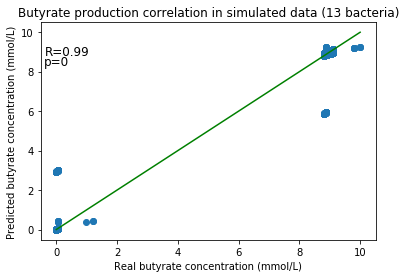

In [41]:
plt.title ('Butyrate production correlation in simulated data (13 bacteria)')  
plt.scatter (x13, y13)  
plt.plot (np.unique(x13), np.poly1d(np.polyfit(x13,y13, 1))(np.unique(x13)), color = 'green')  
plt.xlabel ('Real butyrate concentration (mmol/L)')  
plt.ylabel ('Predicted butyrate concentration (mmol/L)') 
plt.annotate("R=0.99",xy=(2, 9), xycoords='data',
            xytext=(0.35, 9),size=12, va="center", ha="center")
plt.annotate("p=0",xy=(2, 9), xycoords='data',
            xytext=(0, 8.5),size=12, va="center", ha="center")
plt.savefig("Correlation13sim.png", dpi=300,bbox_inches='tight')


In [1]:
###13 test

In [42]:
dat13=pd.read_table("/home/clau/Escritorio/microbial_consortia/data_correlation.txt")
y13t = dat13.iloc [:, 1].values
x13t = dat13.iloc[:, 0].values


In [72]:
scipy.stats.pearsonr(x13t,y13t)    # Pearson's r


(0.7544500306057194, 0.011681213078259069)

In [73]:
scipy.stats.spearmanr(x13t,y13t)

SpearmanrResult(correlation=0.5609860386535758, pvalue=0.09157776087006571)

In [75]:
scipy.stats.linregress(x13t,y13t)

LinregressResult(slope=0.45140964508952475, intercept=4.146553708188031, rvalue=0.7544500306057194, pvalue=0.011681213078259057, stderr=0.1388467773249849)

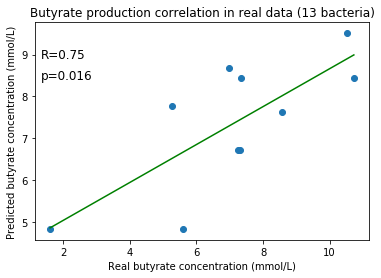

In [43]:
plt.title ('Butyrate production correlation in real data (13 bacteria)')  
plt.scatter (x13t, y13t)  
plt.plot (np.unique(x13t), np.poly1d(np.polyfit(x13t,y13t, 1))(np.unique(x13t)), color = 'green')  
plt.xlabel ('Real butyrate concentration (mmol/L)')  
plt.ylabel ('Predicted butyrate concentration (mmol/L)') 
plt.annotate("R=0.75",xy=(2, 9), xycoords='data',
            xytext=(2, 9),size=12, va="center", ha="center")
plt.annotate("p=0.016",xy=(2, 9), xycoords='data',
            xytext=(2.1, 8.5),size=12, va="center", ha="center")
plt.savefig("Correlation13real.png", dpi=300,bbox_inches='tight')